In [3]:
import ciao_contrib.runtool
from ciao_contrib.runtool import *
import pandas as pd
import numpy as np
from numpy import load
import astropy 
from astropy.table import Table
from astropy.io import fits
import os
import glob
import matplotlib.pyplot as plt
import ipywidgets as widgets
import pickle
import statistics
from IPython.display import clear_output
import sys

# List Folders Function
def list_folders(path):
    return [f for f in os.listdir(path) if os.path.isdir(os.path.join(path, f))]
    
# Specify path
path = '/Users/steven/Library/CloudStorage/OneDrive-ImperialCollegeLondon/01-27-2023-FYP-CfA/4-Code-Data/Chandra-Data/'
folders = list_folders(path)
folder_list = []
for folder in folders:
    folder_list.append(folder)

# Select Set
set_widget = widgets.Dropdown(options=folder_list[:],value=folder_list[1],description='Set :',disabled=False); set_widget

Dropdown(description='Set :', index=1, options=('Set-2', 'Set-Y', 'Set-5', 'Set-4', 'Set-3', 'Set-6', 'Set-1')…

# 1. Load Data

In [4]:
# Set ID
set_id = set_widget.value.split("-")[1]
# Load data
df_inputs = pd.read_csv(f'{path}Set-{set_id}/inputs2-{set_id}.csv')
df_labels = pd.read_csv(f'{path}Set-{set_id}/labels2-{set_id}.csv')
# Group data (combined ID)
df_labels_group = df_labels.drop(columns=['obsid', 'region_id'])
df_input_group = df_inputs.drop(columns=['obsid', 'region_id'])
df_labels_group = df_labels.drop(columns=['obsid', 'region_id'])
df_input_group = df_inputs.drop(columns=['obsid', 'region_id'])
df_labels_group = df_labels_group.groupby('obsreg_id')
df_input_group = df_input_group.groupby('obsreg_id')

# 2. Loop over all Eventfile Groups

In [46]:
maxdt_list = []
mindt_list = []
avgdt_list = []

count = 0
fails = 0
count_limit = df_input_group.ngroups
id_fail = []
id_pass = []

for id_name, df_id in df_input_group:
    df_id["delta_time"] = df_id['time'].diff()
    df_id = df_id[df_id["delta_time"].notna()]
    # Add a constant value to delta_time = 0
    df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.01, dt))
    try:
        # Number and Total Duration of Events
        N = len(df_id) #one row will be dropped so -1 ???
        T = max(df_id["time"])-min(df_id["time"])
        E = max(df_id["energy"])-min(df_id["energy"])
        # Add delta_t column
        df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
        # Add E column
        df_id["E"] = np.log10(df_id["energy"])
        #  dt
        maxdt = max(df_id["dt"])
        mindt = min(df_id["dt"])
        avgdt = sum(df_id["dt"])/len(df_id["dt"])
        maxdt_list.append(maxdt)
        mindt_list.append(mindt)
        avgdt_list.append(avgdt)

        count = count + 1
        print(f'Counter: {count} / {count_limit}')
        id_pass.append(id_name)
        clear_output(wait=True)
    except: 
        fails = fails + 1
        print(f'Fails: {fails}')
        id_fail.append(id_name)
        clear_output(wait=True)
print('Maximum: ', max(maxdt_list))
print('Minimum: ', min(mindt_list))

Maximum:  inf
Minimum:  -5.388211991671633


3874
10939_346
Maximum:  3.434840775532755
Minimum:  -3.142060899552104
Maximum:  3.8921317394429757
Minimum:  -3.3700577502814206


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1279042330.py:18: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(3, 1, 1)


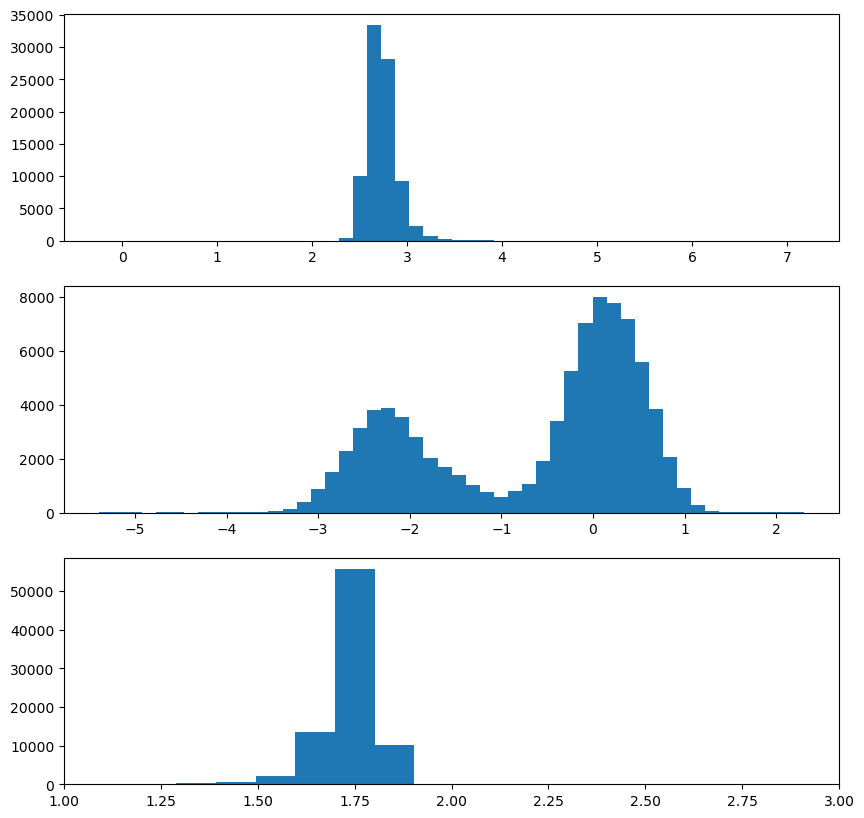

In [54]:
index = maxdt_list.index(float('inf'))
max_x = [x for x in maxdt_list if x != float('inf')]
min_x = [x for x in mindt_list if x != float('inf')]
avg_x = [x for x in avgdt_list if x != float('inf')]
avg_x_min = np.percentile(avg_x,0.2)
avg_x_max = np.percentile(avg_x,0.8)
 # Output: [1, 2, 3, 4, 5]
print(index)
print(id_pass[index])

print('Maximum: ', np.percentile(maxdt_list,99.5))
print('Minimum: ', np.percentile(mindt_list,0.5))

print('Maximum: ', np.percentile(maxdt_list,99.9))
print('Minimum: ', np.percentile(mindt_list,0.1))

fig, axs = plt.subplots(1,2, figsize=(10, 10))
plt.subplot(3, 1, 1)
plt.hist(max_x,bins = 50)
plt.subplot(3, 1, 2)
plt.hist(min_x,bins = 50)
plt.subplot(3, 1, 3)
plt.hist(avg_x,bins = 50)
plt.xlim(1,3)
plt.show()




131.92192661762238 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

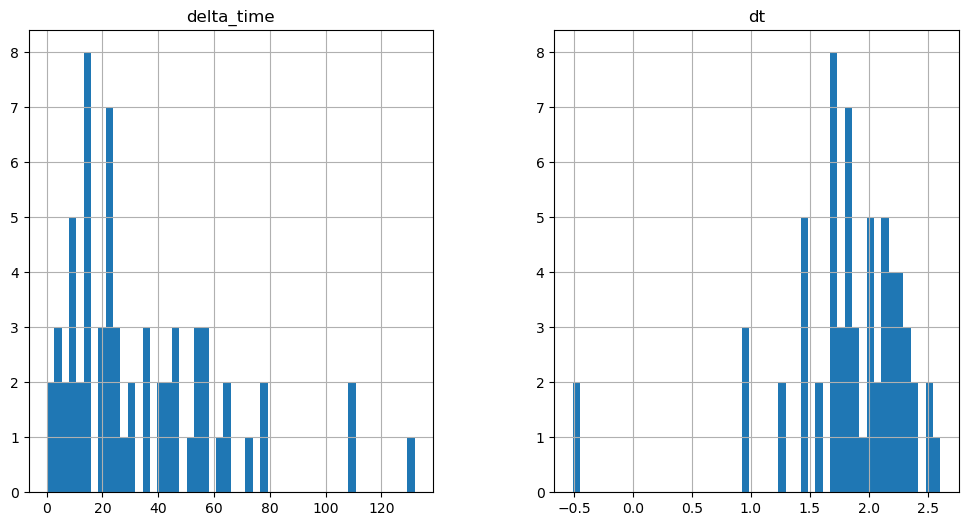

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

229.29293125867844 3.1409801840782166


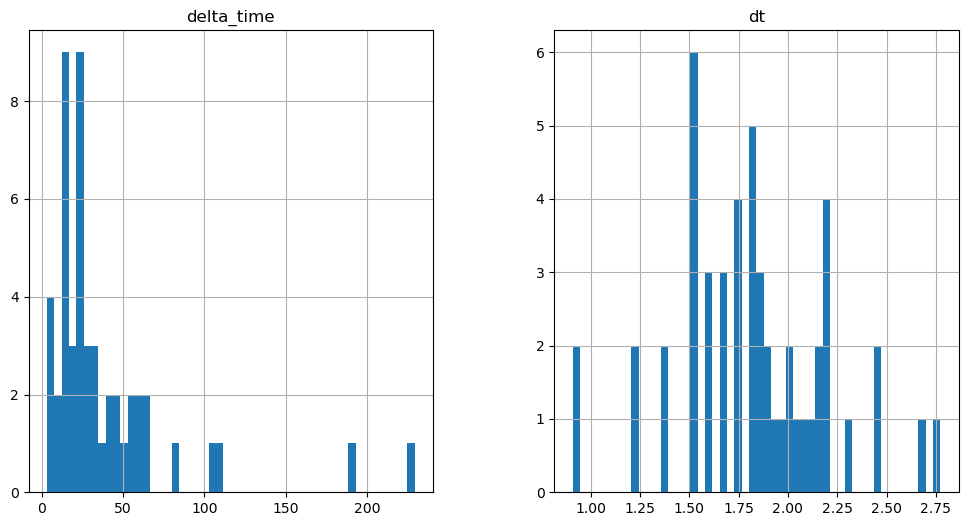

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

251.27994245290756 0.1


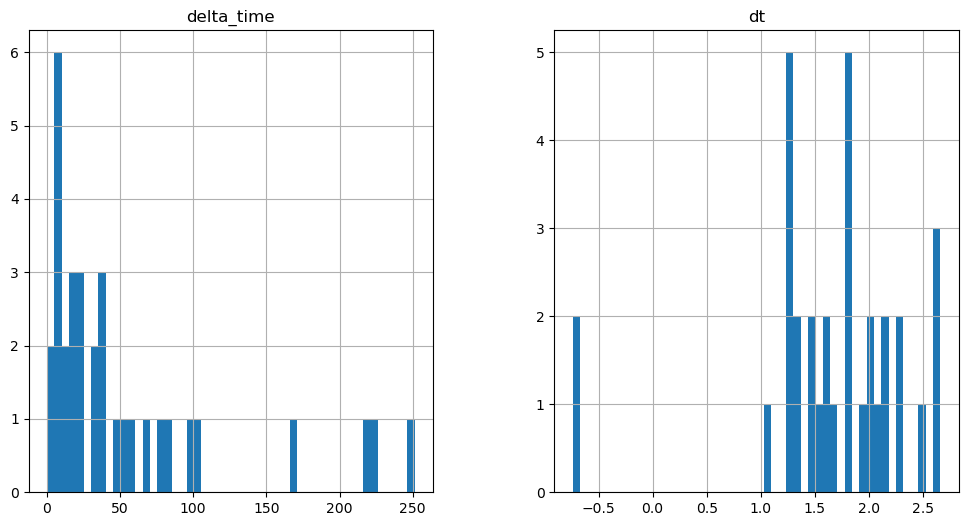

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

815.471640586853 1.7641301155090332


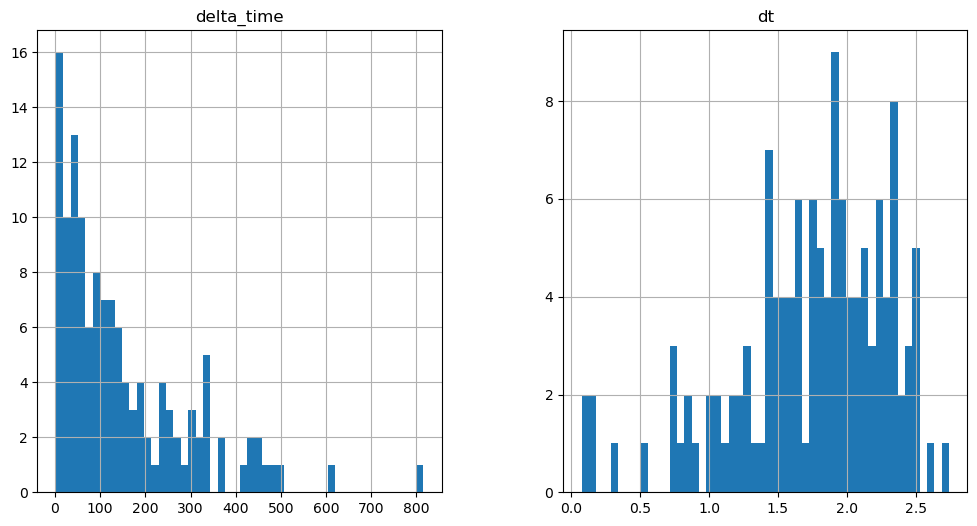

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

741.3782767653465 1.3230900764465332


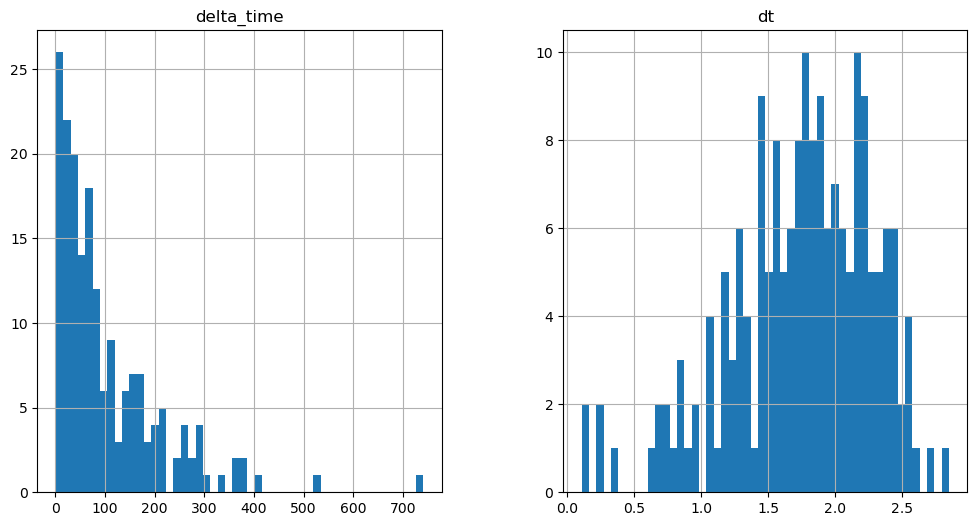

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

855.6055626869202 1.7641400694847107


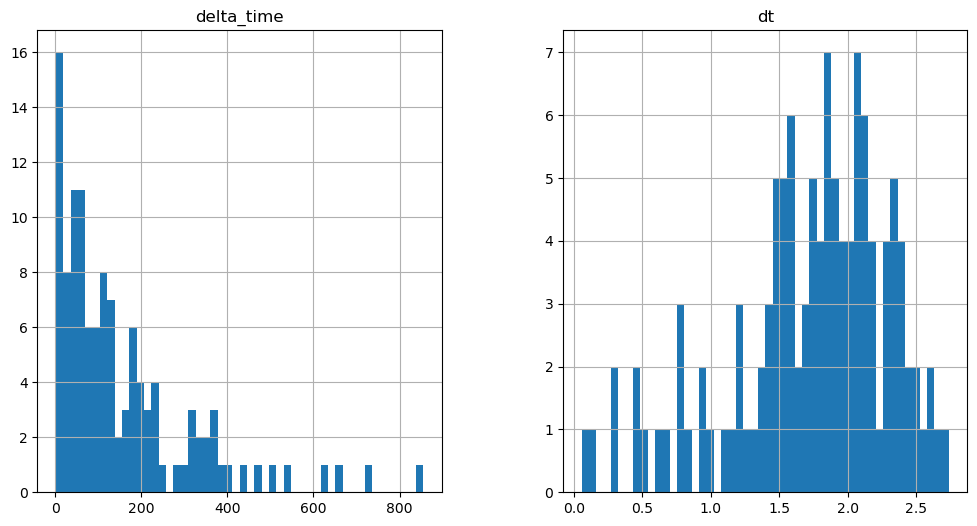

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

764.7547981142998 0.1


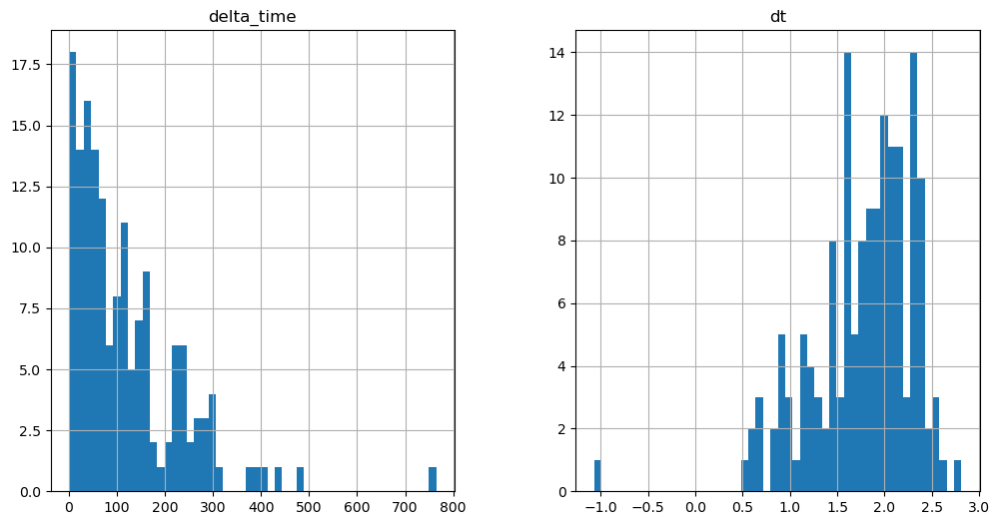

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

244.77376210689545 0.4410399794578552


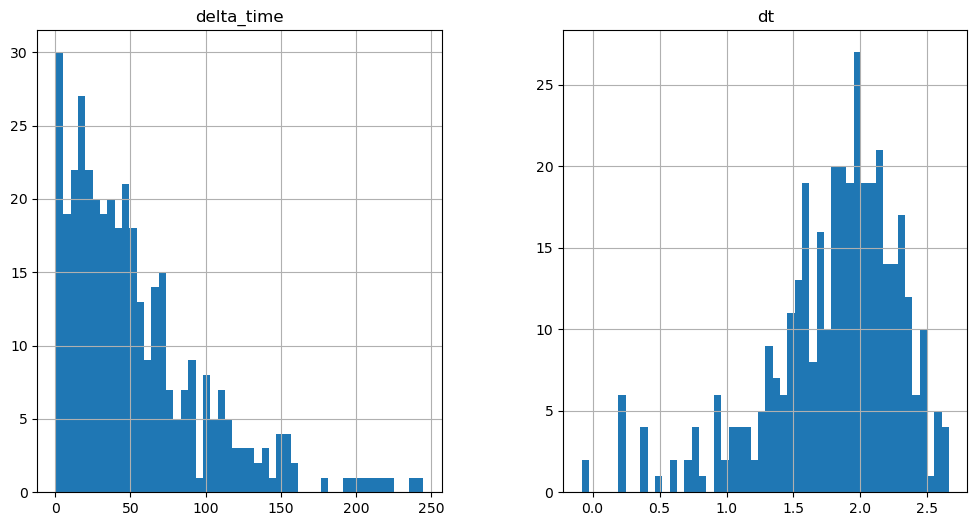

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1001.4789098501205 0.1


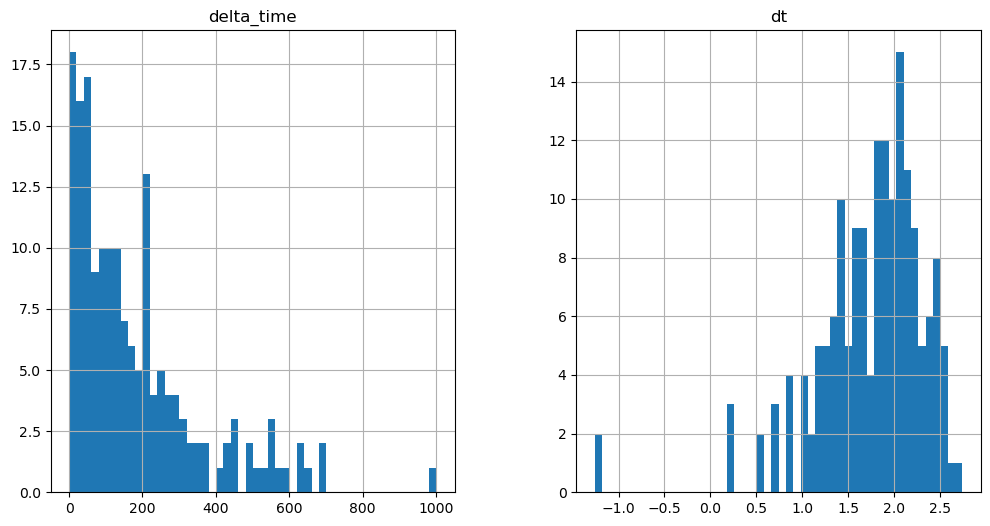

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1520.040865778923 3.241030216217041


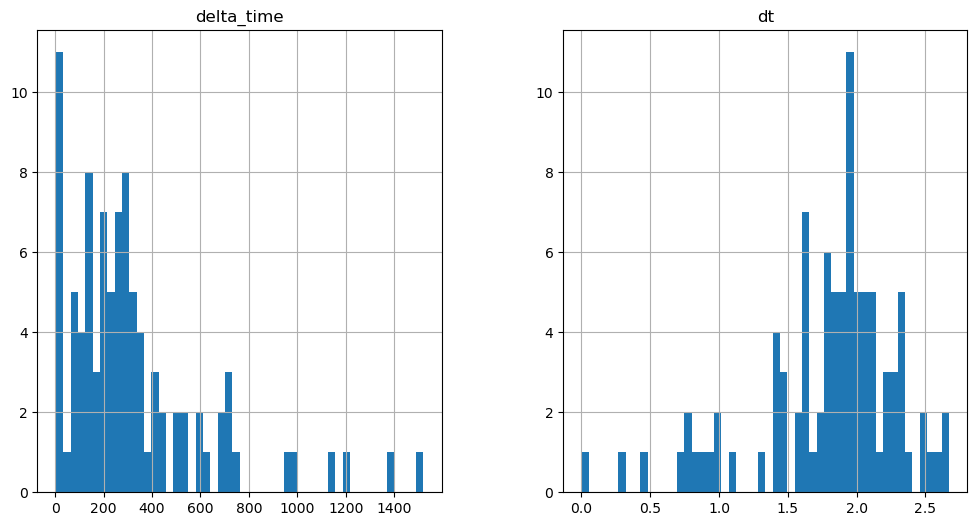

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2184.4568488001823 6.4820603132247925


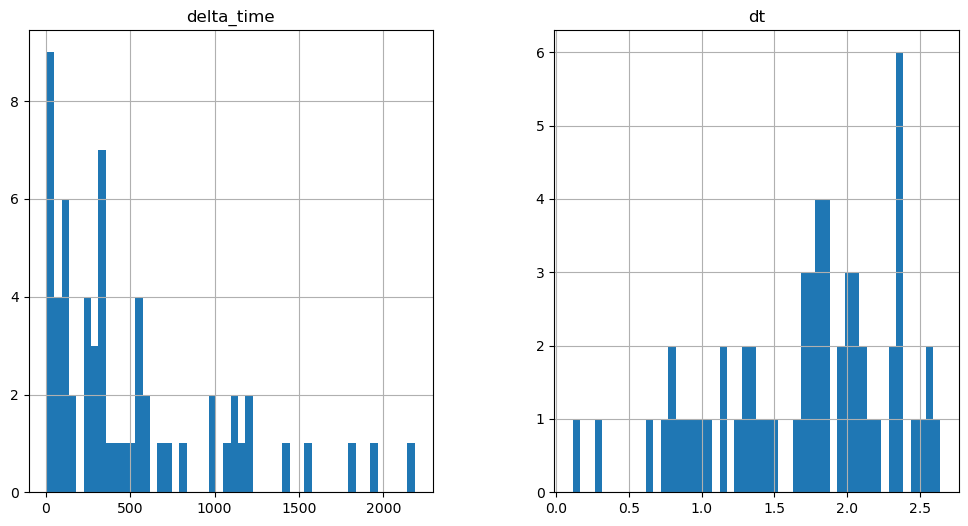

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1361.2325077652931 3.2410301566123962


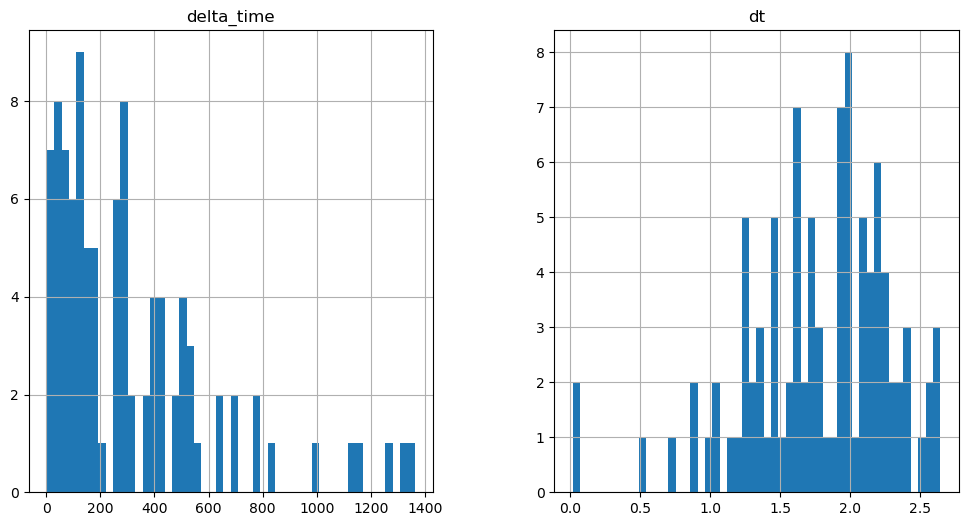

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5931.092095375061 45.374412298202515


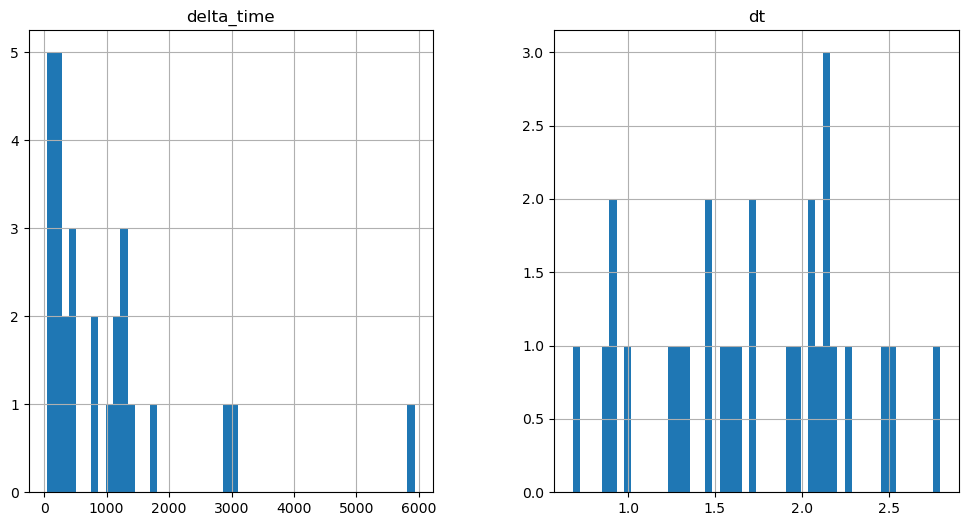

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3075.73213326931 29.169271528720856


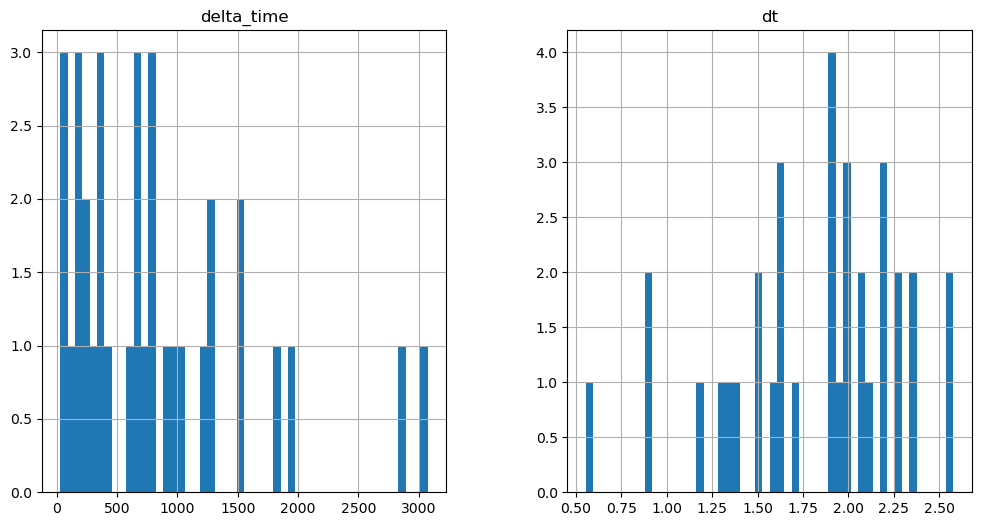

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2284.927633702755 32.410291612148285


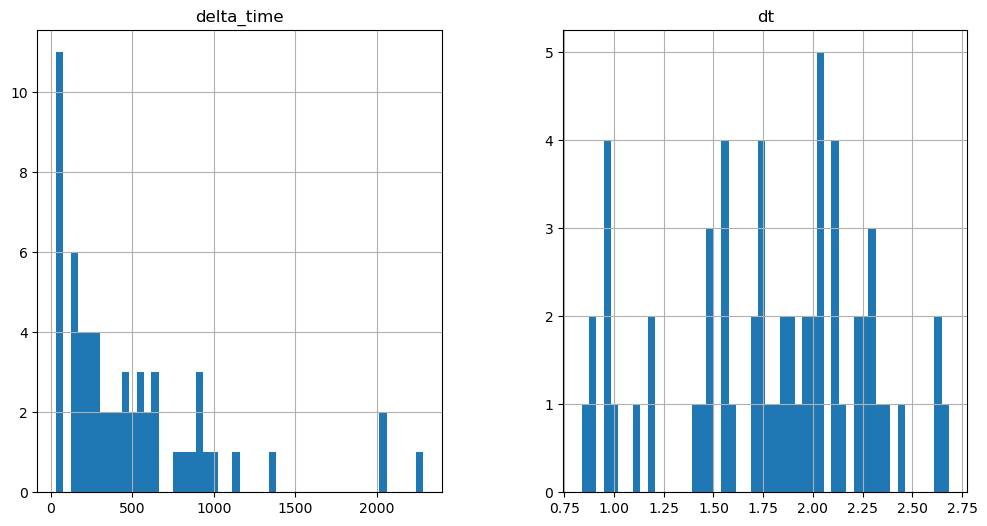

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1017.6812307238579 0.1


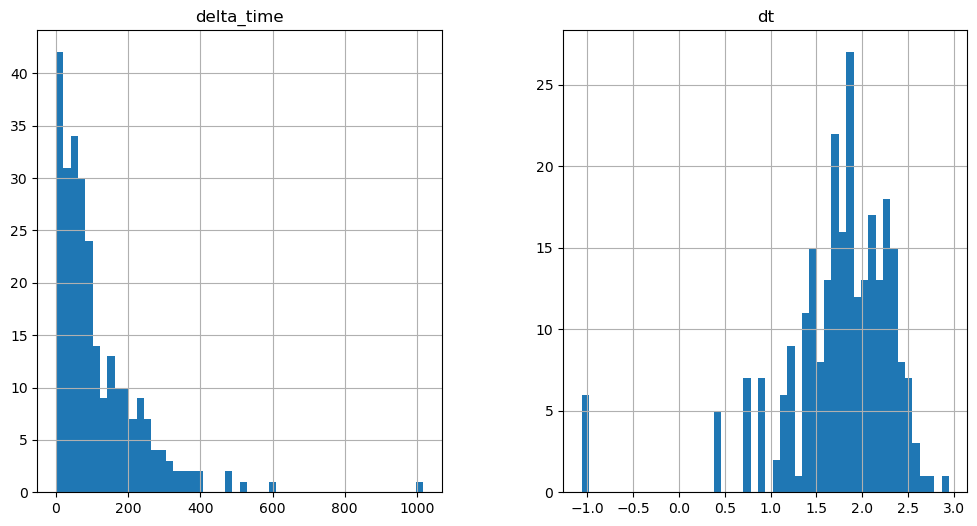

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2251.268282711506 1.1410399675369263


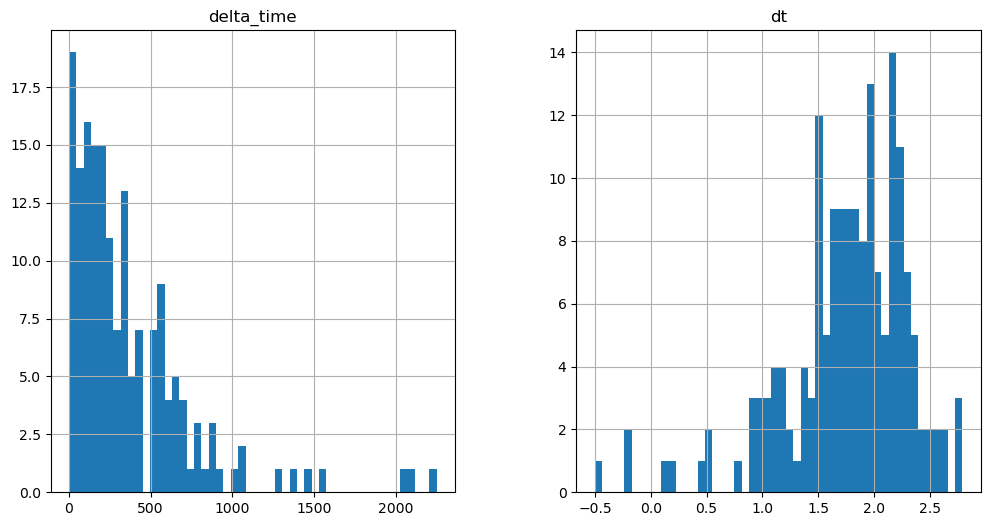

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2749.9022275209427 3.423120141029358


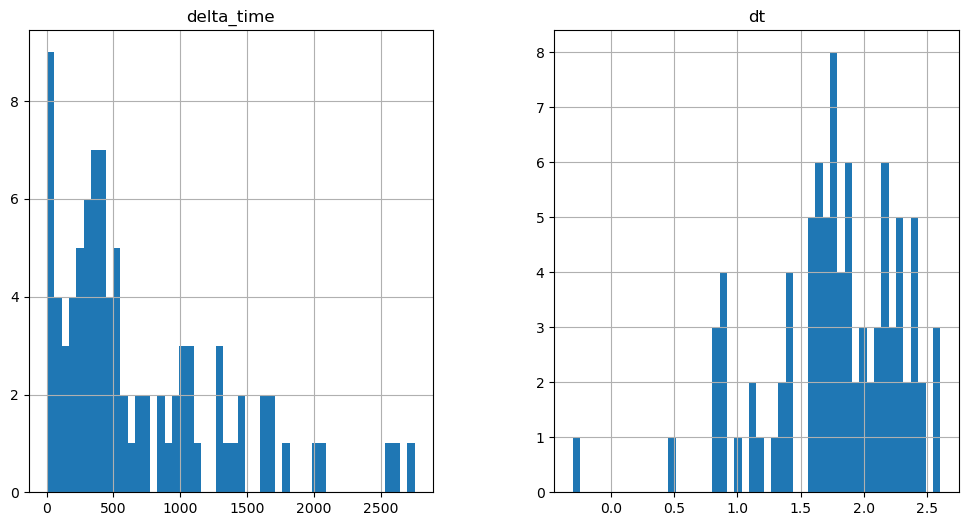

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2391.6156896948814 2.282080054283142


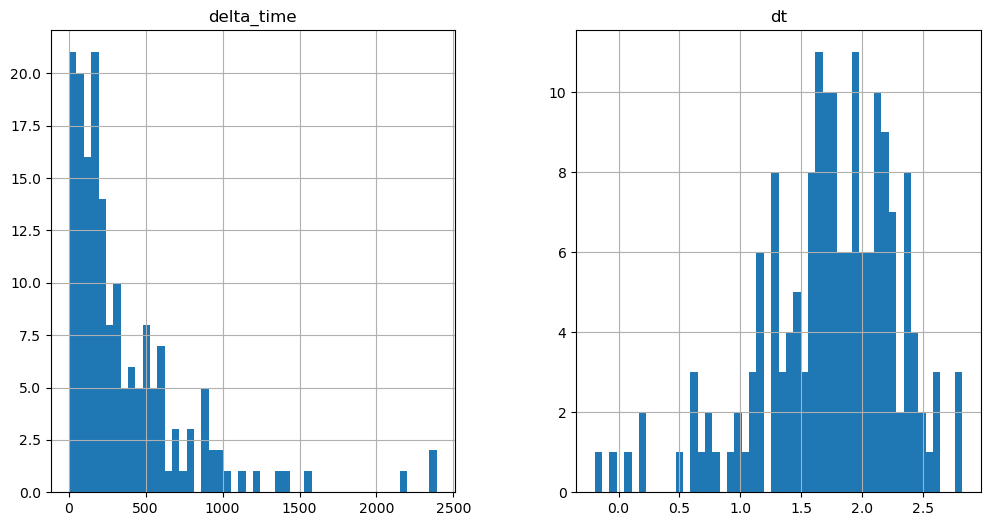

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3490.437554836273 20.538690865039825


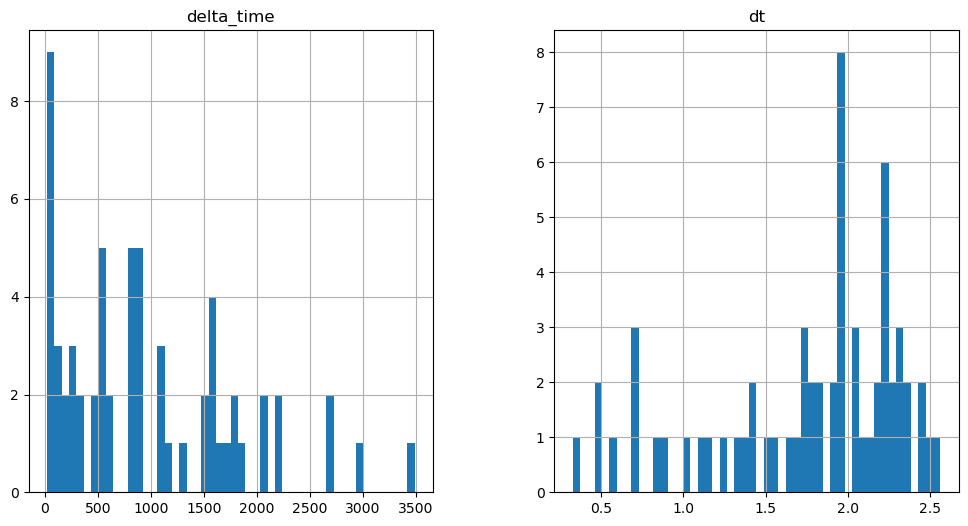

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

192.7318395972252 0.1


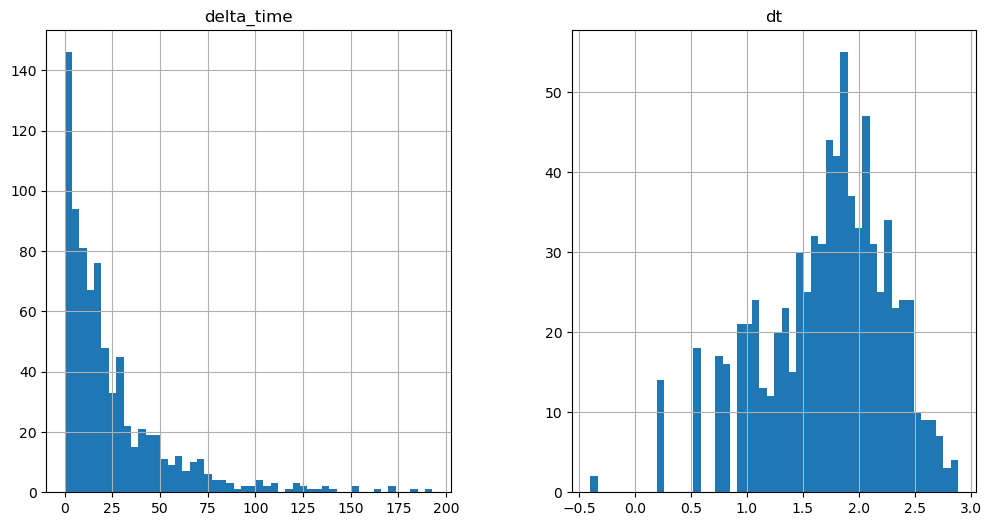

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5385.835119485855 52.512892723083496


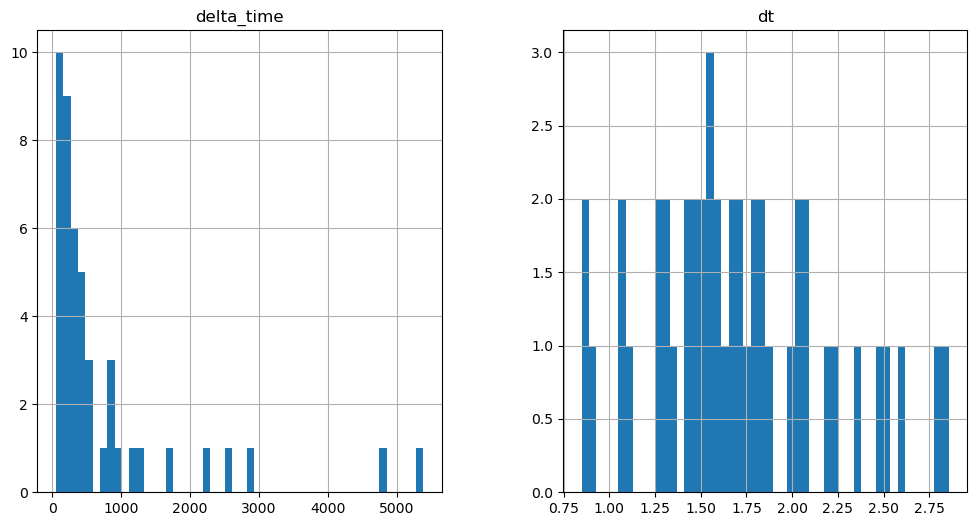

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1476.9242139458656 1.6410101056098938


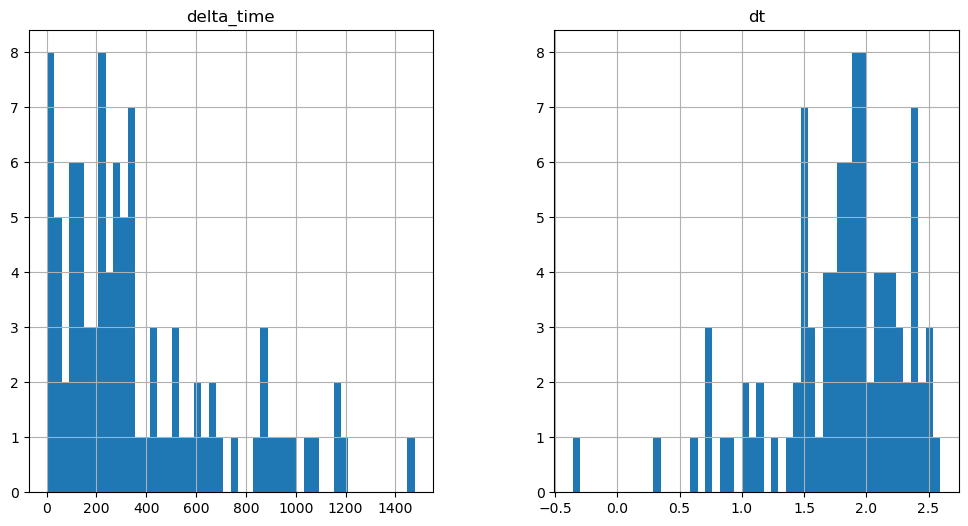

3684.095664381981 26.256421387195587


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

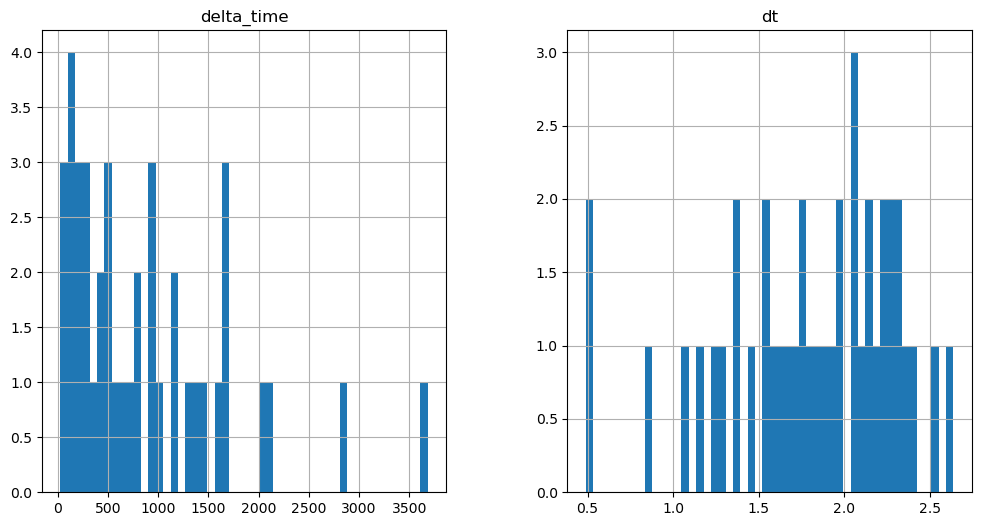

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

779.4862990379333 1.6410200595855713


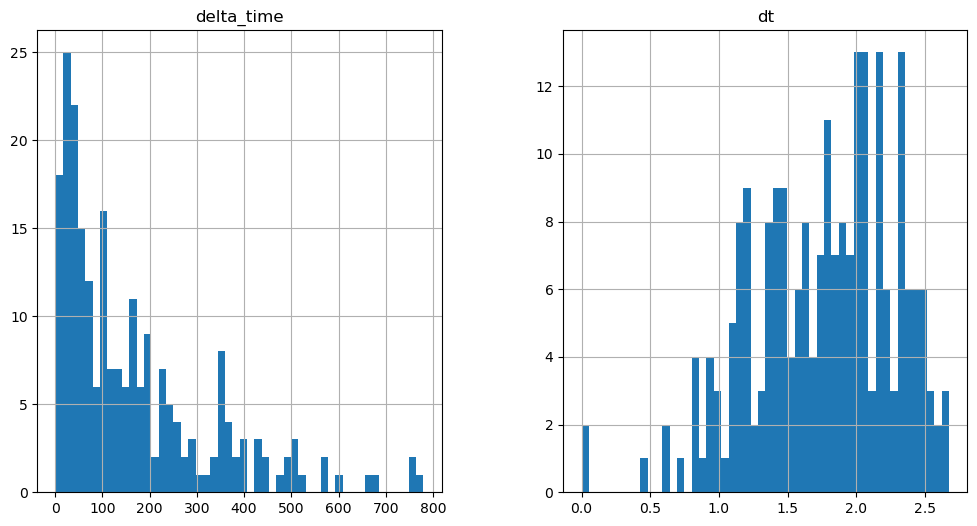

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3206.561260342598 3.282060146331787


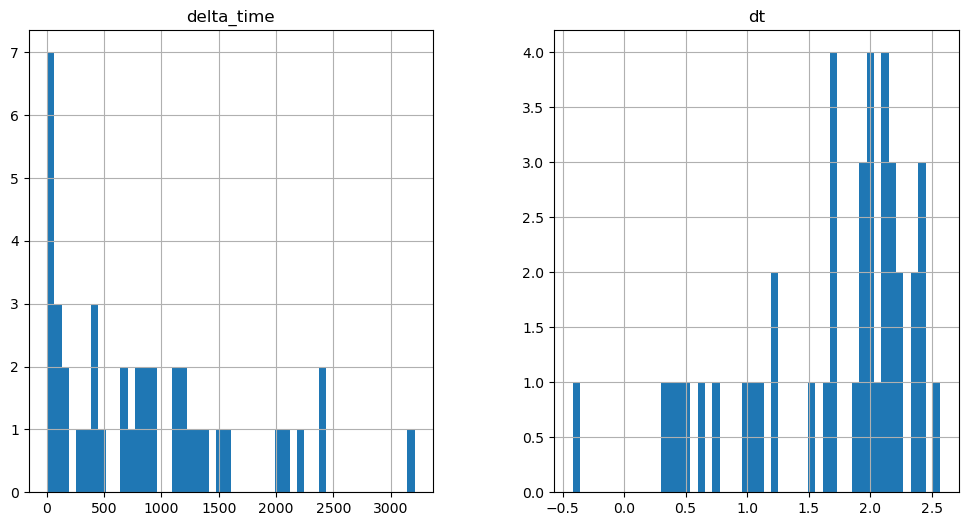

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2120.201536178589 0.1


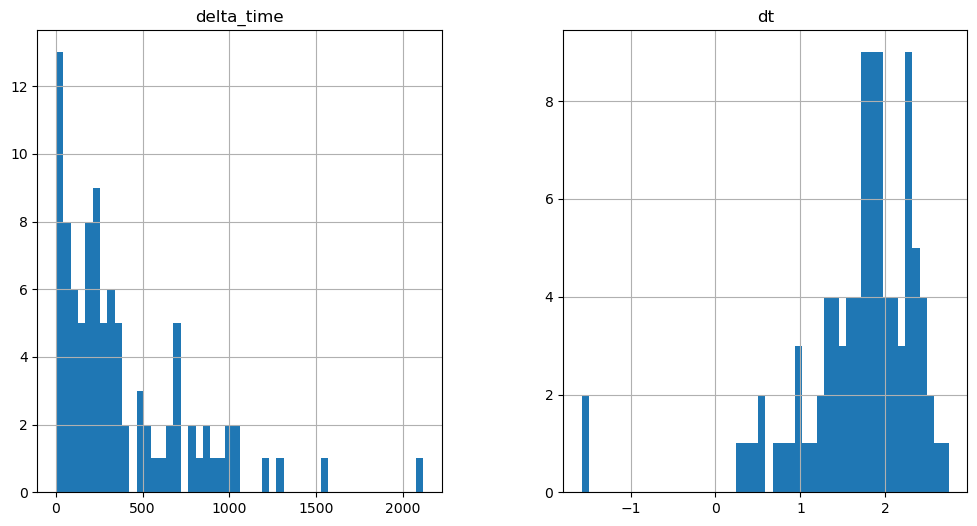

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

515.2812258601189 0.1


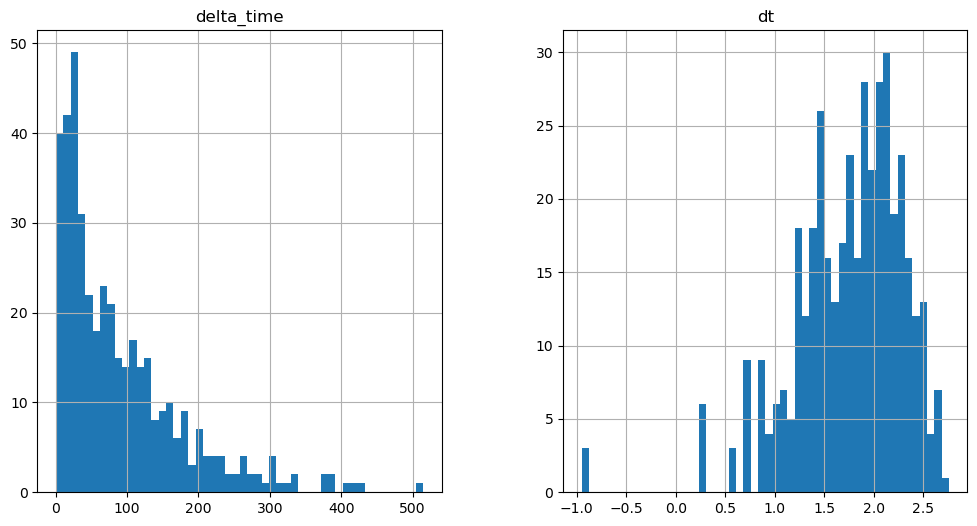

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1322.6638162136078 3.28203022480011


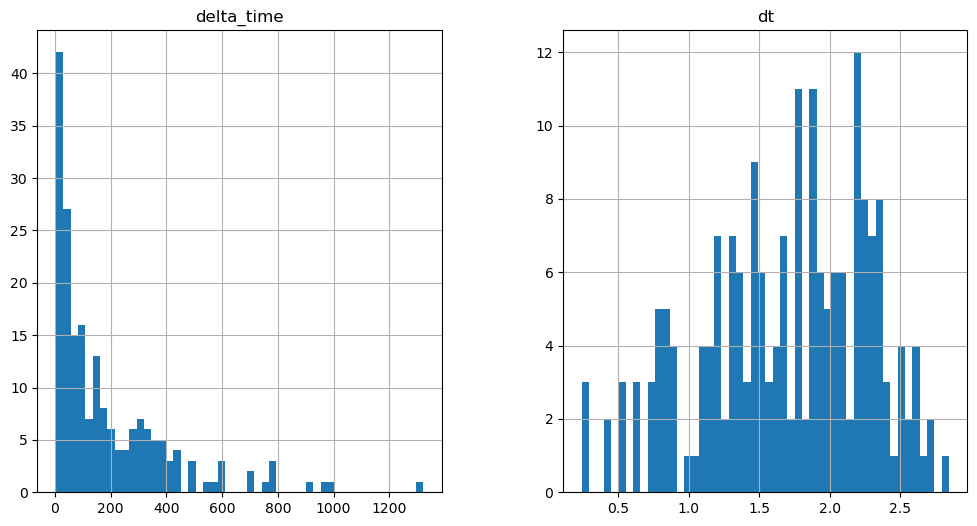

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4716.298725903034 4.923090219497681


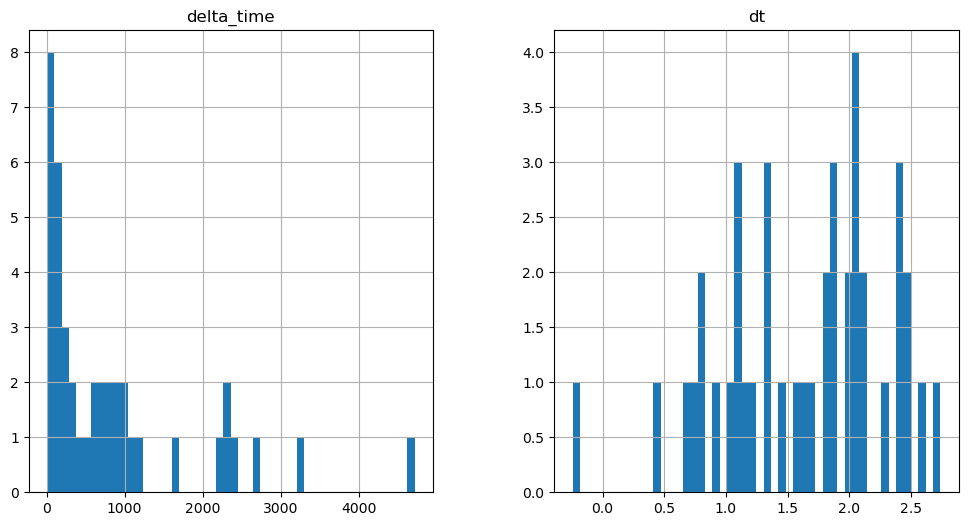

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3109.7369356155396 16.41030091047287


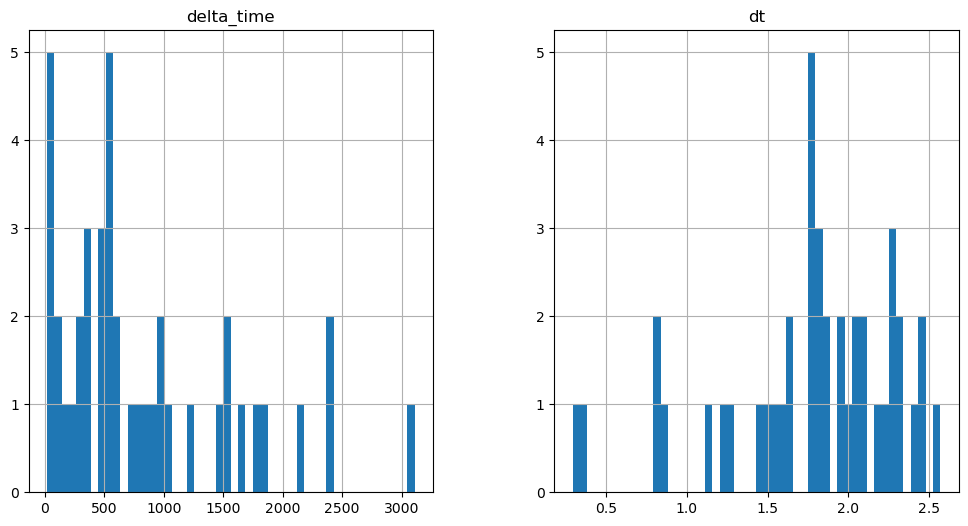

6135.782326996326 86.97423440217972


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

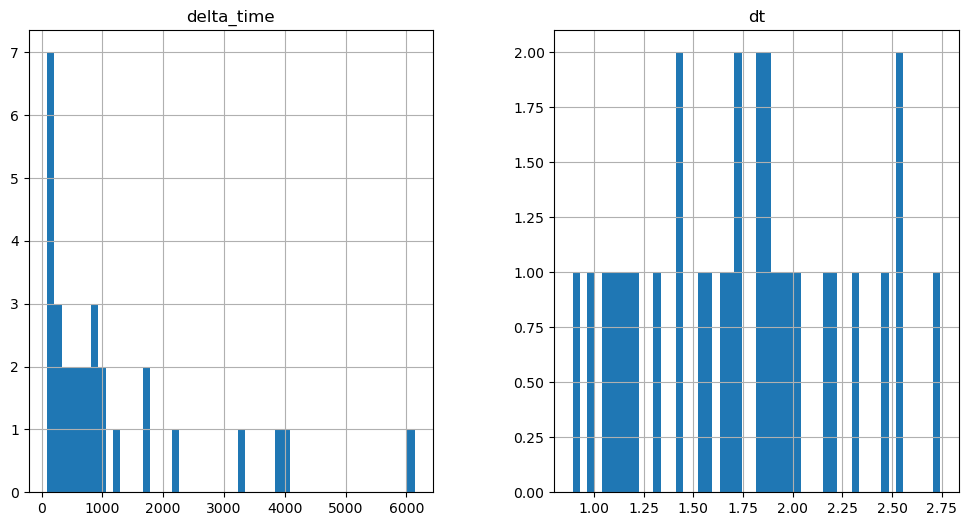

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4406.152020454407 3.2820701003074646


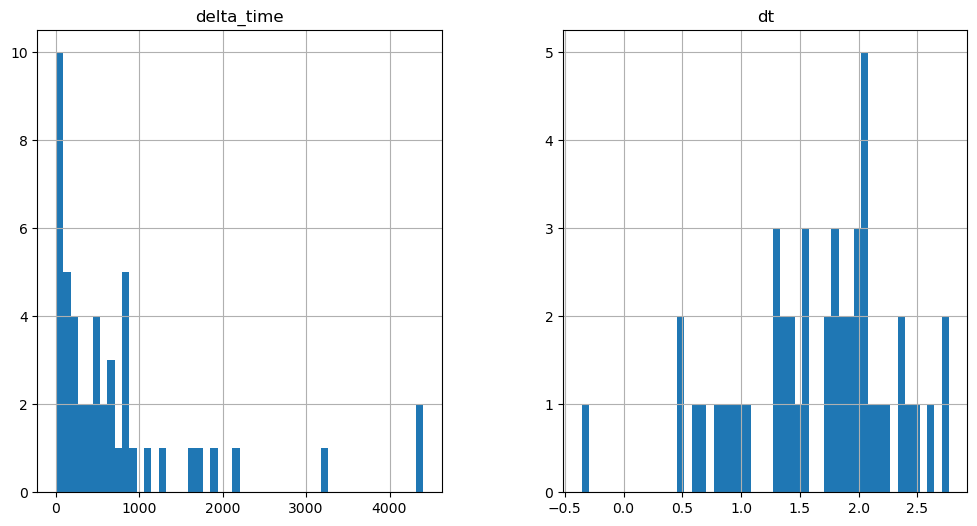

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1829.7440816164017 3.2820502519607544


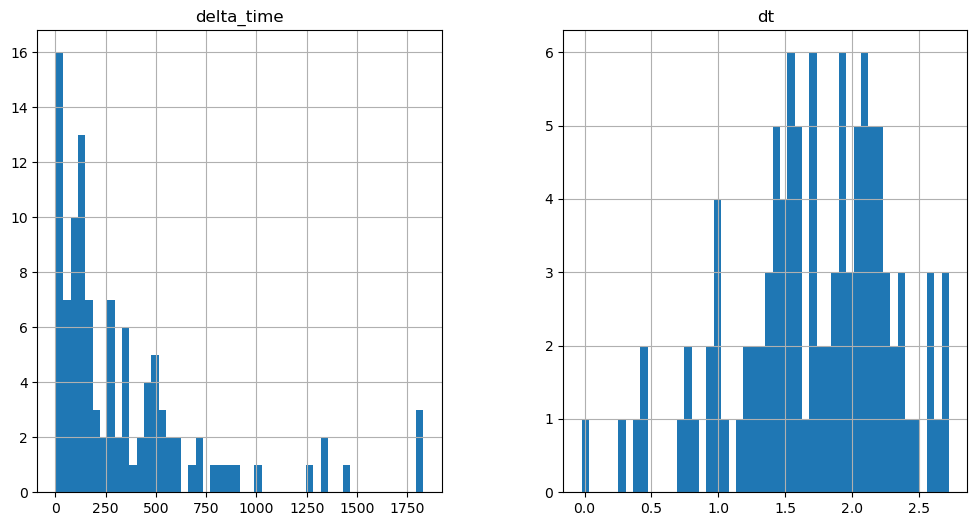

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2610.8702805638313 13.128170669078827


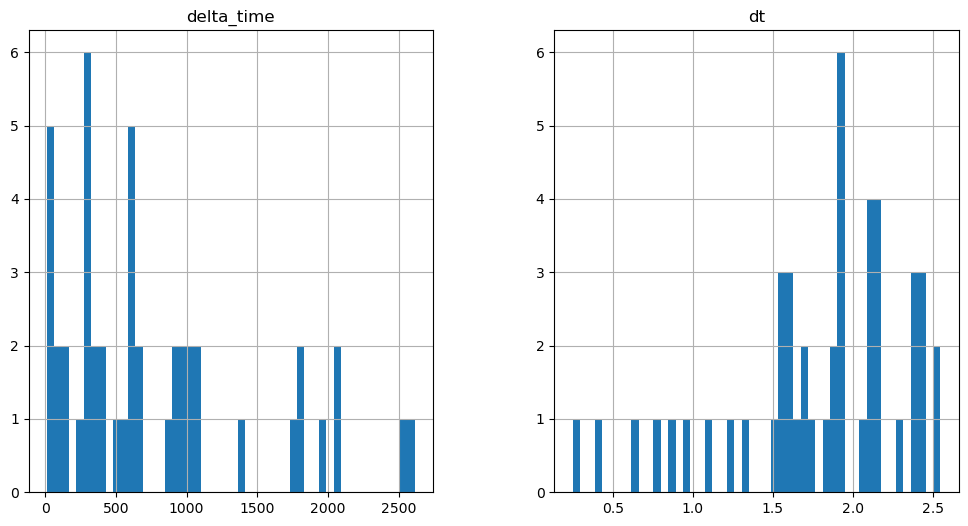

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4363.478278338909 4.923090219497681


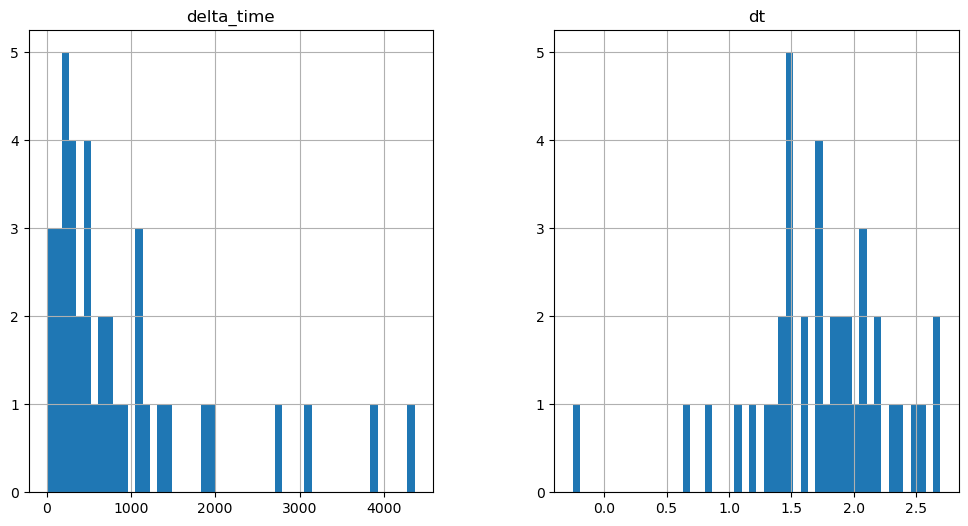

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3772.7136986255646 3.2820401787757874


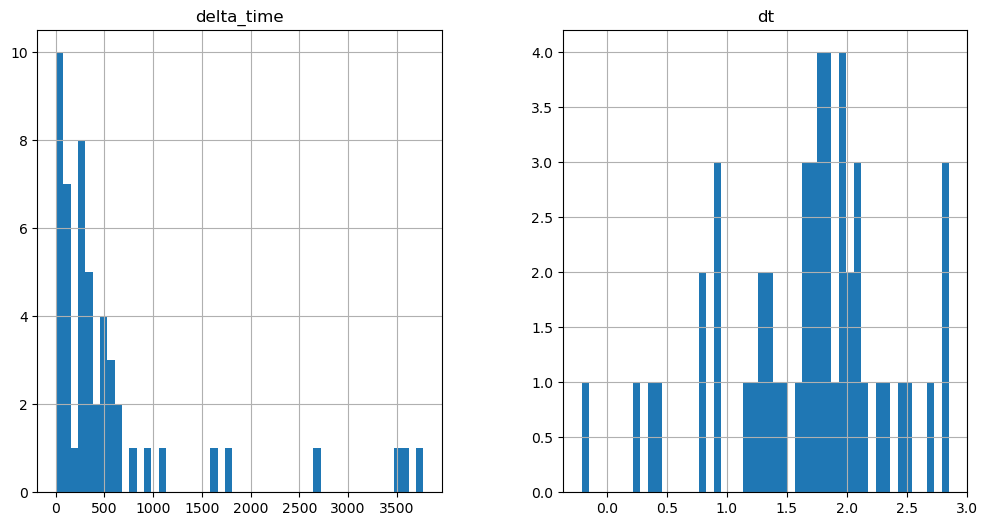

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2213.7428407669067 1.6410200595855713


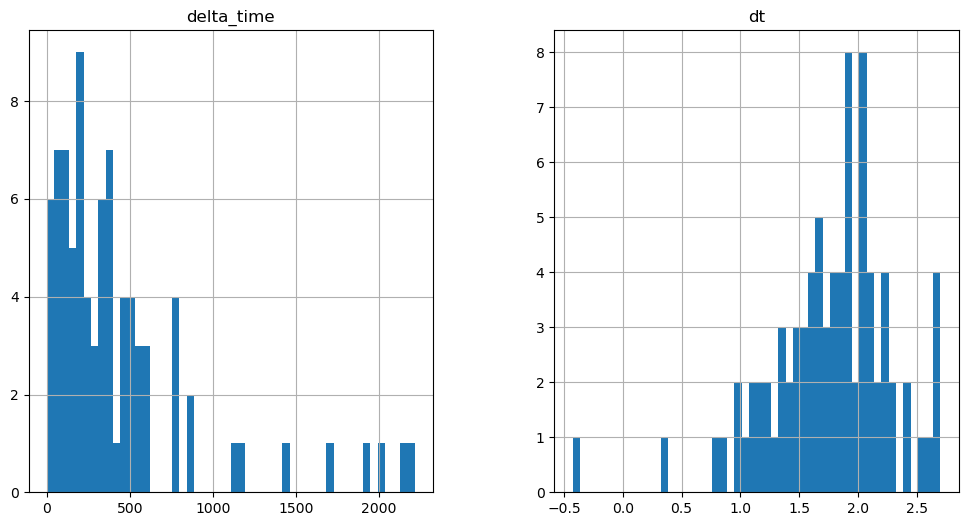

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1181.536059141159 0.1


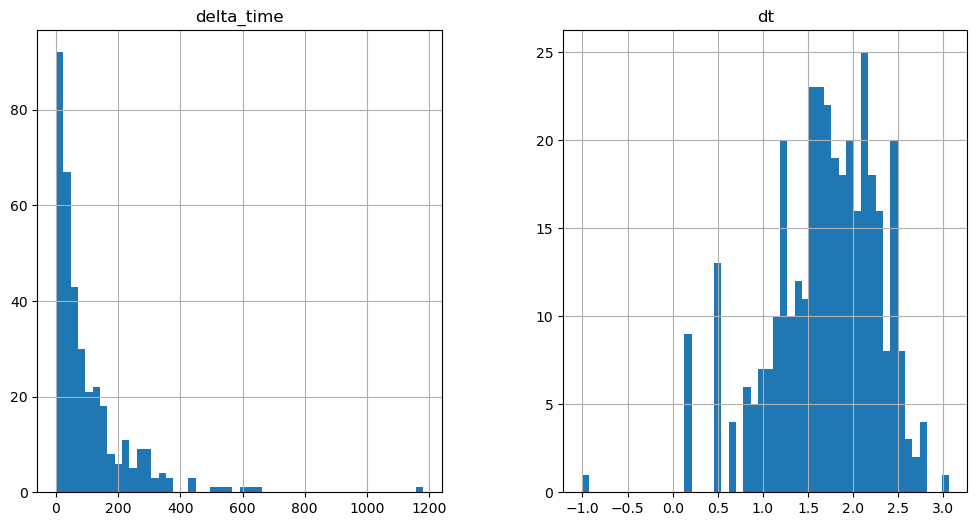

4896.829855144024 19.69229108095169


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

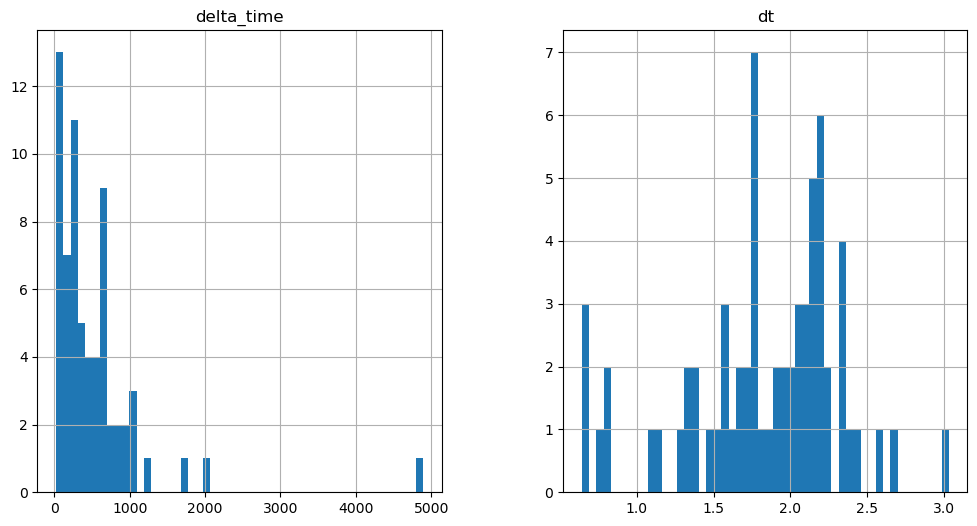

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3275.4870939850807 18.05125093460083


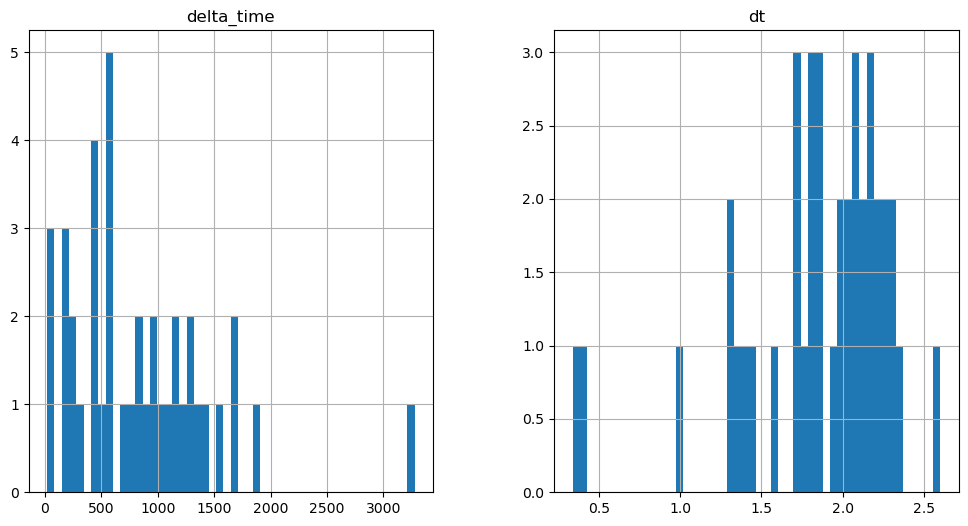

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2484.5081142783165 3.2820600867271423


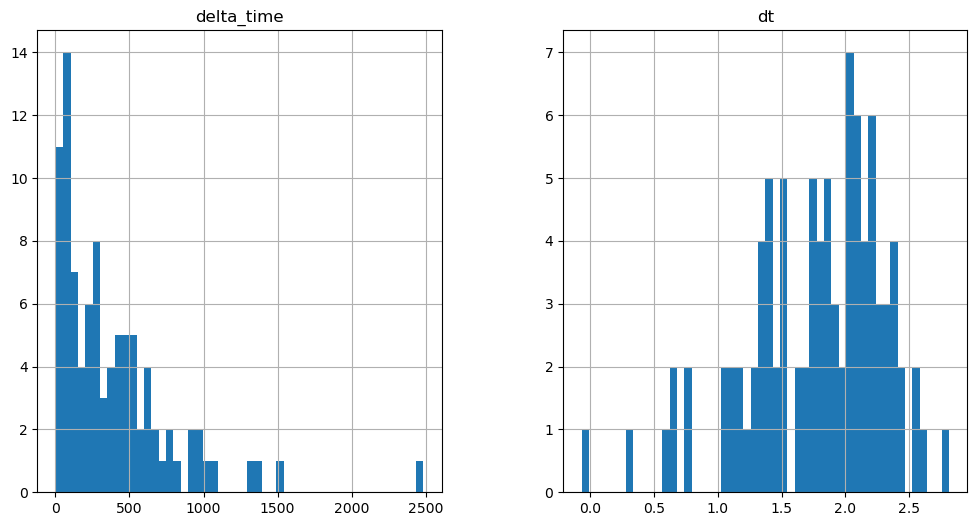

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

920.6134160757065 0.1


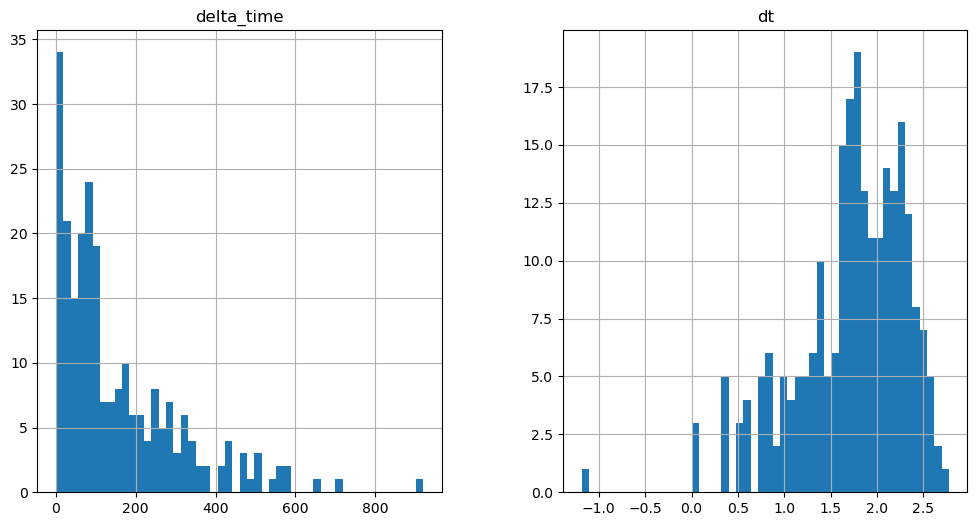

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1421.1251811385155 1.6410102248191833


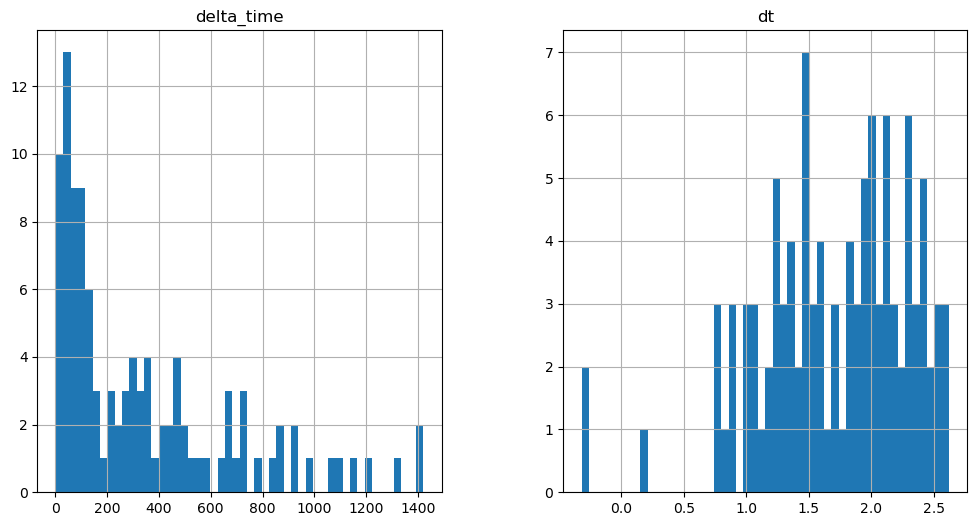

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2691.2763047218323 4.923060297966003


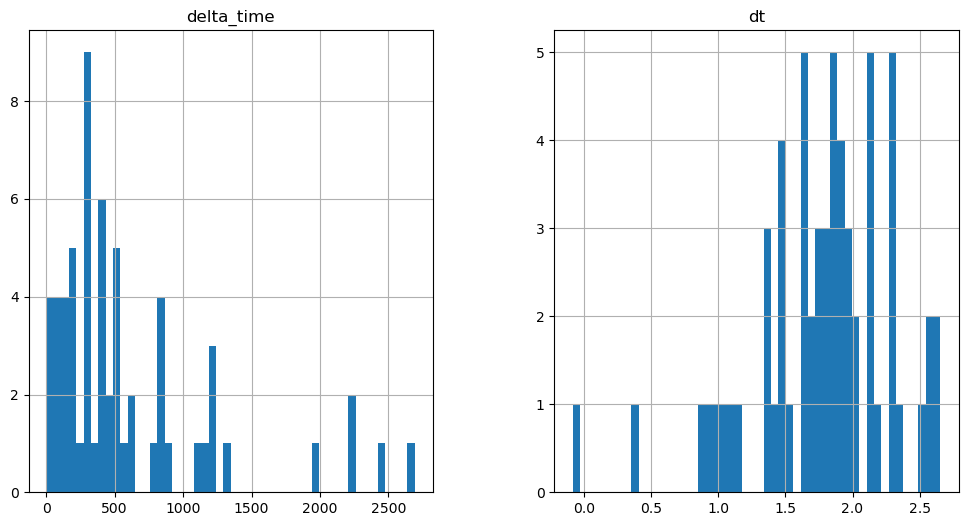

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1588.5100094079971 39.38471186161041


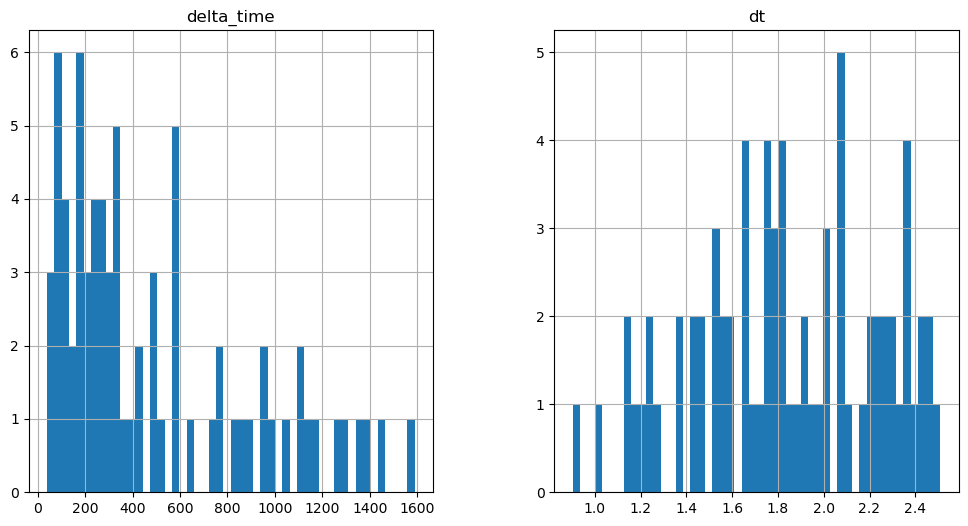

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2484.507054388523 3.2820401787757874


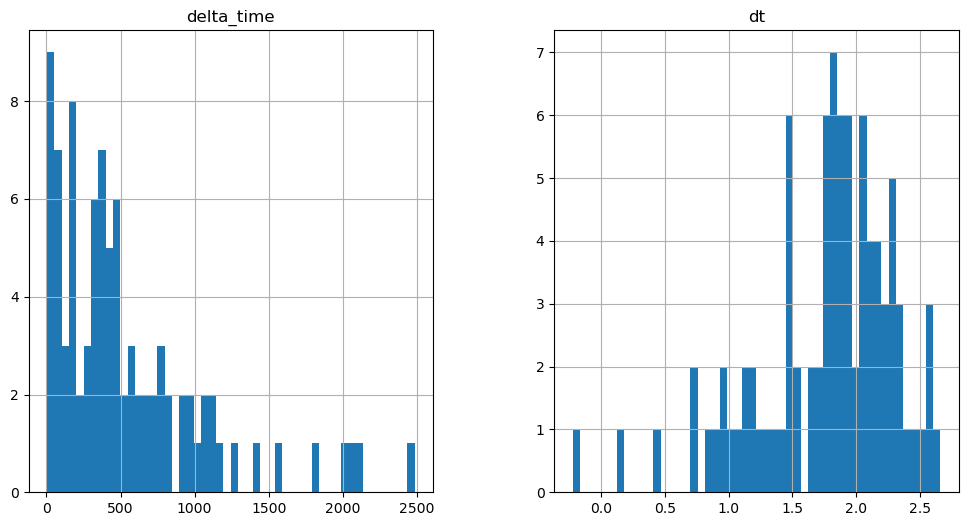

1212.715150654316 1.6410099864006042


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

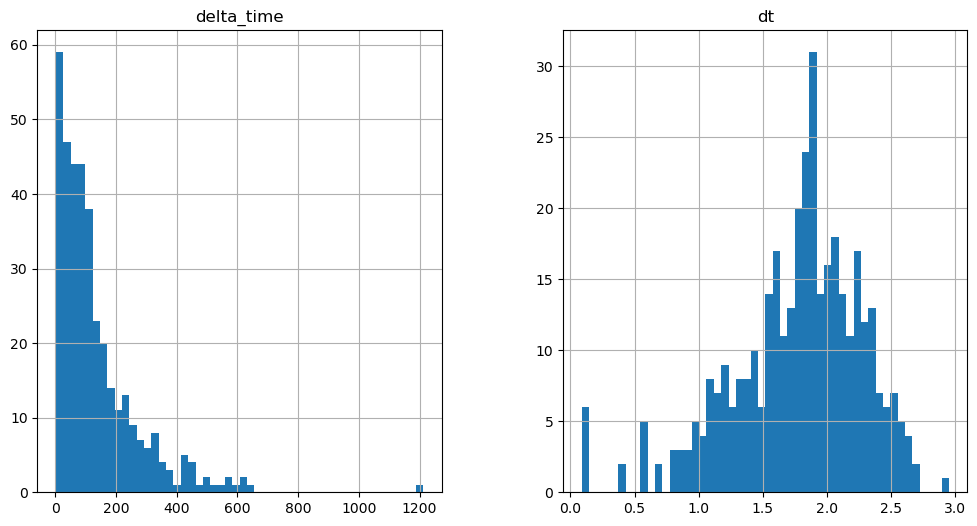

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1137.228116929531 1.6410200595855713


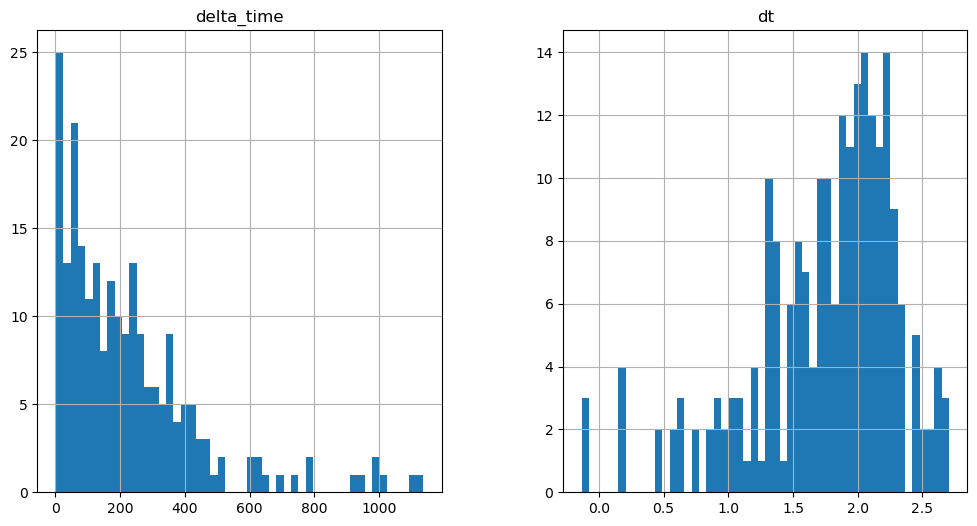

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1915.0706459283829 6.564070522785187


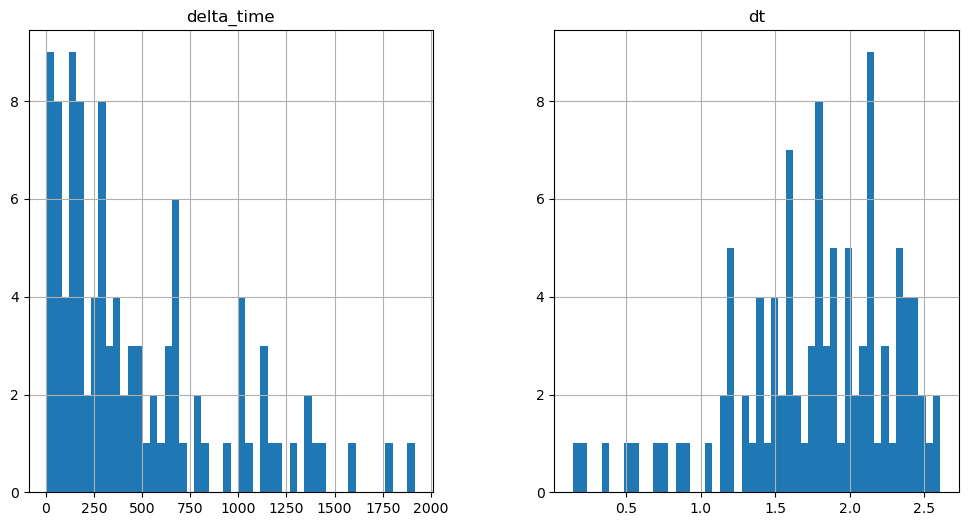

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2197.3266500234604 18.051220893859863


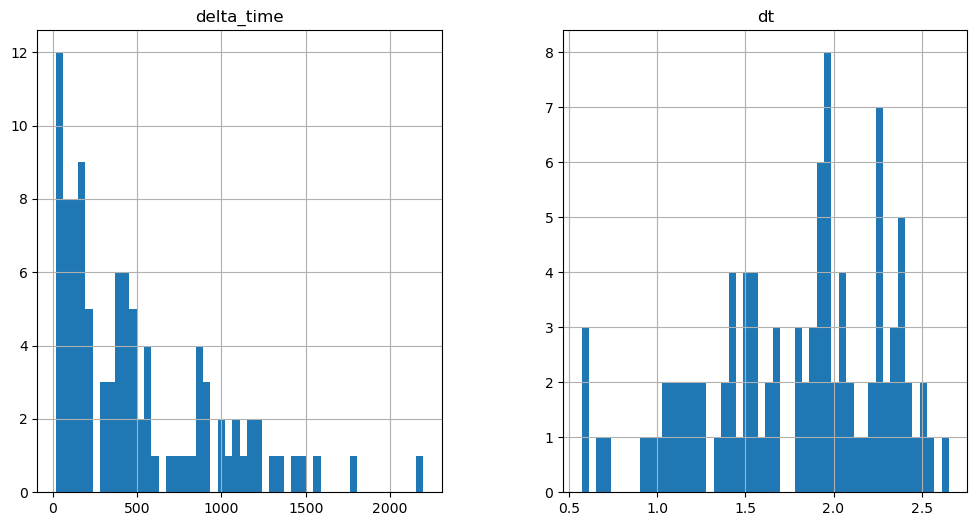

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1578.6615790128708 1.641010046005249


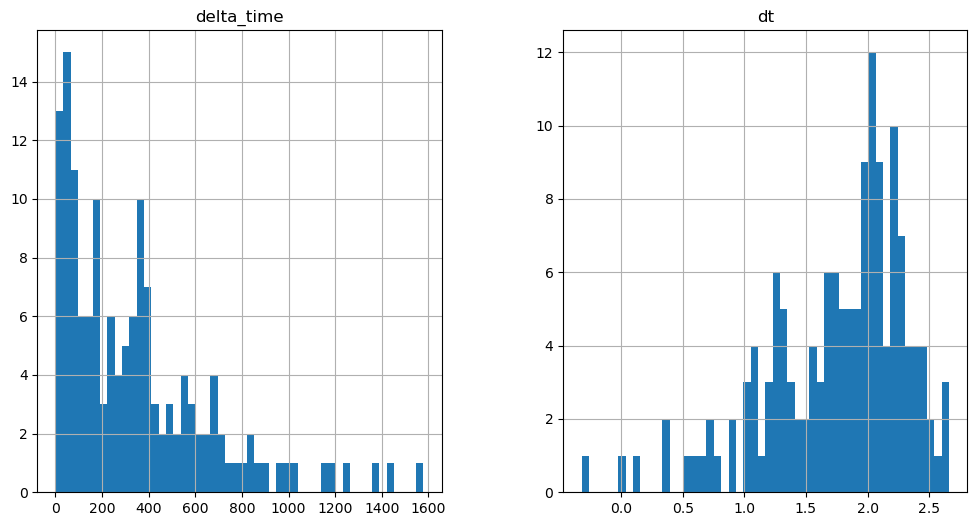

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

577.6395388841629 0.1


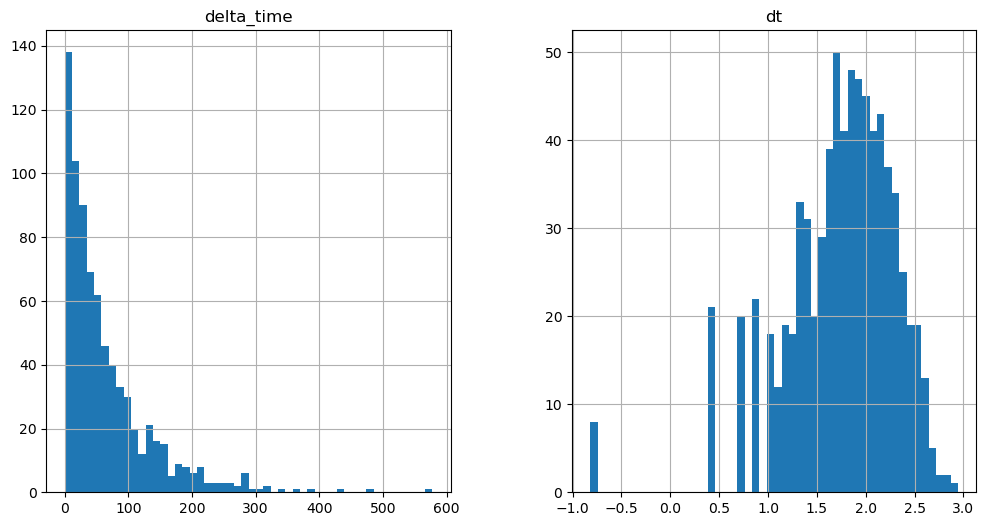

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1417.8426409959793 1.6410200595855713


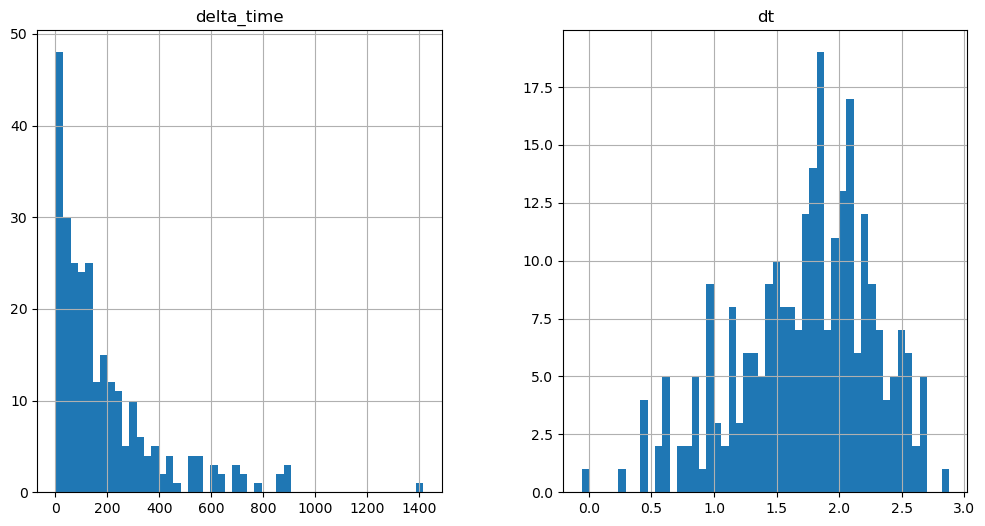

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1248.8175626397133 1.6410101056098938


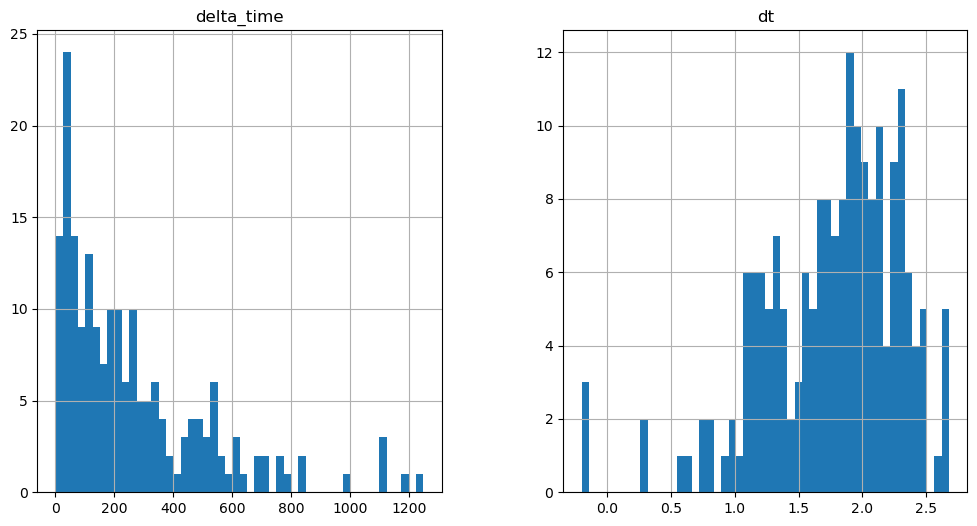

3111.3773956894875 9.846120476722717


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

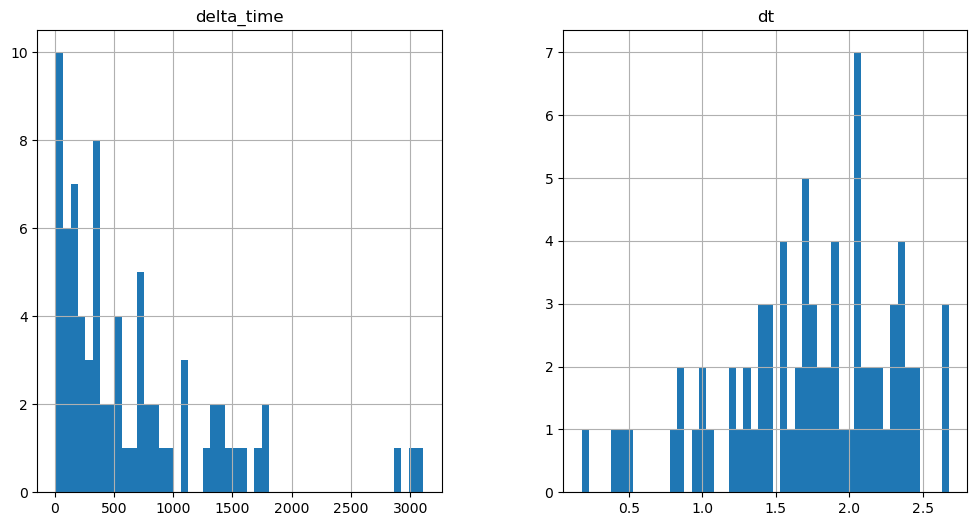

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2801.224240362644 1.641020119190216


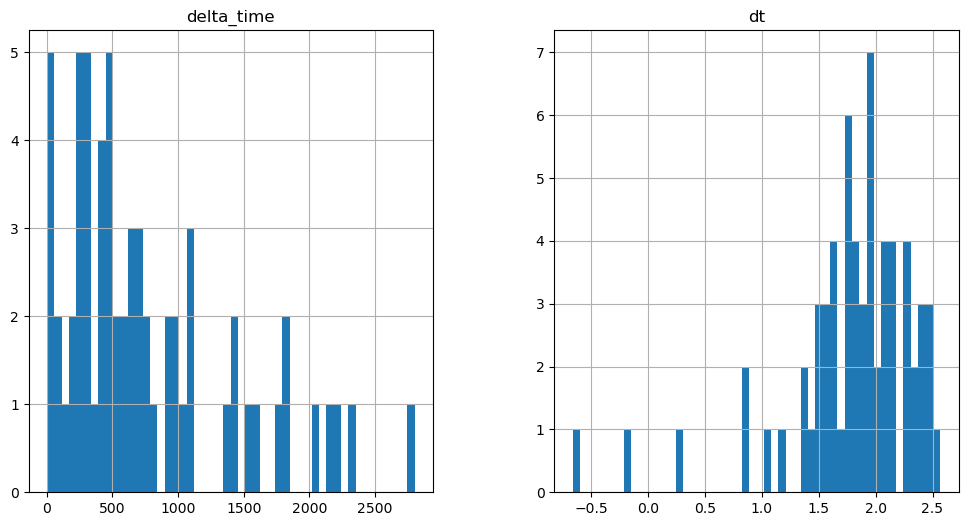

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5582.75564956665 6.564090311527252


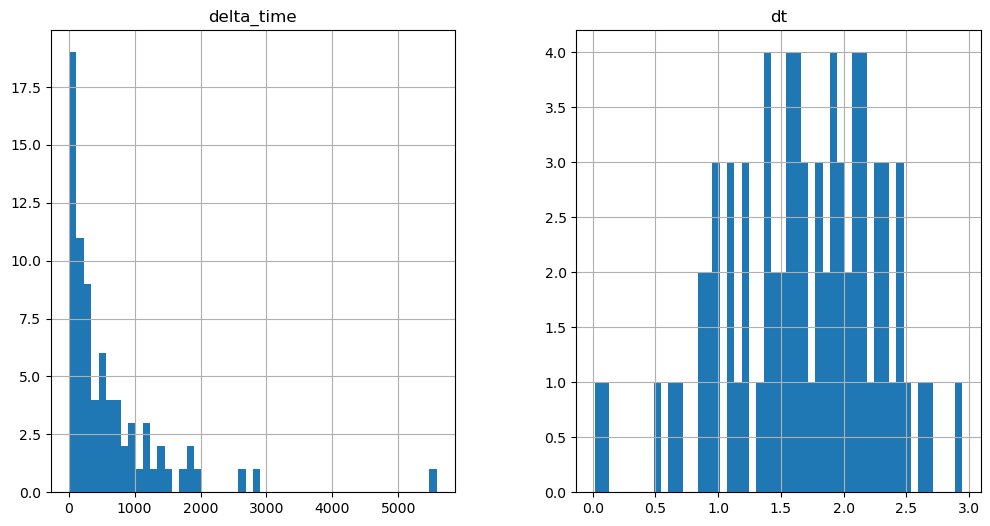

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2440.1994721889496 4.923080205917358


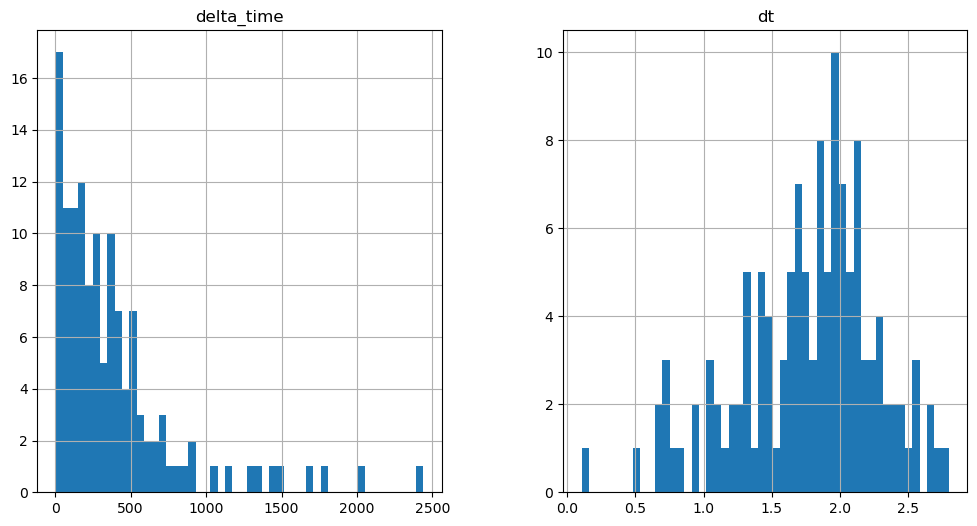

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1405.7434902787209 2.964130163192749


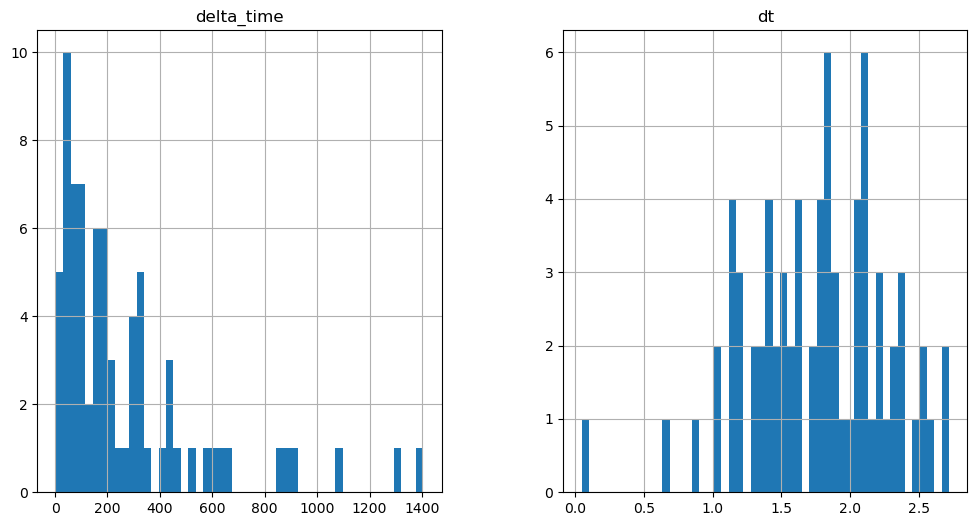

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

396.4526299238205 0.1


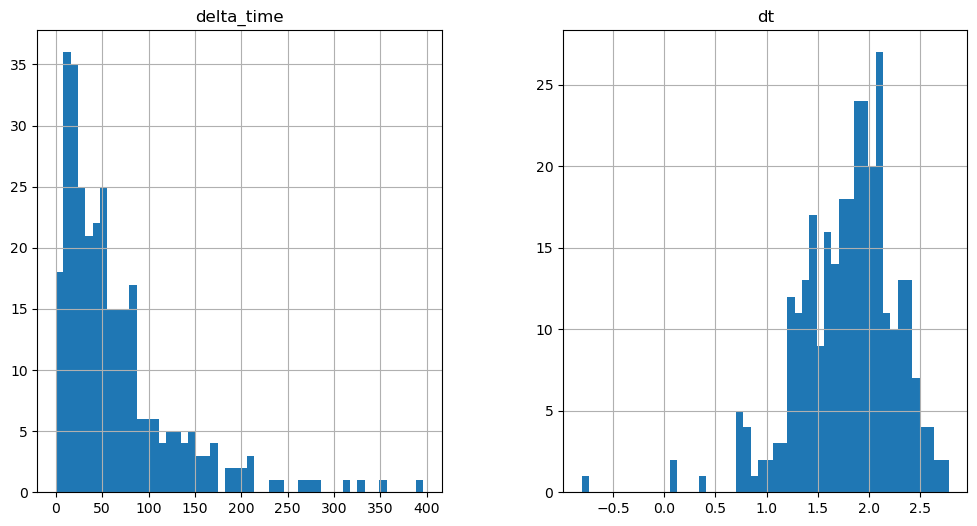

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2946.2793167829514 0.1


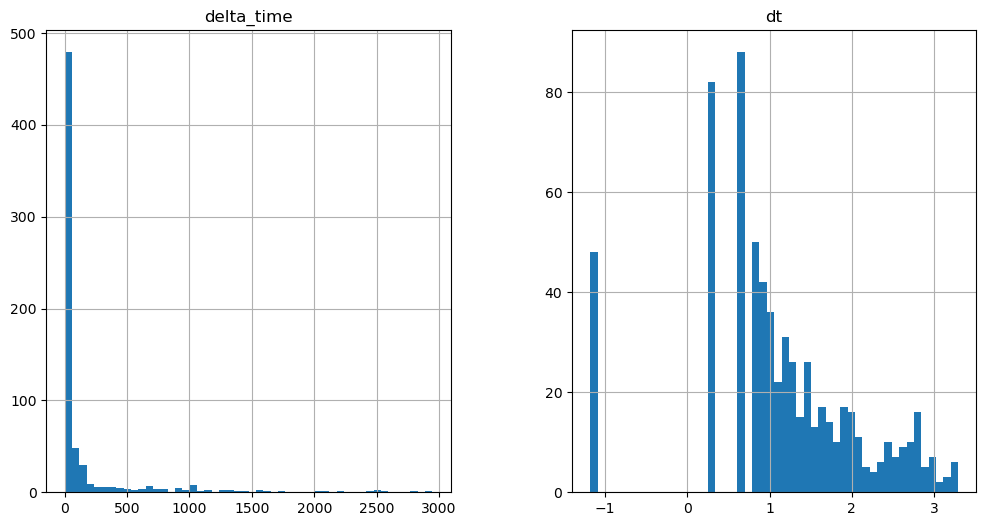

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1793.5193592905998 0.1


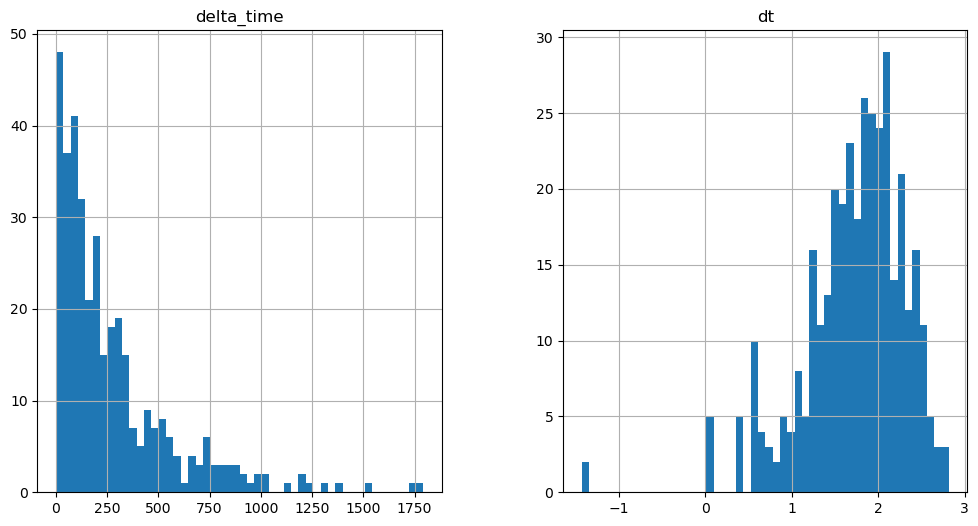

7604.388068854809 6.282040178775787


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

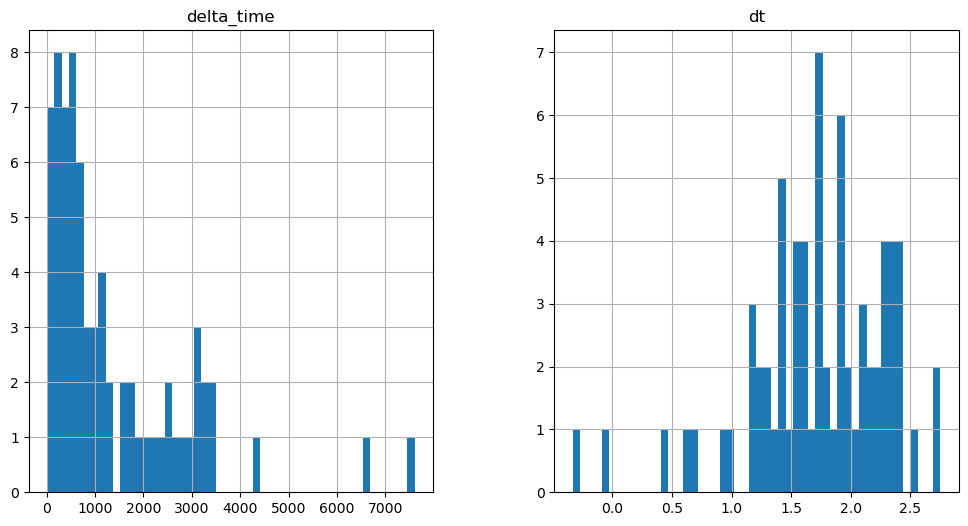

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

153.91000765562057 0.1


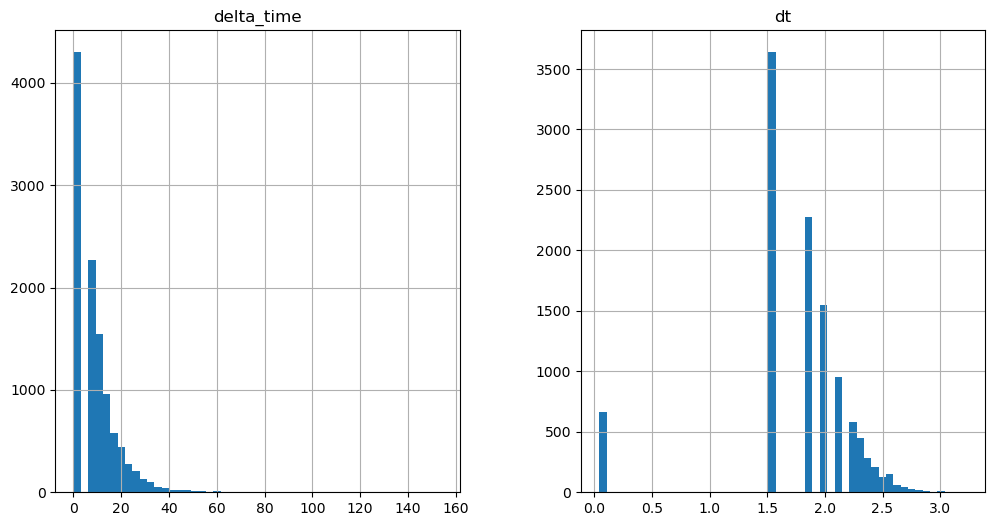

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5072.740612745285 18.846050918102264


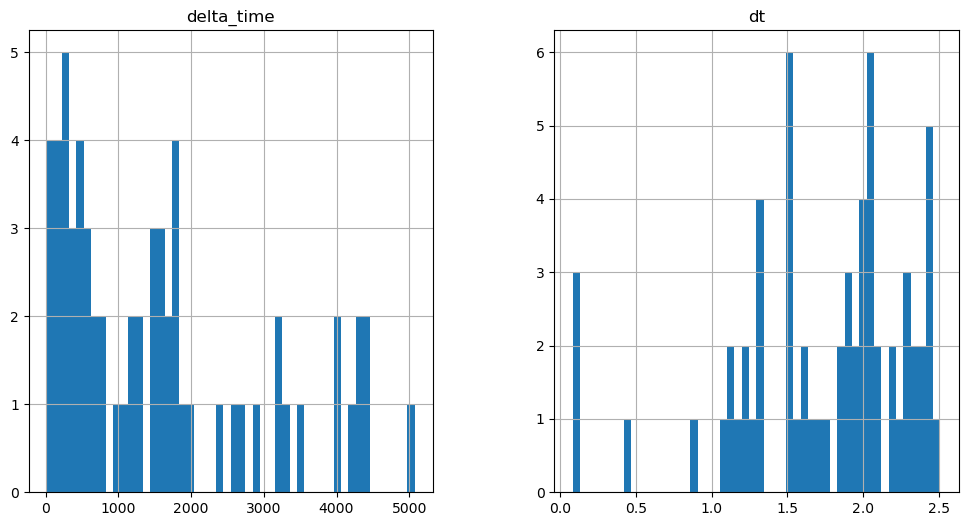

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3480.2446234226227 12.564090609550476


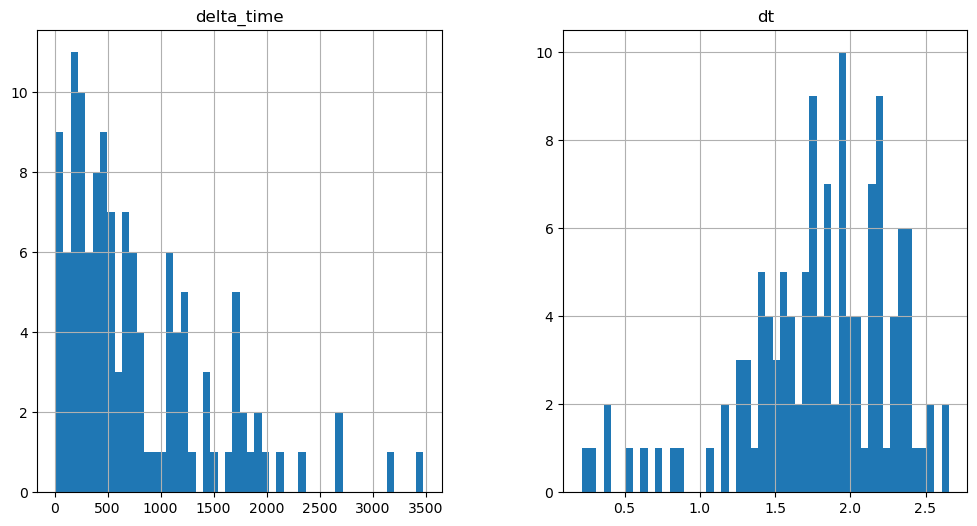

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3451.9843720197678 0.1


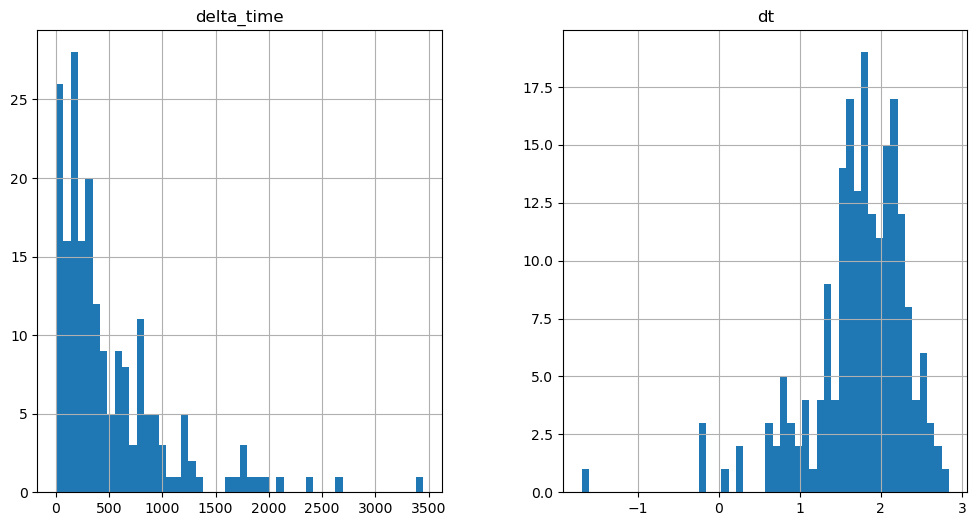

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3659.2704422473907 3.1410300731658936


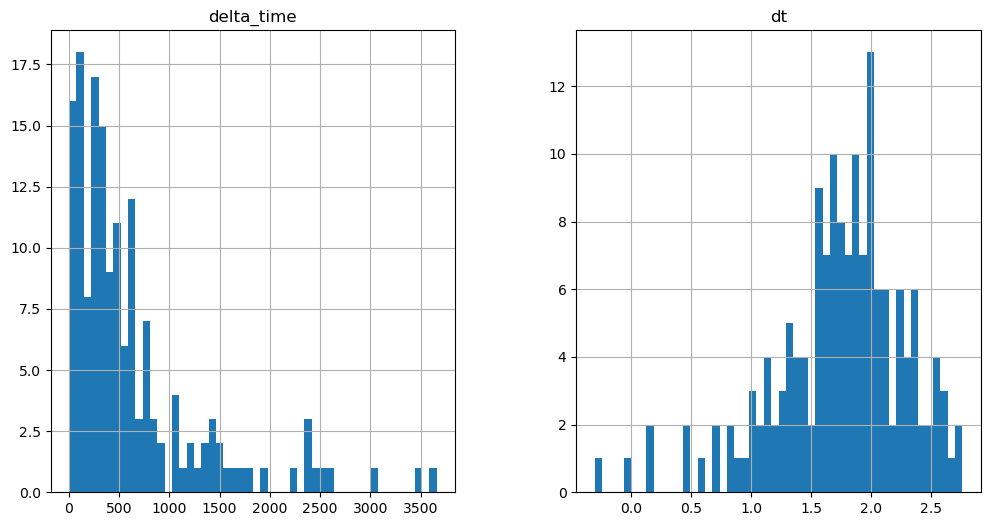

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2735.8311463594437 3.1410102248191833


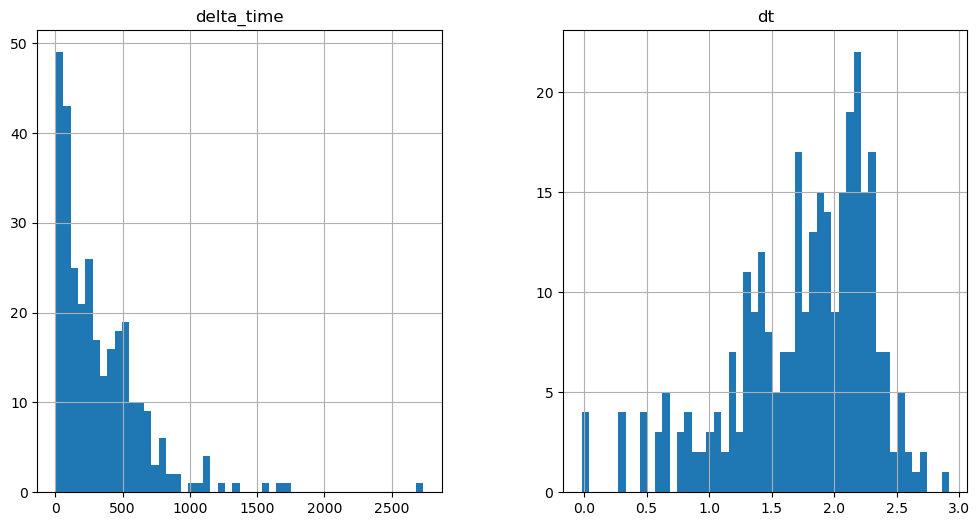

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1780.9582387208939 0.1


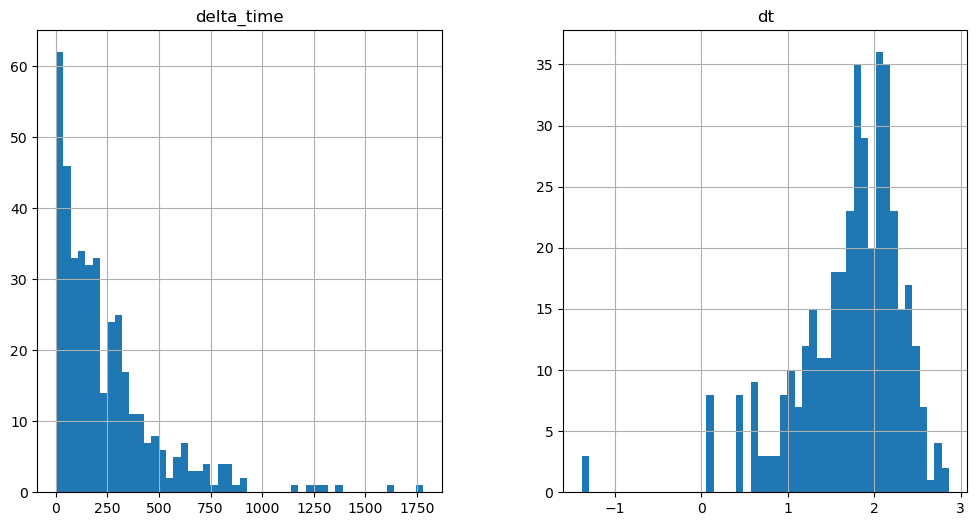

7670.377392232418 9.423080384731293


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

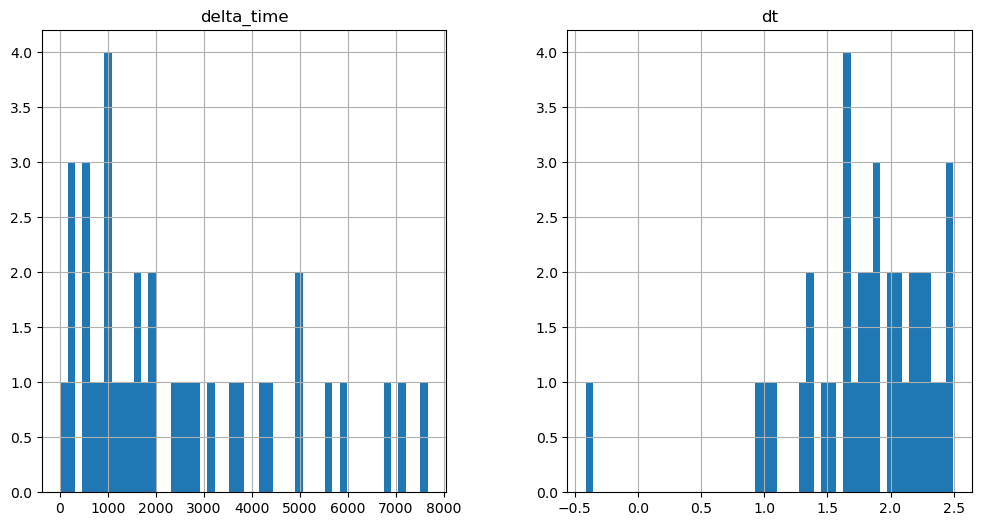

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2044.8059718608856 0.1


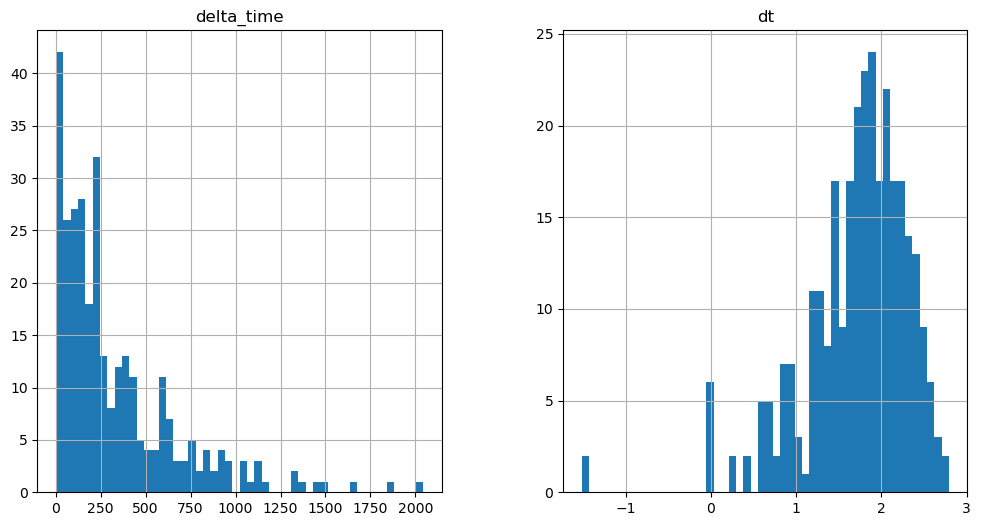

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2660.4351825118065 3.1410102248191833


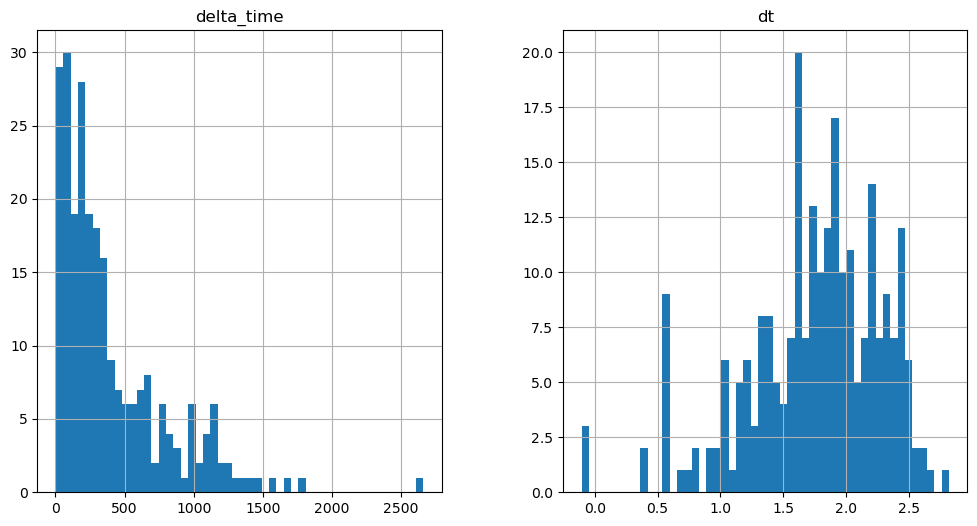

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5374.28365778923 12.564060628414154


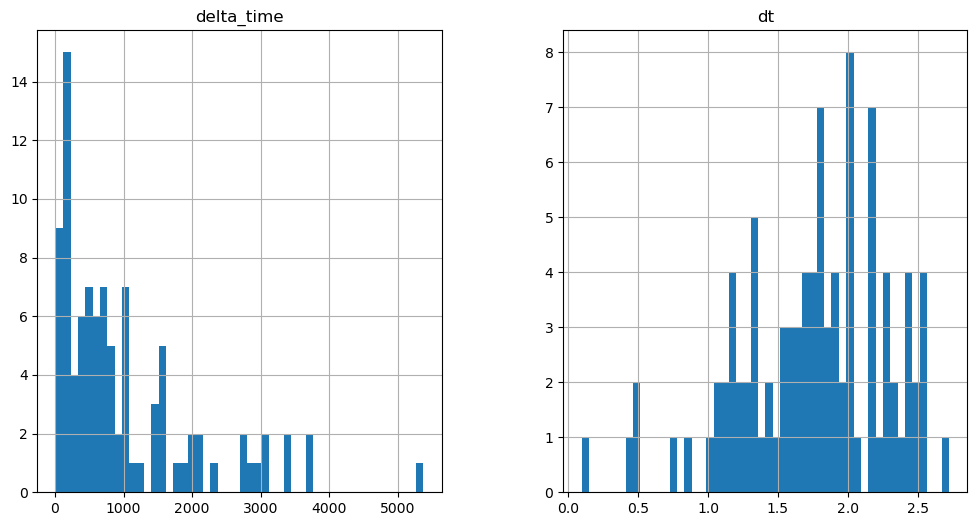

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4648.714211702347 12.564080715179443


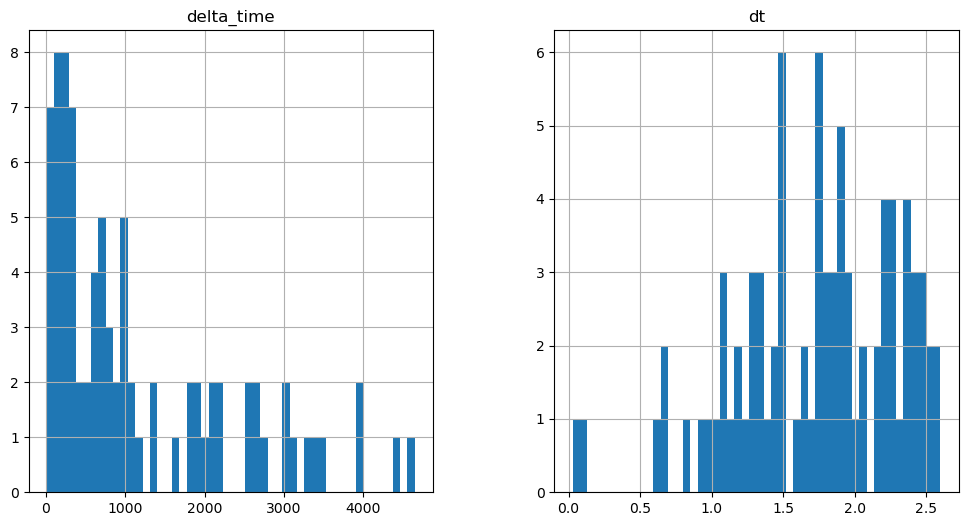

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4906.277424454689 12.564100563526154


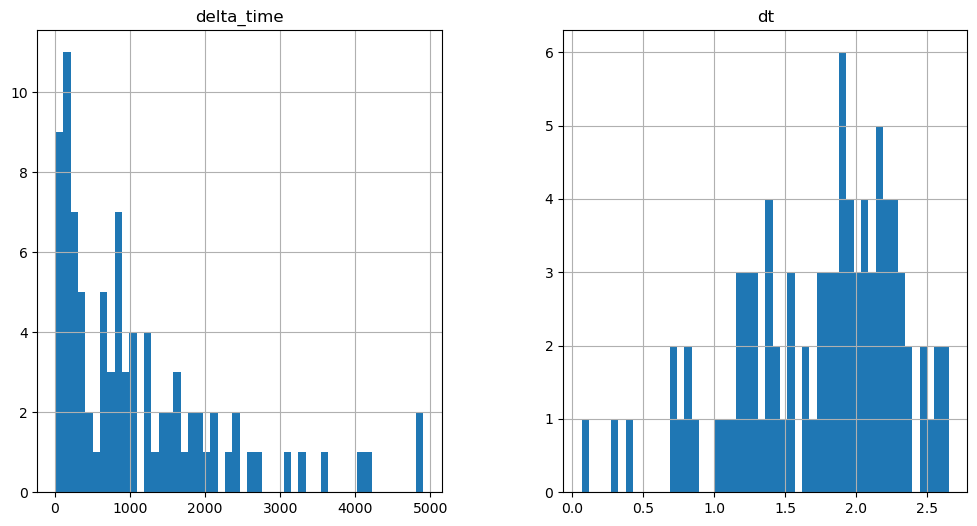

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

11376.738036692142 15.70510083436966


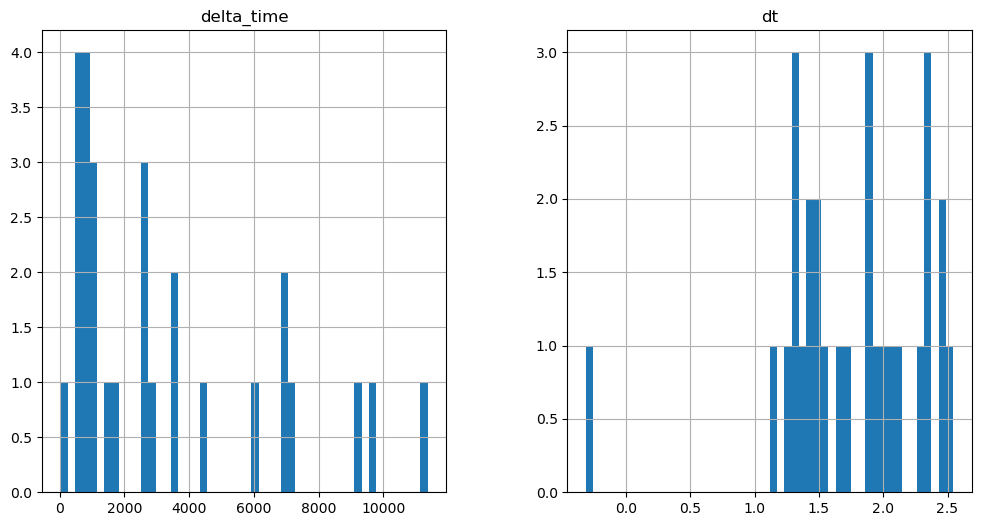

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2340.059616625309 0.1


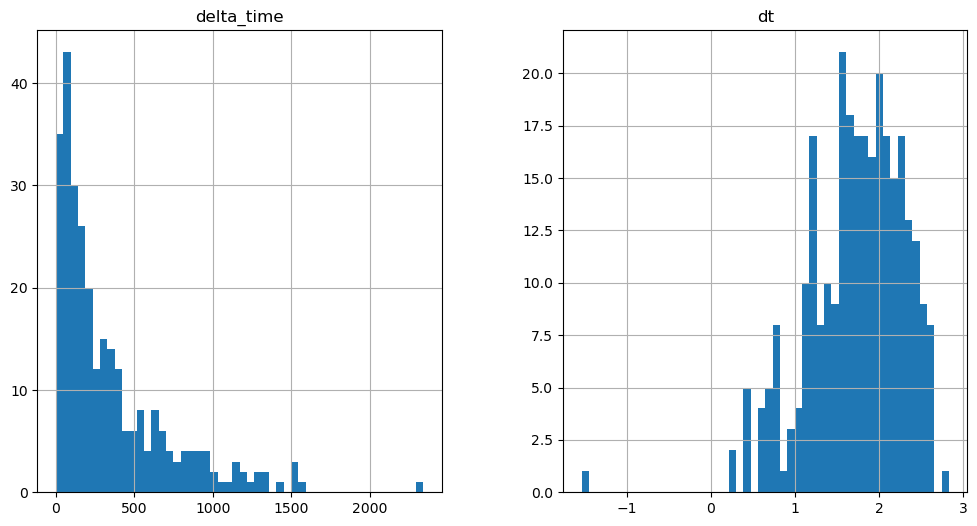

4431.983170926571 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

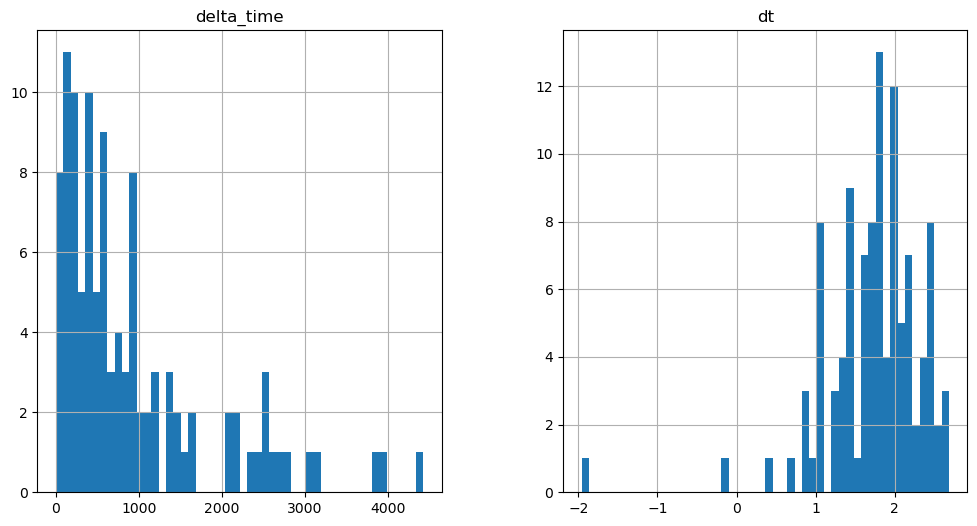

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

7805.414158880711 3.1410200595855713


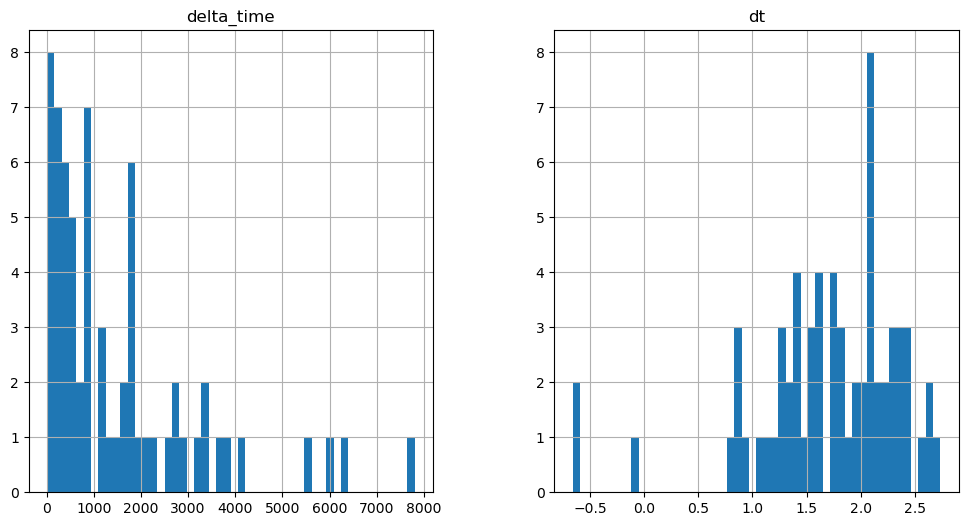

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

10318.248834133148 21.98717099428177


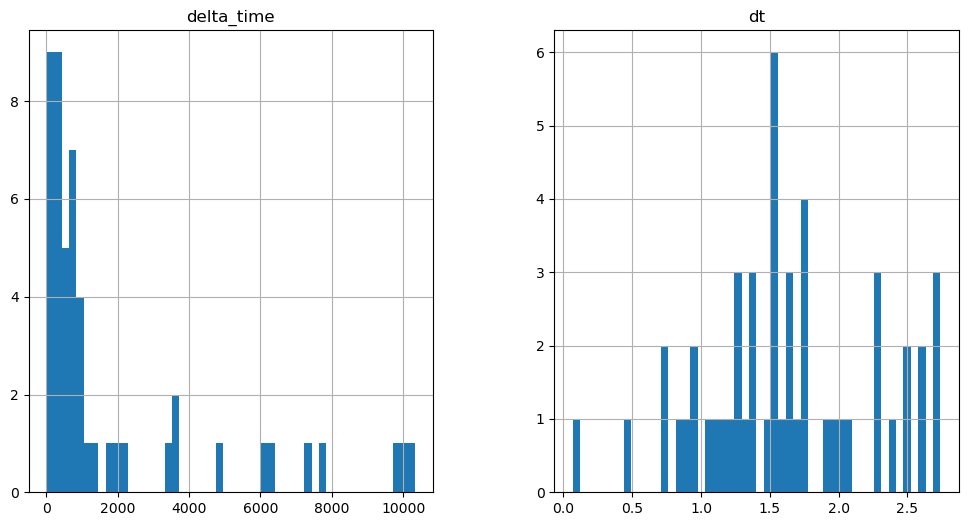

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2676.1515033245087 6.282040297985077


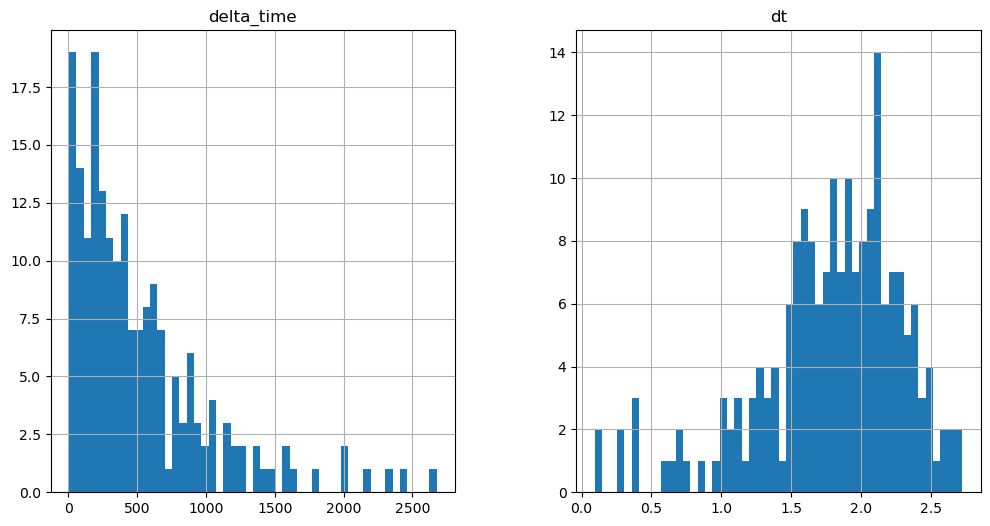

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5905.123284161091 3.141010284423828


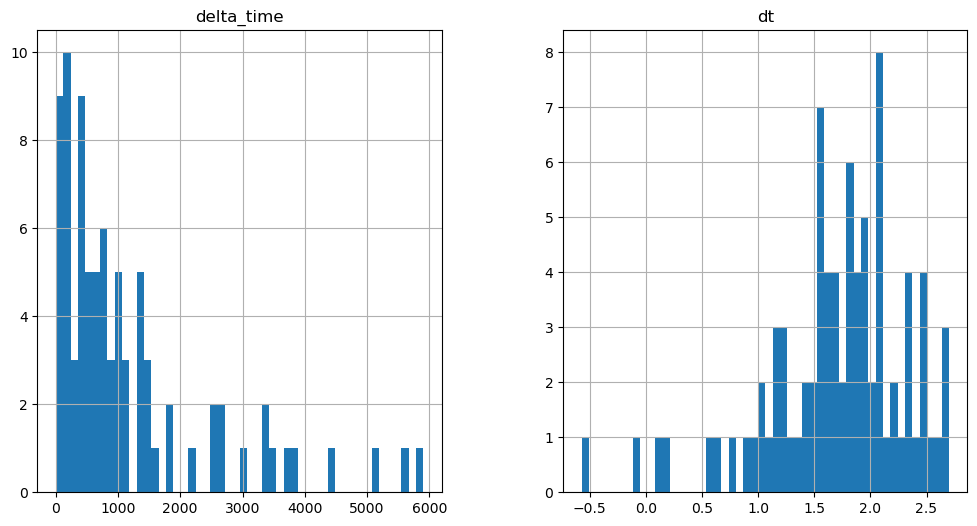

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

10754.786393165588 37.69196206331253


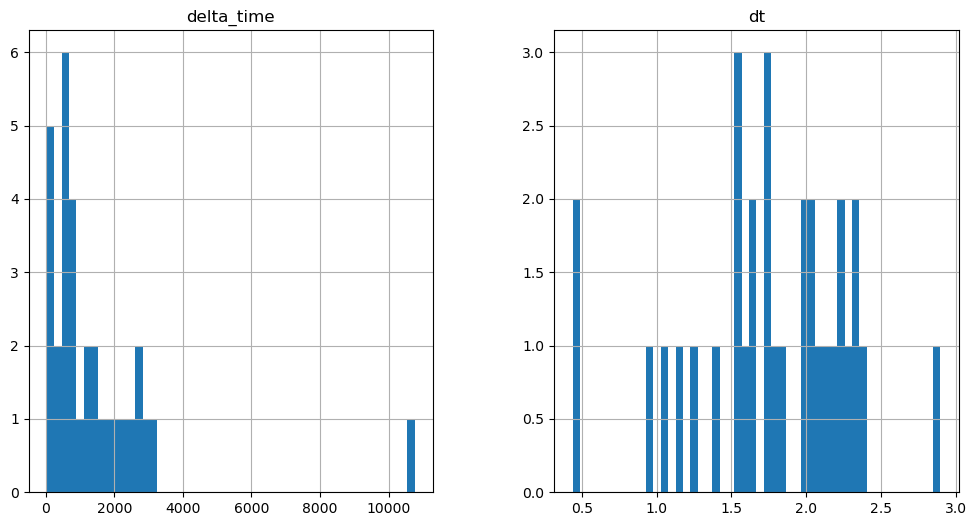

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3621.5738795995712 25.12798136472702


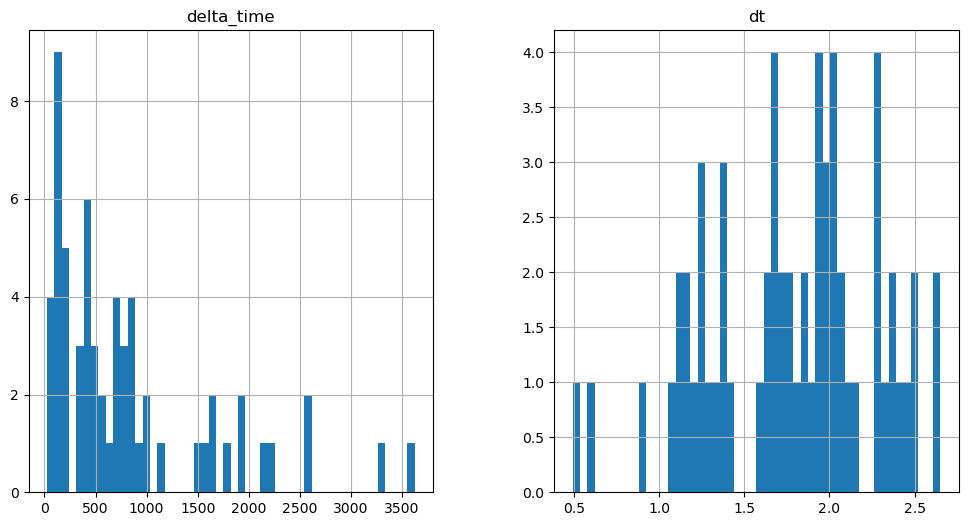

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2239.5335209965706 3.141020119190216


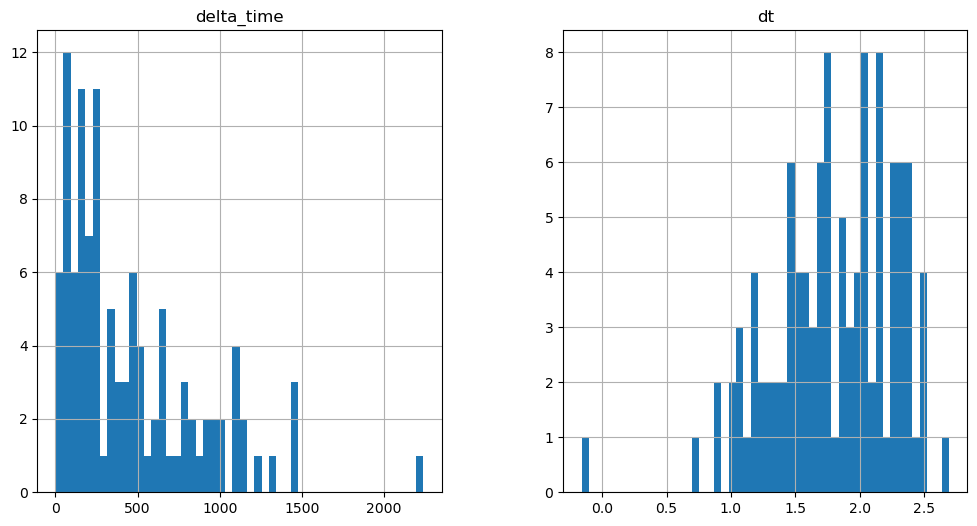

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

408.3300802707672 0.1


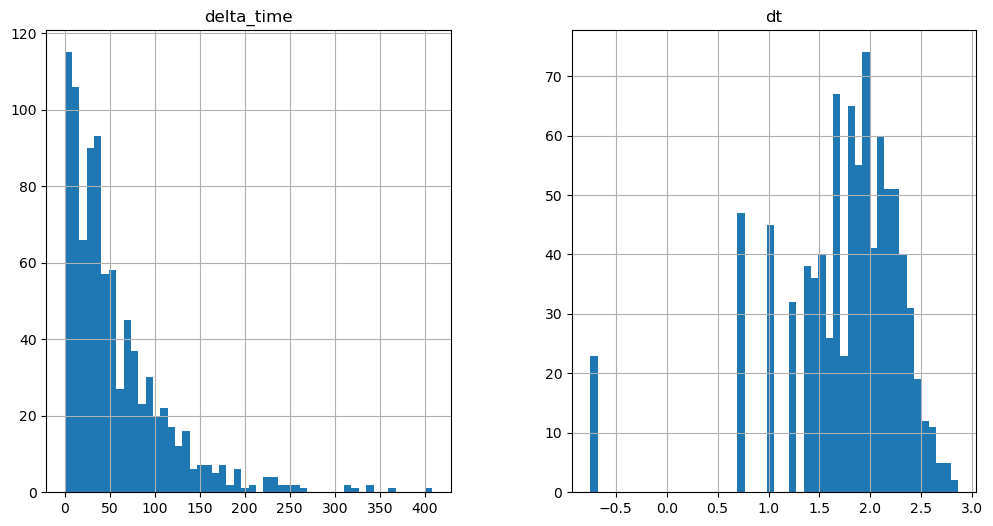

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

8430.445777833462 0.1


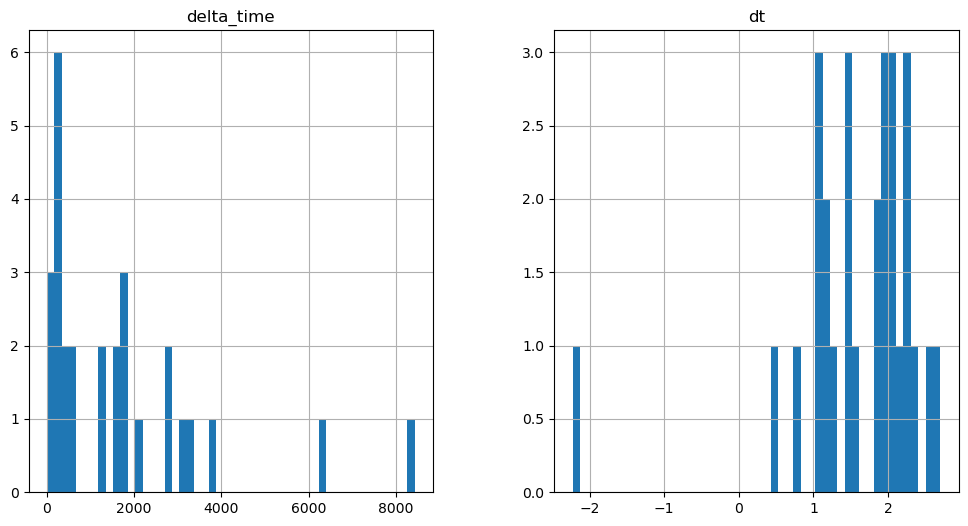

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3759.7777963876724 6.282000184059143


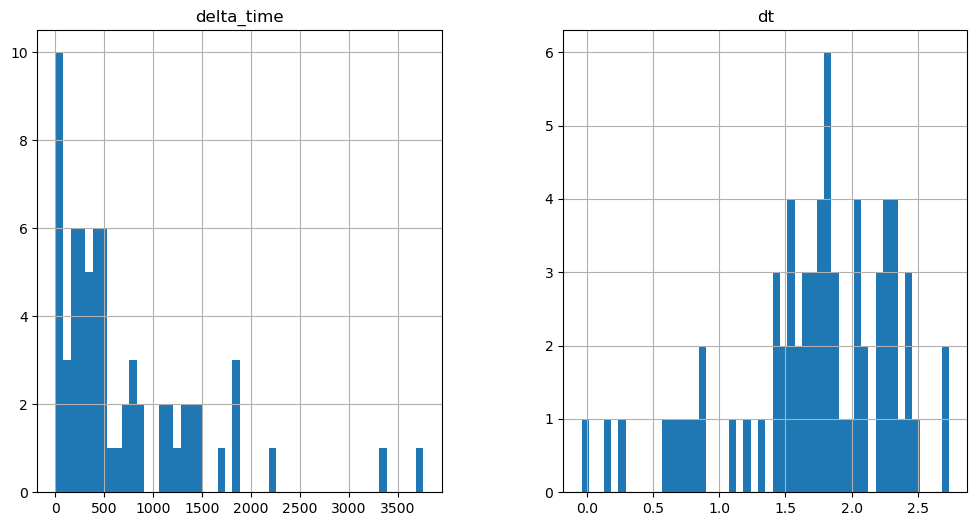

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3147.2827560305595 12.56398069858551


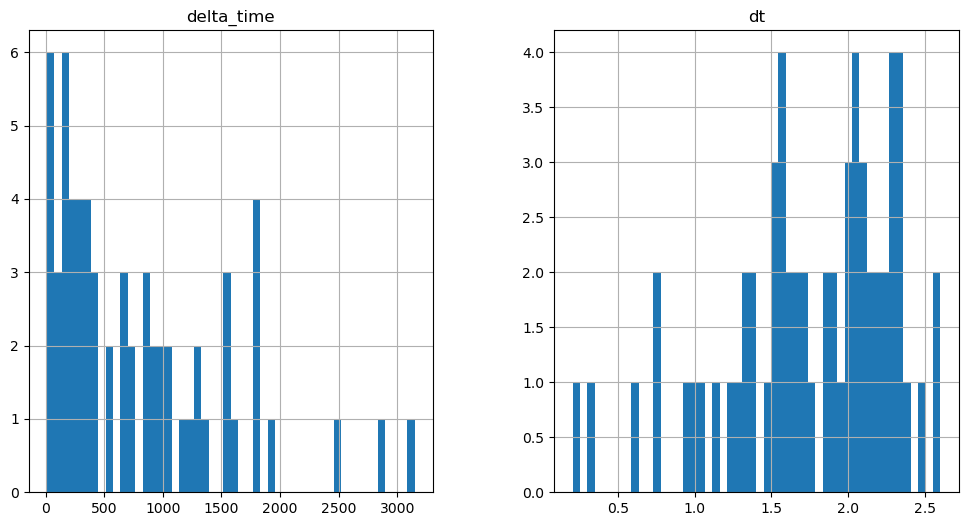

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3495.933793246746 6.282000362873077


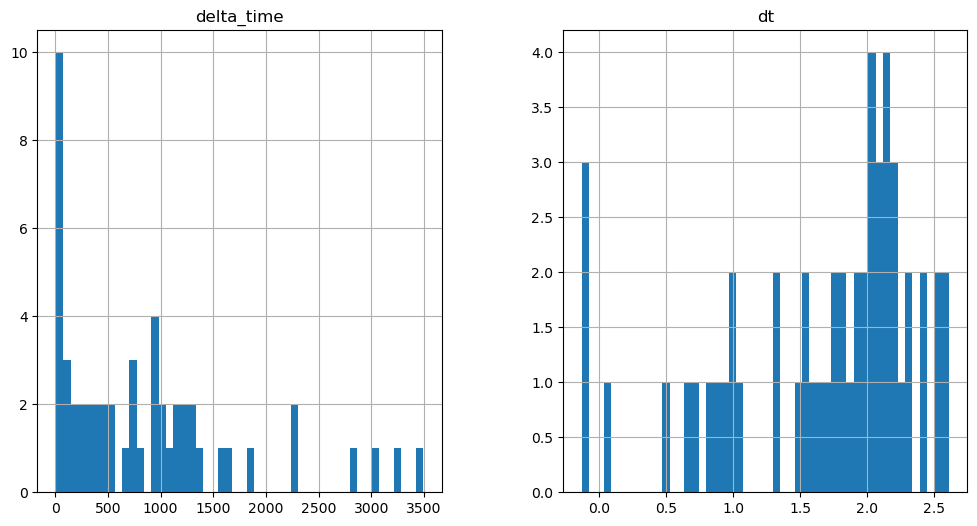

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2773.503587603569 56.53800284862518


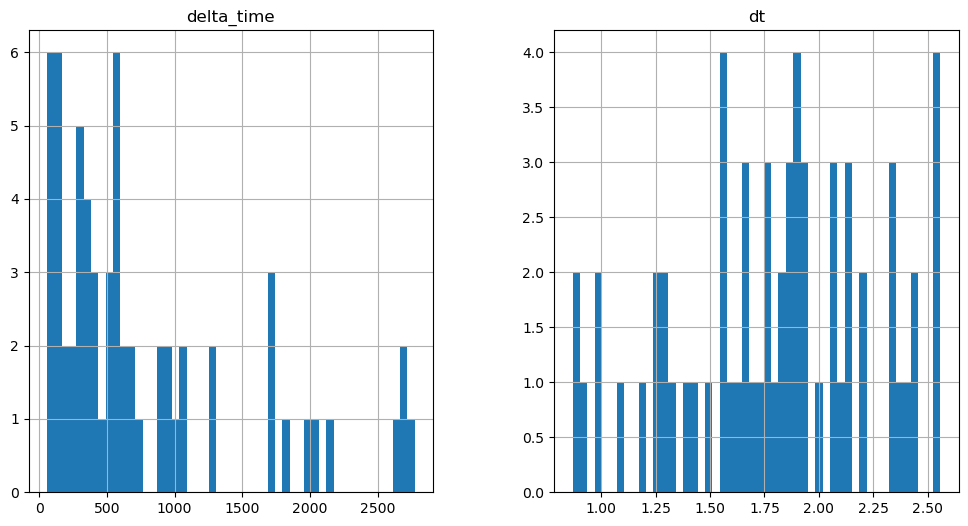

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2874.0156224370003 3.1409603357315063


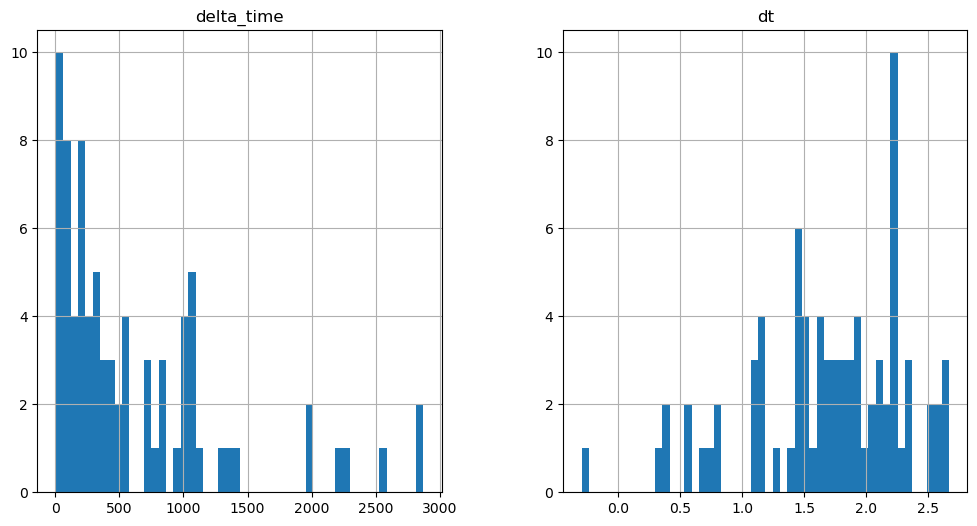

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

7023.277608215809 37.692001938819885


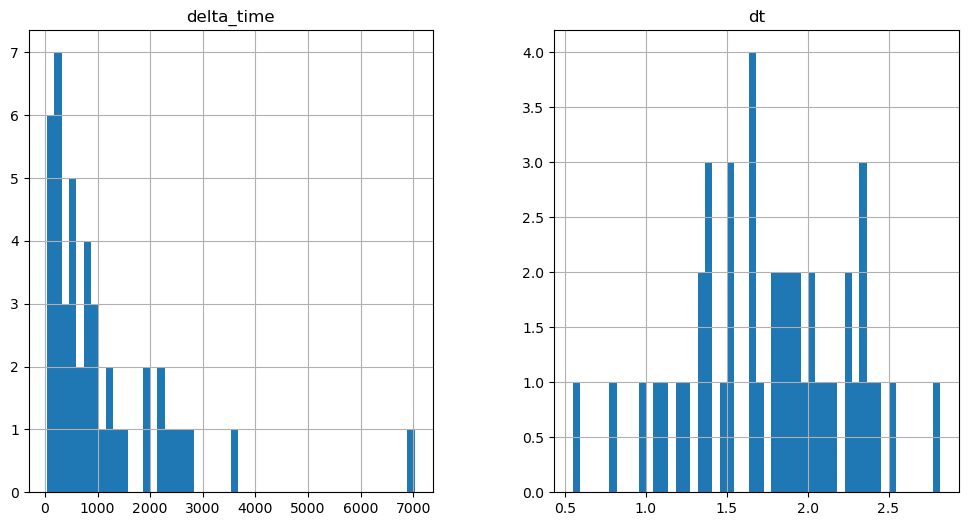

6831.6765486598015 18.846000909805298


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

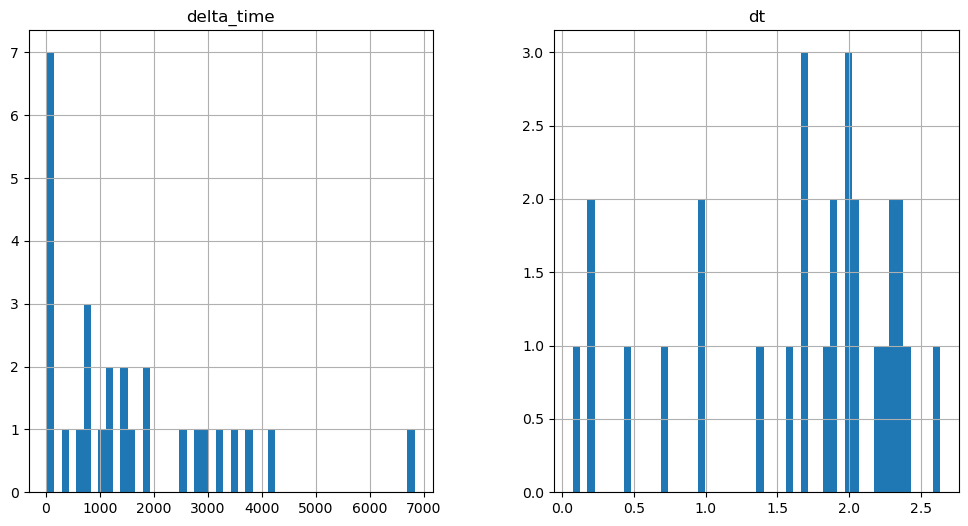

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4036.1859201788902 12.564000606536865


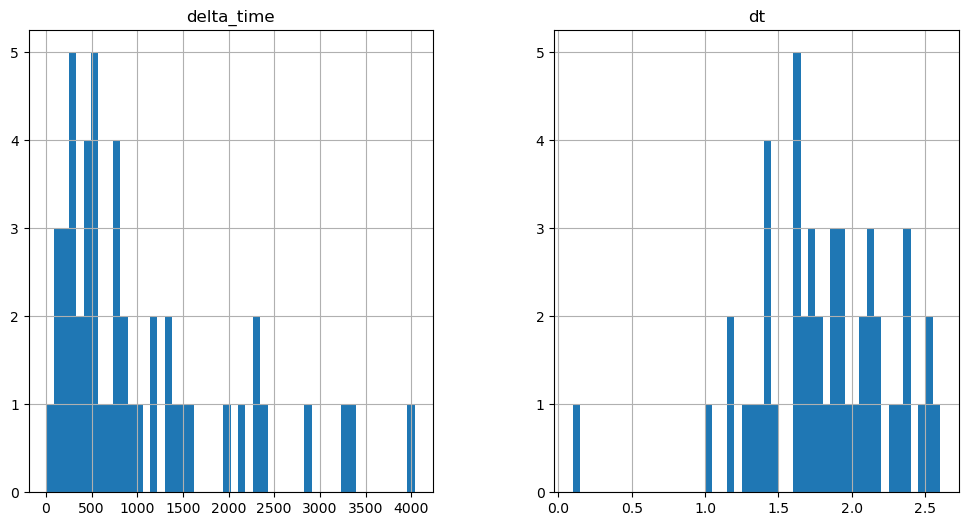

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4724.065004110336 18.84601092338562


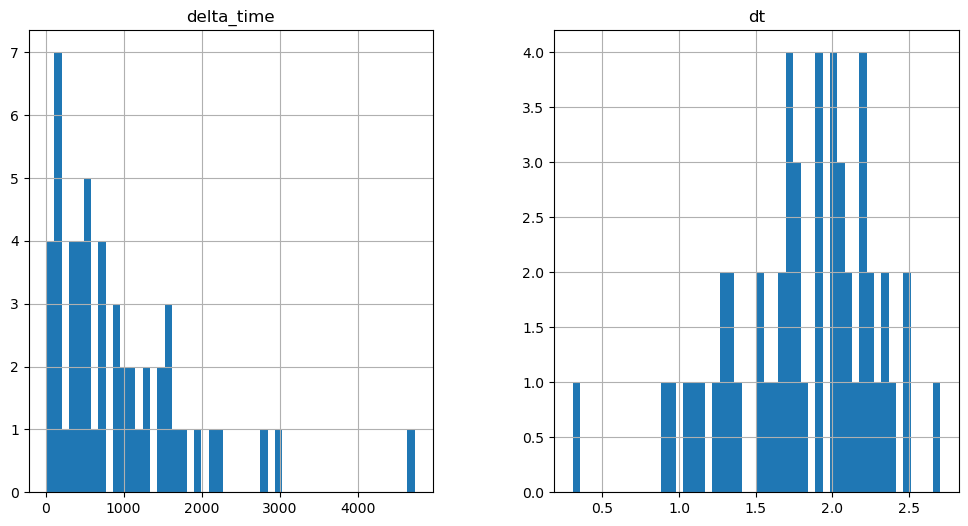

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3866.571901679039 3.141010105609894


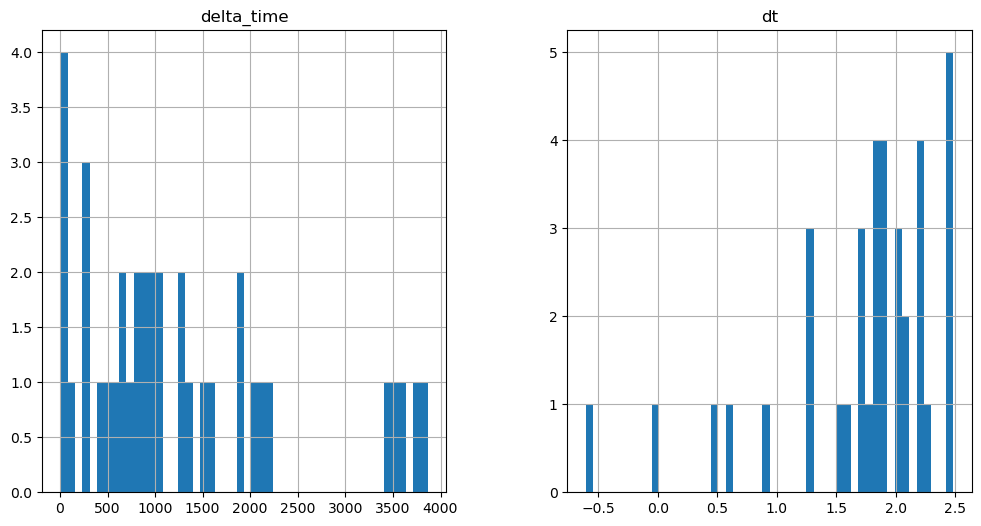

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

135.06373673677444 0.1


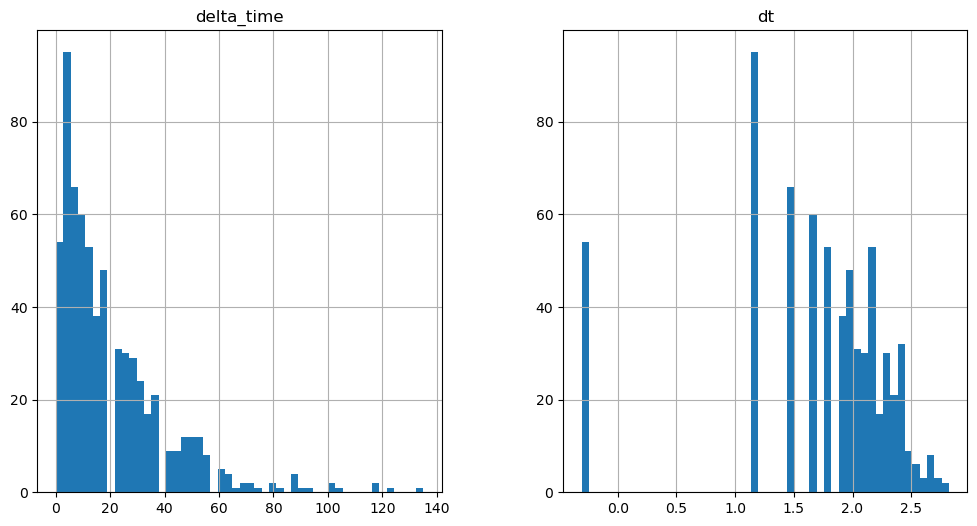

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

719.2929357886314 0.1


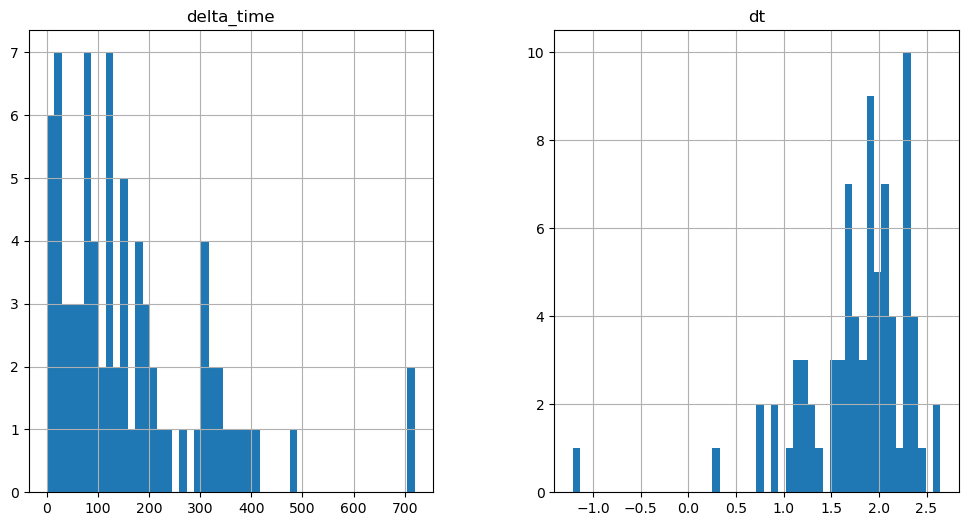

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2738.965776145458 0.1


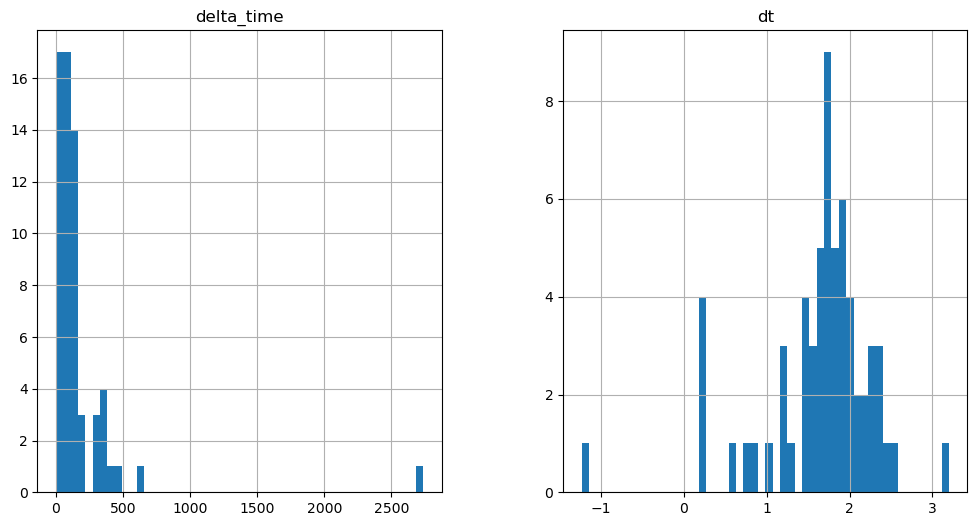

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1168.4594880342484 6.282020270824432


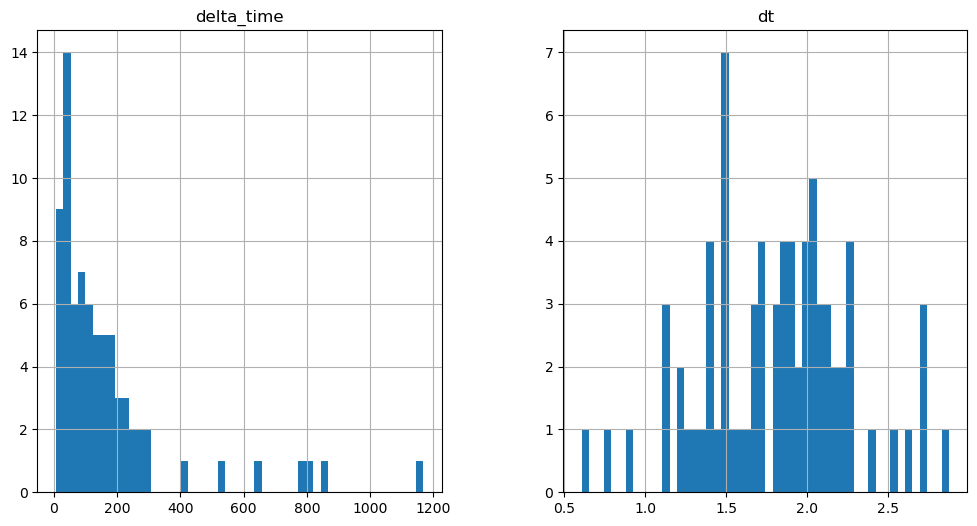

477.43447375297546 3.1410001516342163


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

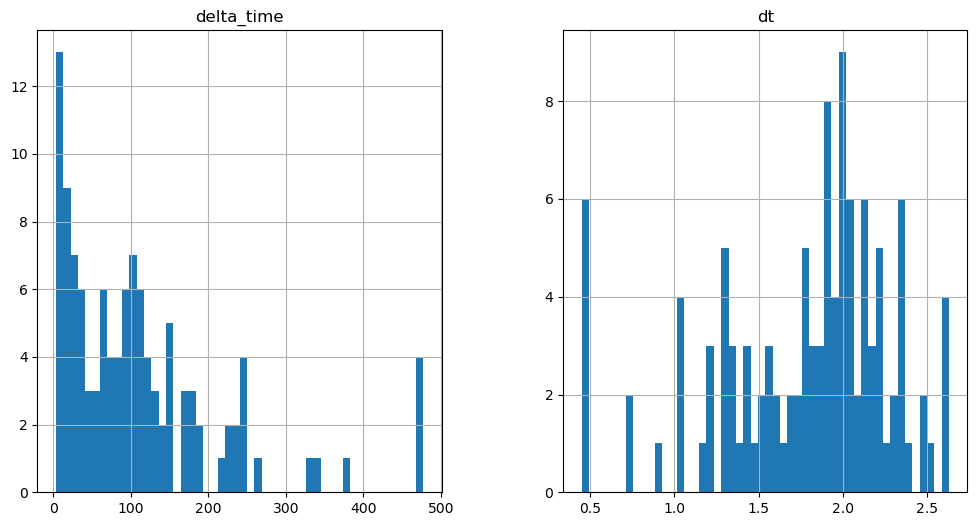

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

6649.538000404835 15.705120980739594


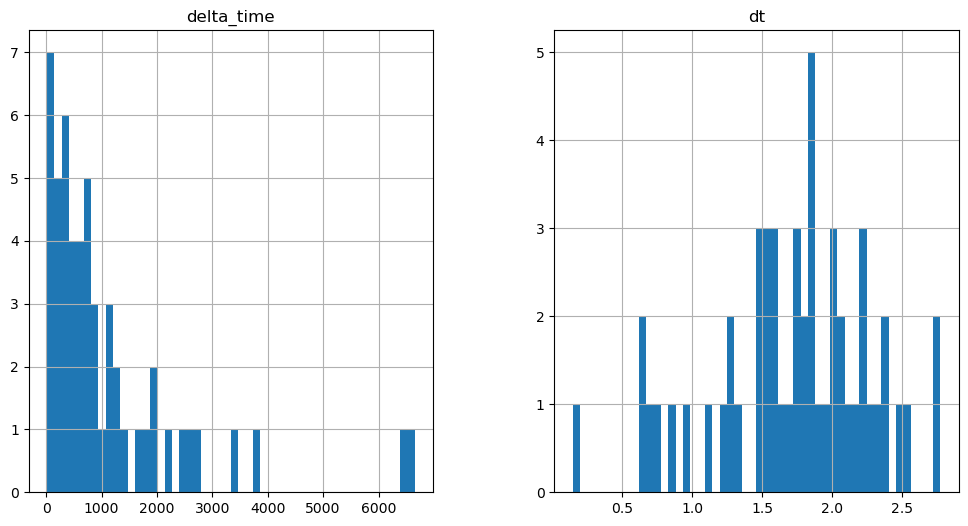

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1922.3079754710197 0.1


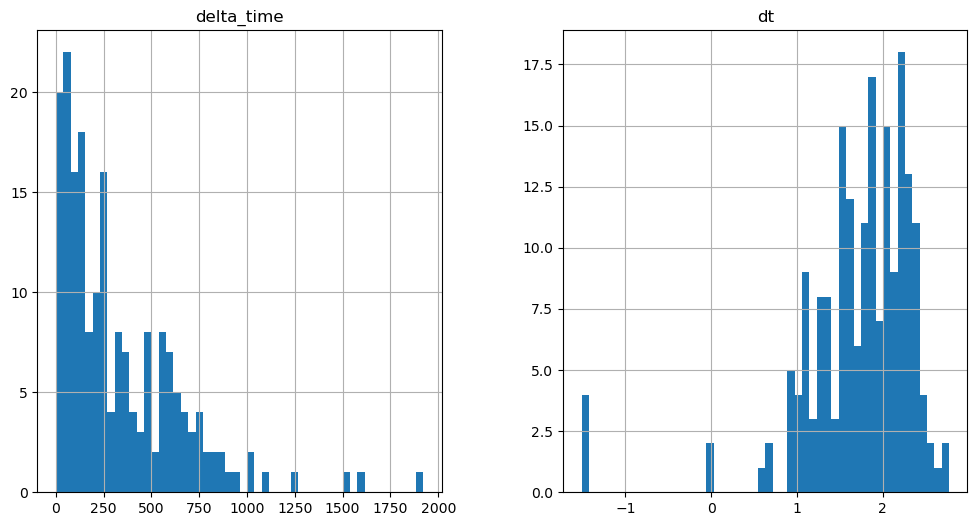

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4007.9493092894554 3.1410200595855713


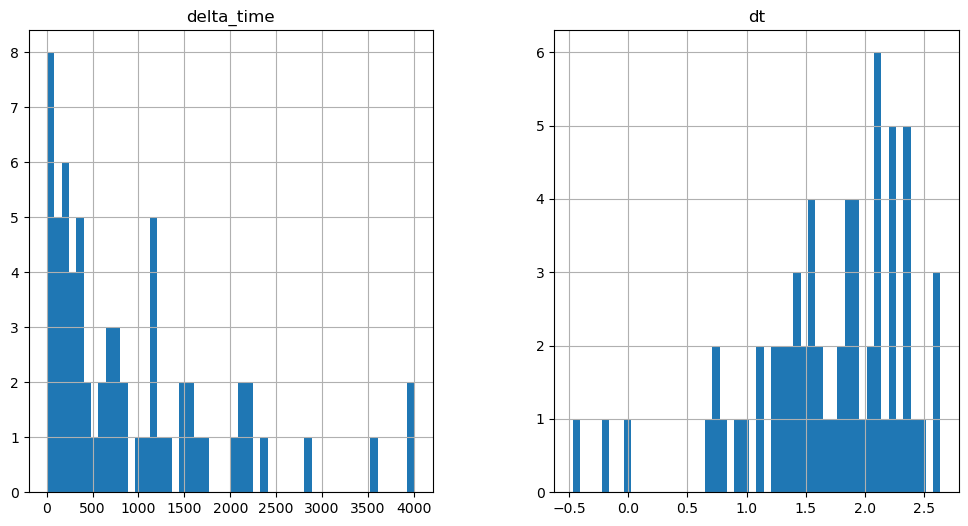

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4793.185678184032 0.1


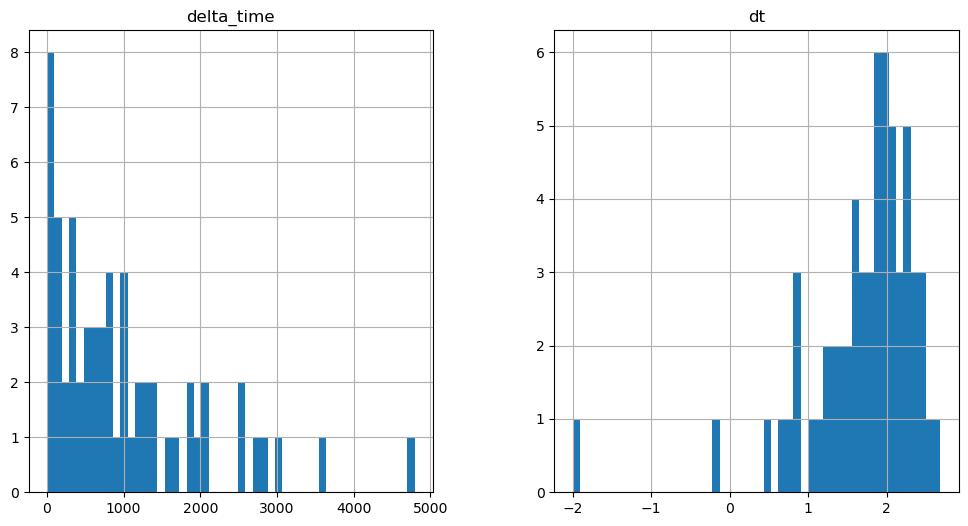

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

562.2411680817604 0.1


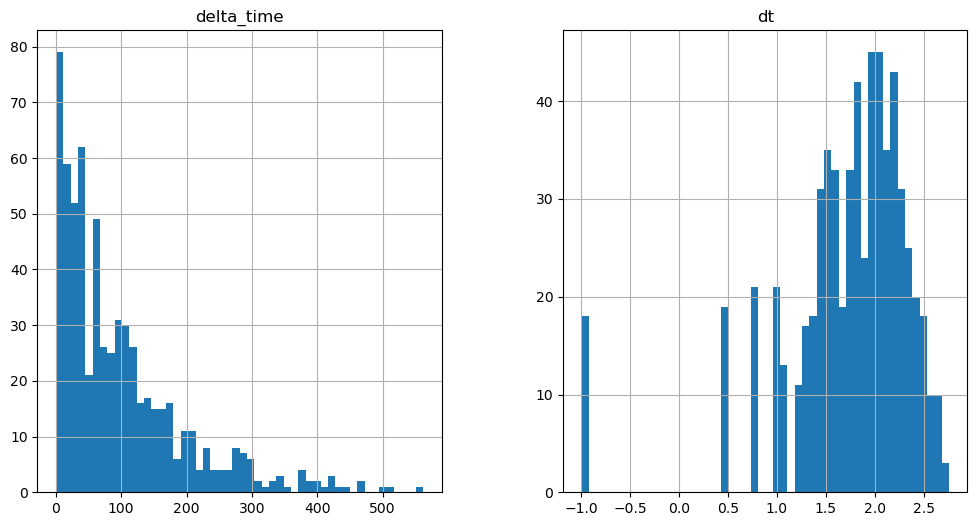

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3288.6470034122467 3.141020178794861


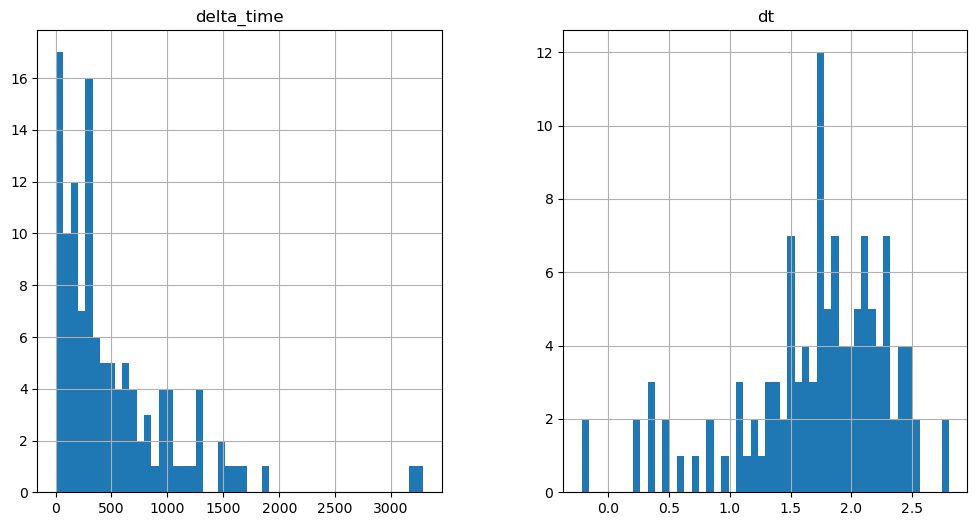

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2958.8464671969414 6.2820103764534


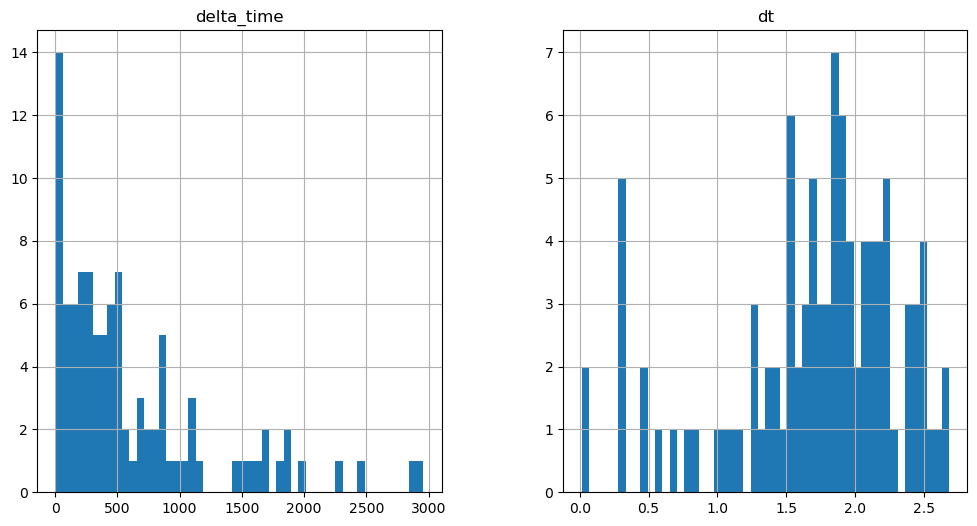

2710.692064702511 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

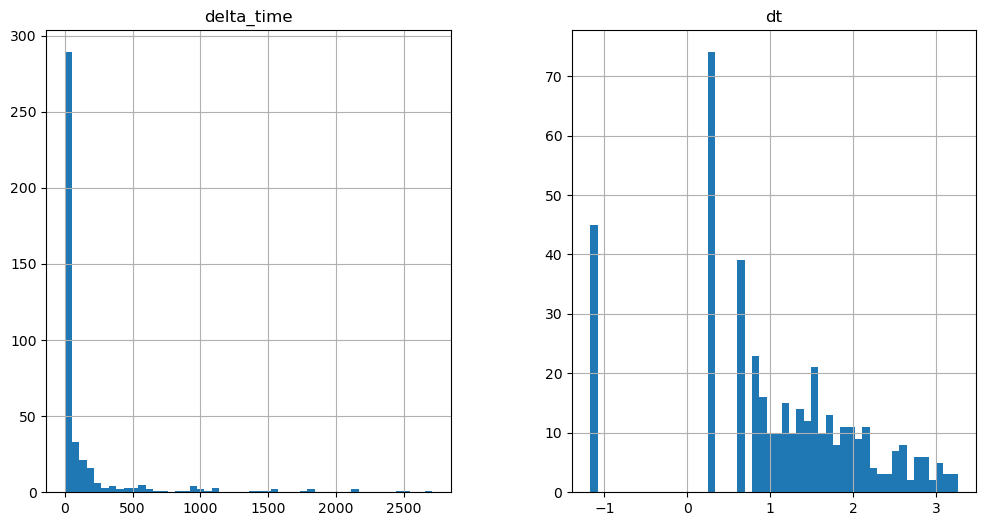

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4099.036623775959 37.69231188297272


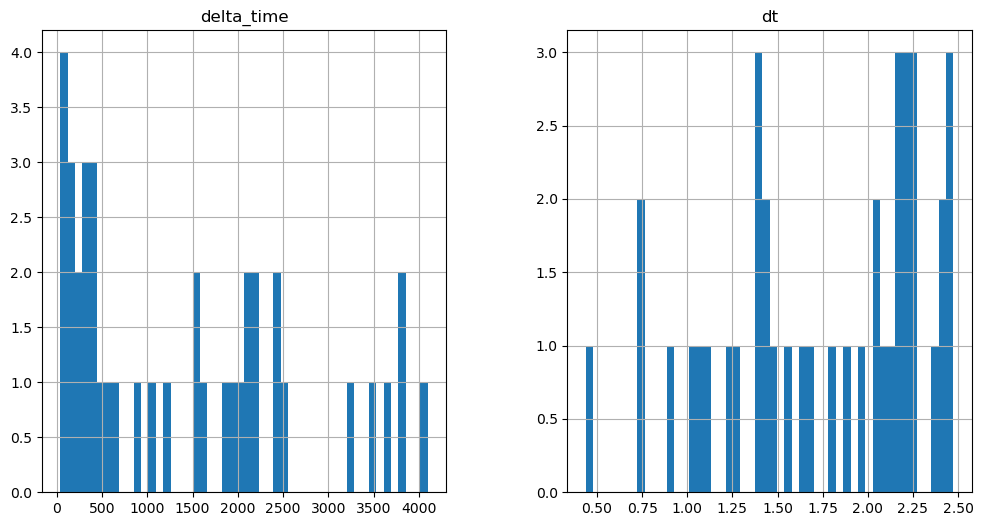

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2091.9229739904404 0.1


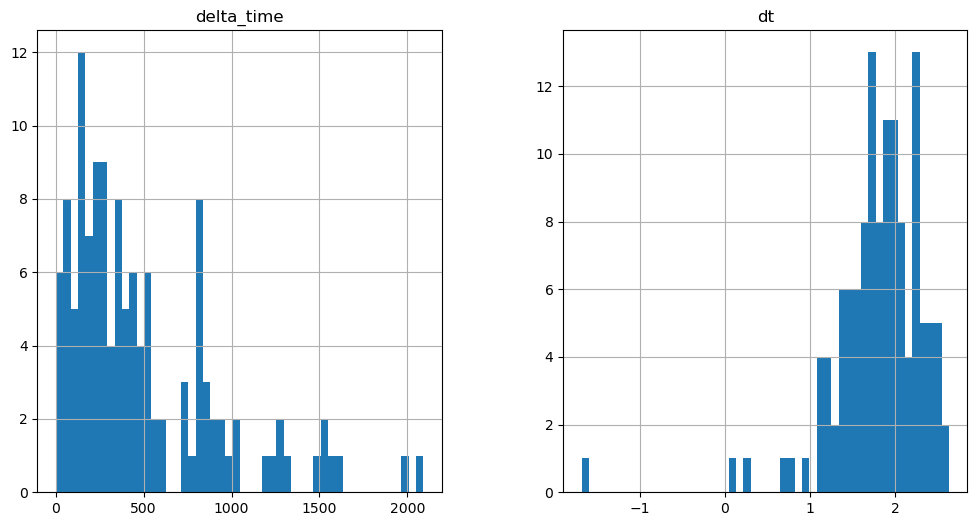

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

9592.65153670311 3.1410301327705383


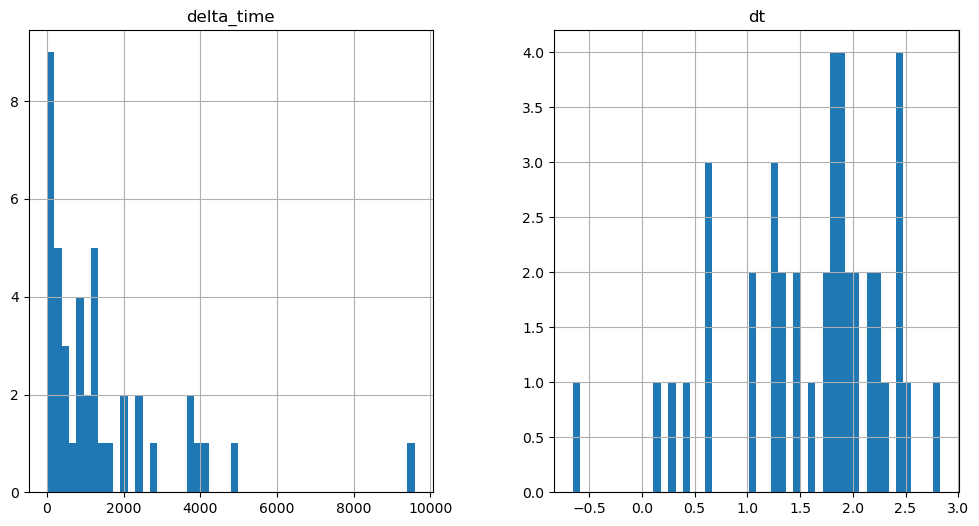

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2047.948641717434 0.1


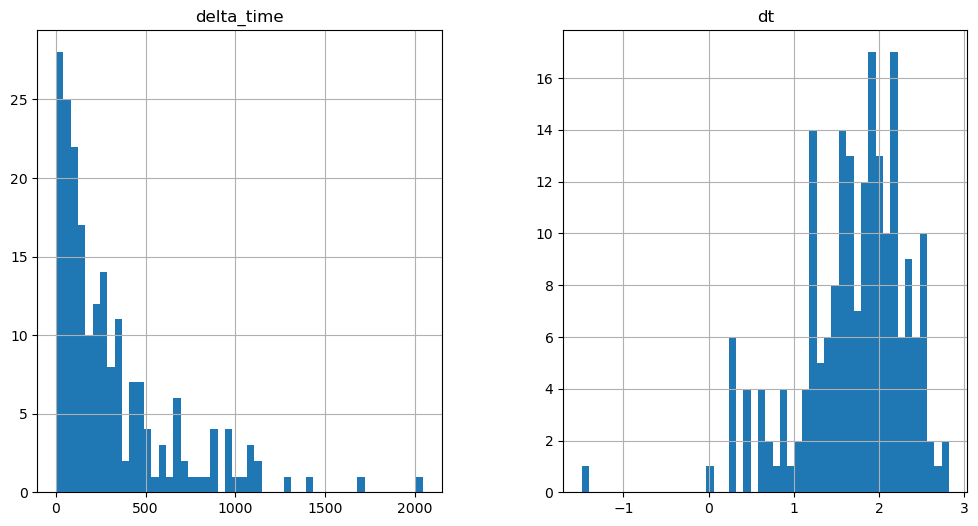

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

7849.408870220184 15.70512080192566


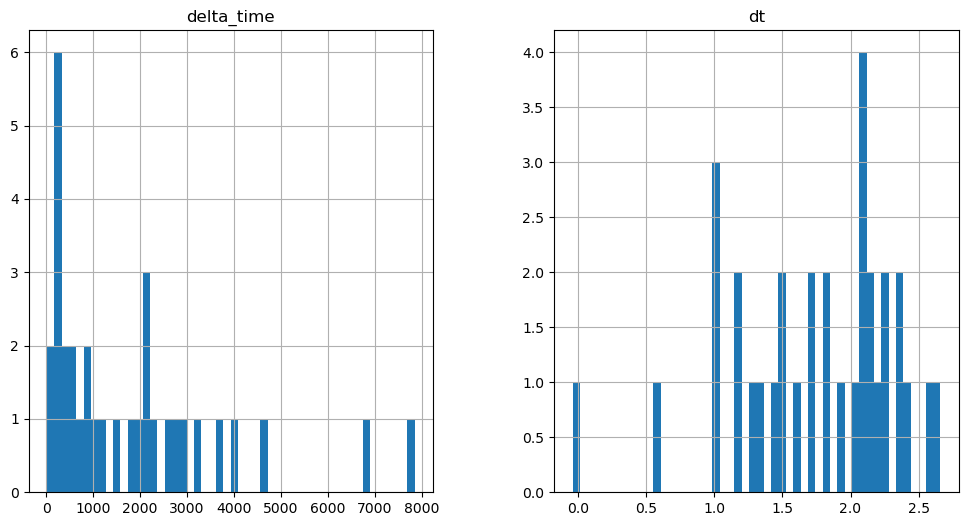

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4152.422836244106 6.282050251960754


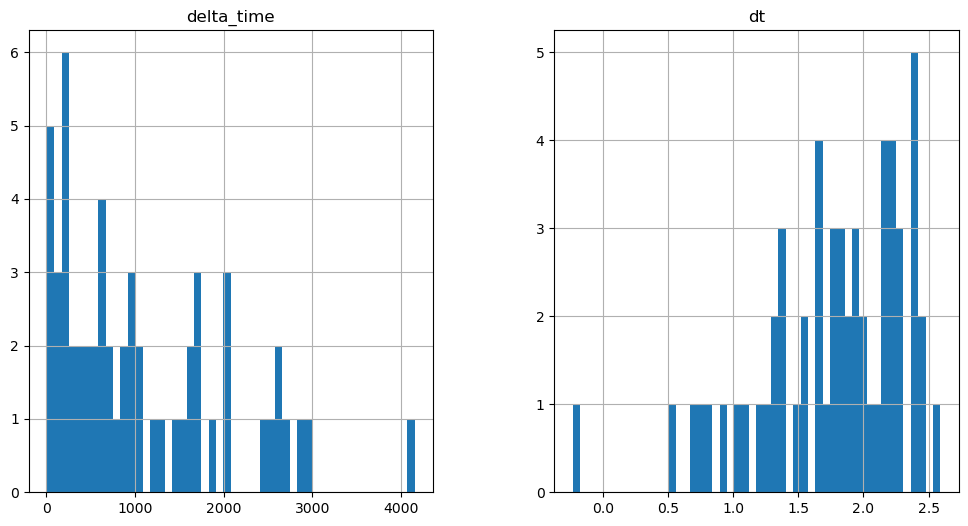

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

7836.8579595685005 12.56404060125351


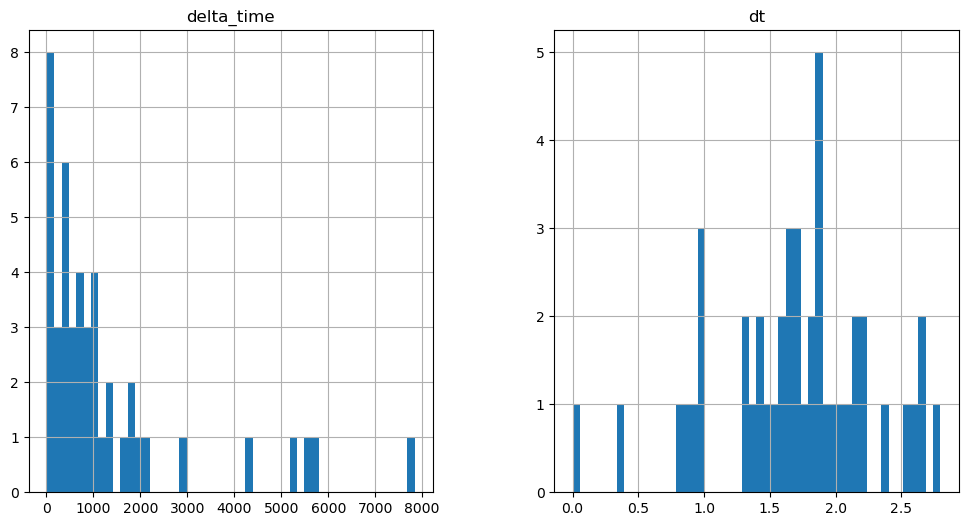

5820.307149350643 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

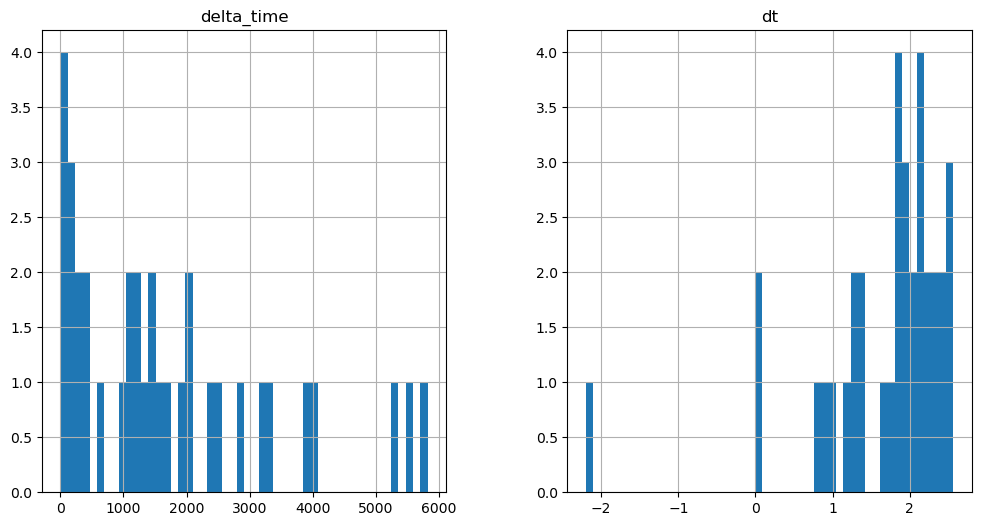

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5349.156755805016 37.69227182865143


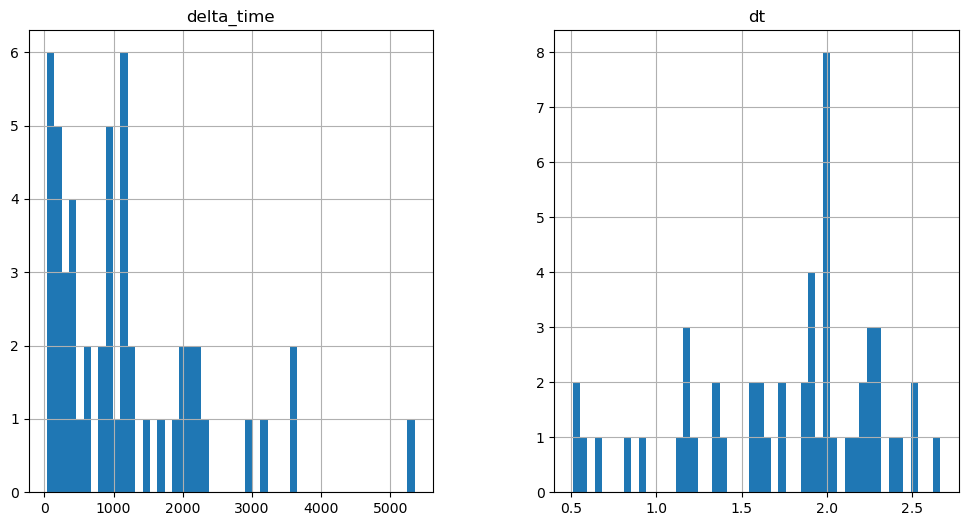

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

6869.41793358326 31.410201609134674


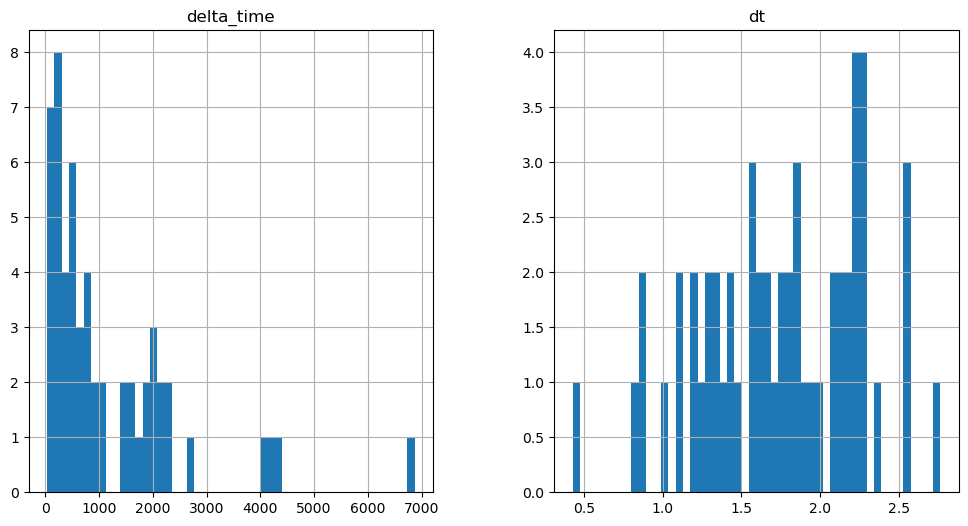

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4453.9656727313995 0.1


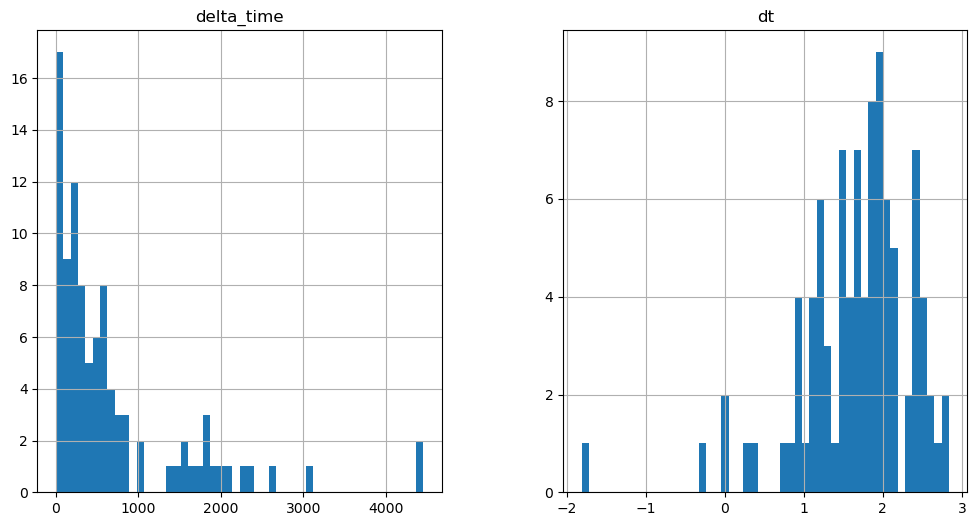

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2220.703441262245 0.1


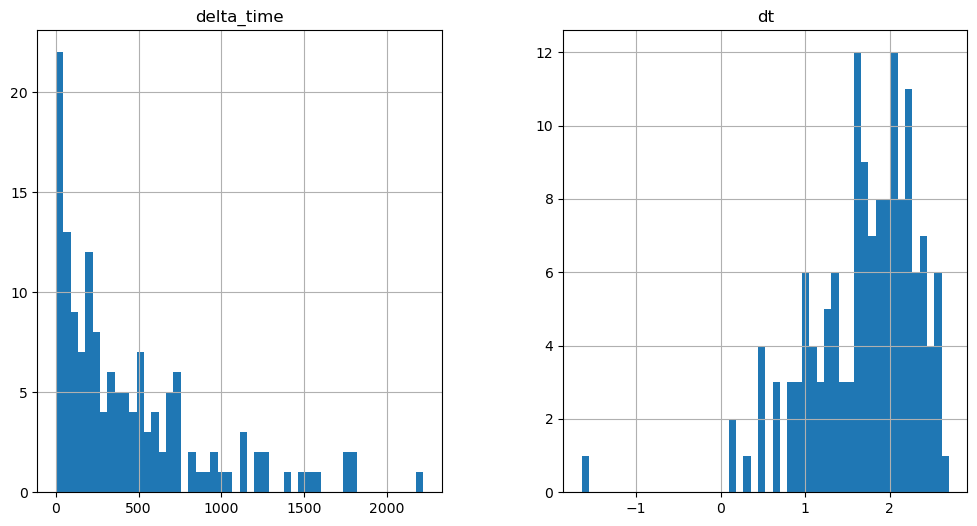

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3678.138714015484 6.282040357589722


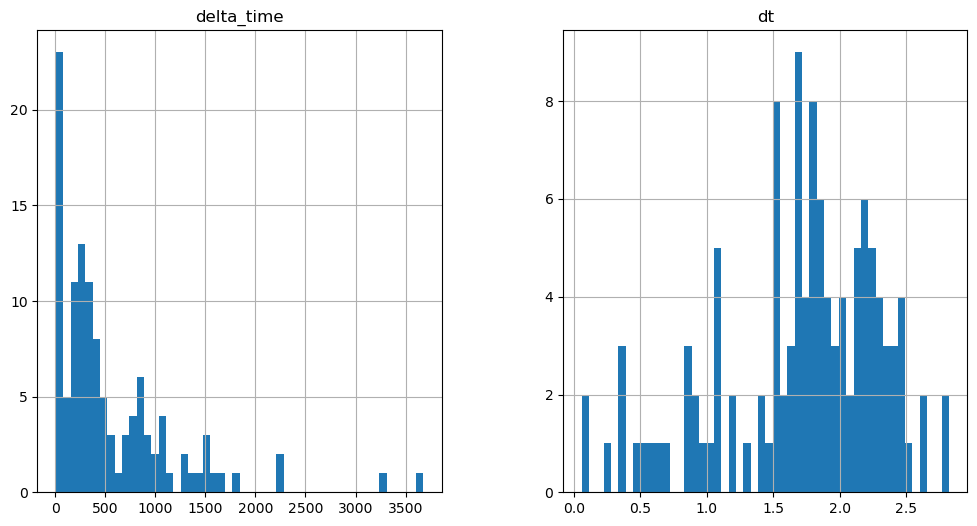

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2236.4059418439865 0.1


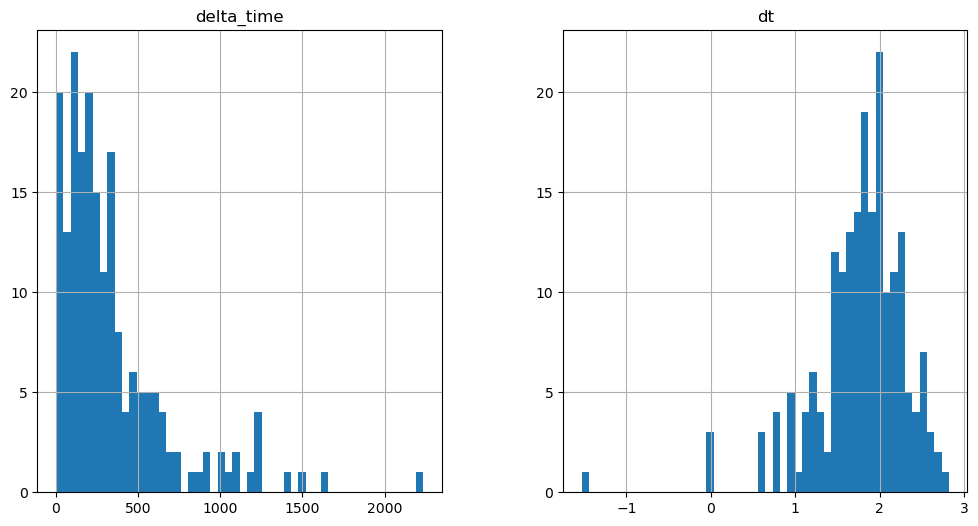

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4334.611166834831 9.423070430755615


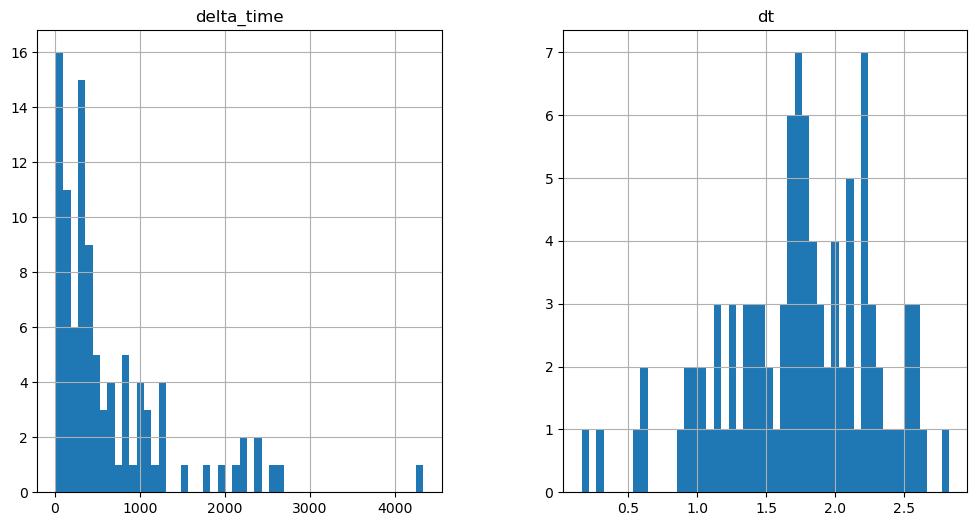

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4887.428834617138 21.987161099910736


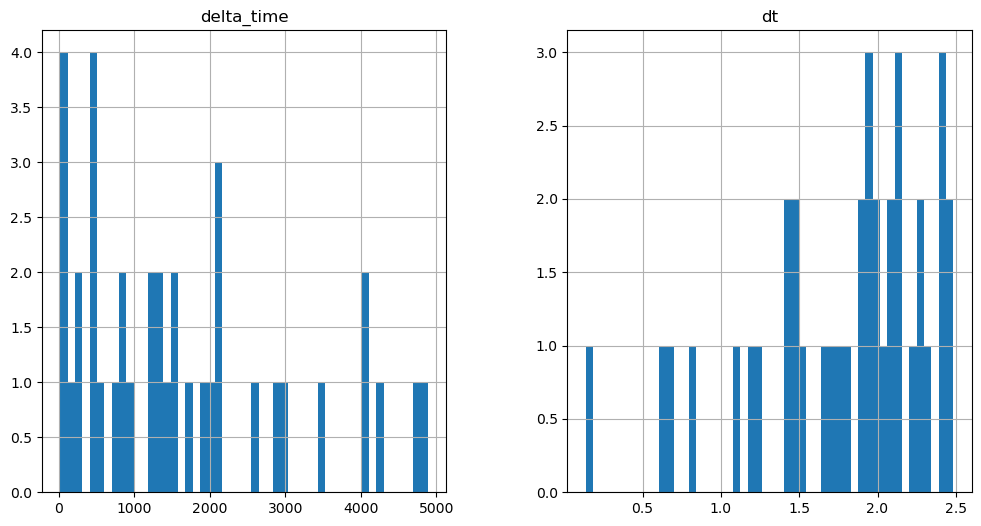

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1887.7552146315575 0.1


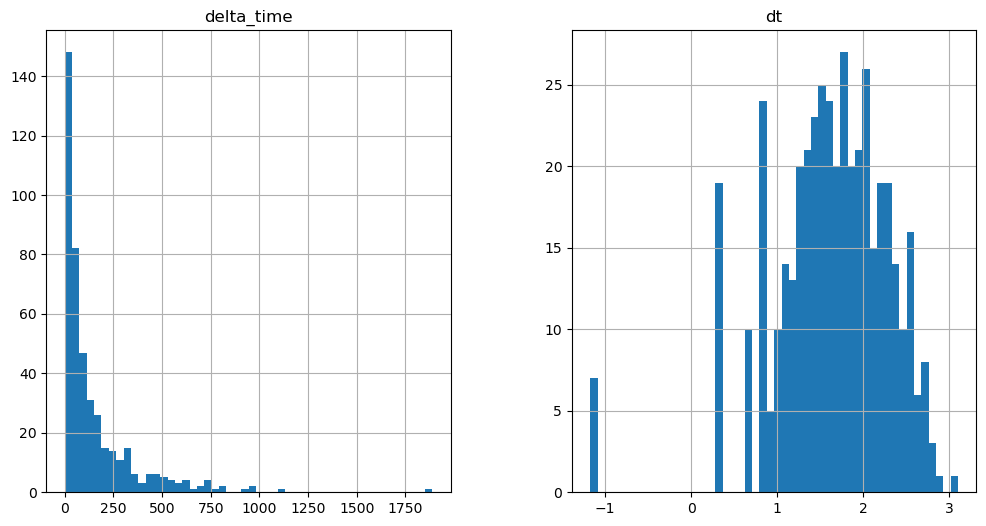

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5528.20163667202 9.423060476779938


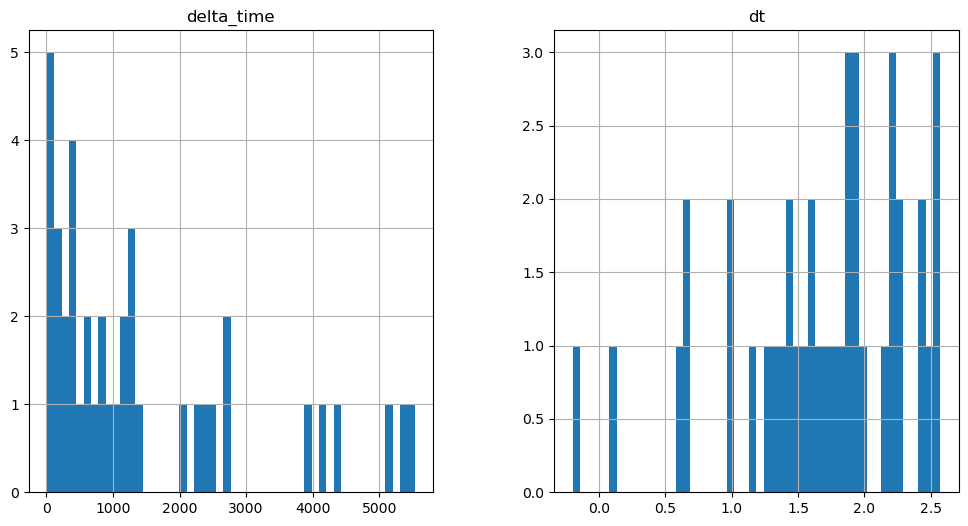

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

9539.283867239952 6.282050132751465


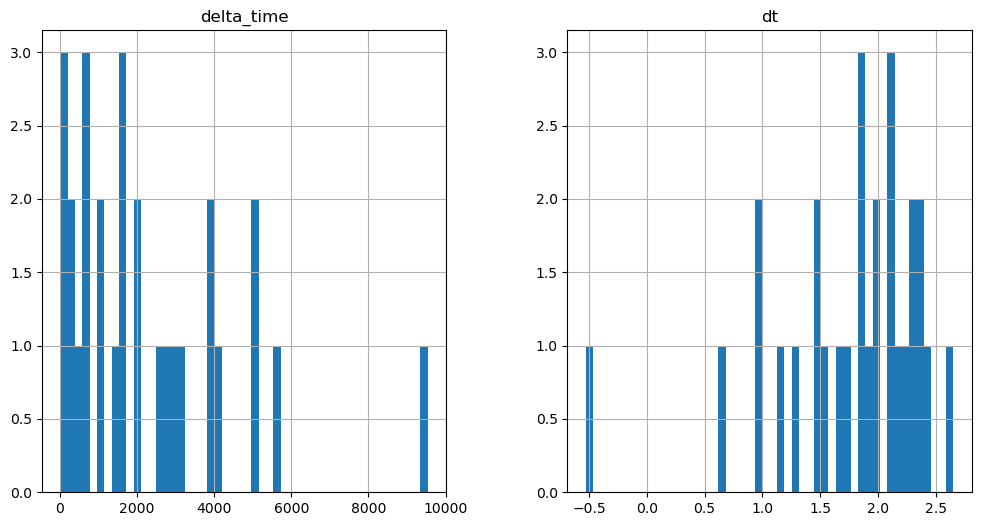

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2484.547984302044 3.141020178794861


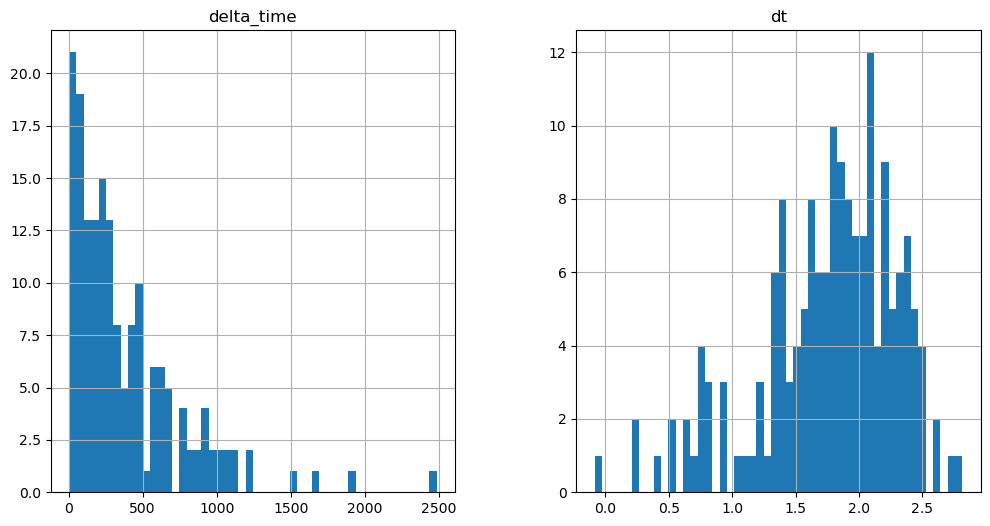

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

530.832676589489 0.1


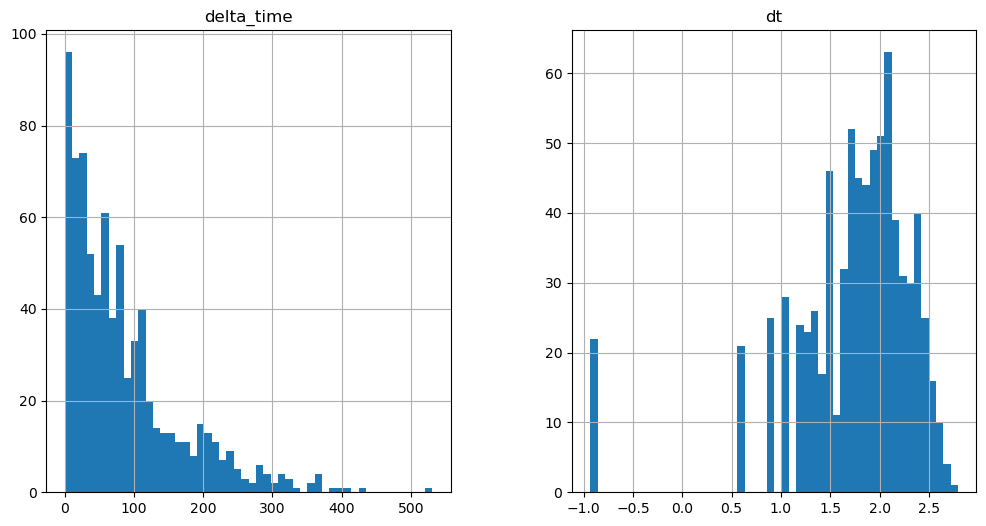

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1407.1767303943634 3.141020178794861


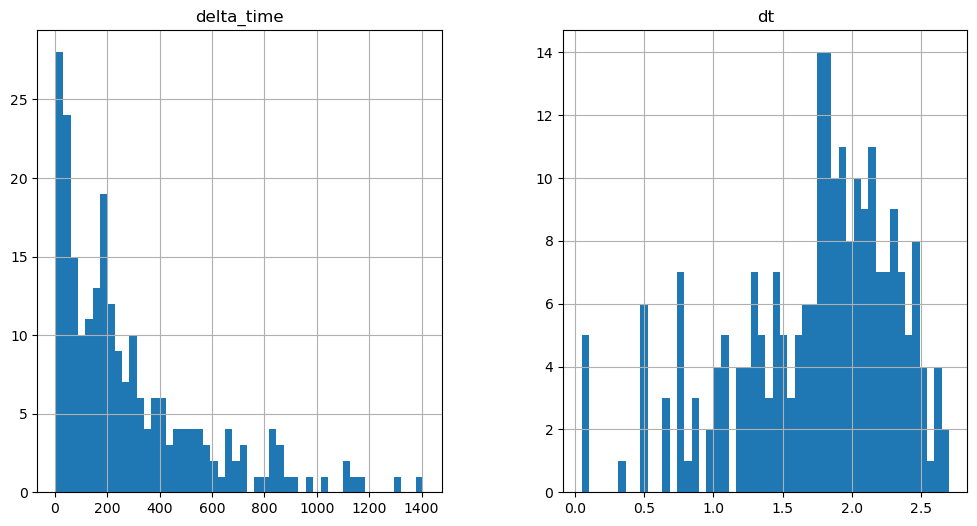

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4215.253521025181 3.141020178794861


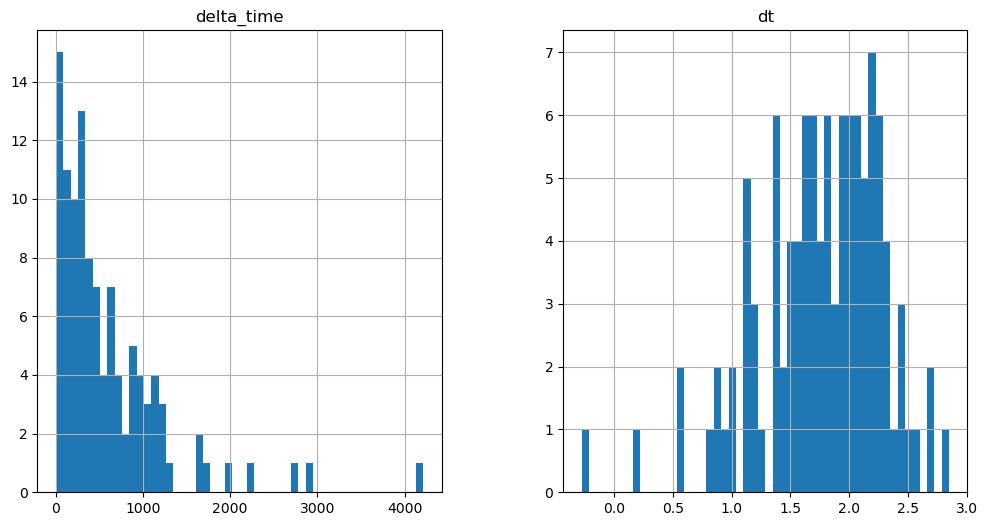

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1633.3323116898537 0.1


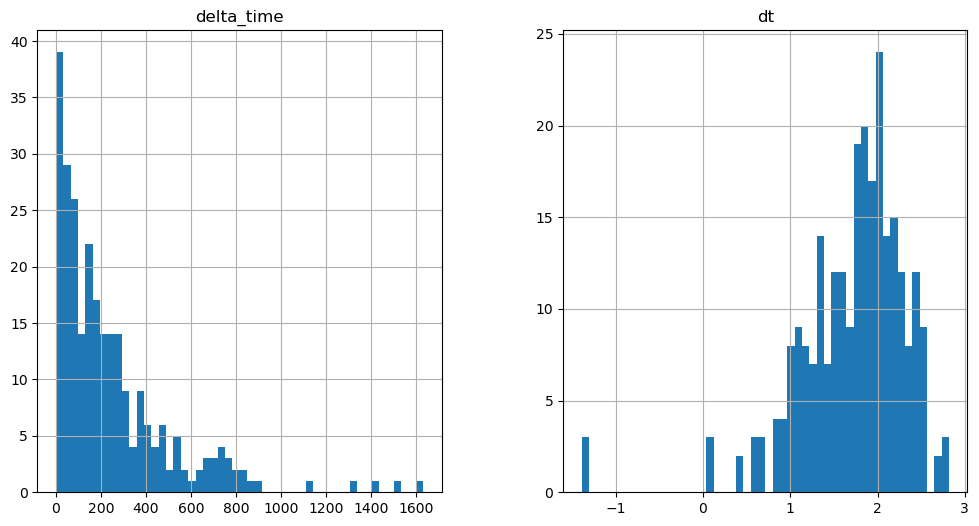

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1539.101457118988 3.141010344028473


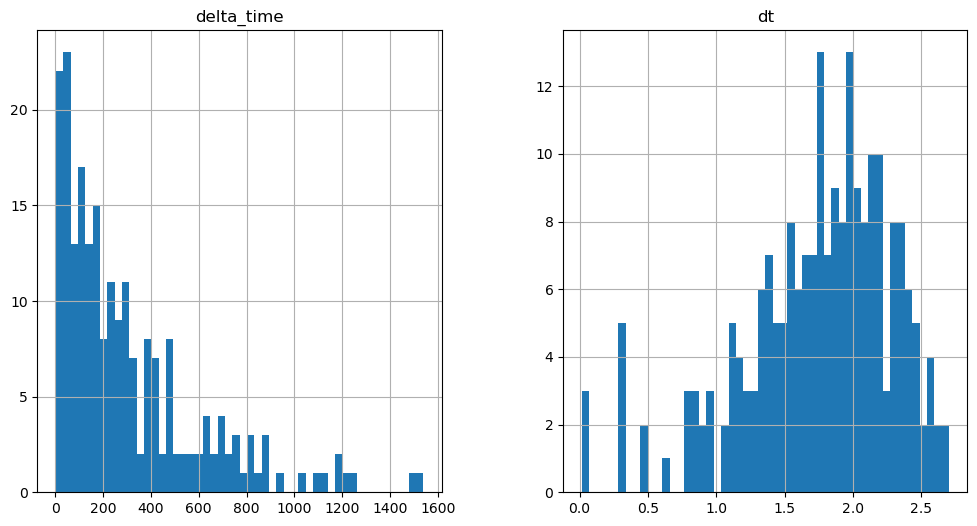

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4453.971532821655 0.1


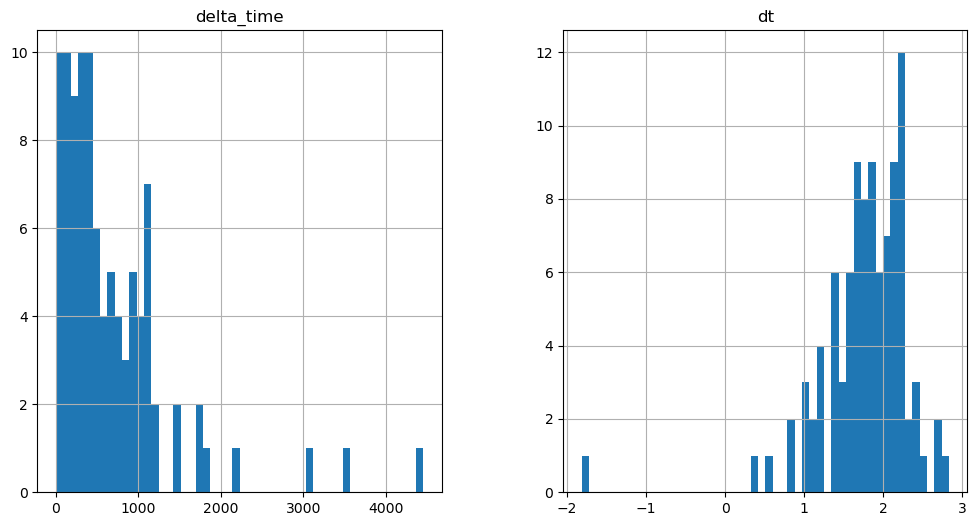

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2833.2032318115234 3.1410102248191833


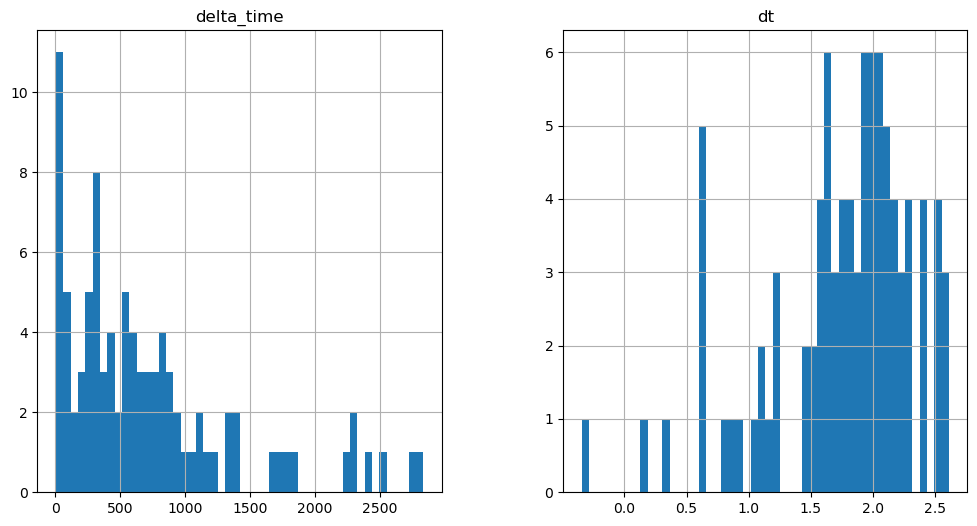

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3756.63763910532 28.269001364707947


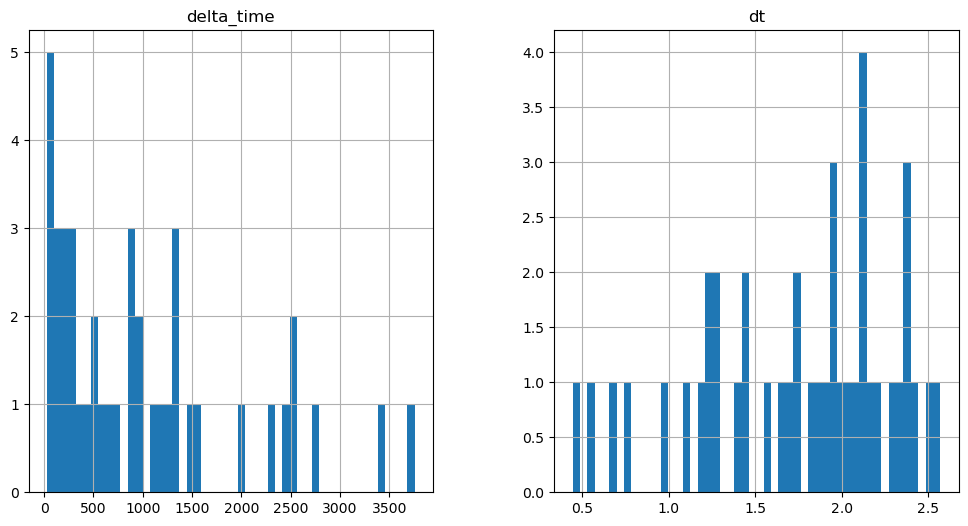

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3411.1274216771126 65.96102327108383


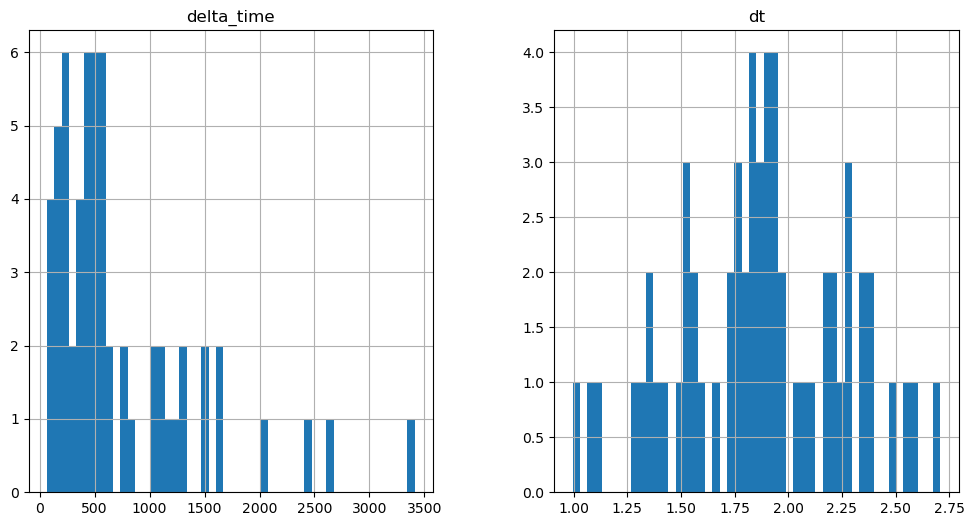

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3684.3947252631187 3.141010105609894


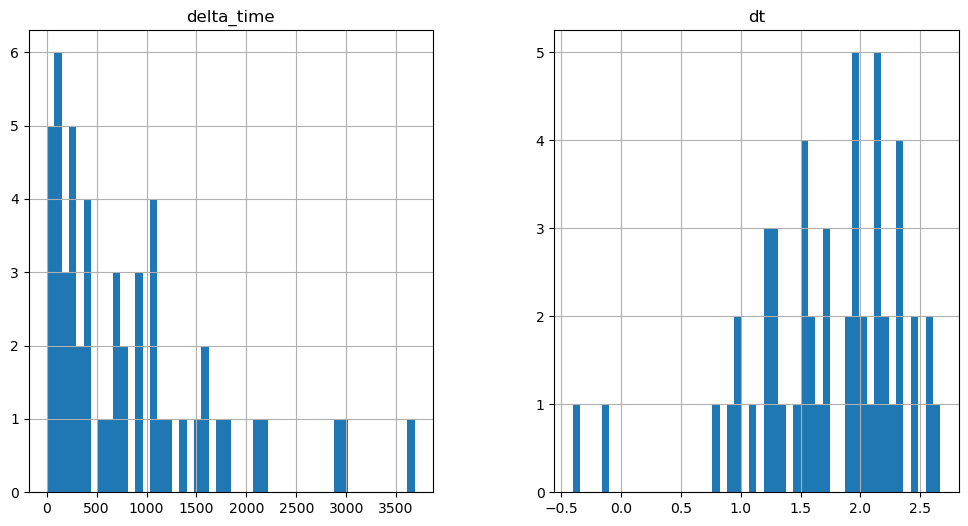

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1297.233535349369 3.1409902572631836


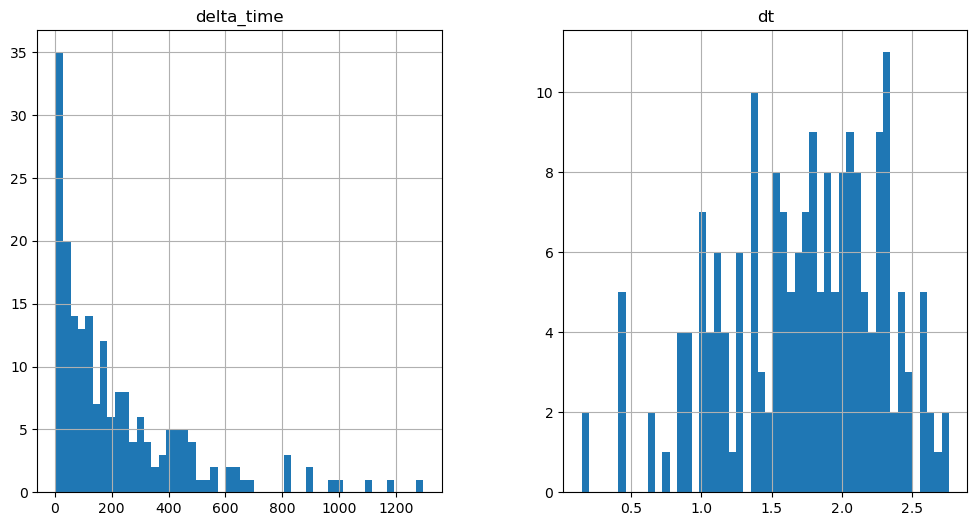

4441.375823378563 31.409991681575775


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

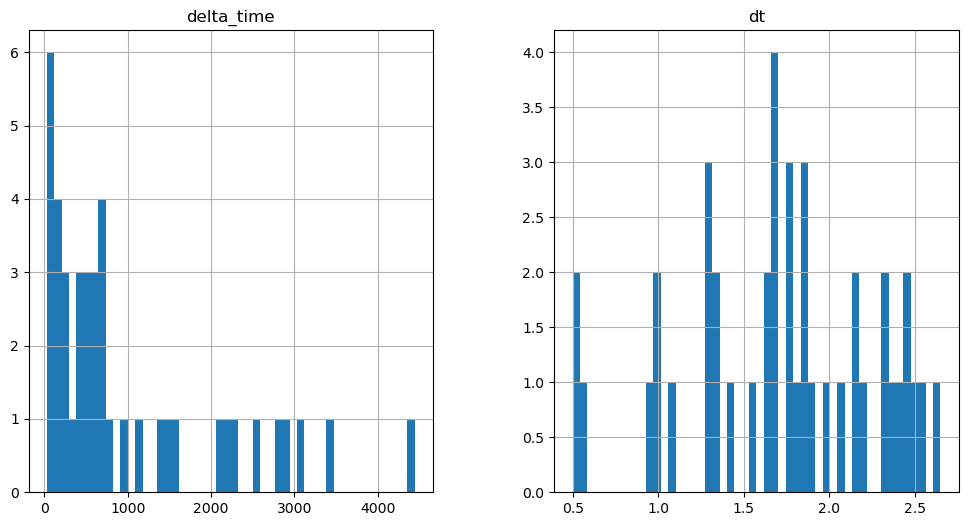

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1438.5786123275757 0.1


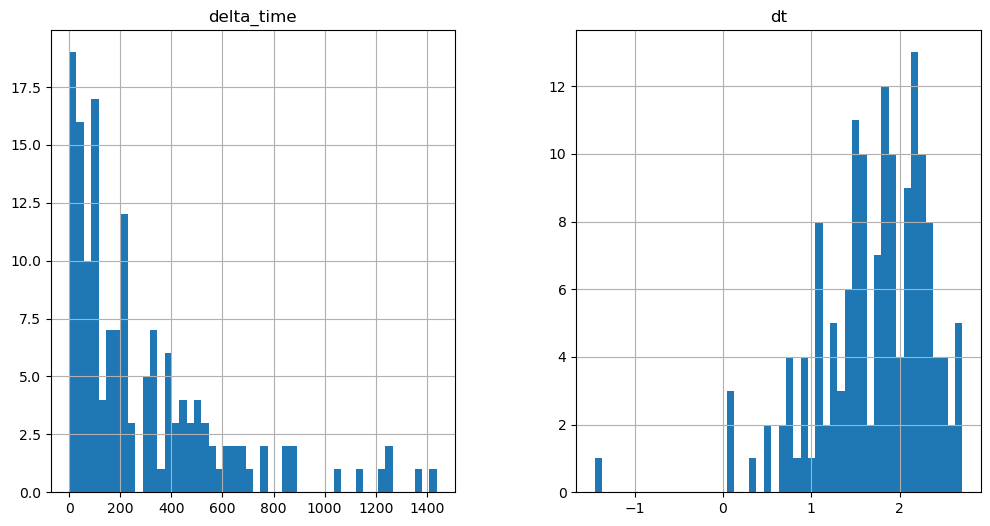

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2421.7120617628098 28.26901137828827


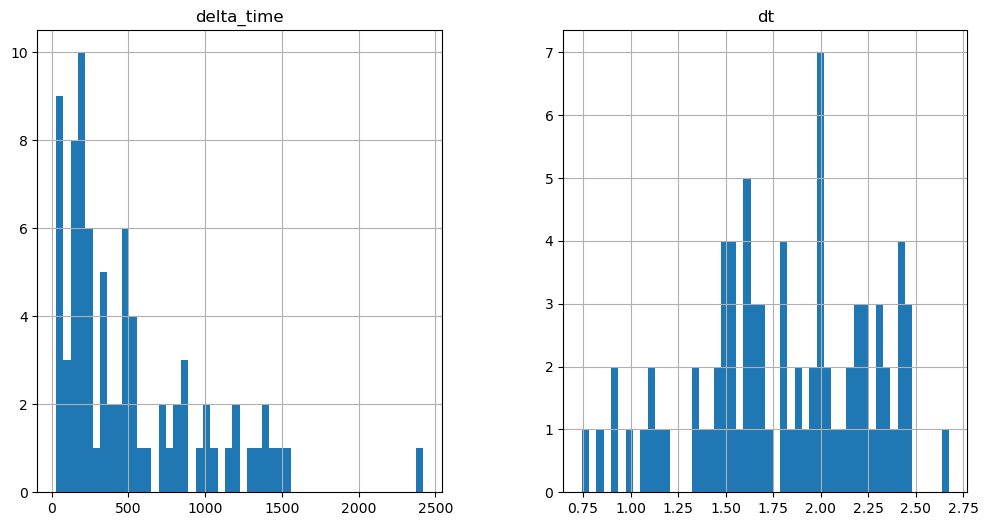

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4026.7637428045273 15.705000817775726


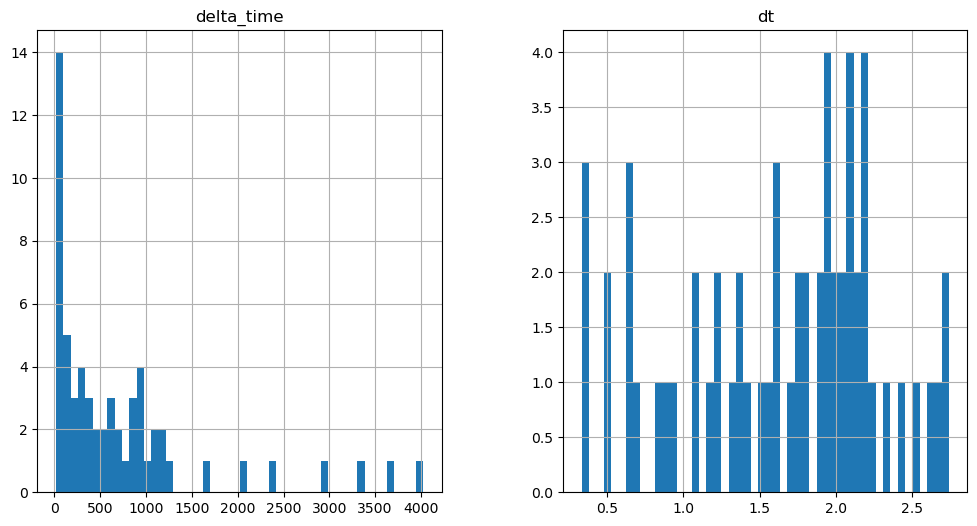

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2123.3169868588448 3.140990197658539


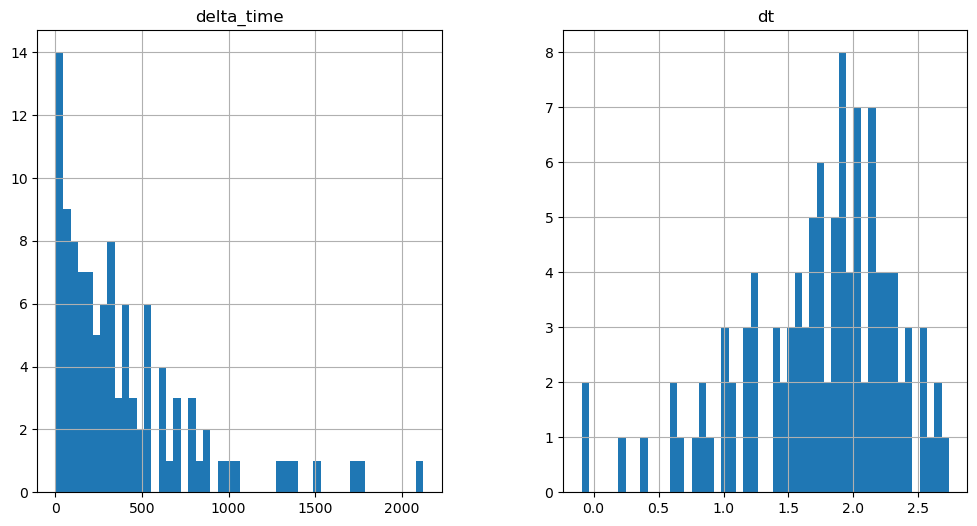

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2098.188915669918 3.1409902572631836


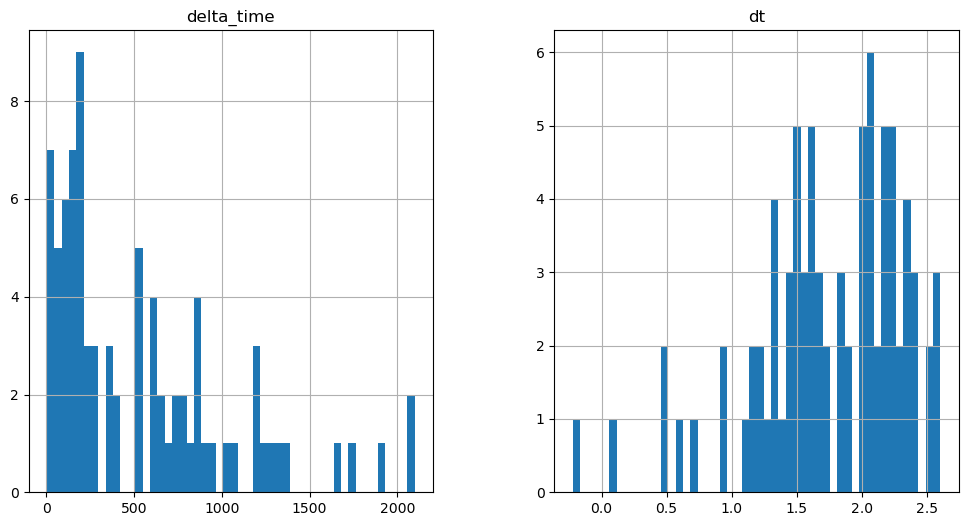

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4846.565223872662 6.282000303268433


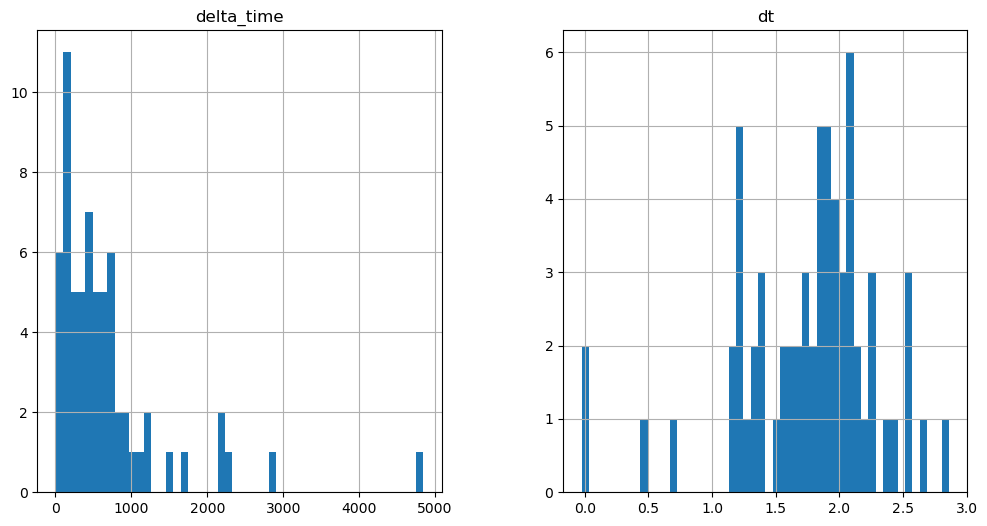

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4692.6561061143875 6.28201025724411


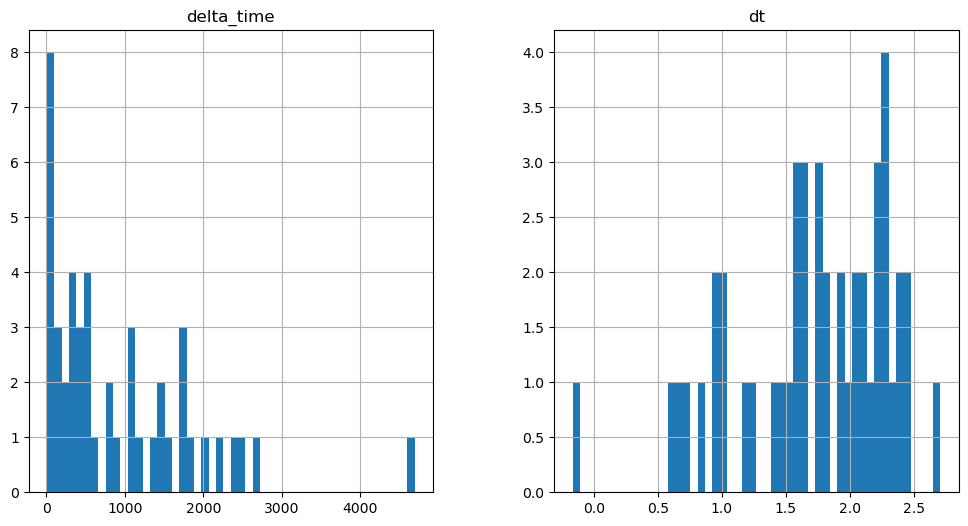

6413.924742758274 12.564010620117188


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

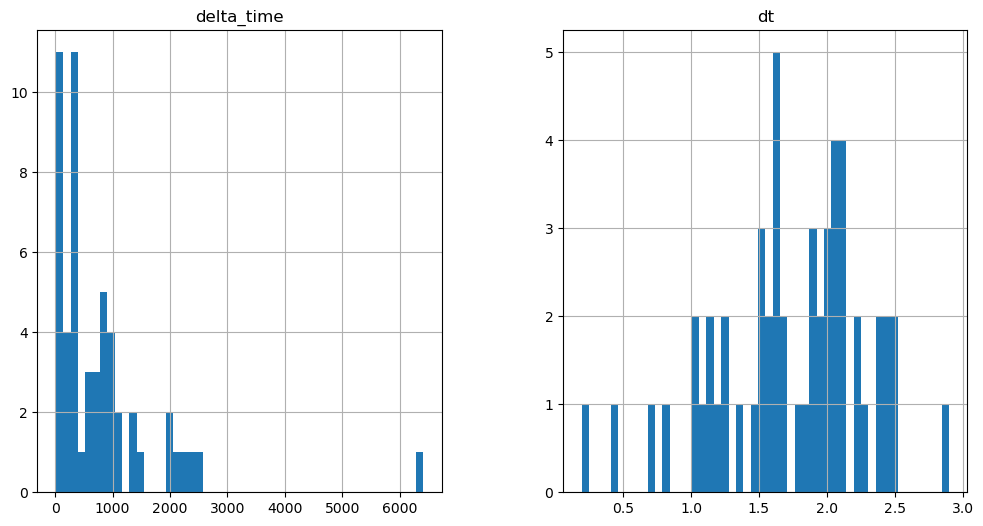

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1758.959019780159 3.141010105609894


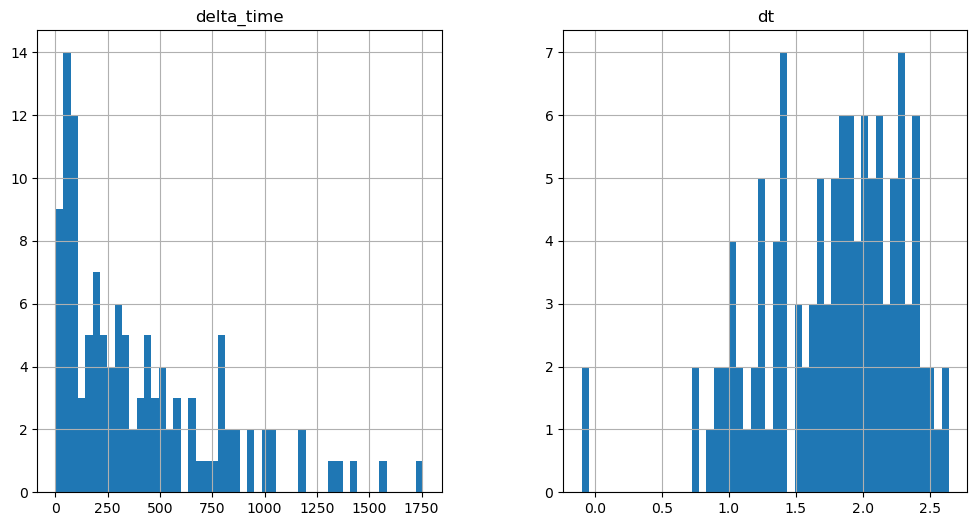

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2091.9046929478645 3.1409801691770554


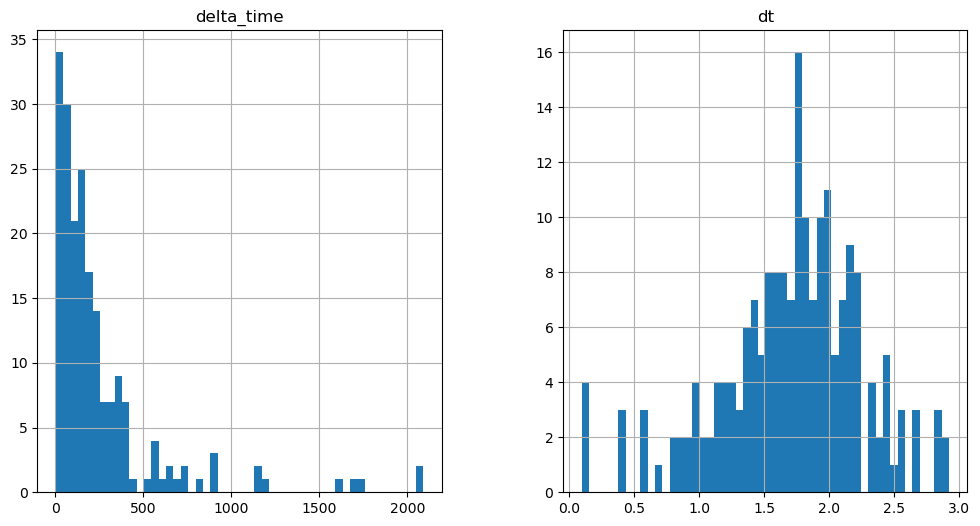

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4274.89812964201 3.1410100907087326


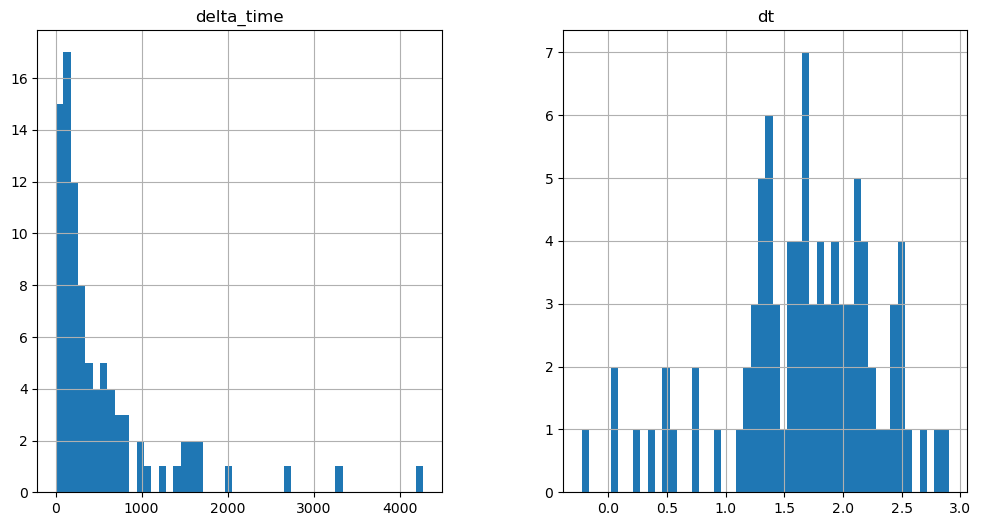

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3040.4859606921673 6.281970337033272


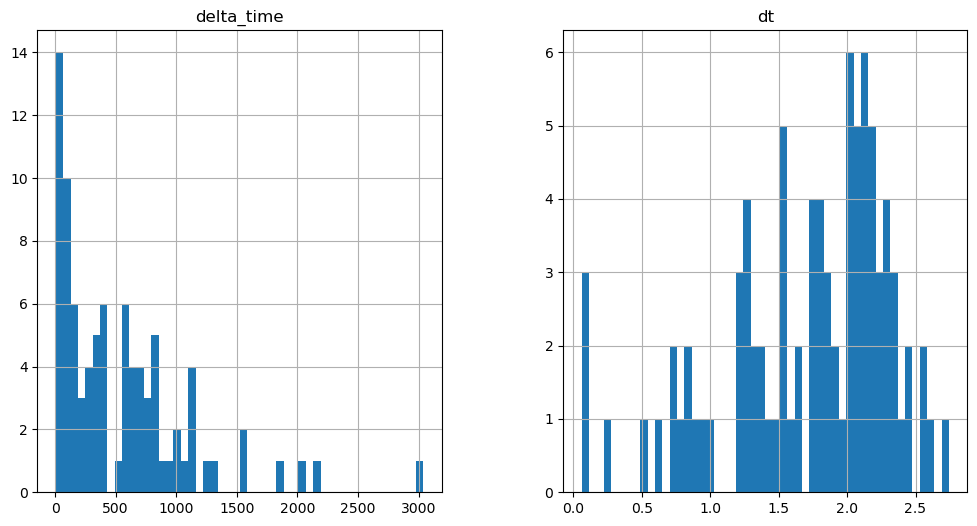

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1115.0542342364788 0.1


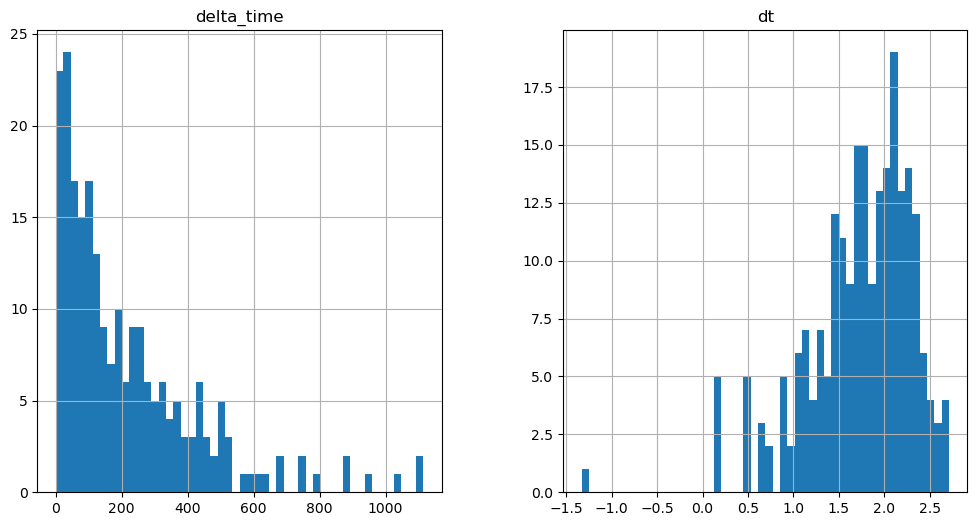

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2252.0955193042755 15.704980686306953


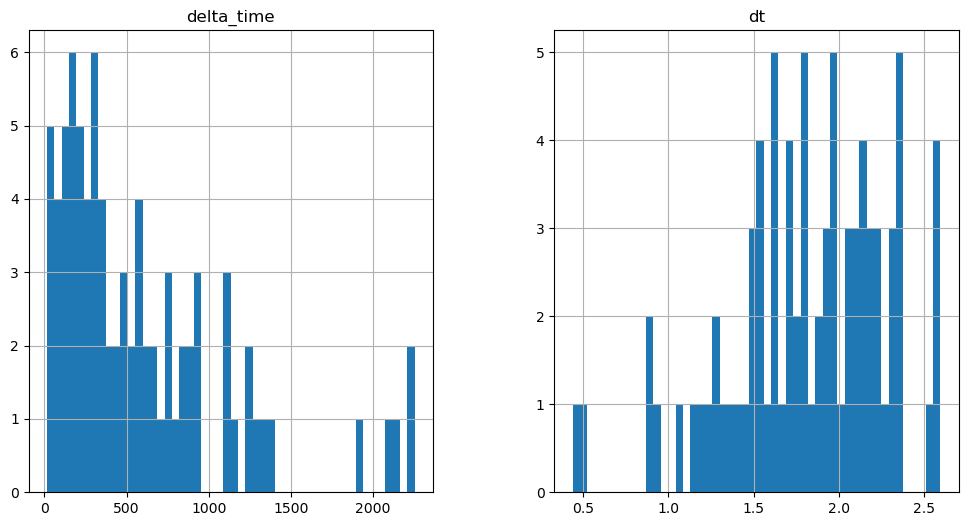

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1649.0239353775978 0.1


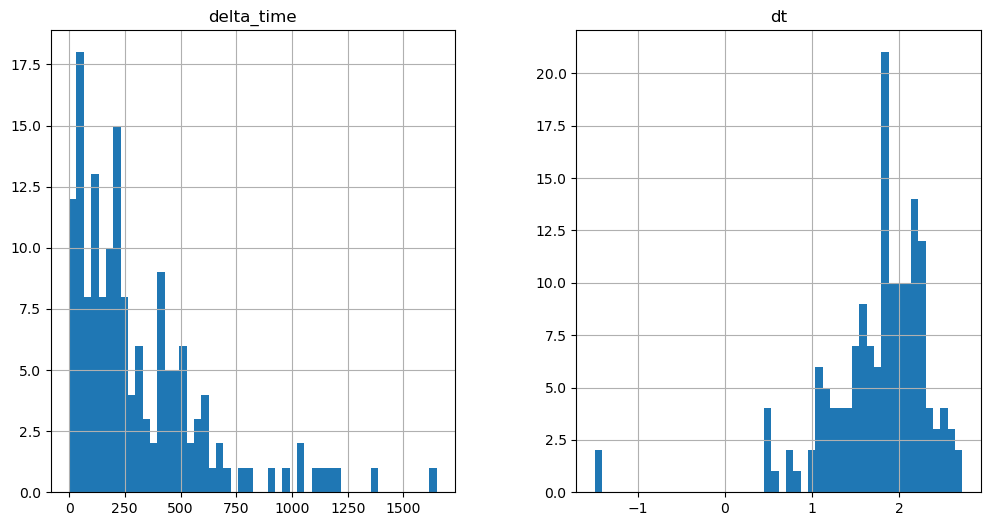

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1454.2820077389479 3.140980154275894


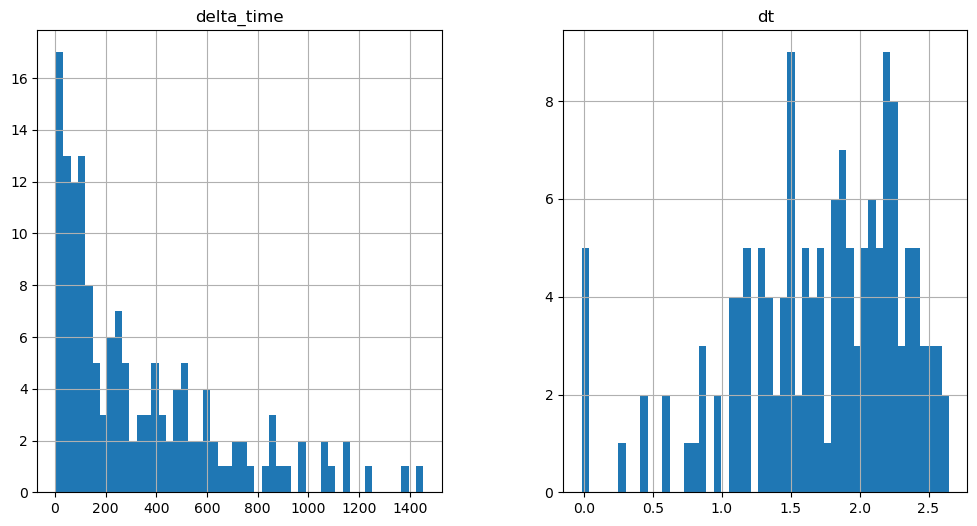

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4595.27996224165 12.563990473747253


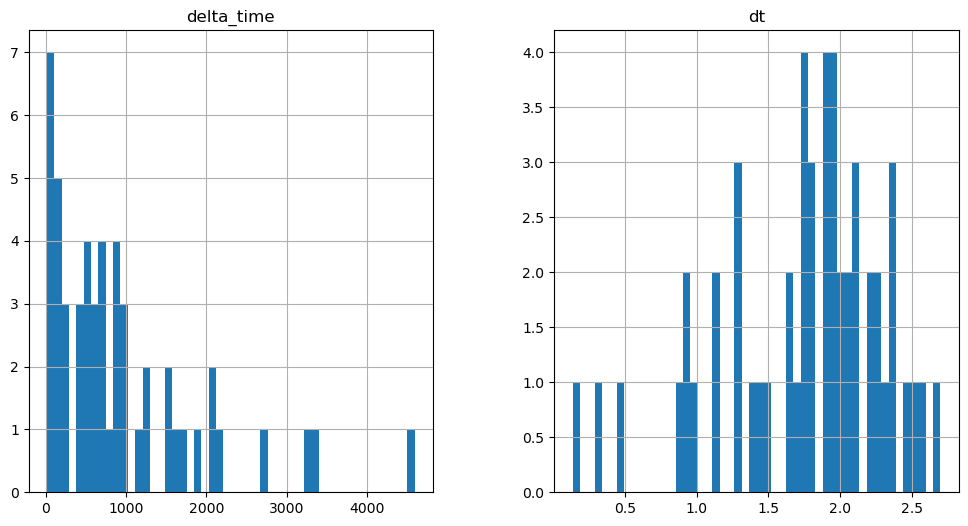

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3747.2105185836554 15.70498064160347


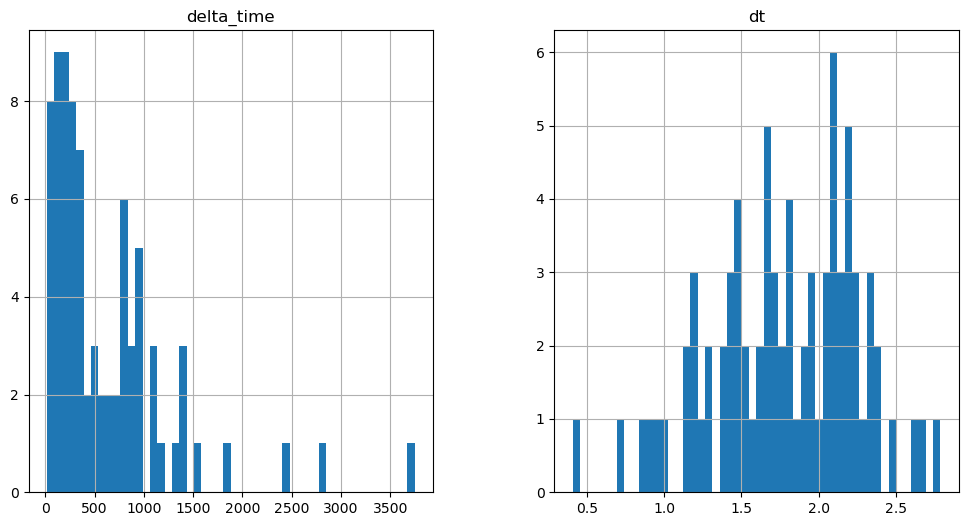

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2484.529358550906 9.42301031947136


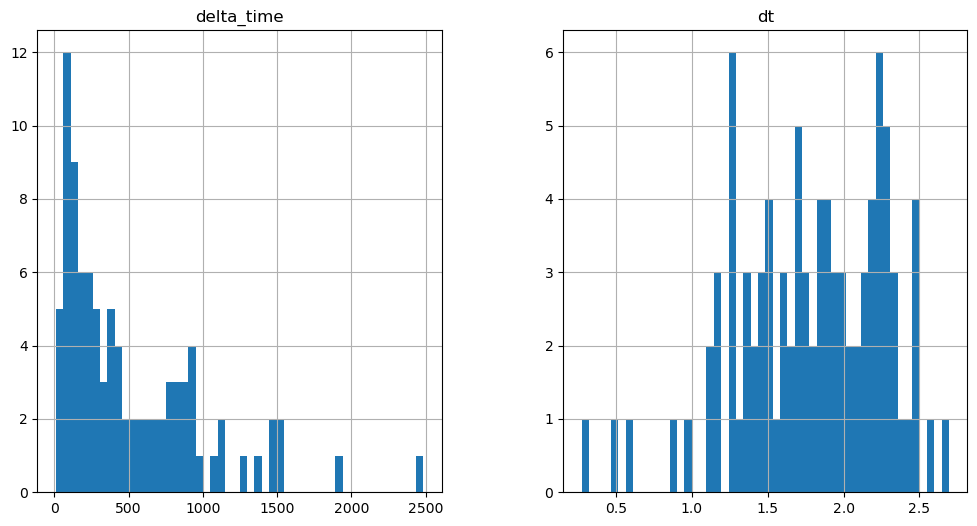

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

760.121530175209 0.1


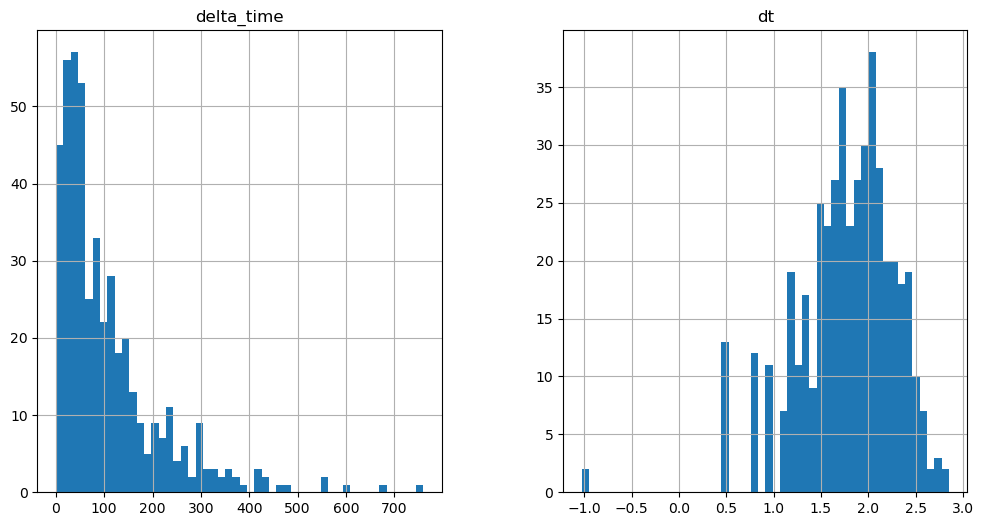

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

6285.1369093209505 31.4099912494421


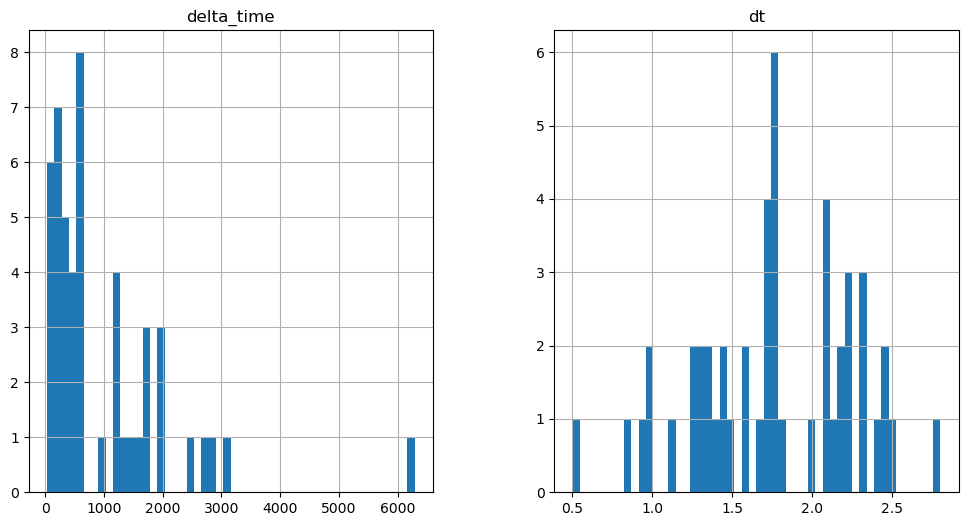

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2198.698537245393 0.1


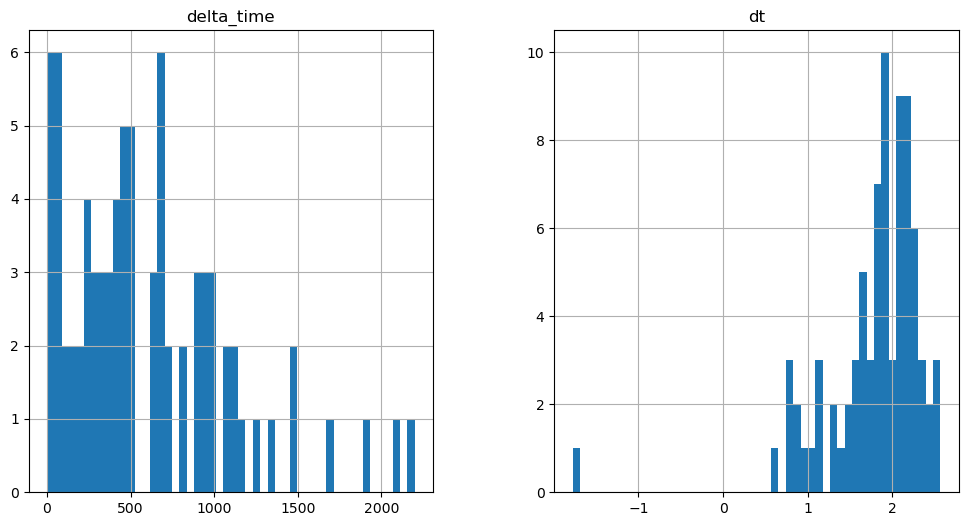

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

819.8004325181246 0.1


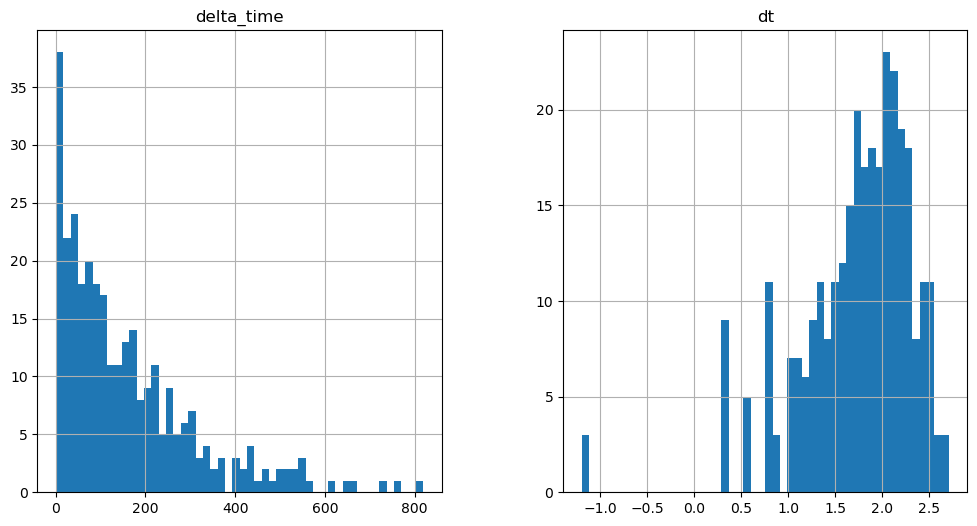

40.83297161757946 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

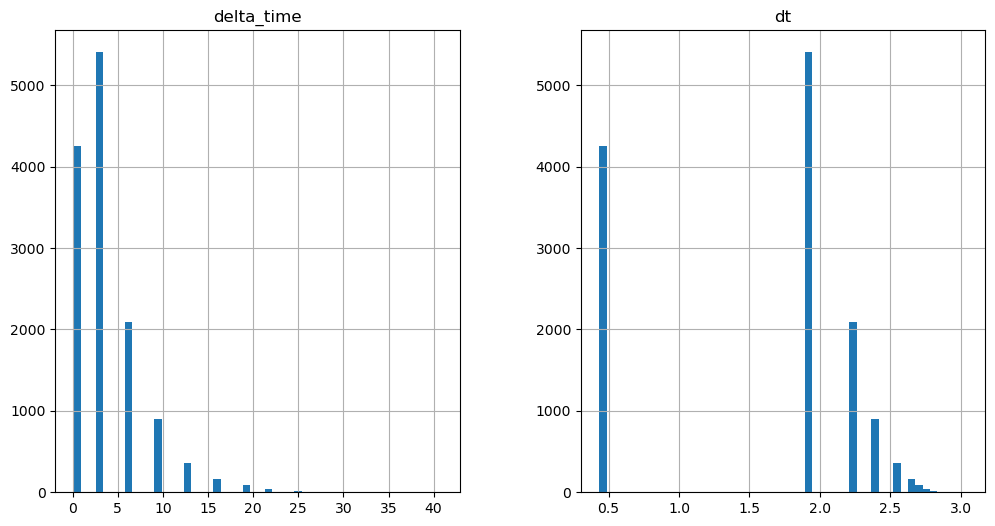

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1501.3970595300198 0.1


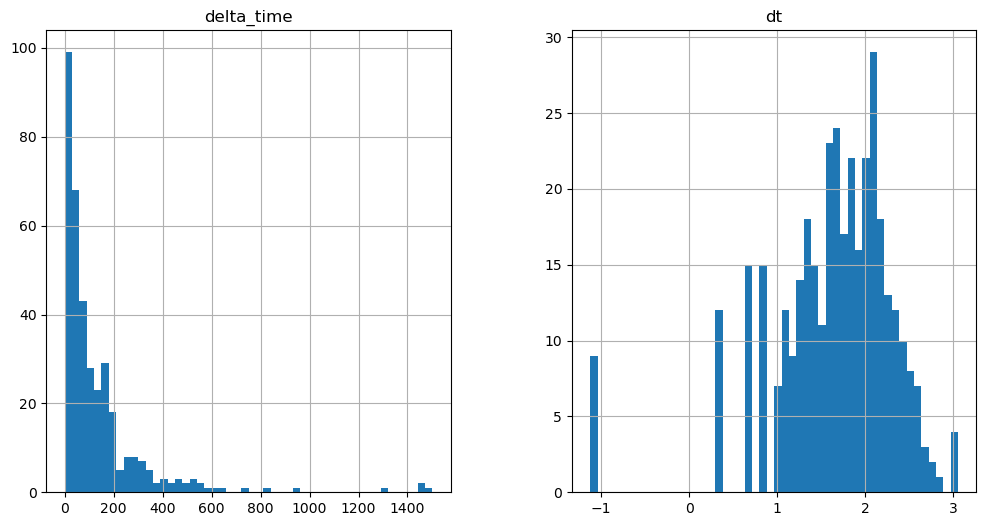

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4067.5923013091087 0.1


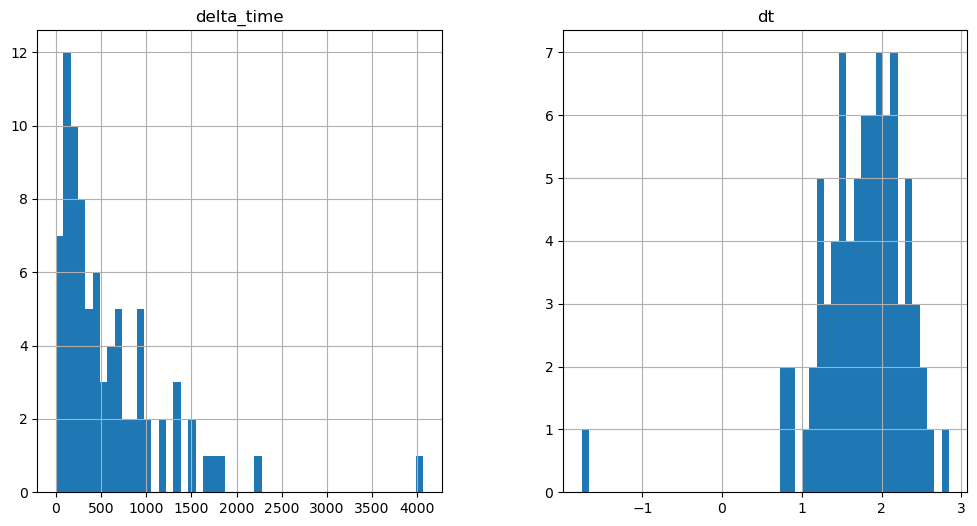

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1856.3297635912895 0.1


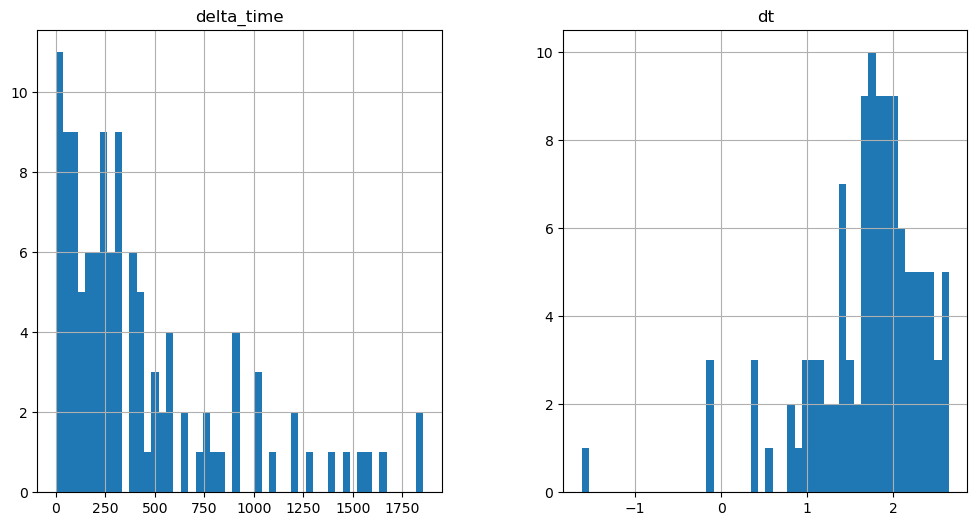

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3696.9545666128397 34.55097137391567


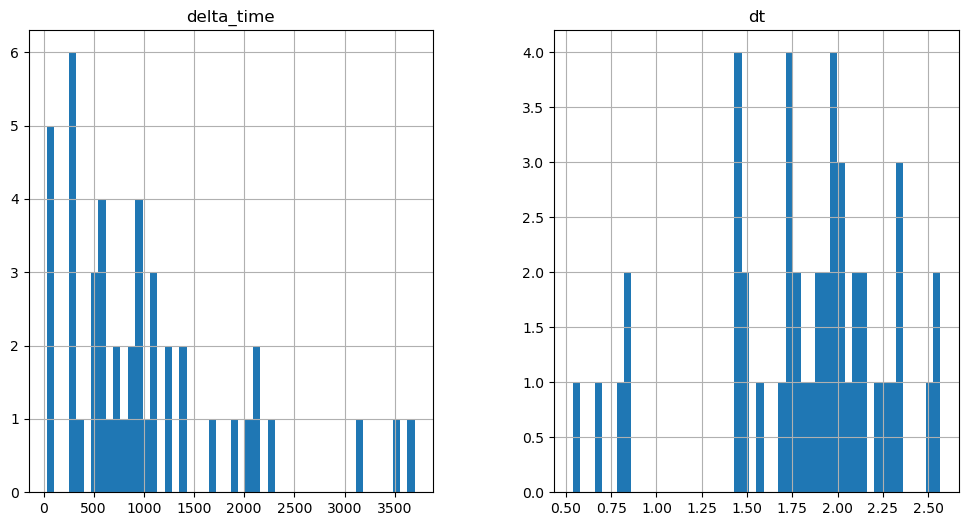

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2889.718124628067 6.282000258564949


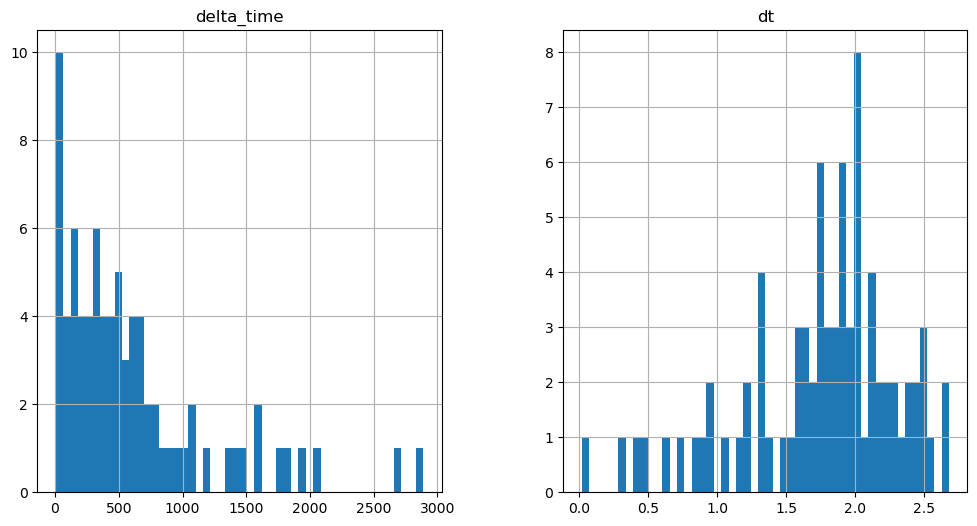

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3112.728943437338 18.845990732312202


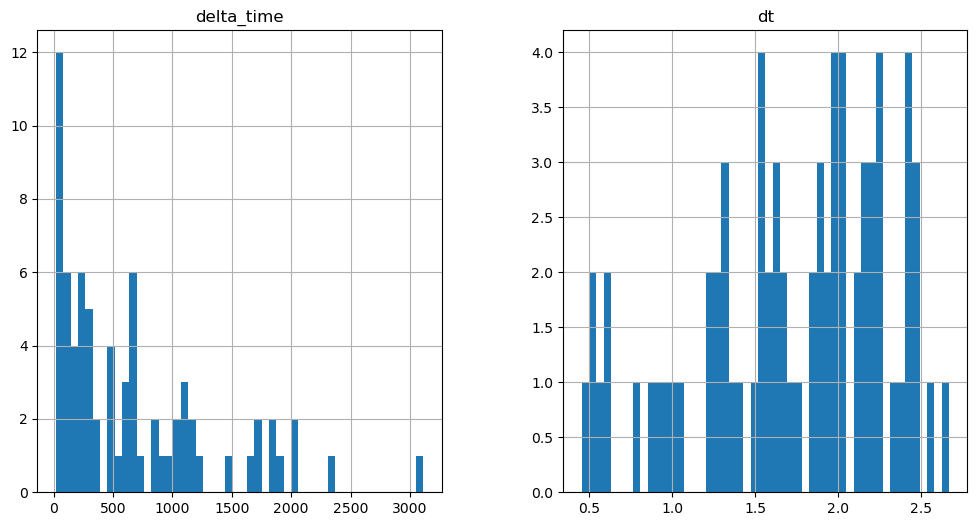

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3225.804878011346 6.281990230083466


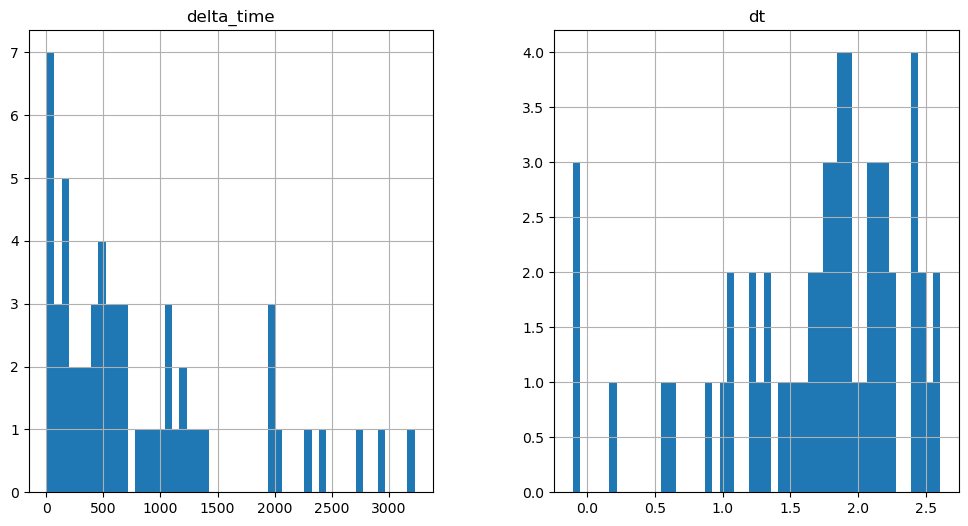

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2465.6832878291607 6.282000243663788


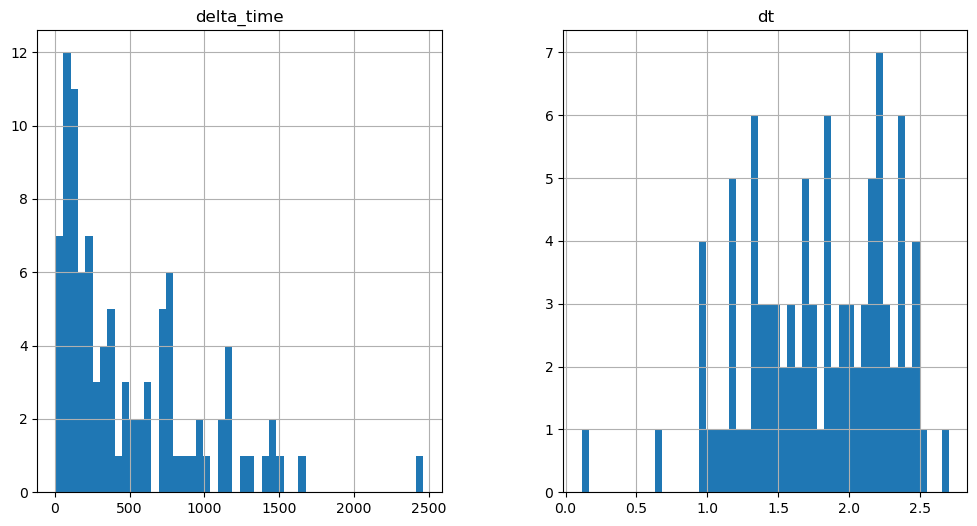

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4130.412253856659 12.564000502228737


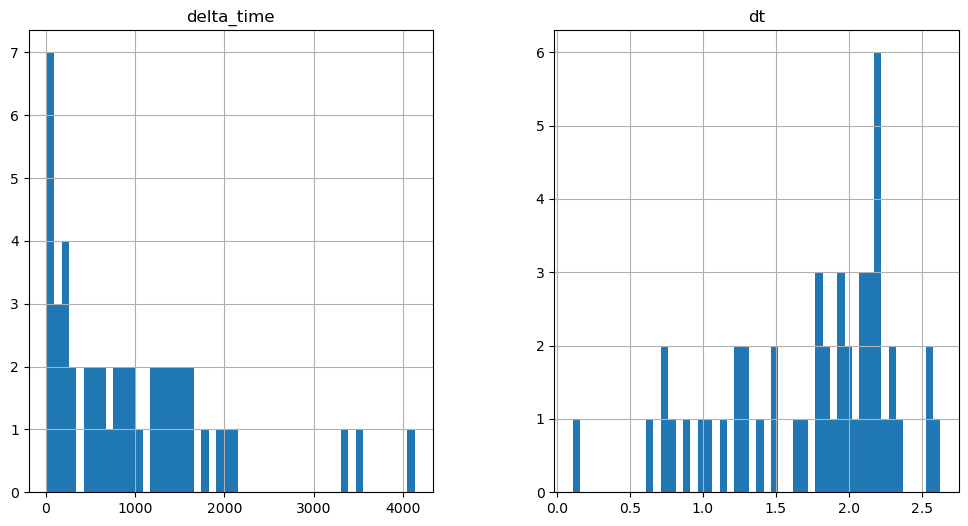

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3304.3297811597586 9.42301033437252


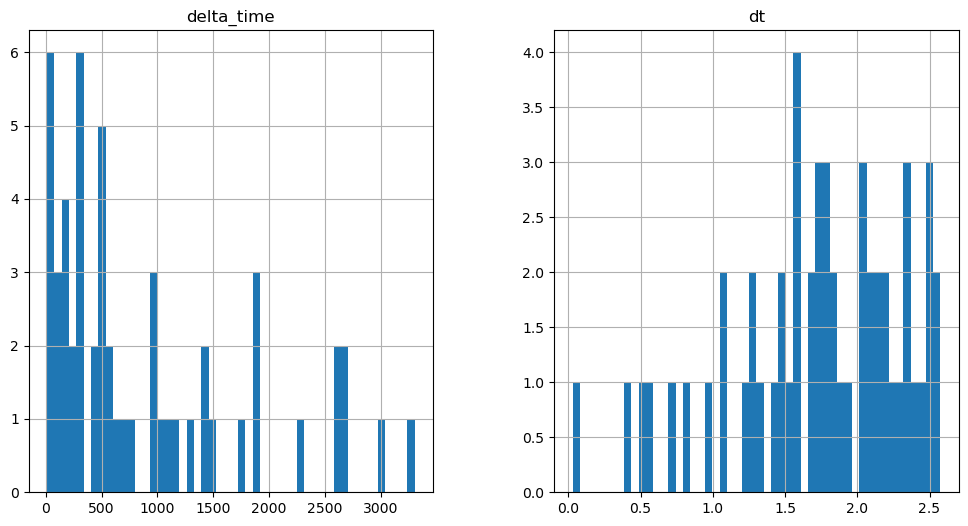

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3668.685605481267 9.422980397939682


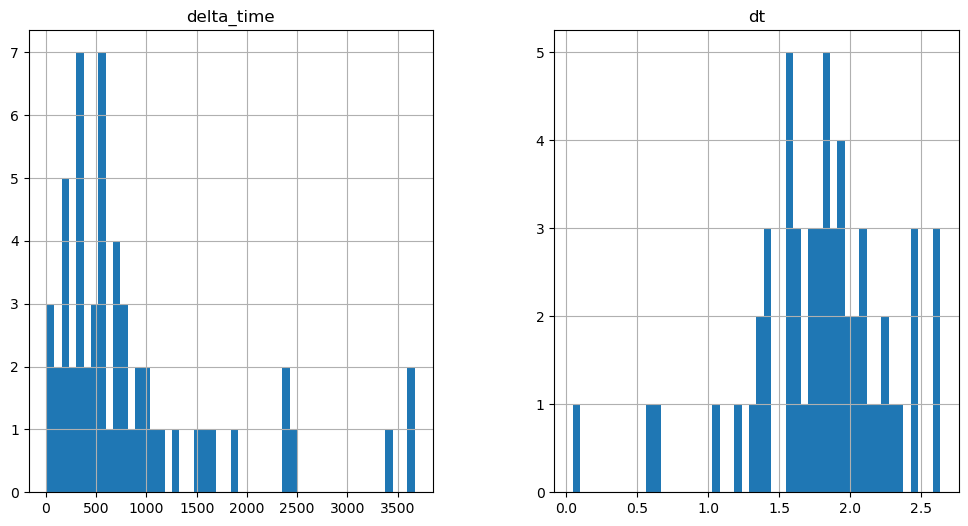

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3696.9545666128397 34.55097137391567


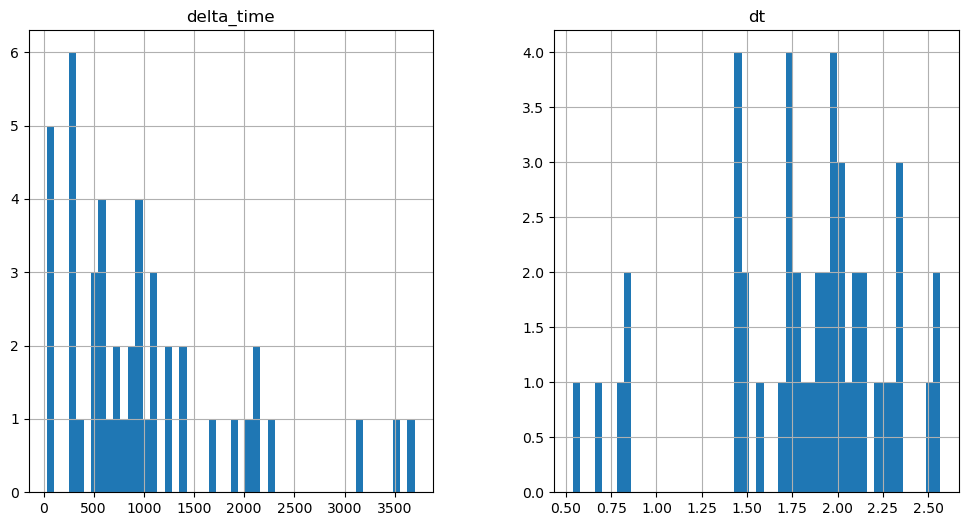

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2396.5815050899982 9.423010364174843


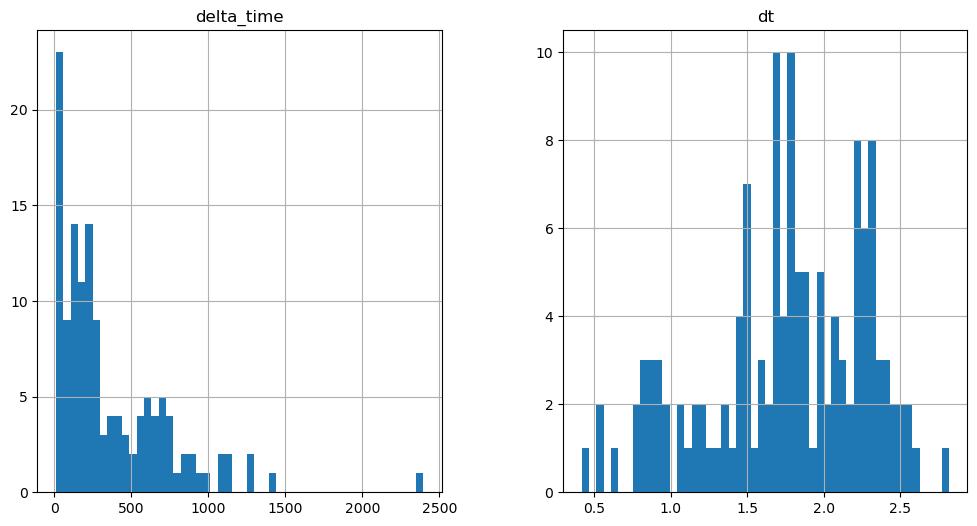

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2795.488180845976 6.282000258564949


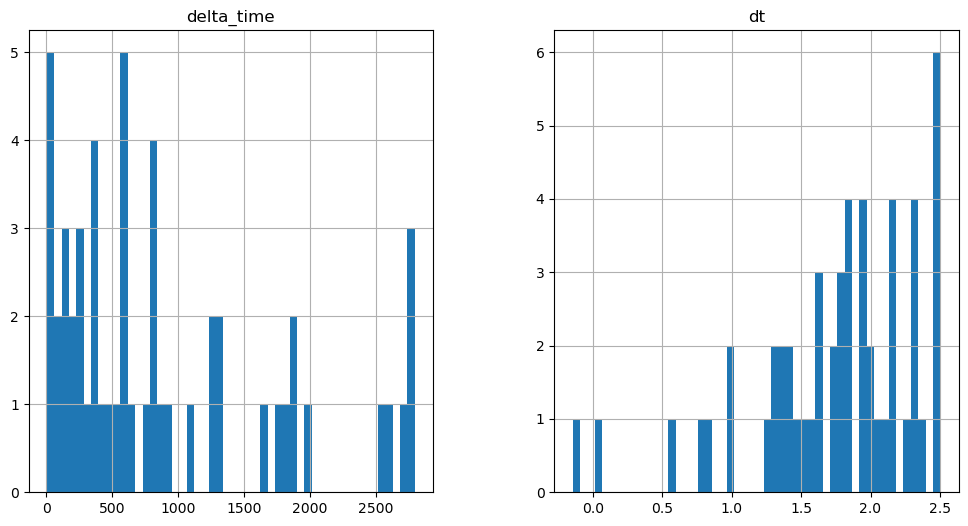

333.82578670978546 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

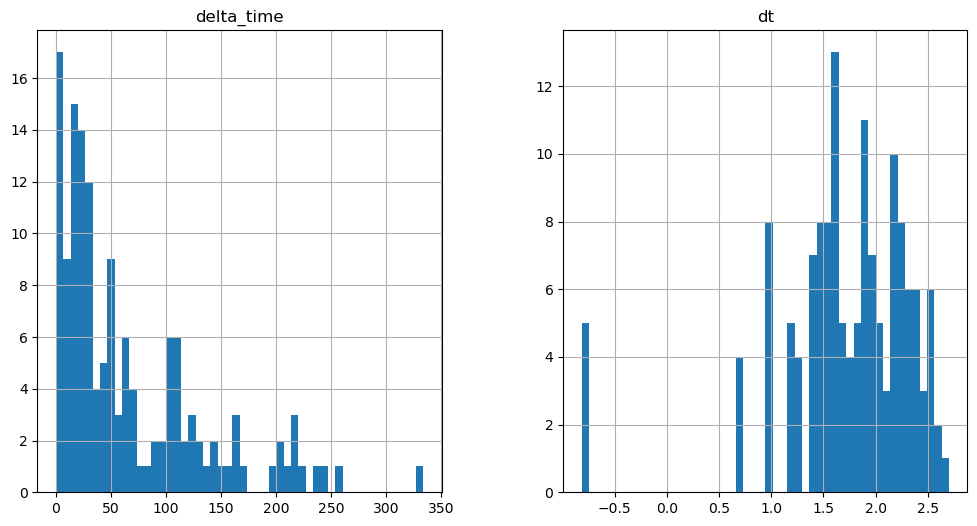

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

570.4204186201096 0.1


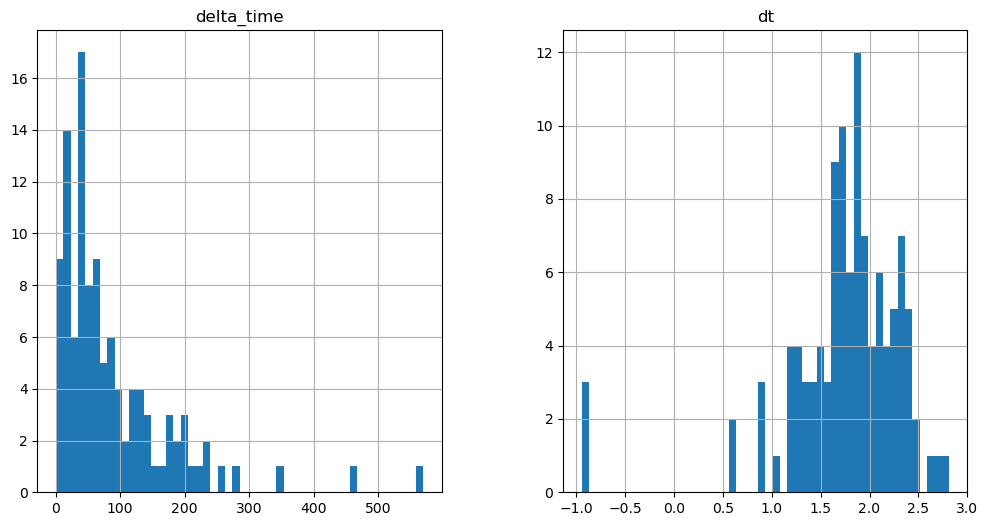

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

51.85640245676041 0.1


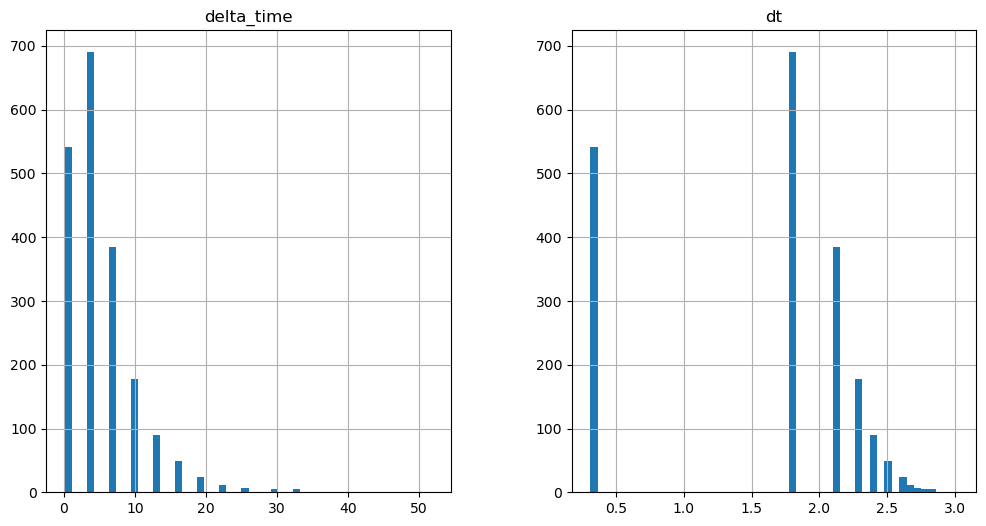

110.69963556528091 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

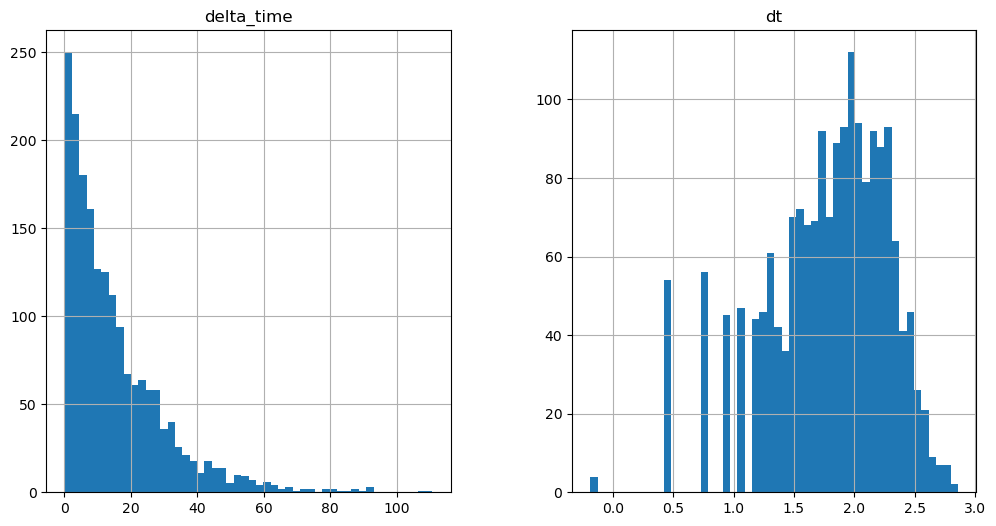

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4541.886665165424 0.1


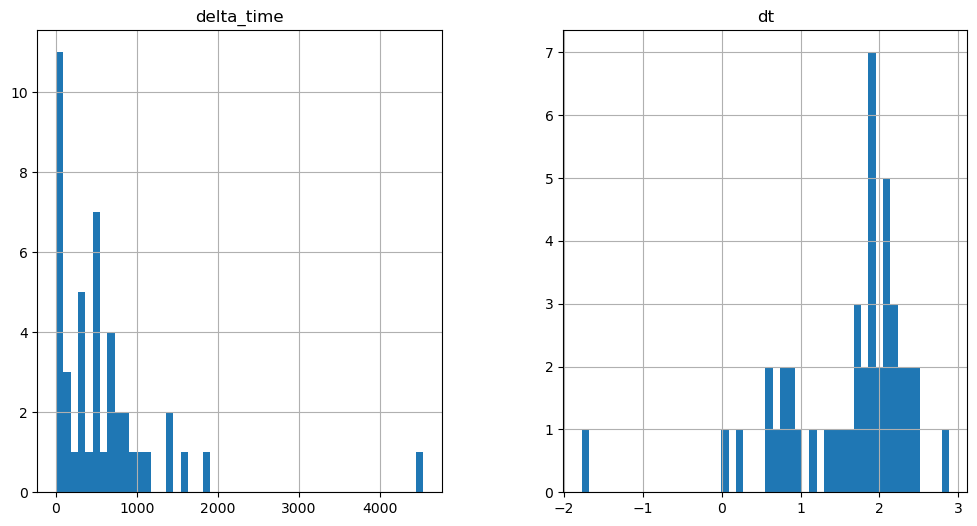

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2126.4571654200554 6.281970381736755


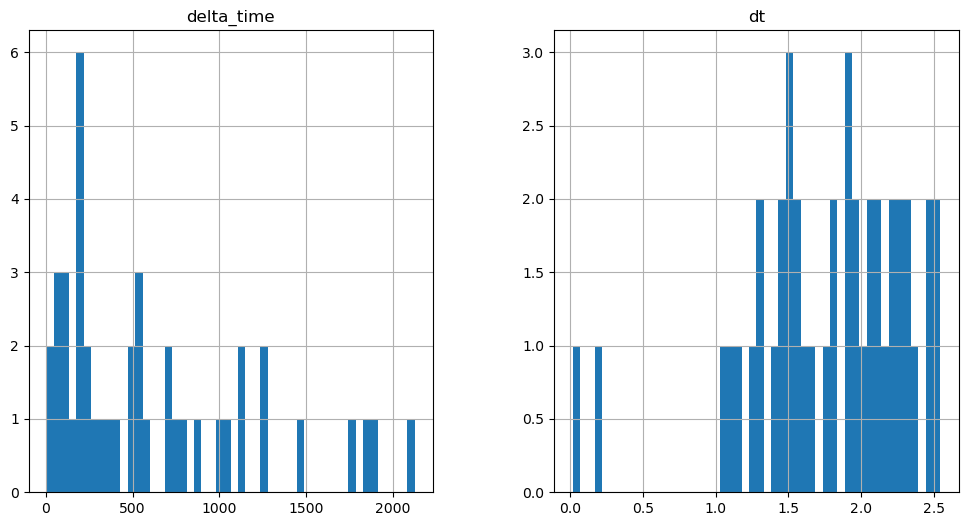

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1209.2851499319077 15.704990804195404


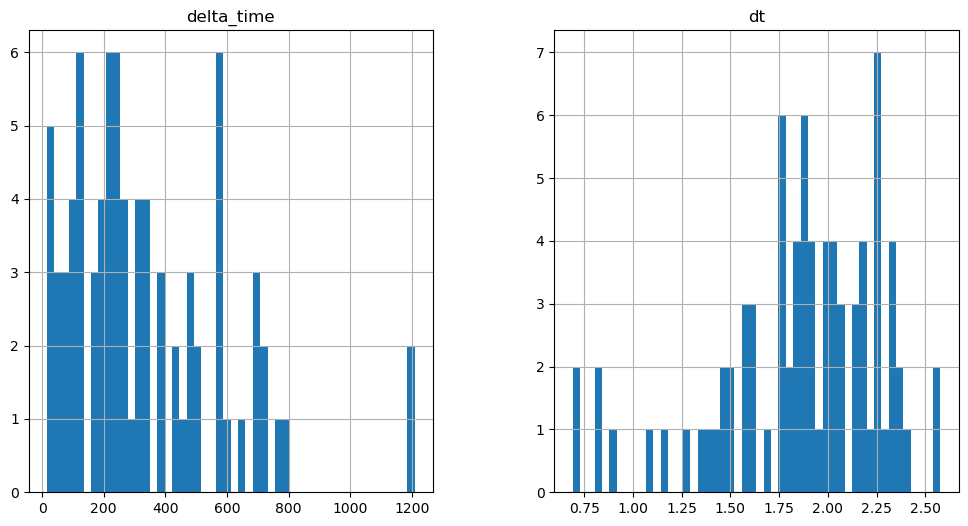

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2085.6242336034775 18.846010863780975


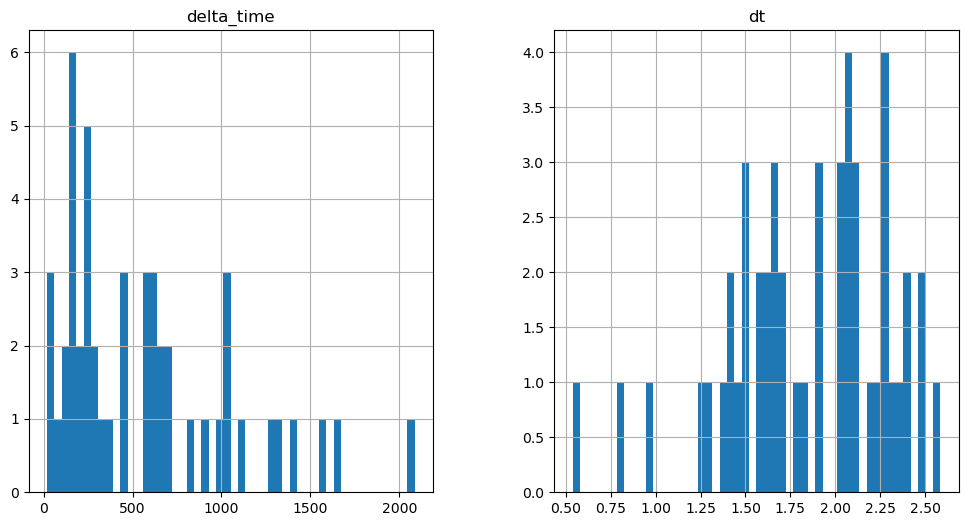

1740.114166200161 12.563980758190155


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

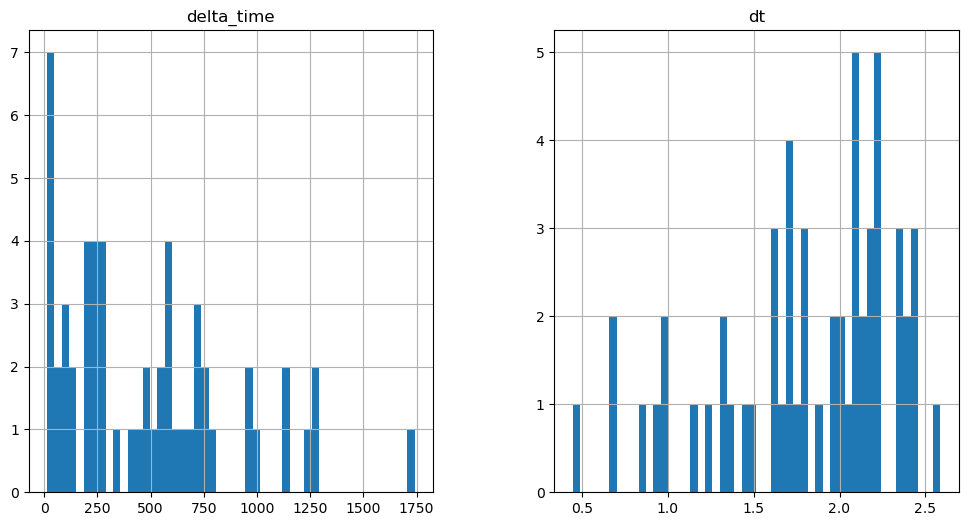

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3065.616401910782 6.281970381736755


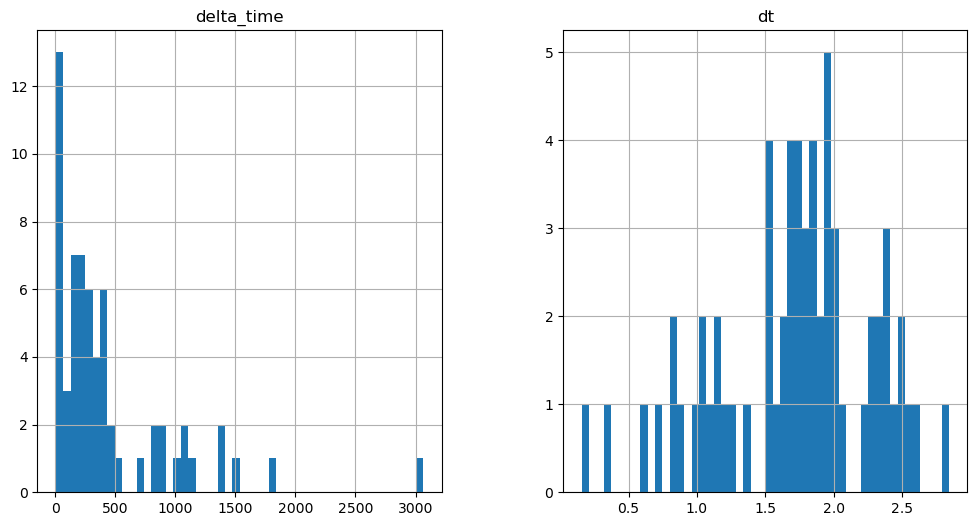

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1457.424152314663 6.282000303268433


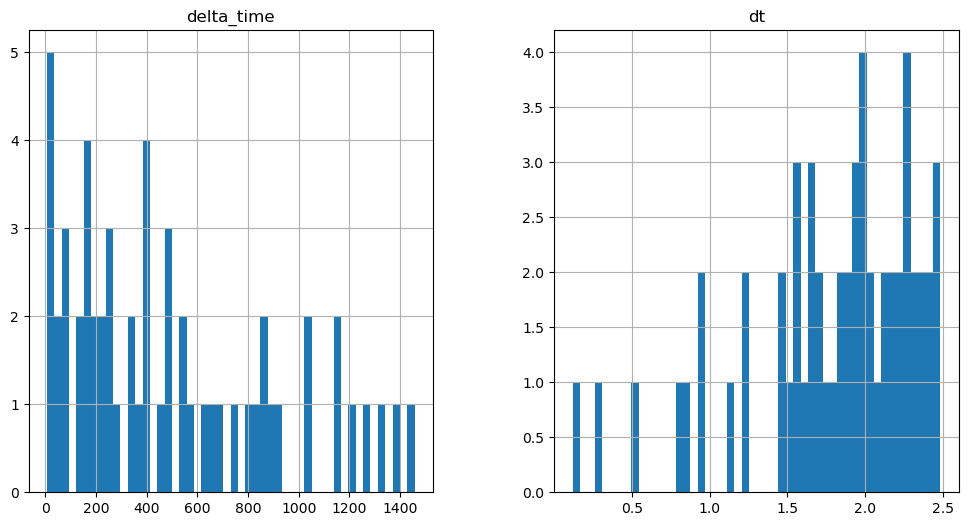

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1426.0141806602478 0.1


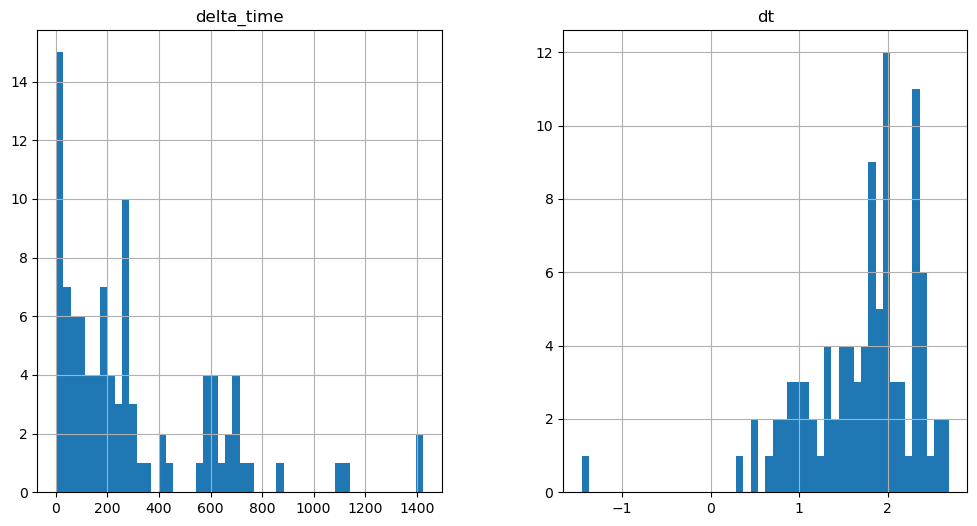

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1743.2551964521408 3.1409603357315063


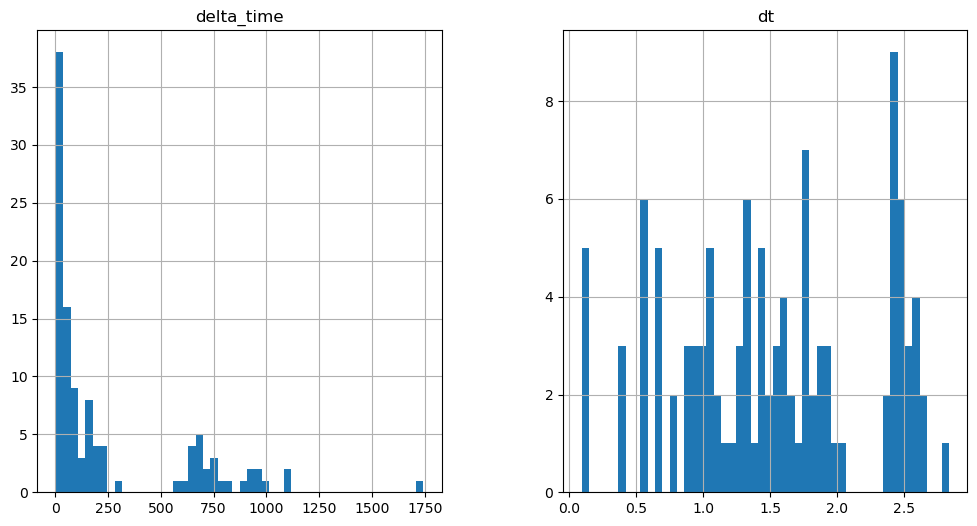

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

6618.087578177452 6.282000243663788


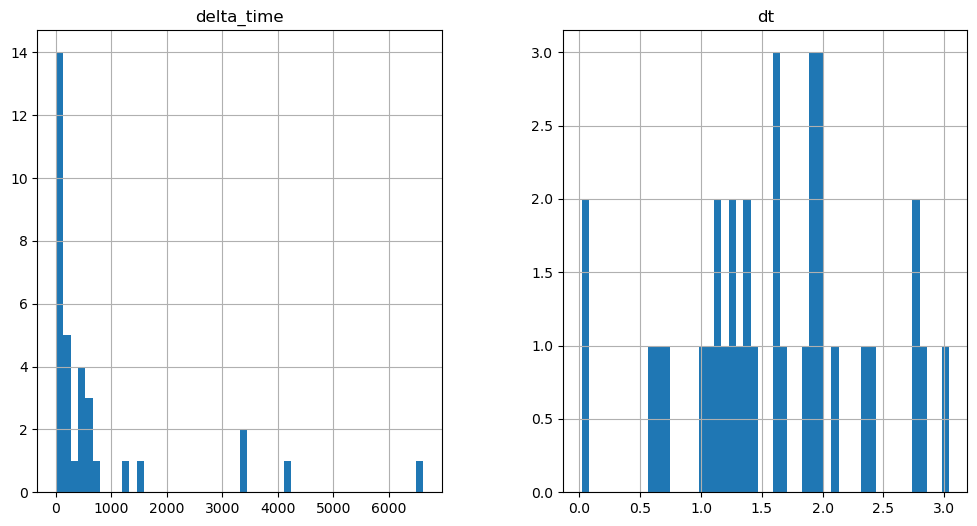

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4387.977617561817 31.409981608390808


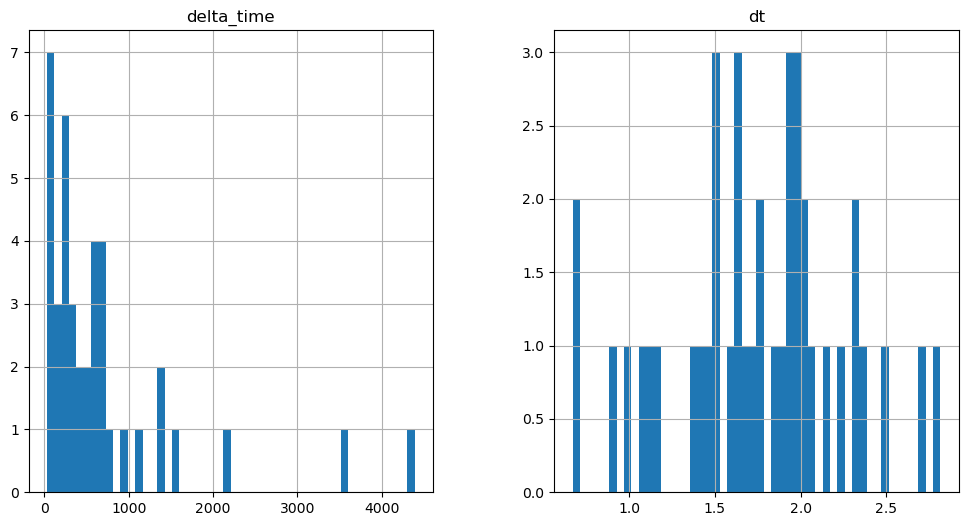

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1834.3441810011864 6.282000362873077


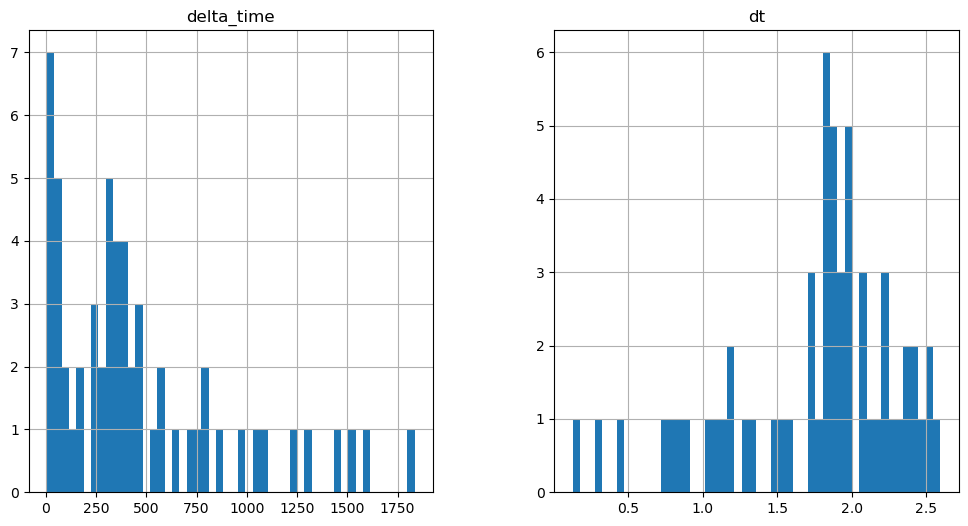

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1096.2195445895195 0.1


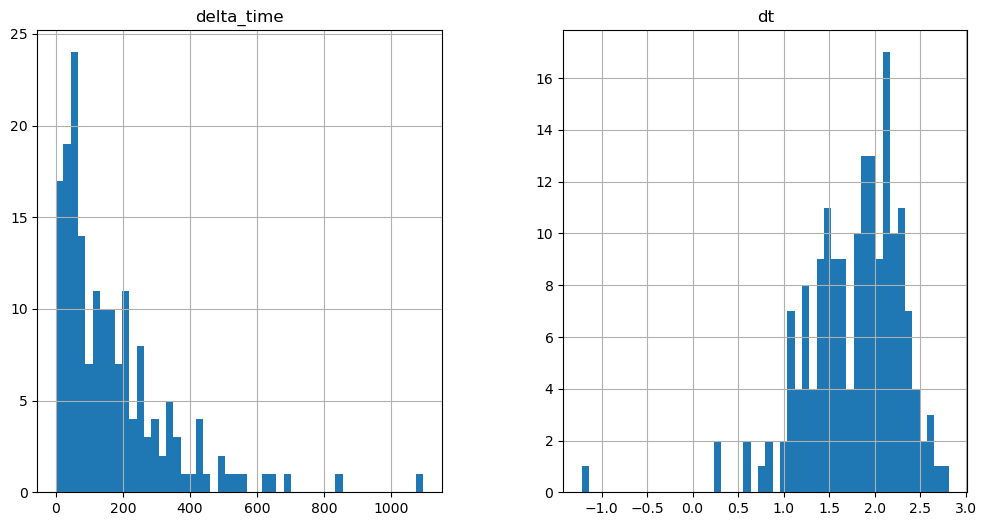

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1749.5528872013092 3.1410402059555054


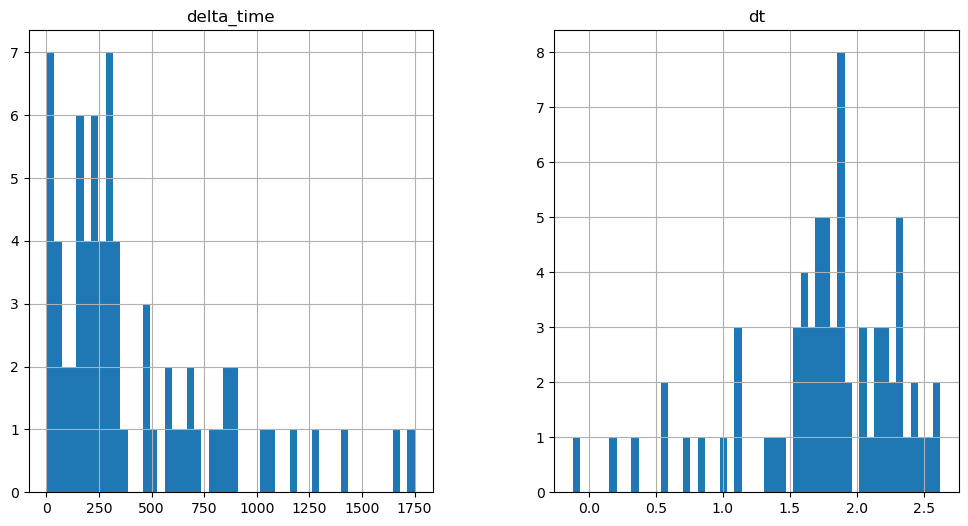

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3084.492533624172 3.1410202980041504


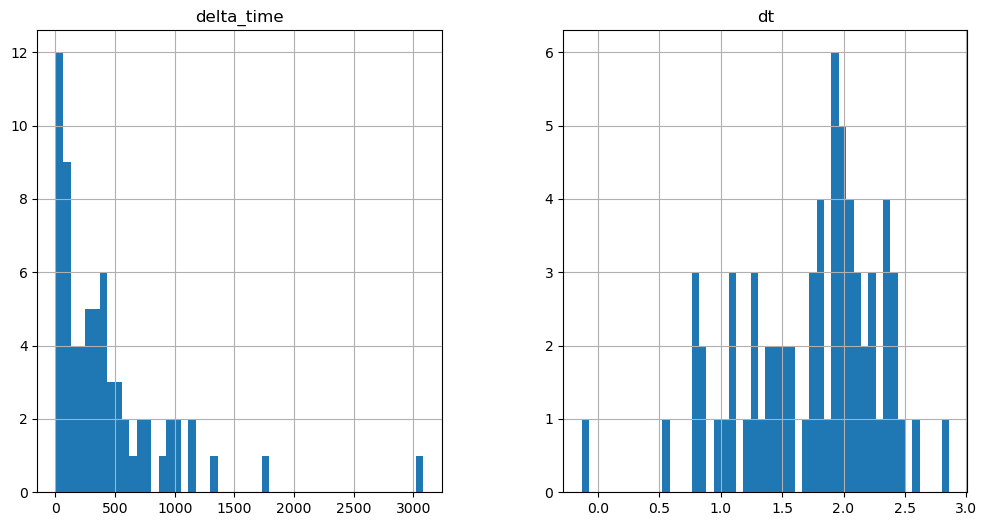

1184.1681388020515 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

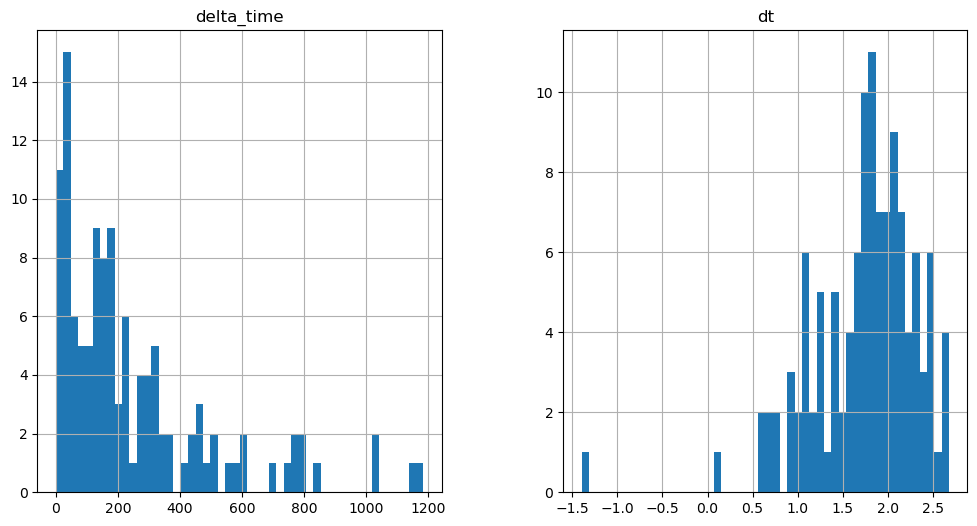

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1237.5647217035294 0.1


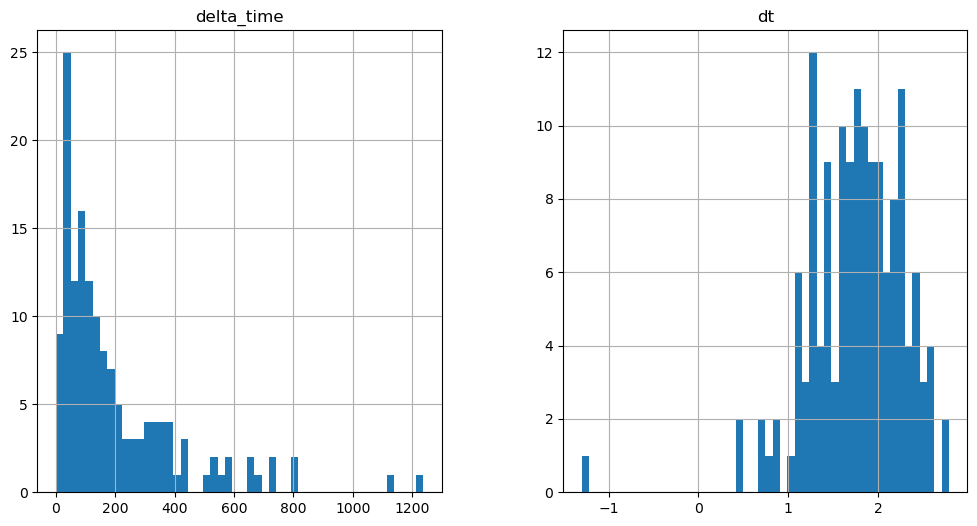

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1344.3609269857407 3.141020178794861


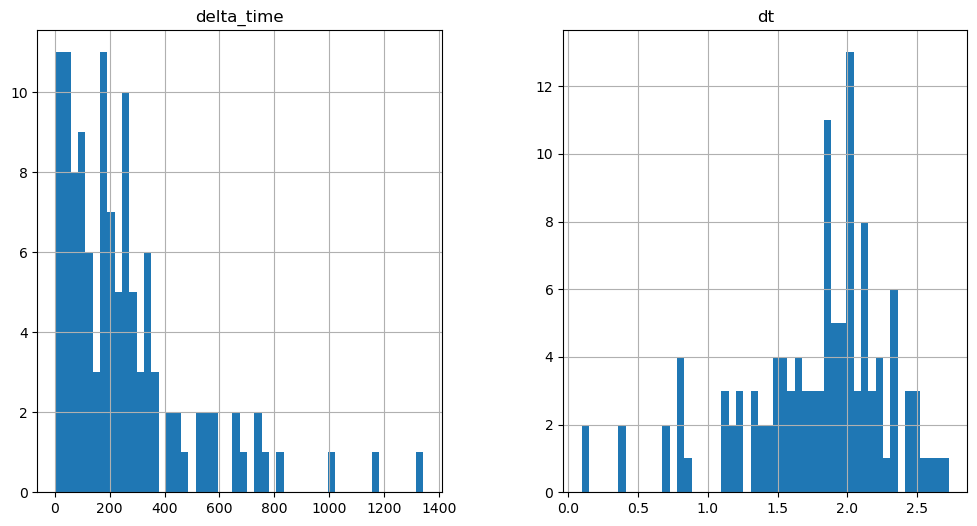

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

778.9755588173866 0.1


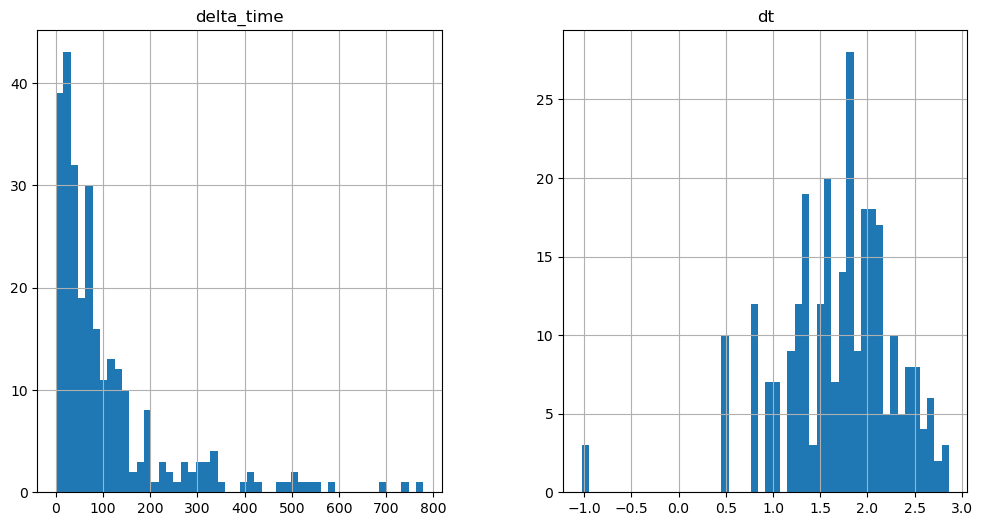

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1693.015844464302 3.1410300731658936


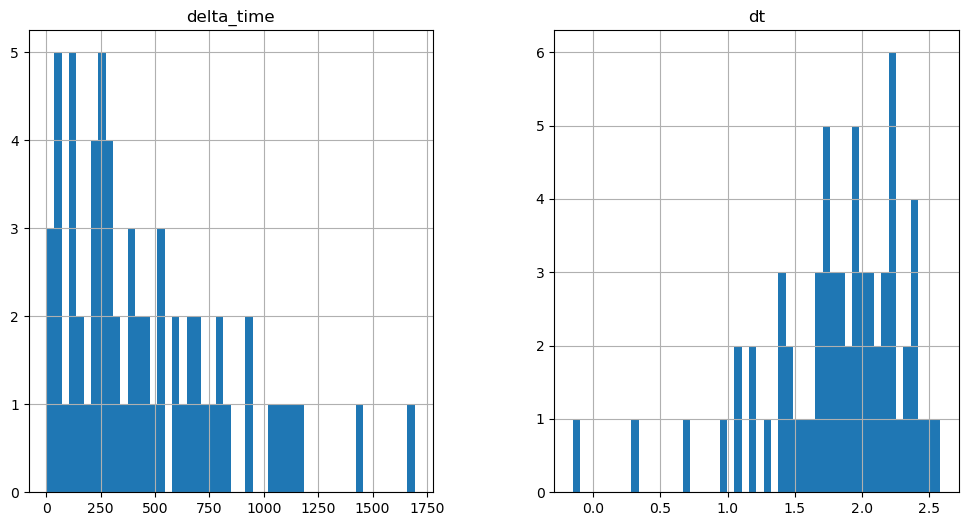

1243.8373925089836 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

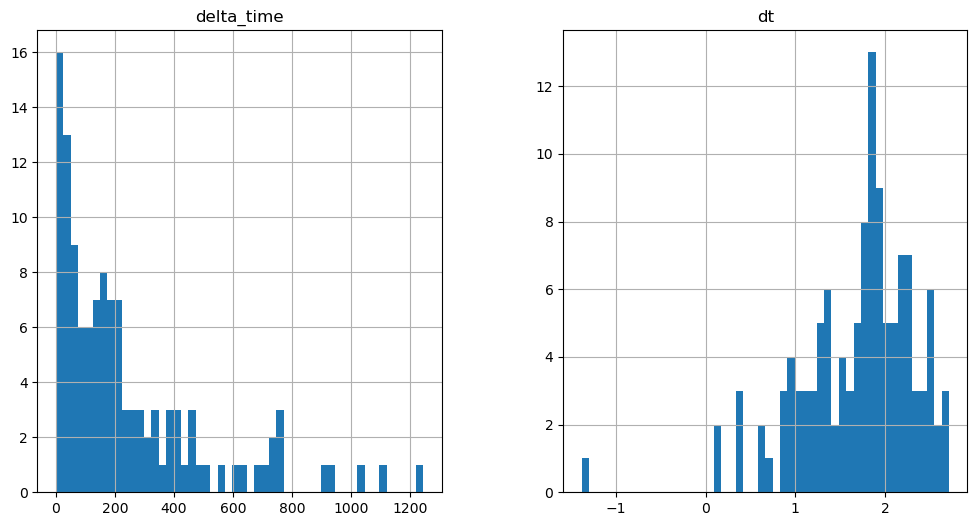

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4406.827681064606 3.140990197658539


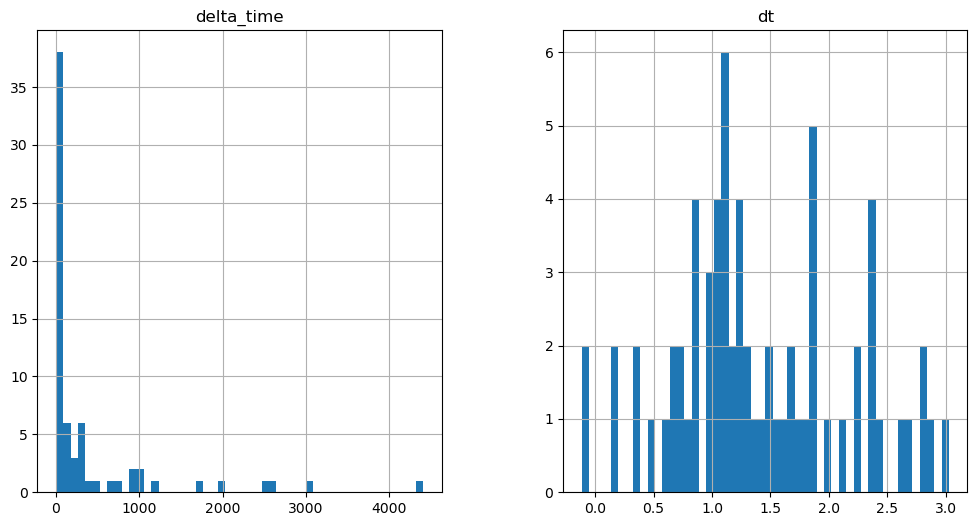

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2211.2771210074425 3.1410200595855713


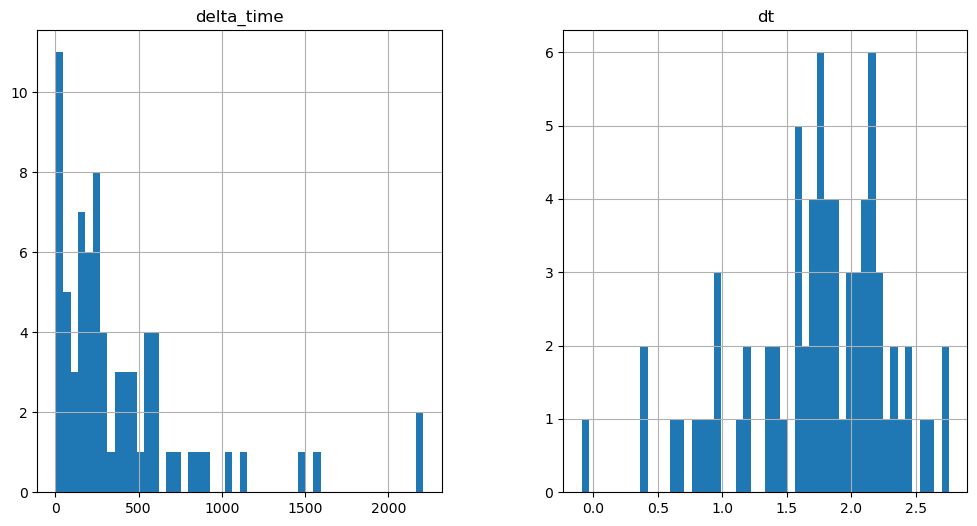

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1504.5406255722046 0.1


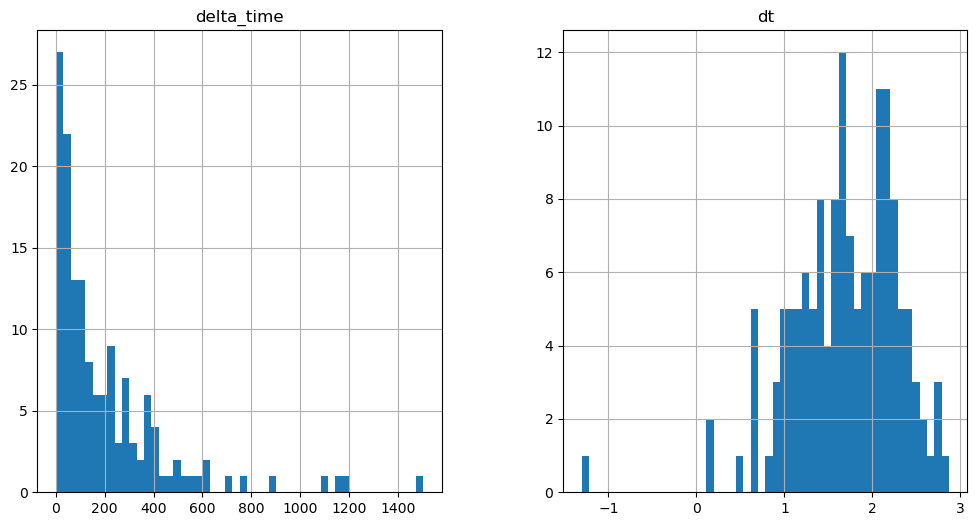

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2280.36835449934 15.705030918121338


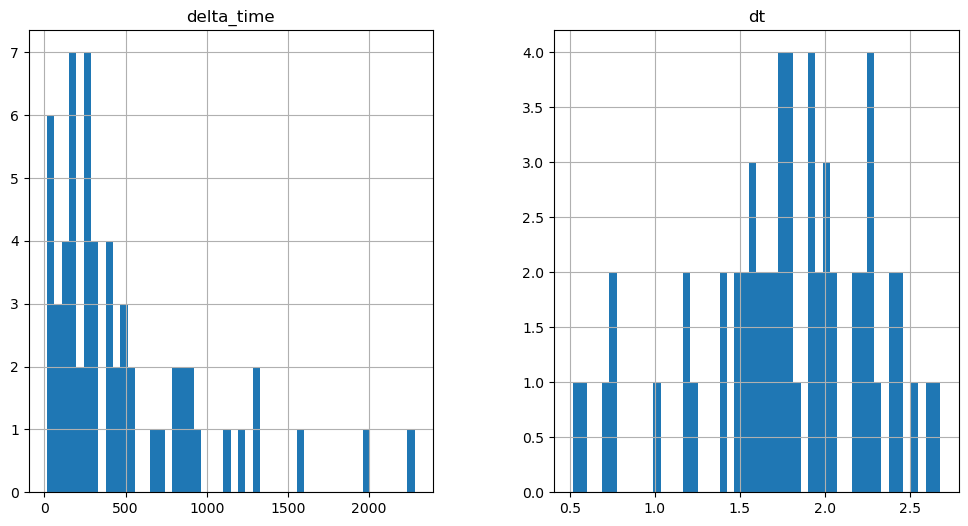

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1196.7223399877548 3.141000211238861


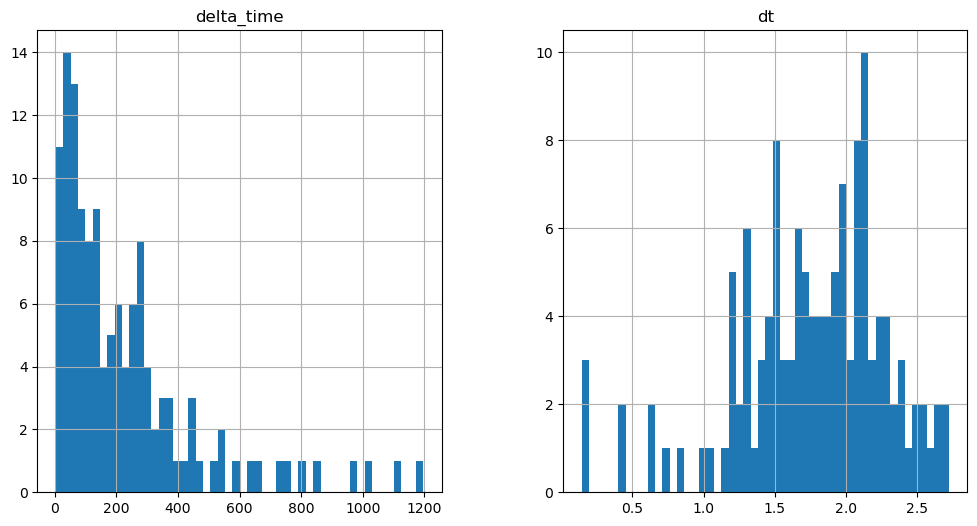

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

763.2638081908226 3.140990197658539


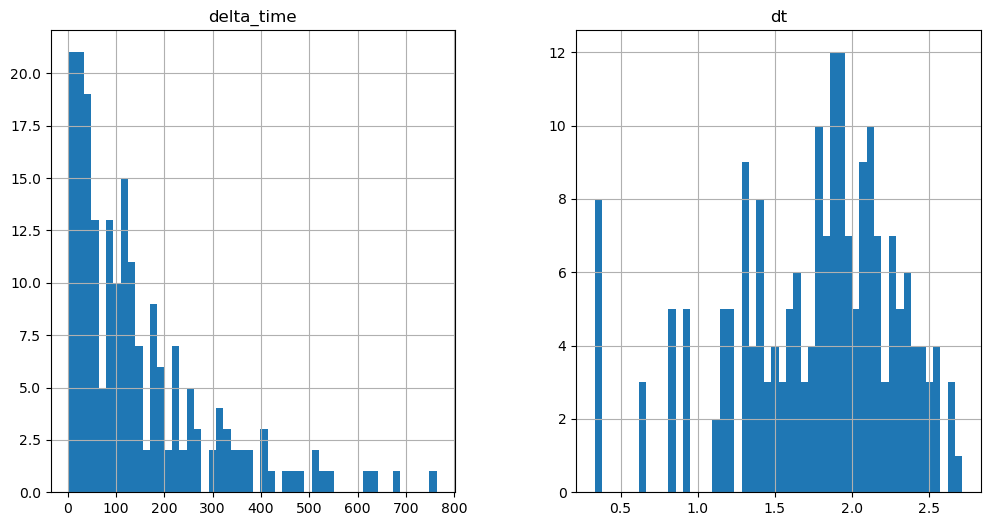

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2358.8956184387207 3.1410200595855713


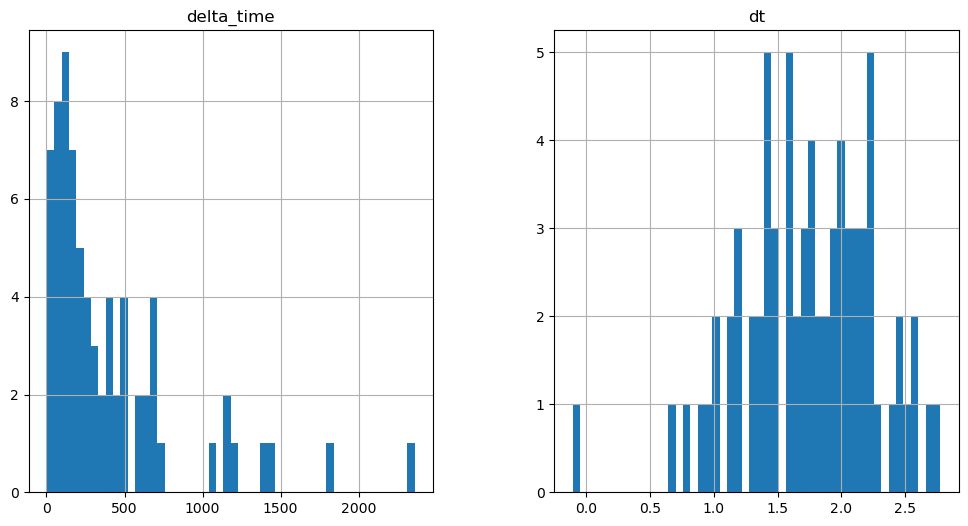

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5276.882942736149 9.423020422458649


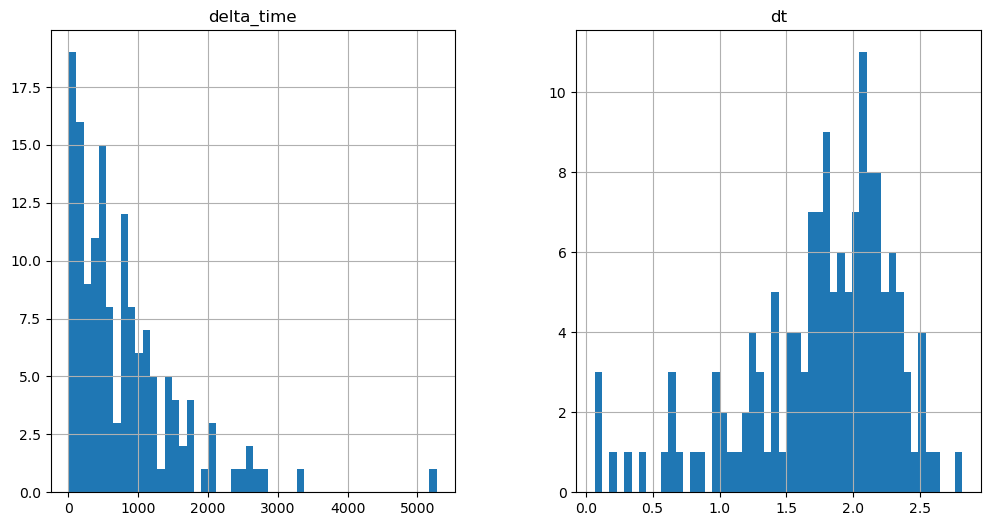

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5678.9312126636505 6.28201025724411


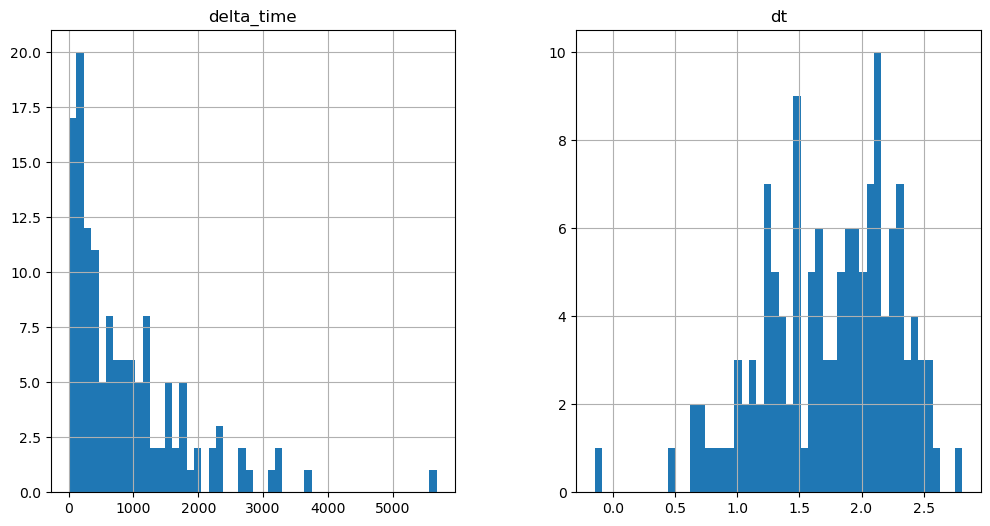

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

6319.695674598217 12.564030528068542


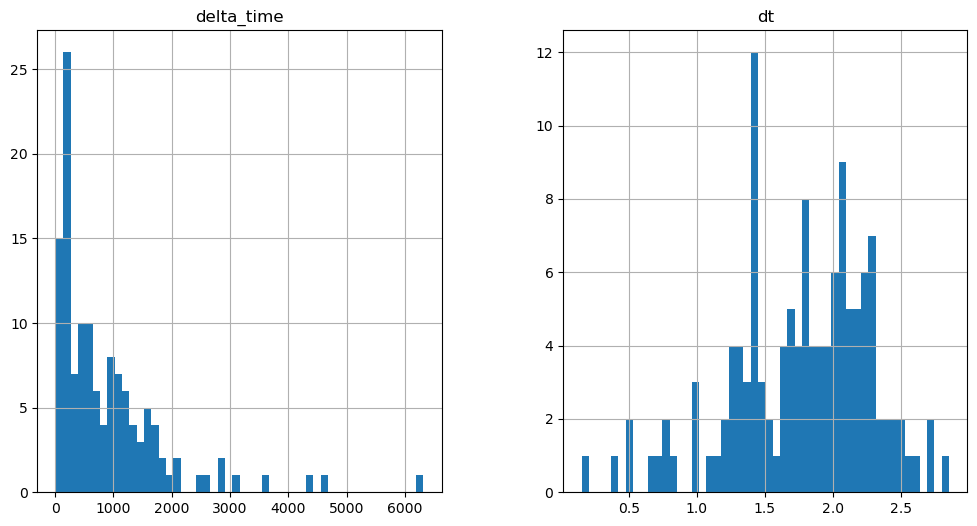

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

7142.638465464115 6.282000362873077


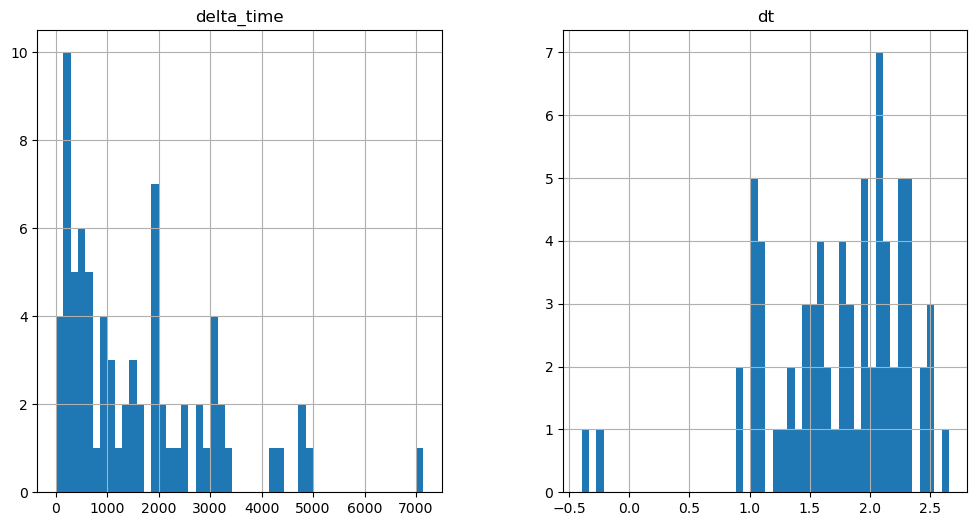

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3558.754787027836 3.141010046005249


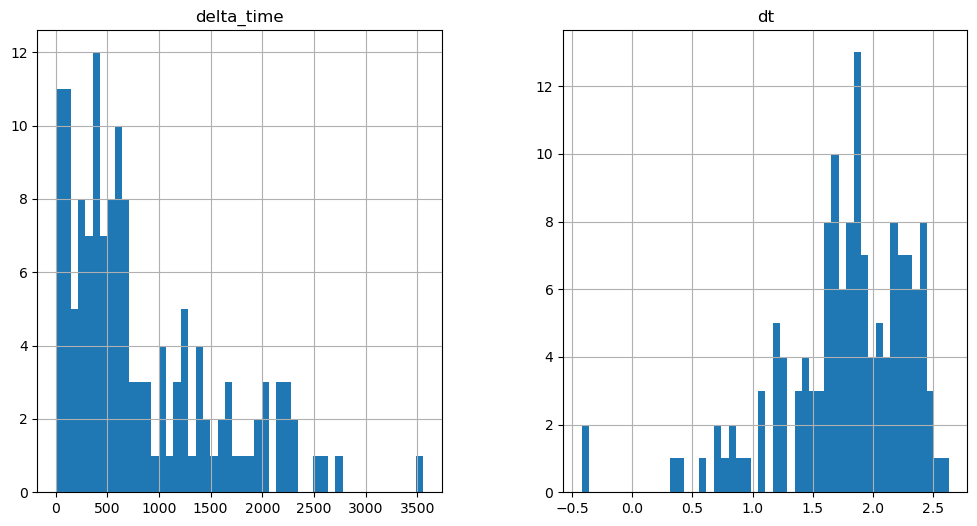

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

7626.352879703045 3.141010105609894


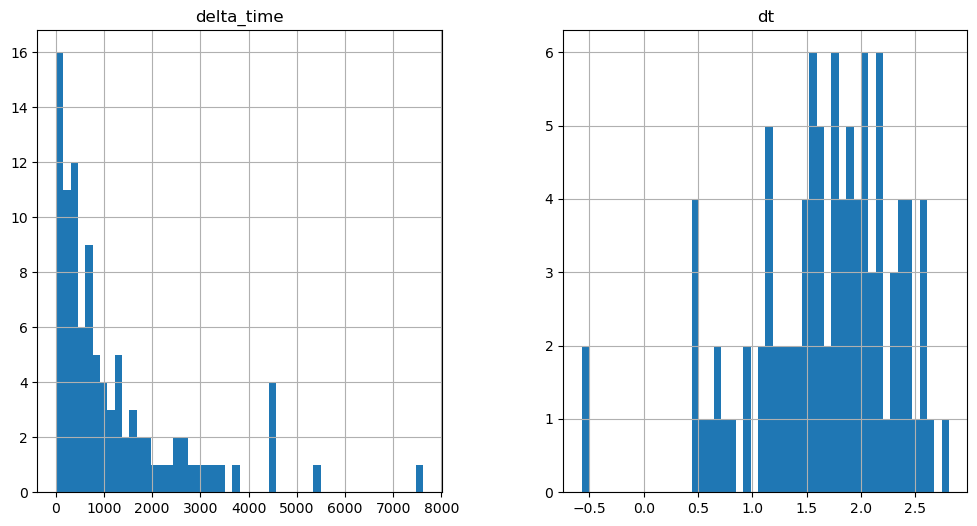

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5493.612153410912 12.564040541648865


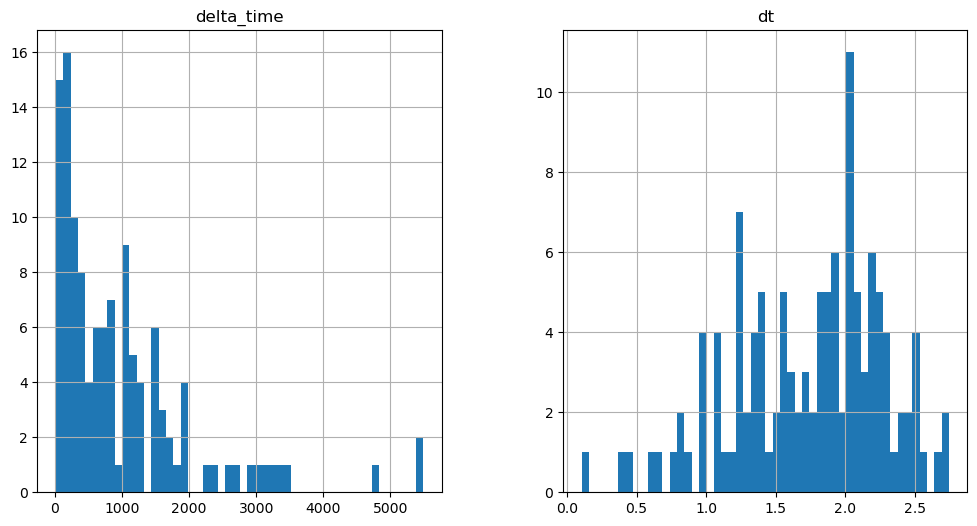

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3543.0502462387085 0.1


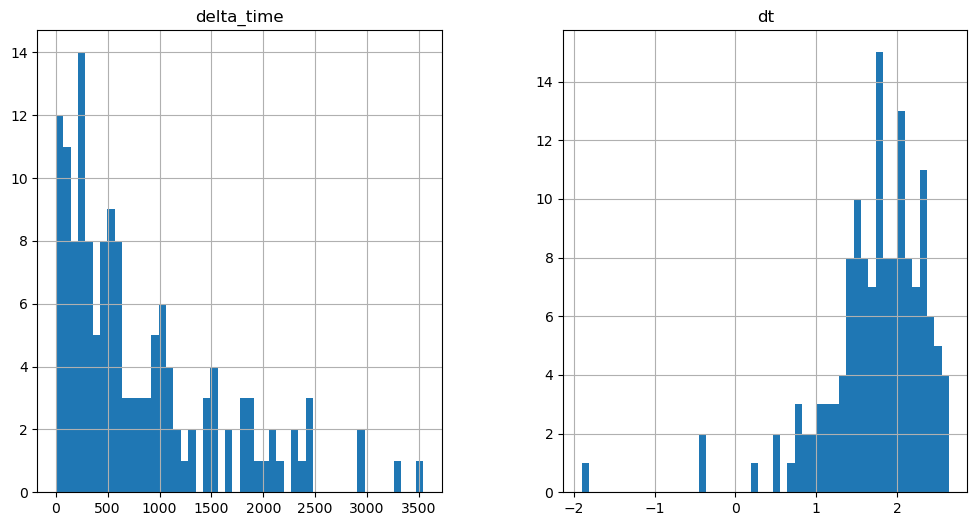

9564.351105988026 12.564010620117188


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

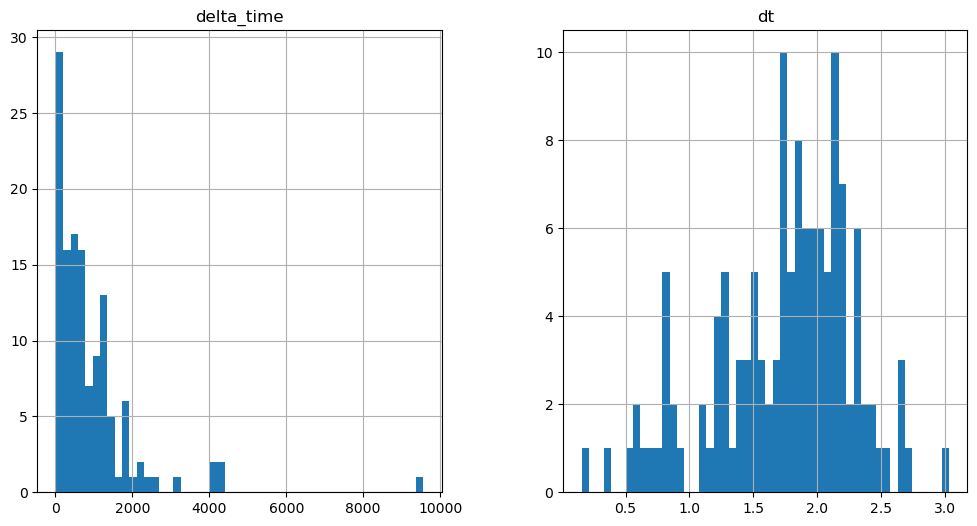

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1306.65673494339 0.1


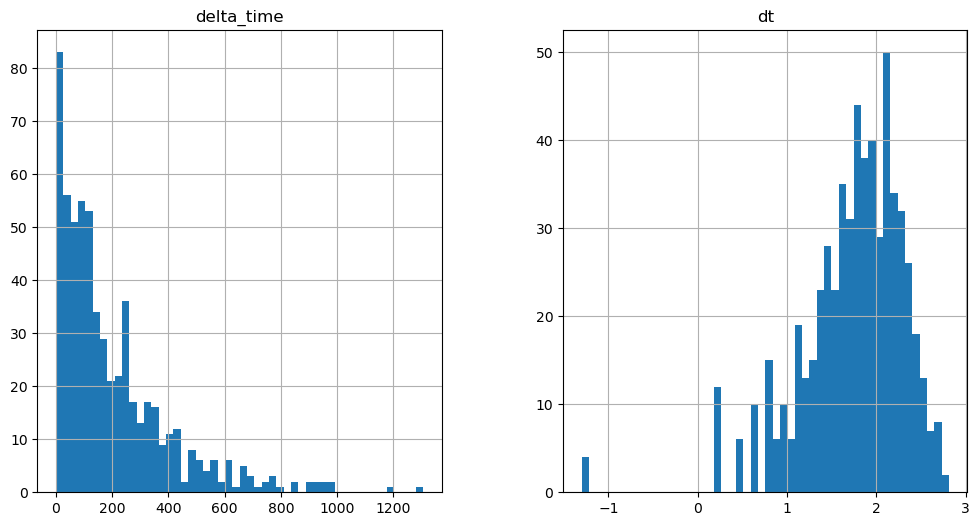

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3643.560281395912 21.98702096939087


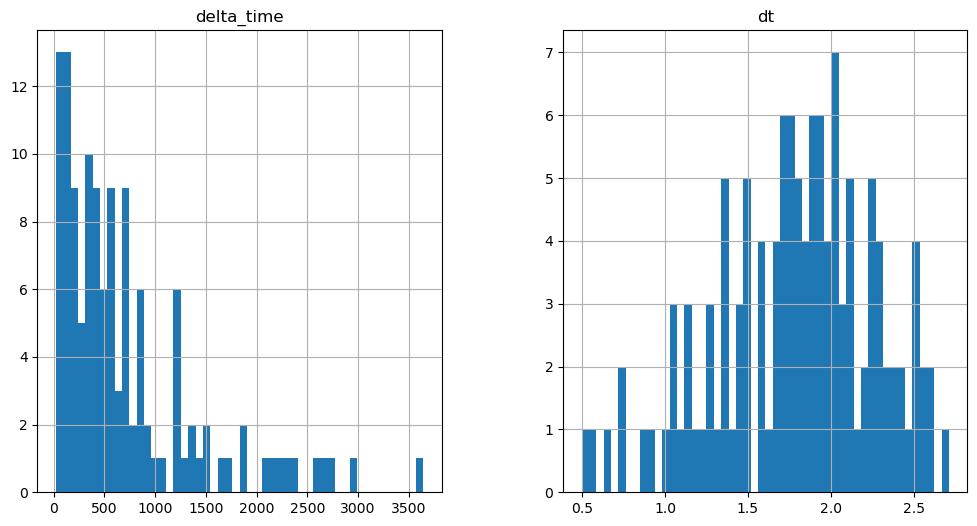

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2958.8222272992134 0.1


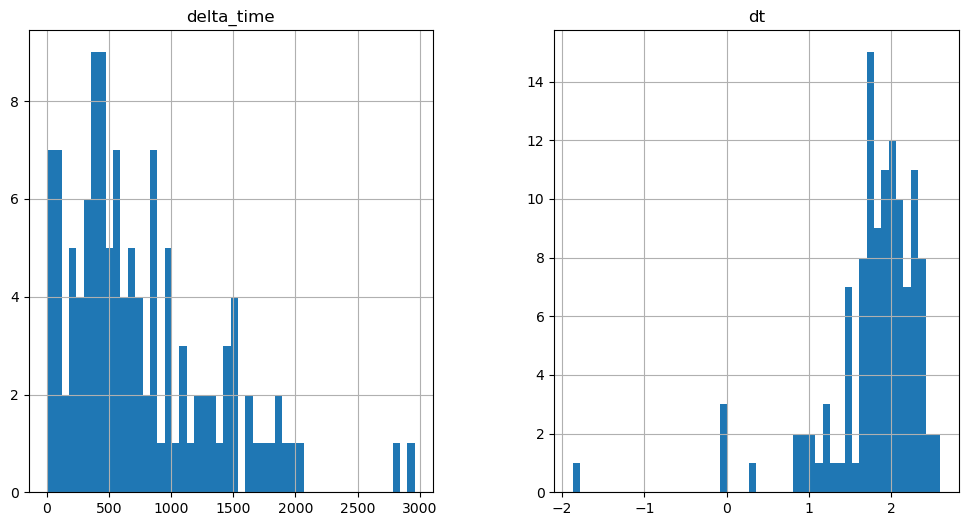

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3367.152147591114 0.1


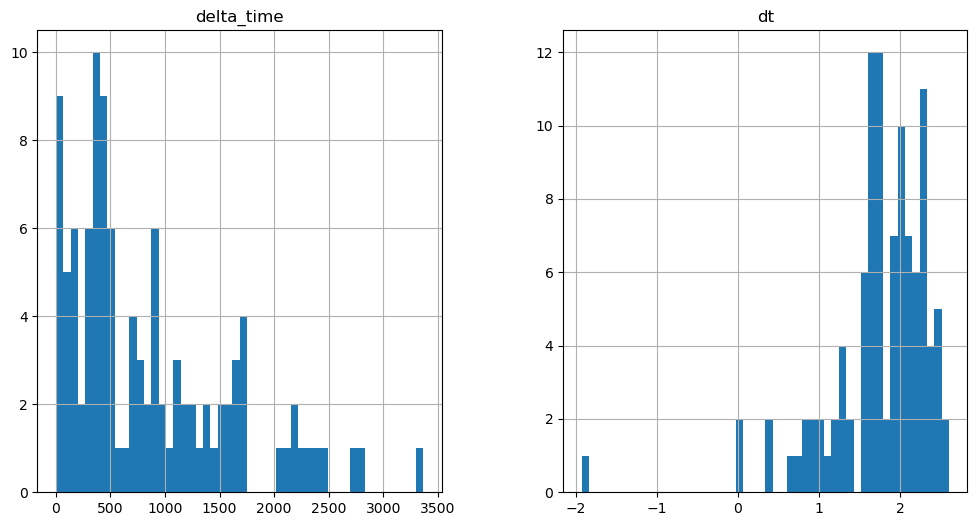

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3985.92932844162 9.423010408878326


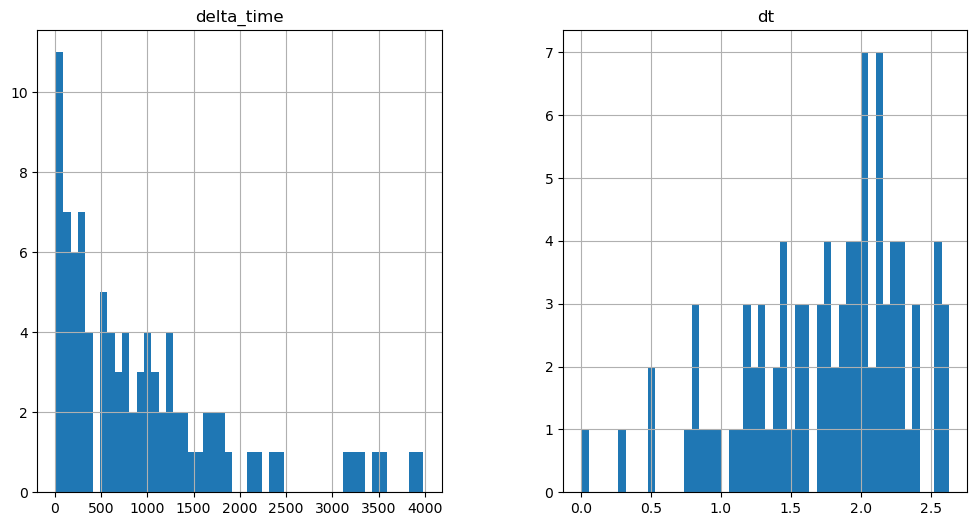

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5788.863278269768 3.140990138053894


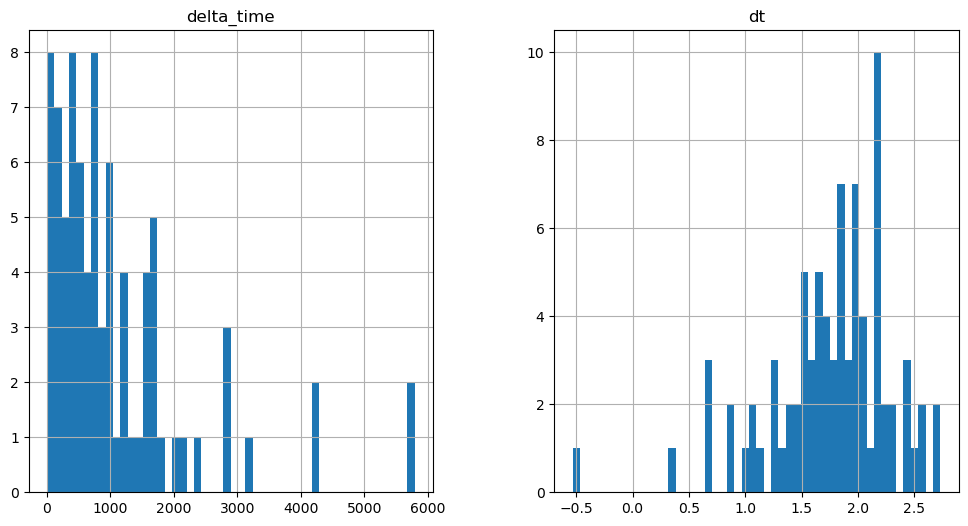

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1159.0290277600288 0.1


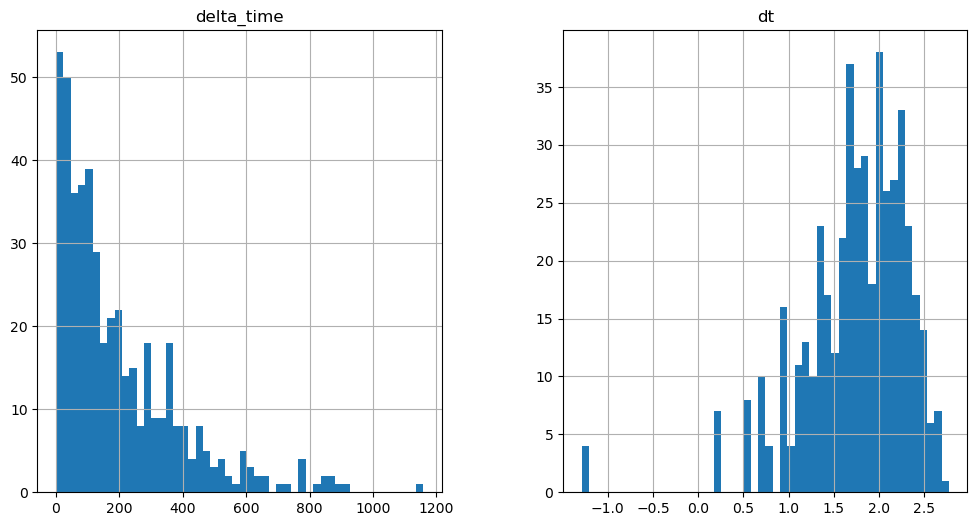

9149.728886008263 15.705010712146759


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

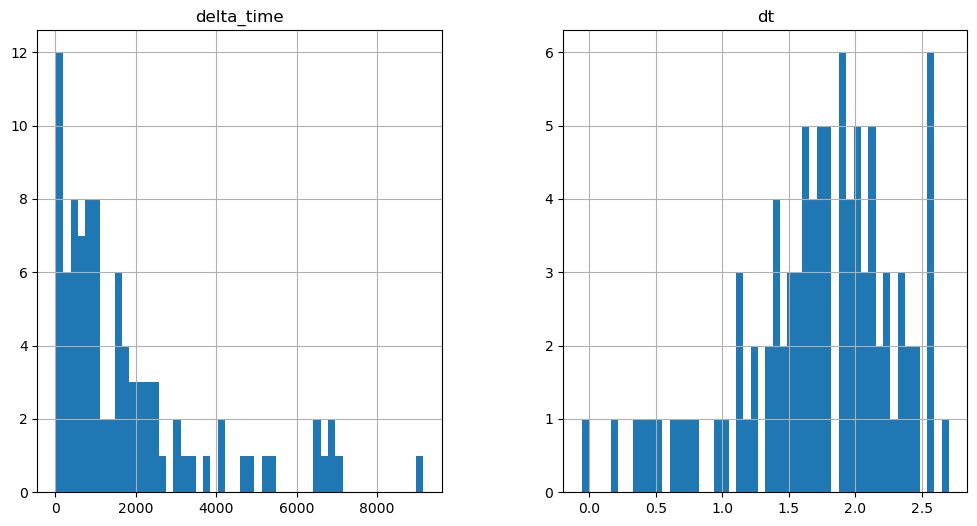

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5063.291622400284 3.1409802436828613


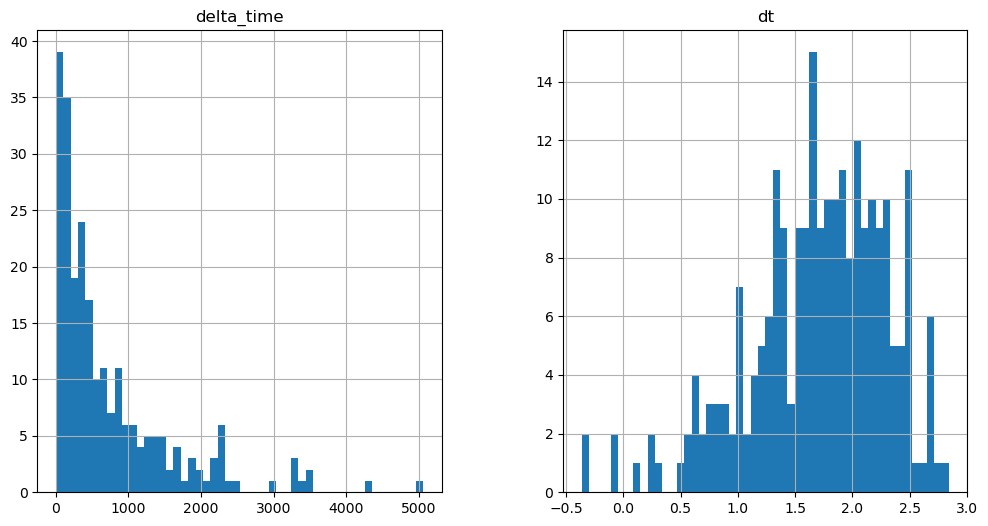

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5314.5703448057175 12.563970744609833


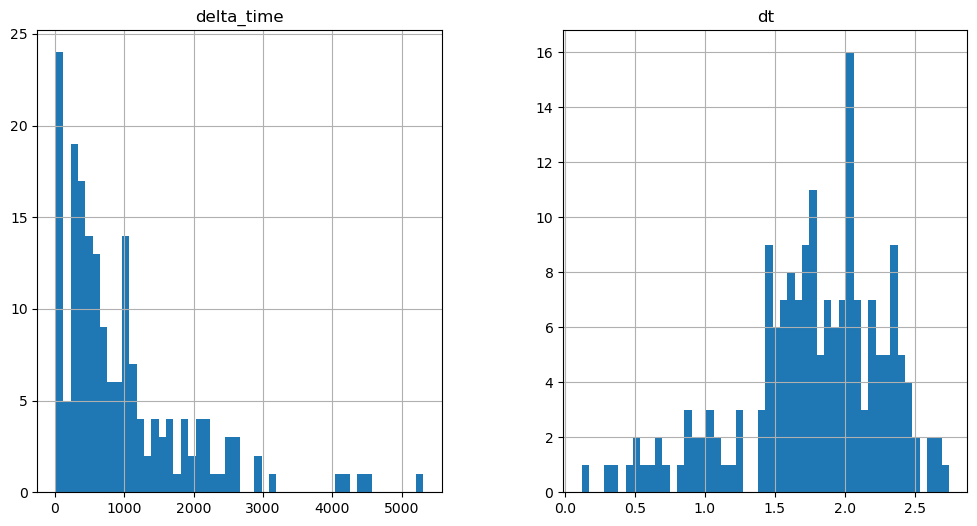

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4403.685399413109 6.282040238380432


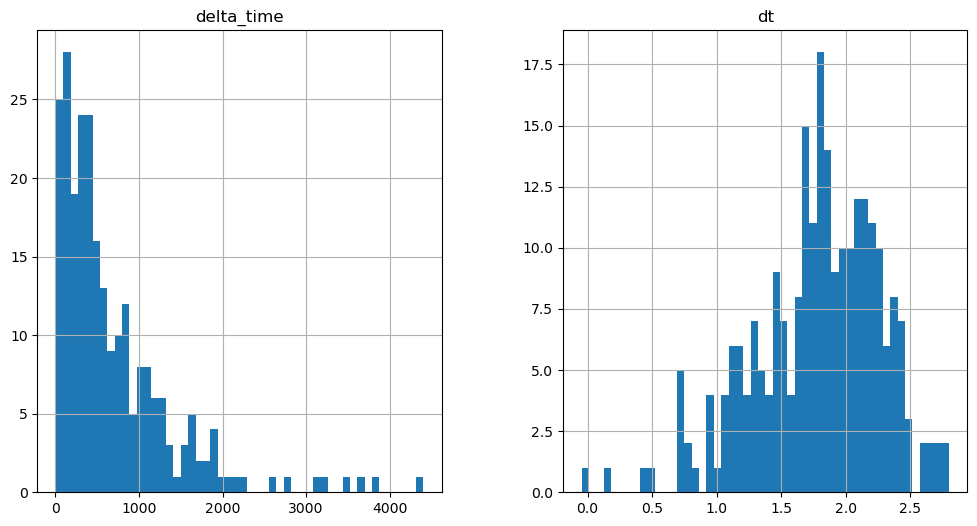

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4177.528228223324 9.422980546951294


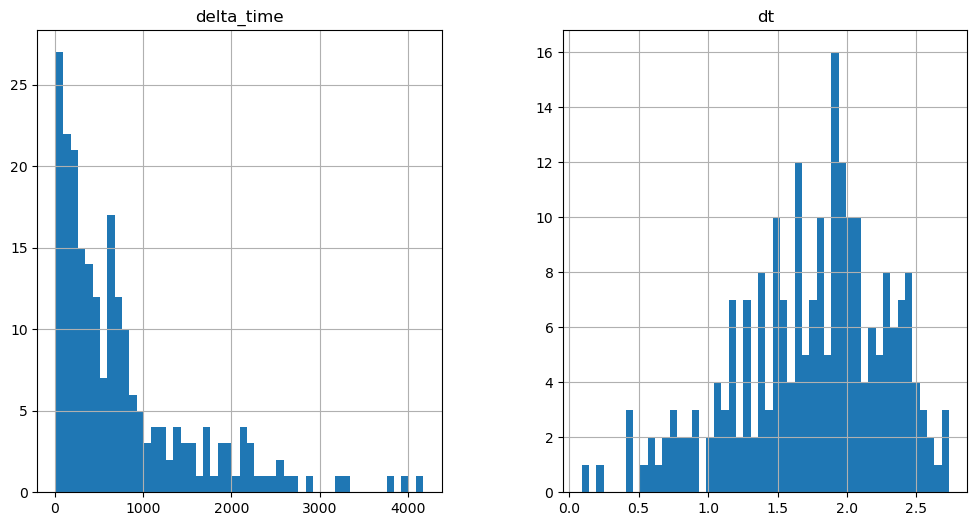

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5493.606373786926 3.141010105609894


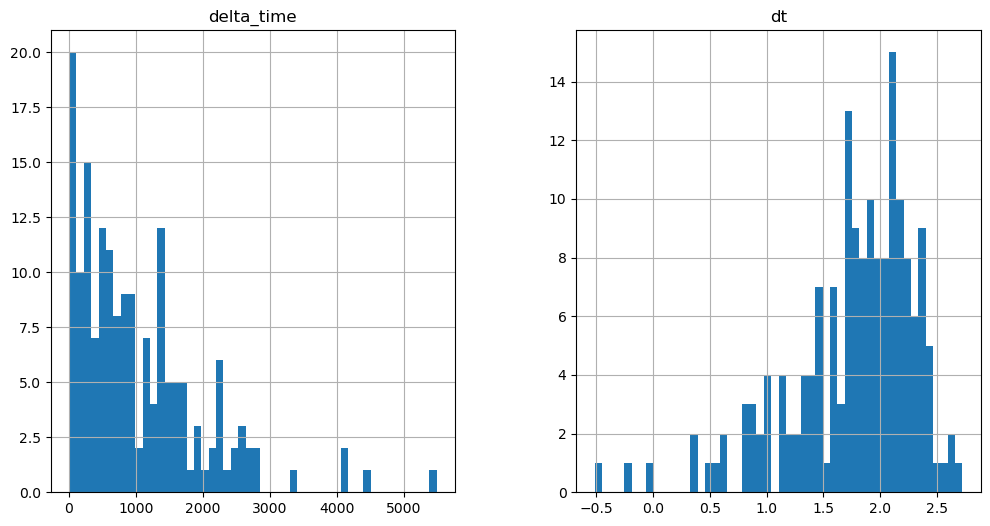

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

7048.401171326637 3.140990197658539


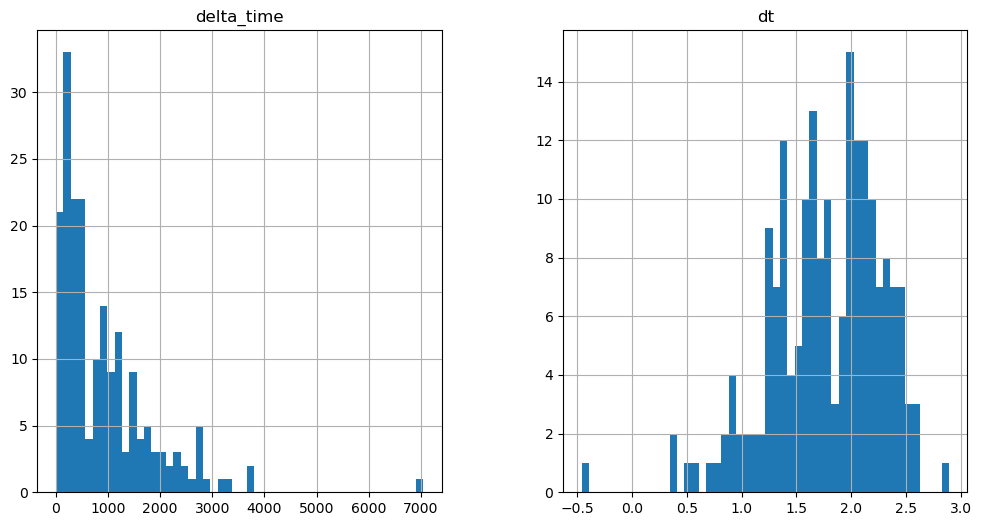

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

7814.80469930172 18.846000850200653


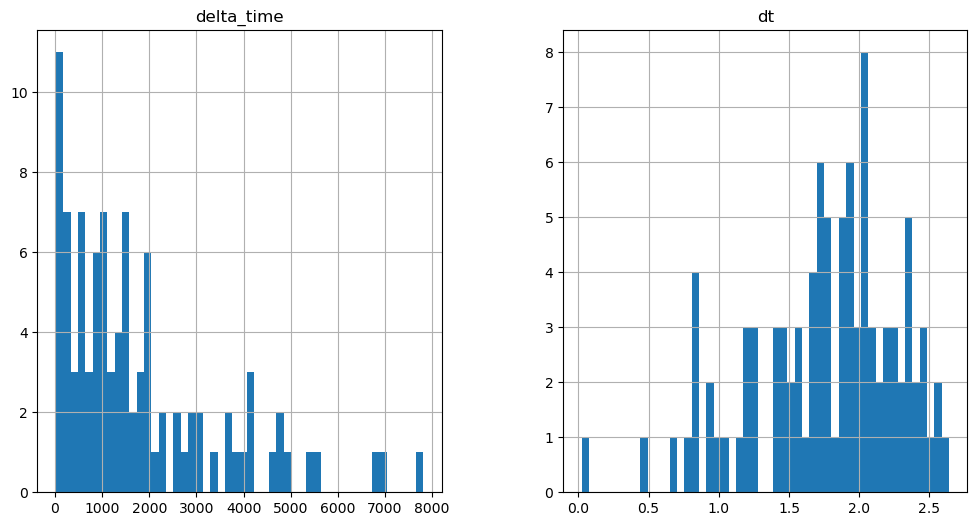

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4915.663194954395 0.1


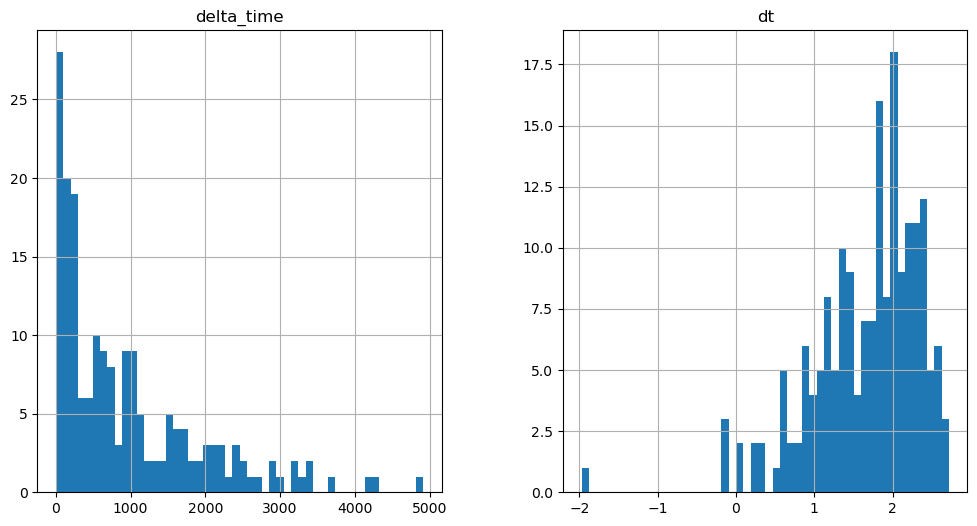

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5220.343120038509 3.141010046005249


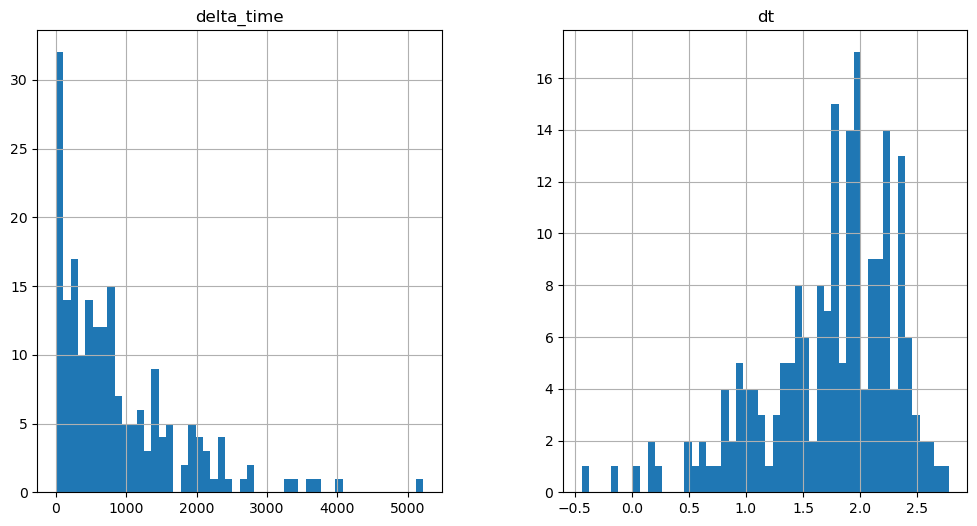

4472.781733036041 3.140990197658539


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

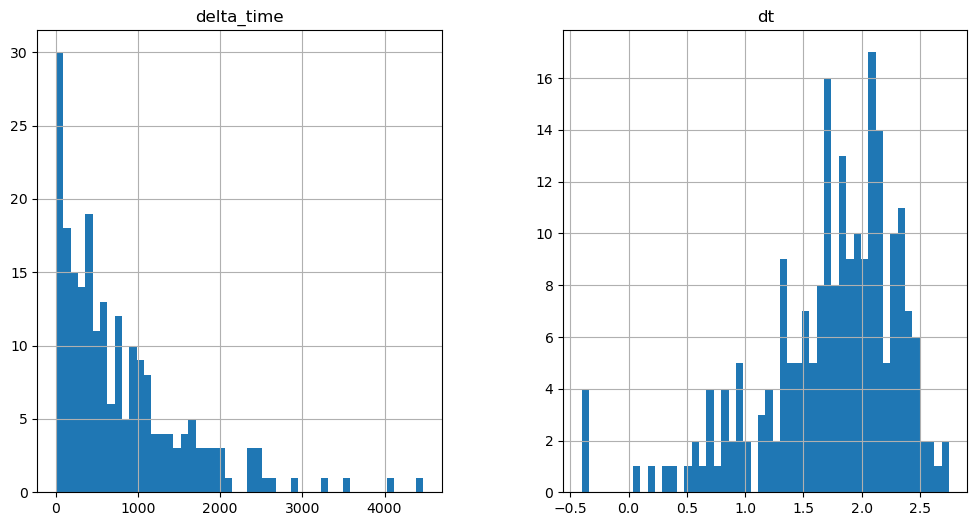

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3706.3862847089767 3.140990138053894


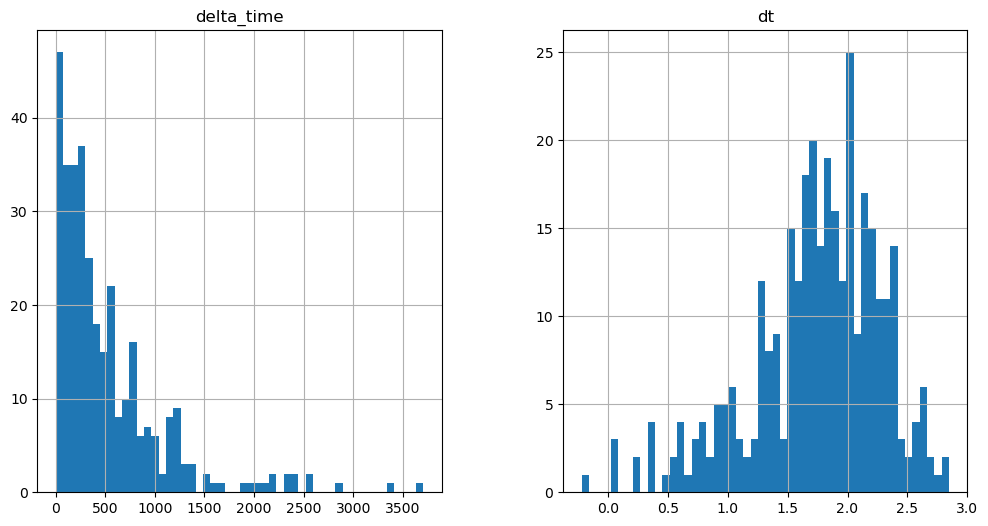

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1620.755760729313 0.1


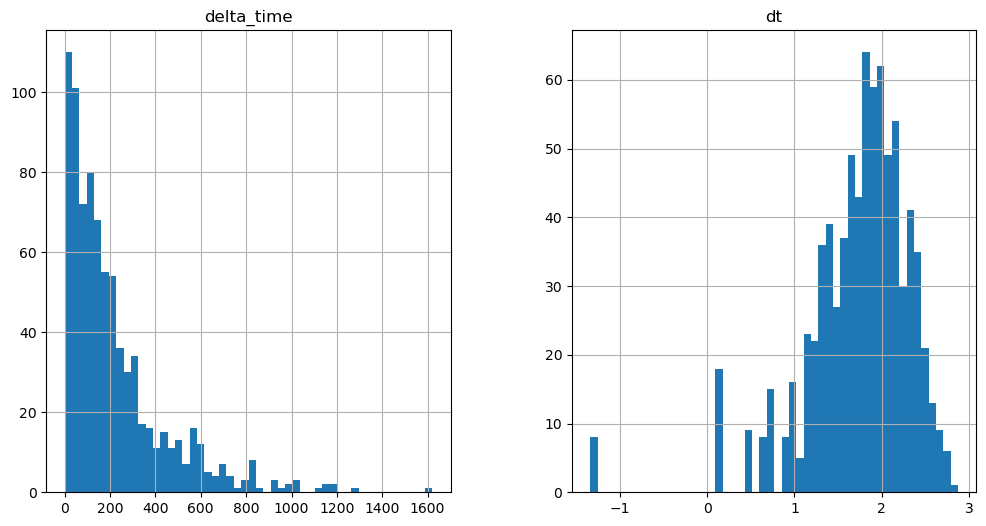

3810.0307399630547 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

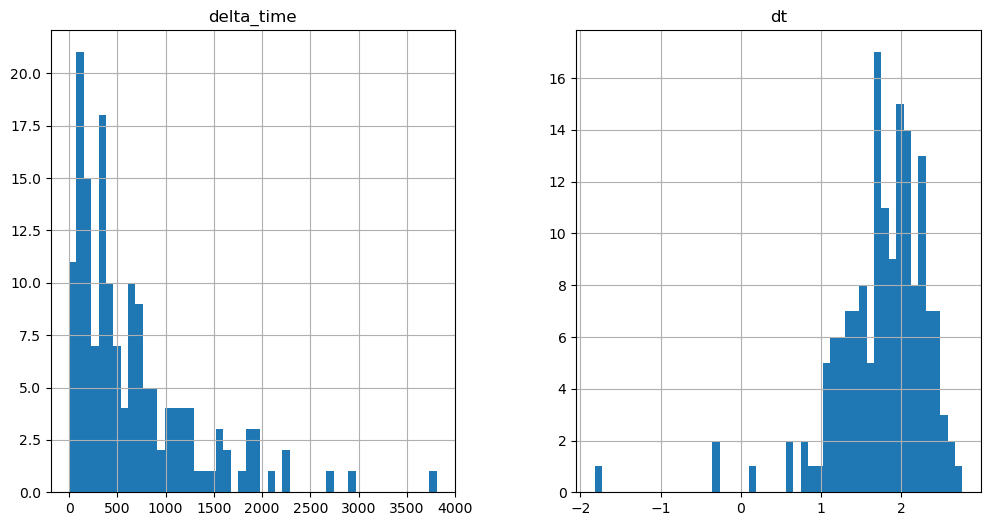

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4768.035097718239 18.846000850200653


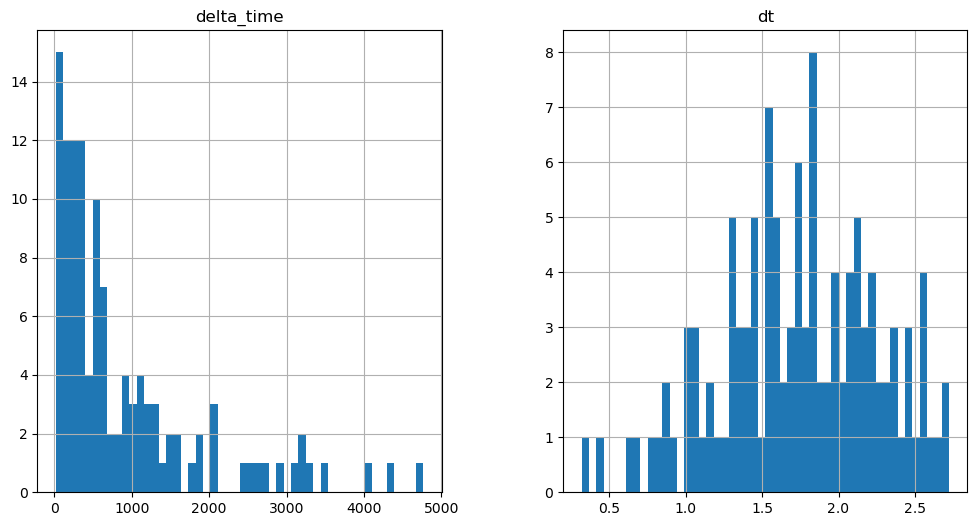

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4177.527568042278 6.282000243663788


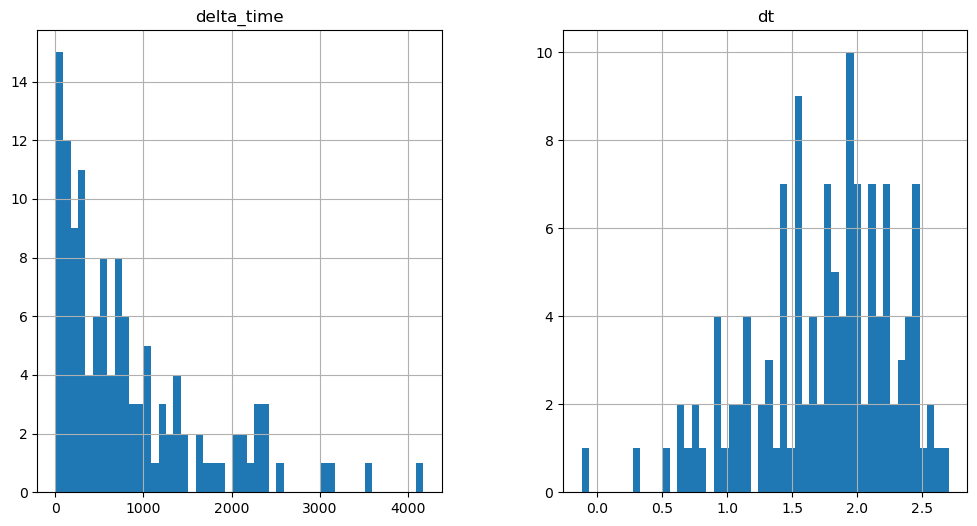

3854.004562139511 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

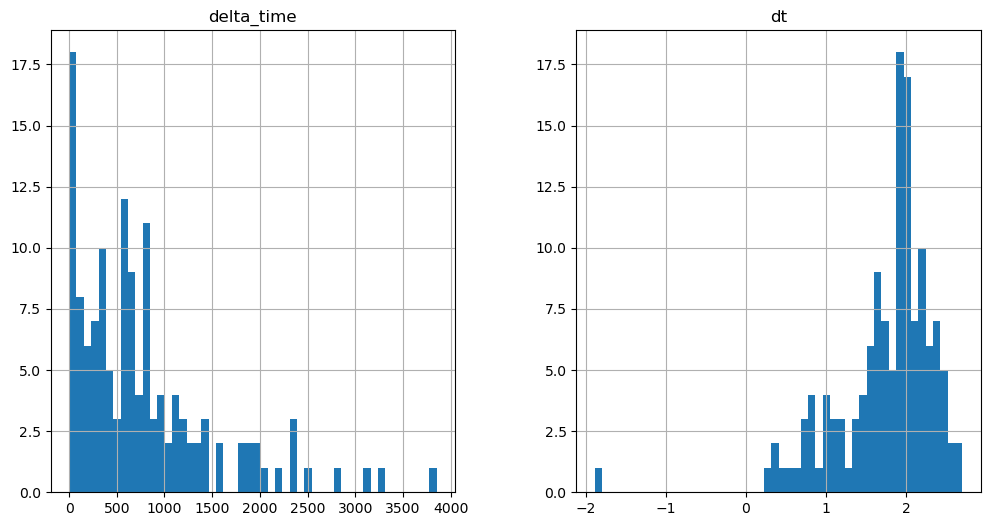

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4127.271495580673 0.1


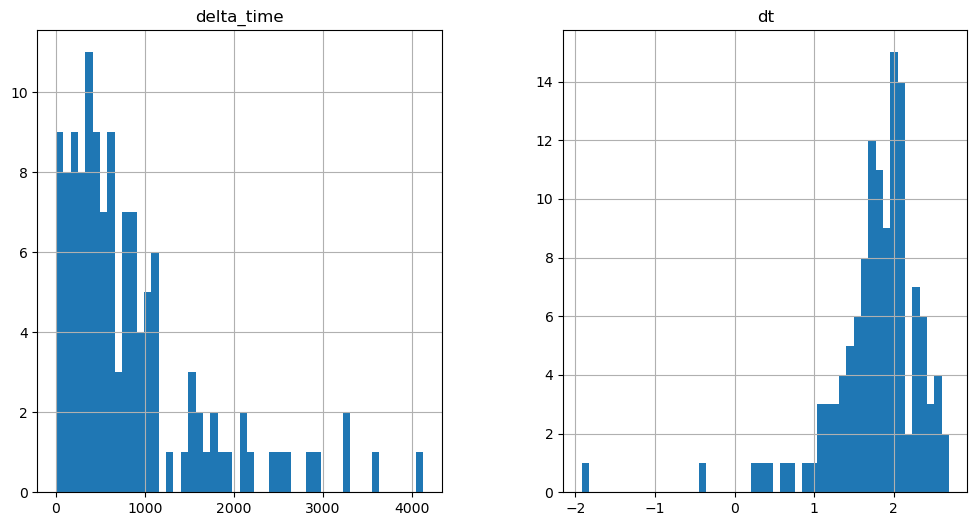

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5496.746723949909 12.564000606536865


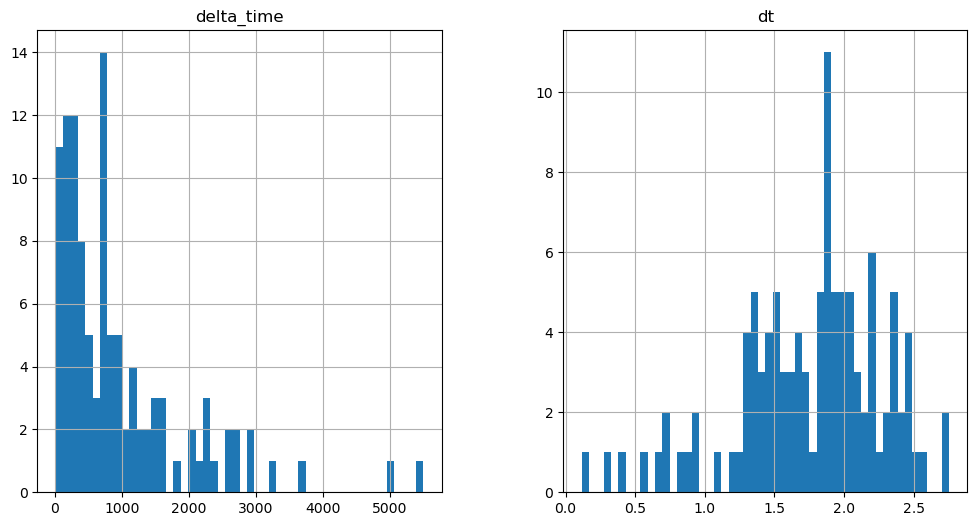

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5710.334404528141 9.423010408878326


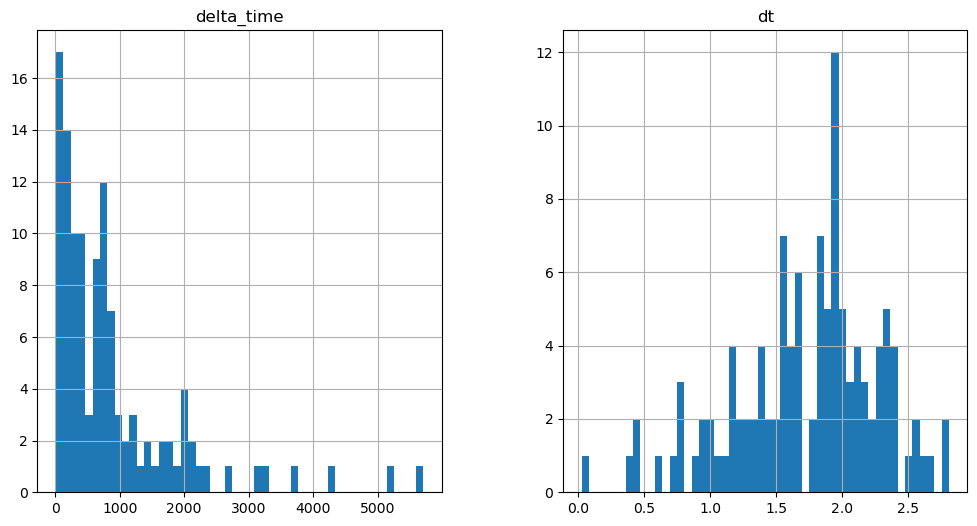

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

6542.698945939541 0.1


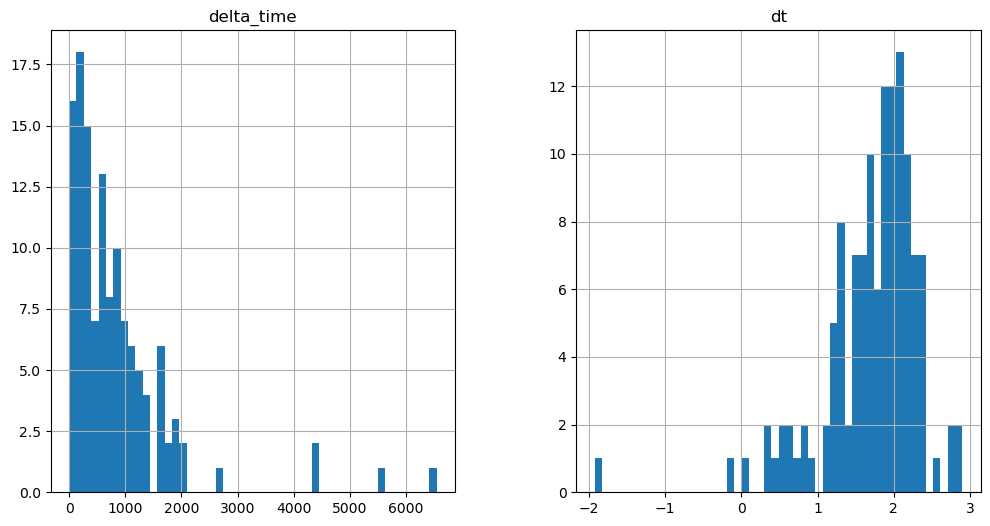

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1444.8590919971466 0.1


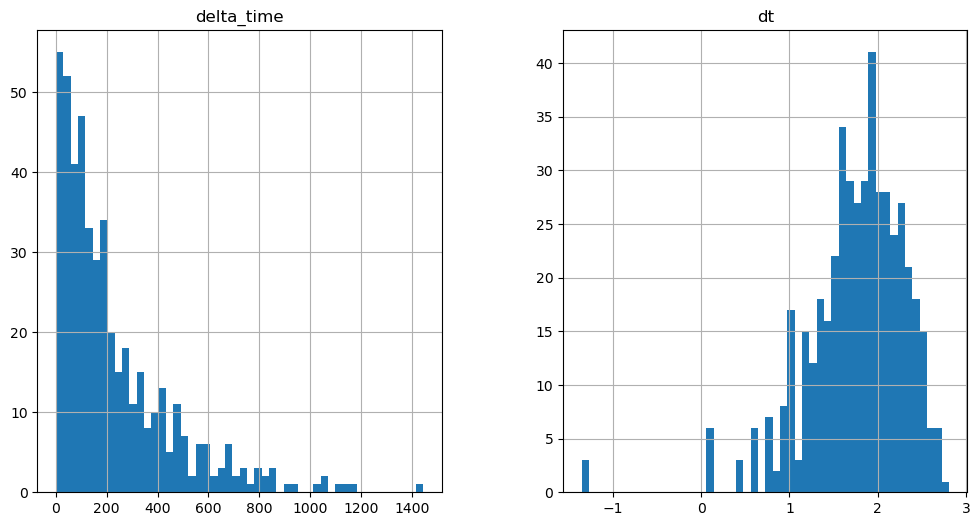

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

6935.332055151463 6.282000362873077


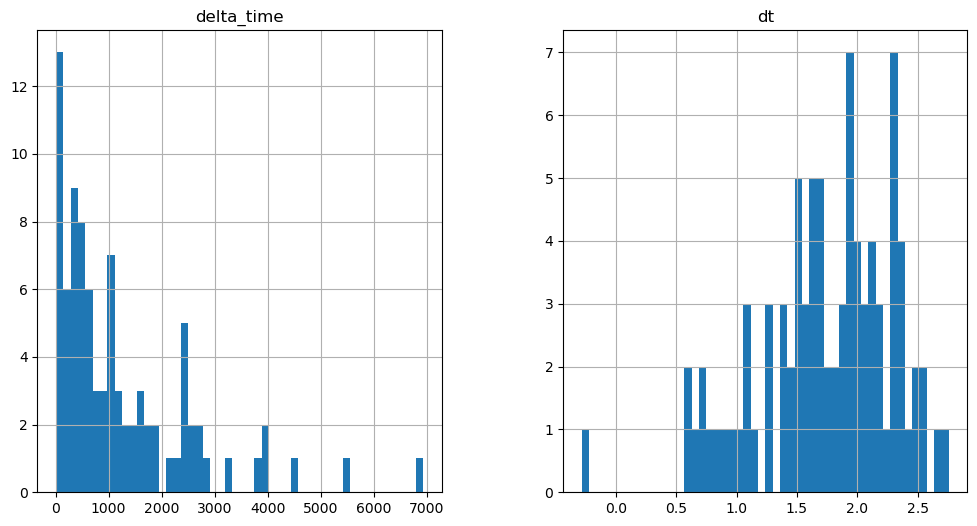

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4029.905670464039 0.1


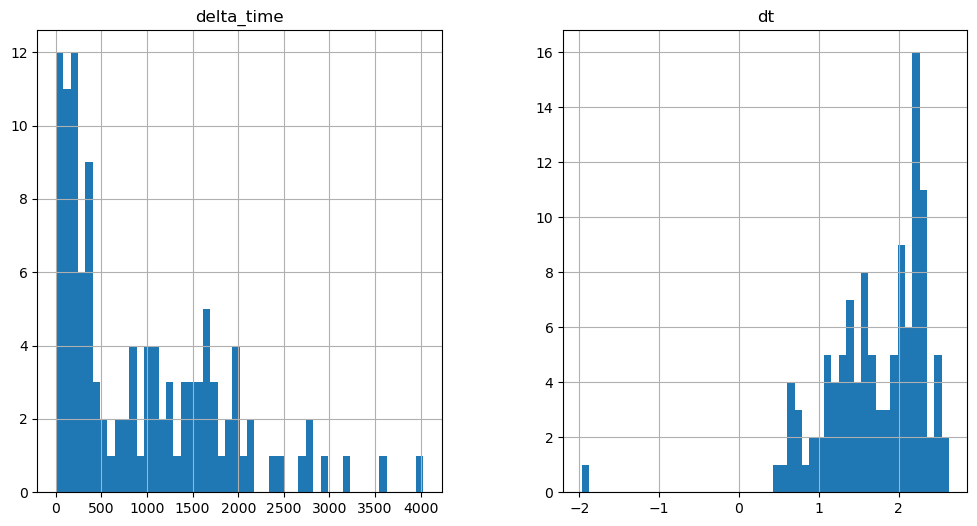

3546.191146492958 3.141020119190216


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

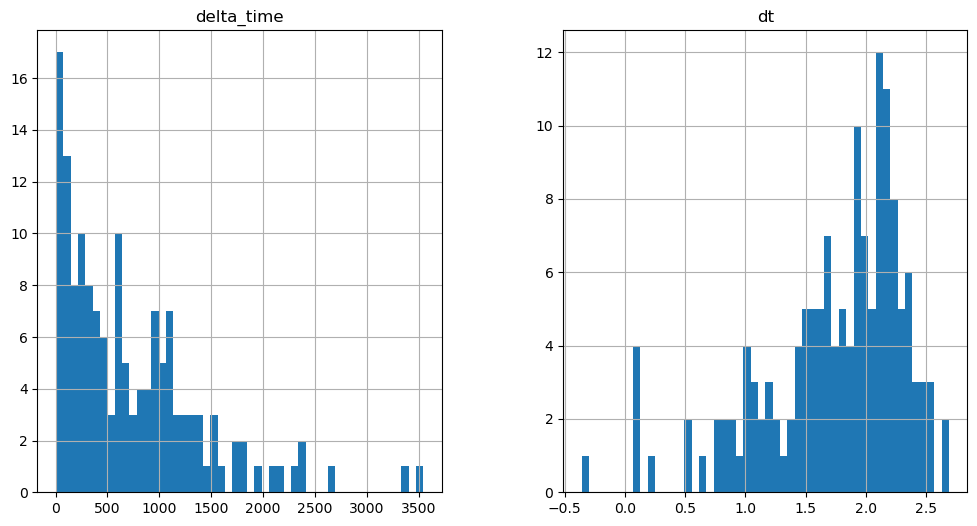

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3627.8572903871536 3.141020119190216


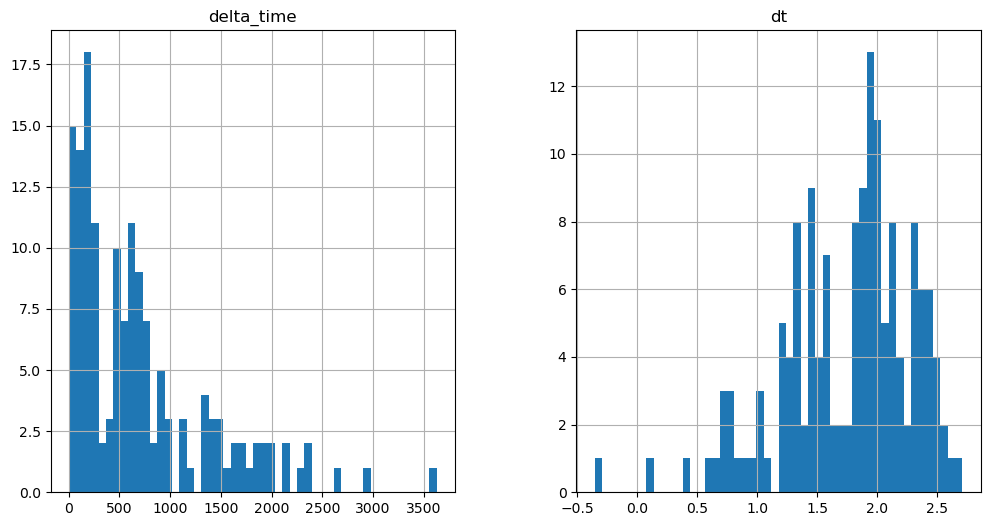

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4020.4821900725365 3.141010105609894


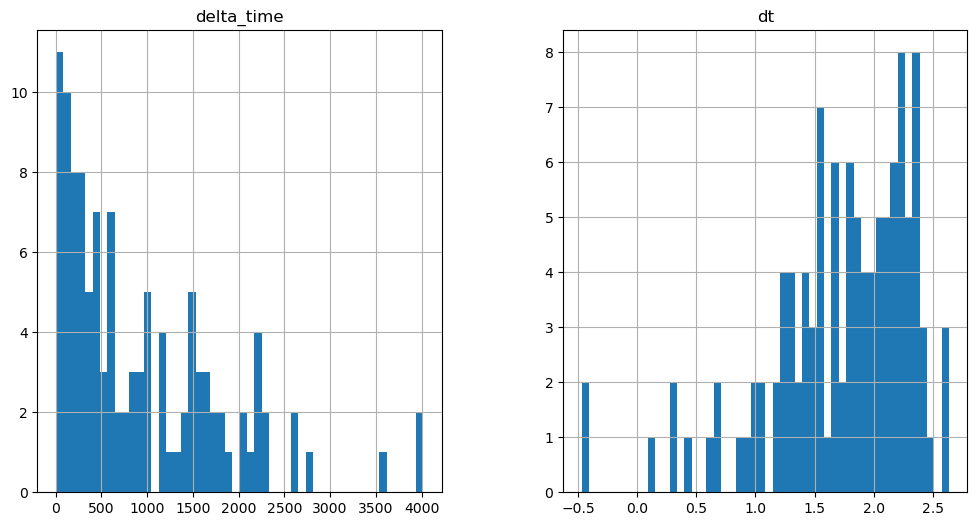

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

6049.570120930672 3.141010105609894


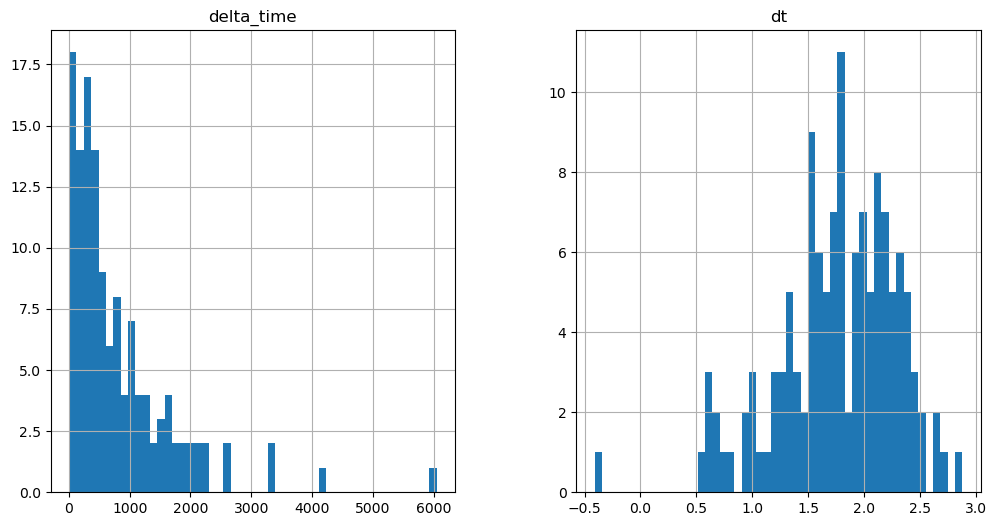

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4523.043084859848 0.1


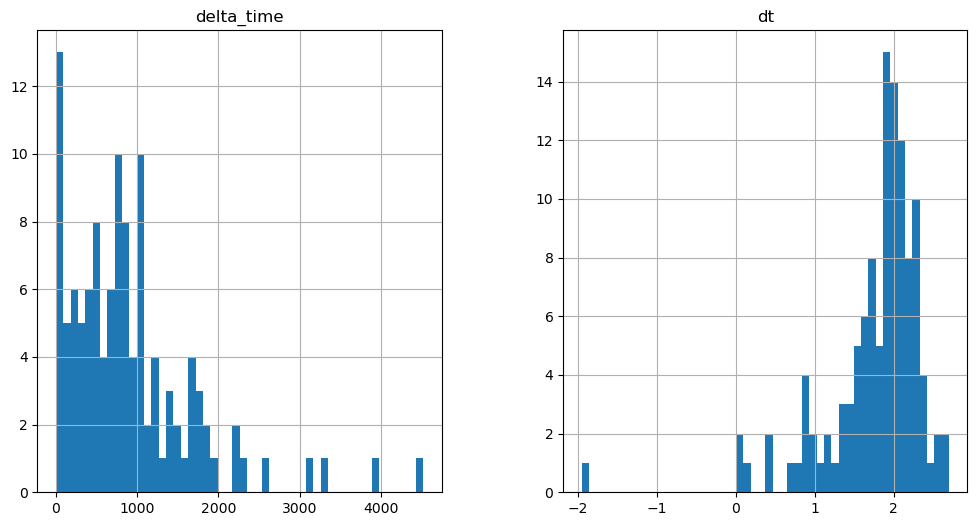

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4259.198321998119 0.1


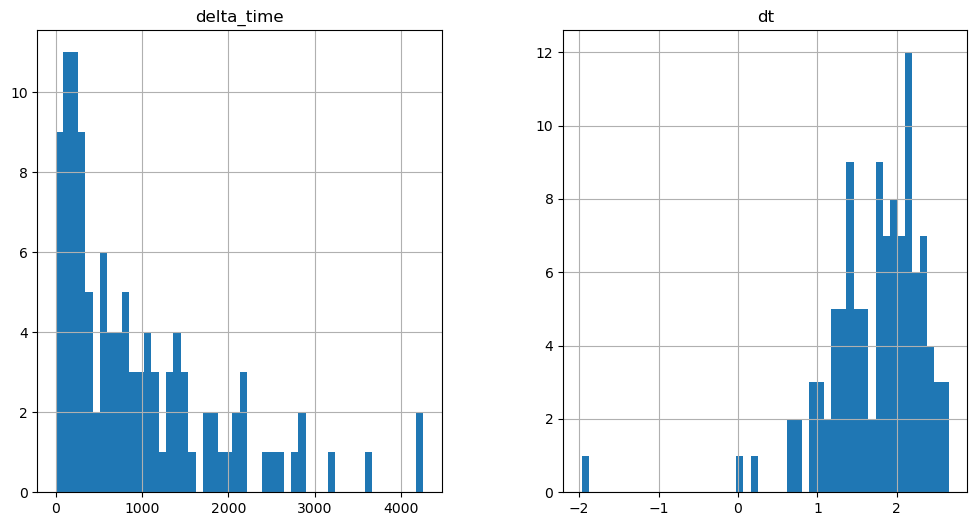

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5396.24123865366 3.141010046005249


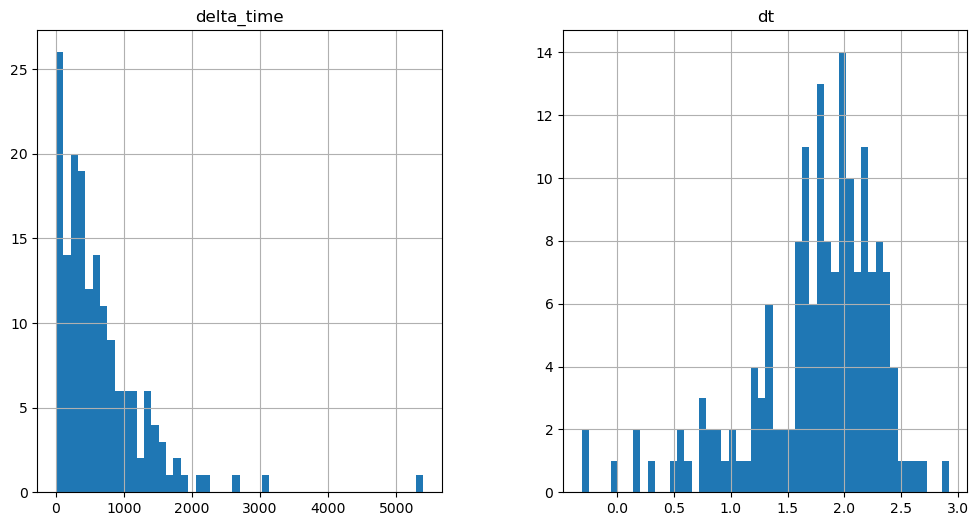

1422.8738907575607 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

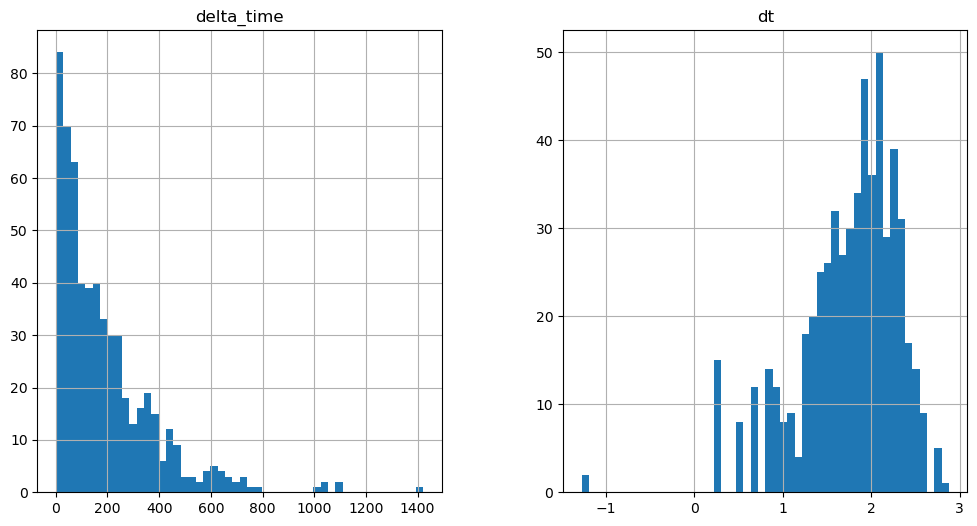

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

508.842585504055 0.1


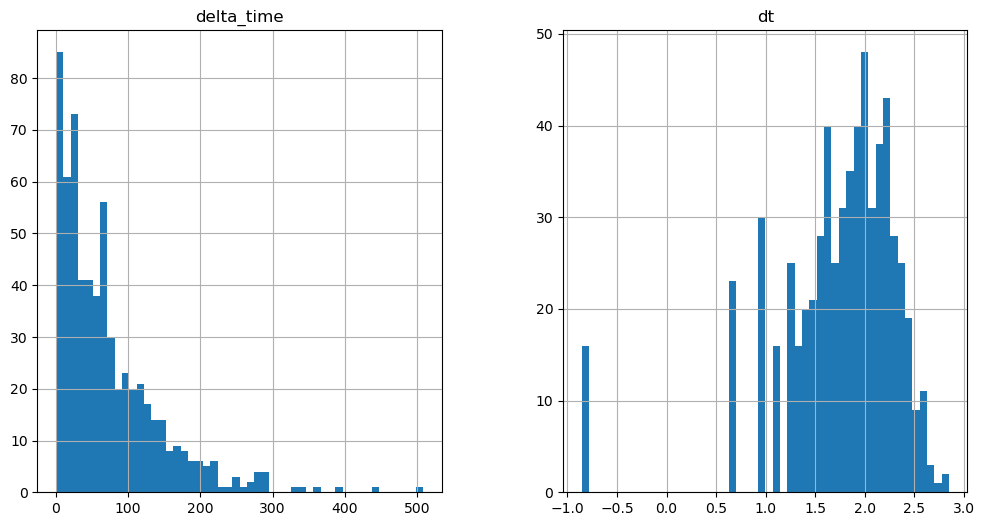

2061.2973930835724 12.96414053440094


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

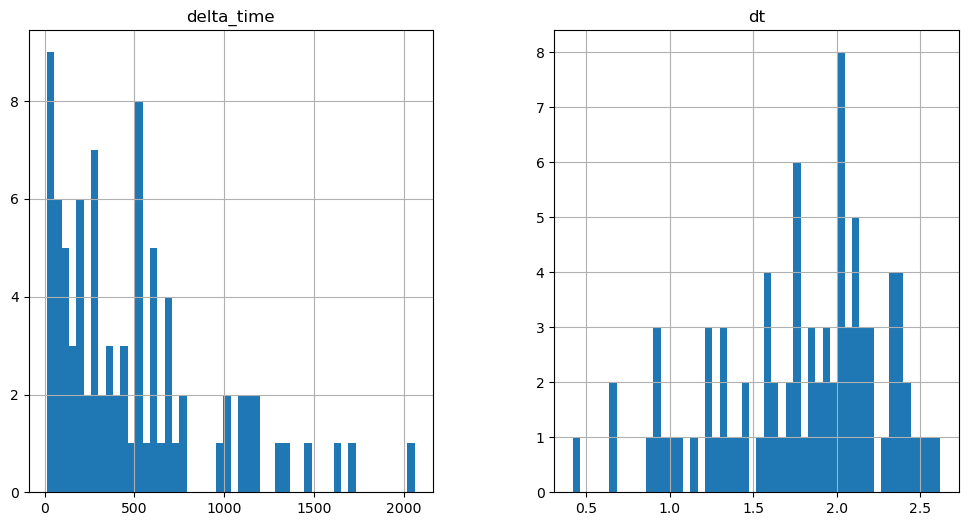

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2145.5653473734856 3.2410301566123962


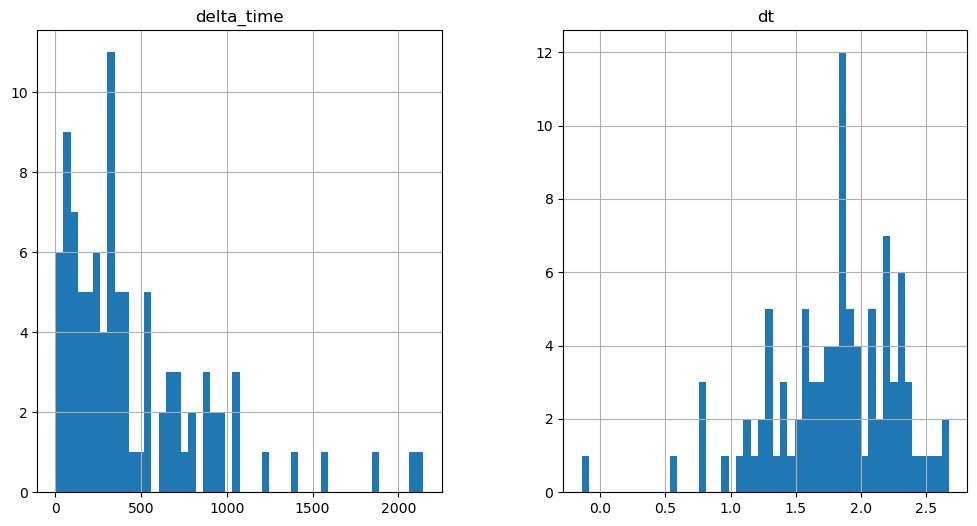

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3260.48238325119 45.37440222501755


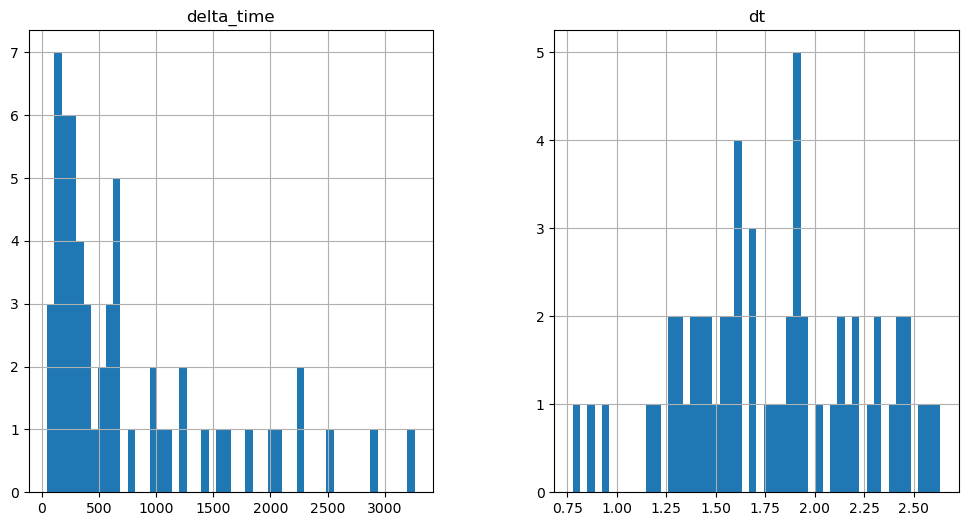

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

680.6175040602684 0.1


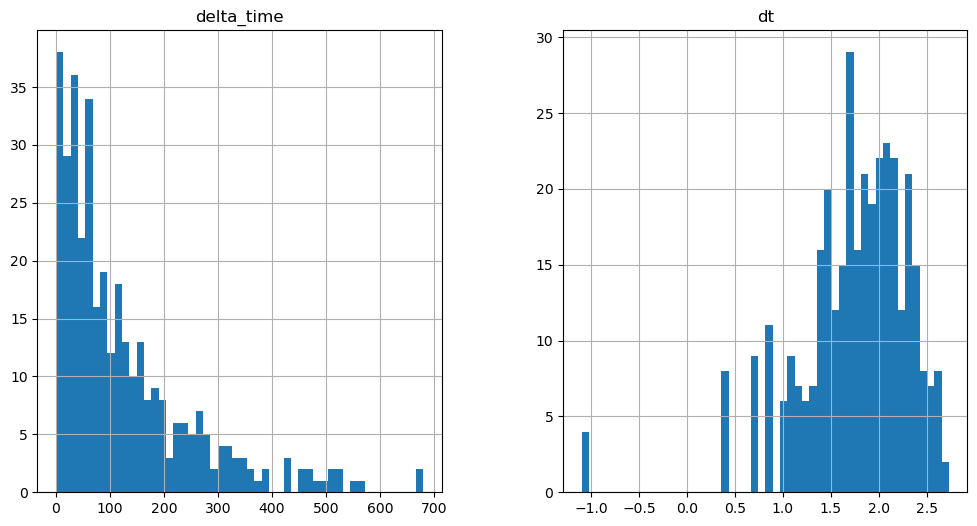

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

337.06753677129745 0.1


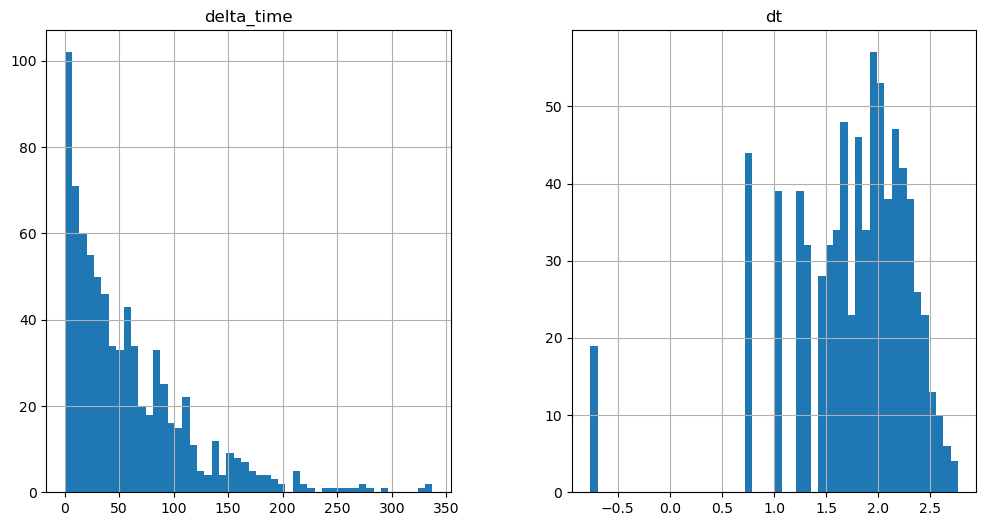

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3691.534594774246 16.20517086982727


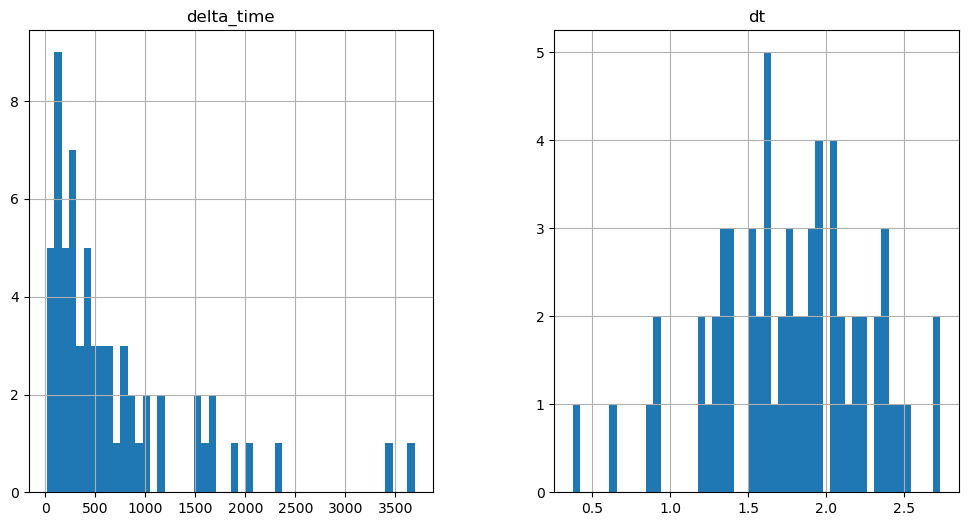

5846.830802559853 19.446161031723022


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

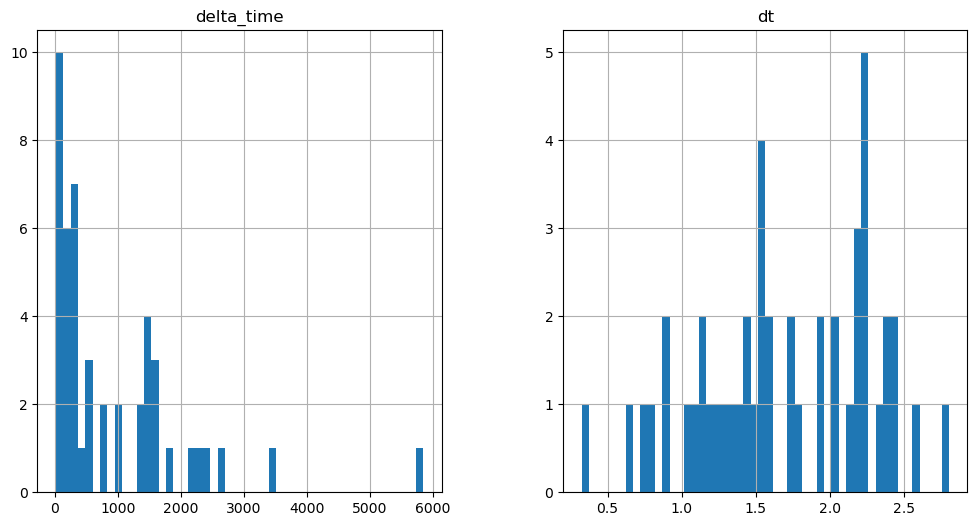

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1776.0883789658546 12.96412080526352


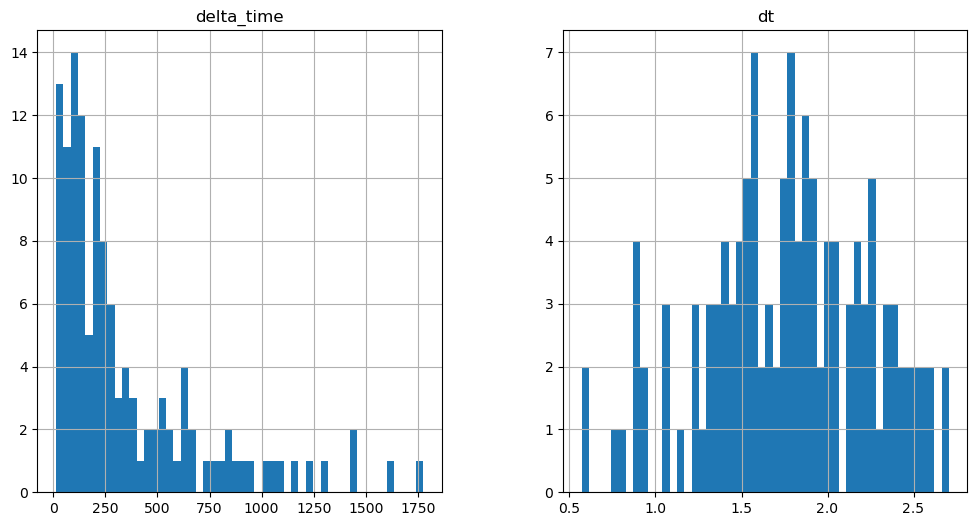

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1772.8425786495209 3.2410401105880737


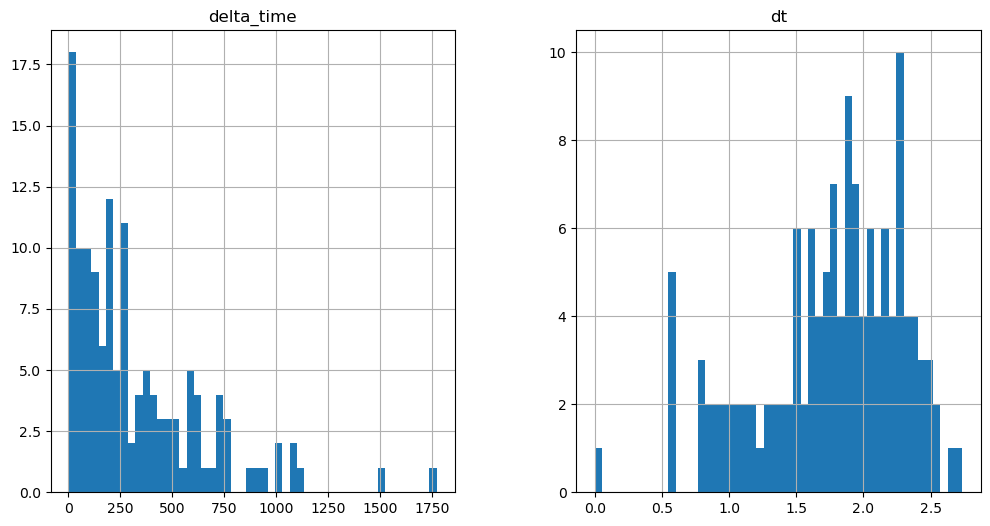

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2881.2775342464447 16.20513093471527


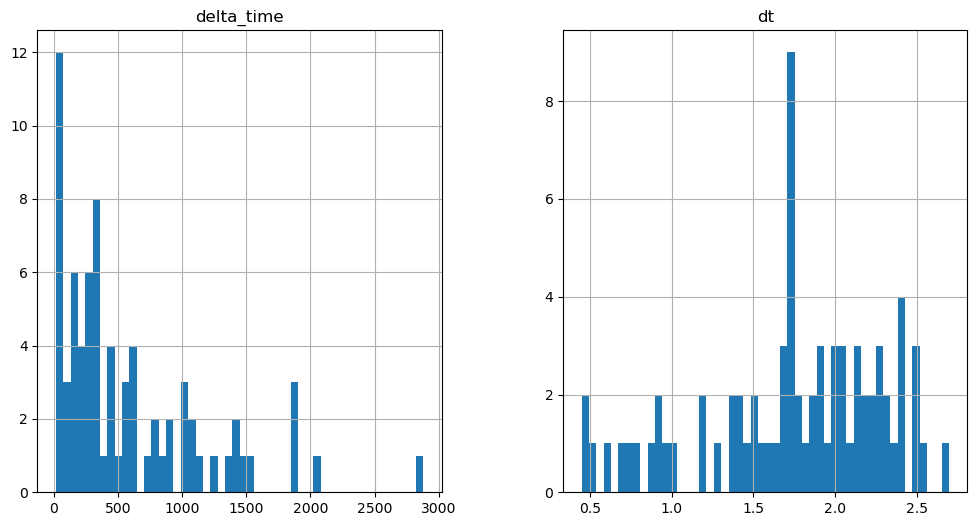

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2706.2608454227448 0.1


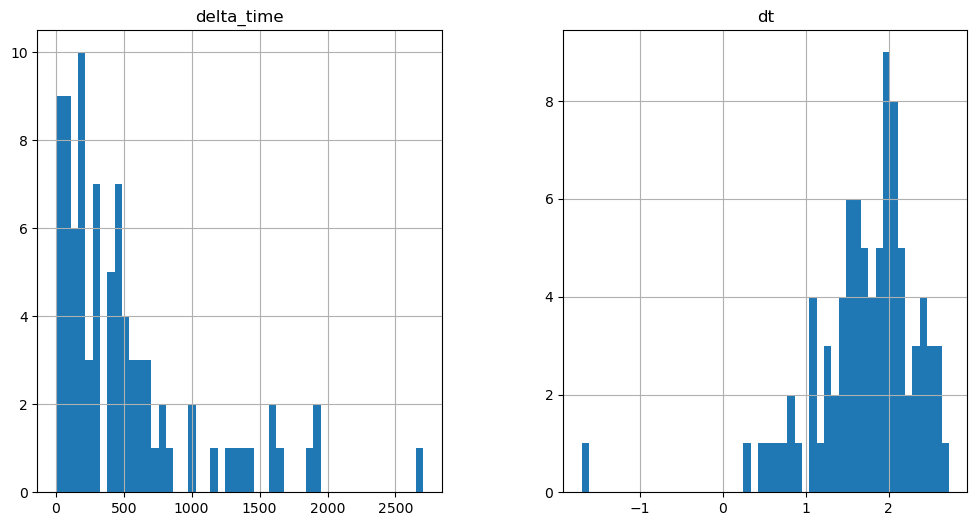

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

479.6733940243721 0.1


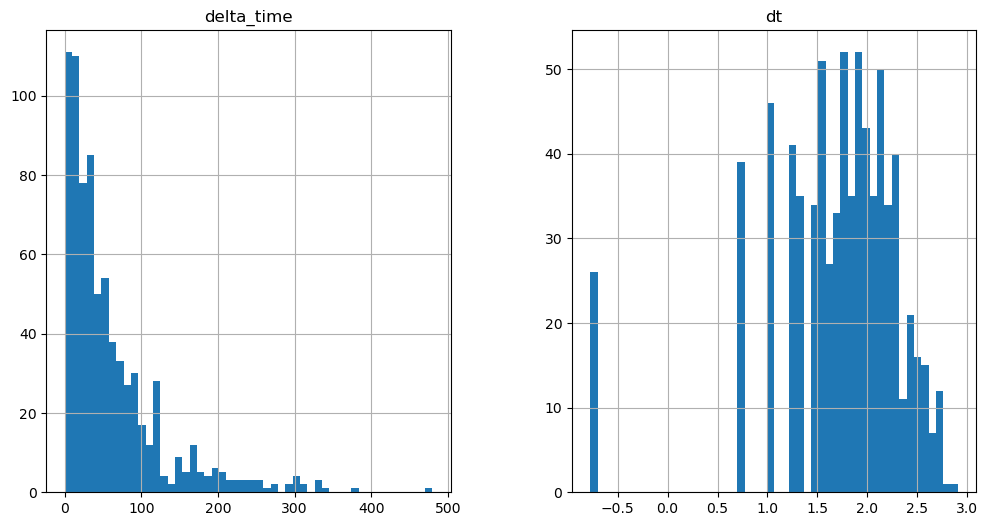

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2200.6655593514442 0.1


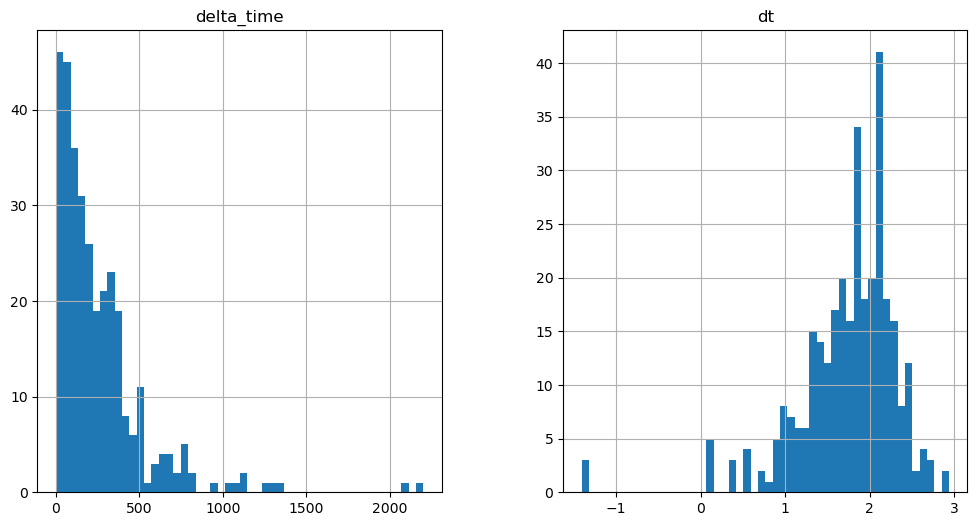

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

8005.366747975349 9.723110496997833


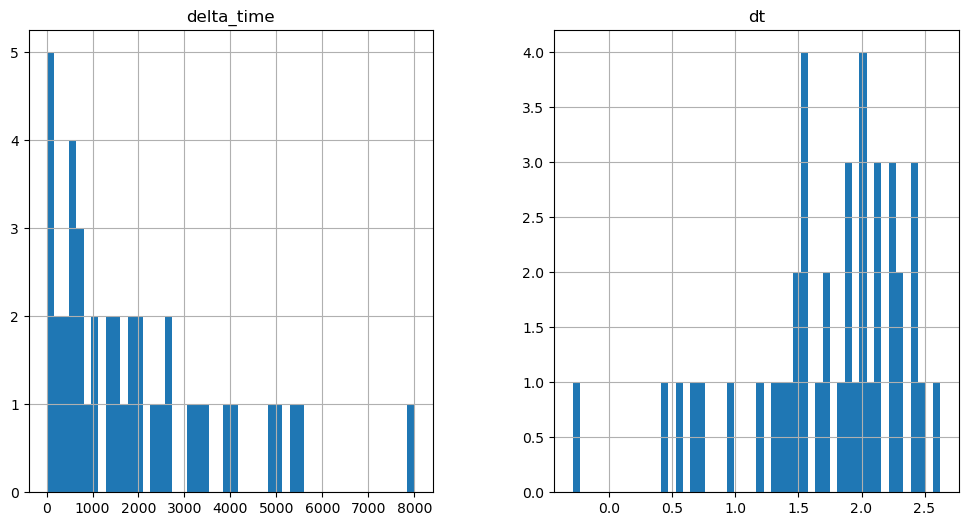

13758.21130400896 38.89247179031372


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

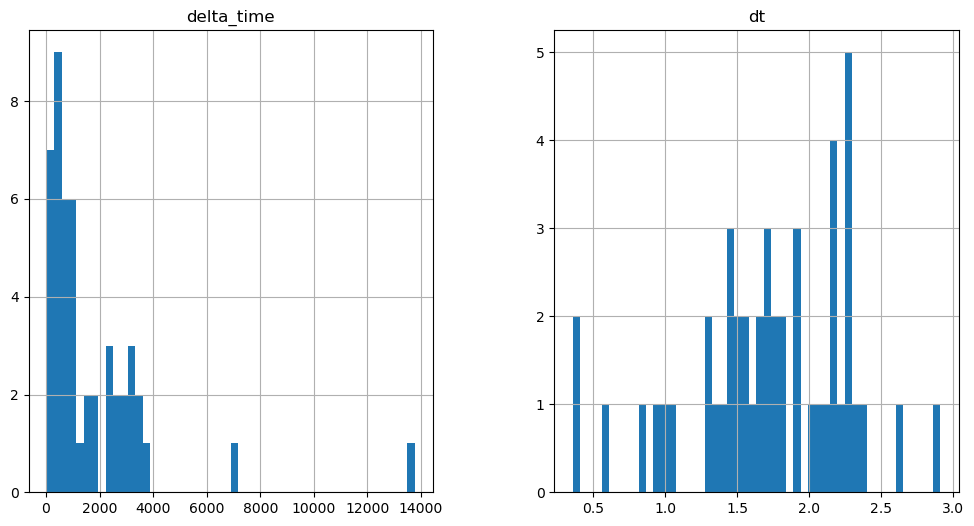

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

175.01610869169235 0.1


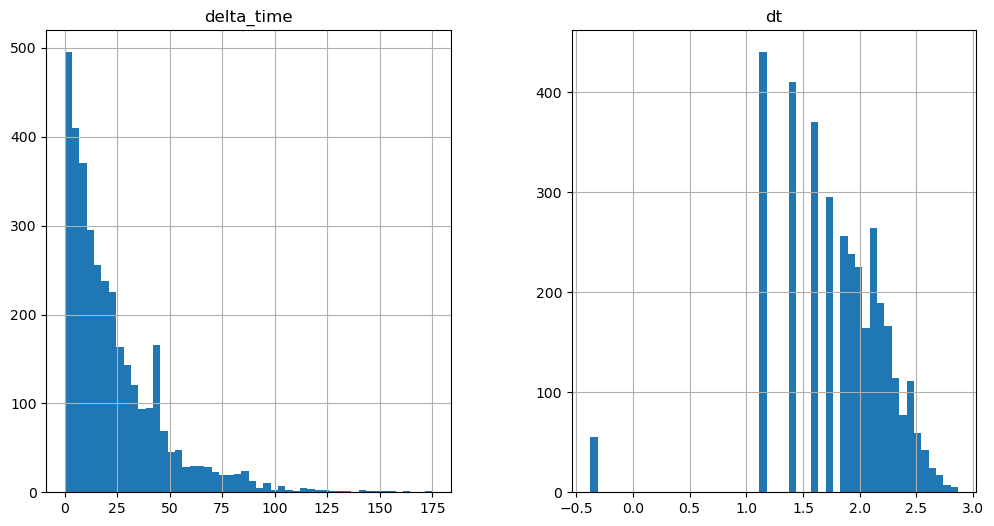

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3292.894873738289 12.964160680770874


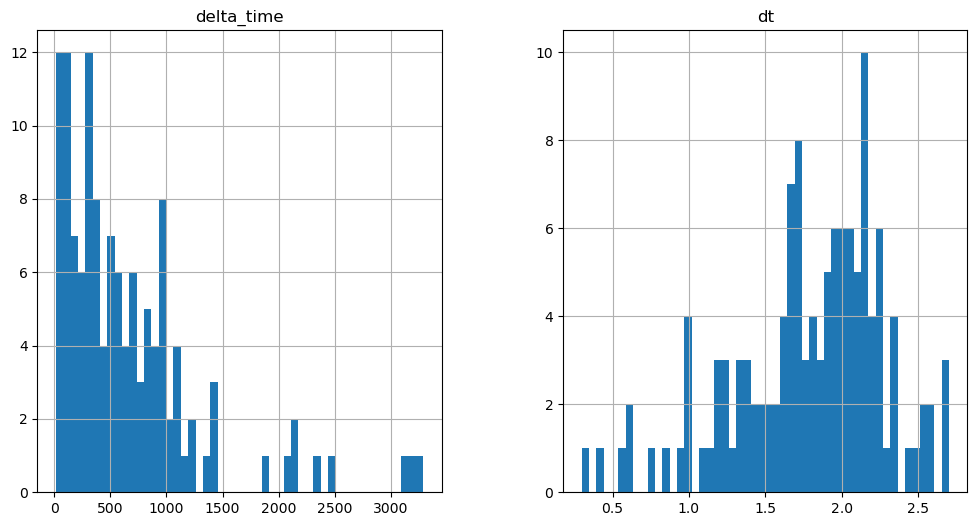

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1056.578712463379 0.1


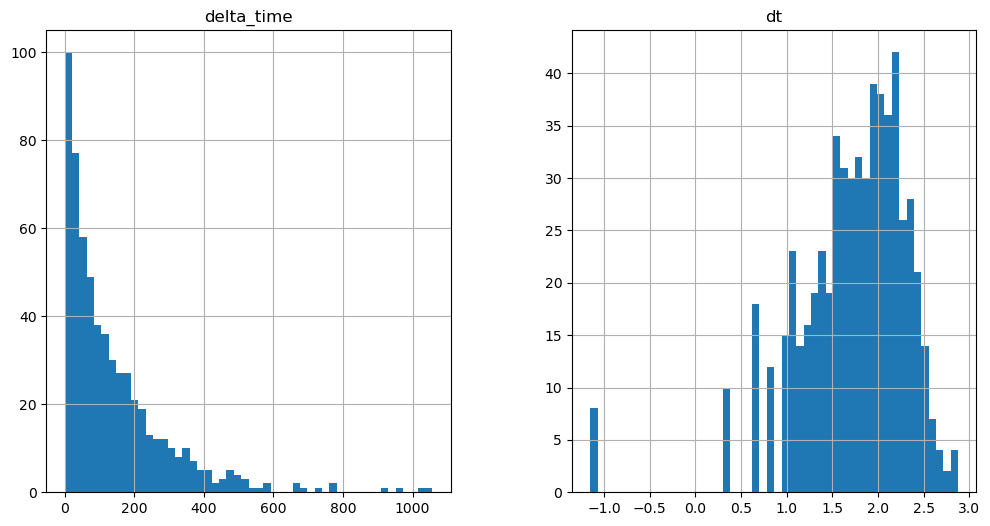

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2155.290717124939 9.723120510578156


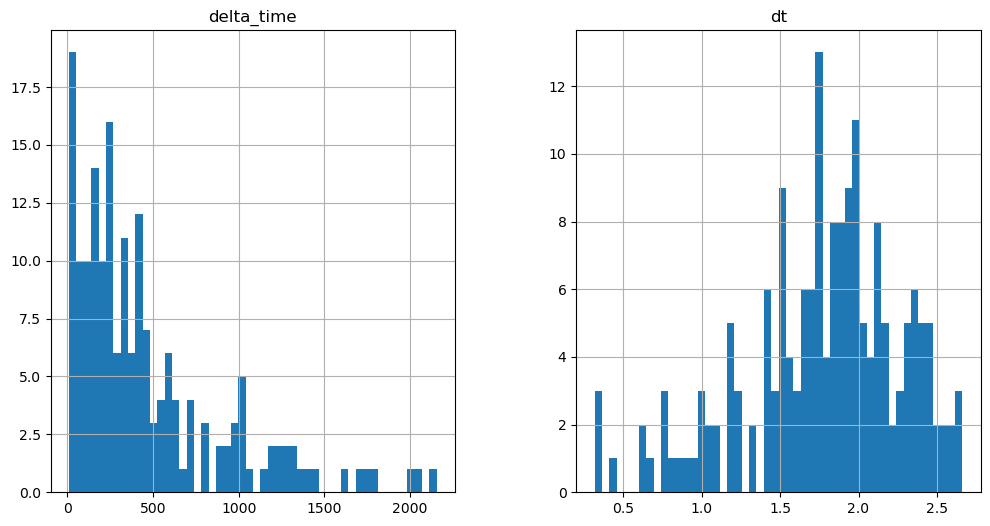

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

8747.56472492218 6.482080399990082


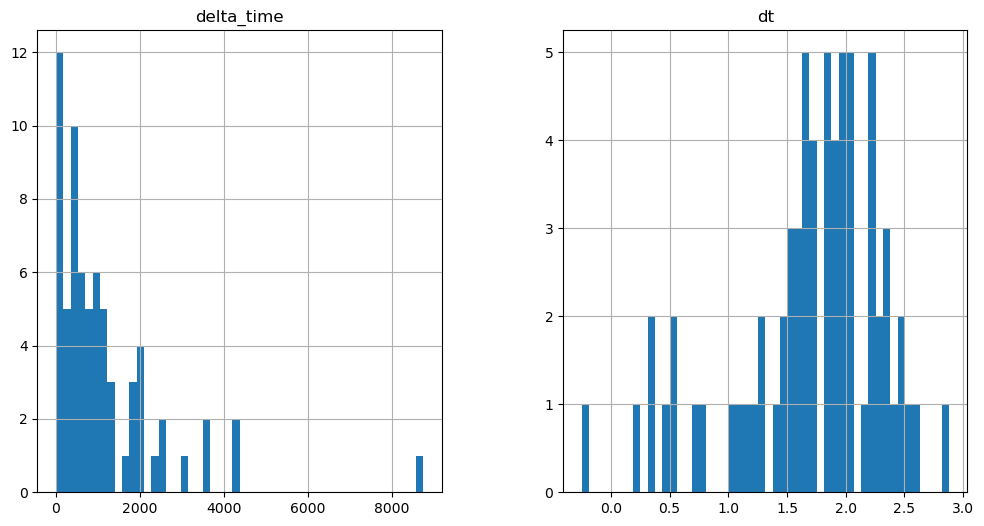

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1212.1486503481865 0.1


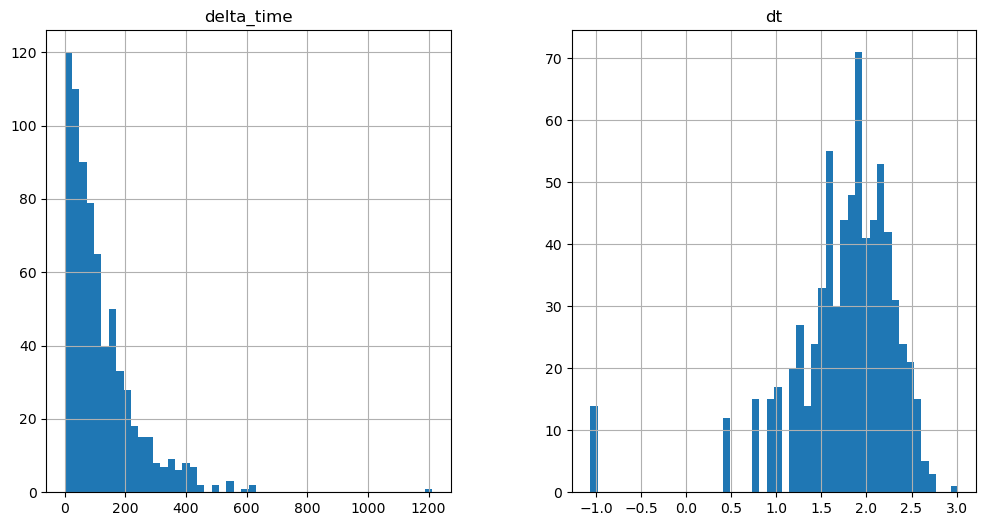

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2356.235427200794 3.2410402297973633


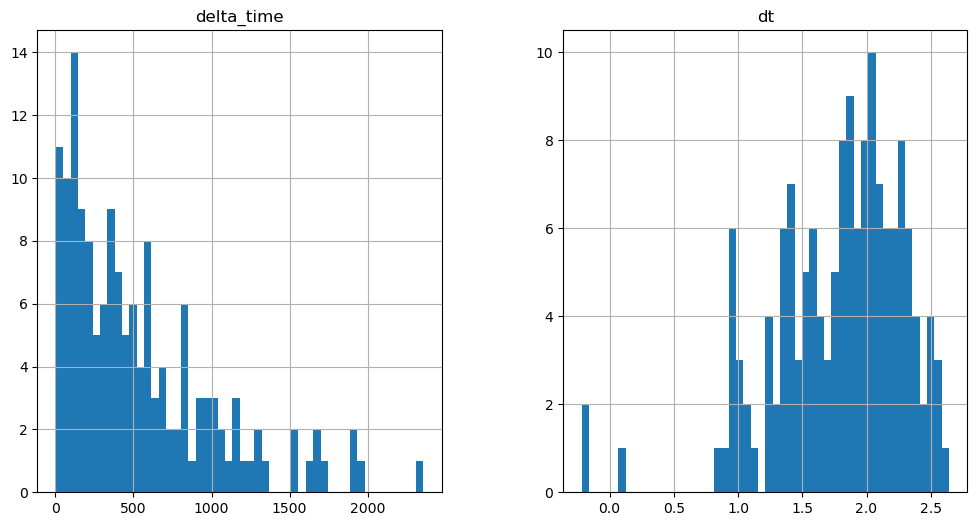

1562.1808178424835 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

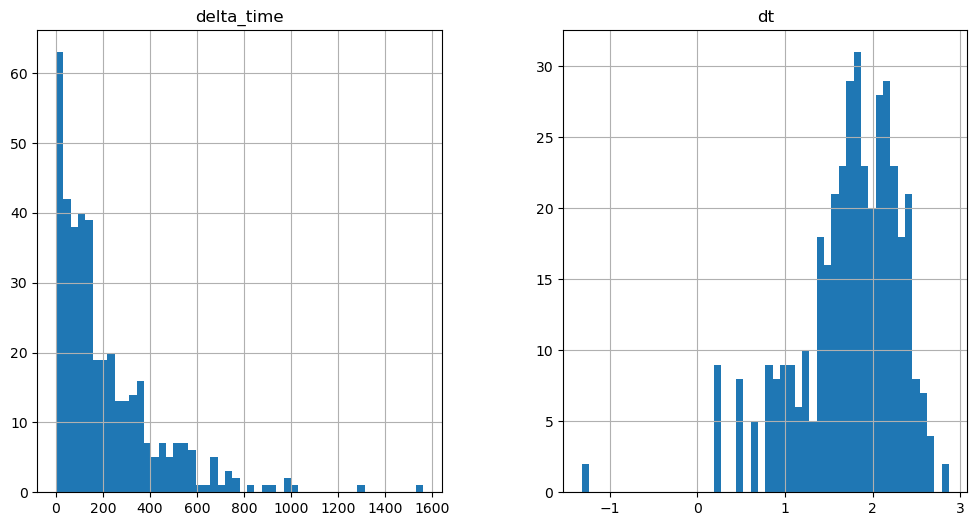

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1678.8582534193993 3.2410401105880737


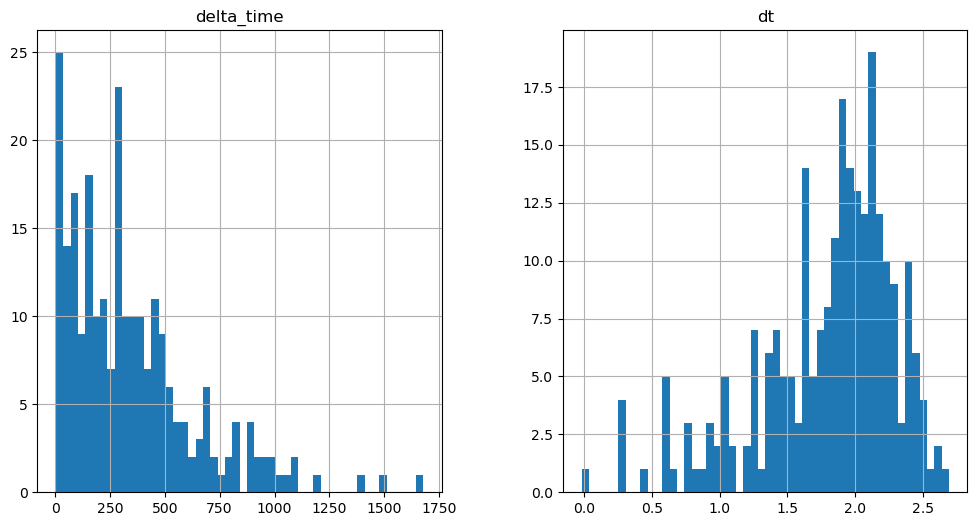

819.9828907251358 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

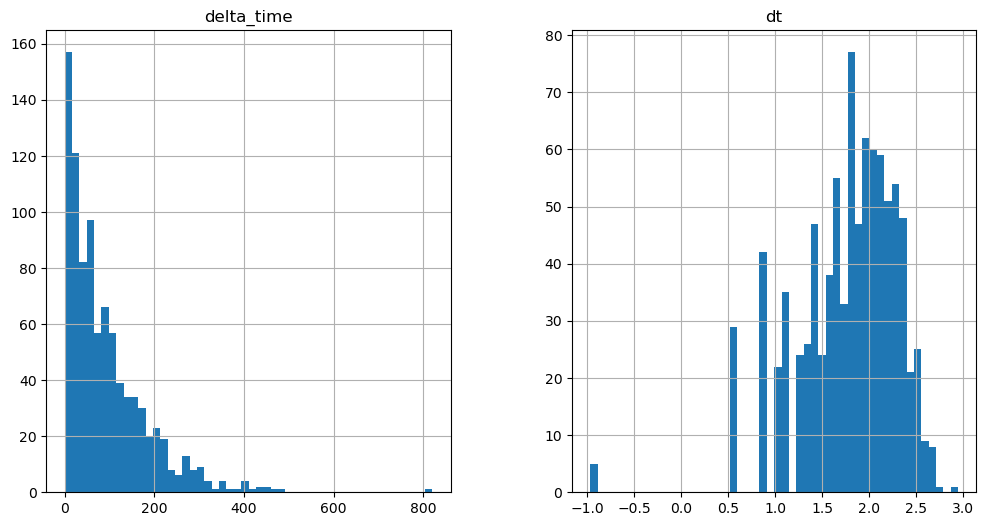

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2861.837552368641 0.1


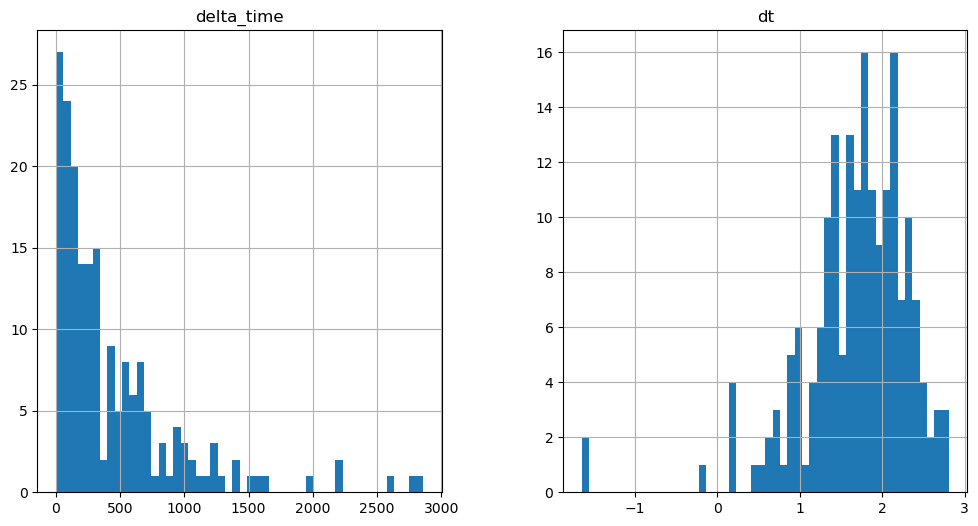

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

10034.25639897585 51.85662251710892


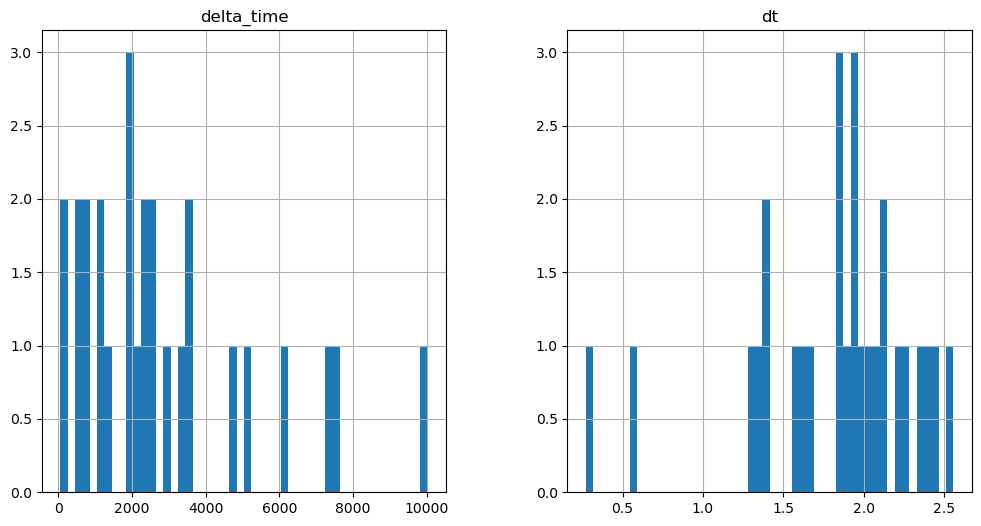

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4718.9525646567345 16.205190777778625


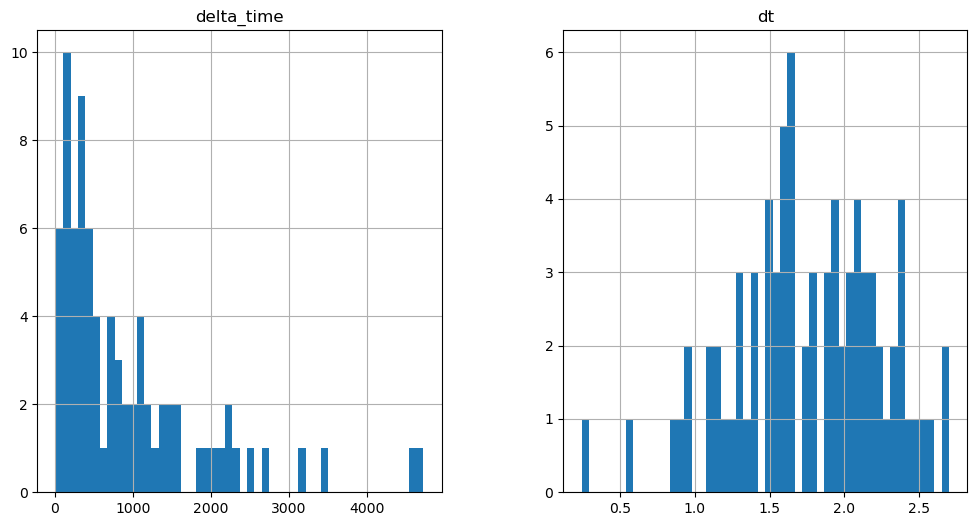

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3957.3088167905807 9.723120391368866


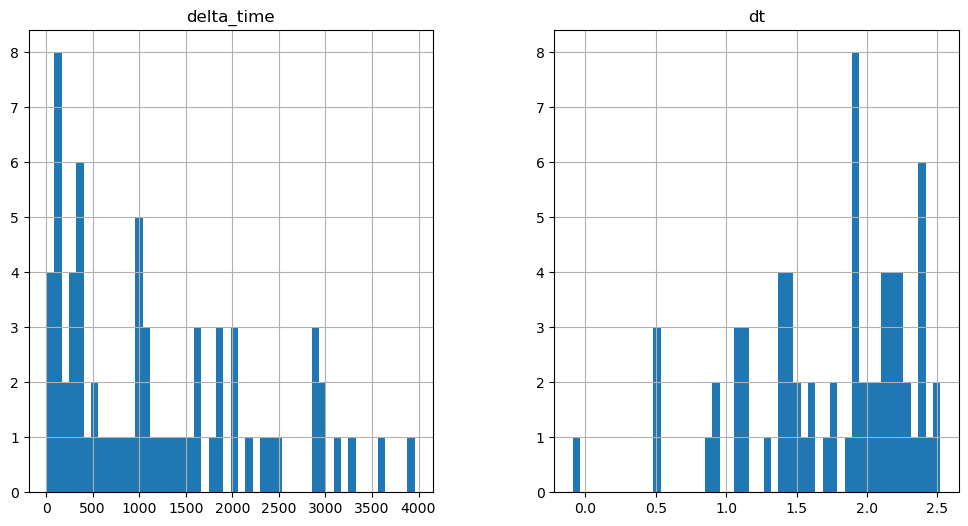

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2826.1859104037285 6.482080399990082


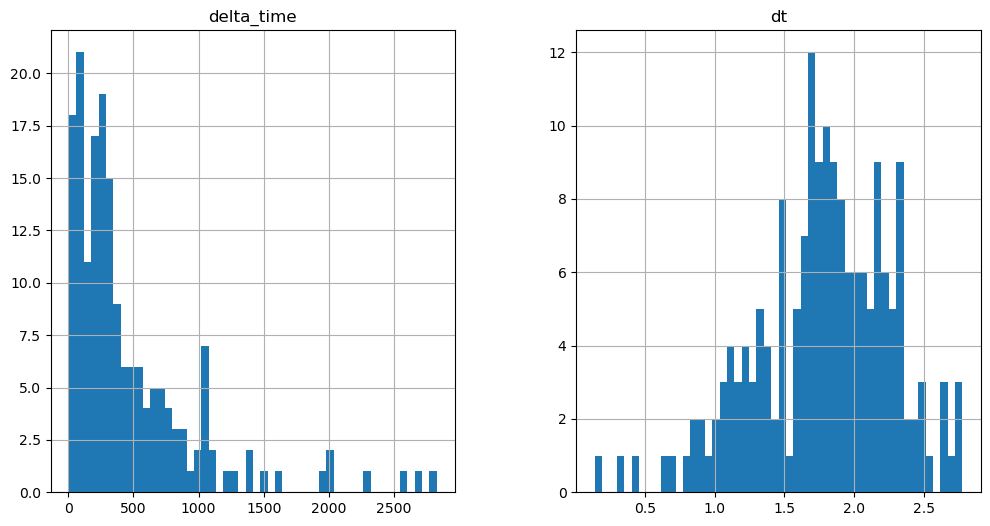

1163.533067703247 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

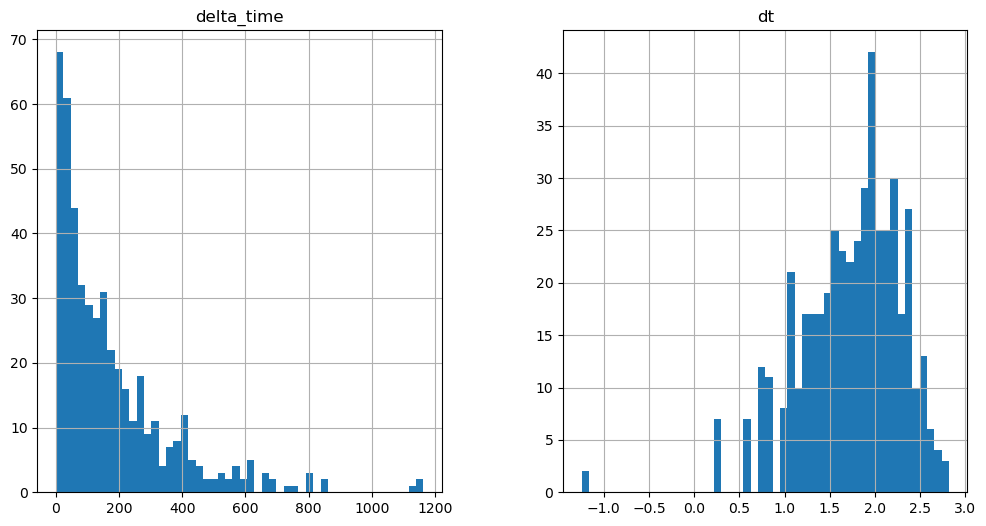

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1095.4712144732475 0.1


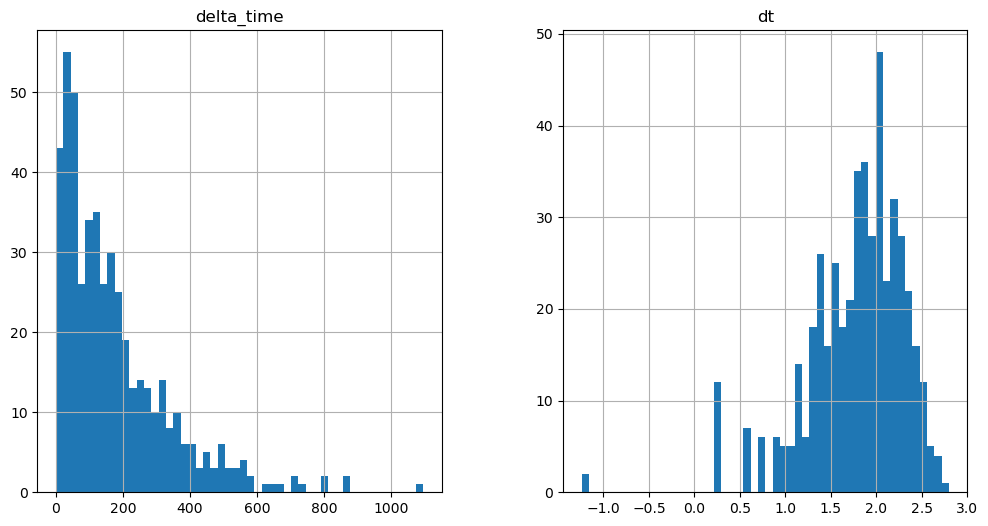

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1458.4675825834274 0.1


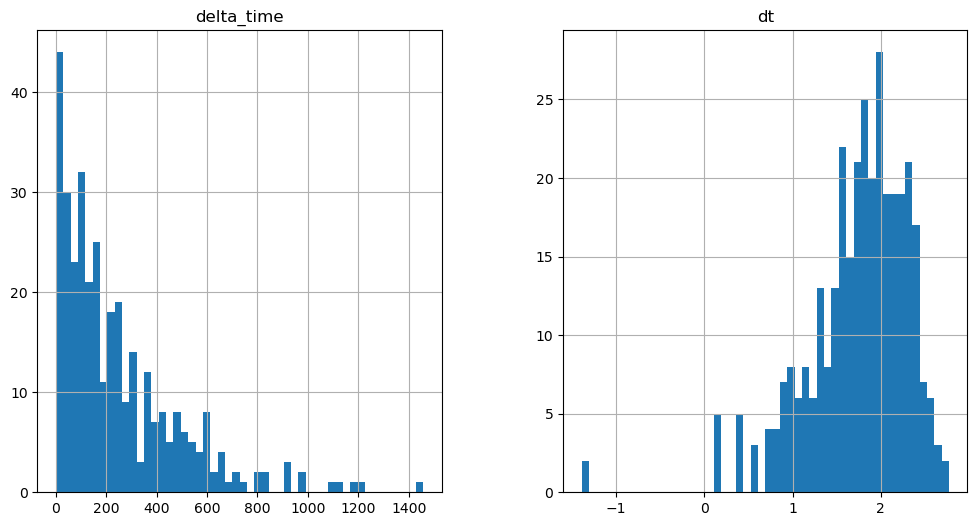

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1348.272277355194 0.1


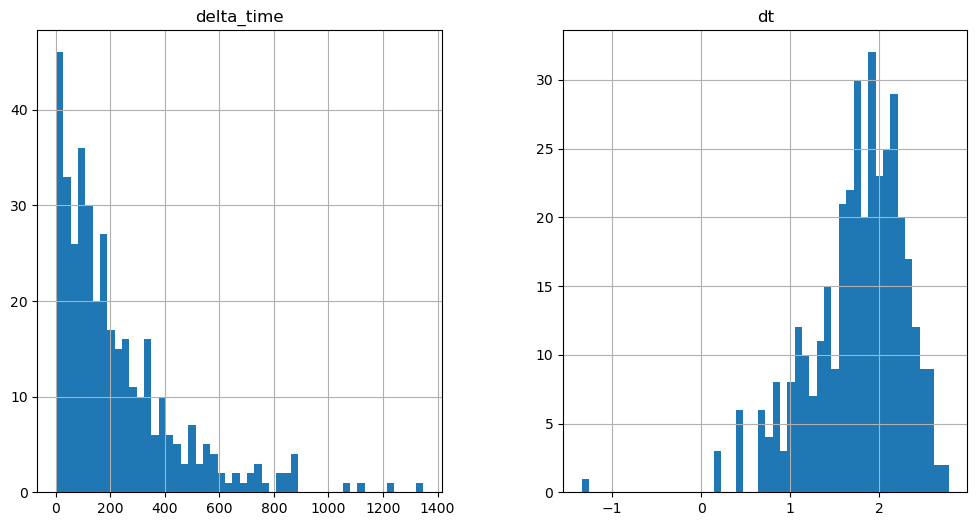

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3247.5212114453316 0.1


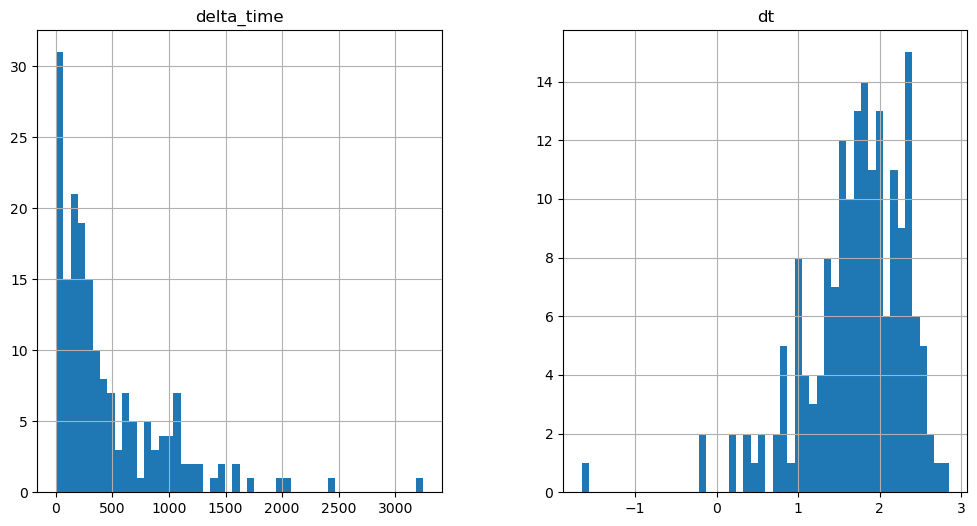

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3364.198377251625 6.482080161571503


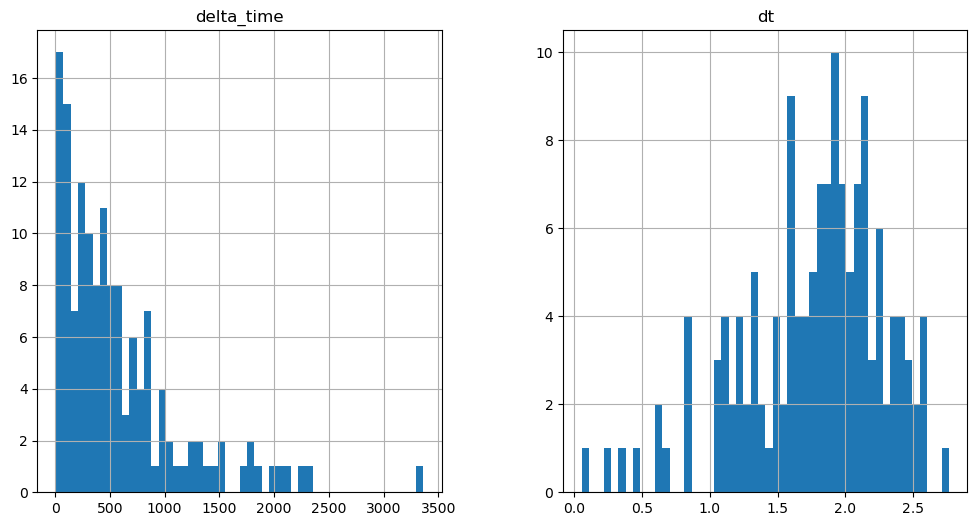

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1639.9656915664673 3.241040050983429


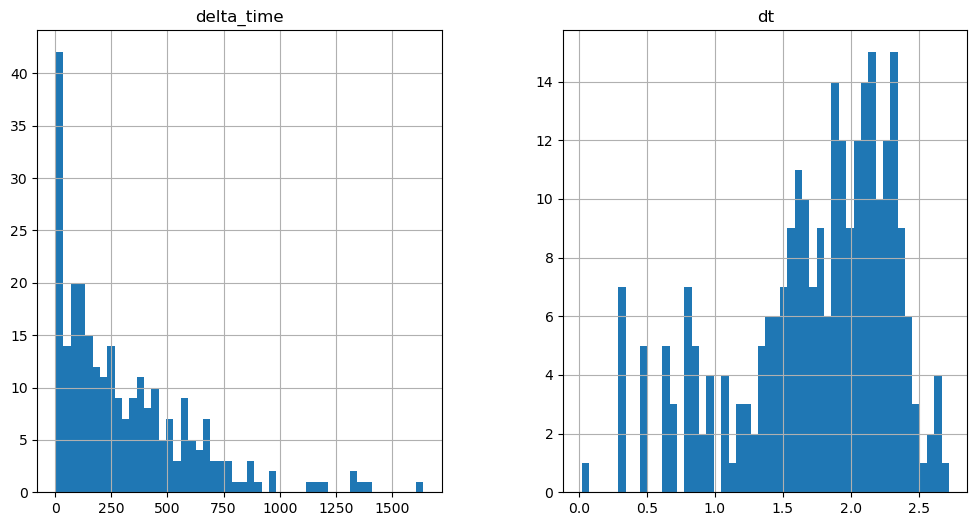

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4051.2988315224648 0.1


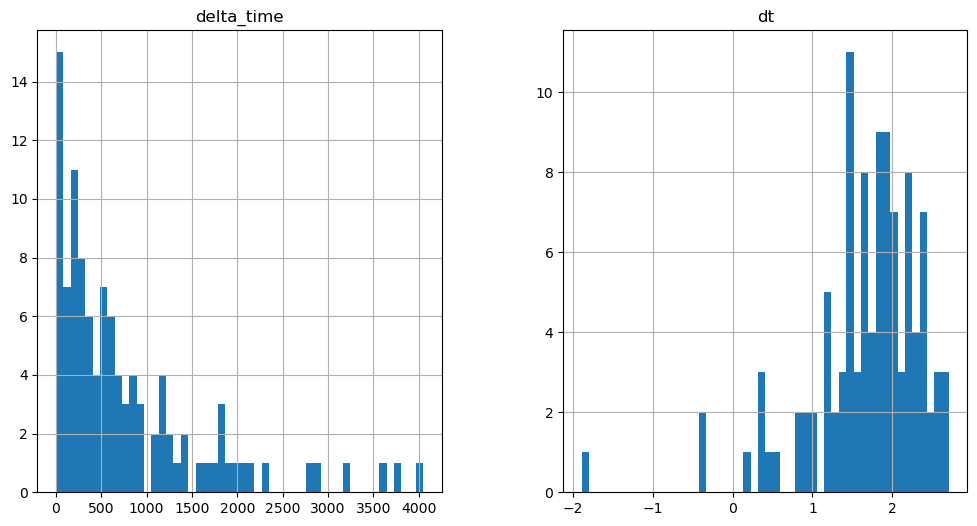

5500.043483436108 3.241030216217041


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

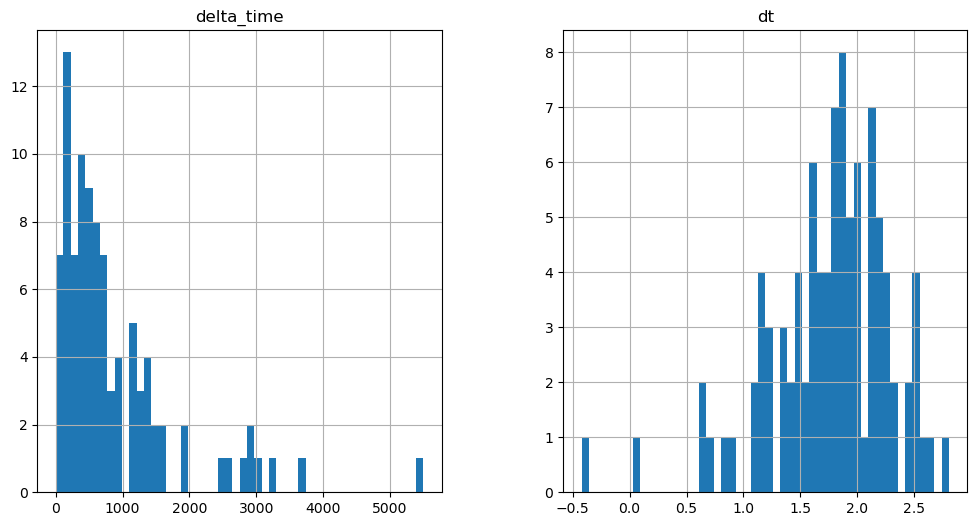

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))


340.30663698911667 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["E"] = np.log10(df_id["energy"])


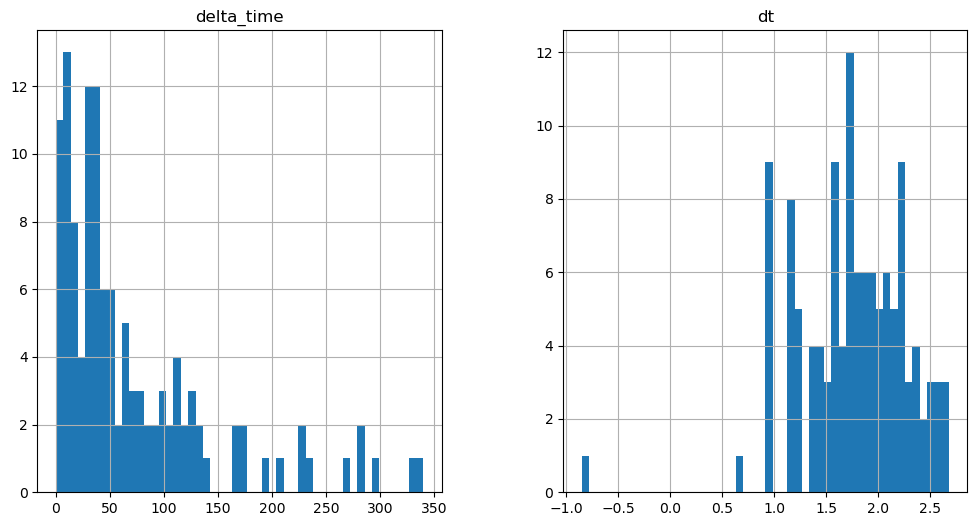

784.3288292884827 6.482070207595825


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

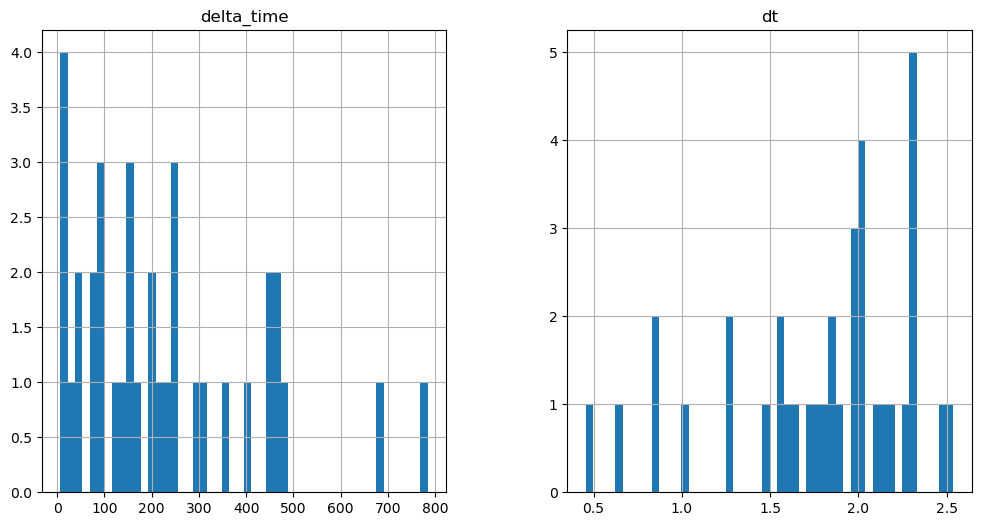

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

359.75407803058624 0.1


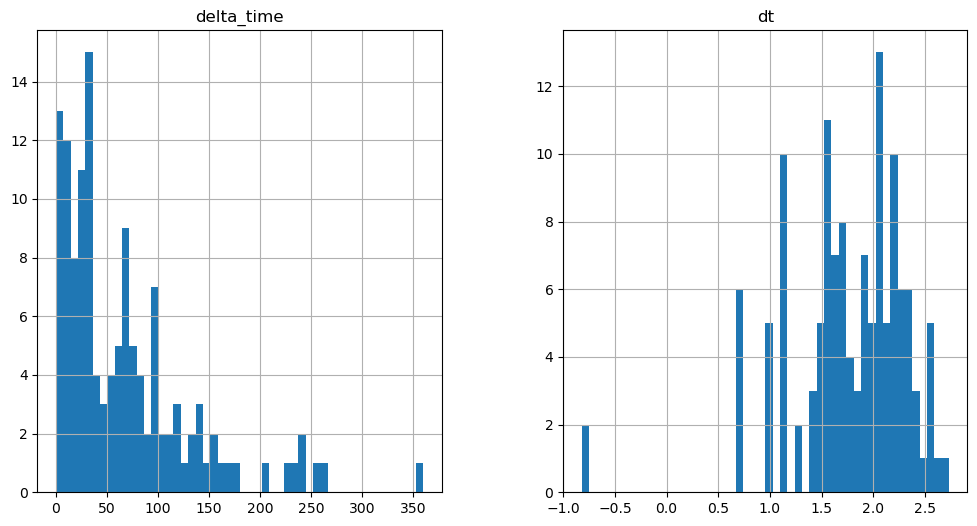

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

541.252787053585 0.1


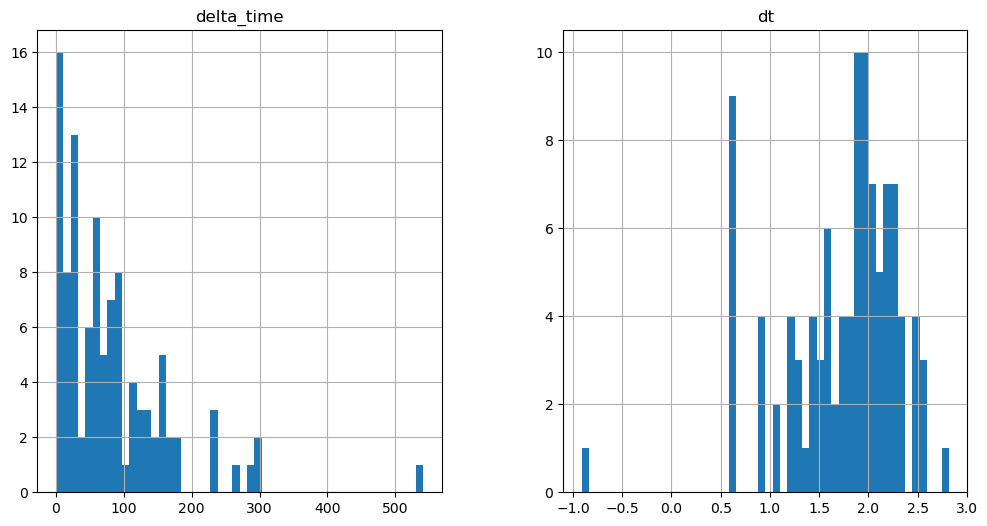

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

204.1851002573967 0.1


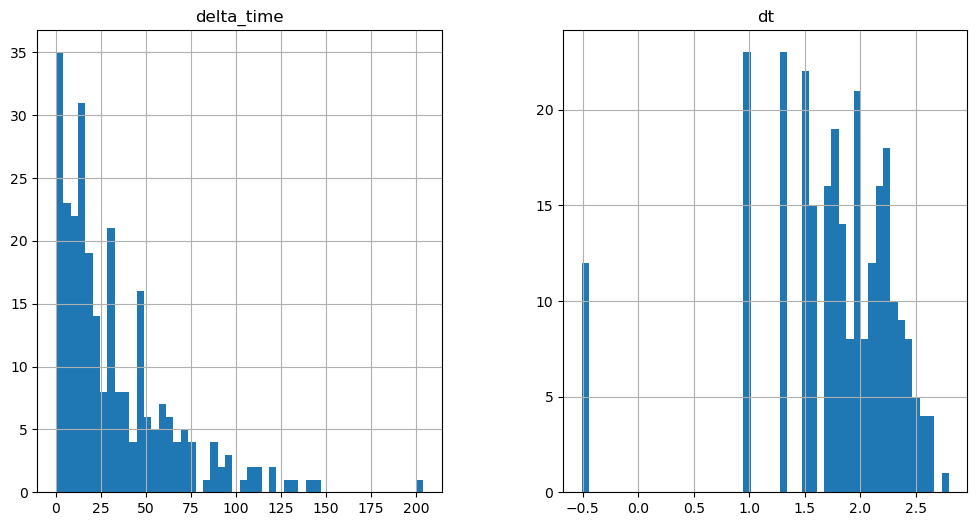

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

900.998234808445 3.241010010242462


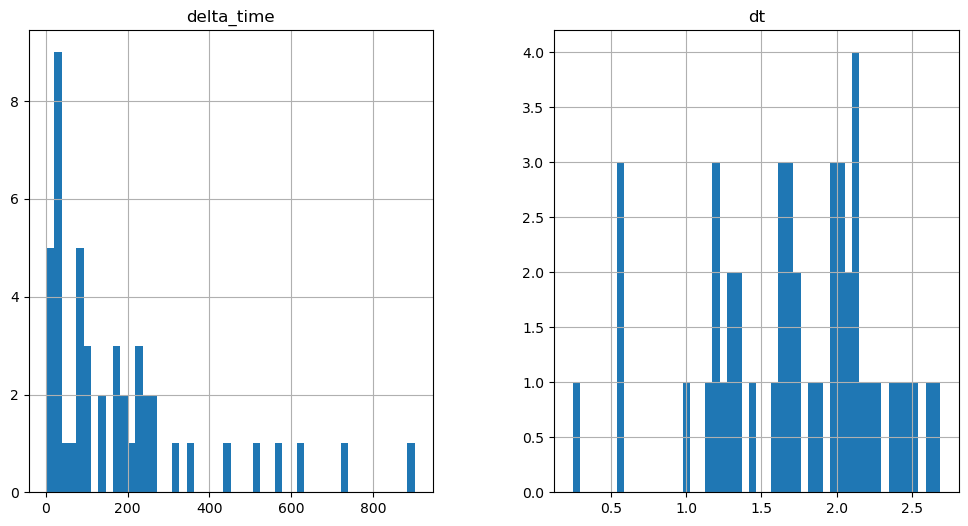

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1153.795887351036 6.4819804430007935


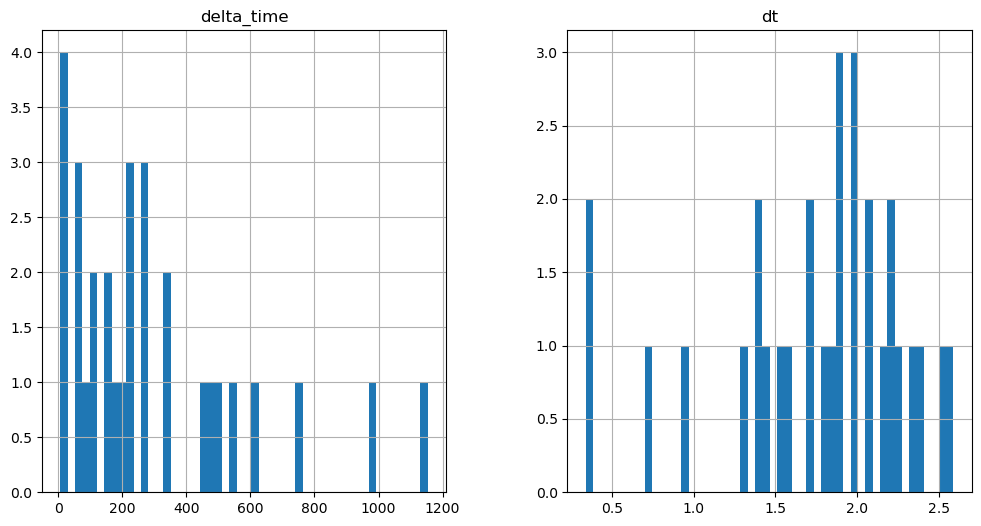

1413.086070716381 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

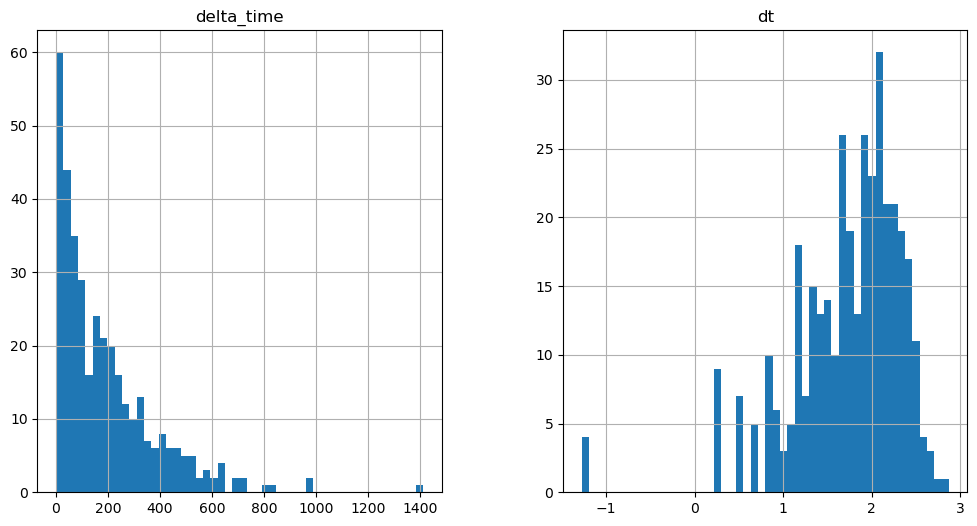

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3127.598016679287 0.1


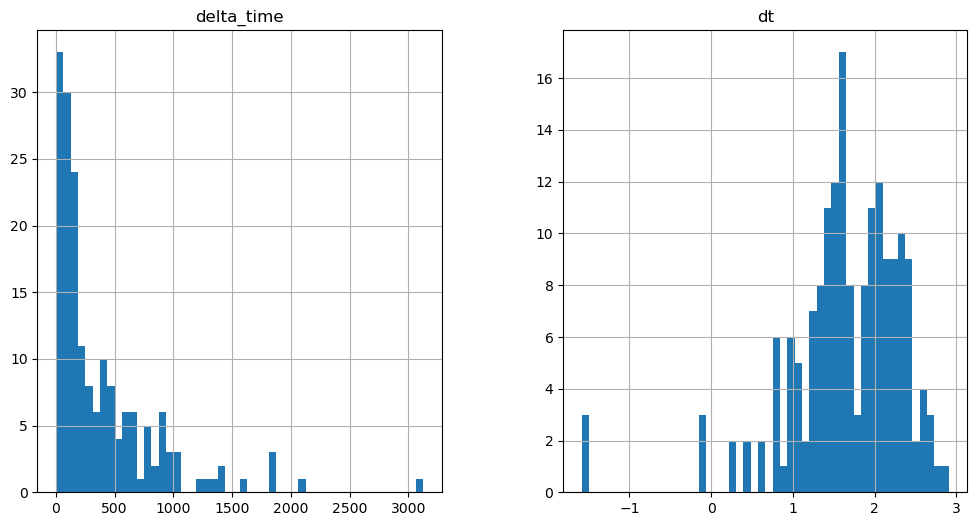

11638.558582782745 81.02579414844513


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

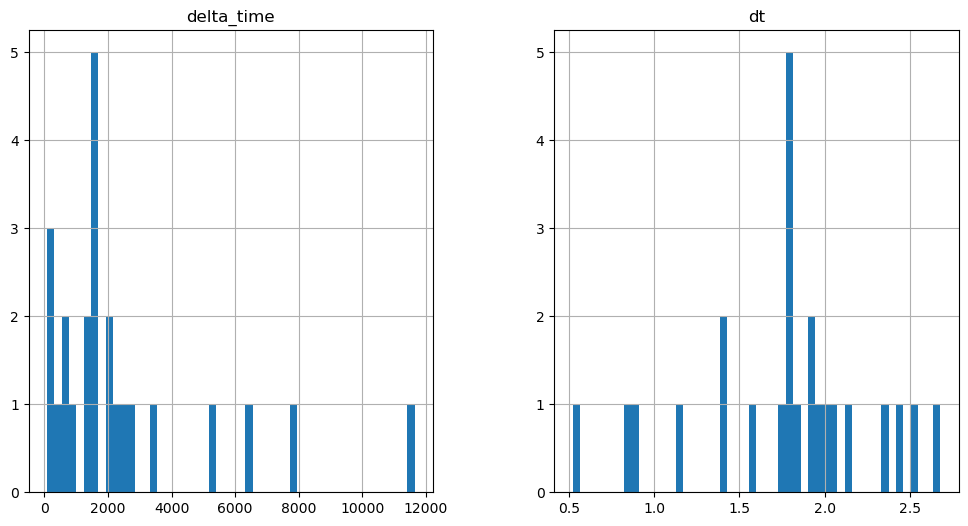

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2061.2991032004356 0.1


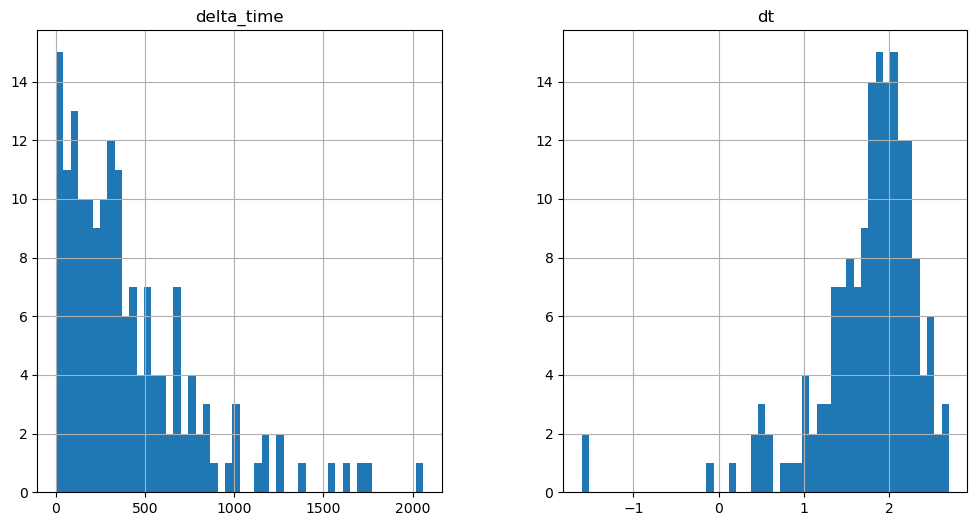

7820.58021146059 3.2410202026367188


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

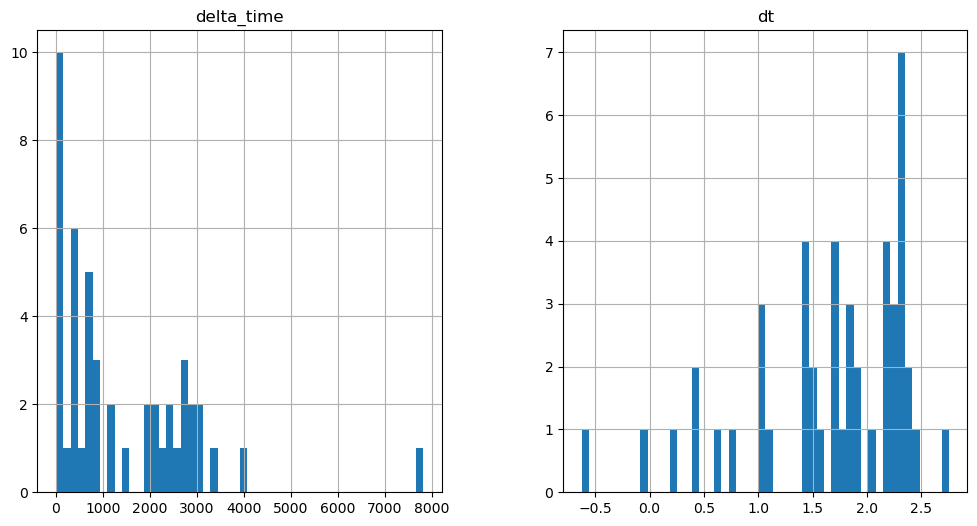

3830.8942818045616 3.2410300374031067


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

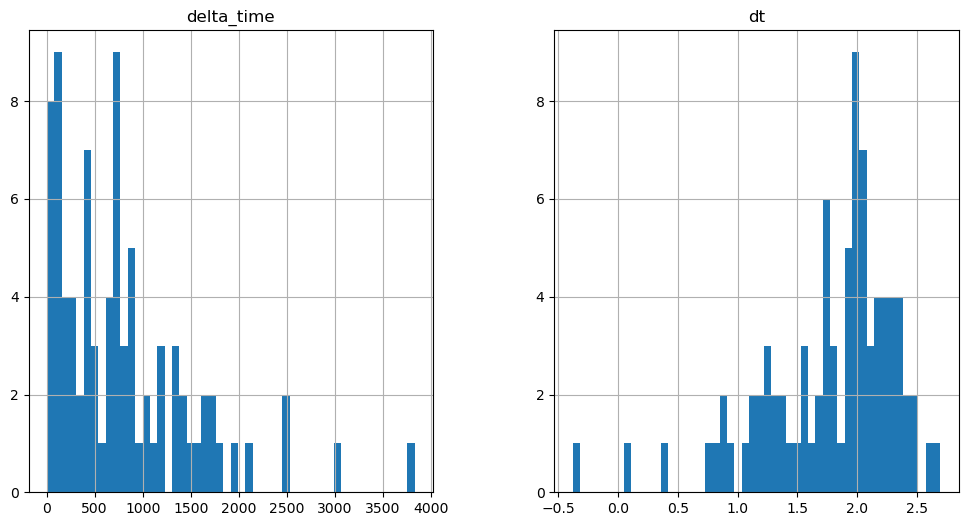

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5859.746323287487 6.482050180435181


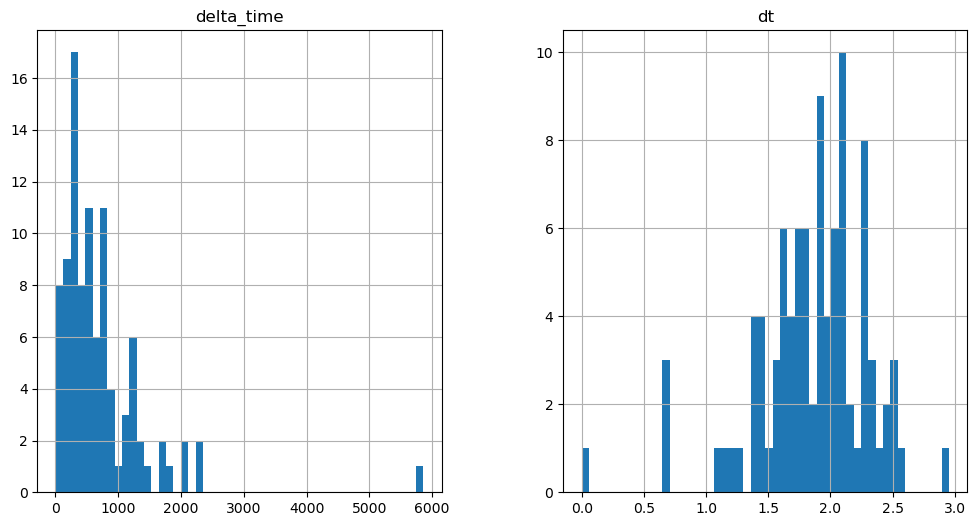

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1594.5830898880959 0.1


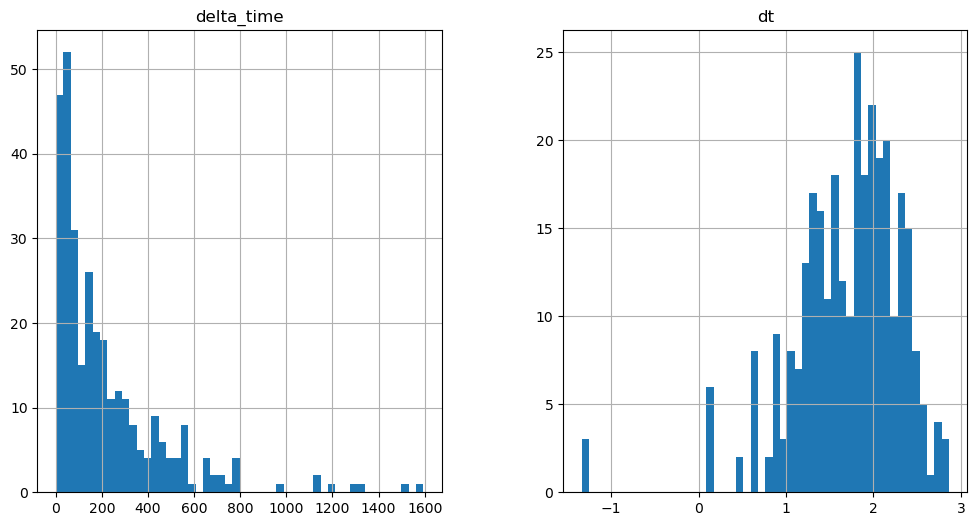

1789.0517994761467 3.241030216217041


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

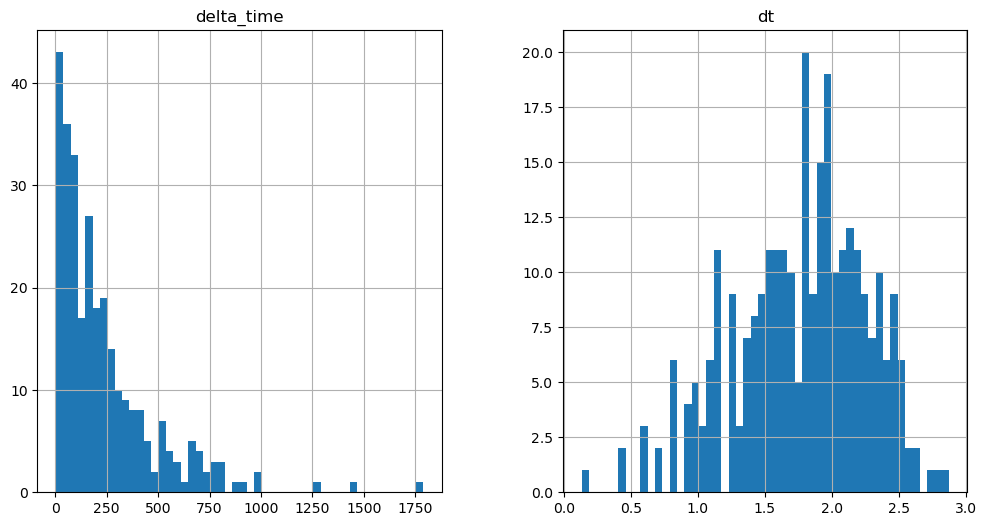

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3325.274846494198 0.1


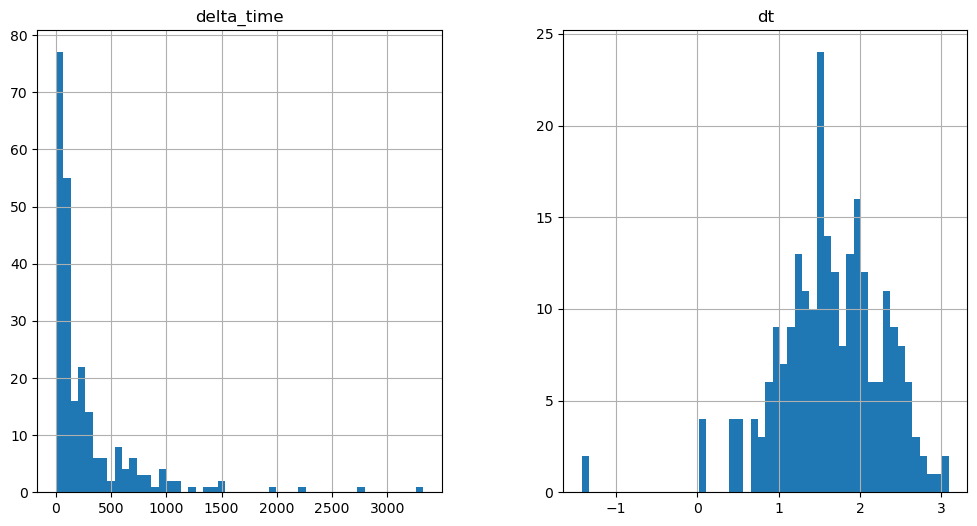

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1131.1214064955711 0.1


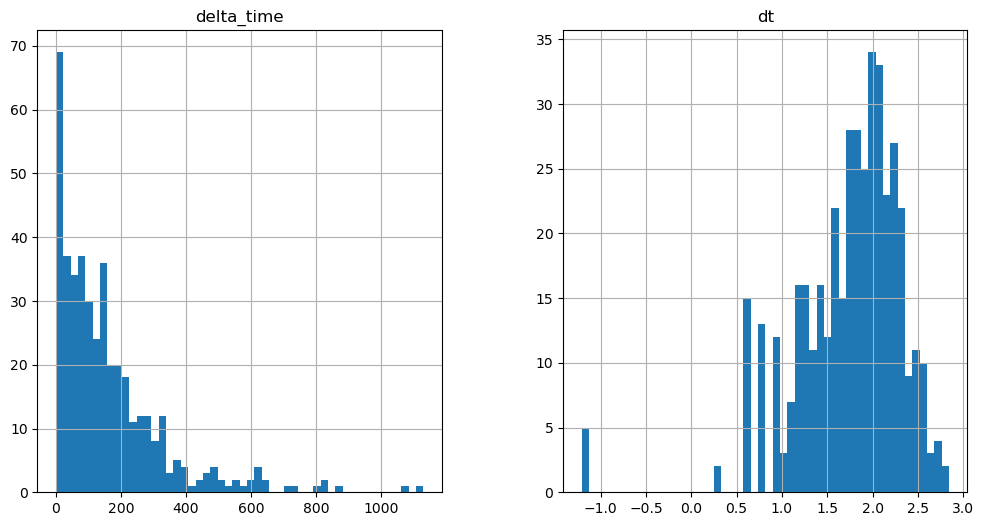

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1322.3425161838531 0.1


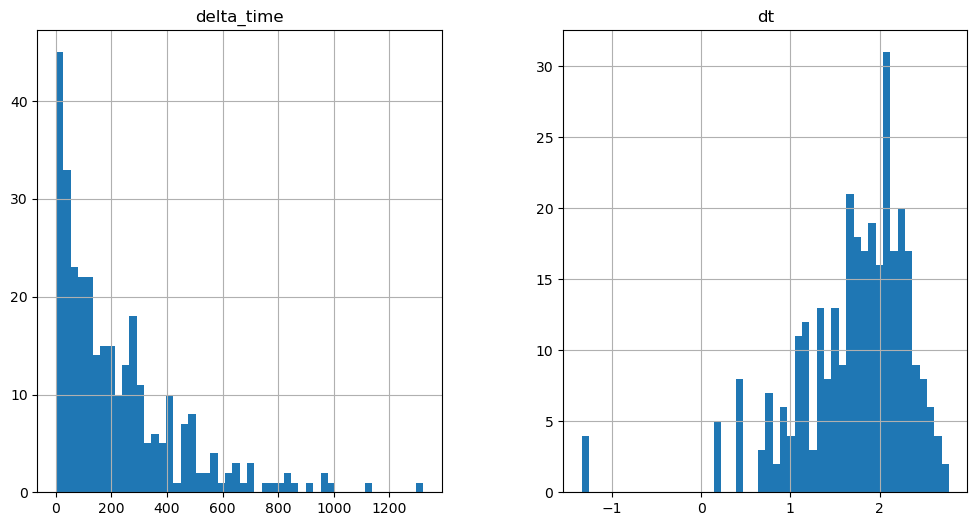

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

8102.591115415096 0.1


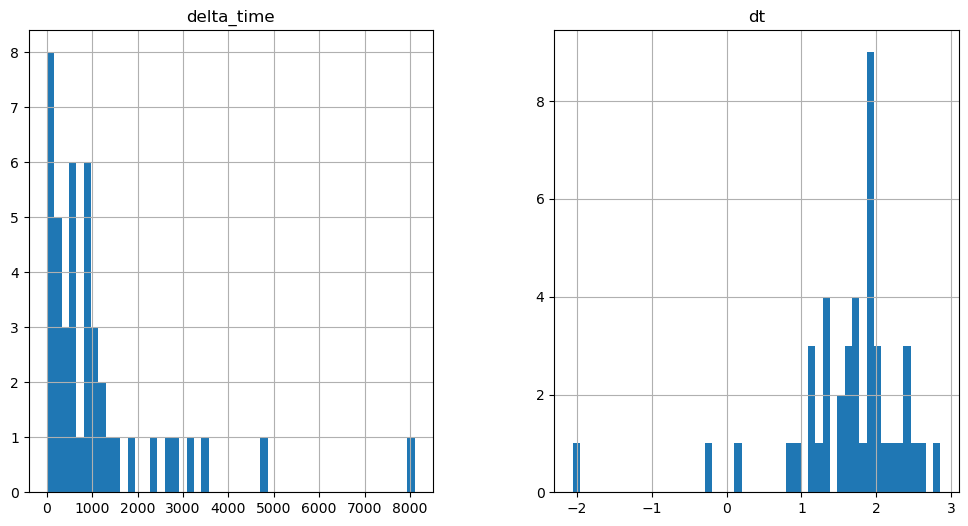

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

758.4031180739403 0.1


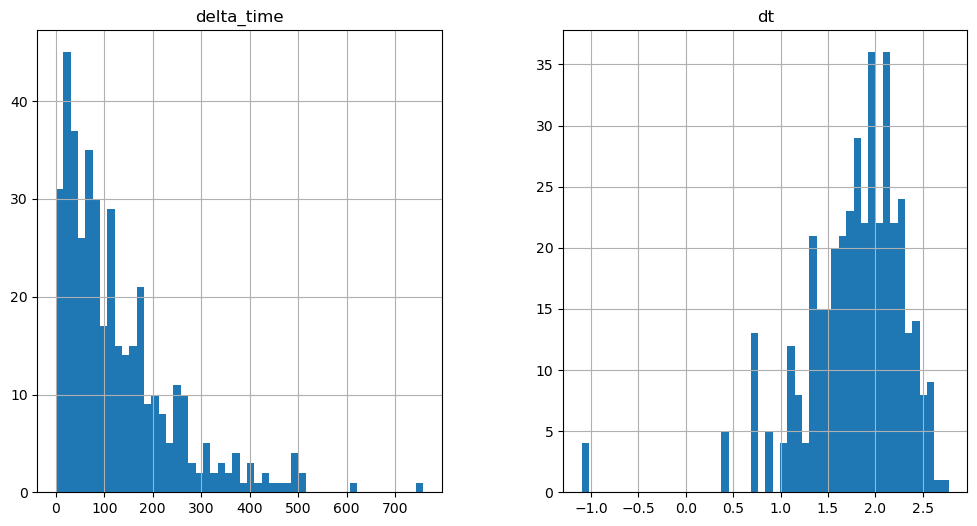

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

7149.72732770443 3.2410301566123962


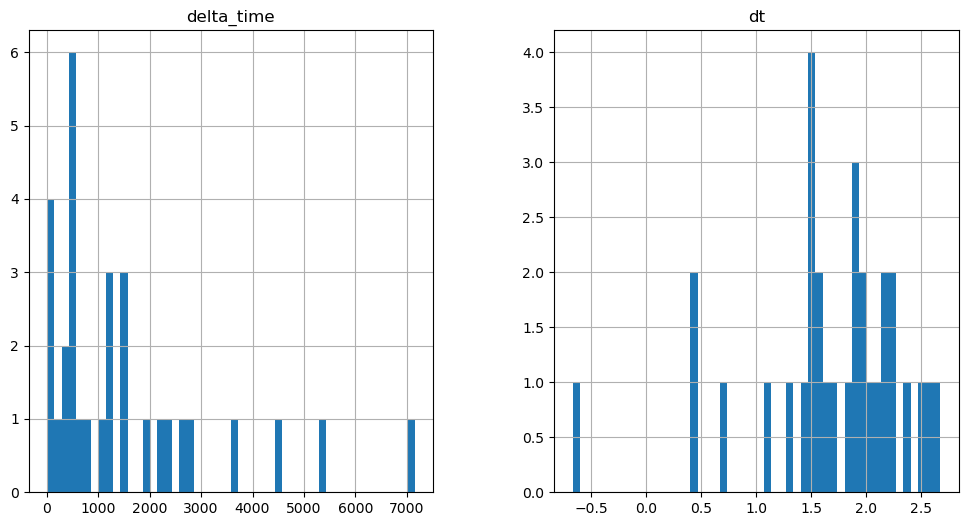

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

11800.531720280647 9.723100364208221


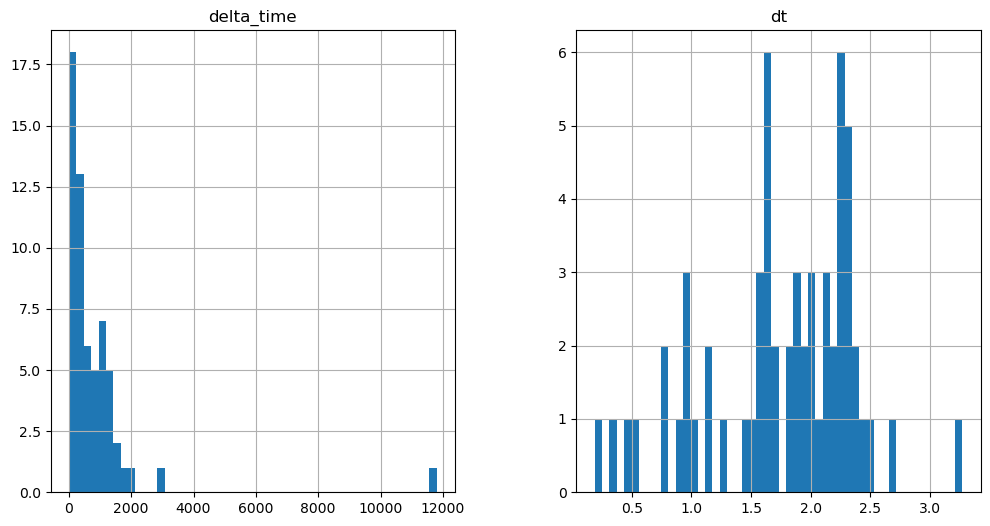

5279.612754106522 38.892431914806366


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

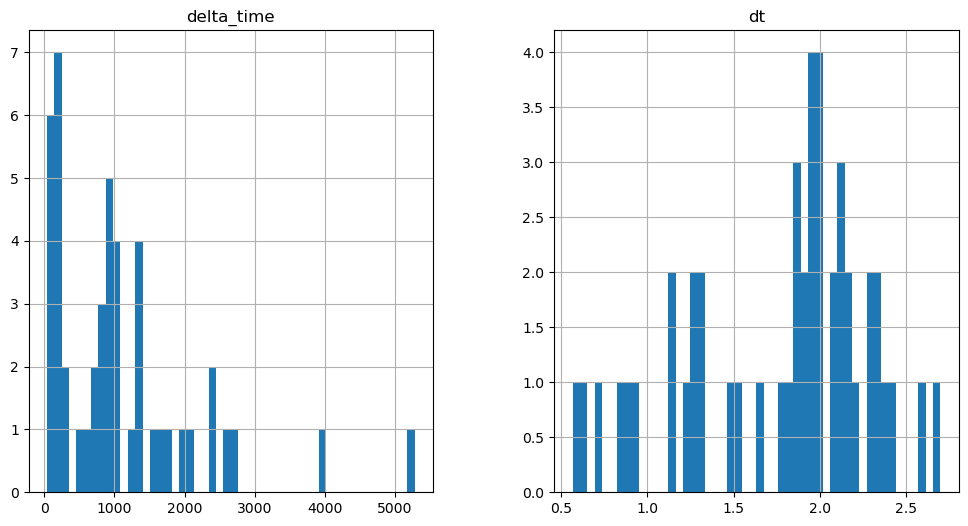

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2670.616103708744 0.1


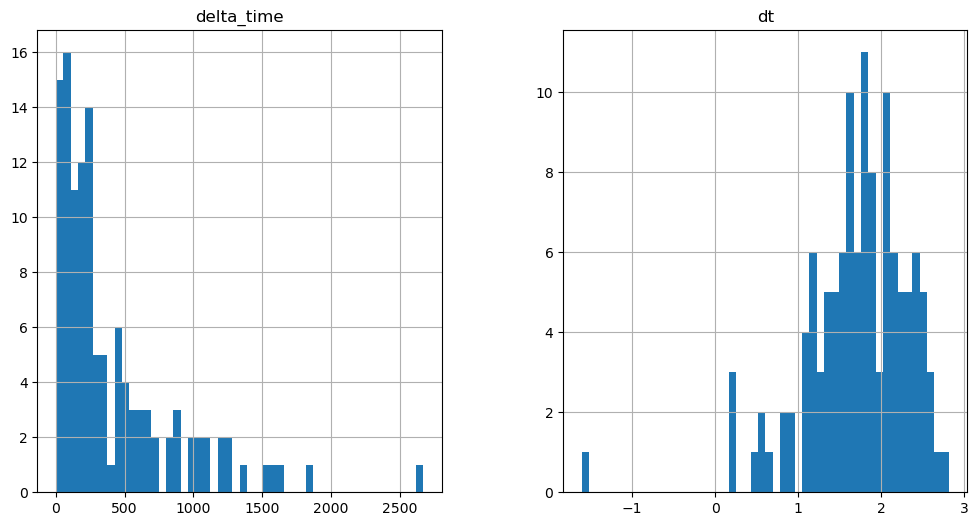

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

421.33463114500046 0.1


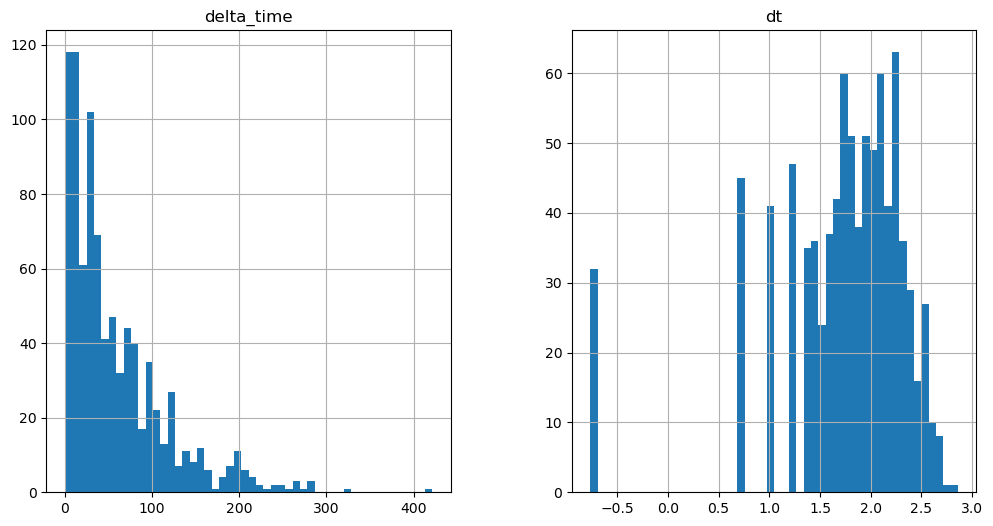

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1461.7031430602074 0.1


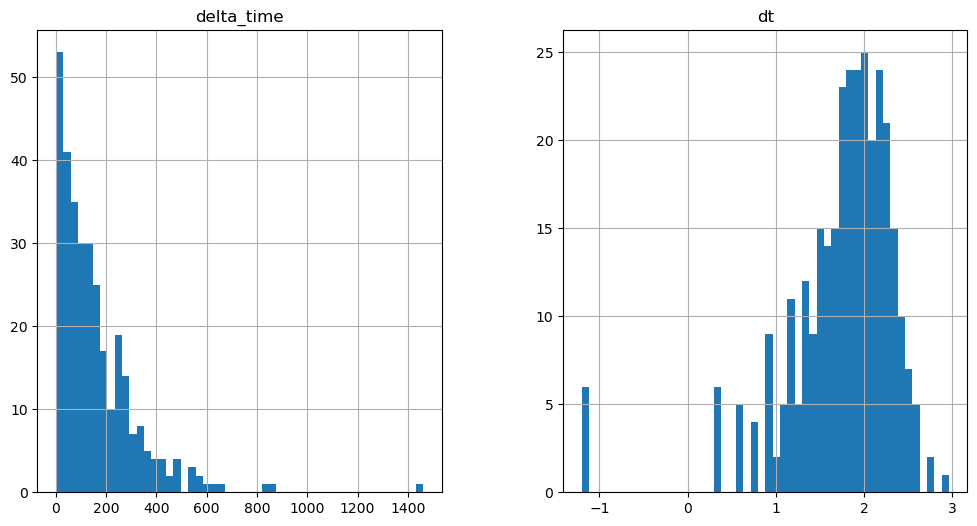

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1050.0959325432777 3.2410101890563965


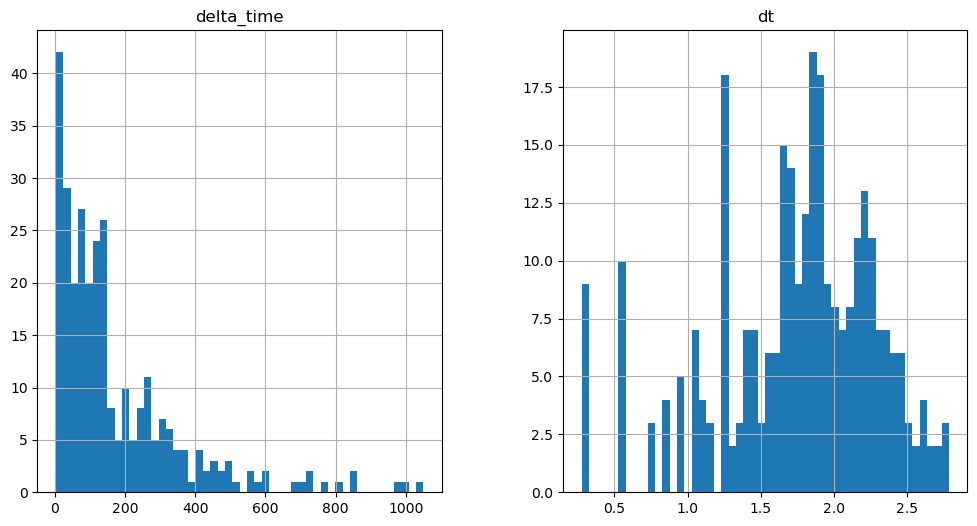

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4923.136466264725 12.964110612869263


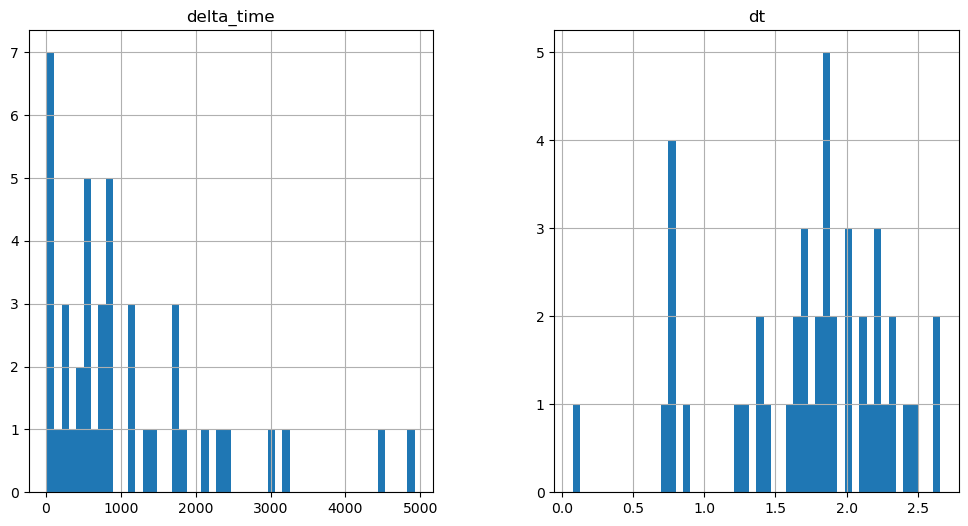

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1474.672053873539 0.1


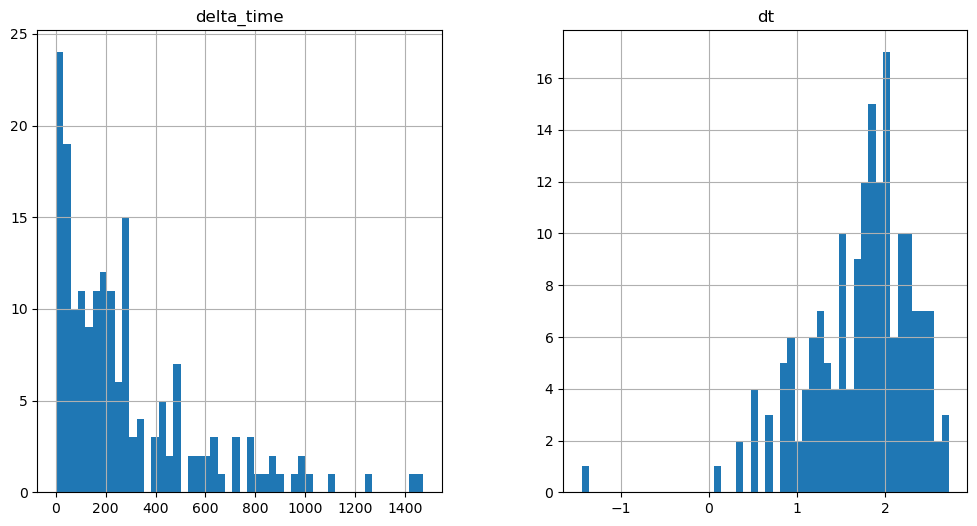

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1595.6376205682755 12.564080595970154


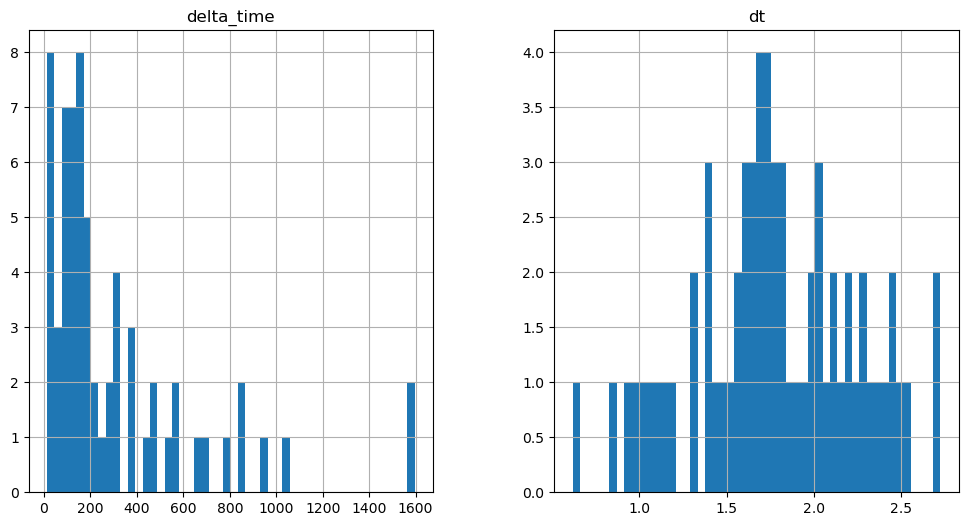

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1184.163099706173 9.423030495643616


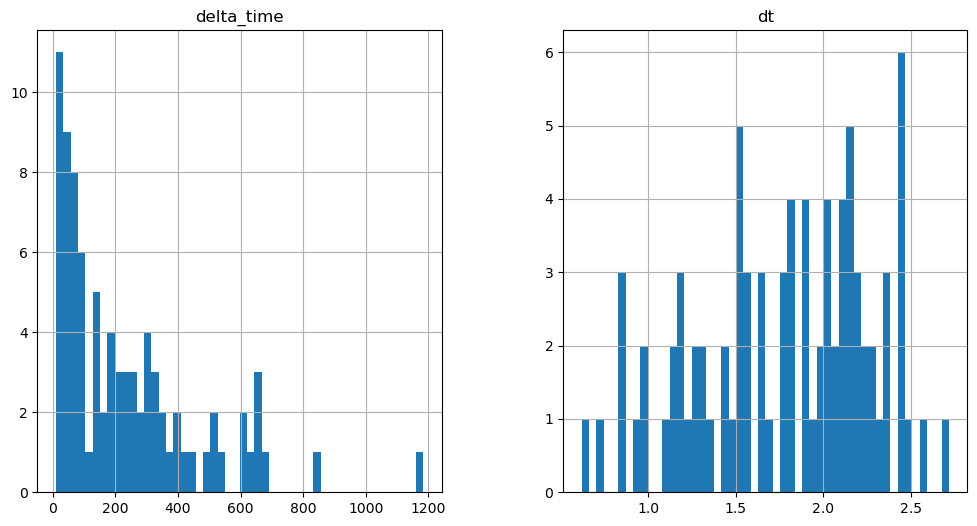

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

923.4584965705872 3.1410102248191833


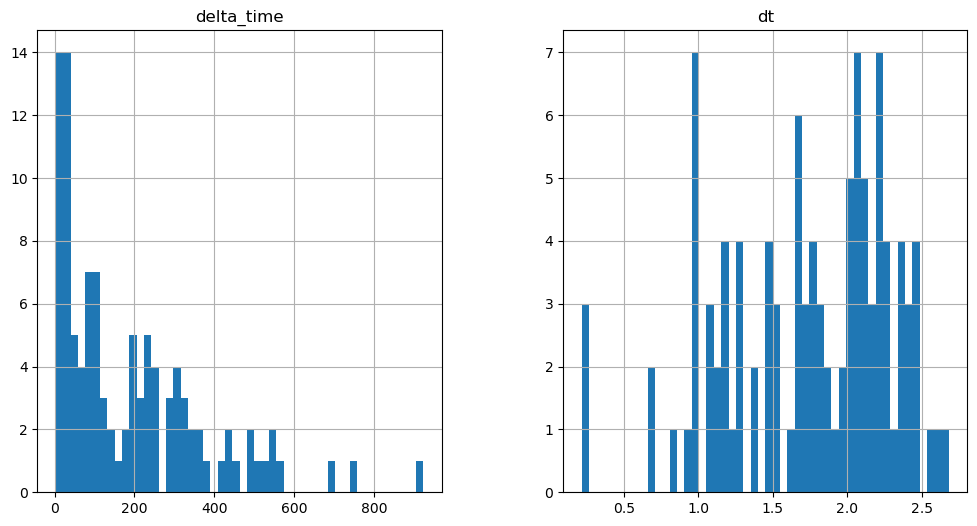

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1513.9717662930489 12.564080536365509


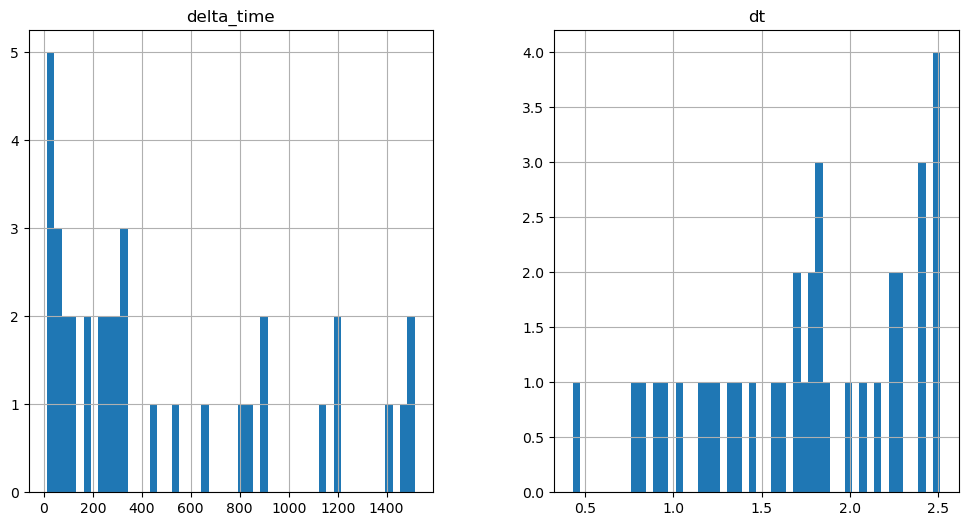

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1074.2290342450142 3.141020119190216


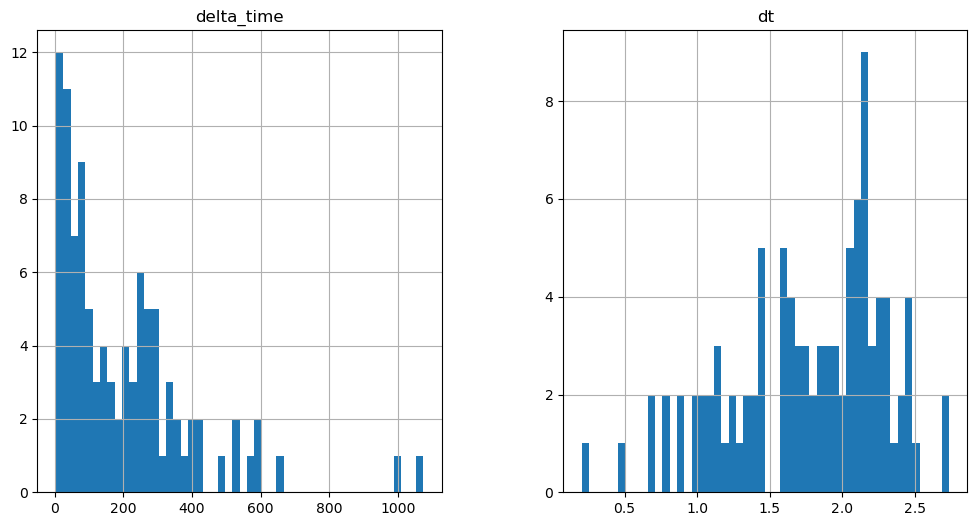

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

787.566349029541 6.482040286064148


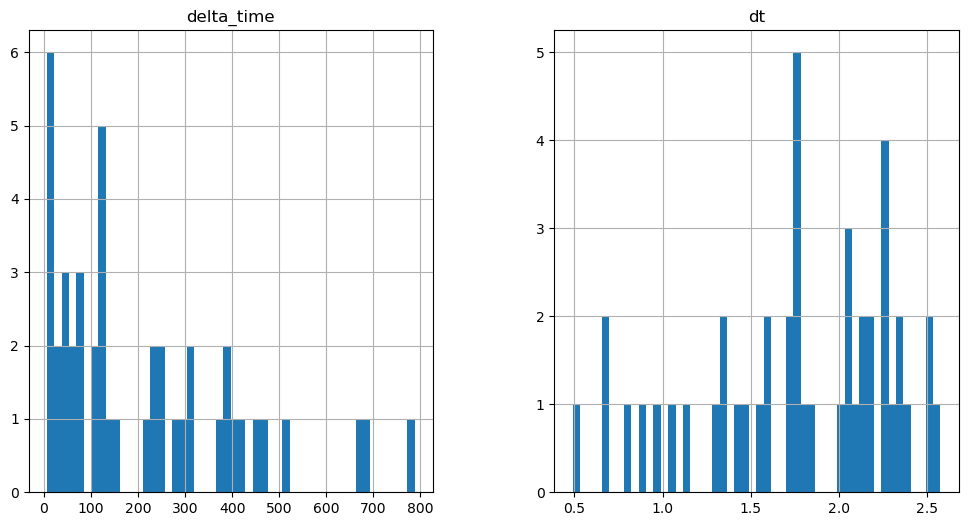

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

706.5406849384308 3.241020143032074


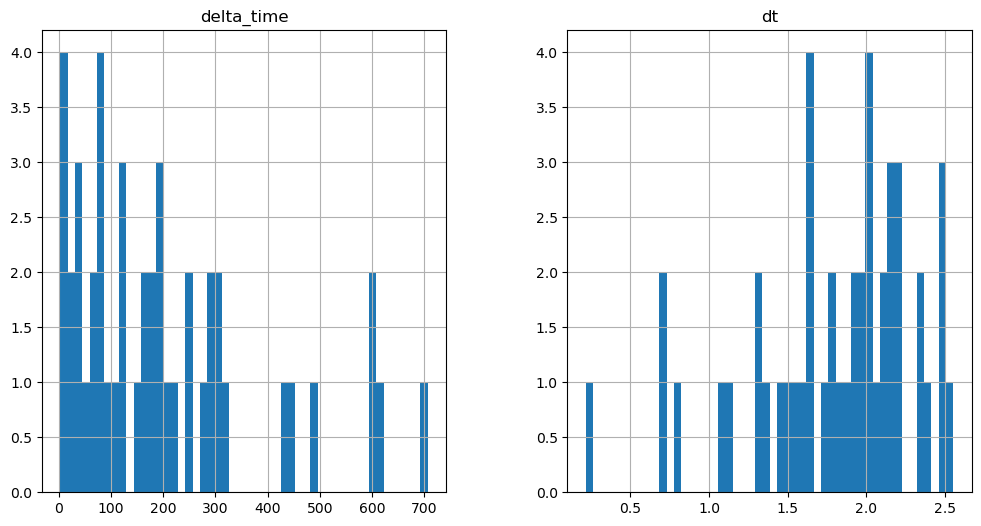

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

456.9834430217743 0.1


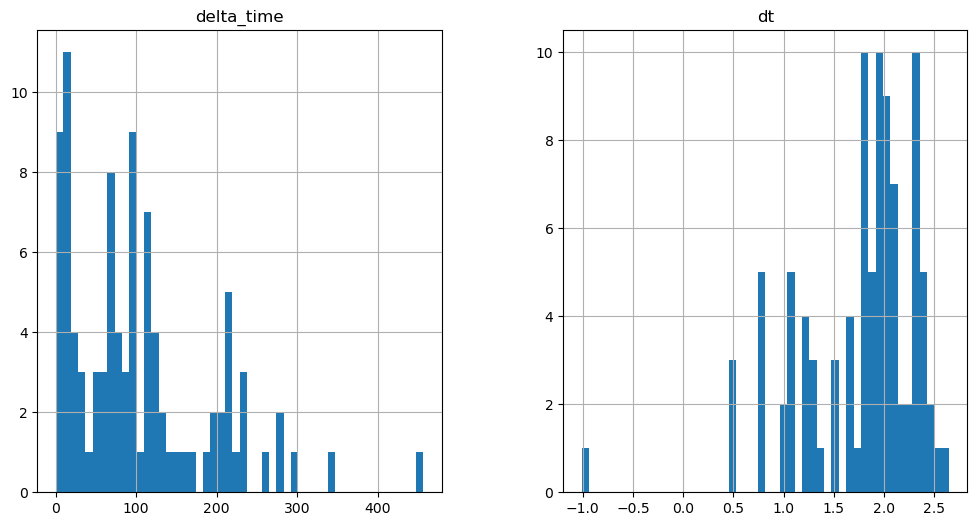

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

923.6910160183907 6.482050359249115


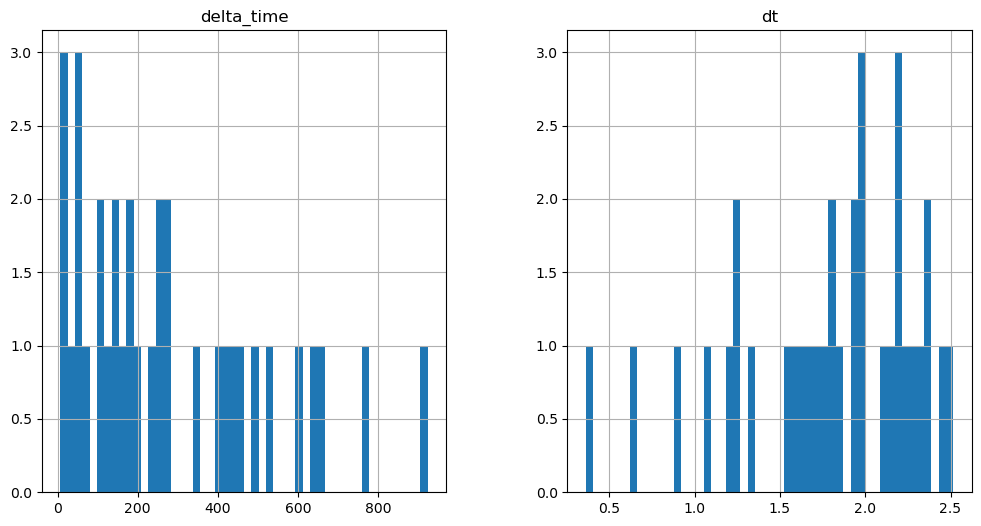

580.1441088318825 3.2410202026367188


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

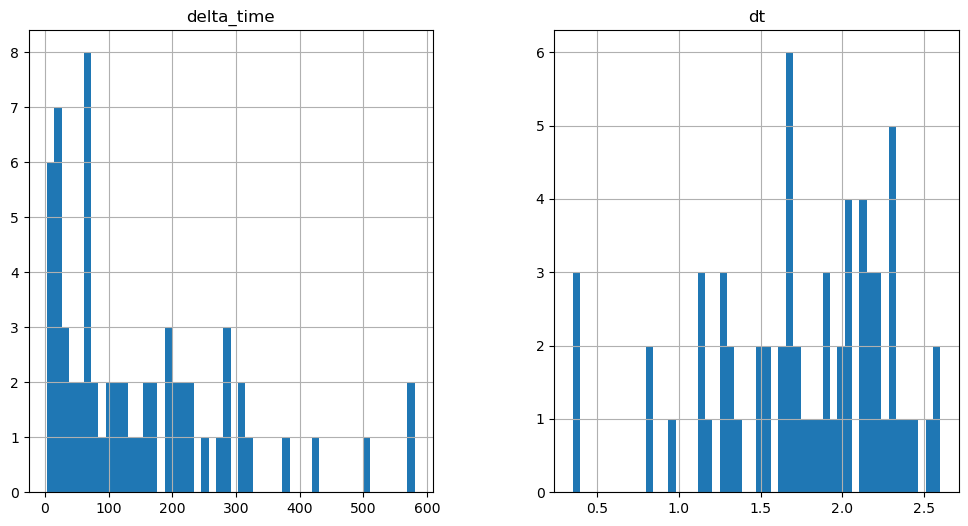

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

637.62421220541 3.140990197658539


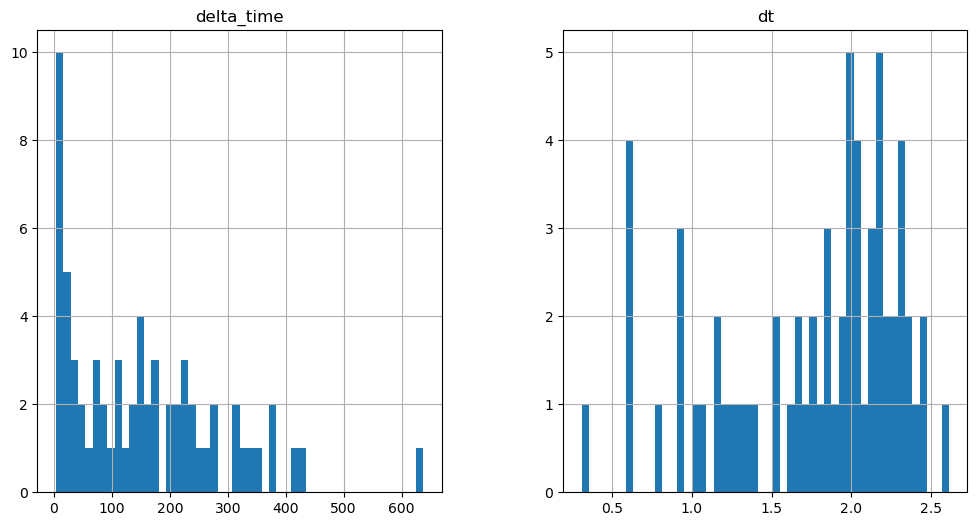

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1052.2377728819847 6.282030284404755


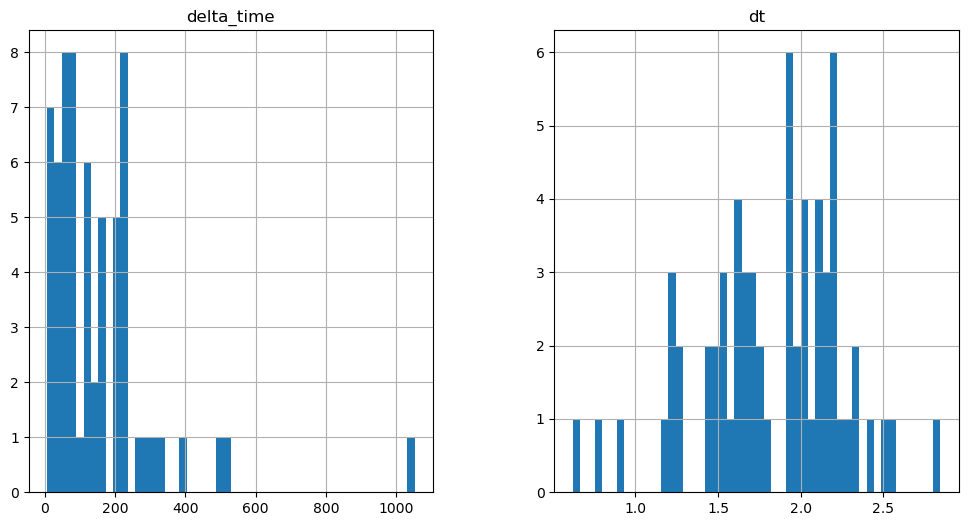

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3584.558349132538 0.1


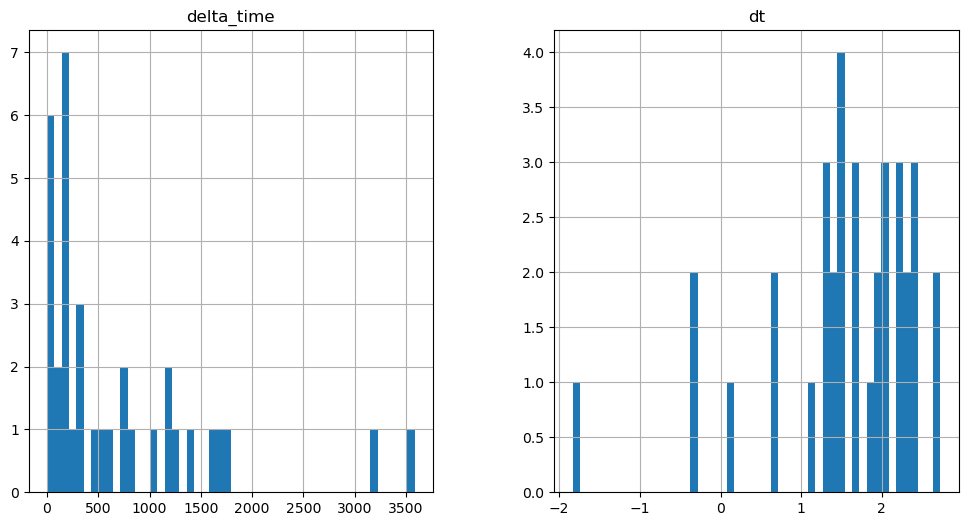

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1717.7364556193352 3.241000235080719


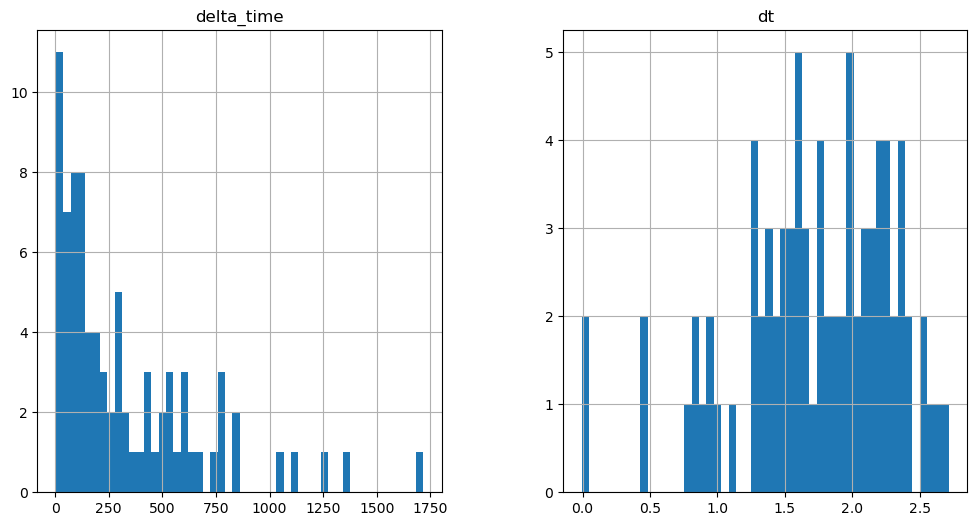

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1257.5122828483582 0.1


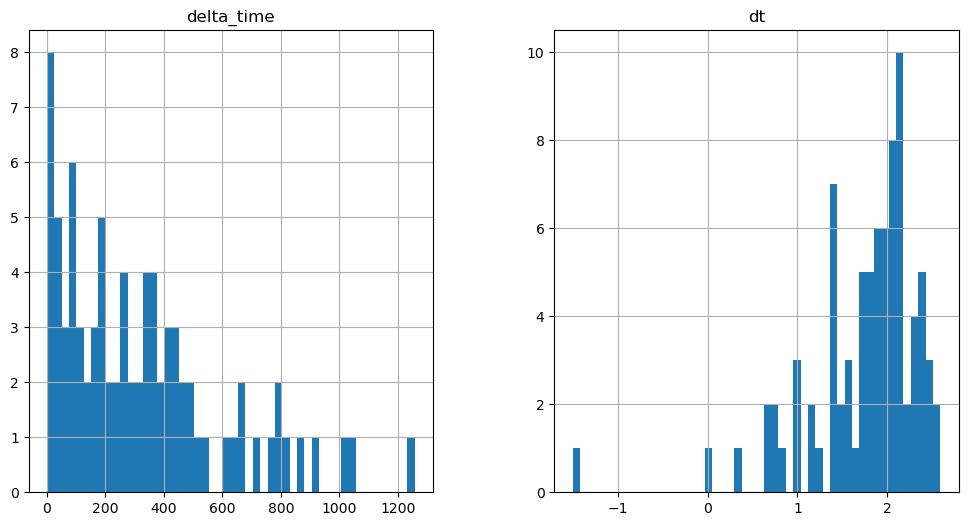

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2557.156927704811 19.44606101512909


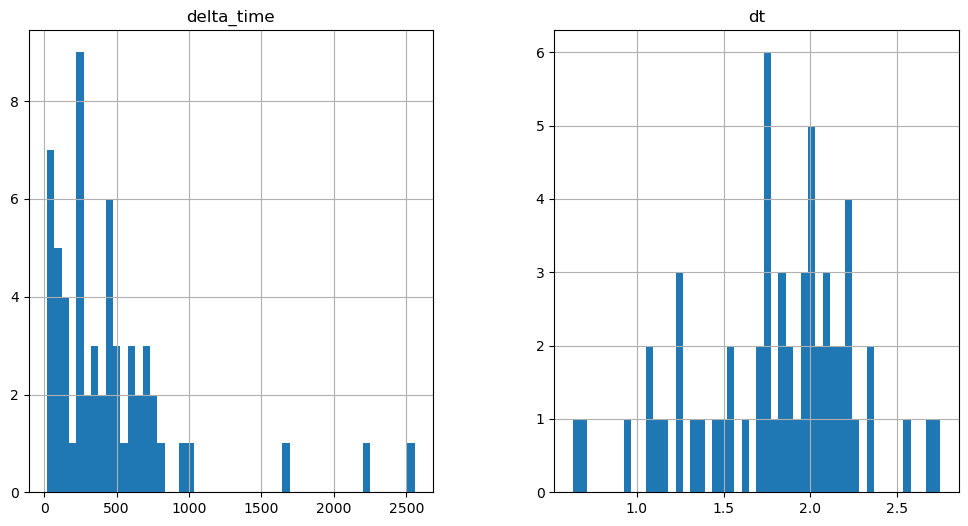

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2194.165059685707 45.37425220012665


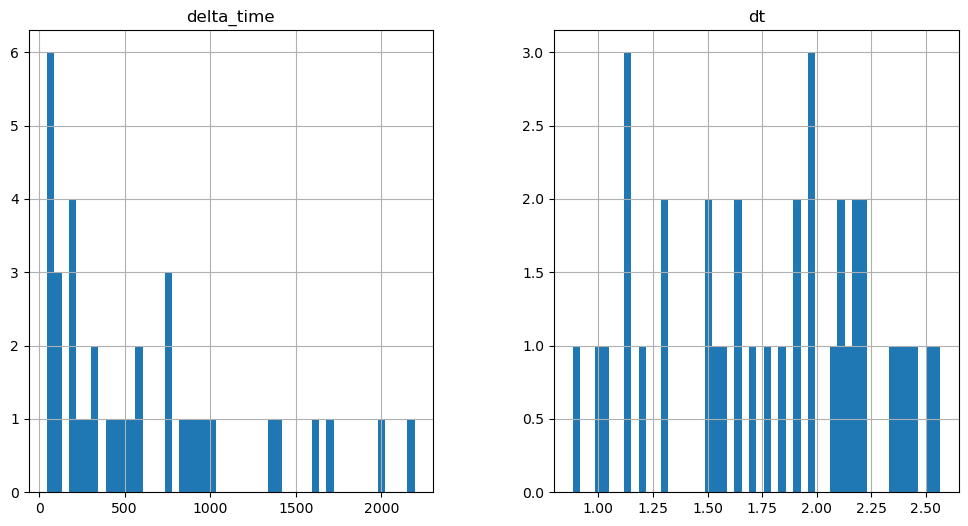

661.1659630537033 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

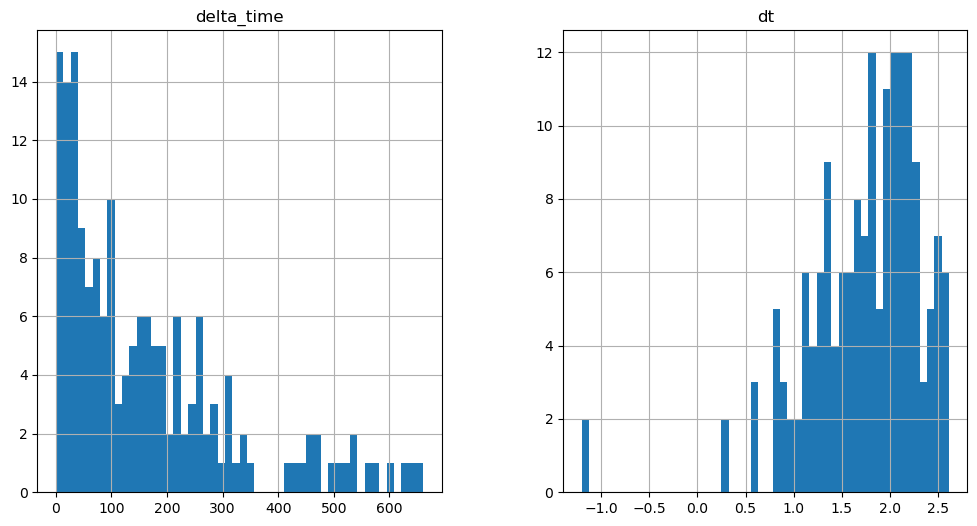

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2489.100804269314 3.241000235080719


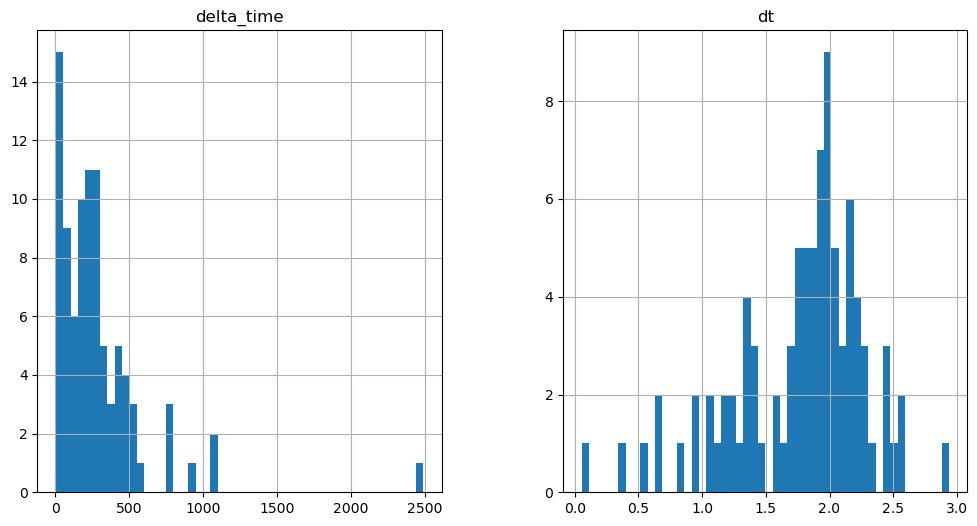

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1212.1377404928207 0.1


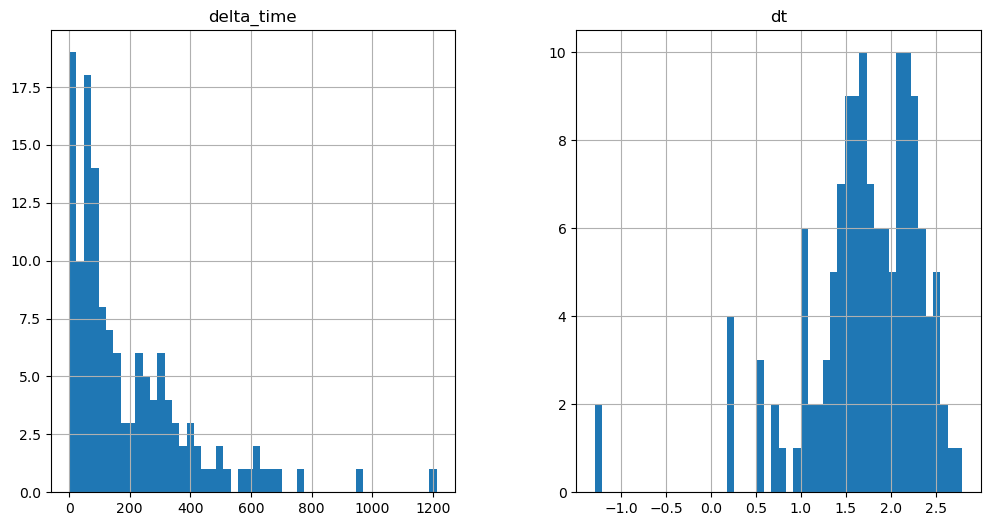

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

56.348912835121155 0.1


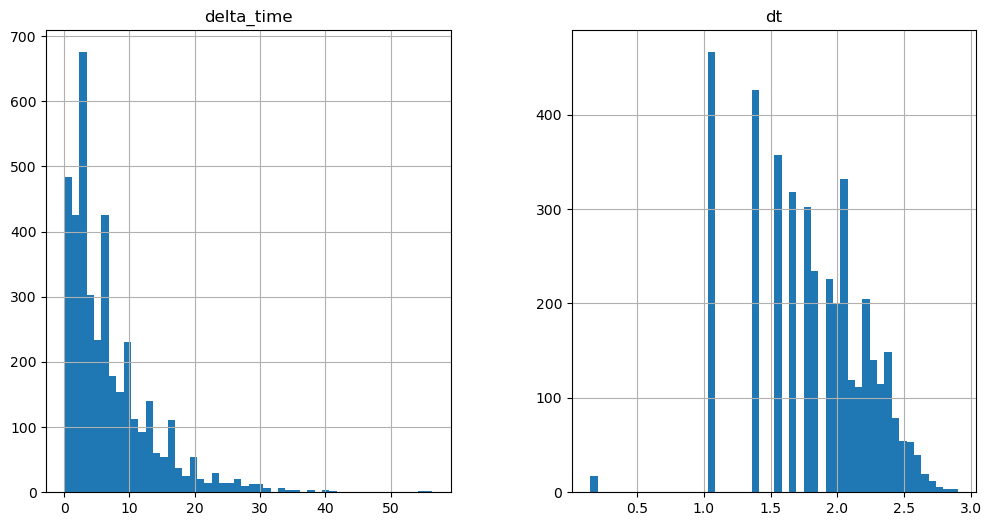

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

810.7516905665398 0.8410101532936096


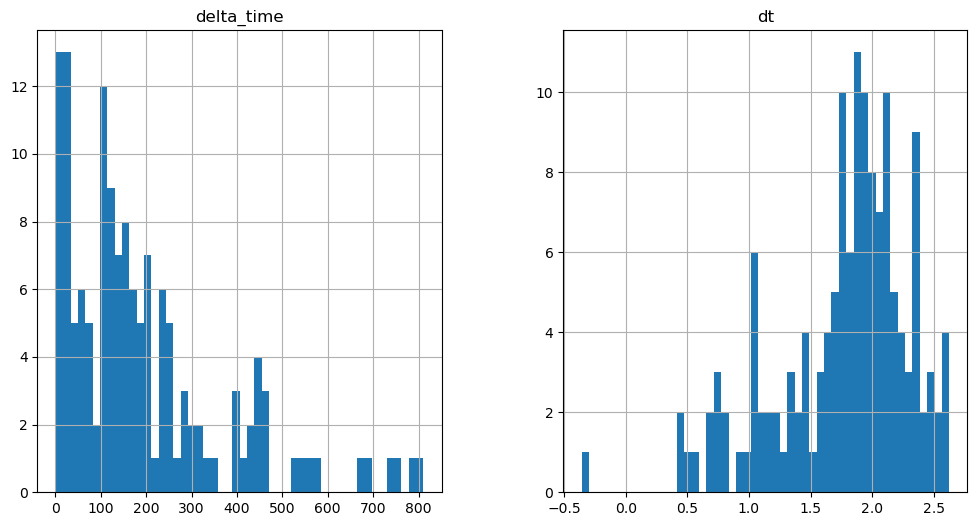

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2566.8147591352463 0.4410399794578552


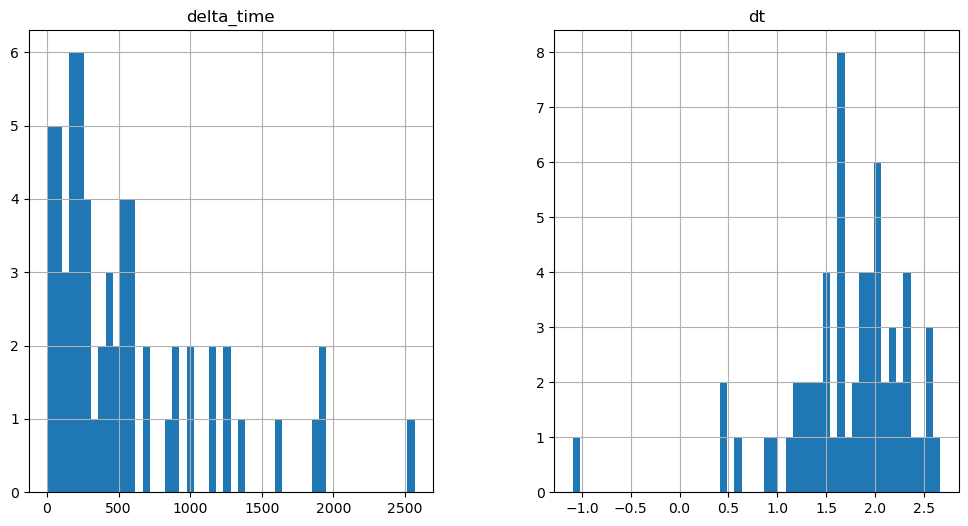

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1594.5826292037964 19.446130990982056


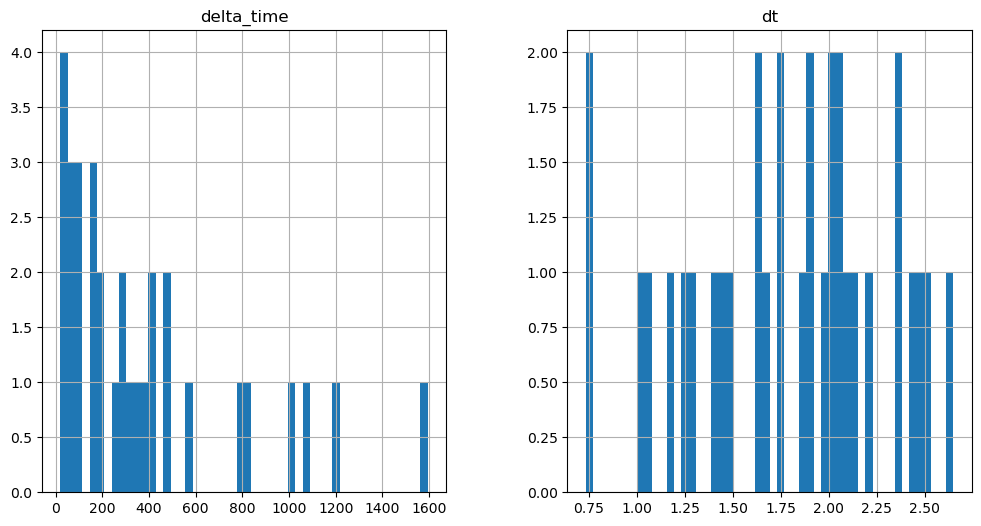

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

123.15872591733932 0.1


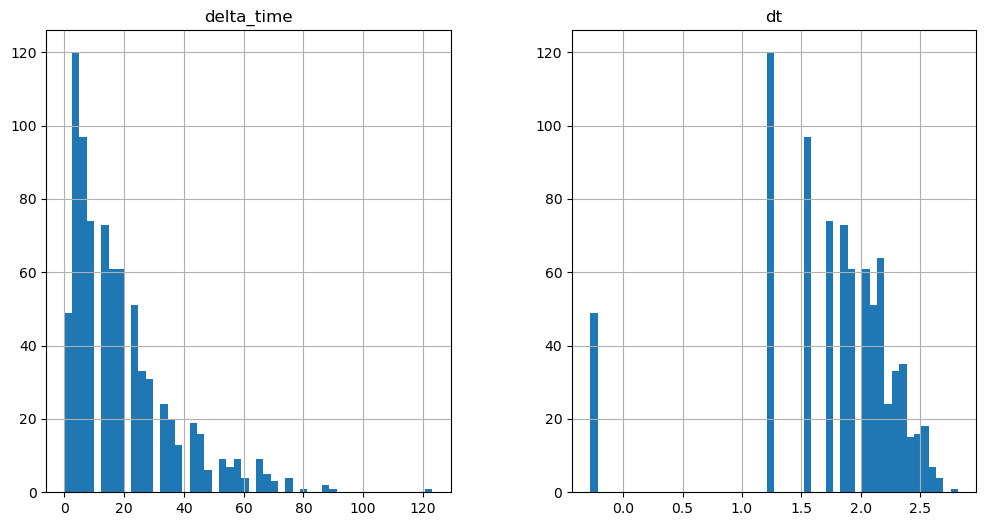

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

680.6147838234901 0.1


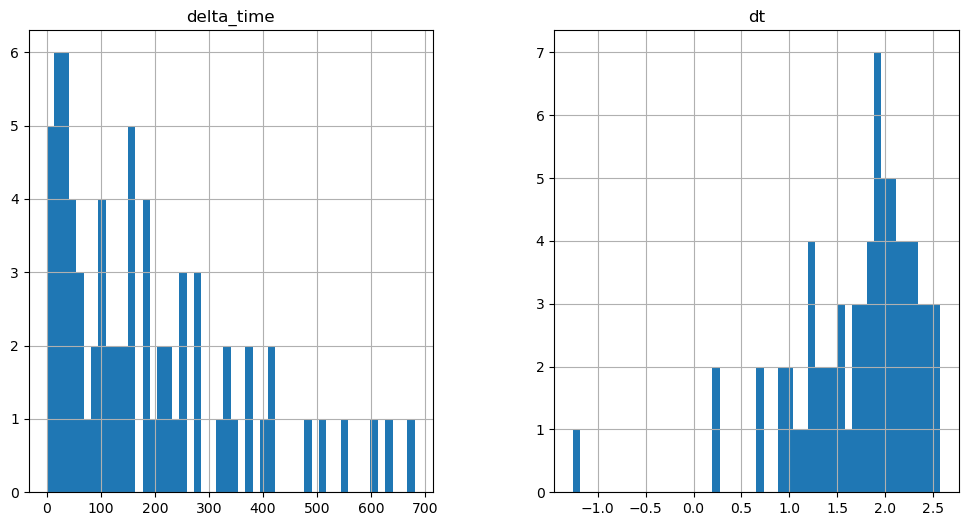

246.31795209646225 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

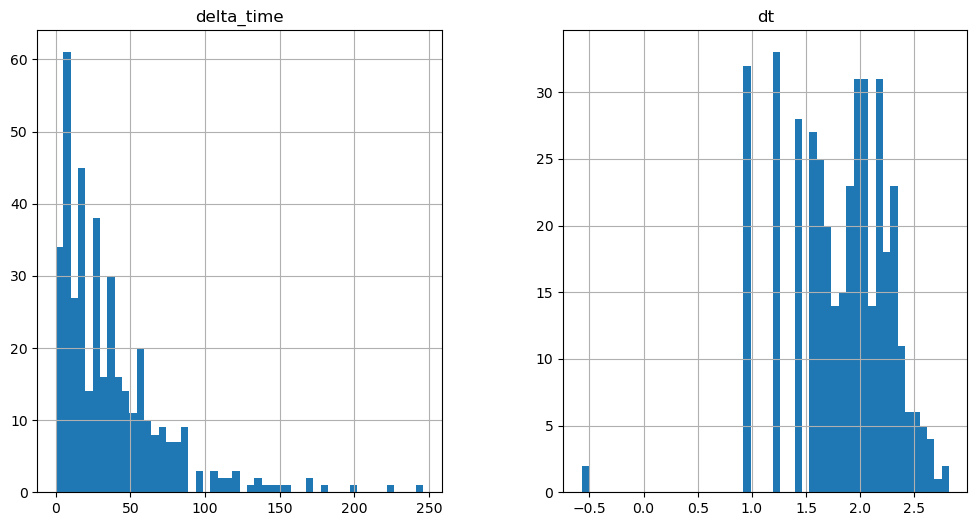

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

414.84953051805496 0.1


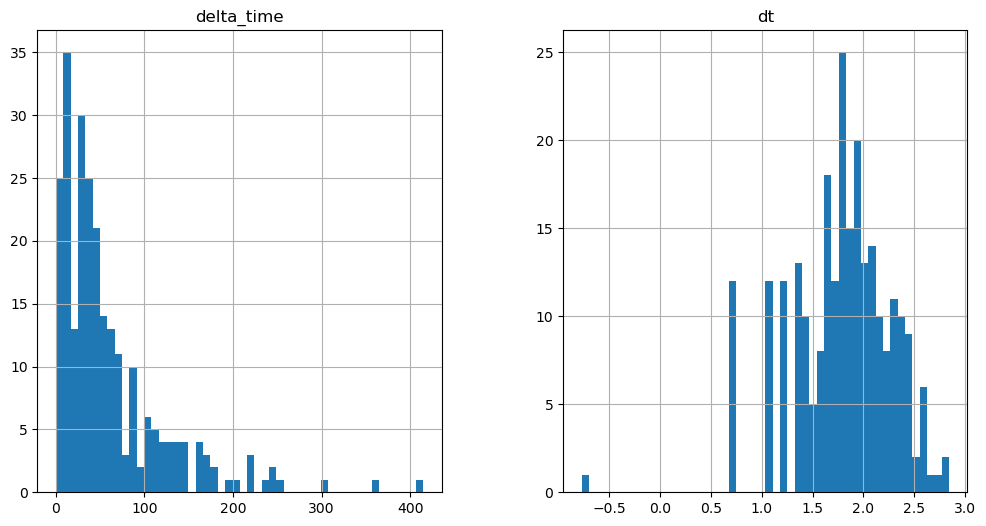

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

897.763054728508 0.1


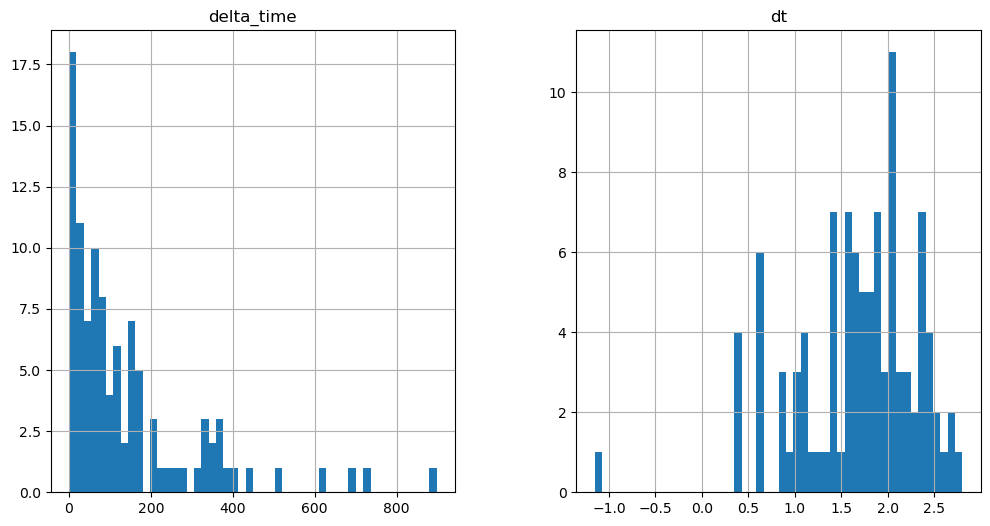

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1908.9561848640442 3.2410101890563965


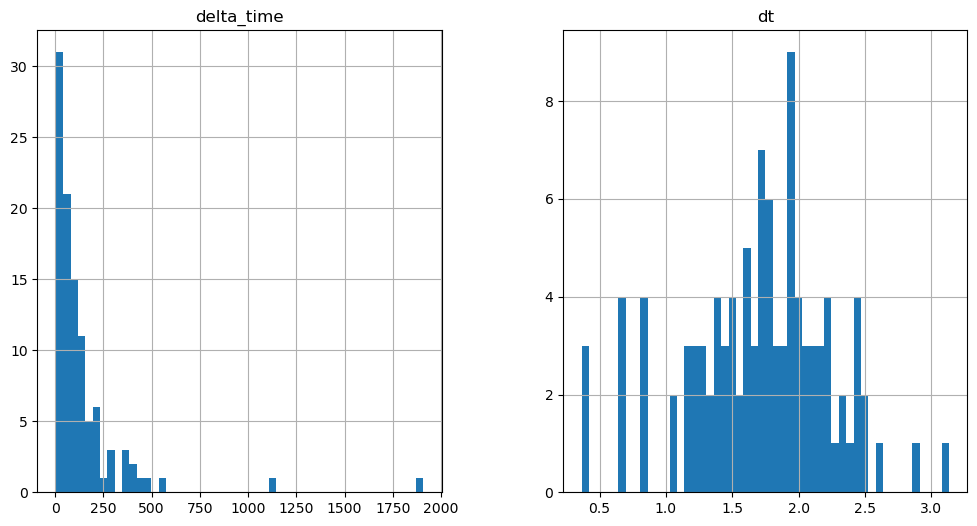

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

265.76337307691574 3.241000235080719


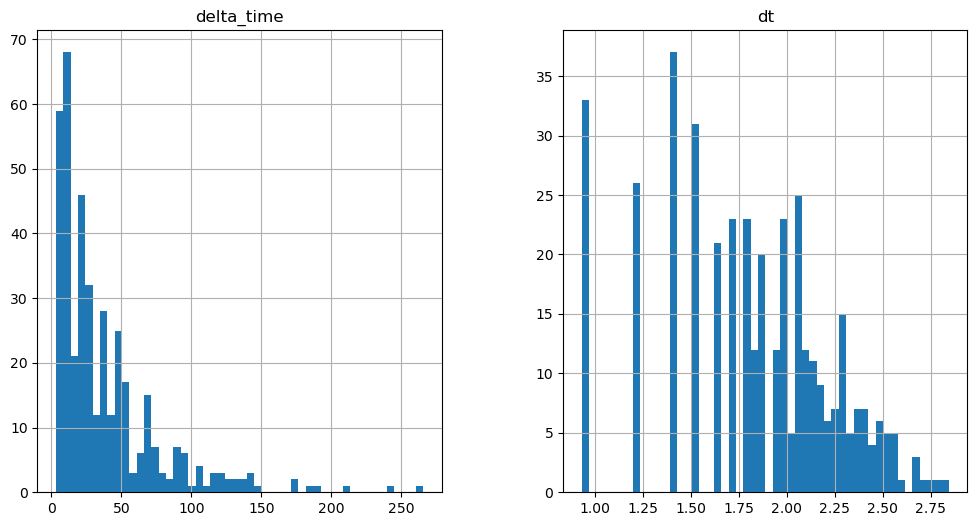

1234.8274013400078 6.482040345668793


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

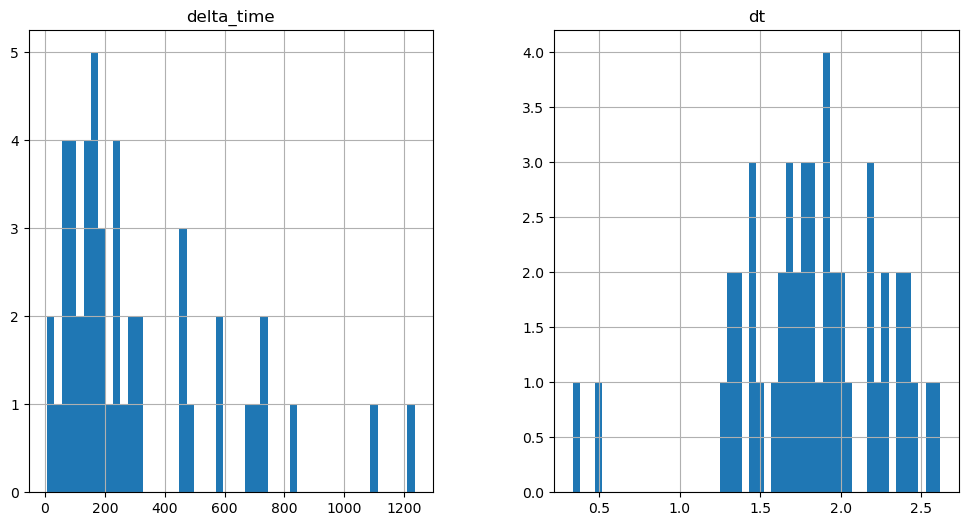

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1461.697992682457 9.723050475120544


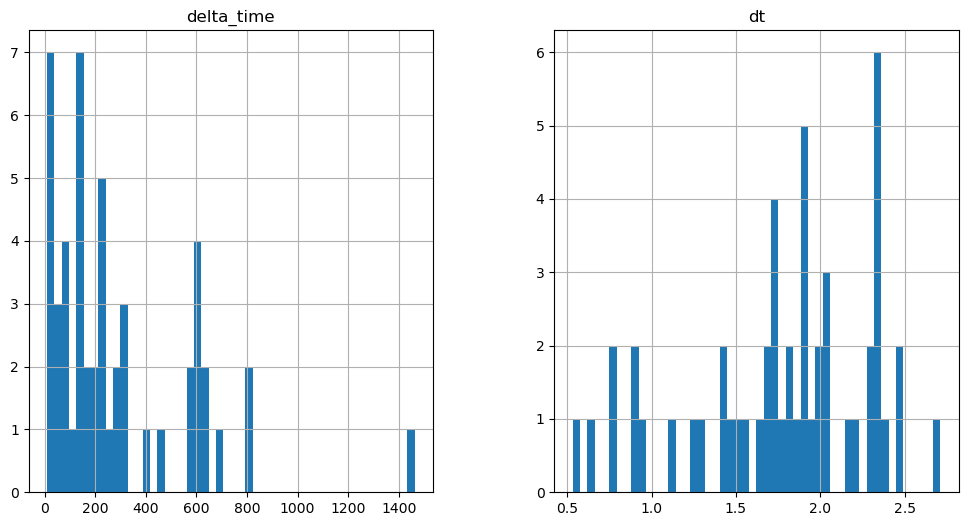

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

10267.547072470188 0.1


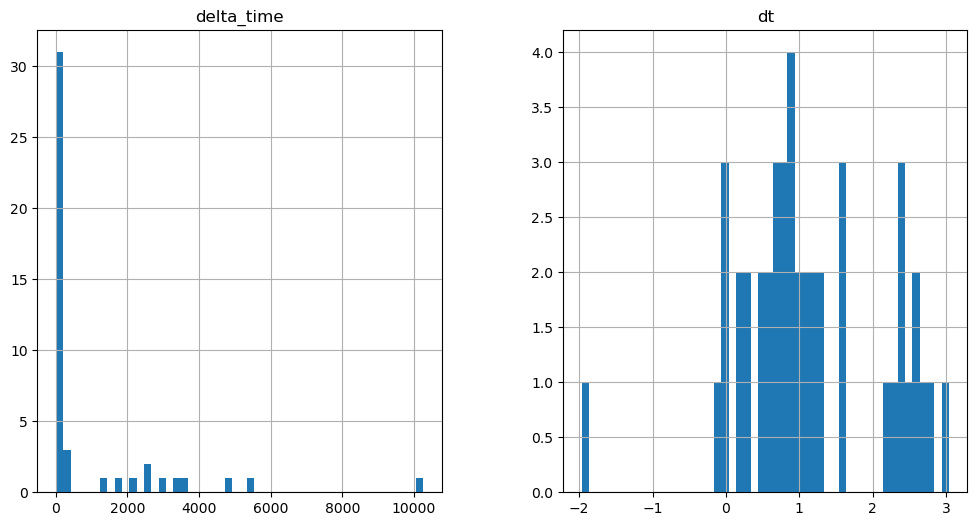

408.36986047029495 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

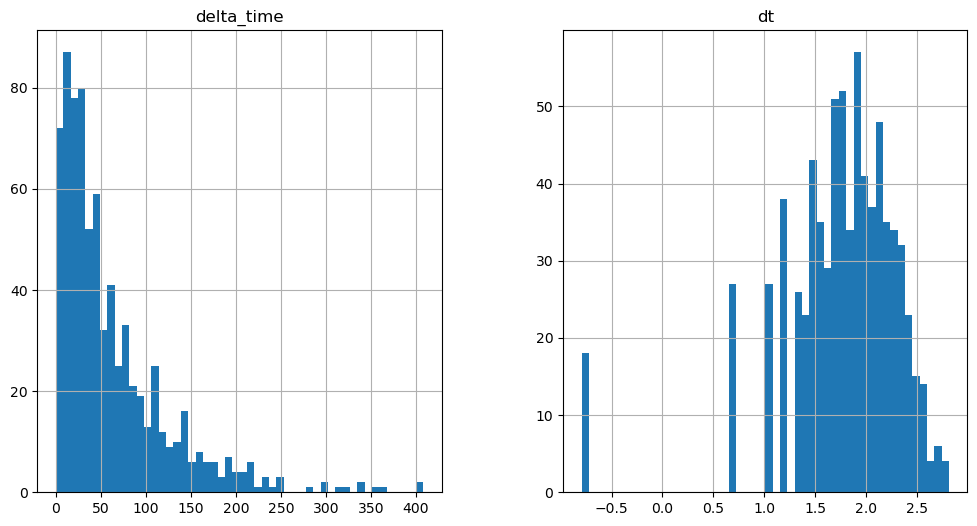

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1027.4057711958885 6.482010304927826


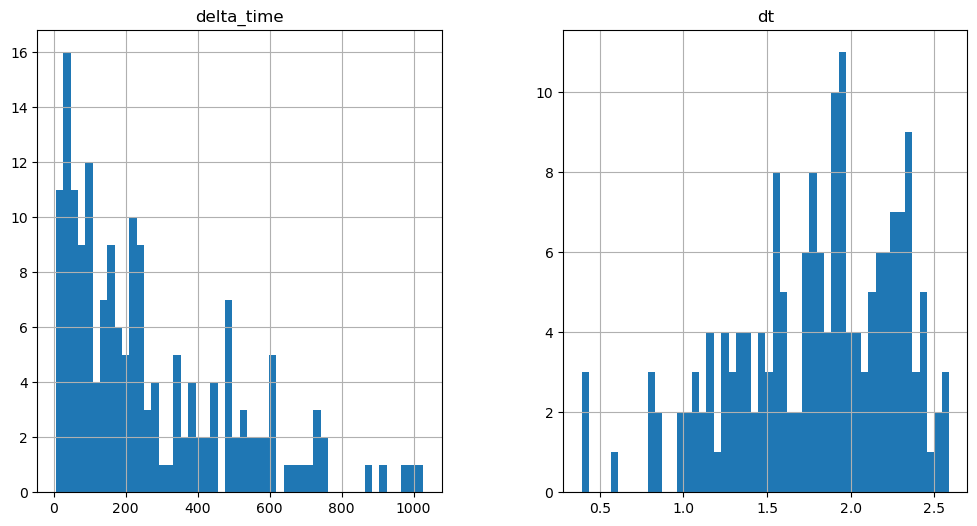

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1400.125719845295 3.241020143032074


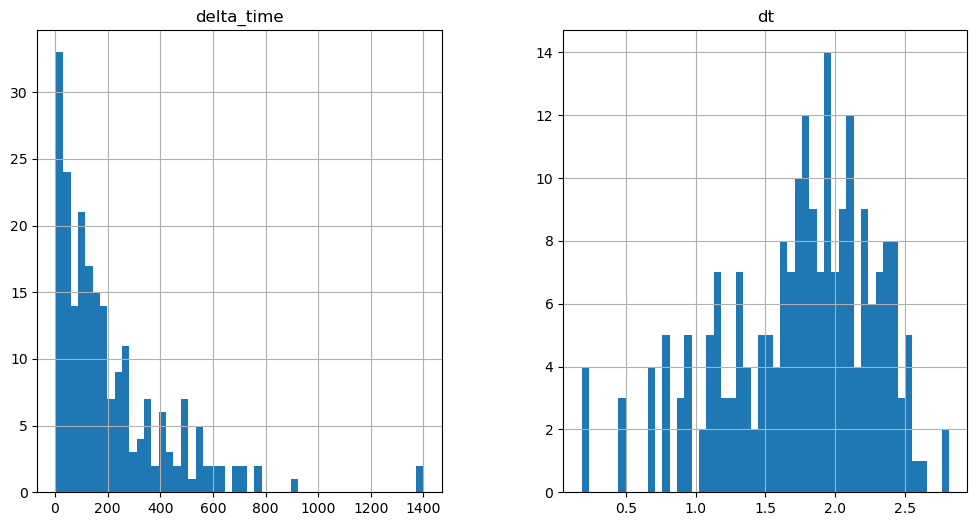

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2537.704127371311 16.20501083135605


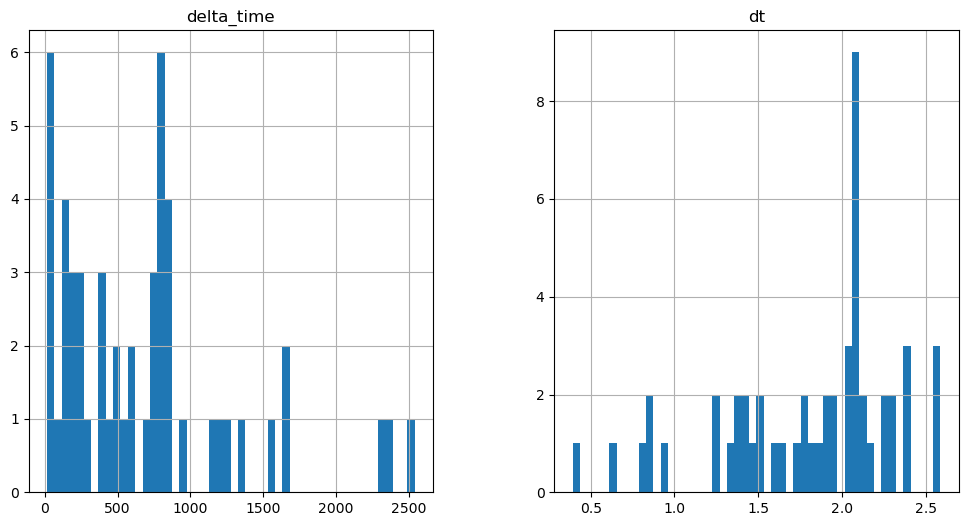

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3364.159548819065 51.8560026884079


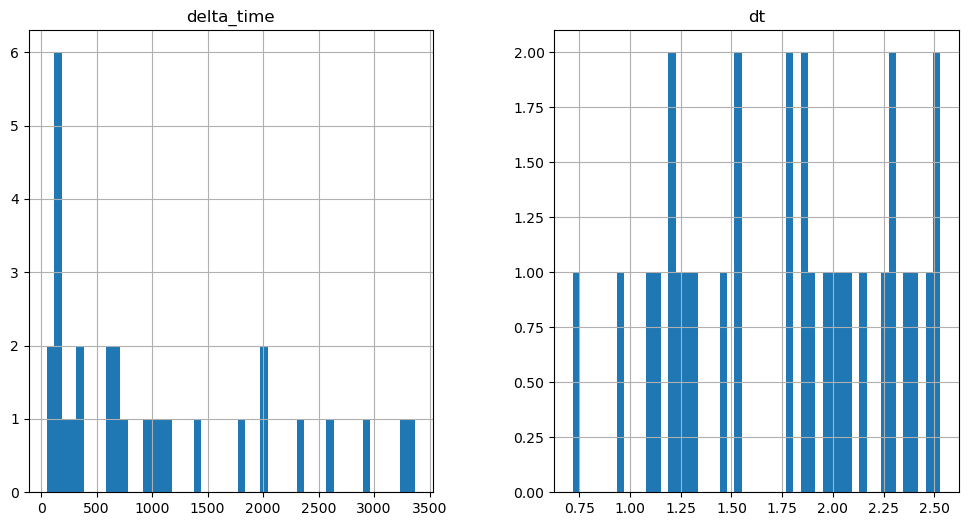

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3467.8718442320824 16.20503056049347


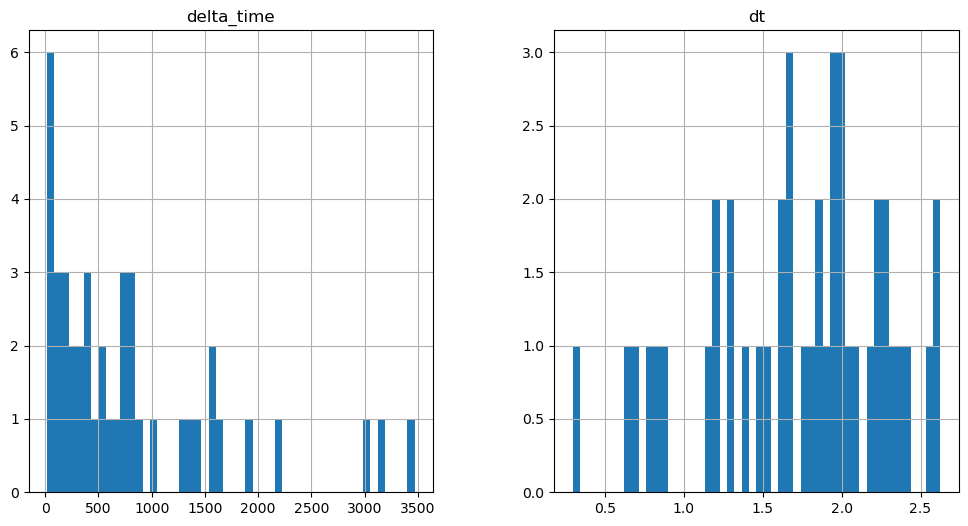

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1322.3285663723946 0.1


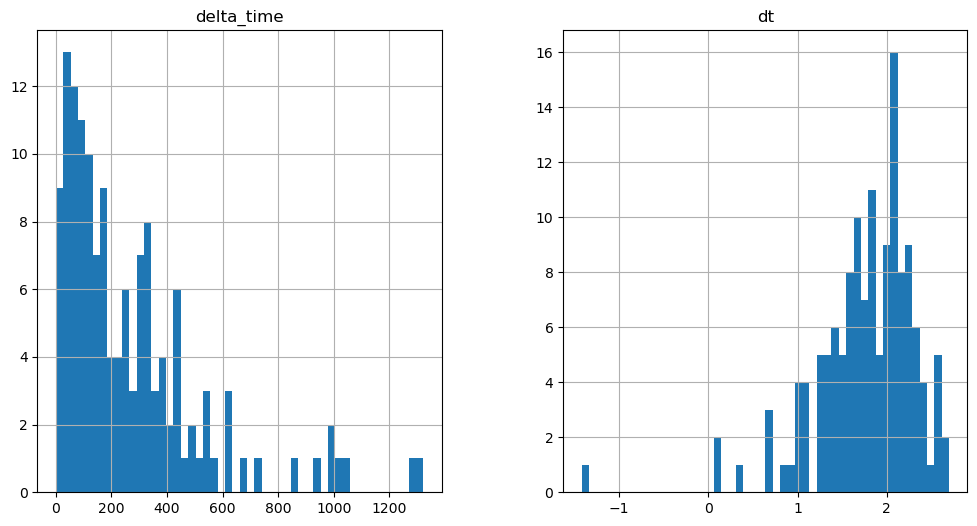

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1186.2065296173096 3.241000235080719


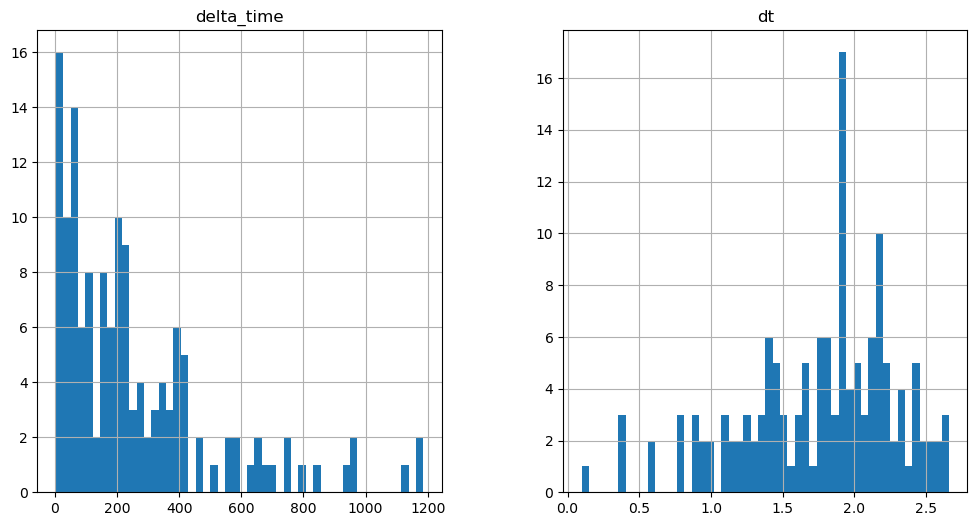

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2634.9341423511505 32.410011649131775


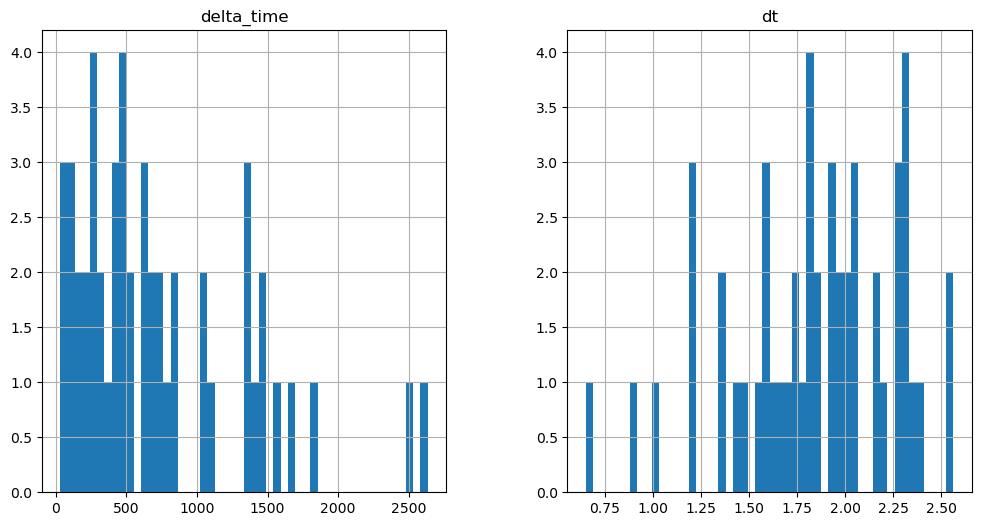

379.1977289915085 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

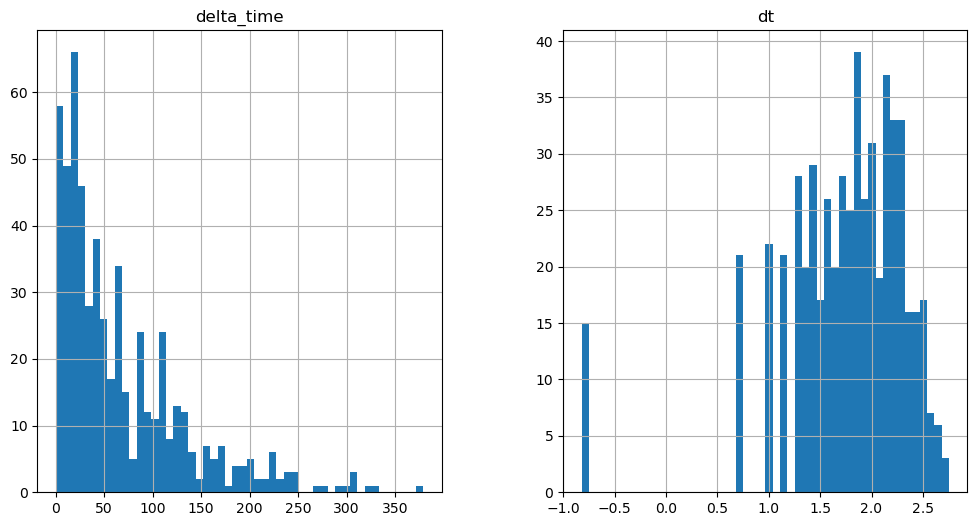

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2515.017156302929 0.1


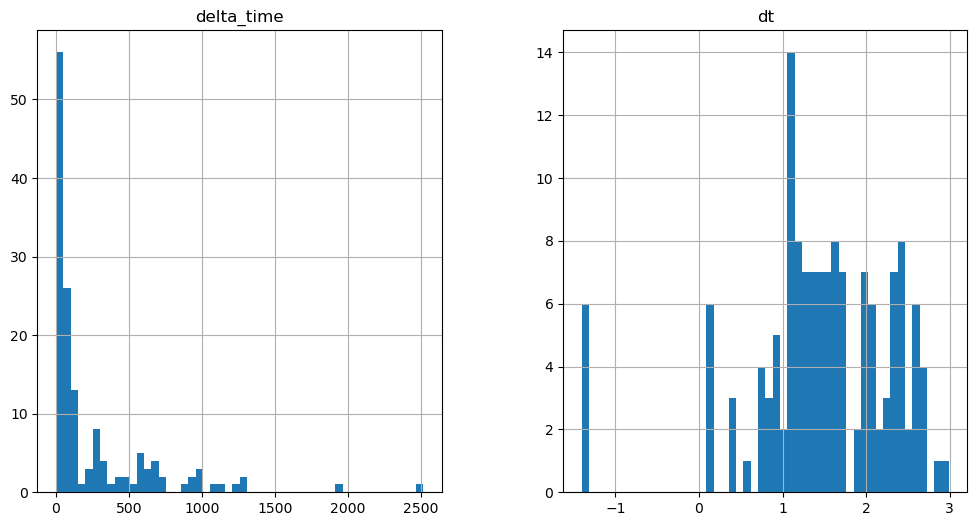

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

32.16337162256241 0.1


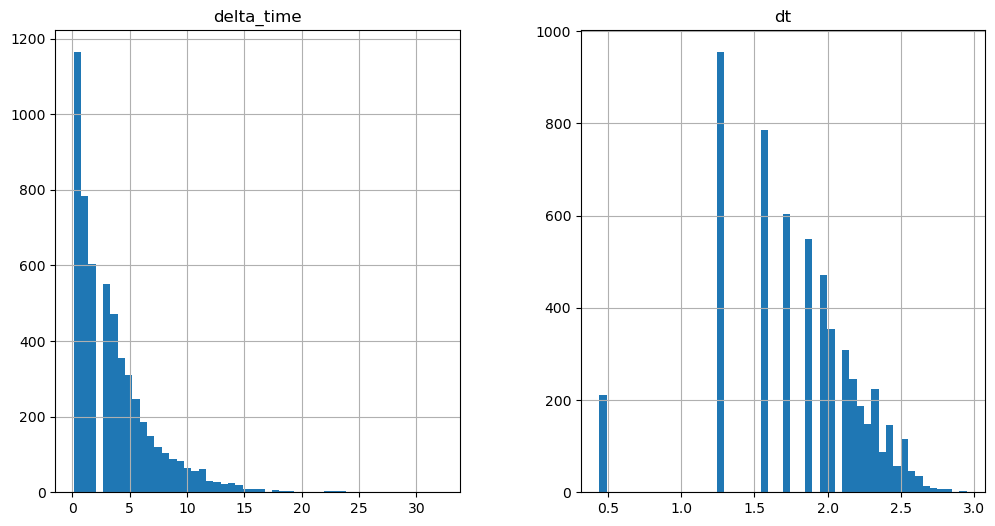

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2333.5094957351685 1.7641401290893555


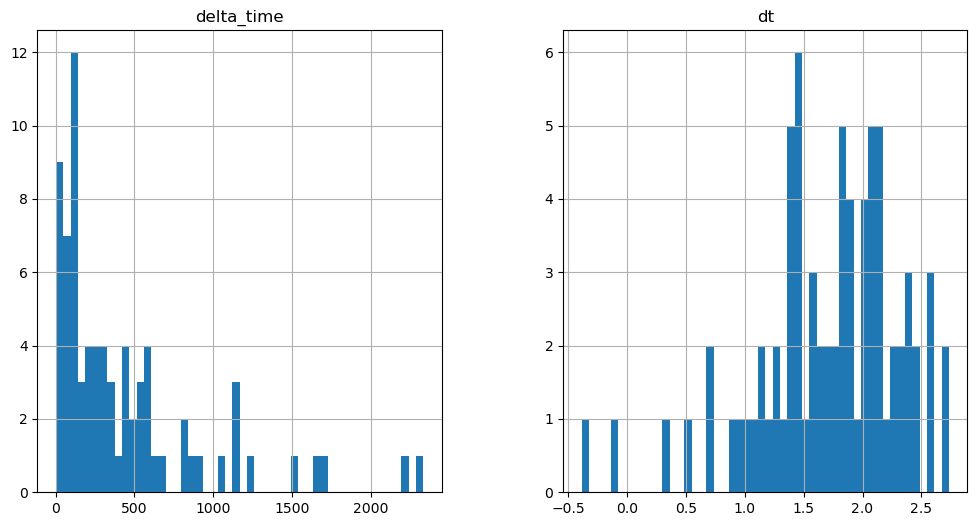

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

790.8046695590019 0.1


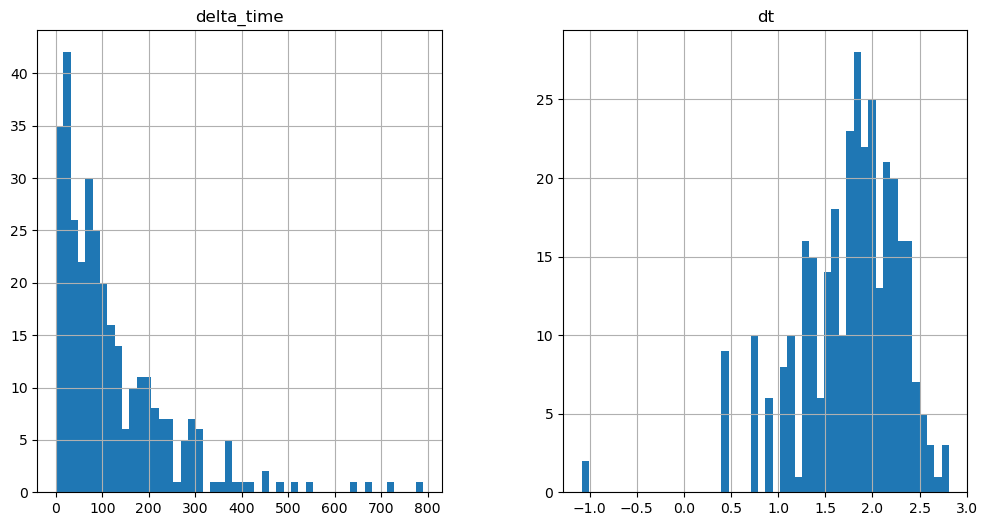

1247.7863023877144 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

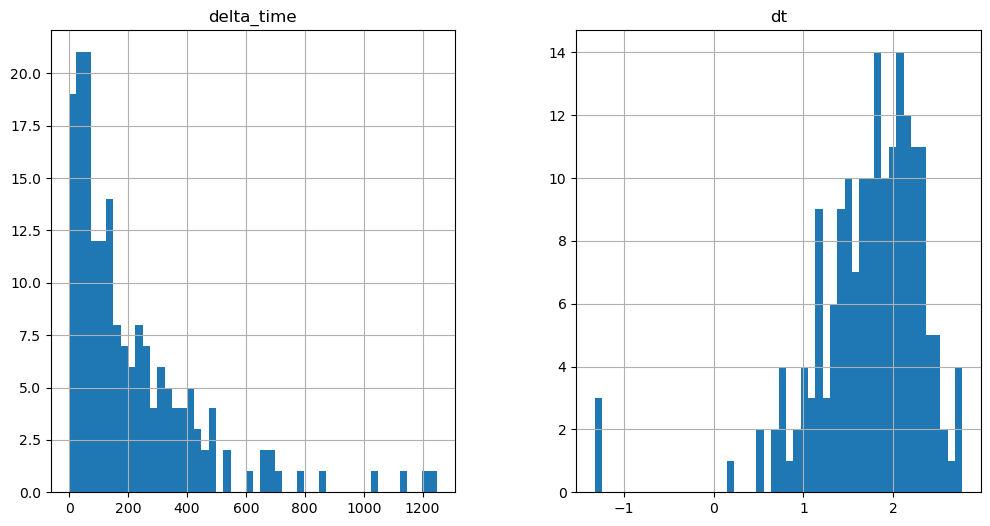

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

878.3120439648628 3.240990161895752


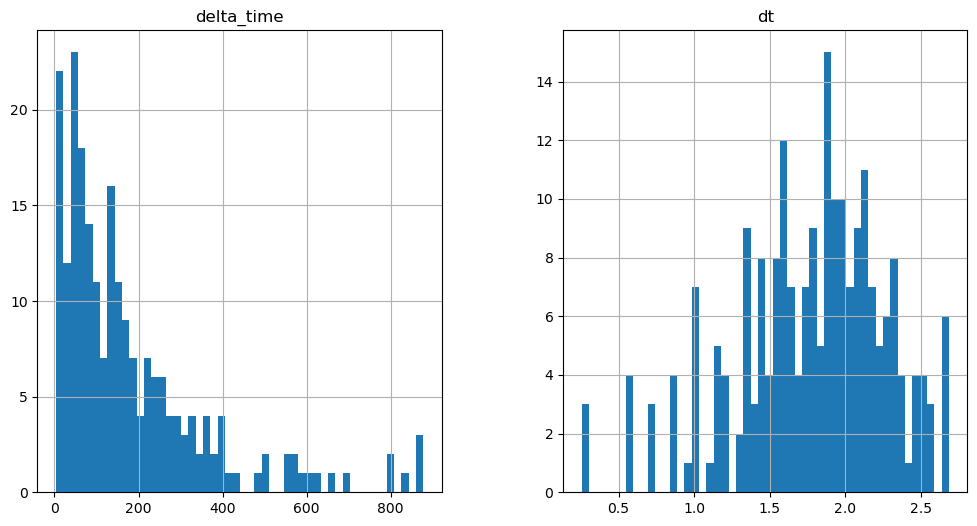

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

136.12216675281525 0.1


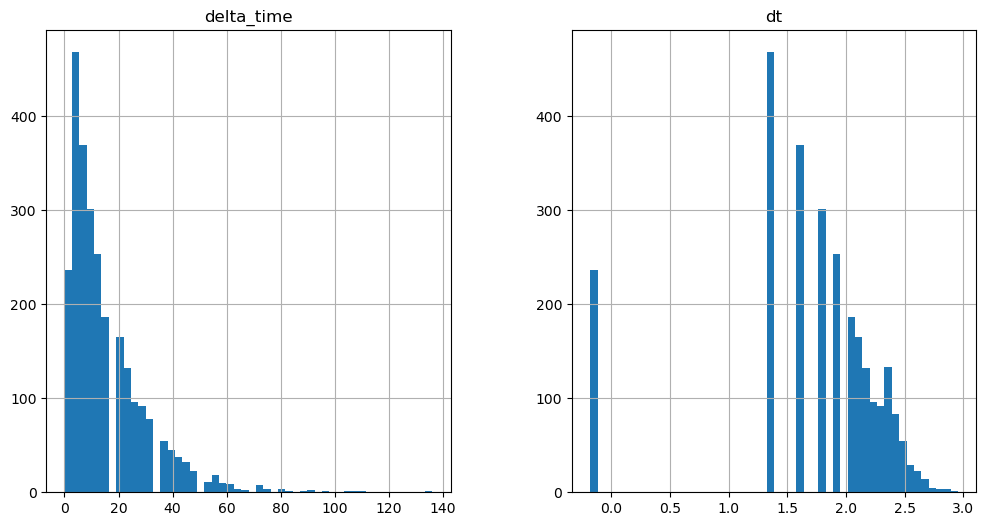

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1591.3325797319412 0.1


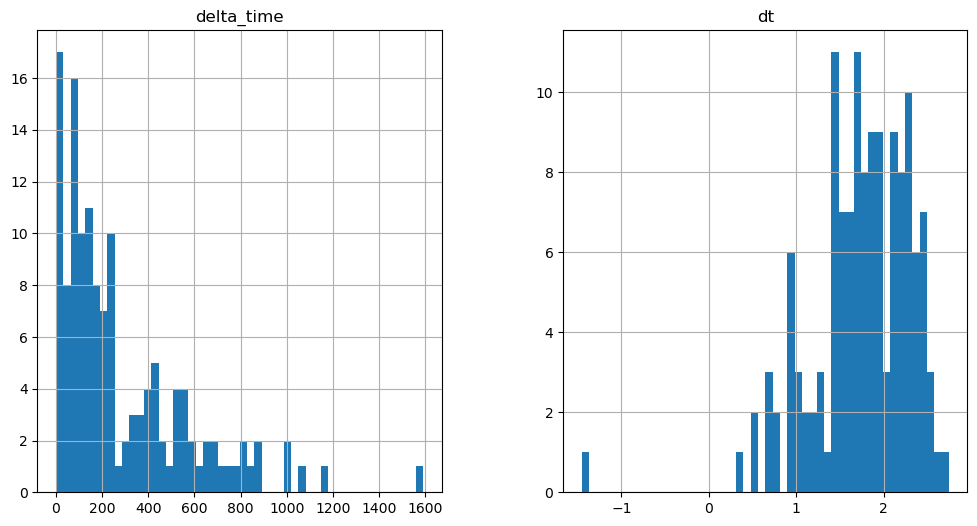

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

8987.320249795914 3.241010010242462


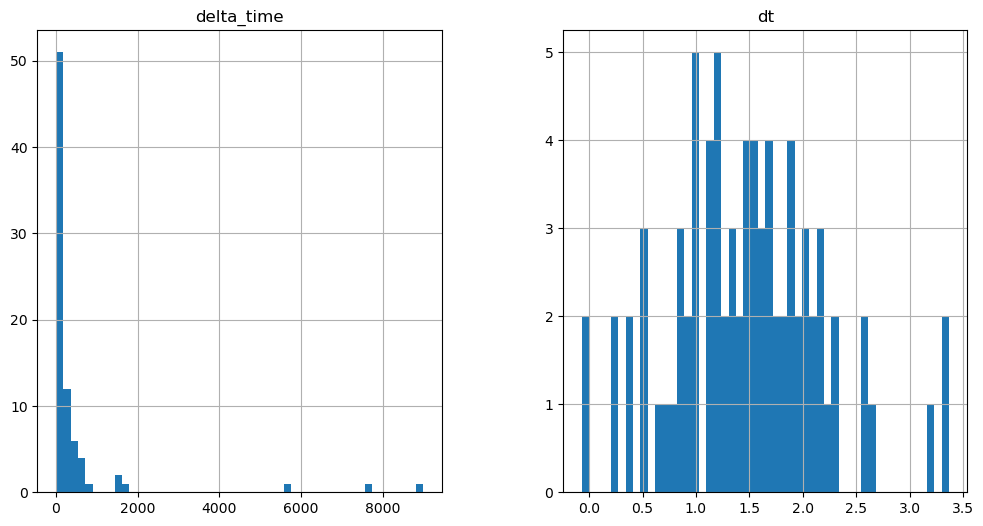

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1416.3182309269905 0.1


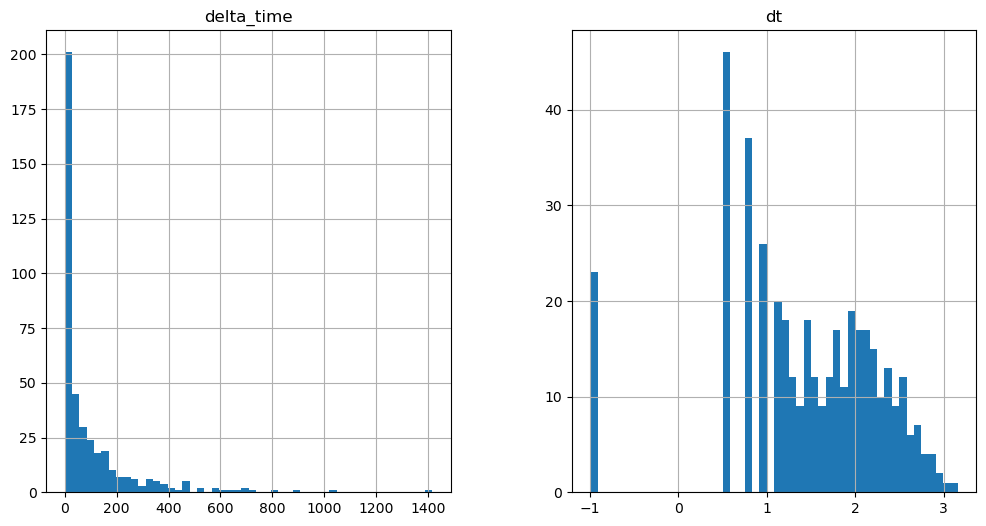

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

725.9848363399506 0.1


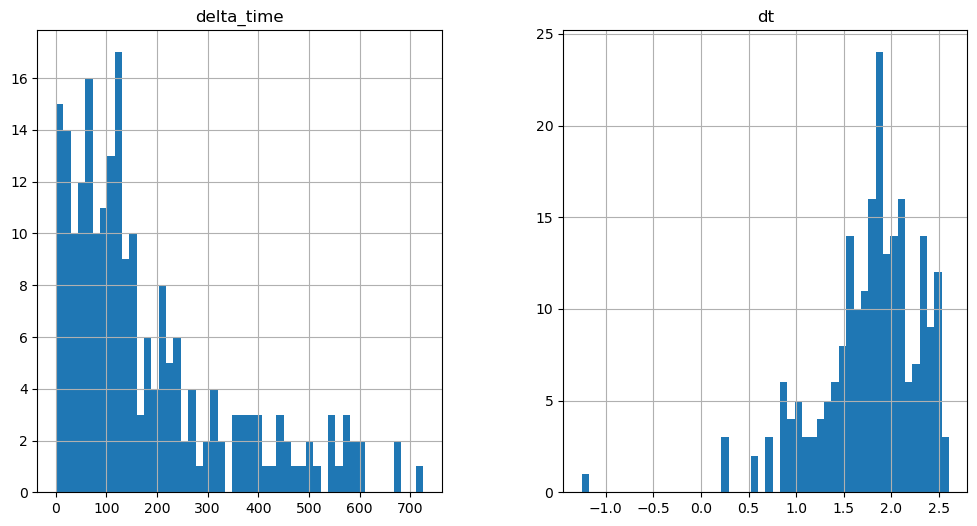

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

116.67609590291977 0.1


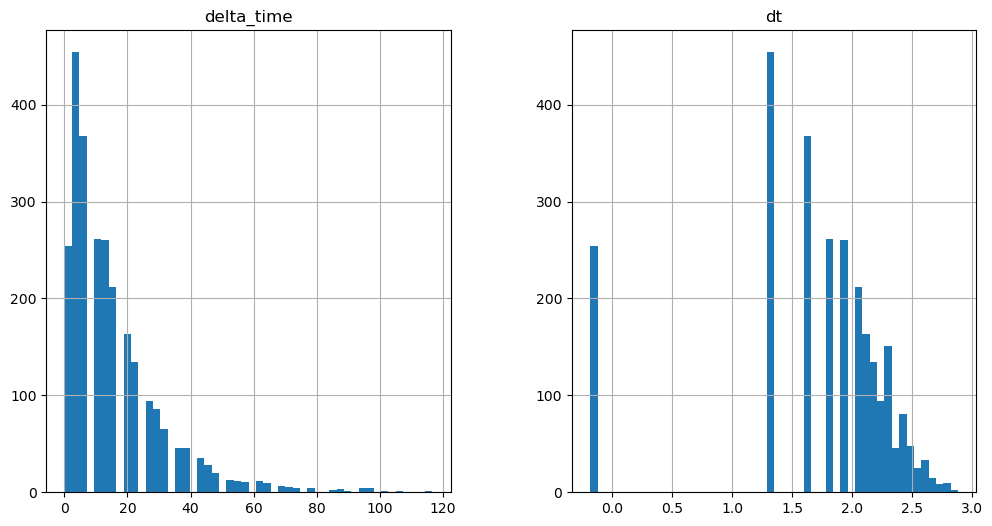

1497.3432548642159 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

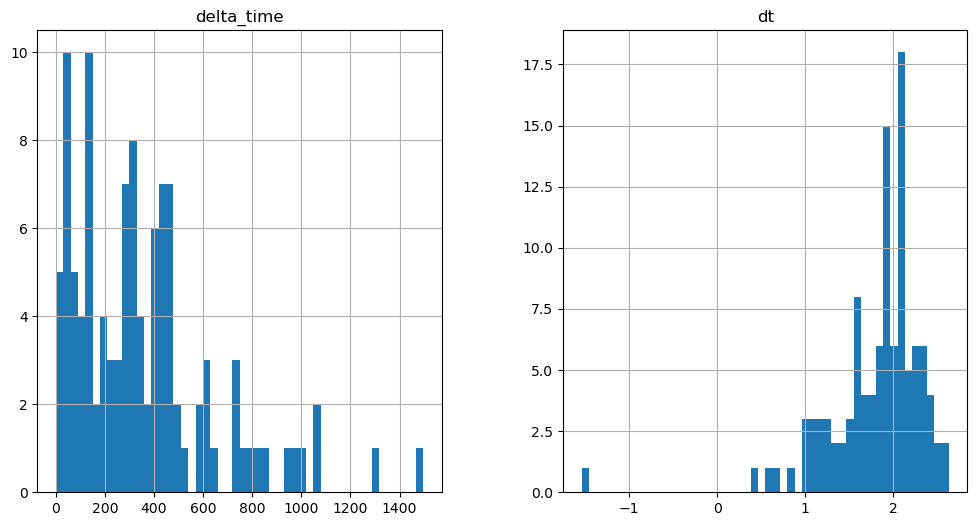

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

813.4941007494926 0.1


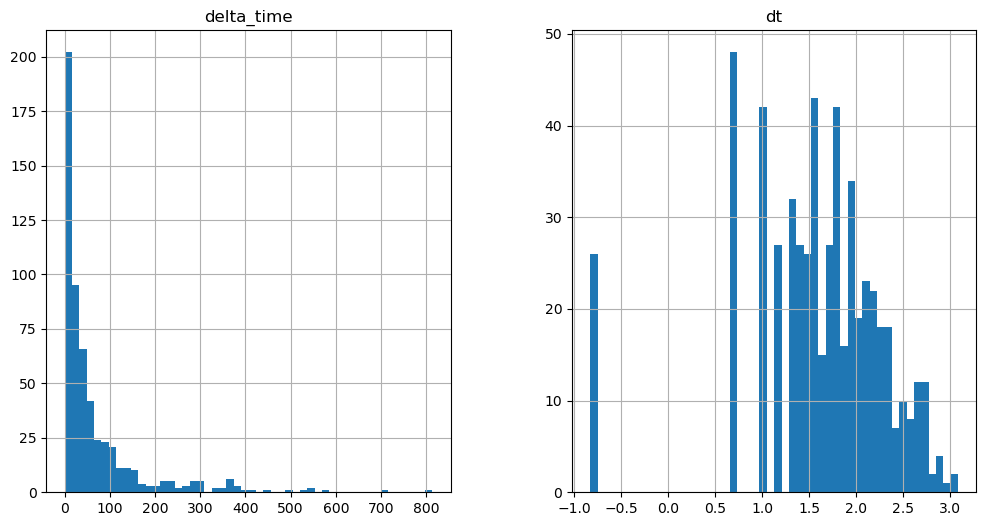

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

116.6760858297348 0.1


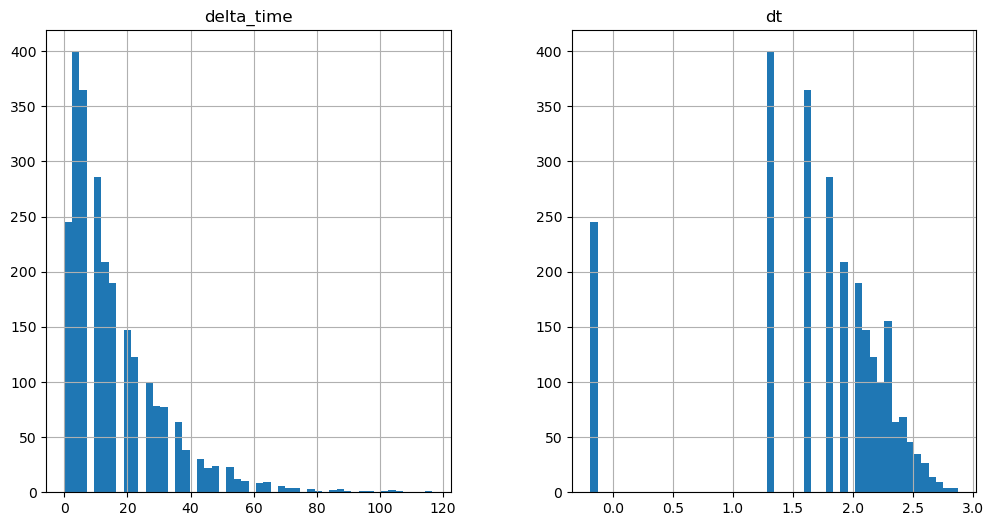

852.3836727142334 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

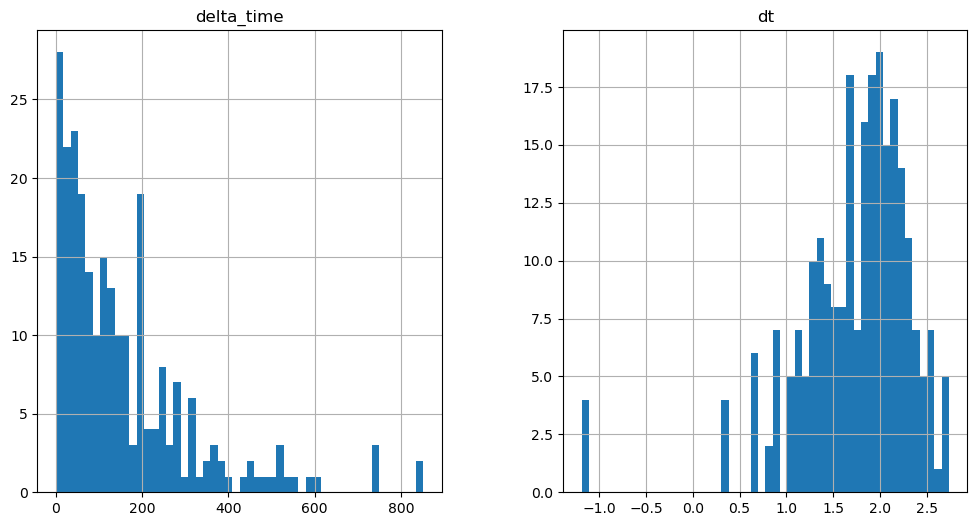

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2012.6634226441383 0.1


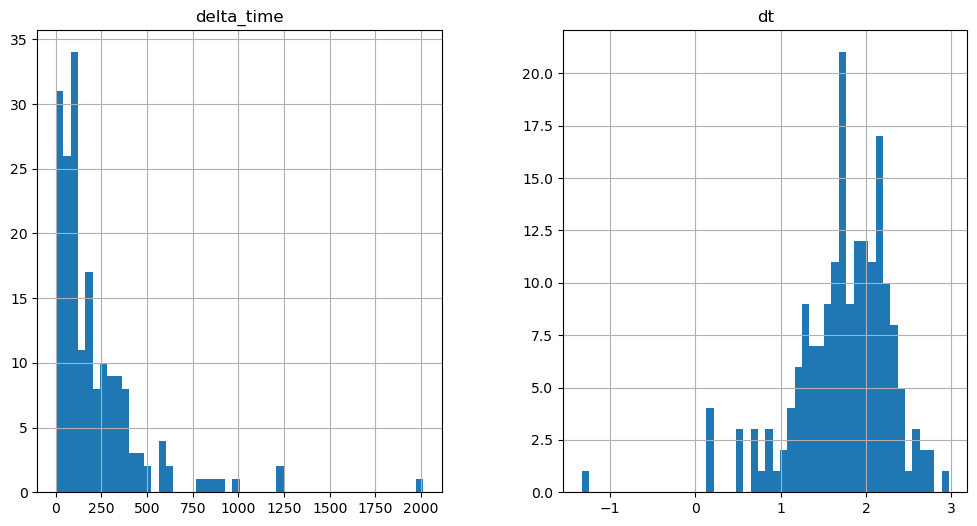

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

680.6108847856522 0.1


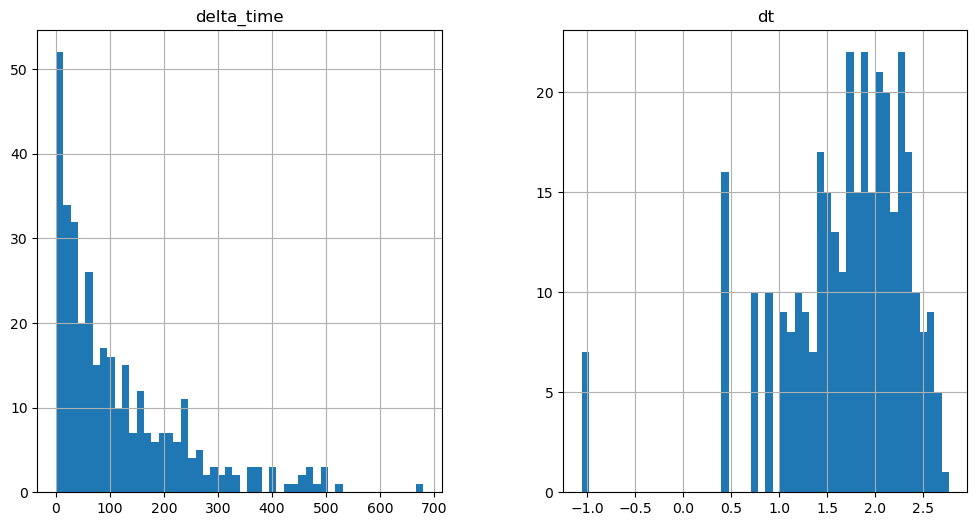

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1267.232284605503 0.1


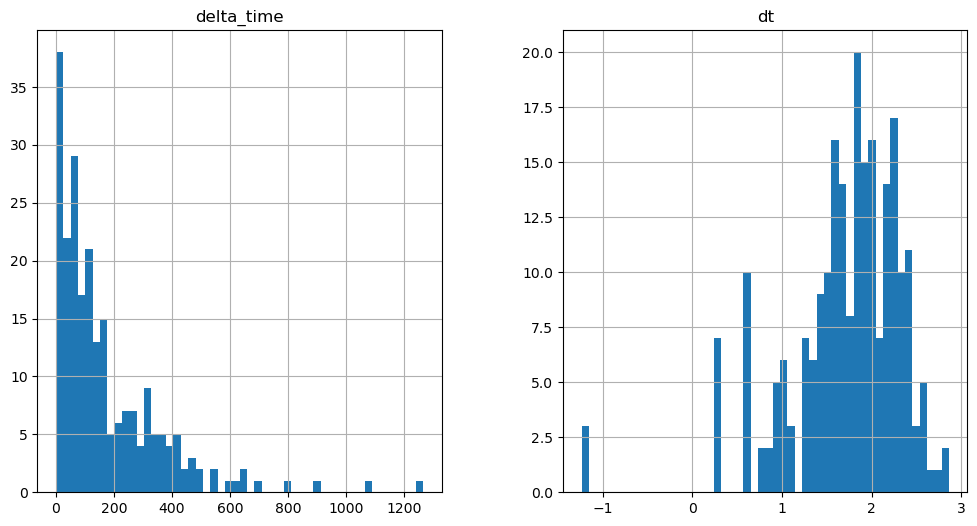

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1575.12765032053 0.1


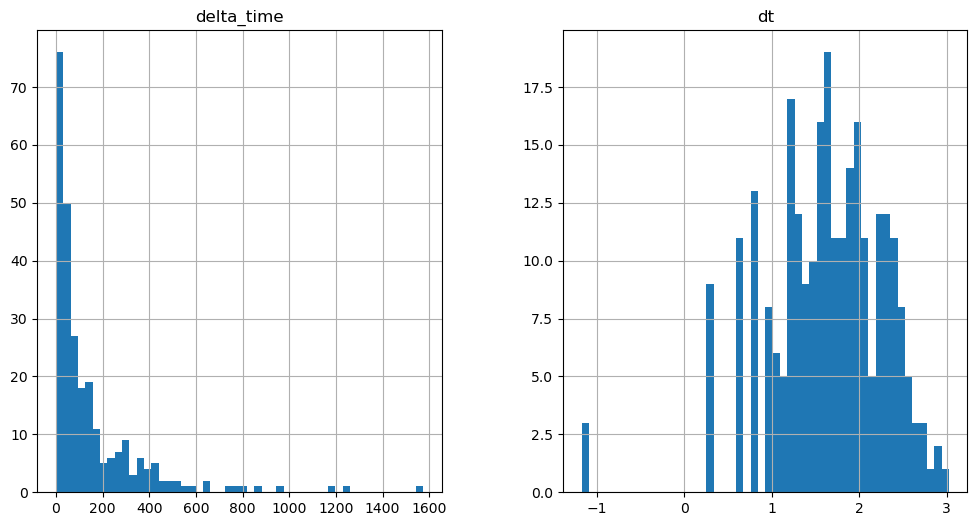

2702.997118115425 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

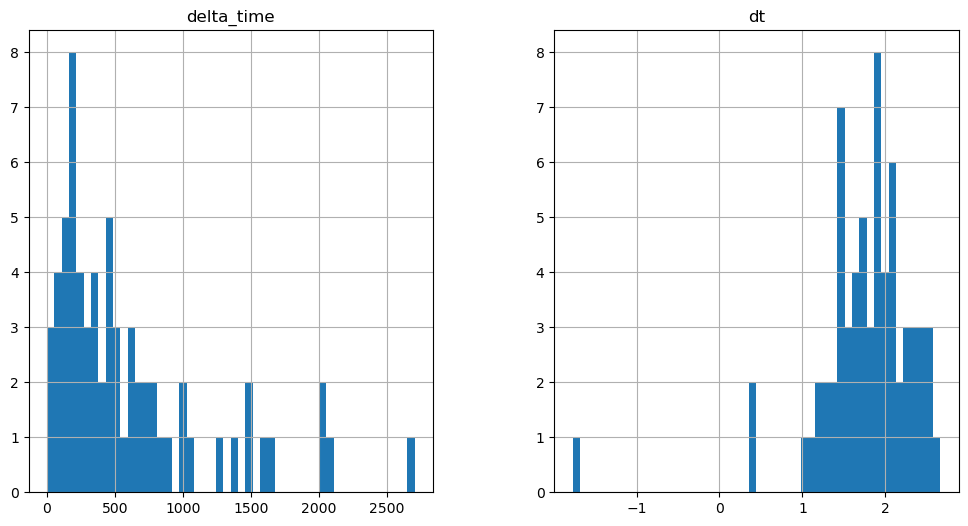

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

191.21909976005554 0.1


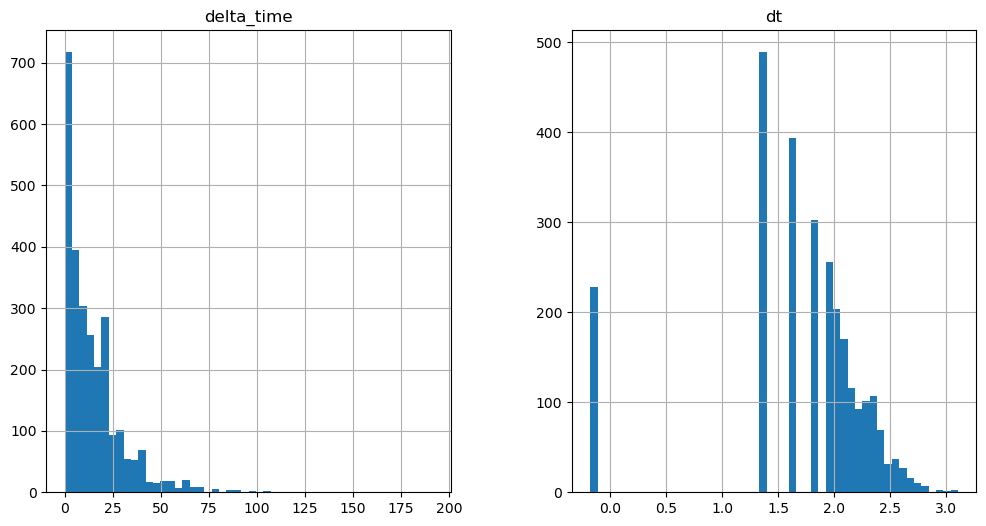

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2077.4832159876823 3.240990102291107


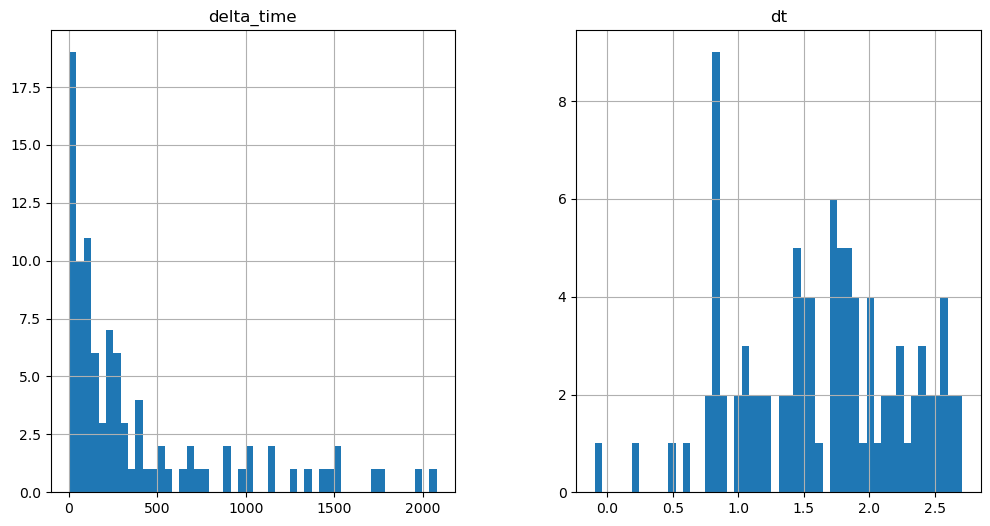

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2758.0940710306168 12.964020609855652


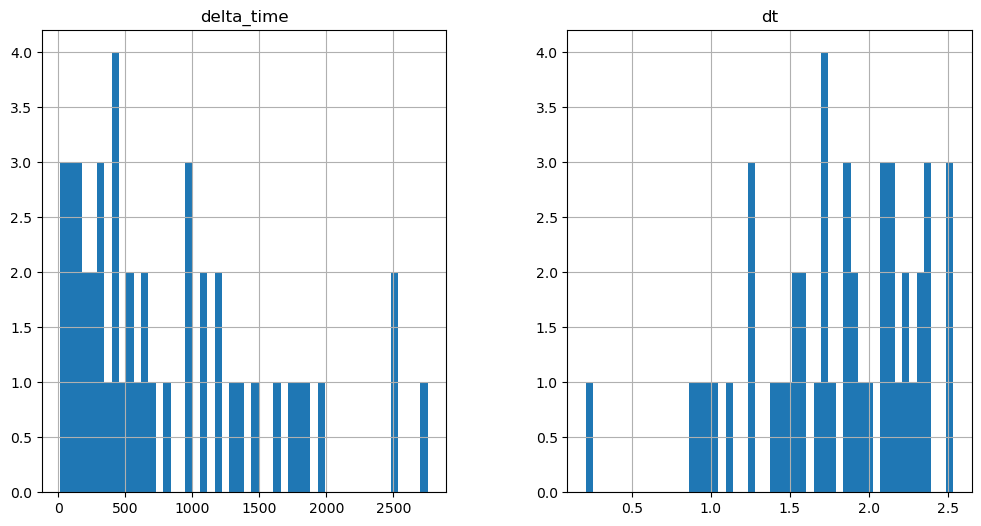

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

842.6635830402374 0.1


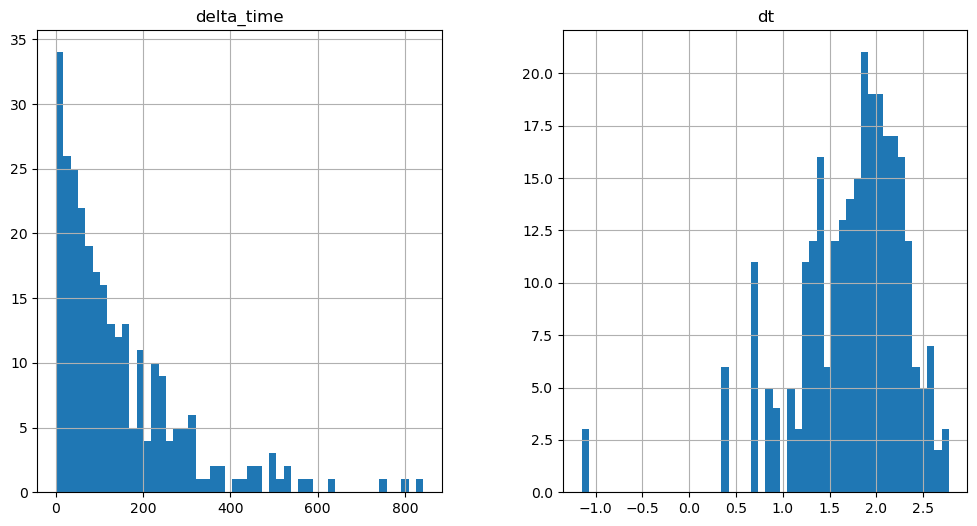

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3438.704605817795 9.723010540008545


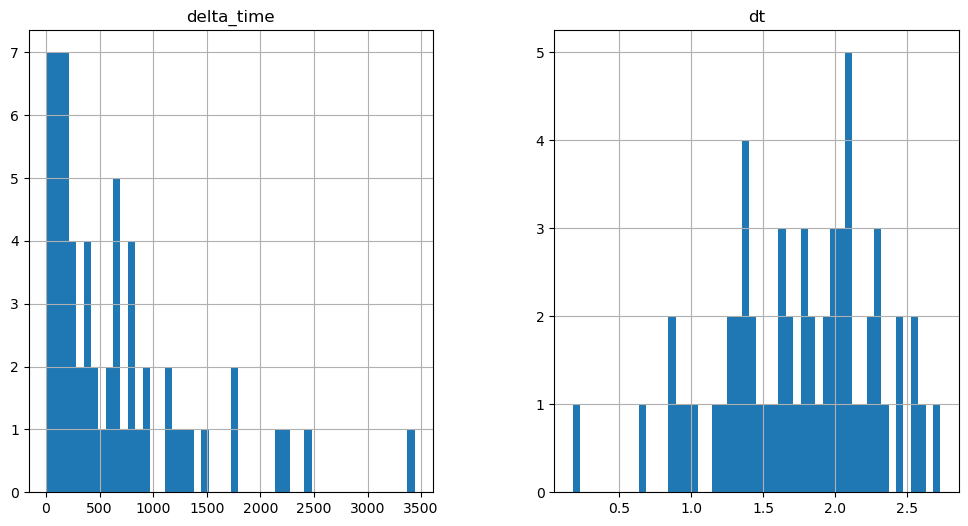

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

706.54454600811 0.1


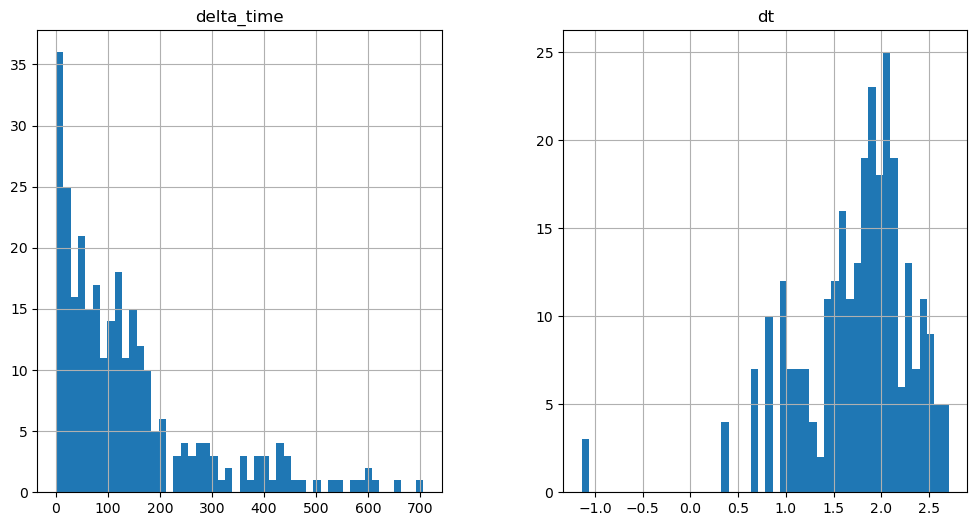

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

768.1209691762924 0.1


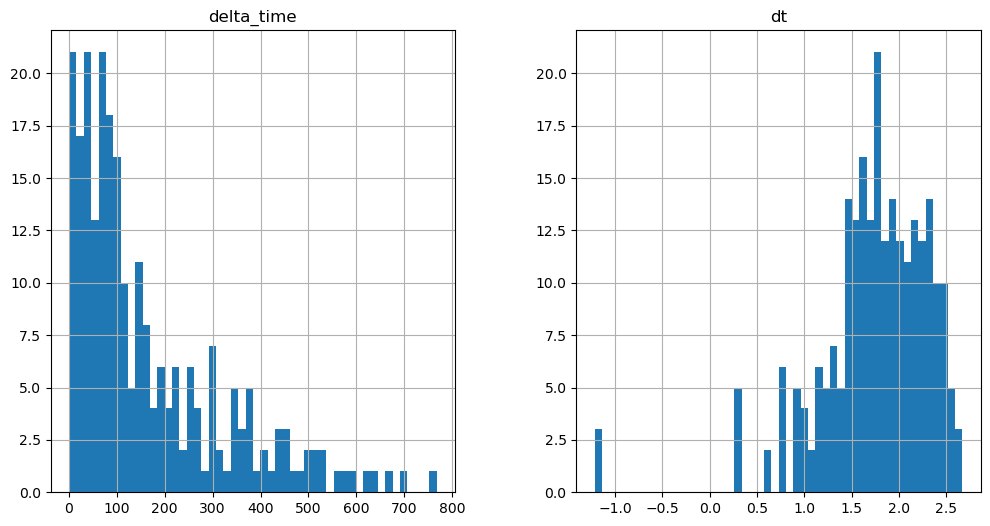

1199.171451330185 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

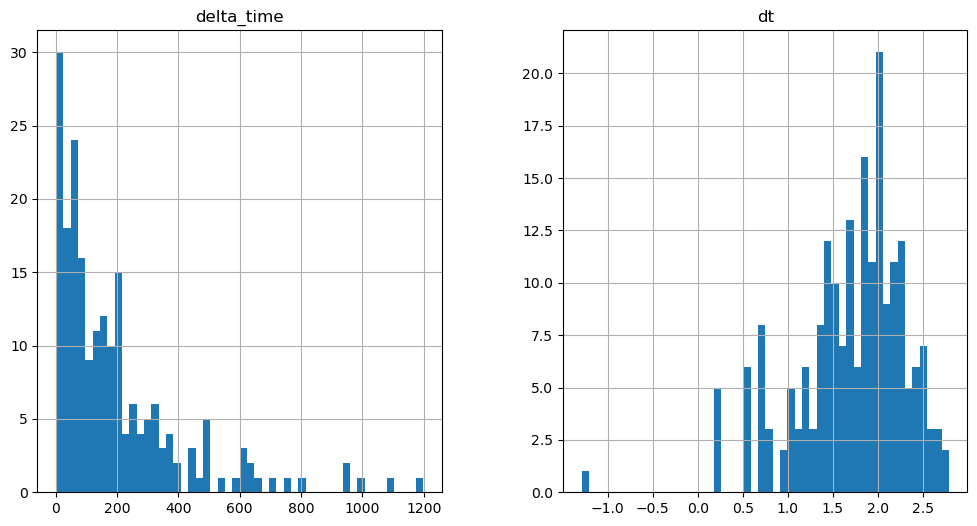

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3500.2837387919426 16.205080926418304


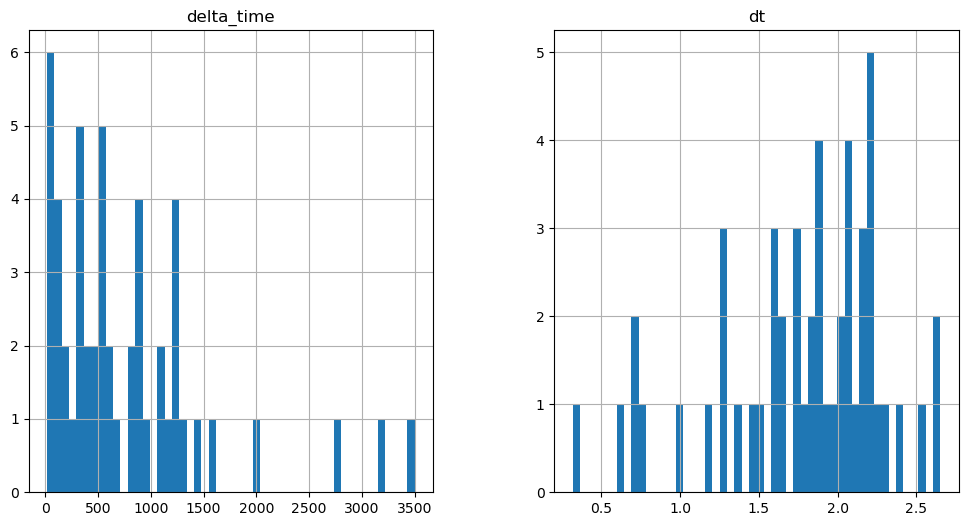

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

103.71241527795792 0.1


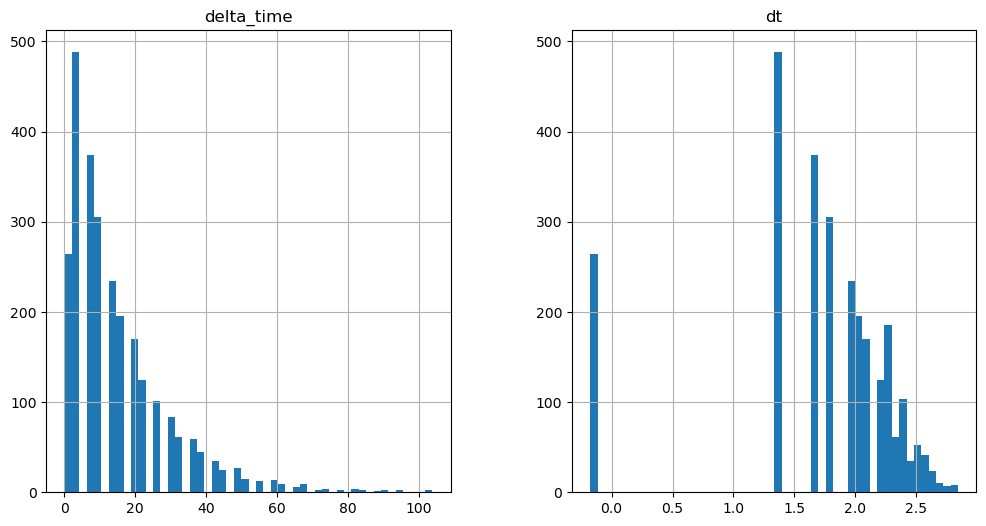

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1147.3152086734772 3.241010069847107


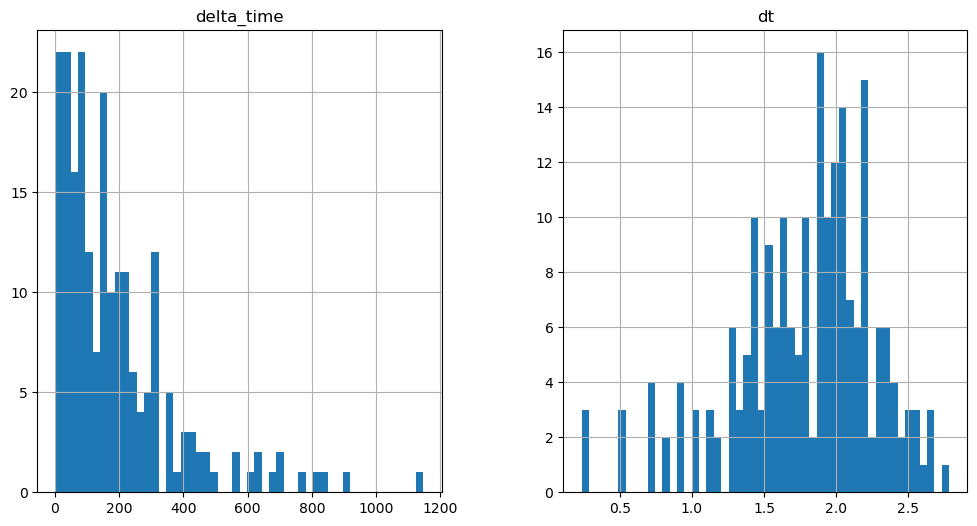

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3633.1645056009293 3.241029977798462


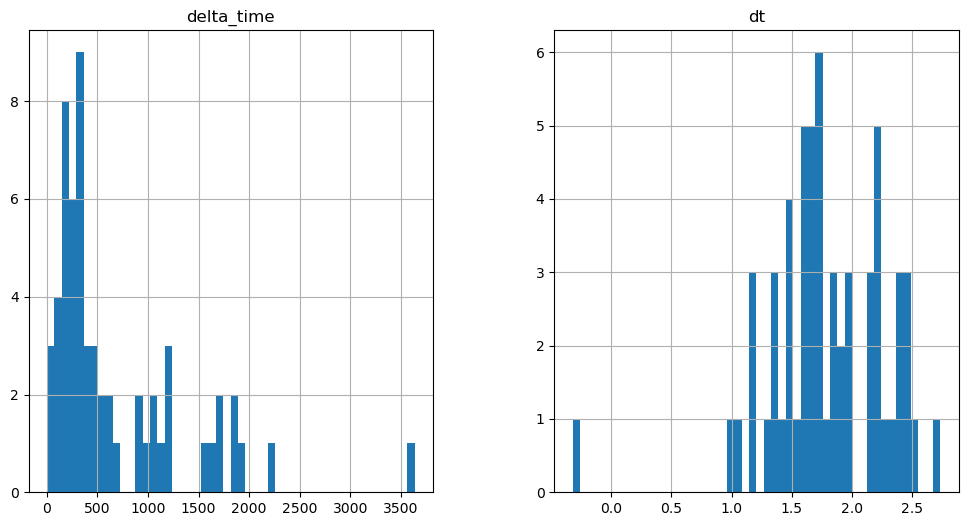

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1260.7501944303513 0.1


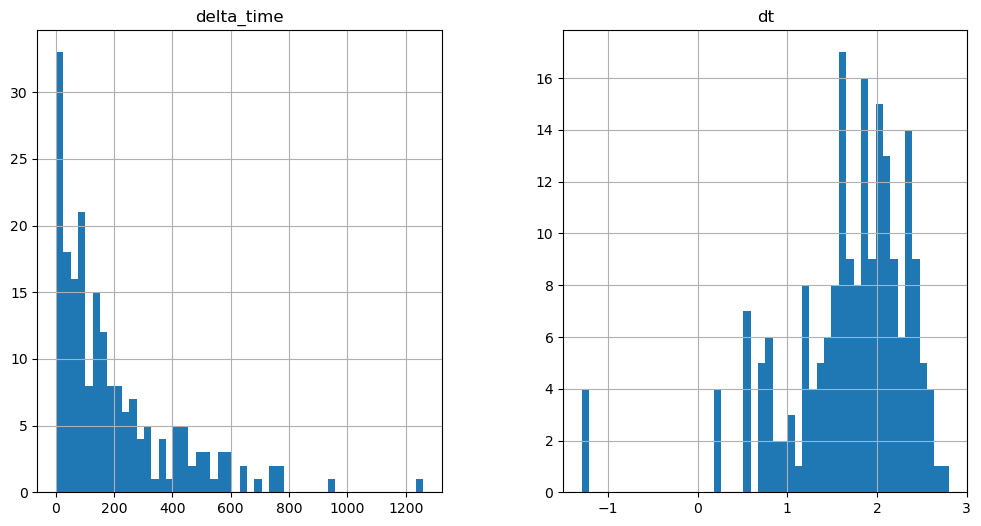

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

110.19411545991898 0.1


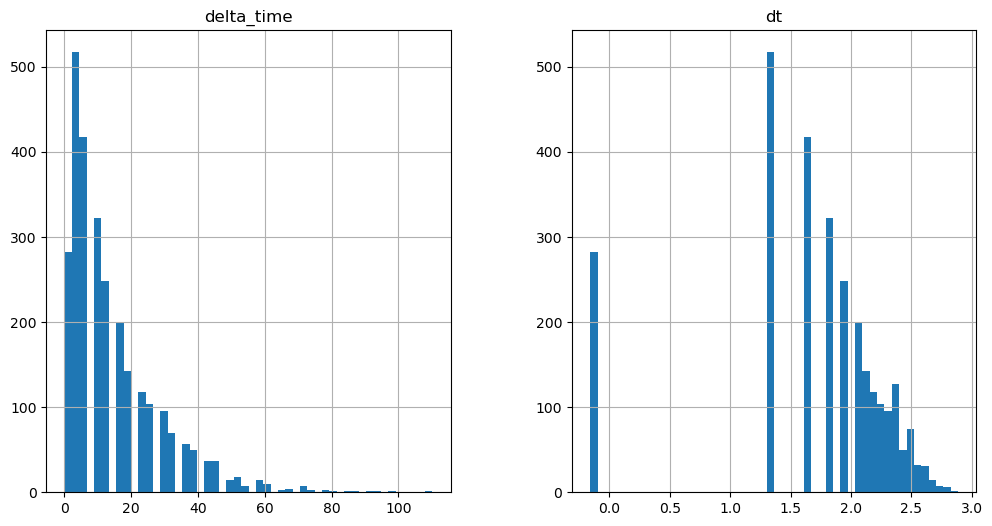

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2103.410937488079 0.1


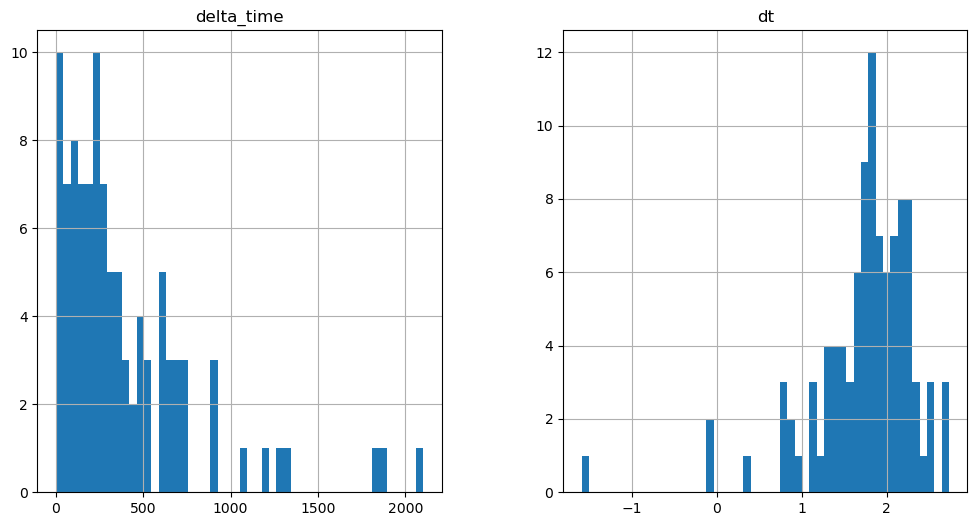

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2822.9135943055153 3.2410202026367188


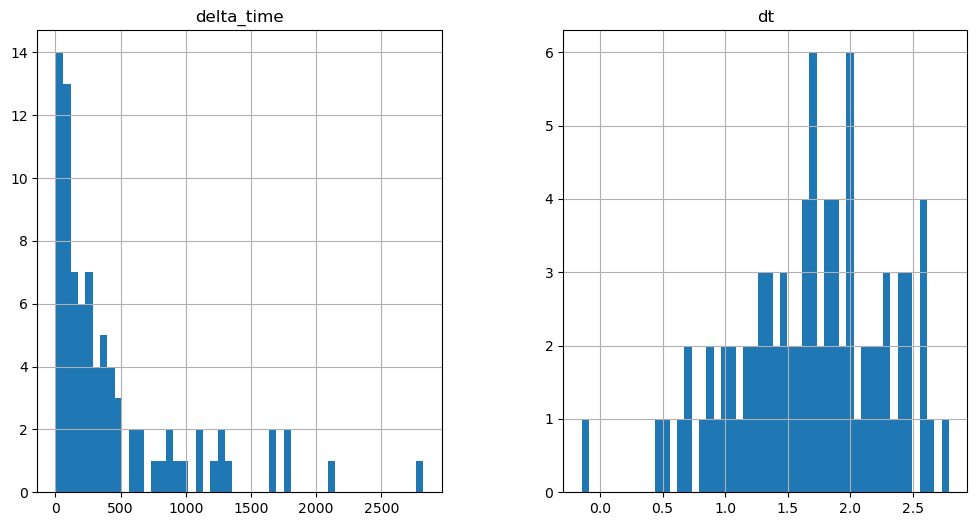

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

405.12537068128586 0.1


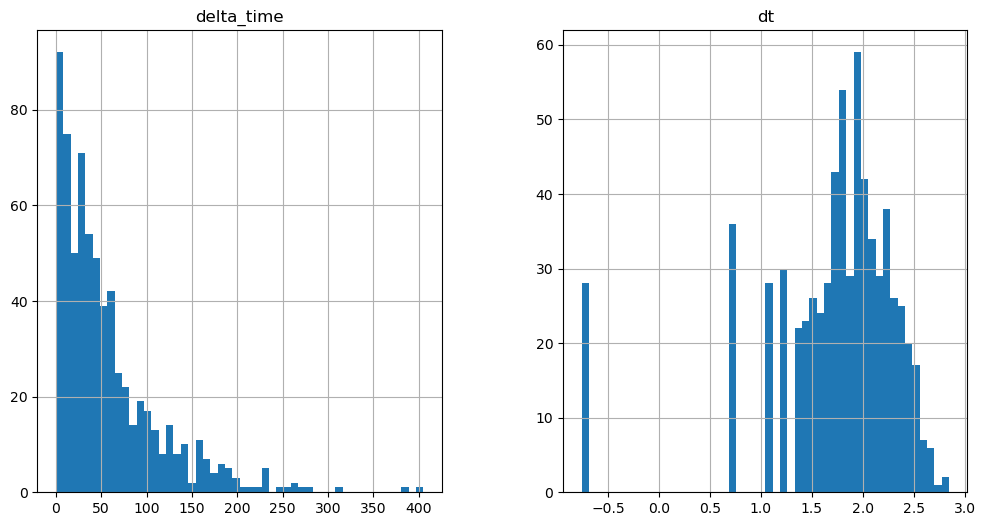

116.67612588405609 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

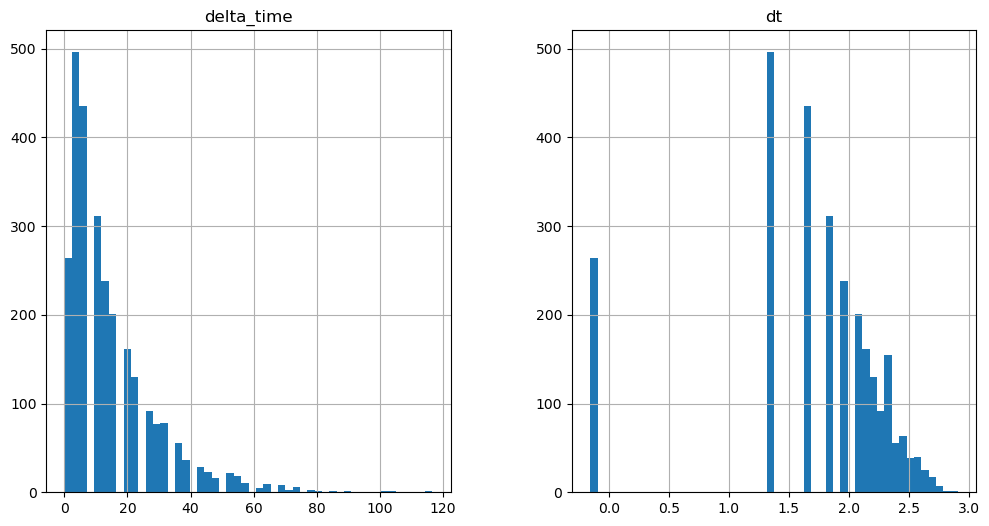

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1464.933344900608 0.1


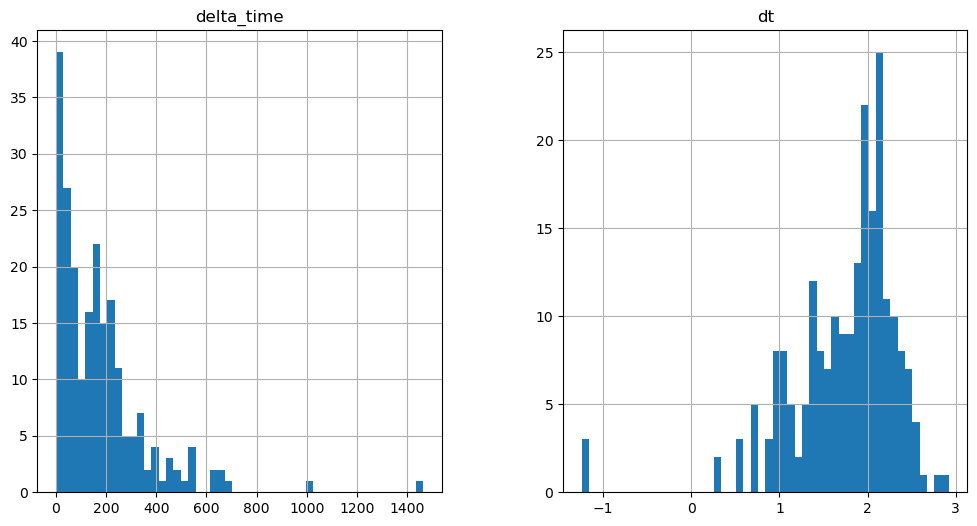

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

343.5463076233864 0.1


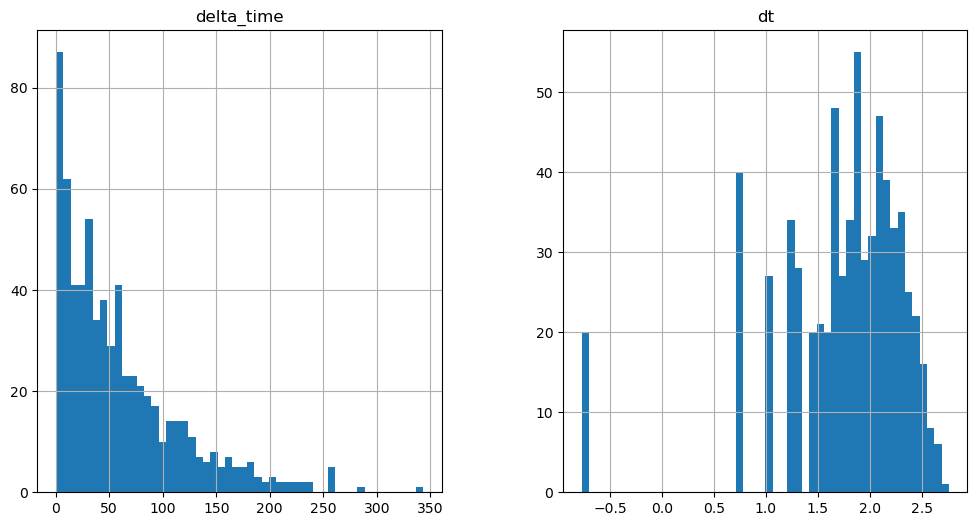

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1131.109997868538 3.240990161895752


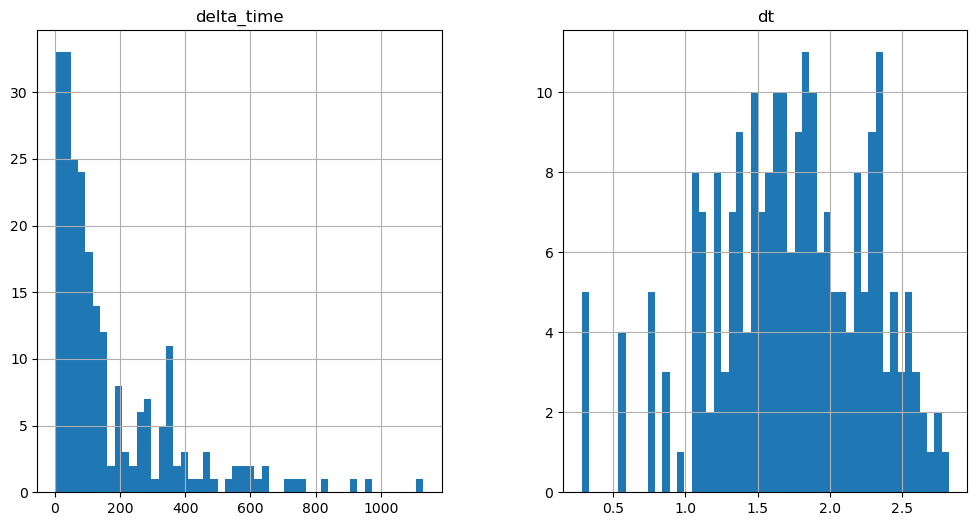

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))


116.67639595270157 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["E"] = np.log10(df_id["energy"])


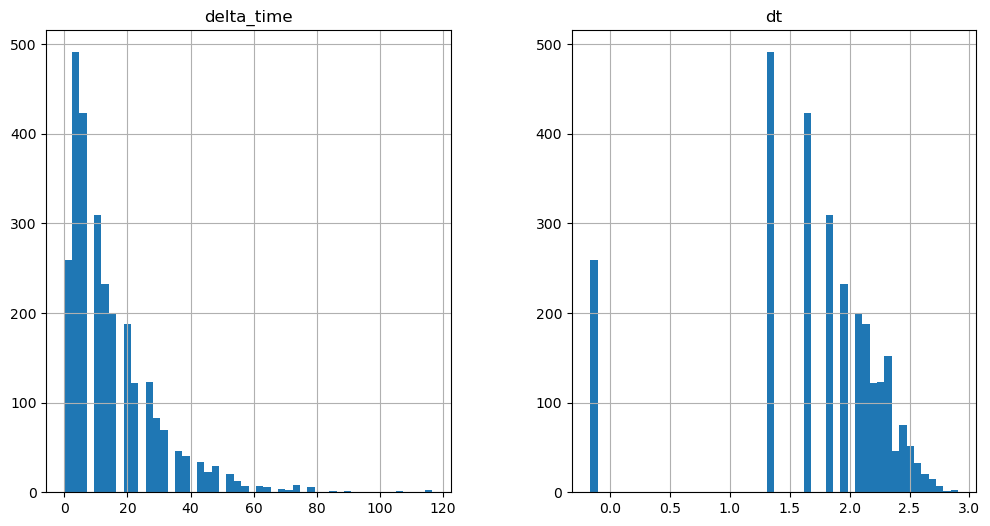

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1072.7719948887825 0.1


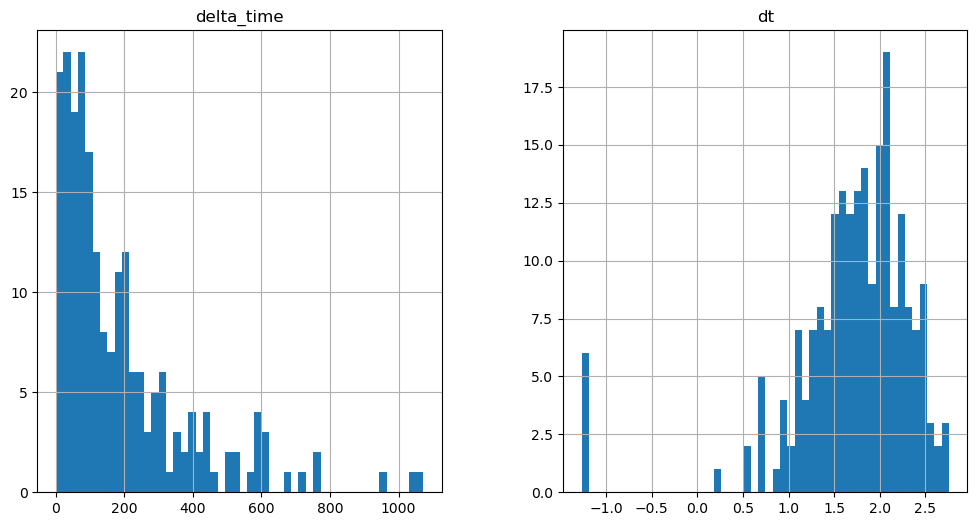

2427.5112342834473 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

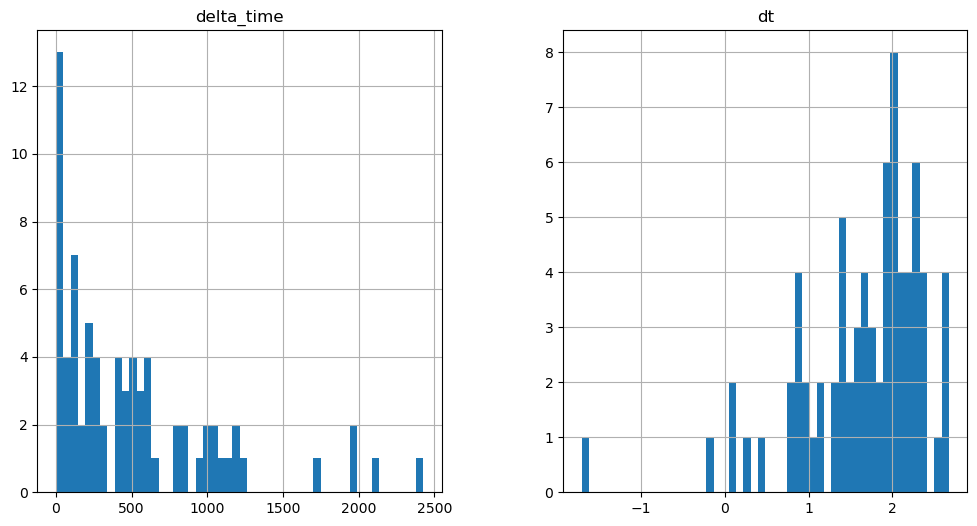

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

875.0708547830582 0.1


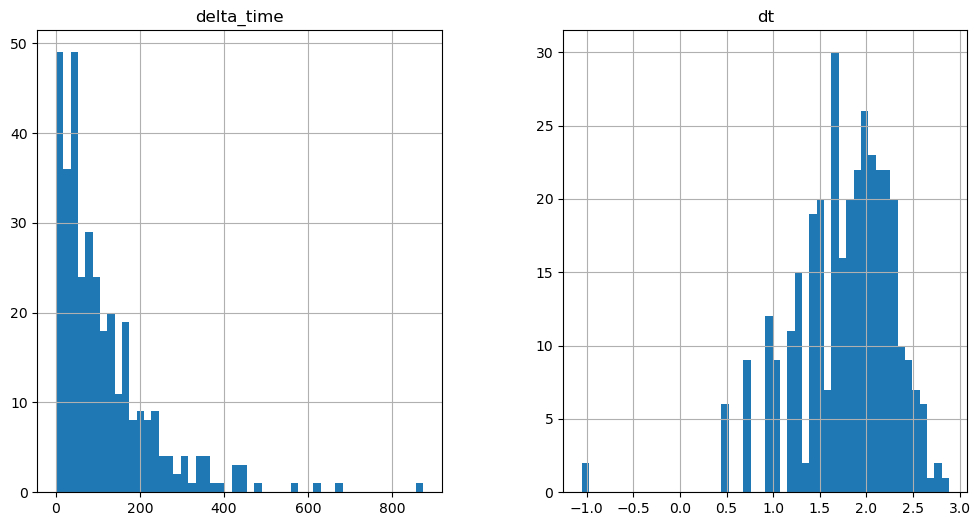

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

952.8613173961639 0.1


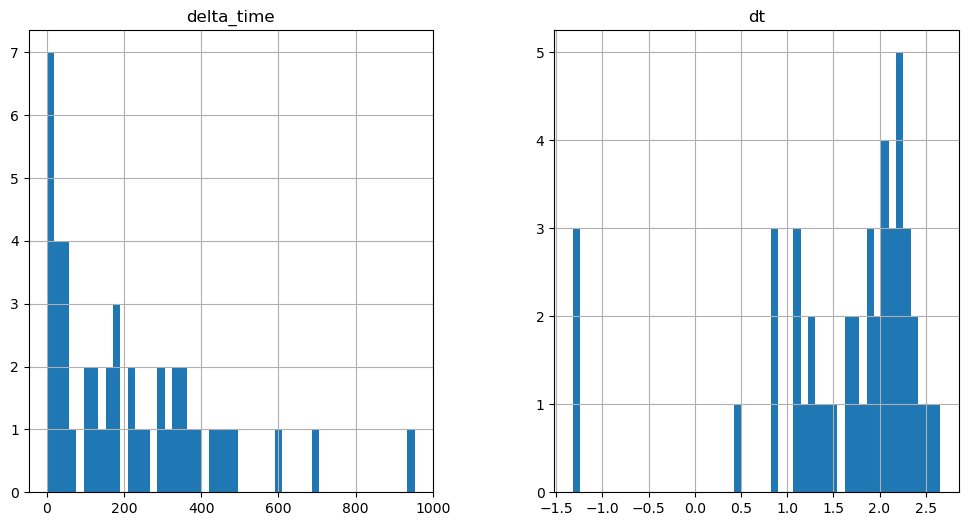

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

693.5792044997215 6.48205029964447


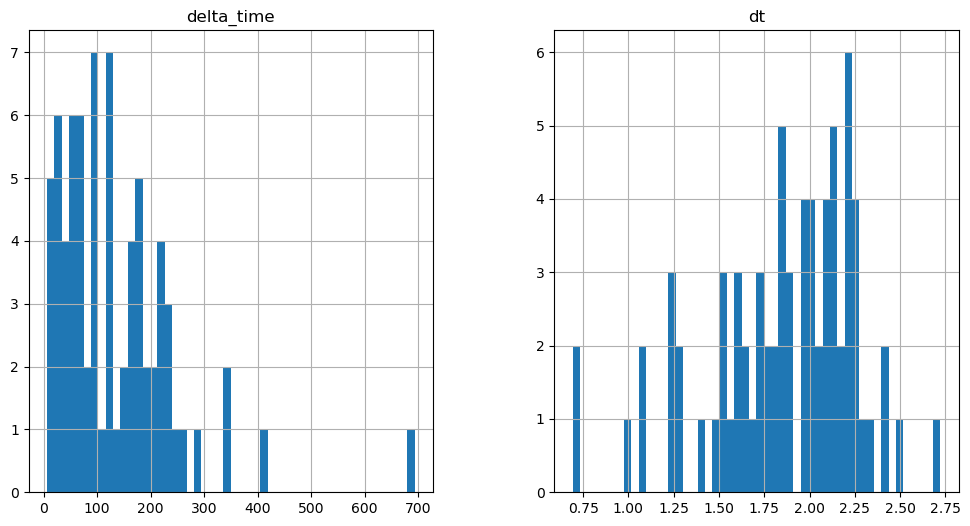

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

311.1383954882622 0.1


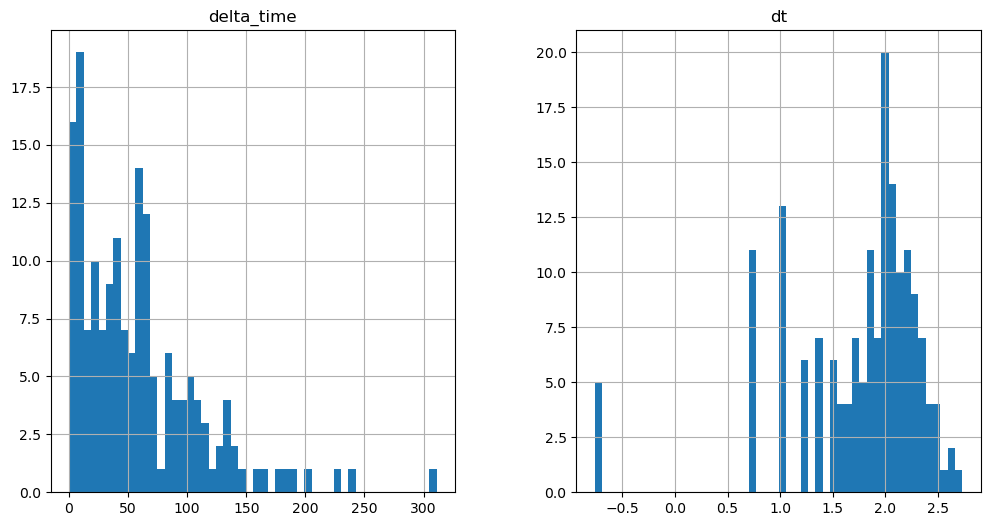

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

47.11502242088318 0.1


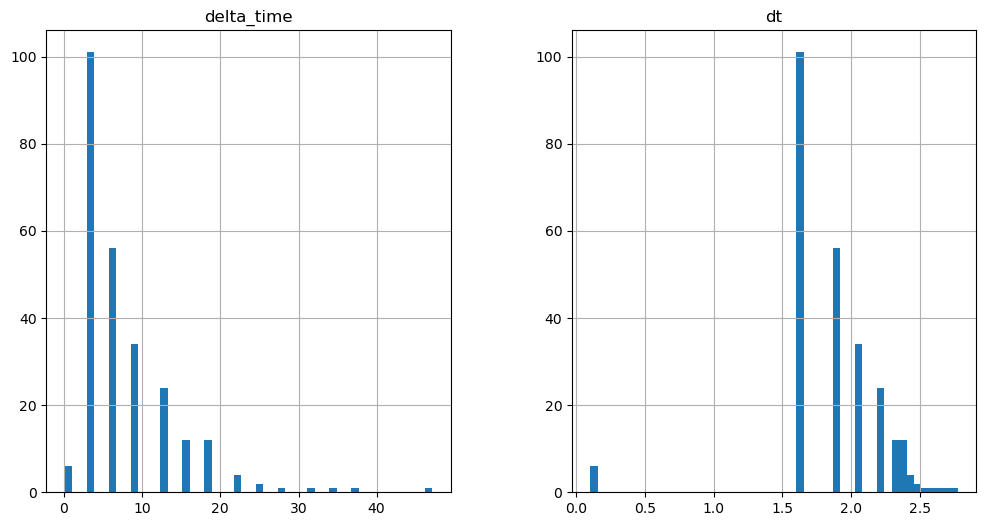

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

37.69202196598053 0.1


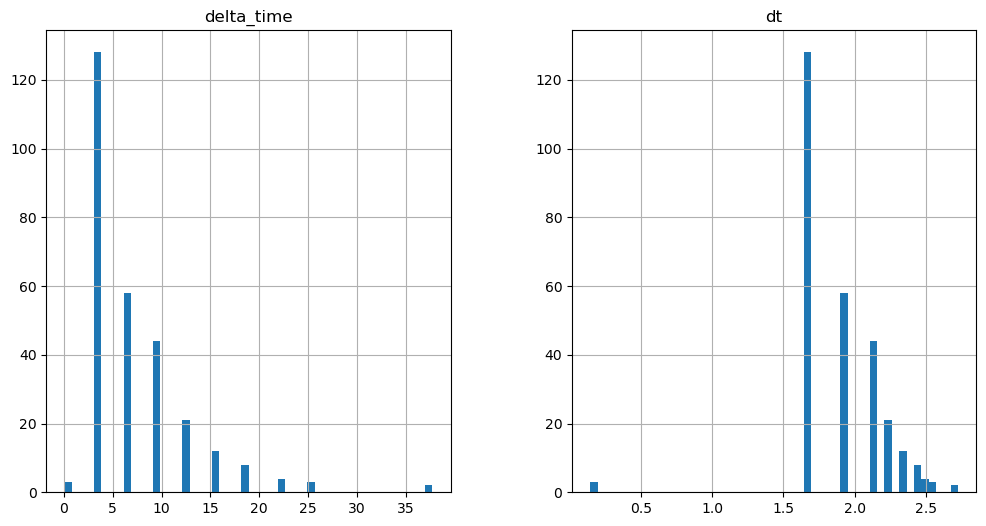

31.410191655158997 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

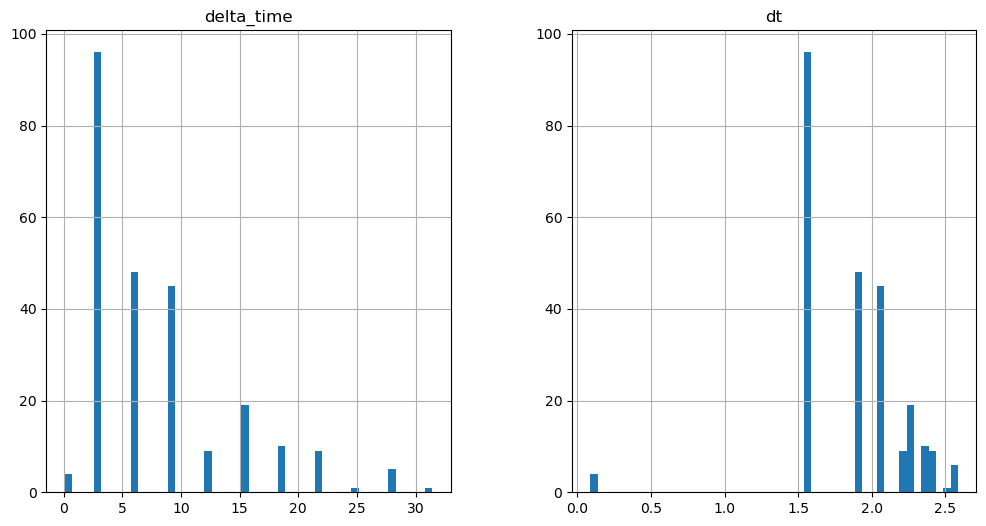

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

37.69216185808182 0.1


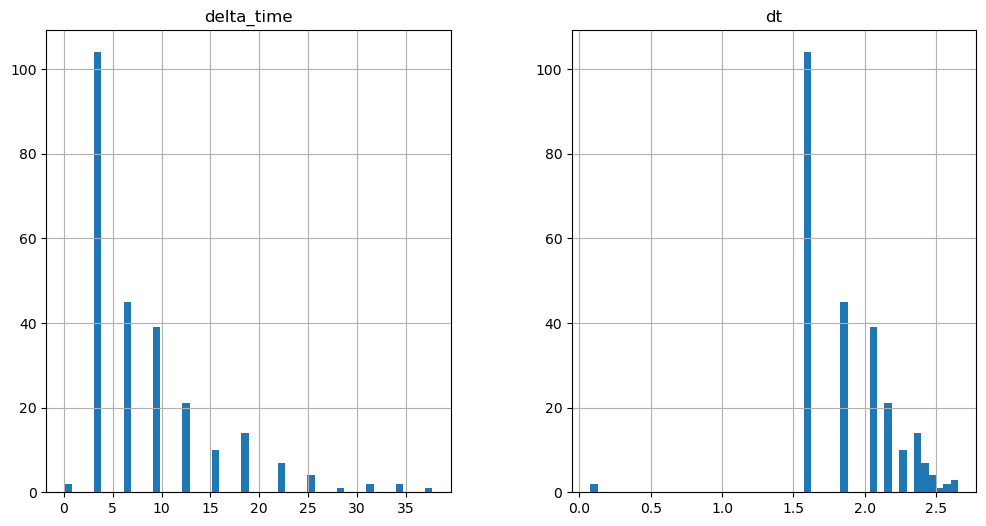

59.679082810878754 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

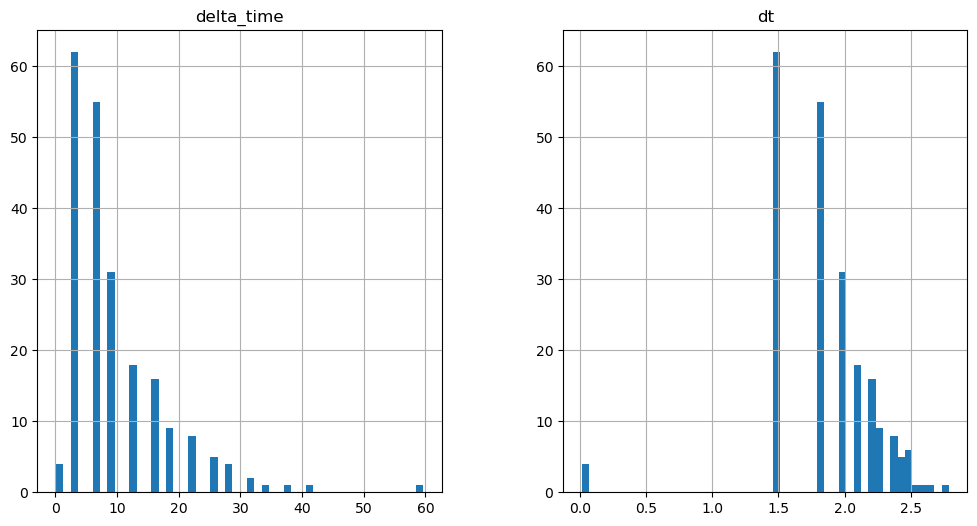

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/Users/steven/opt/anaconda3/envs/ciao-4.15/lib/python3.10/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

191.60232949256897 -2041.6637516617775


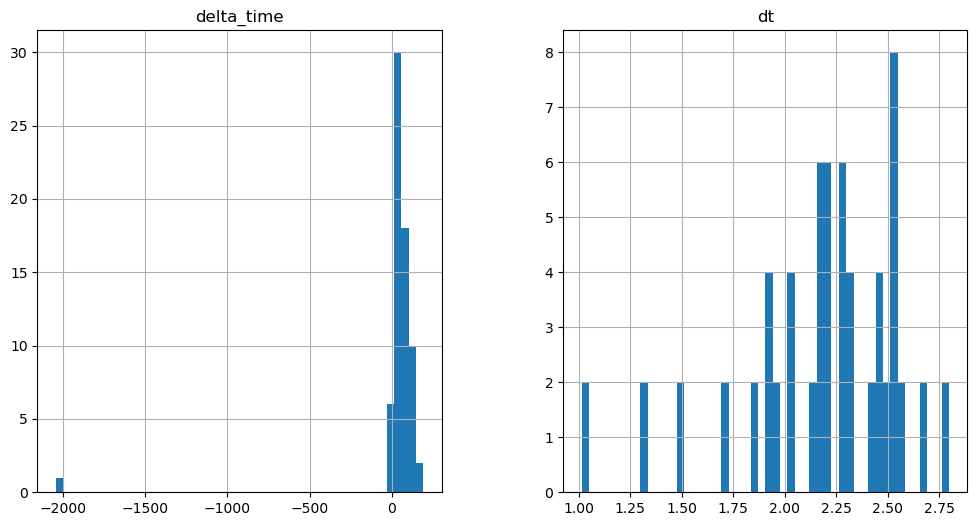

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

84.80704414844513 3.140860676765442


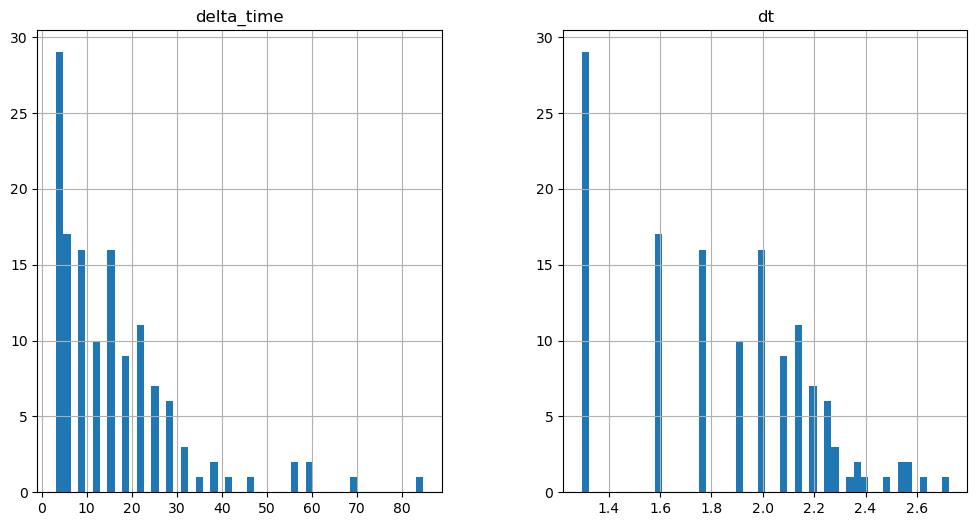

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

81.6661040186882 0.1


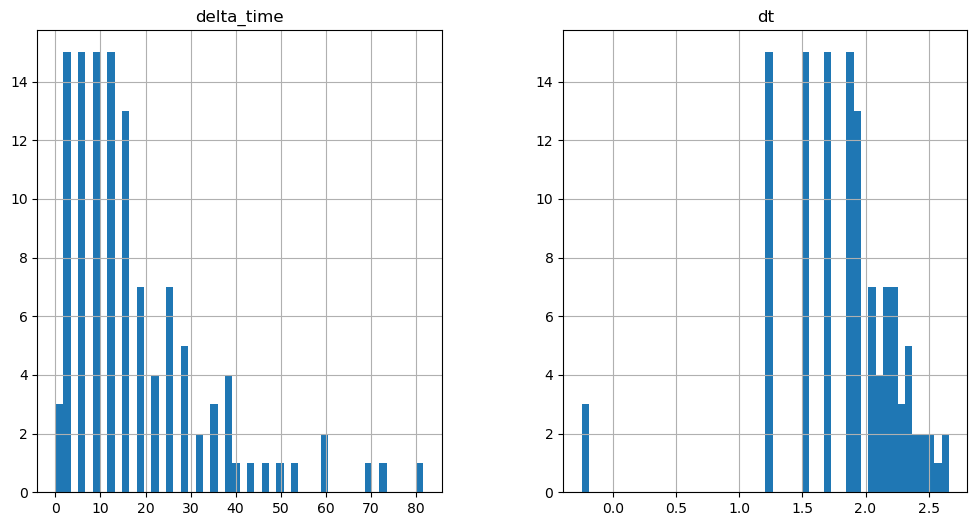

81.66603398323059 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

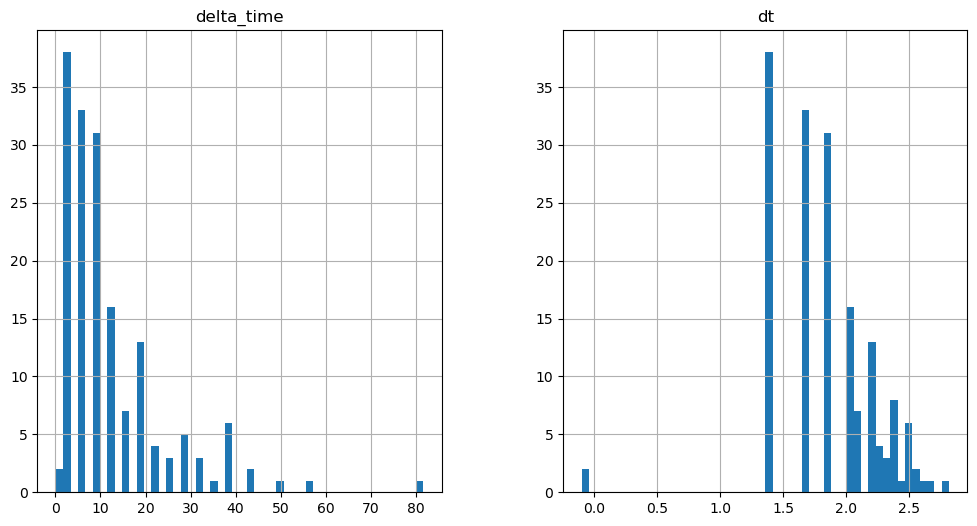

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

56.53801292181015 0.1


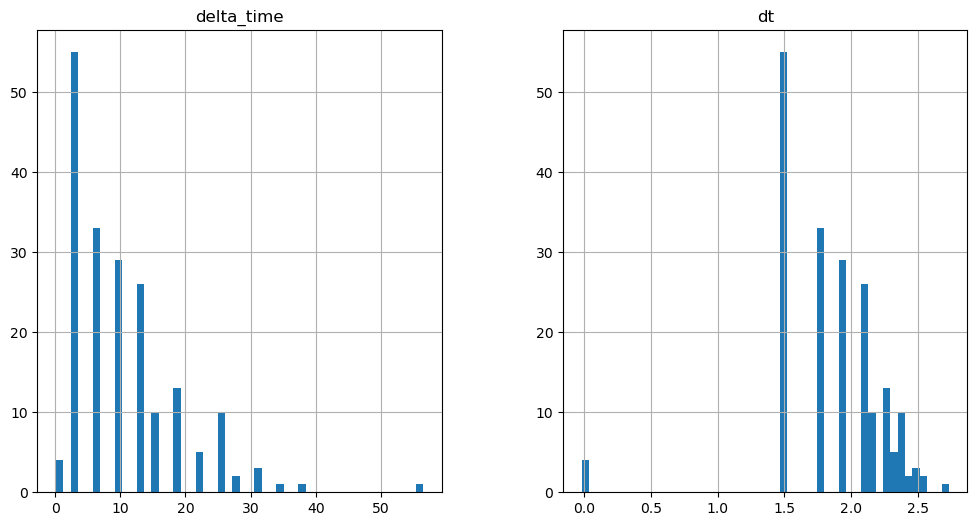

128.7810963988304 3.140990197658539


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

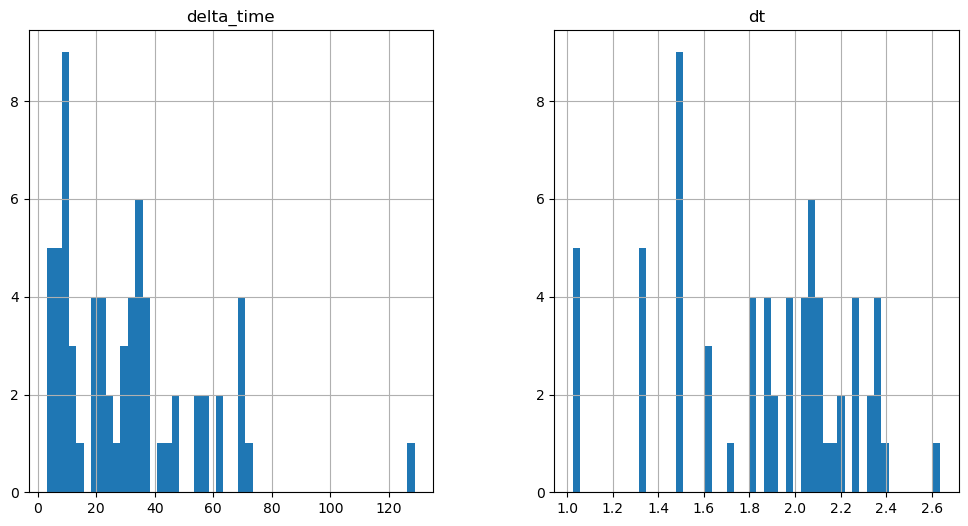

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

106.7940753698349 0.1


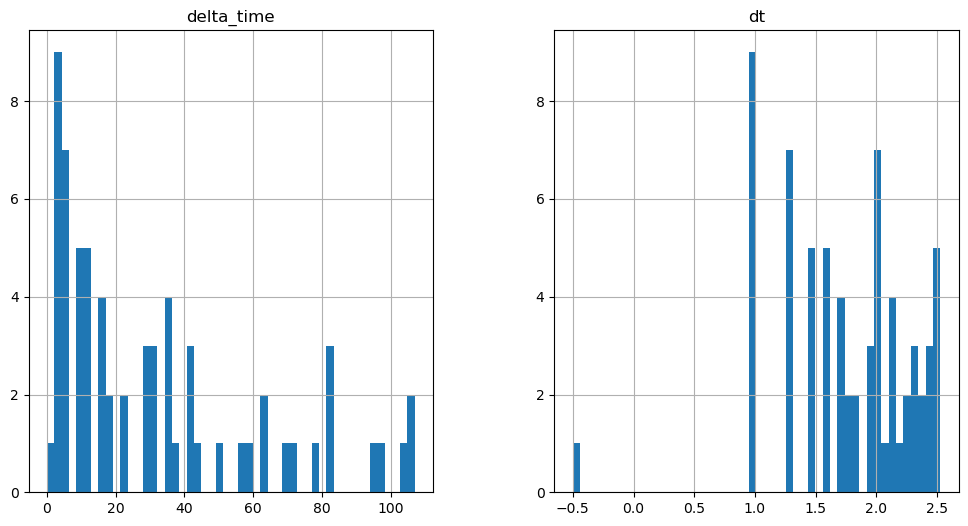

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

69.10224348306656 0.1


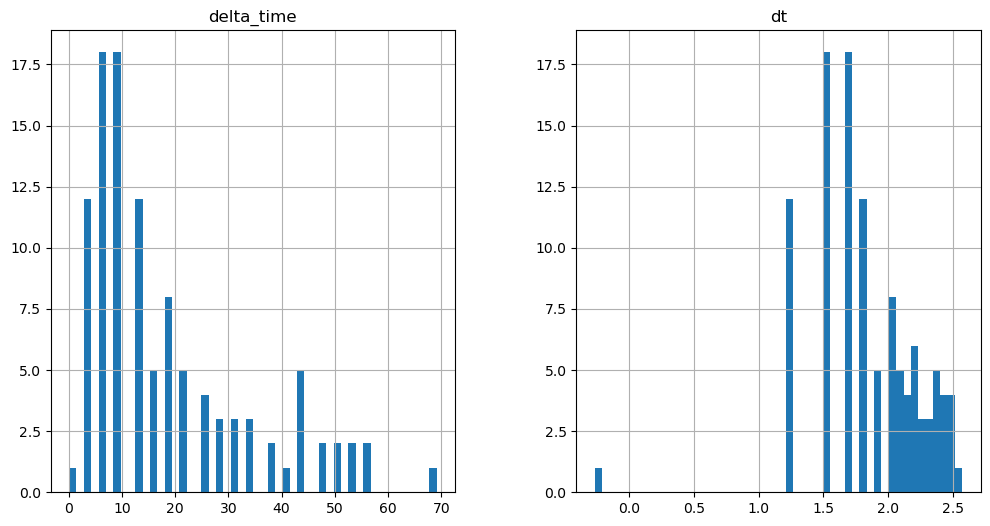

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

260.70321291685104 3.141010105609894


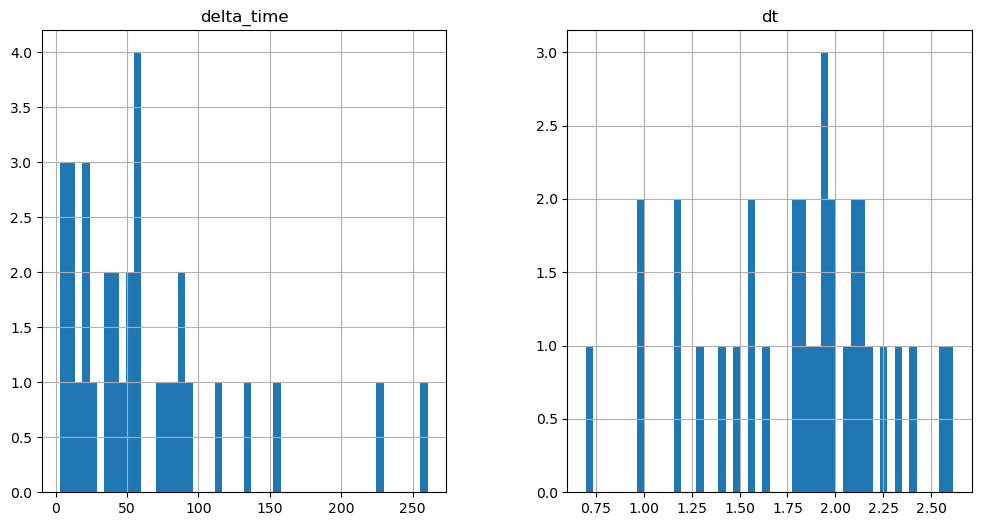

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

179.03723847866058 3.141010046005249


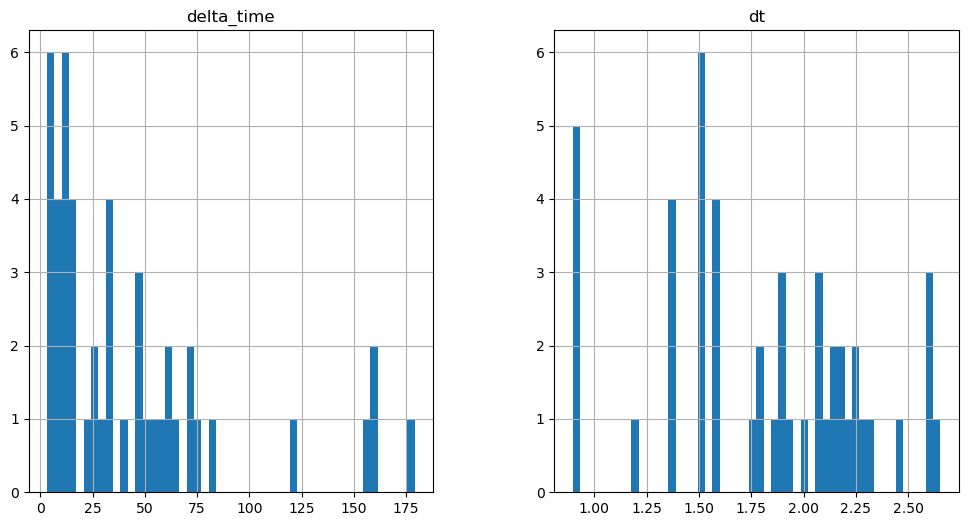

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

621.9226308465004 0.1


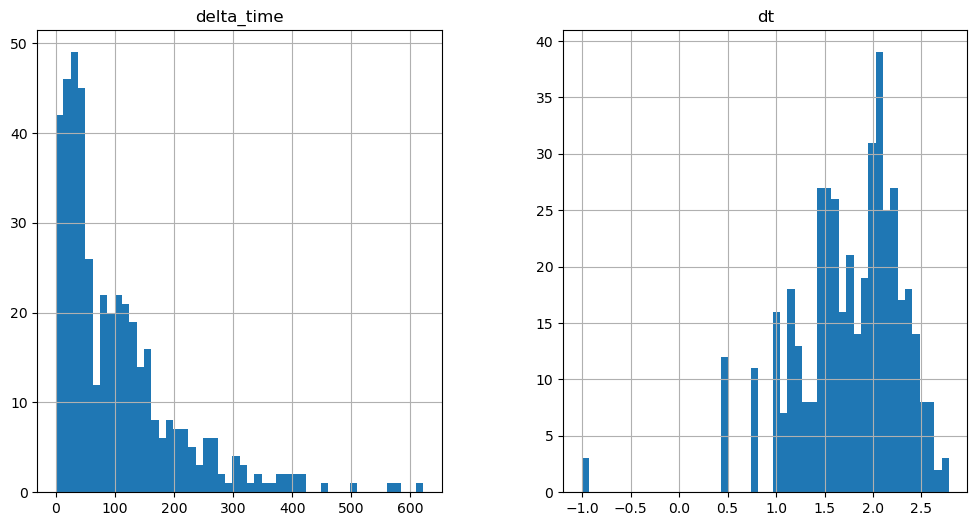

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3681.2787729501724 6.282050311565399


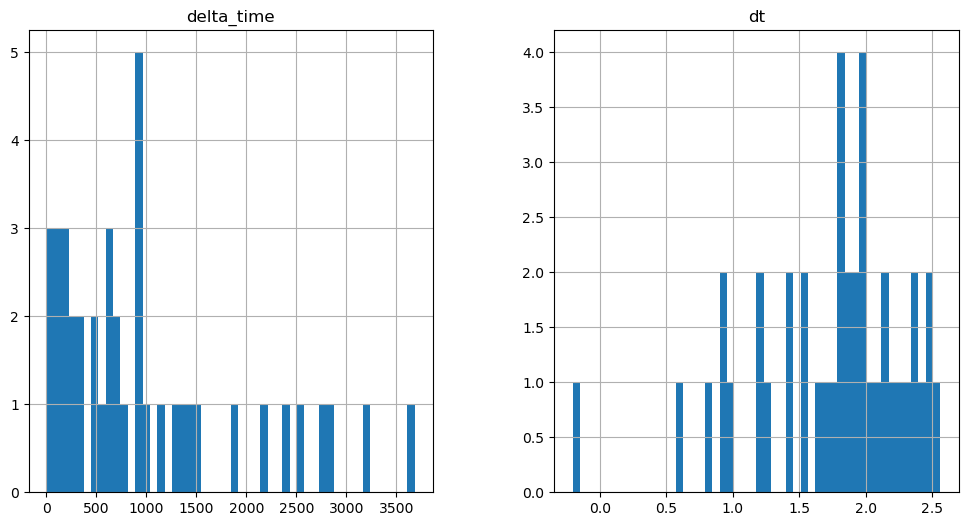

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1089.9348942637444 0.1


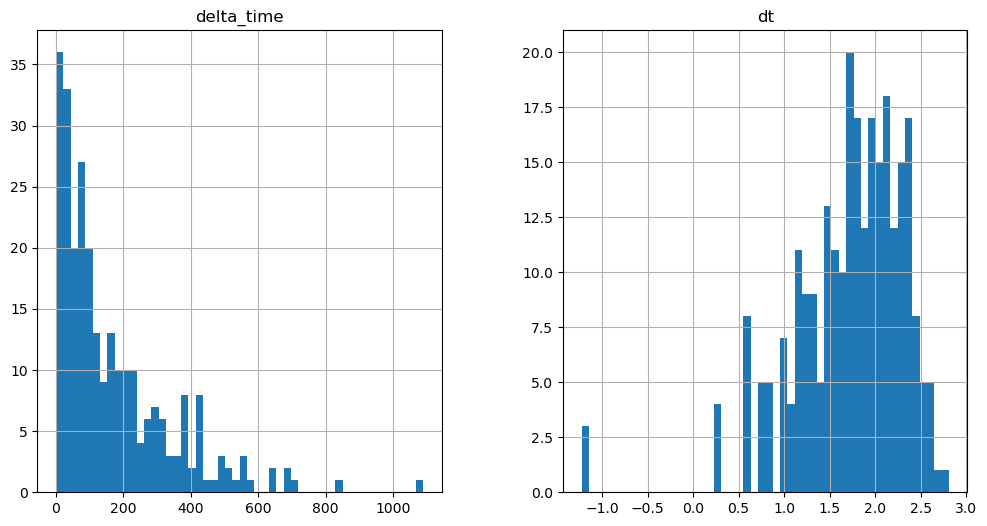

1457.4347923398018 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

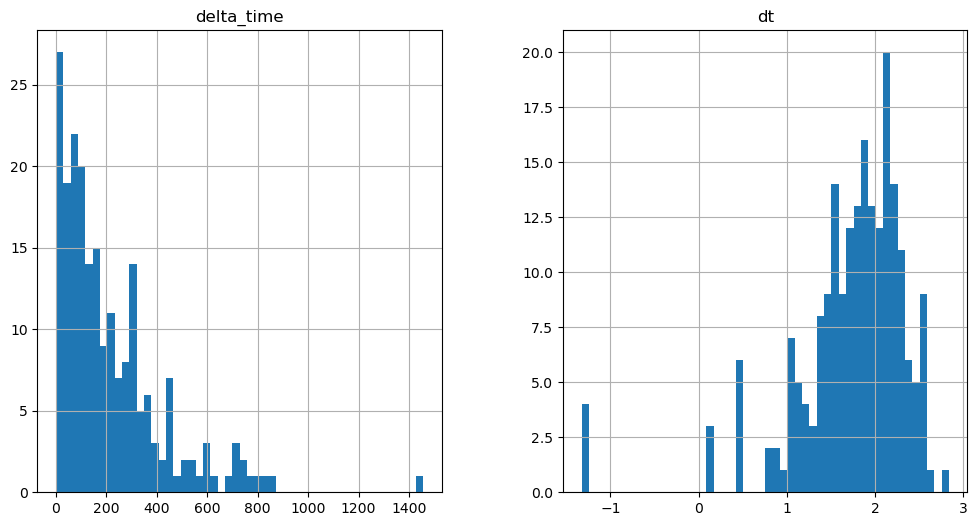

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5603.5834285616875 144.48700720071793


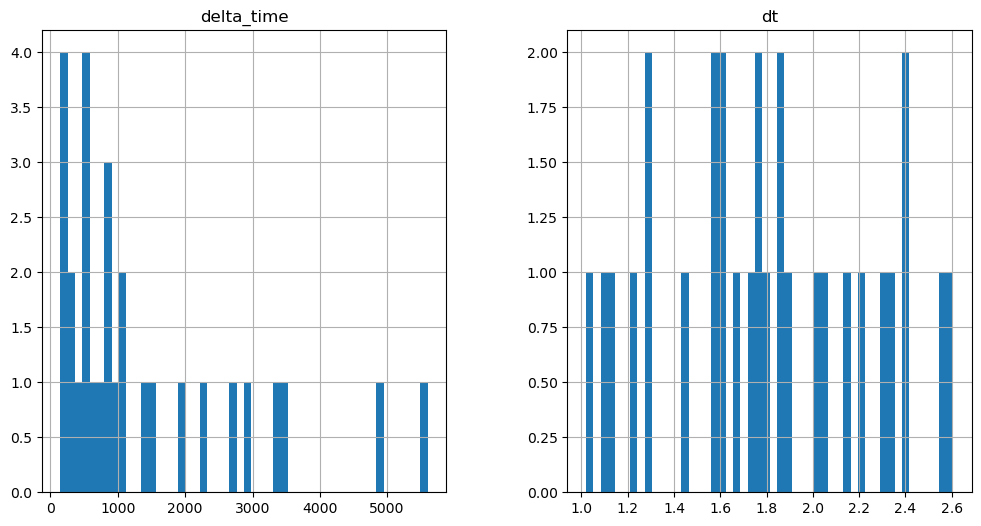

4422.561969935894 153.9102275967598


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

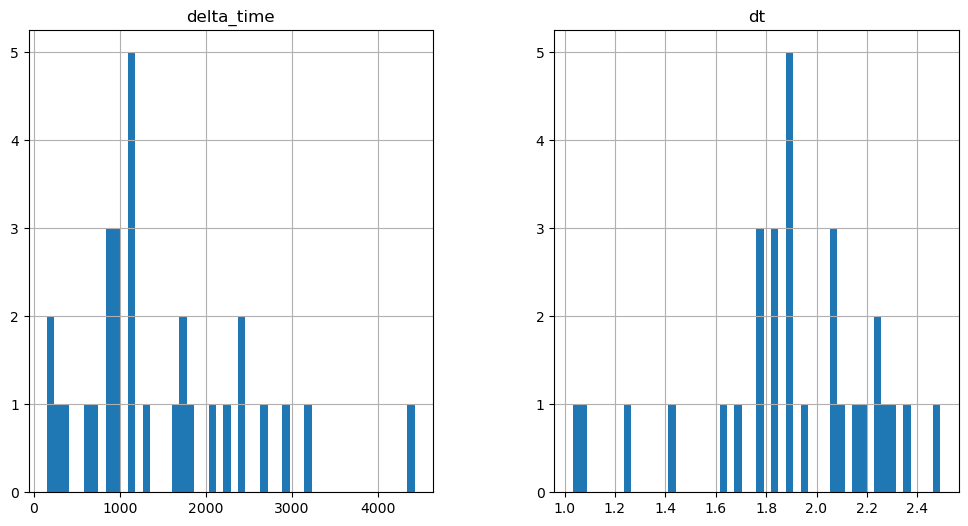

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2248.972181916237 3.1410300731658936


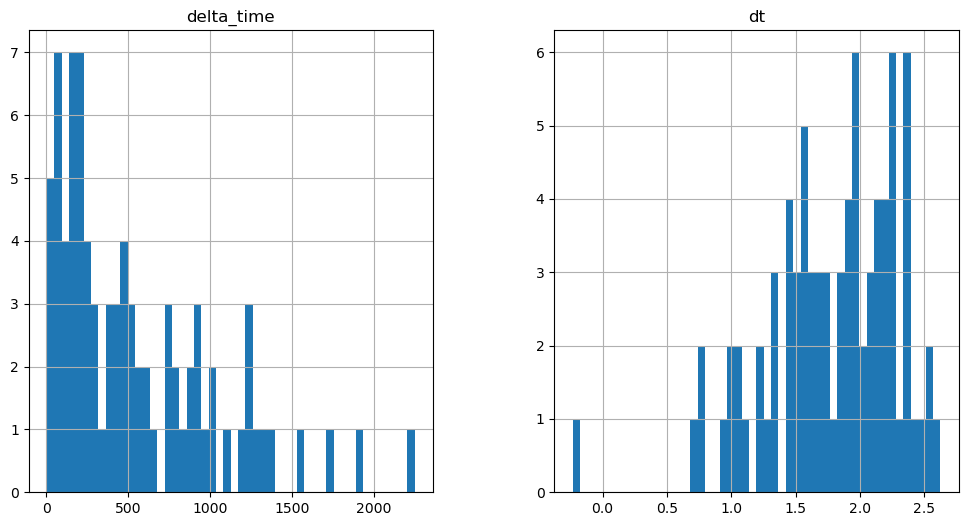

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4648.7145409584045 9.423060417175293


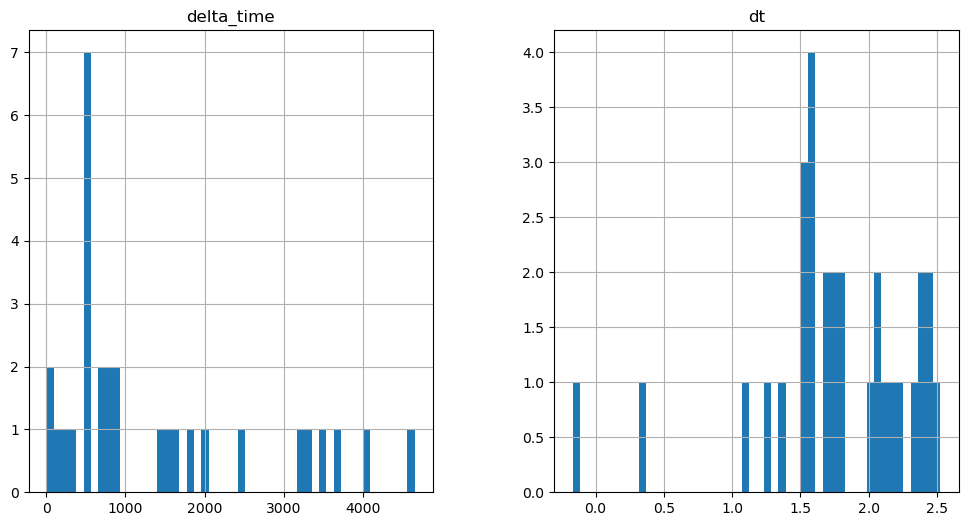

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3762.9447171092033 9.423080384731293


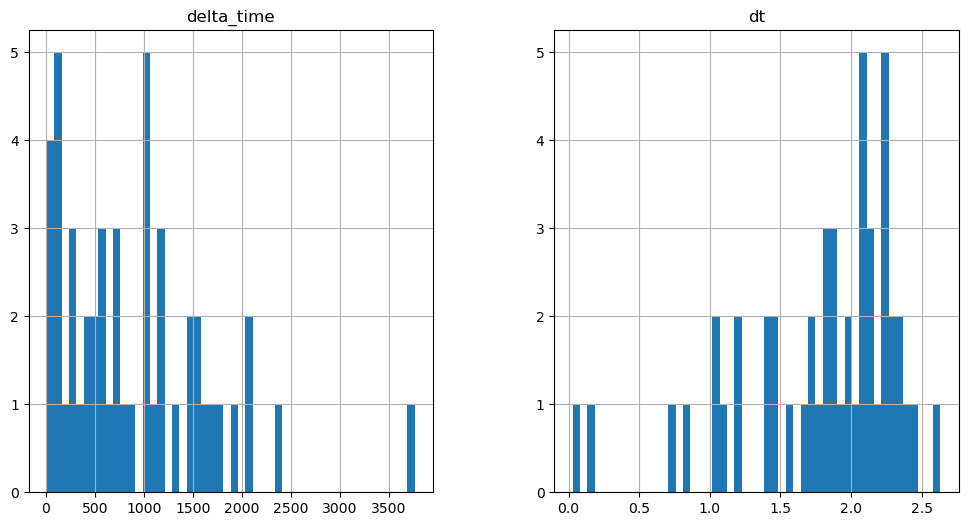

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4890.574313104153 40.833292067050934


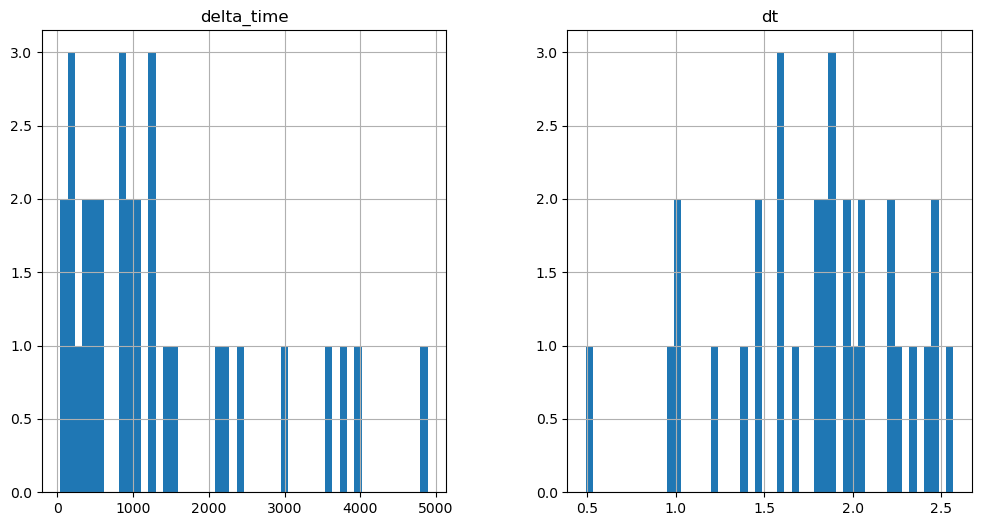

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2773.5223177671432 6.282040297985077


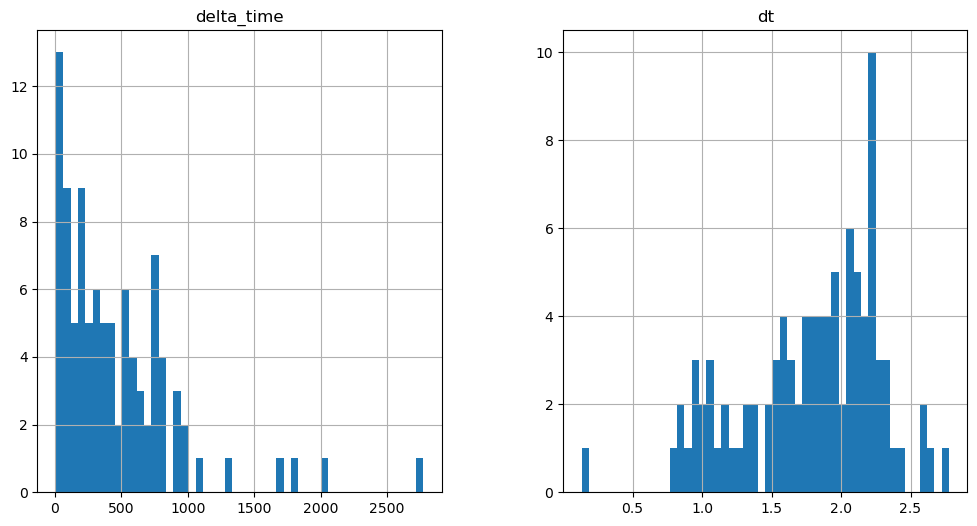

2713.8444148898125 3.1410300731658936


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

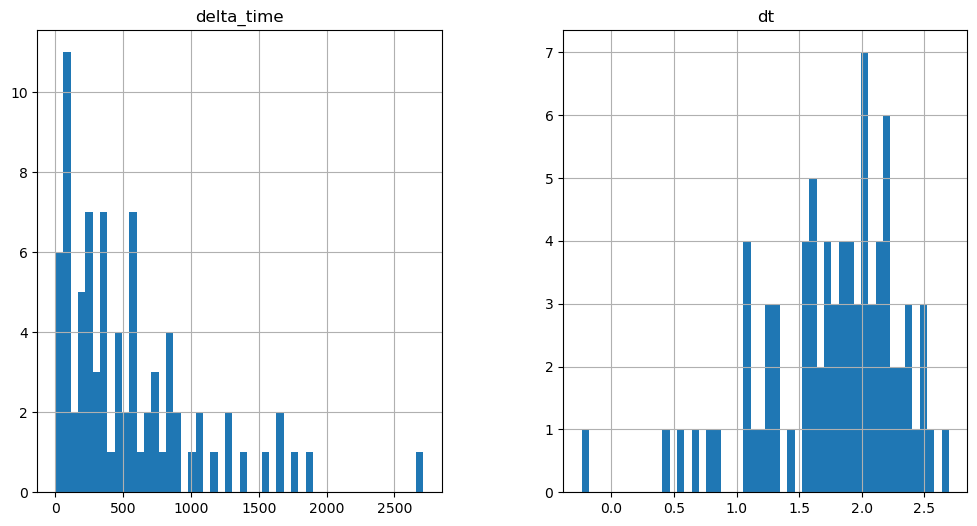

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2098.2028843164444 6.2820404171943665


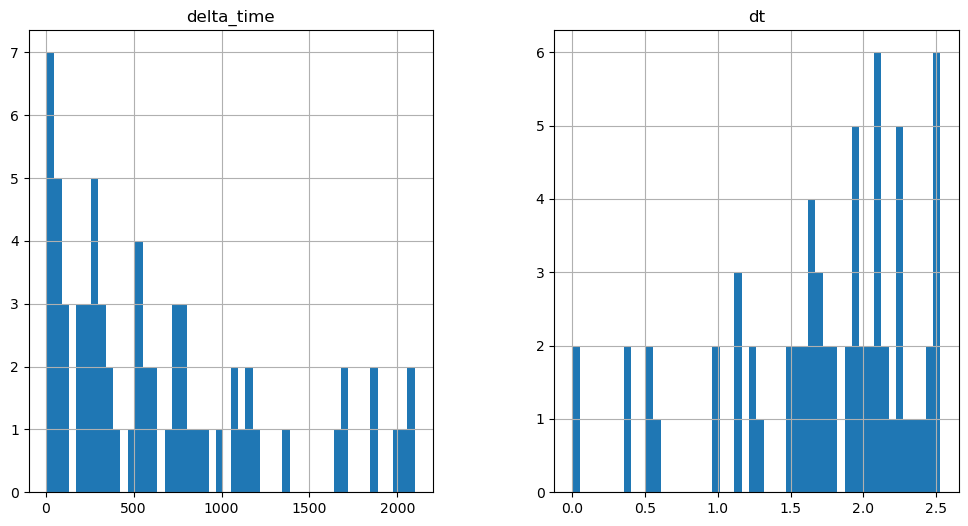

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3002.818069279194 3.141020178794861


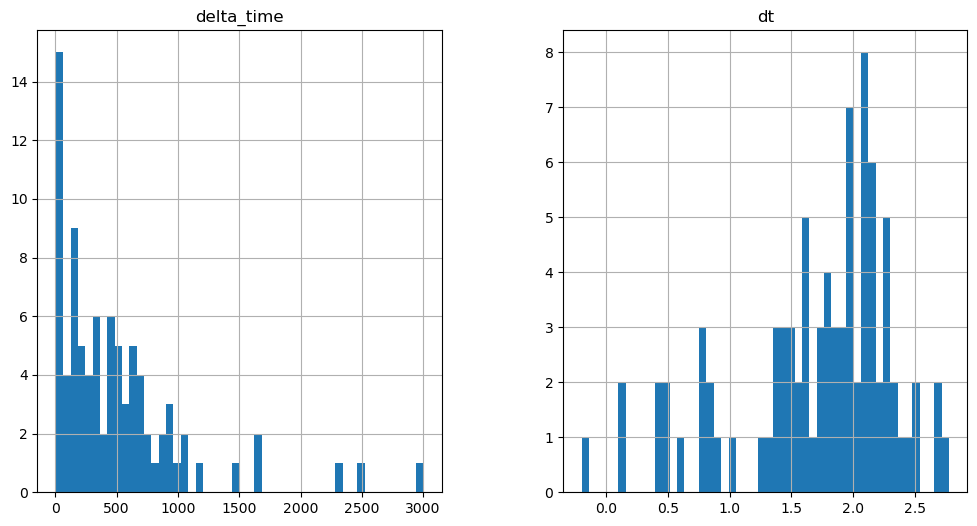

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2760.958567380905 28.26919138431549


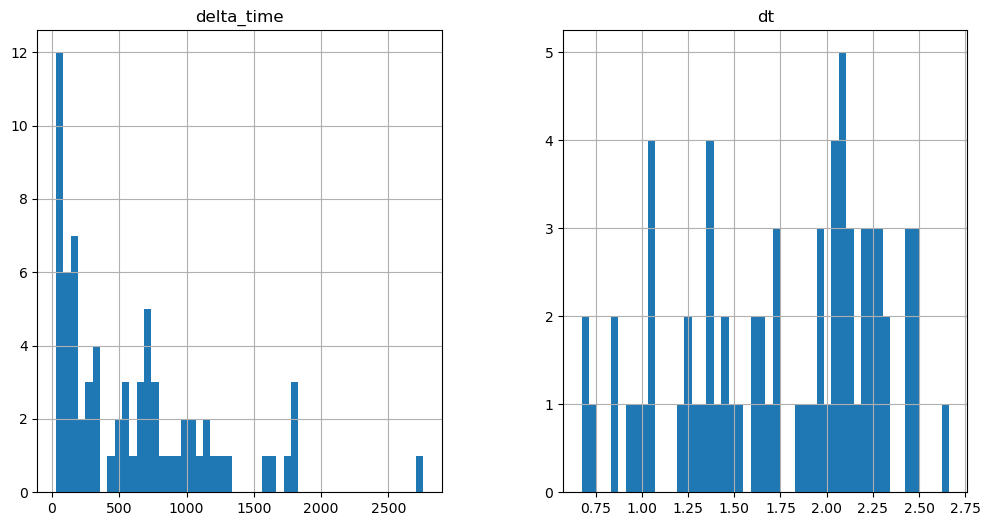

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

876.3450635671616 0.1


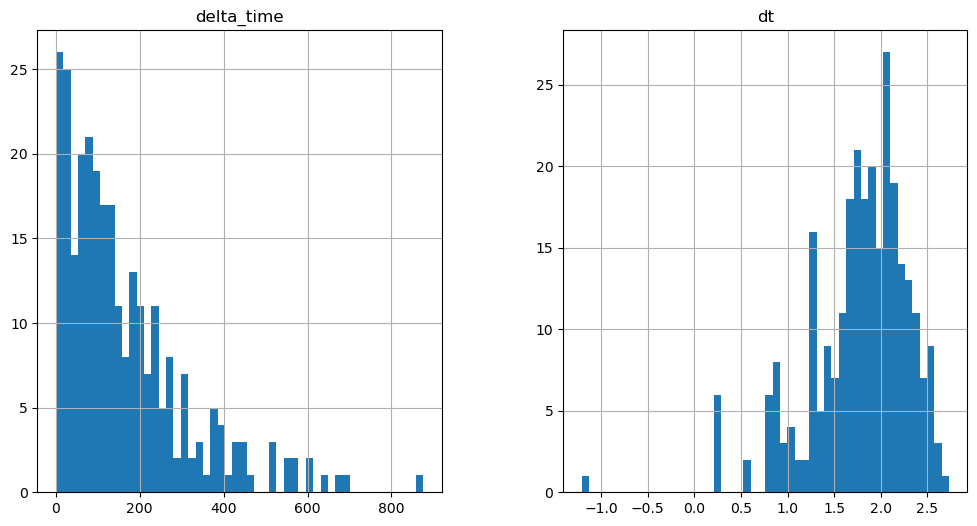

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3122.1776953339577 9.42307049036026


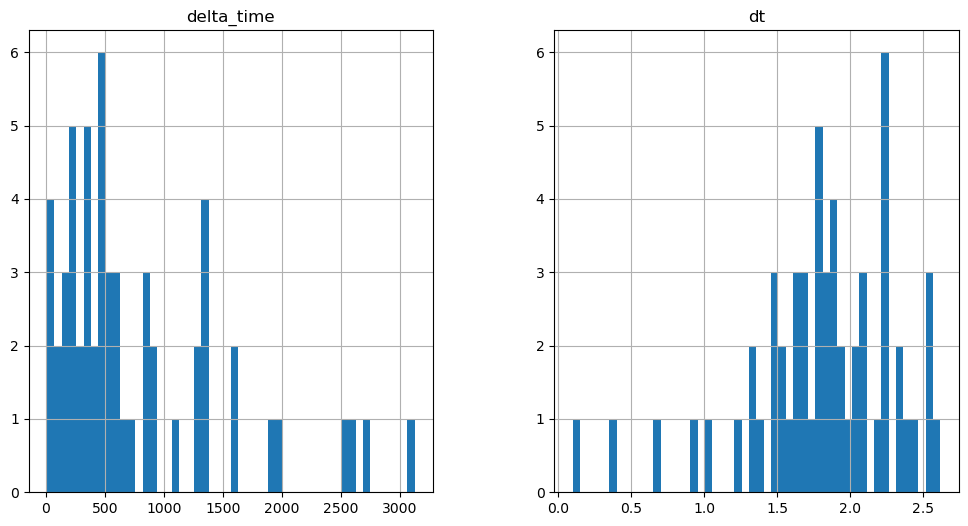

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3876.023992717266 0.1


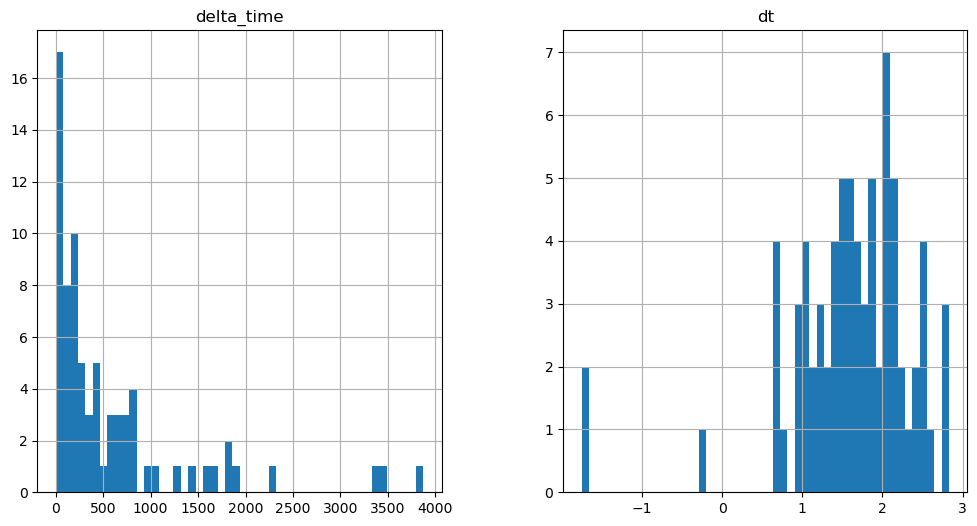

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3470.830052435398 21.98716115951538


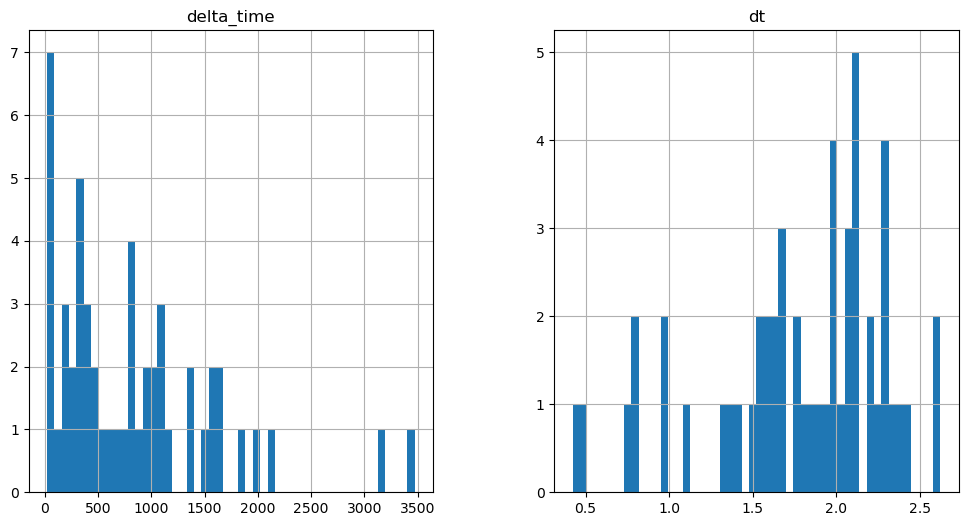

2578.7789982557297 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

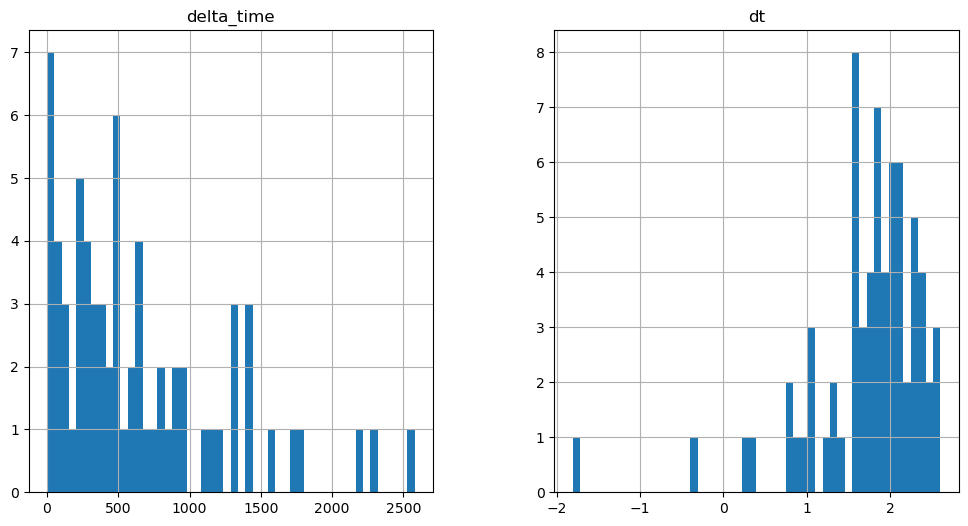

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3181.8558881282806 28.26921135187149


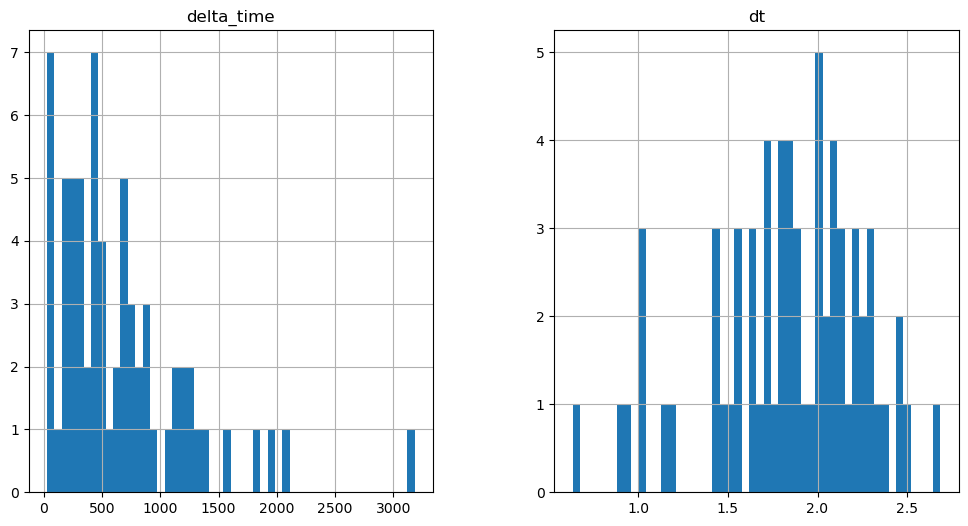

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3291.7925936579704 12.564090609550476


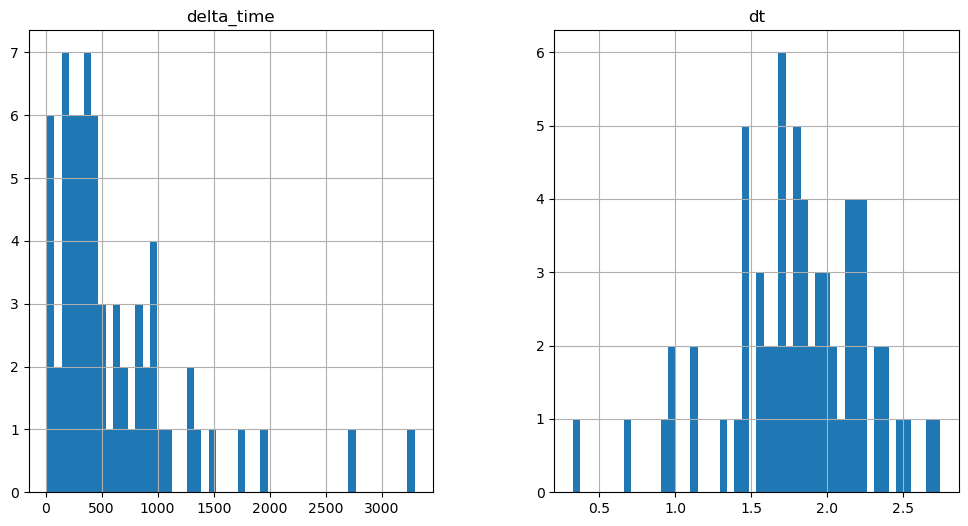

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4592.175198256969 6.282040238380432


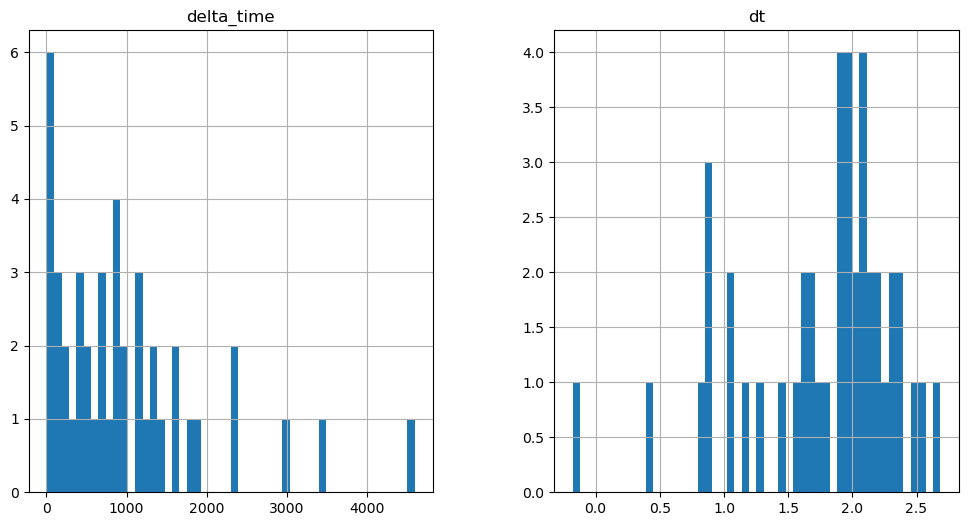

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3734.675565779209 15.70510083436966


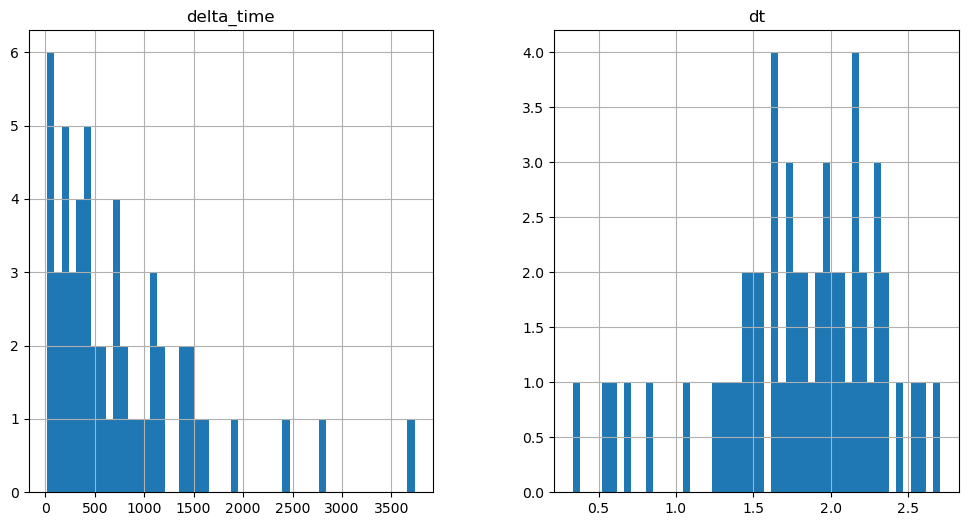

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2270.959832906723 6.282050311565399


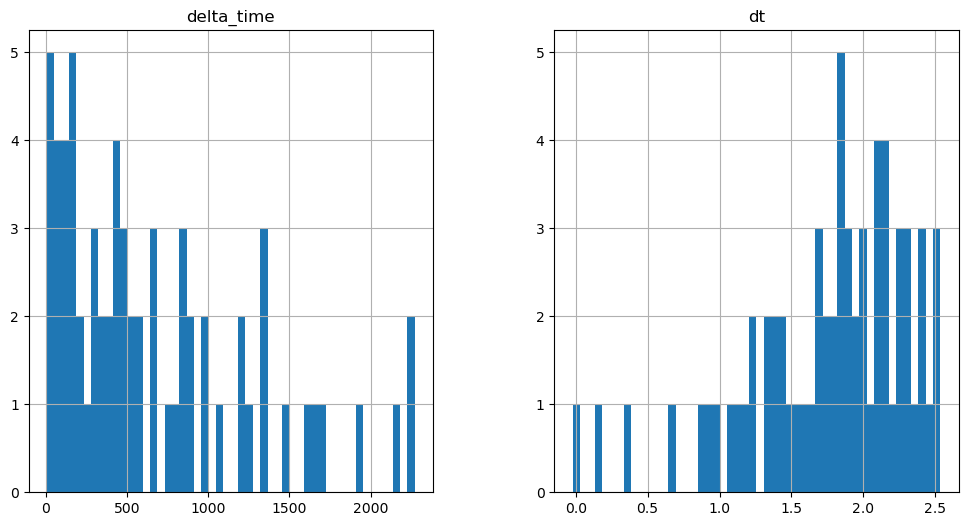

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2113.8950958848 0.1


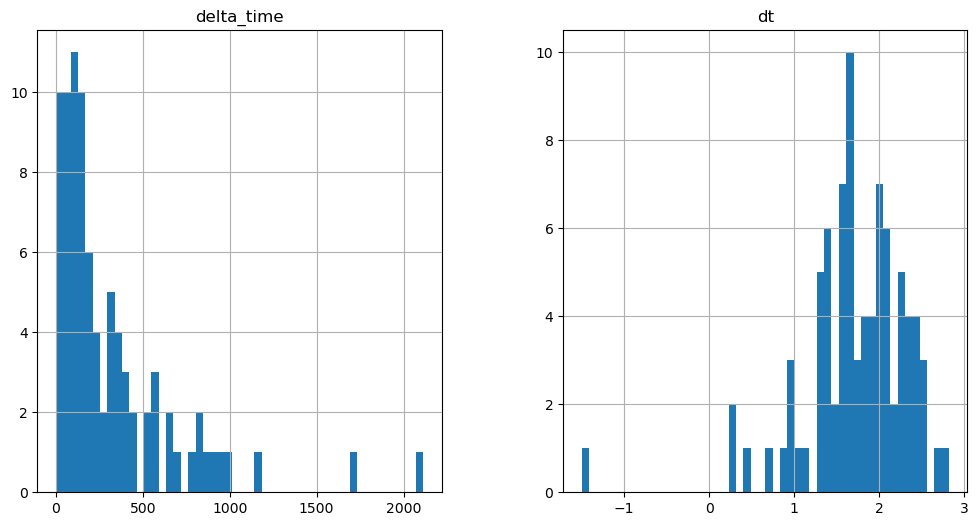

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3728.3712366223335 40.8330420255661


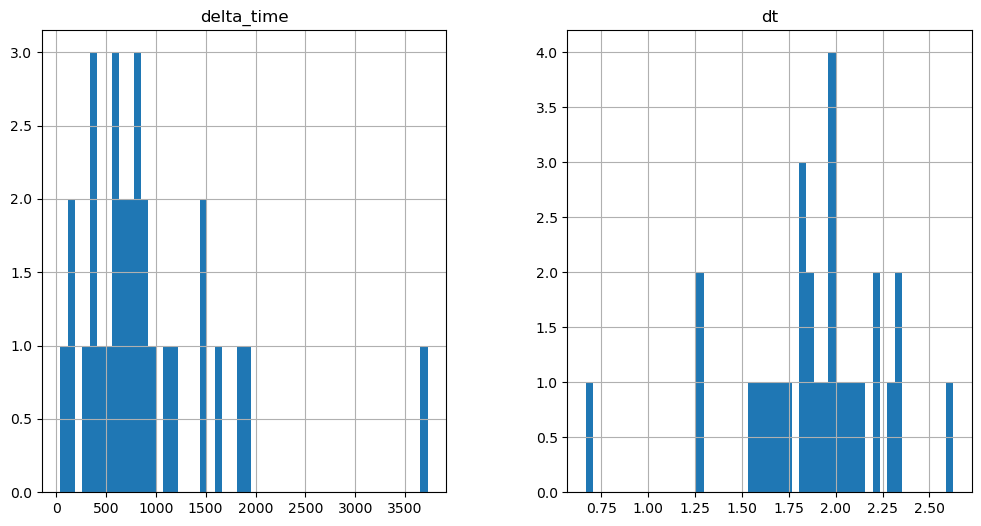

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2390.3059596419334 6.28201025724411


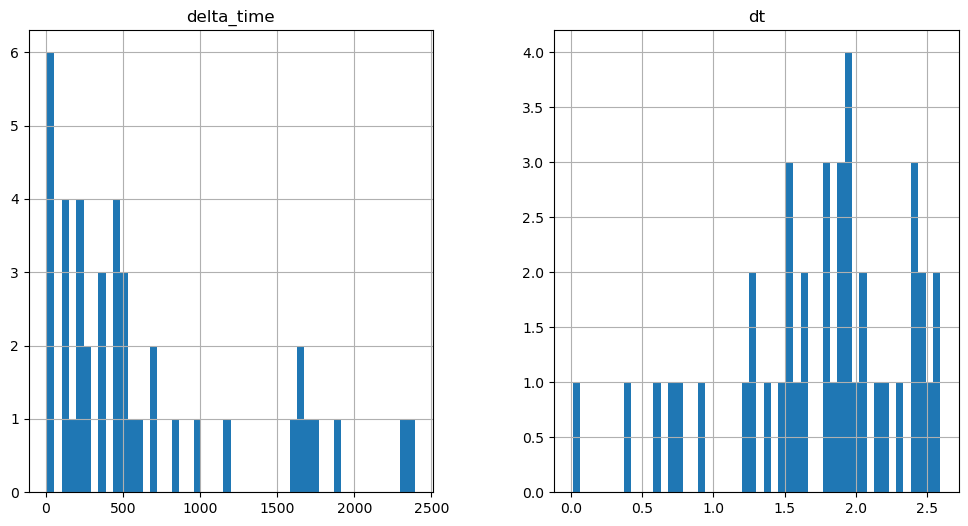

2248.9592725634575 6.282000482082367


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

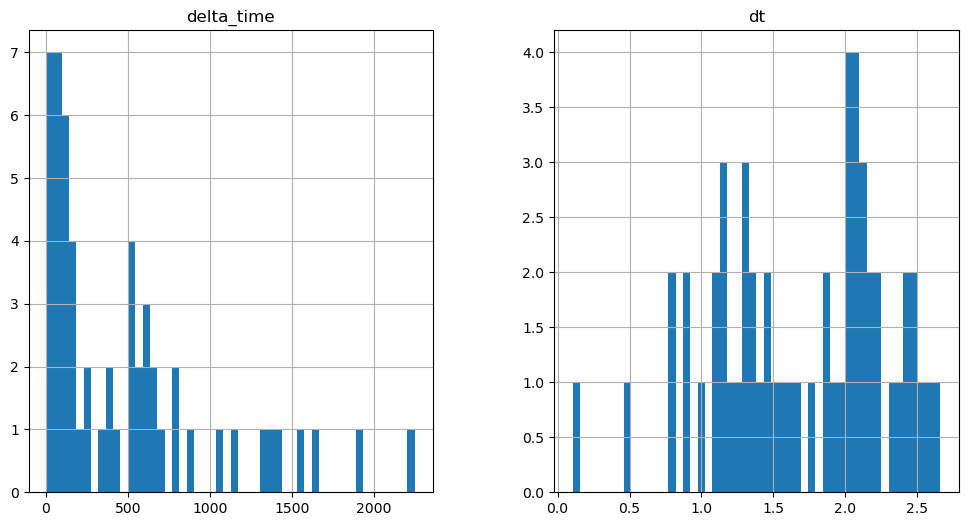

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2054.2162927389145 3.141010046005249


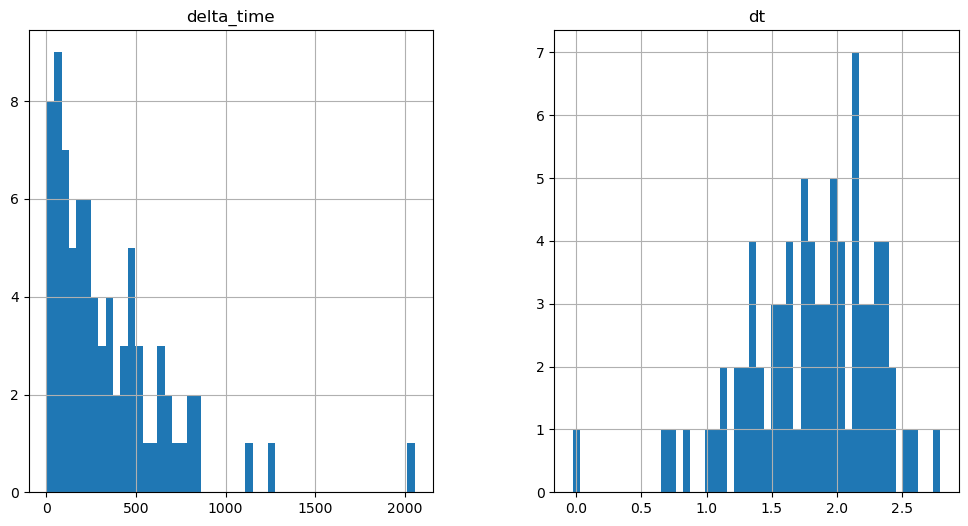

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2258.3817430734634 28.26905131340027


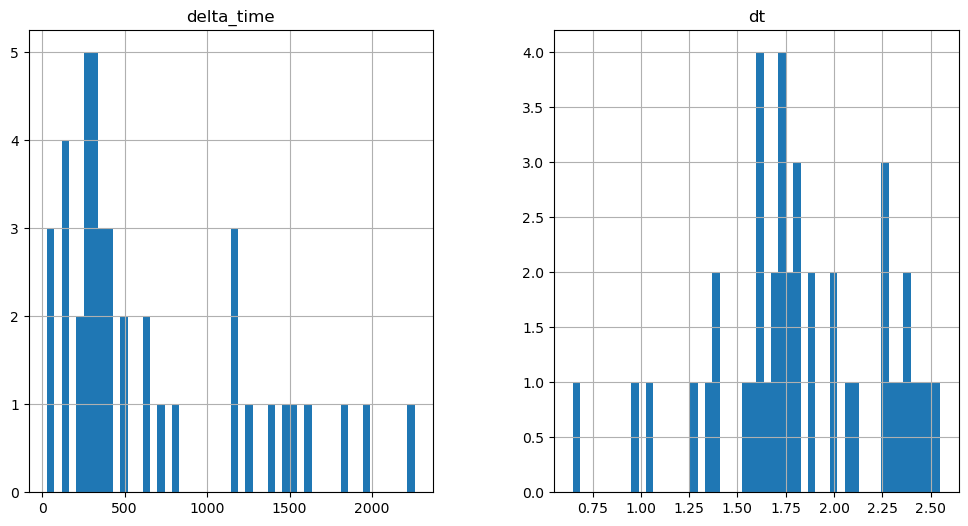

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1576.7838788628578 3.140990197658539


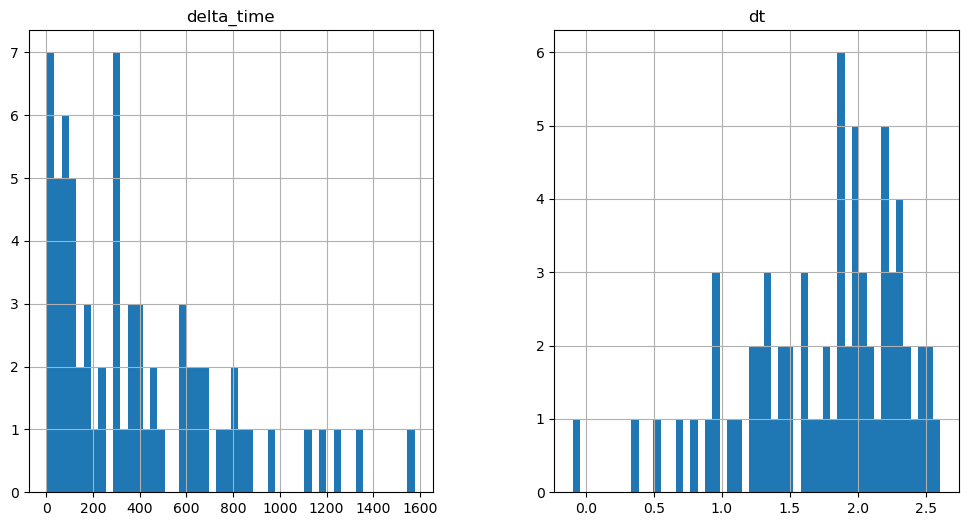

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

213.58828055858612 0.1


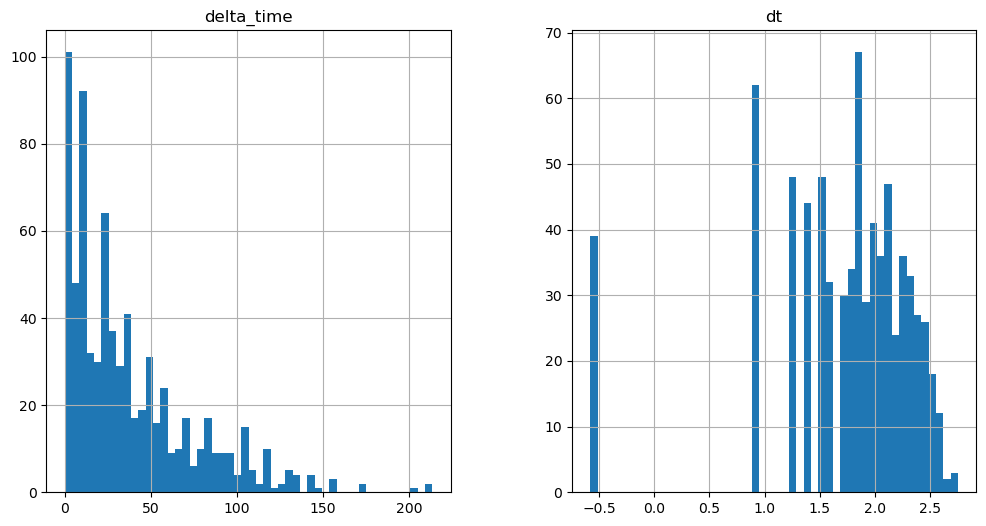

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1743.2570071220398 3.141000211238861


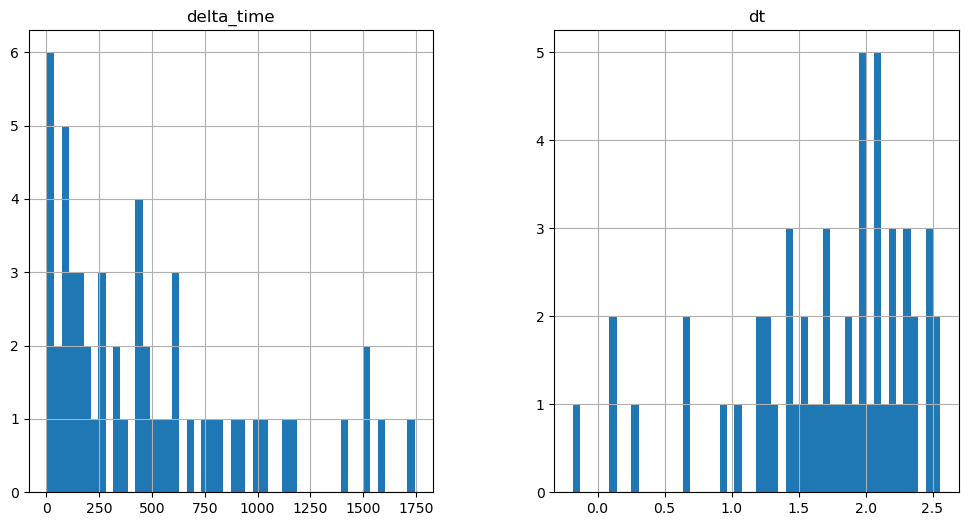

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2629.0220116972923 28.269021332263947


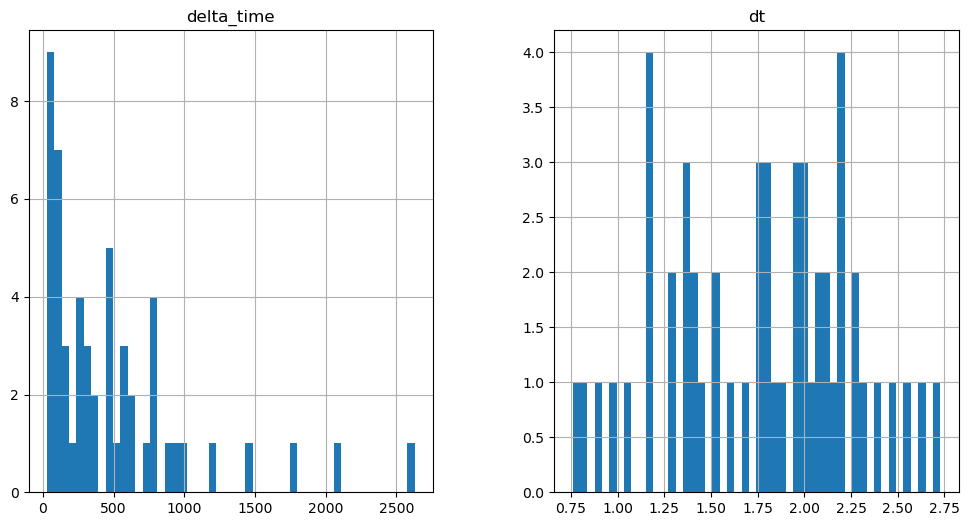

3326.3227363824844 25.128091275691986


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

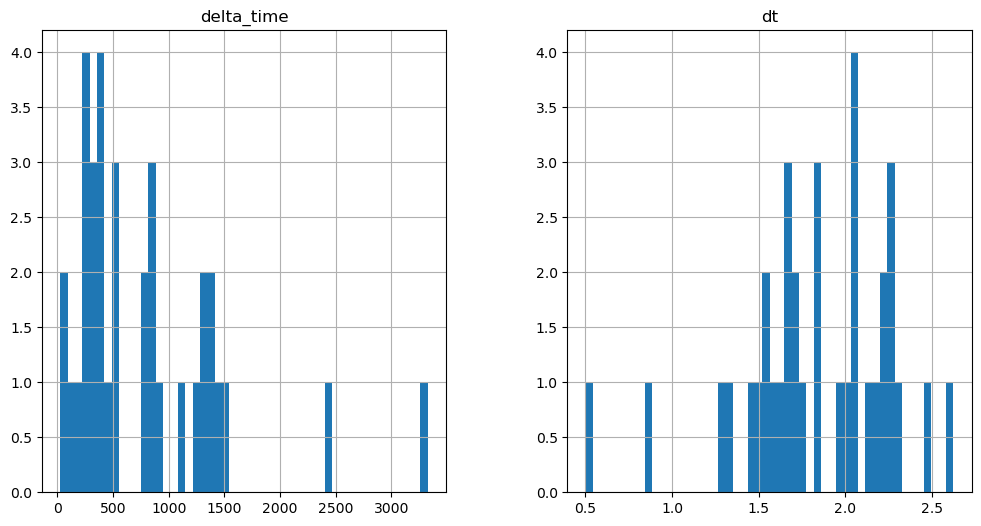

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

885.7629243135452 0.1


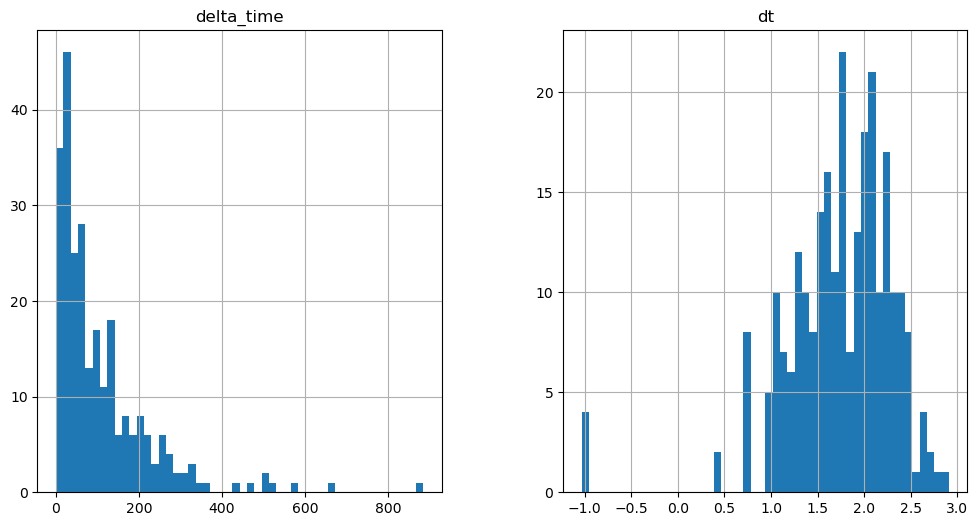

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1218.7093610167503 0.1


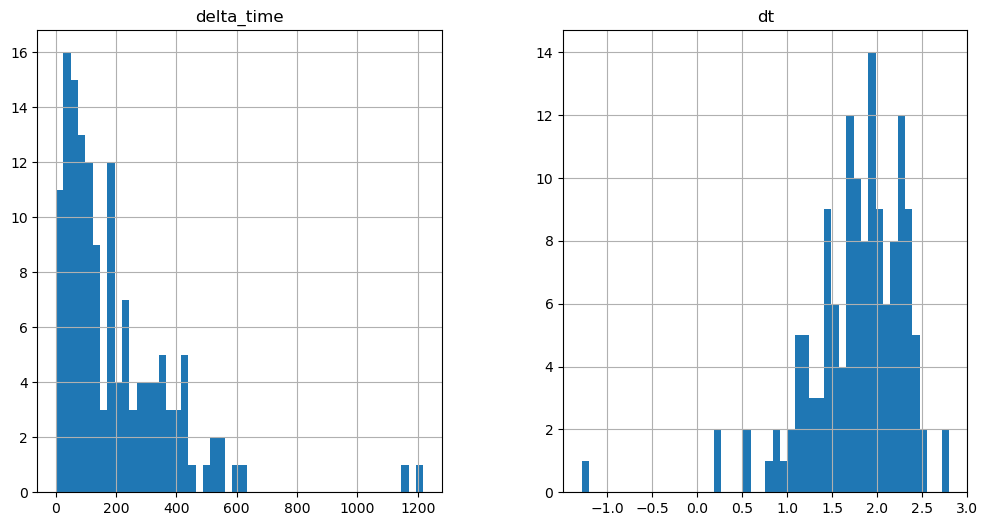

3078.183573961258 6.282010316848755


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

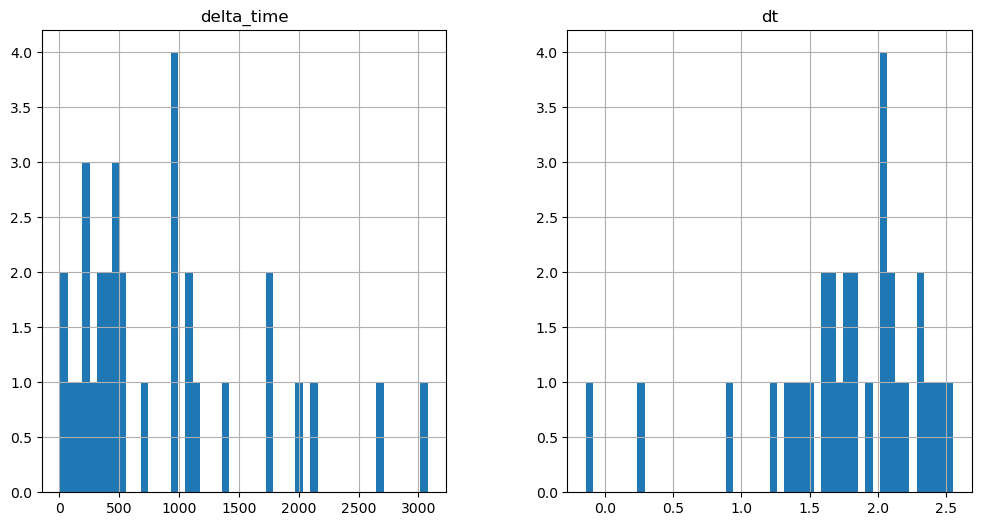

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2588.1908094882965 18.846030950546265


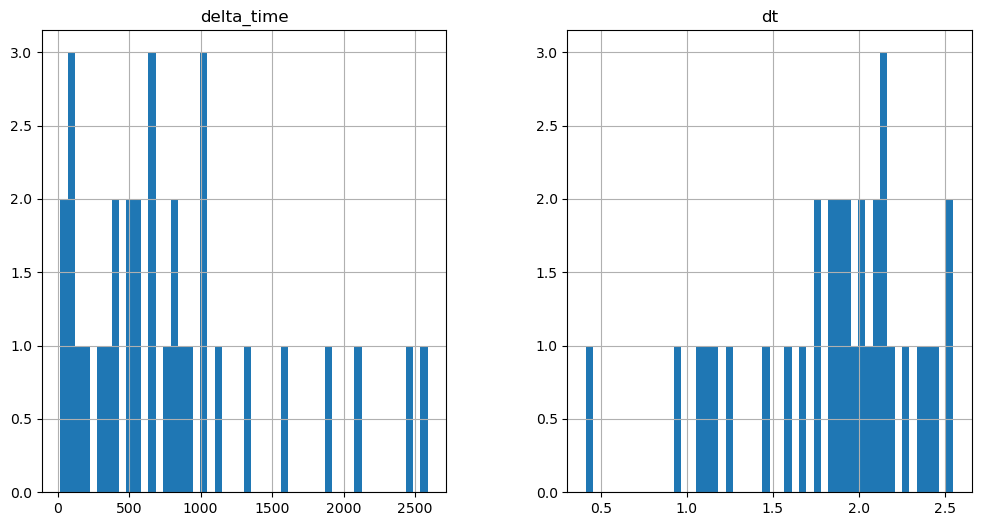

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2613.312099158764 3.140990197658539


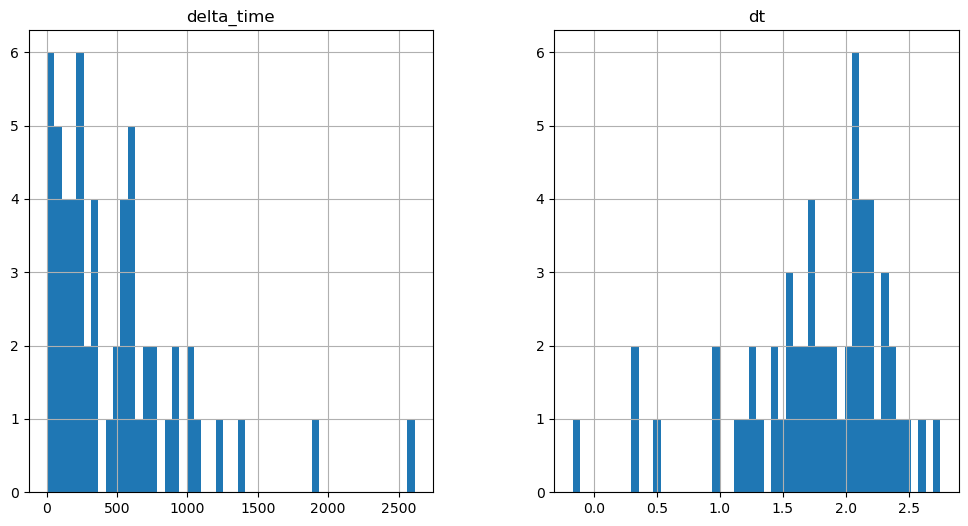

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1906.5870341658592 59.67899292707443


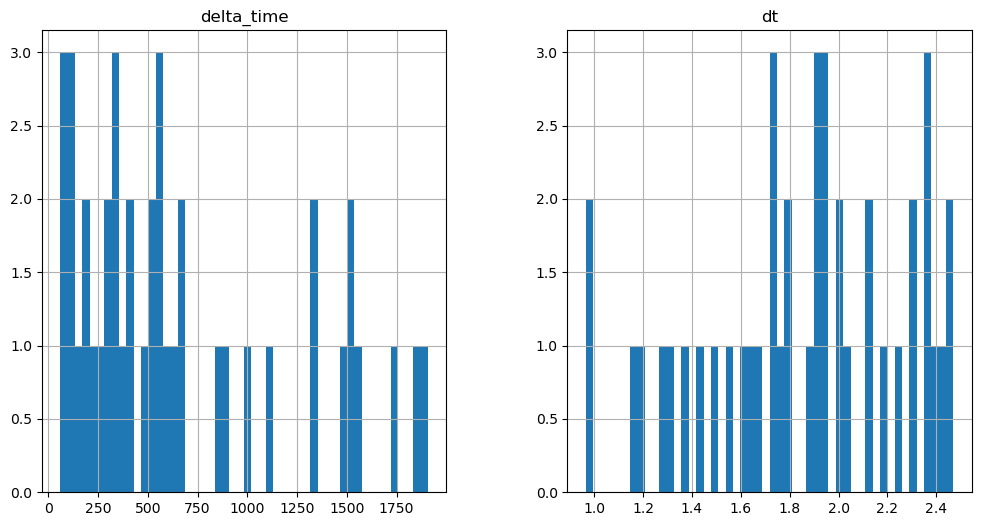

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2475.106602191925 6.282000303268433


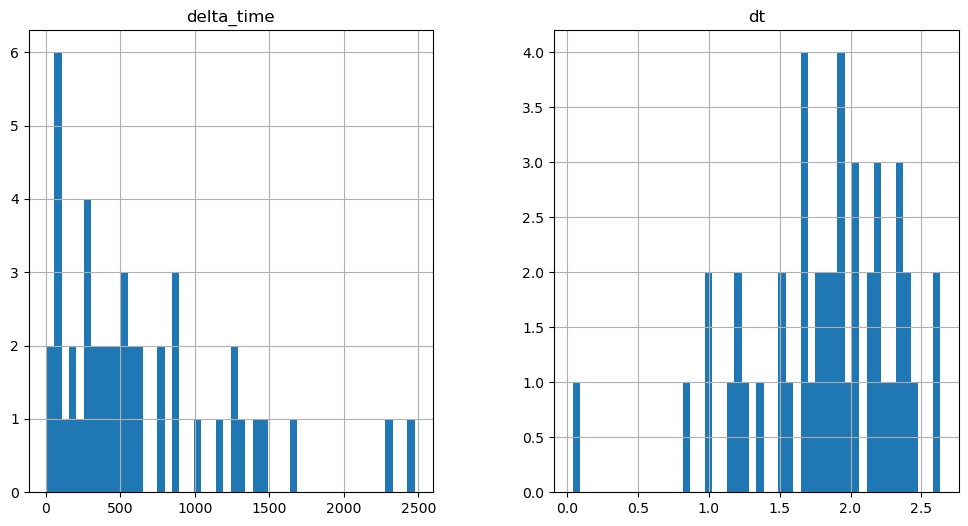

1994.5350584983826 21.98702096939087


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

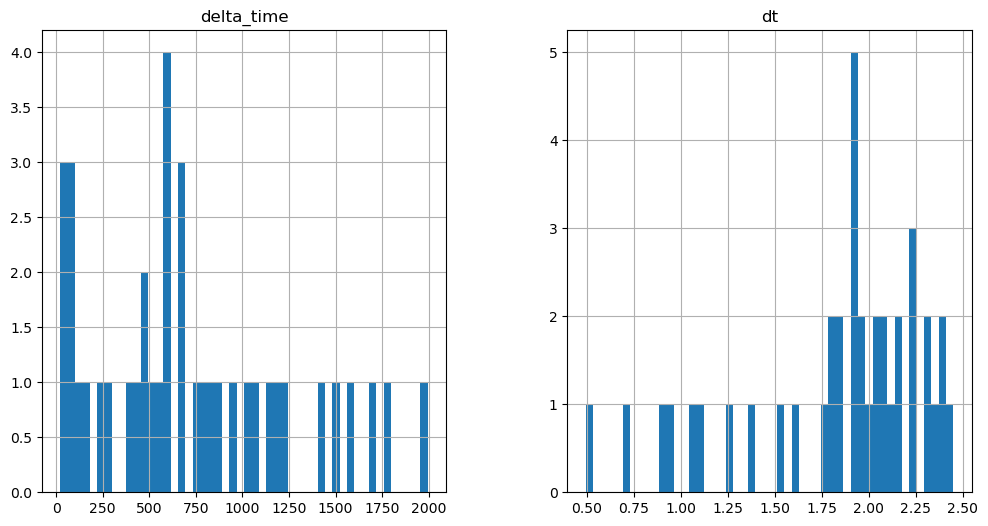

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3715.8030435442924 12.564000606536865


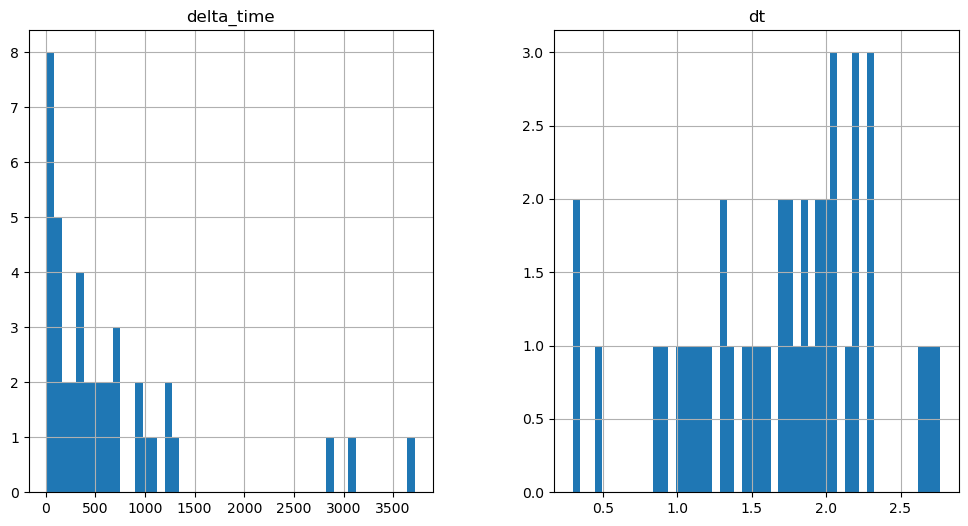

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2274.0836022496223 6.282000303268433


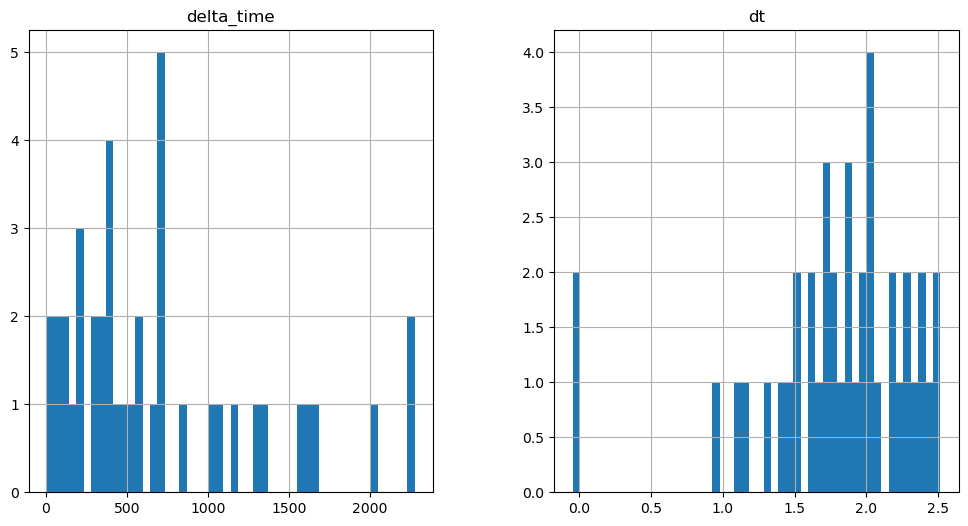

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2264.6610717773438 21.986991107463837


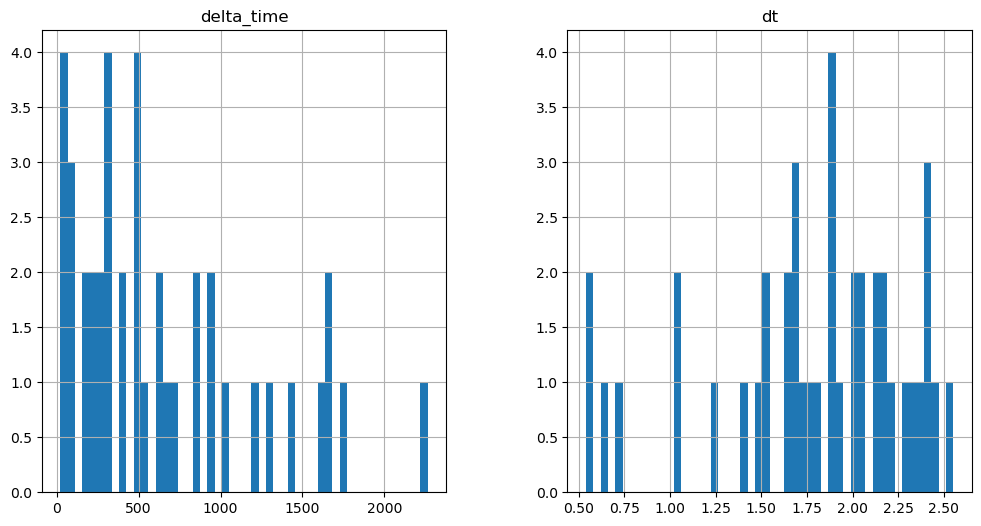

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2701.2600533366203 62.82001304626465


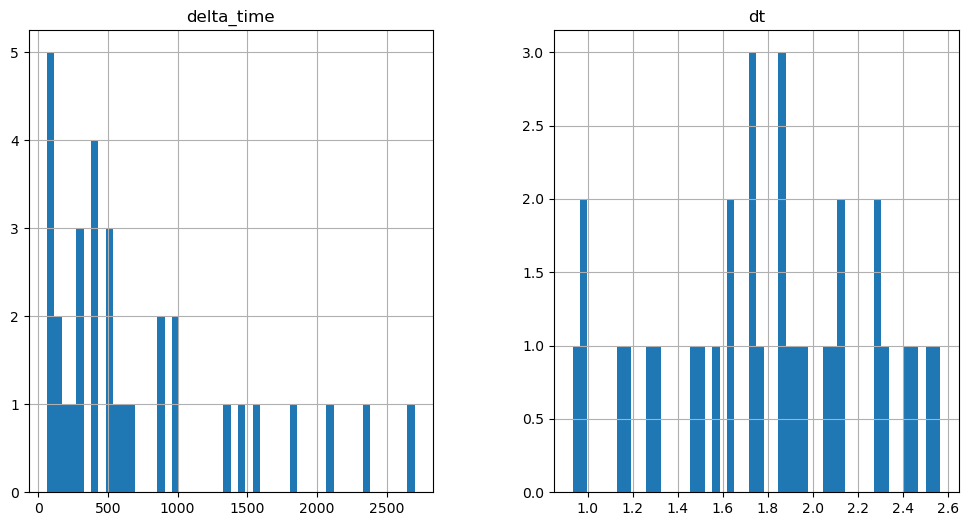

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

392.6250293850899 0.1


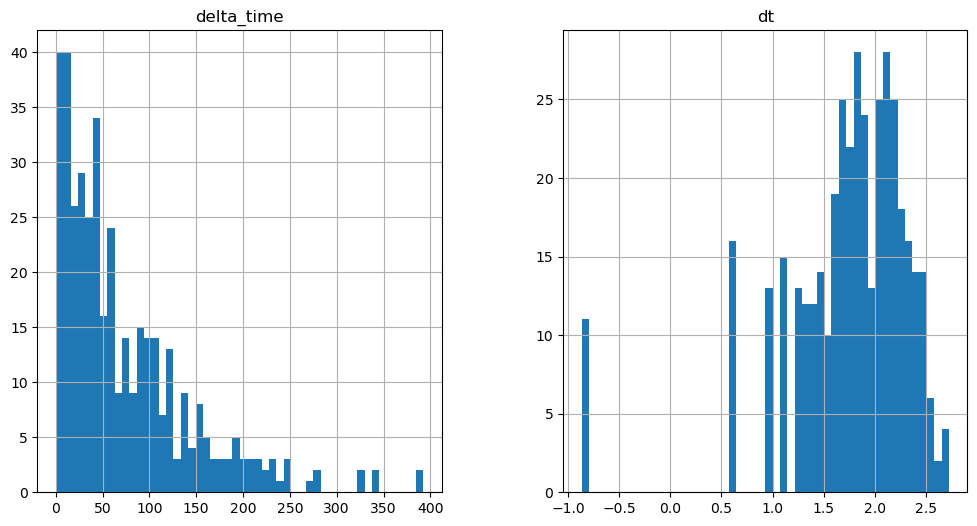

2713.823073923588 3.1409902572631836


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

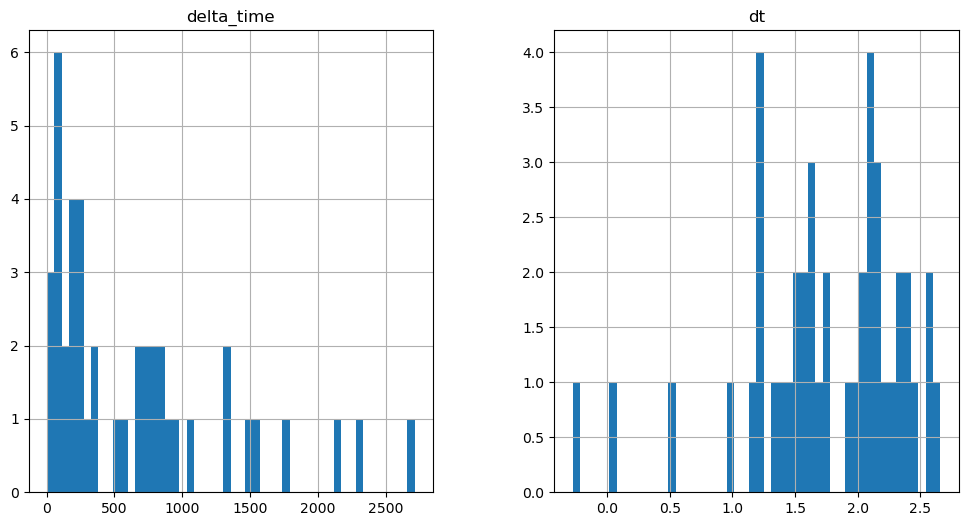

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

954.8640571832657 3.140990197658539


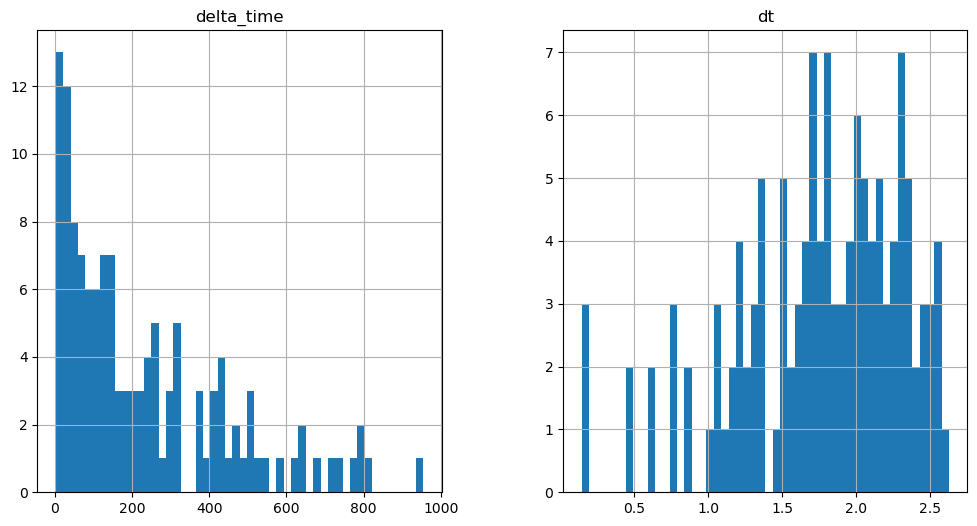

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2735.832397222519 3.1410401463508606


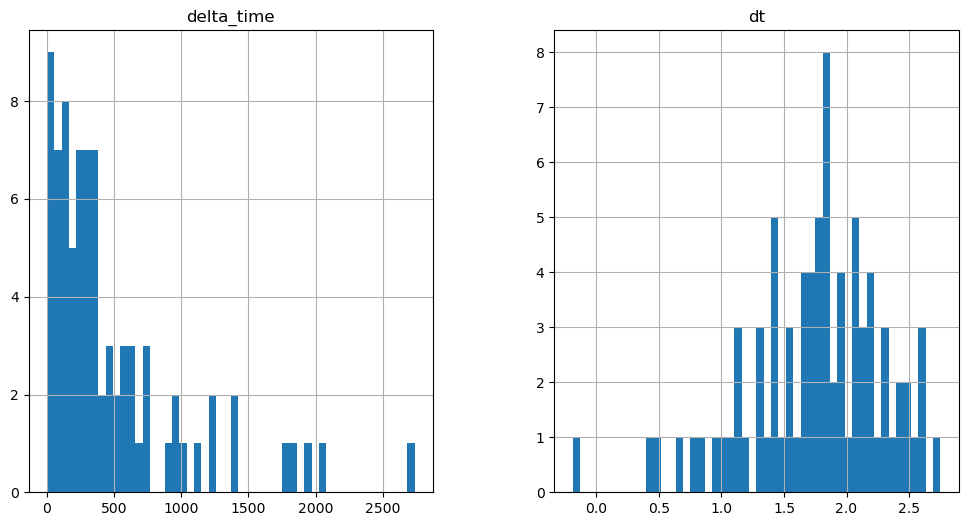

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3257.2421731948853 25.128201246261597


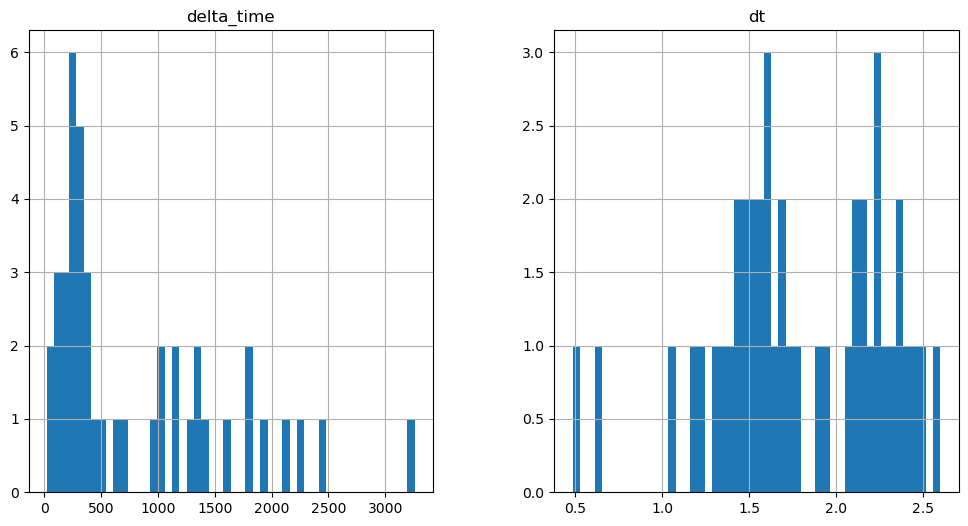

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3728.3994967341423 0.1


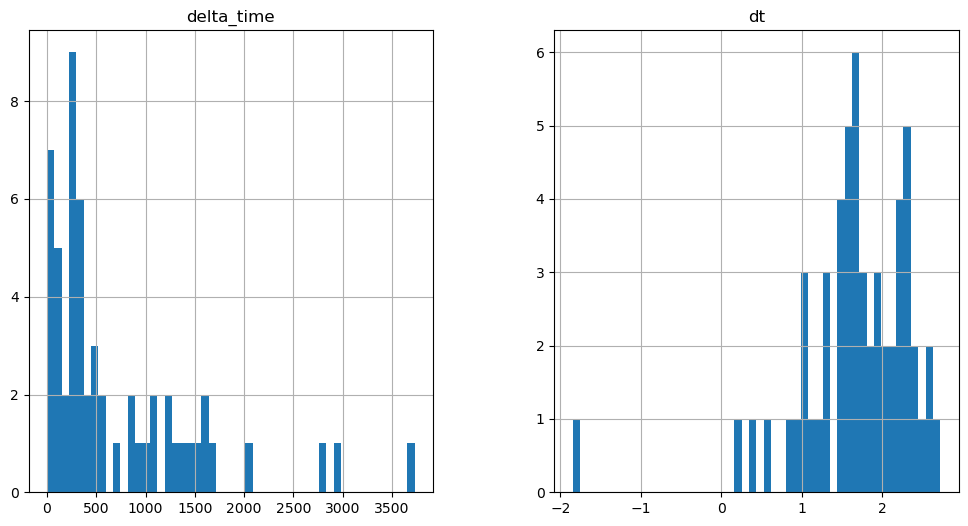

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

474.29474383592606 0.1


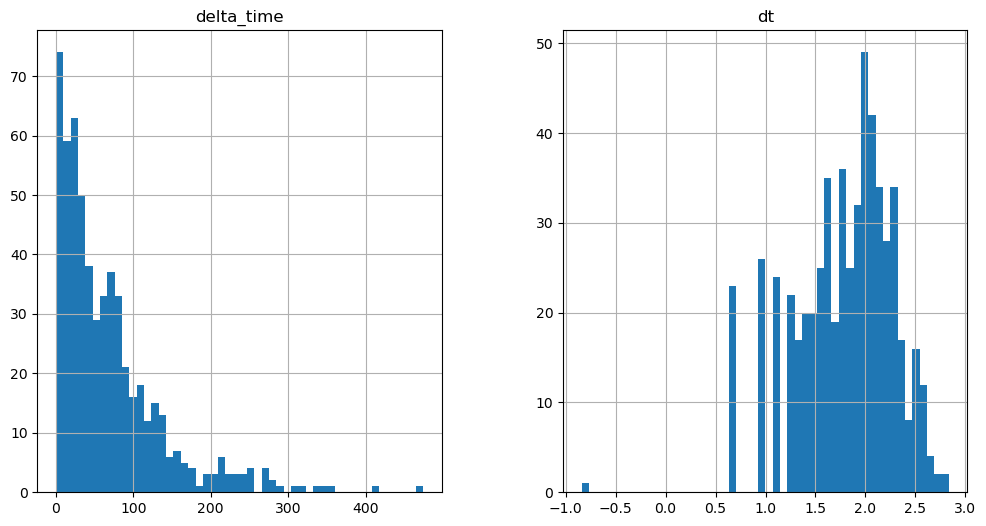

2076.2173639535904 3.1410301327705383


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

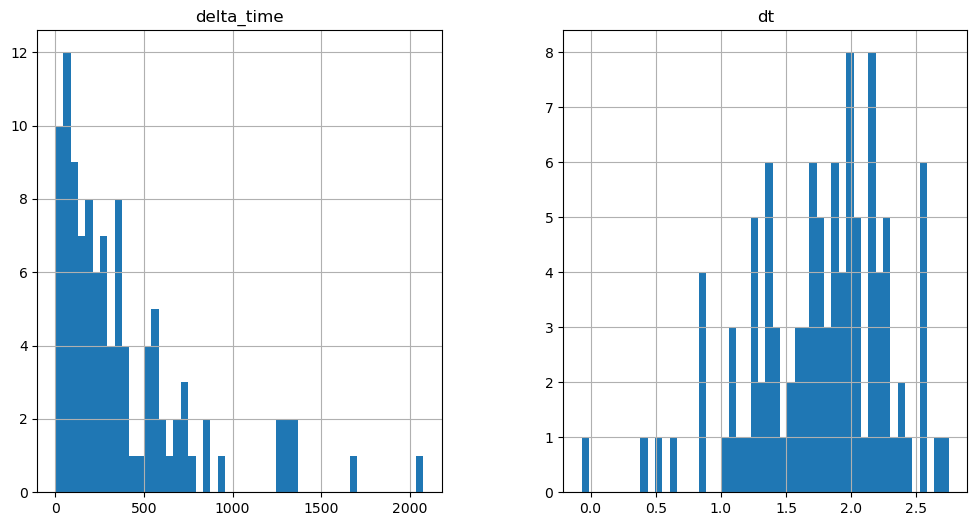

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2022.8208612203598 0.1


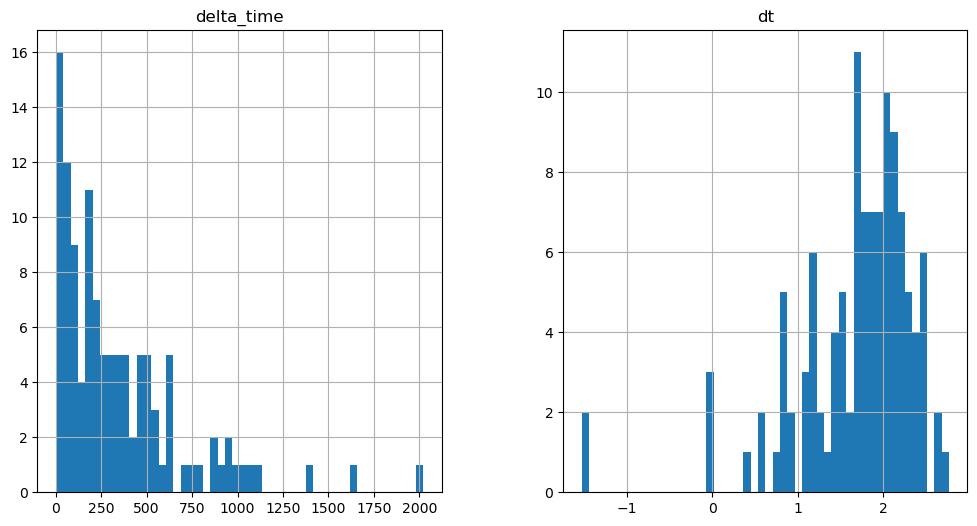

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2695.001754939556 0.1


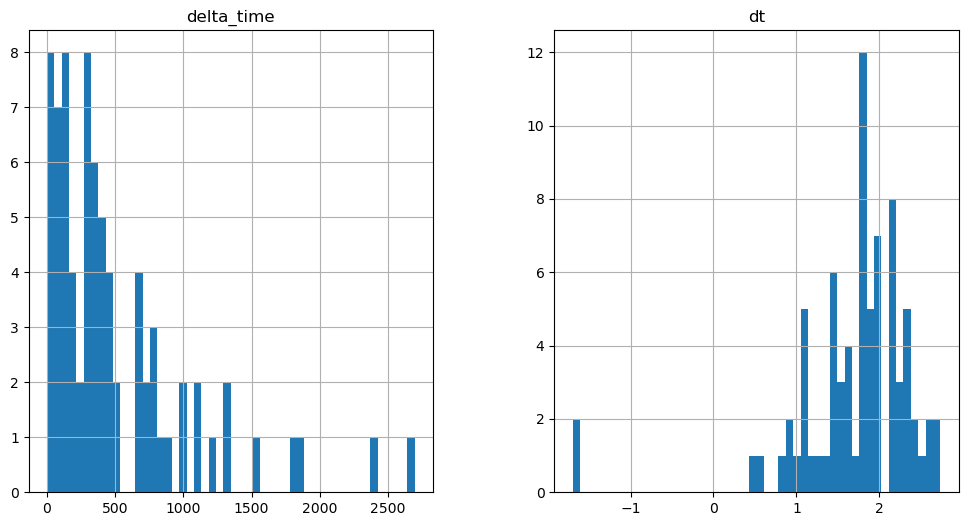

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2613.333630859852 12.564100563526154


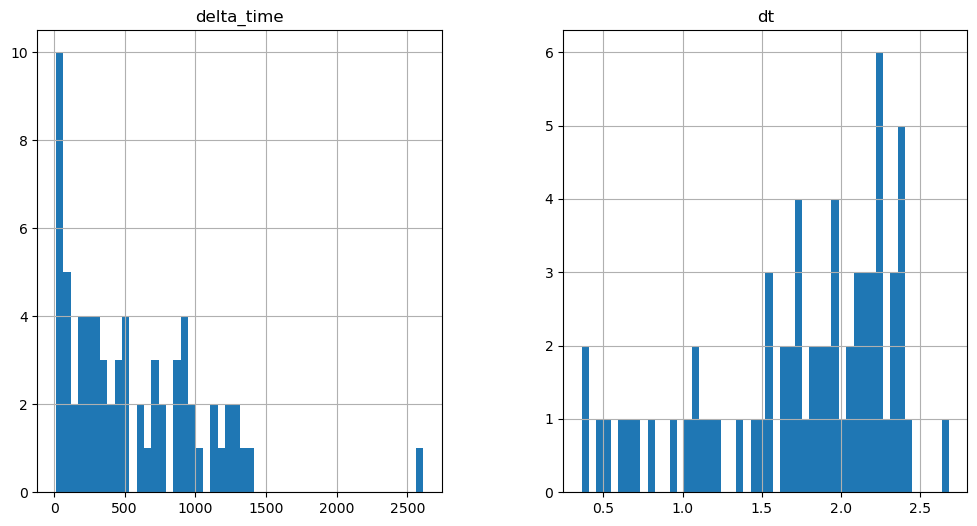

5421.411471605301 12.564110577106476


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

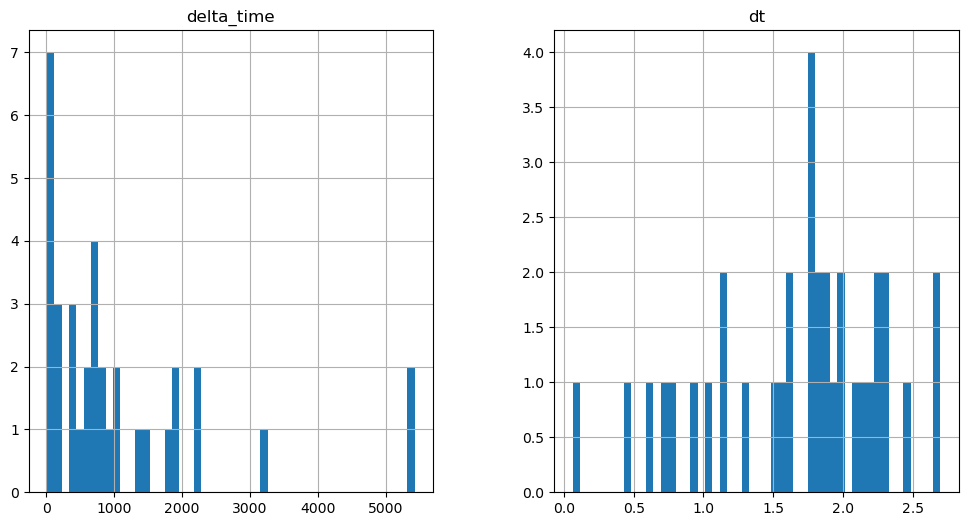

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3175.576919198036 9.423080503940582


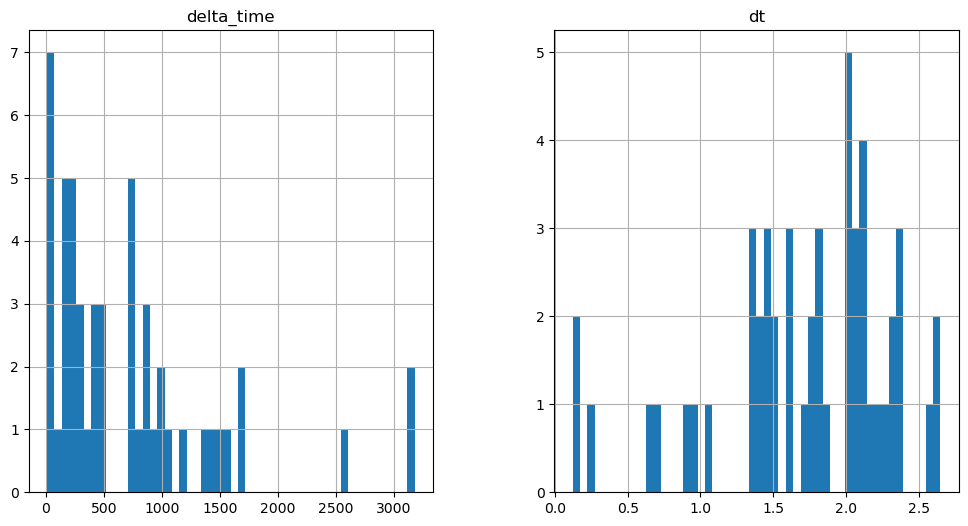

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

844.935482442379 0.1


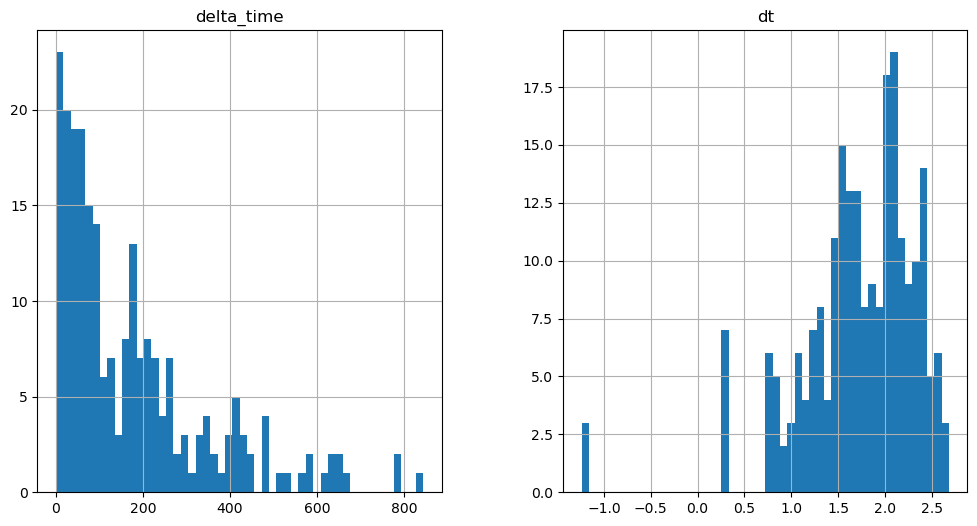

3382.884389400482 12.564100682735443


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

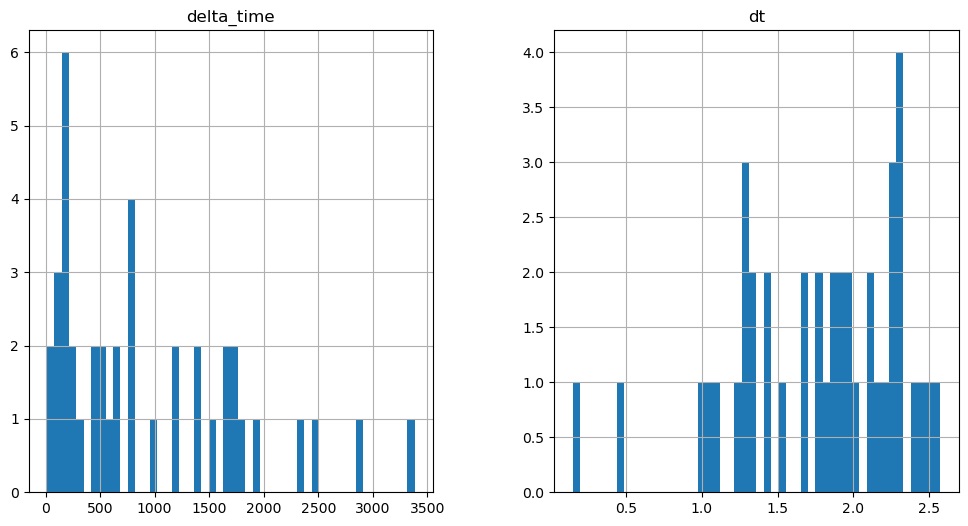

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2559.934698343277 0.1


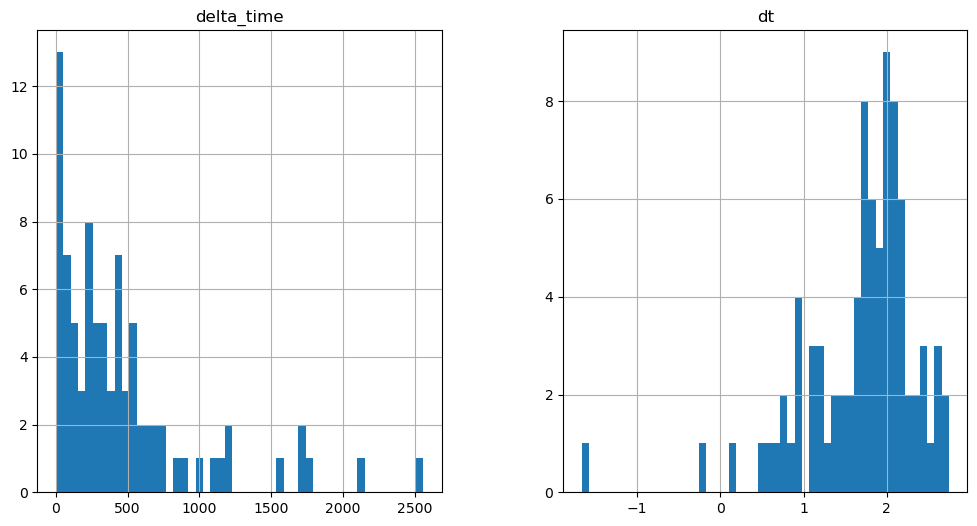

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4240.385212302208 21.98718124628067


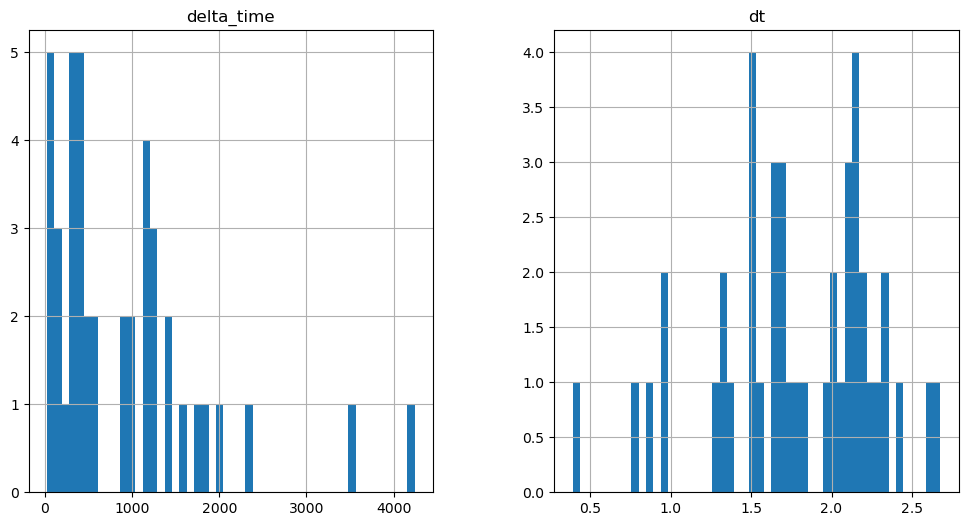

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2142.1789057850838 12.564090609550476


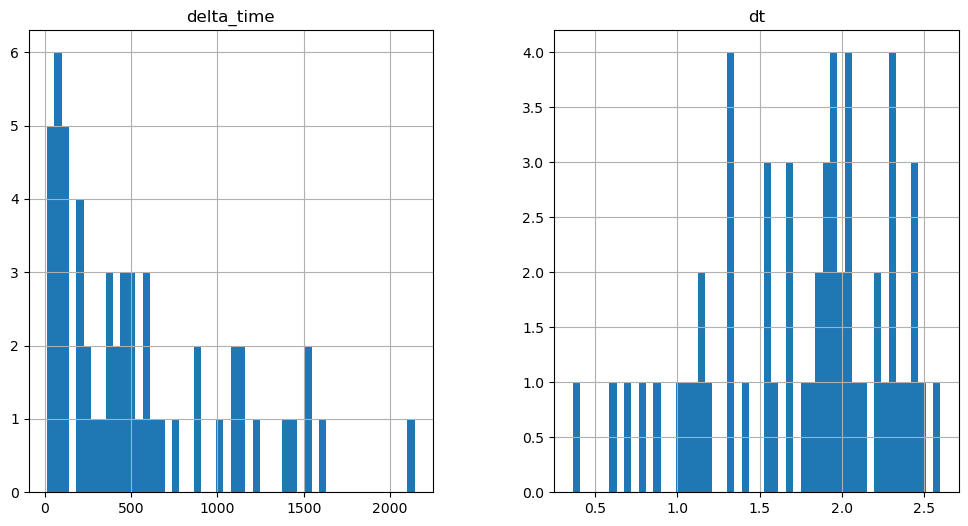

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4915.6902930140495 3.1410200595855713


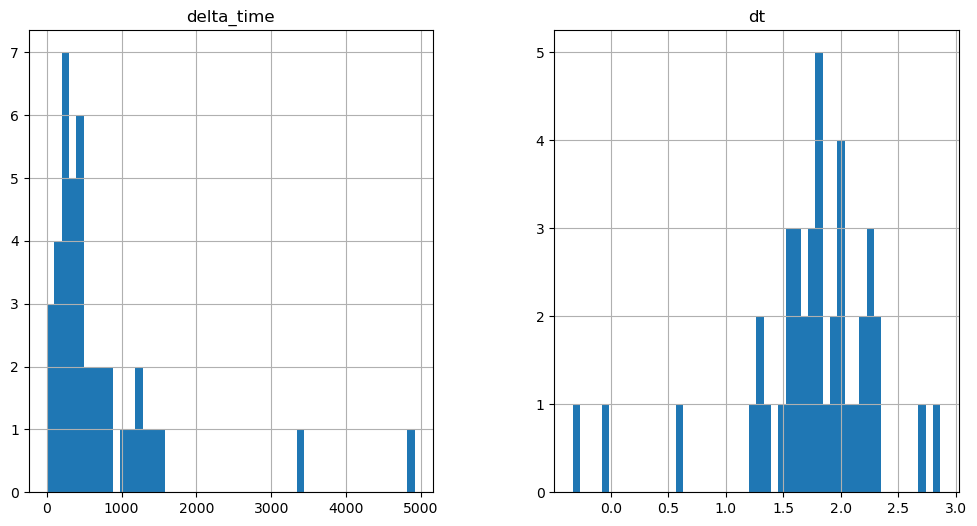

4856.017060101032 34.55128175020218


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

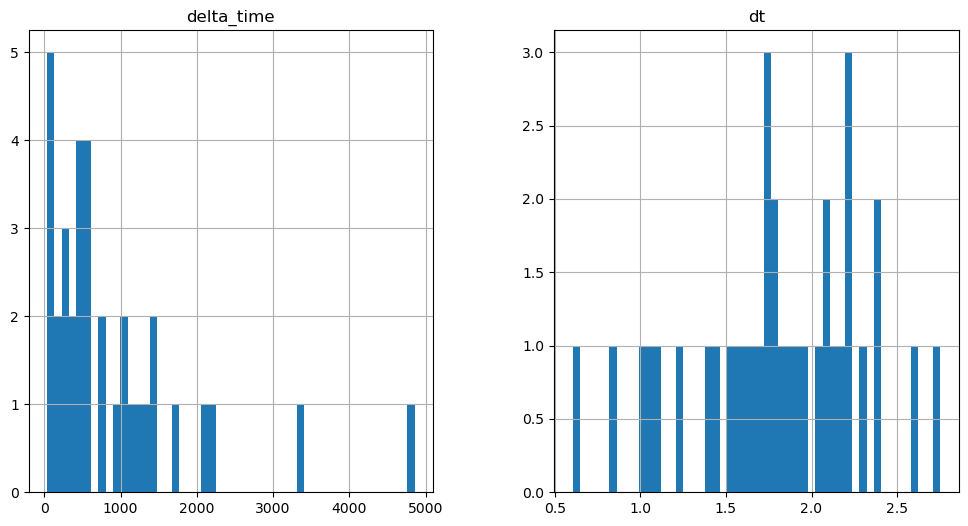

2013.3938794732094 15.70504081249237


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

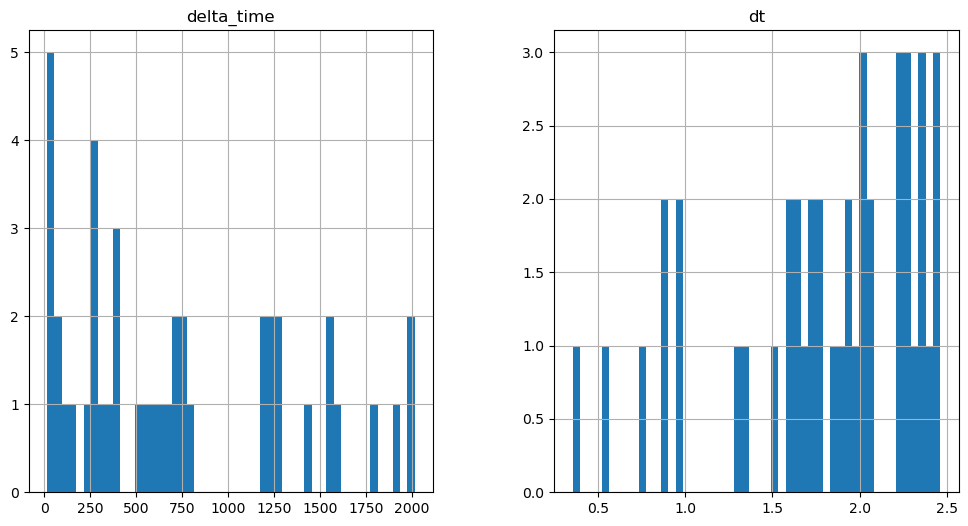

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2170.443547308445 6.28201025724411


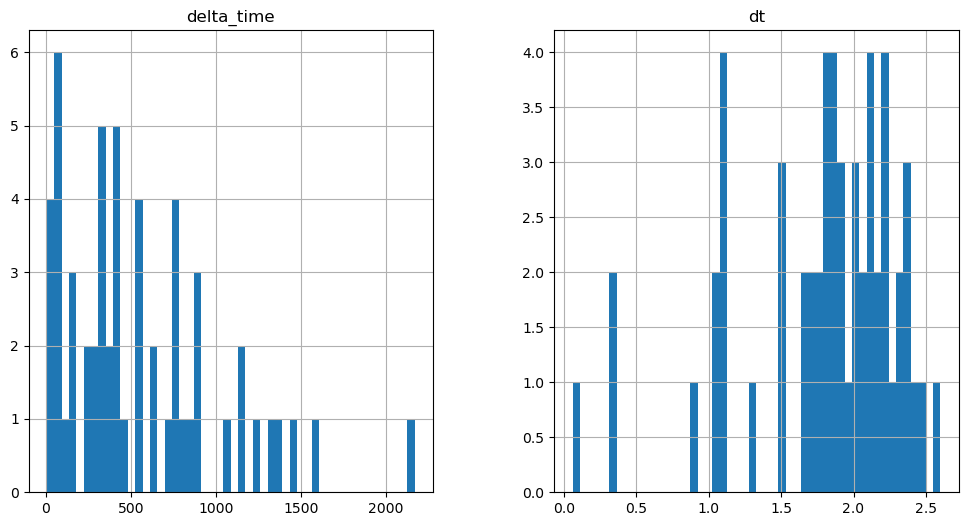

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

926.6024357676506 0.1


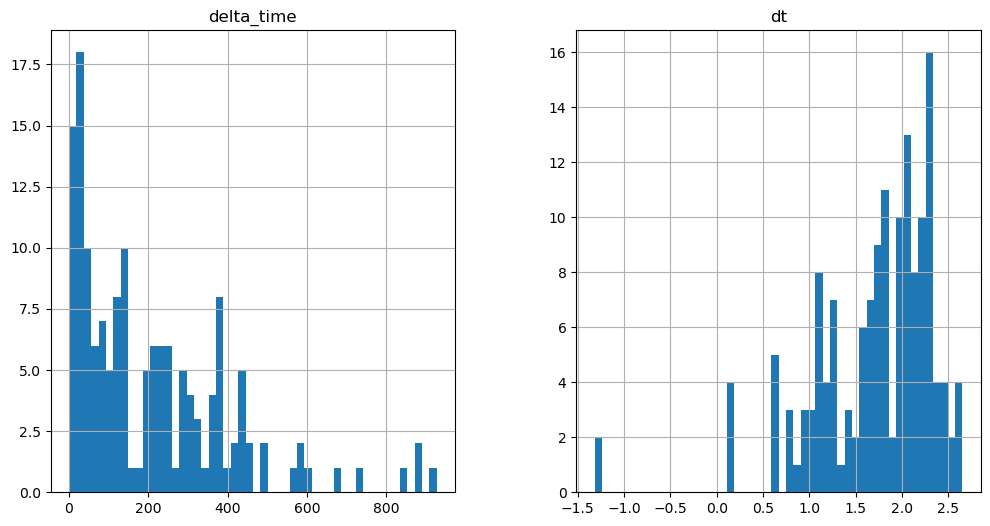

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3590.19009745121 25.12807124853134


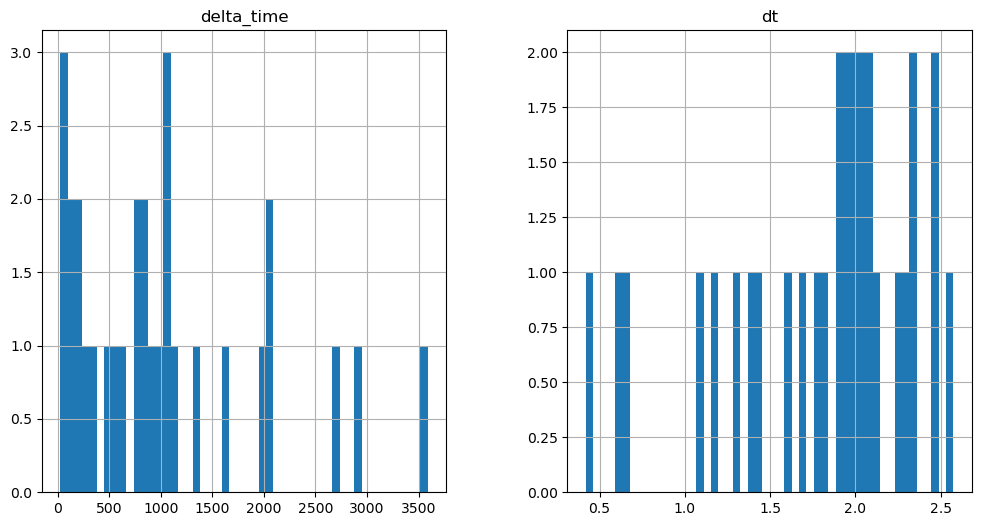

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

191.60245960950851 0.1


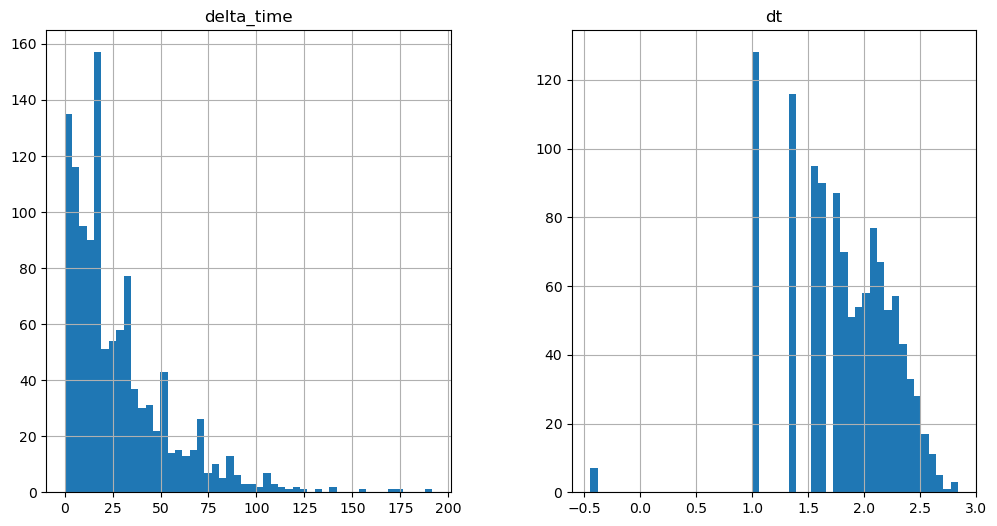

4507.364522755146 9.423040509223938


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

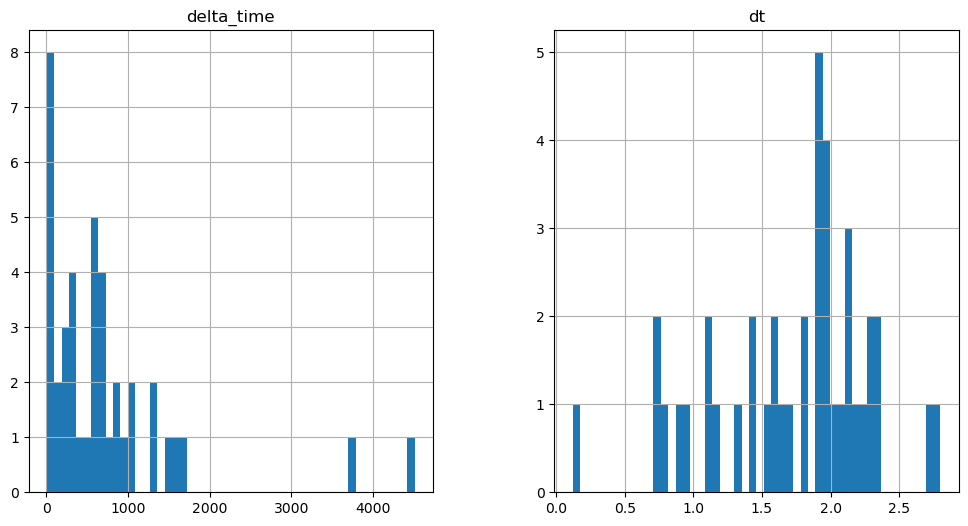

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3590.1868975162506 18.846090972423553


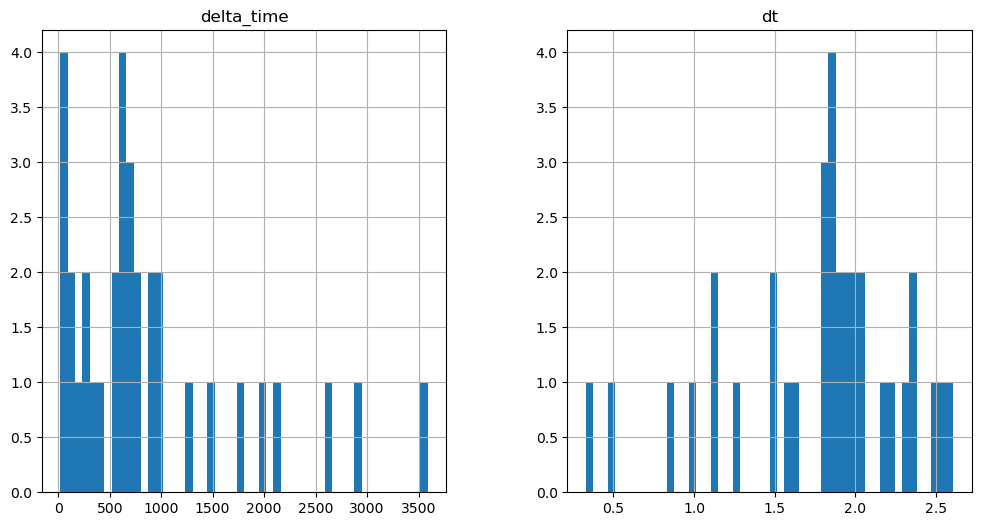

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1705.572974562645 15.705110728740692


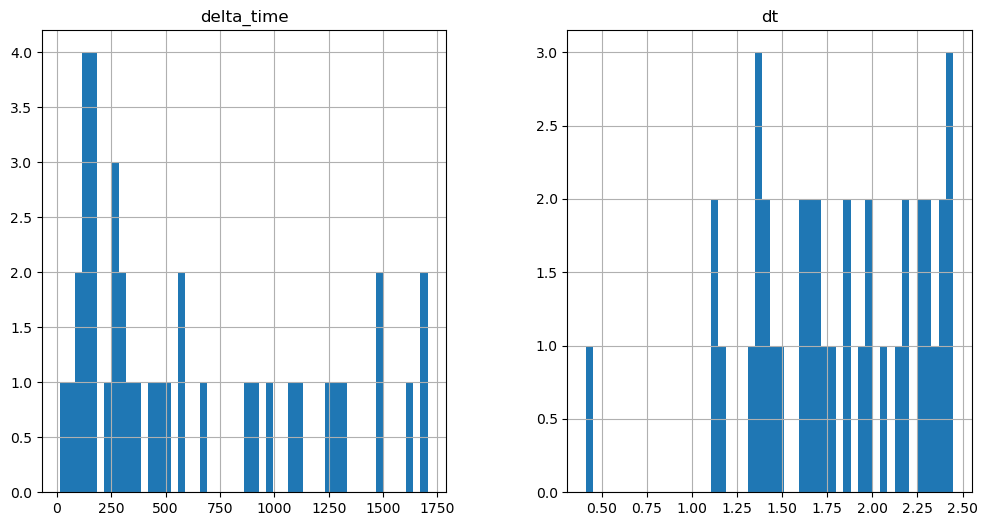

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3329.4806351065636 12.564040660858154


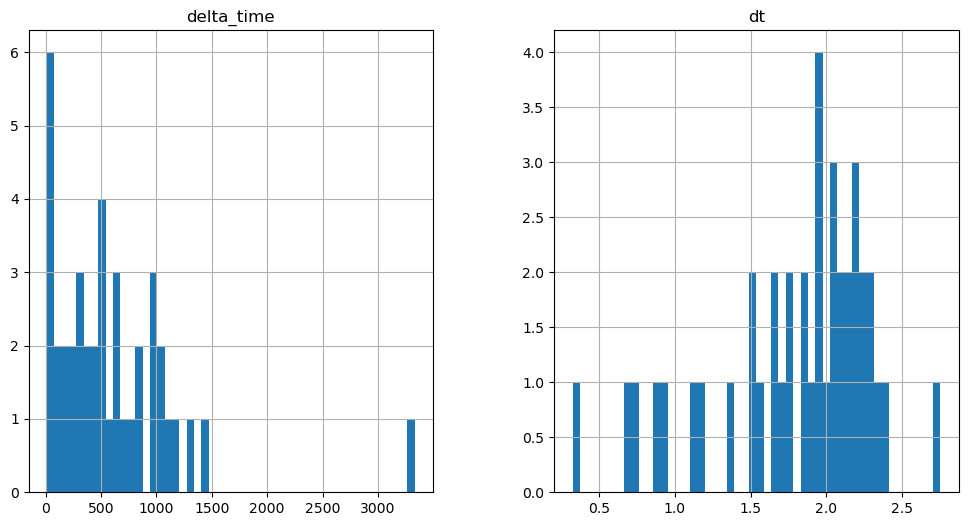

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2453.1297215223312 9.423060417175293


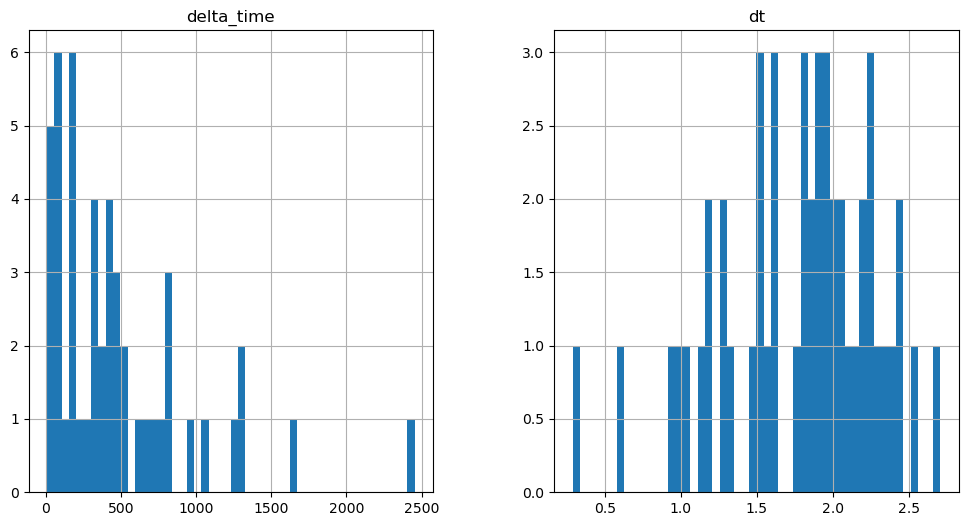

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1152.7504270672798 3.1410101652145386


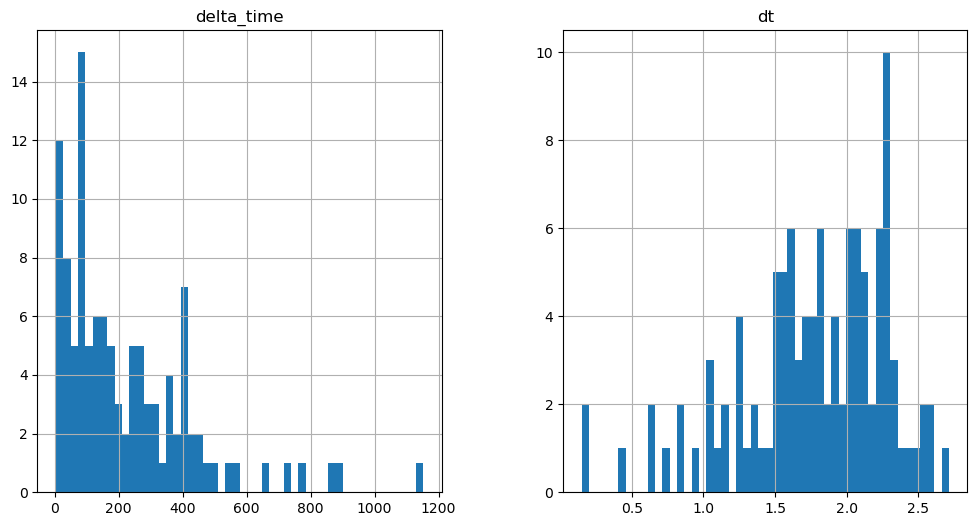

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2808.071769118309 3.1410102248191833


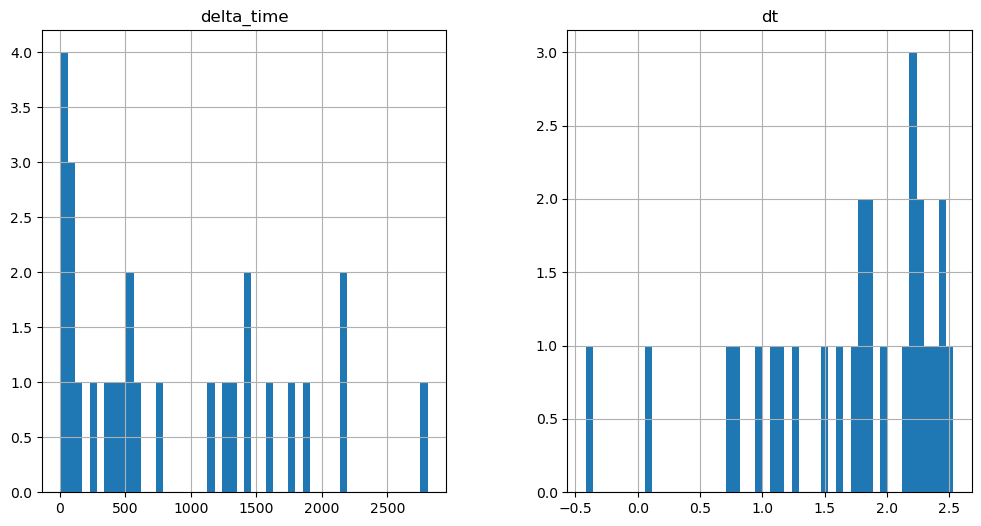

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

716.150735616684 0.1


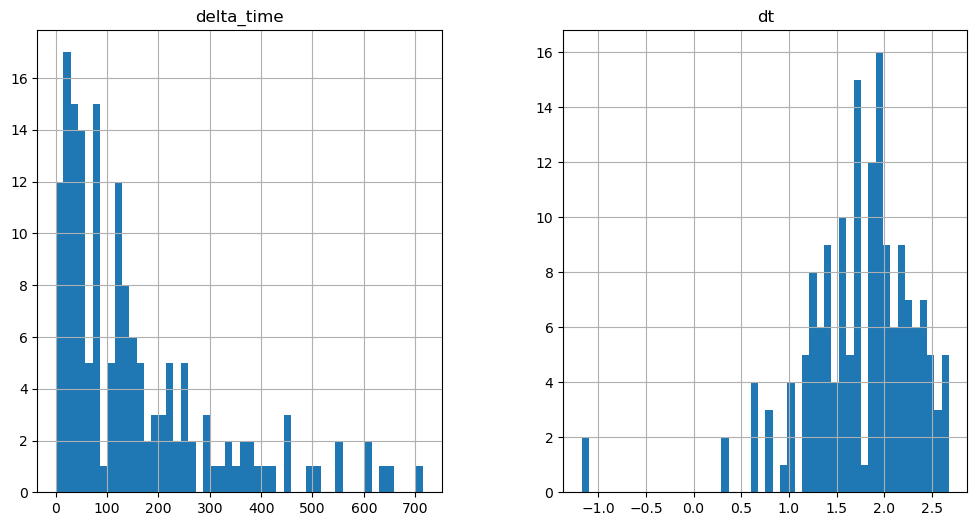

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

838.6478015184402 0.1


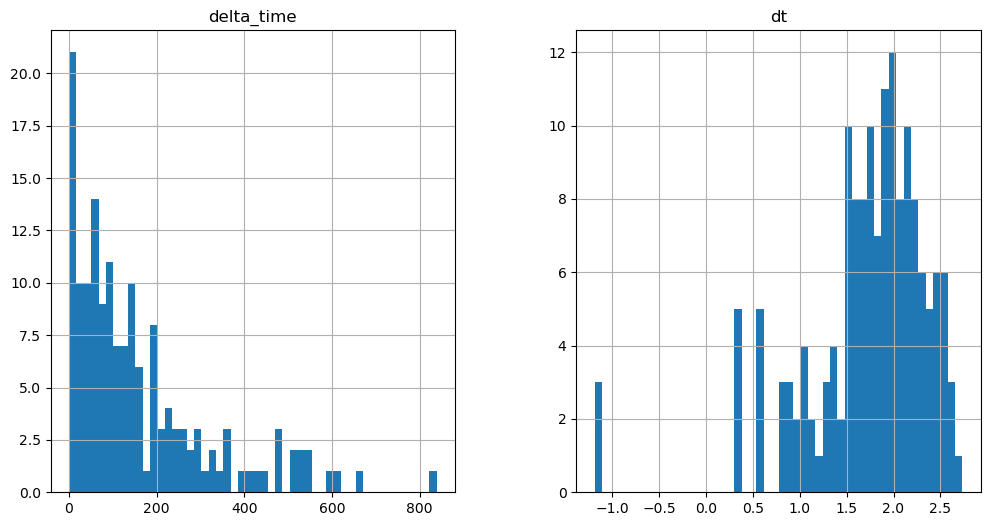

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1856.3426718115807 0.1


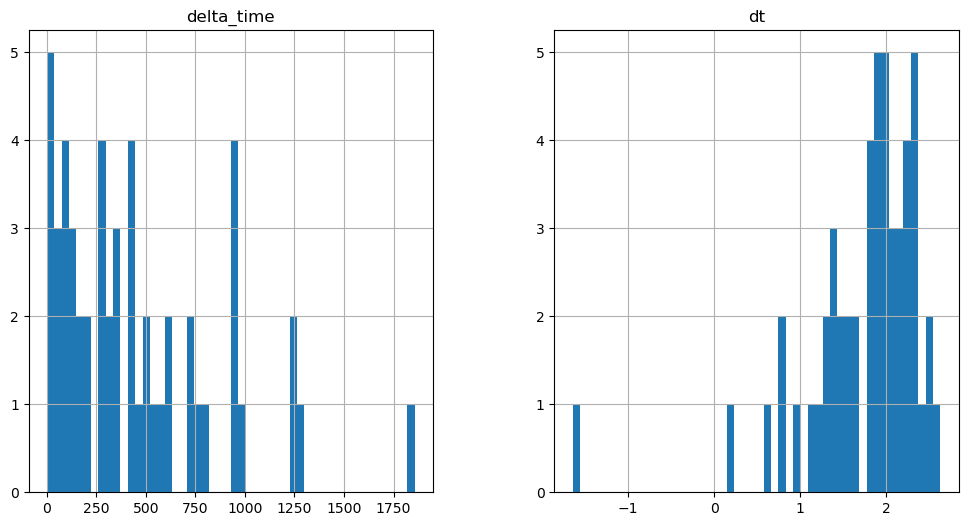

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1850.0628415942192 34.5512216091156


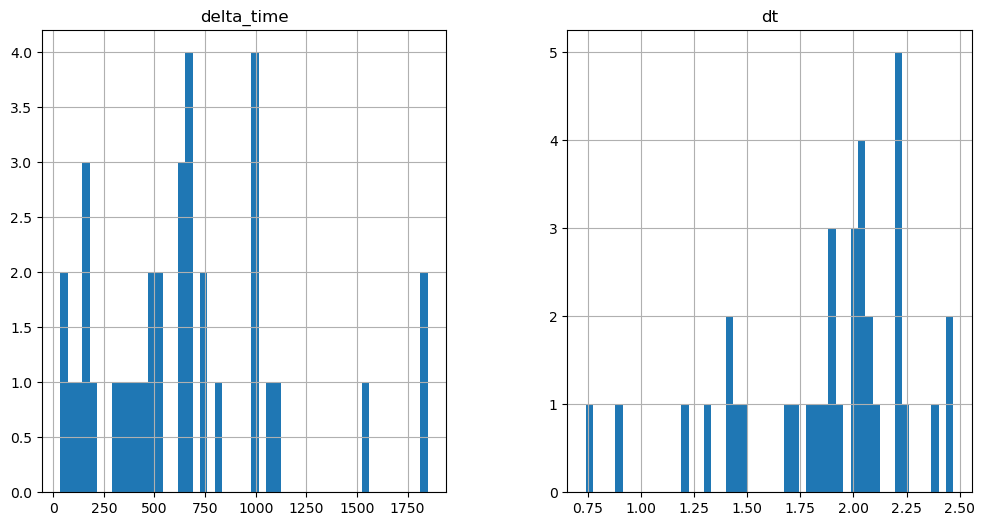

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2415.442609488964 15.705080687999725


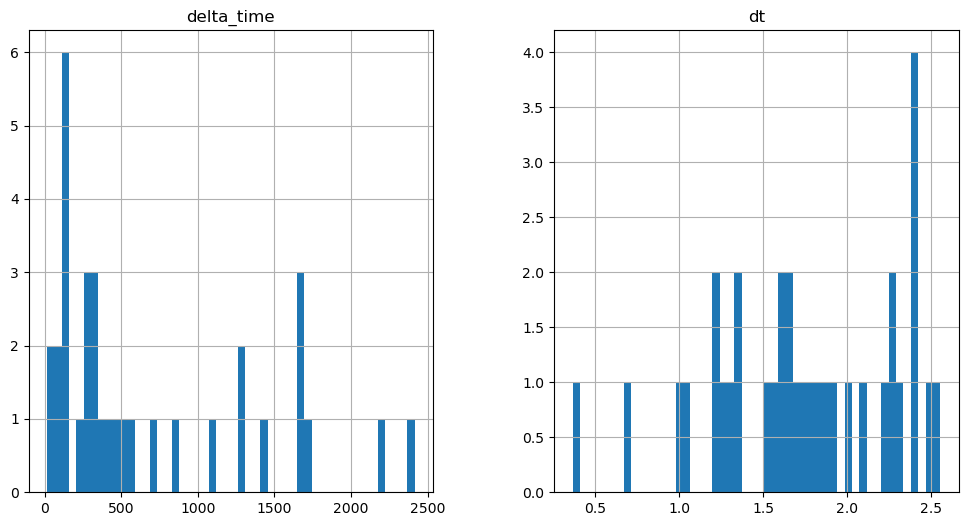

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1498.2679440379143 0.1


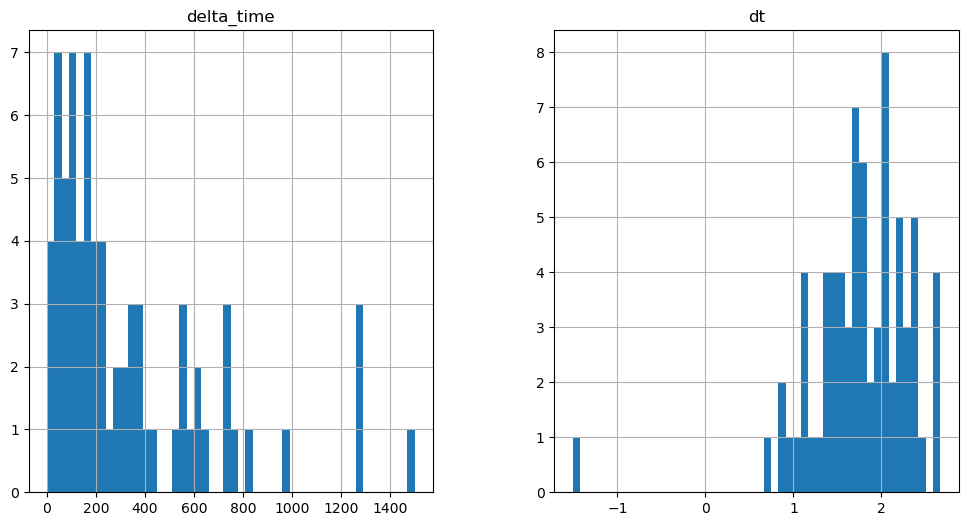

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4262.337823212147 21.986991107463837


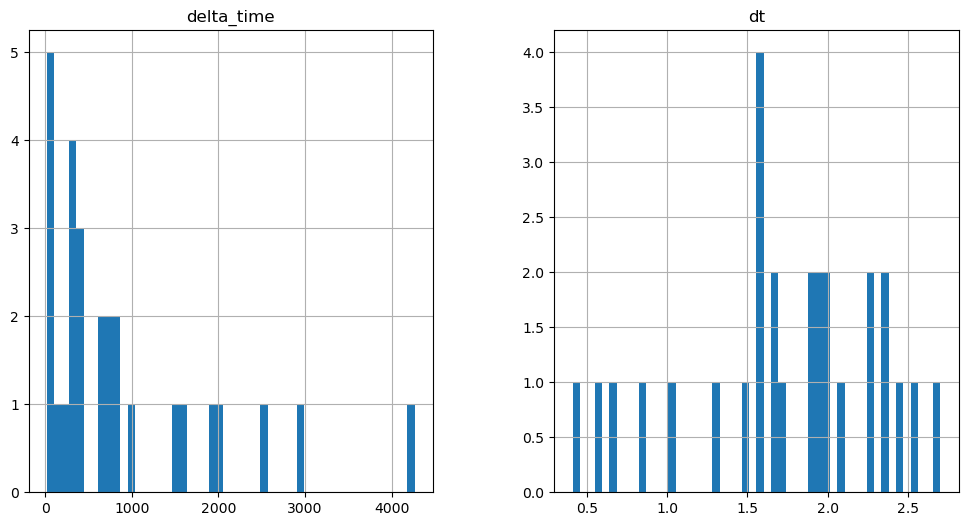

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

873.1981637477875 0.1


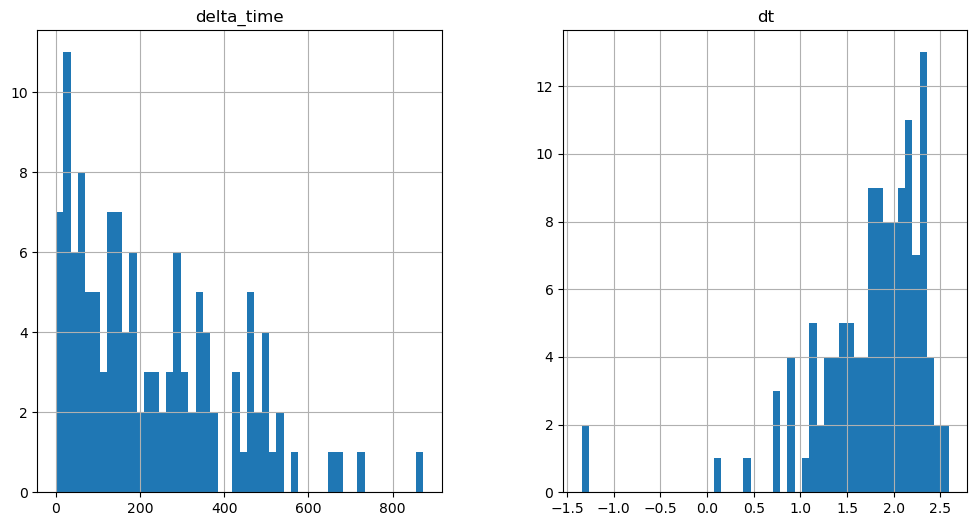

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1162.1702281236649 3.1410101652145386


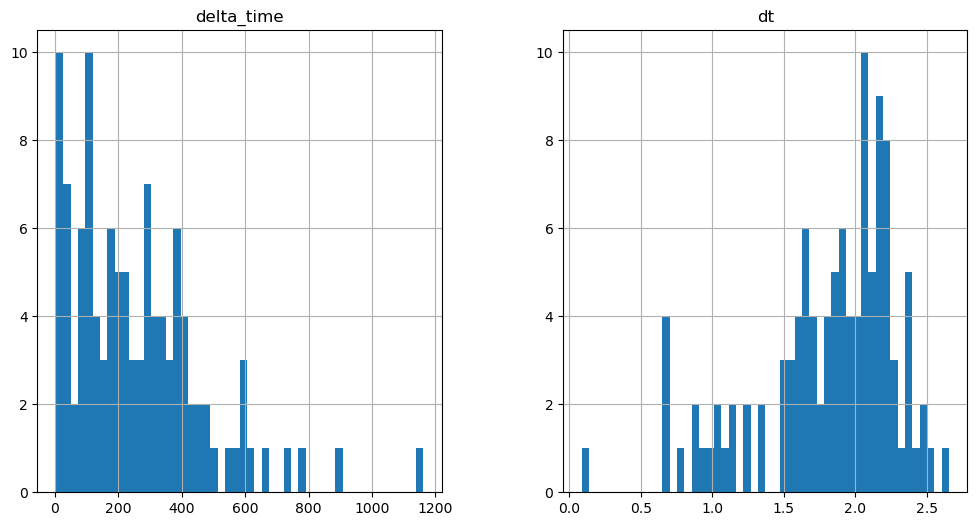

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

634.4821516871452 0.1


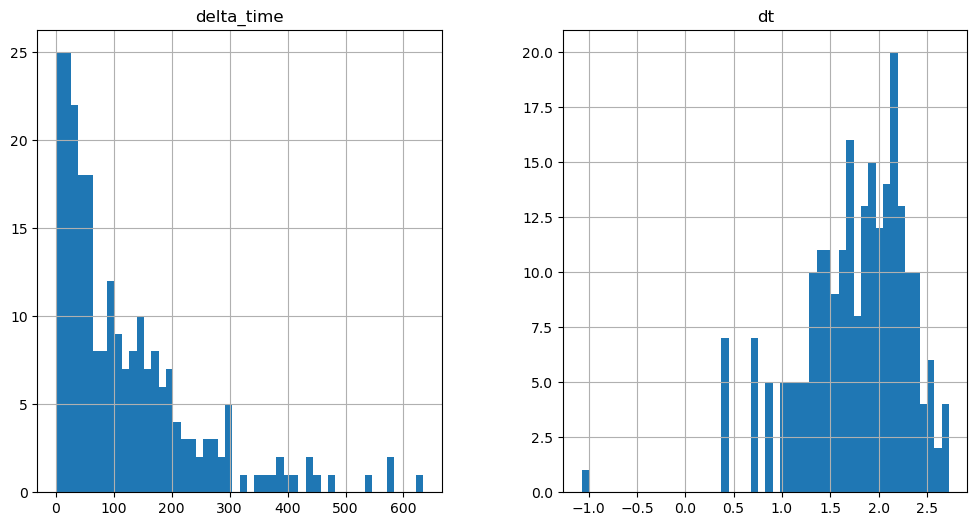

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1589.346829533577 0.1


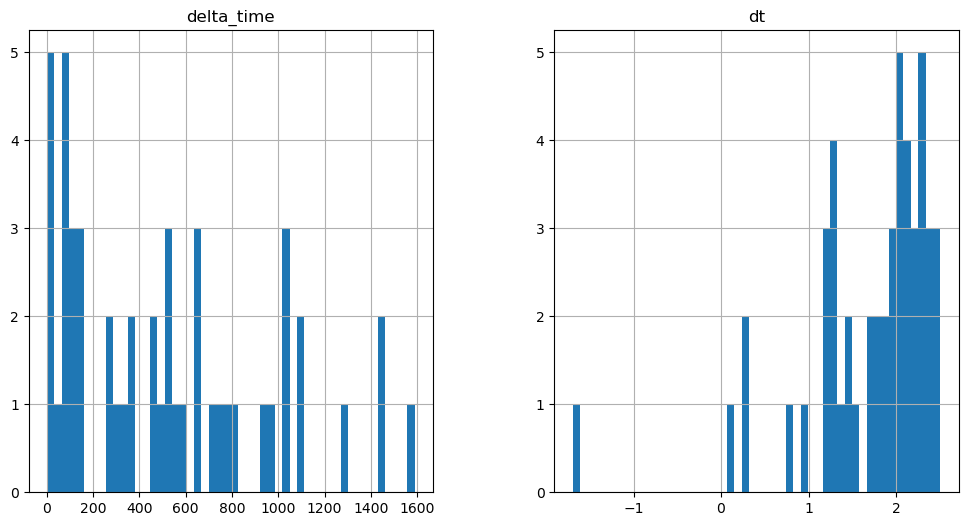

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

709.8661254048347 0.1


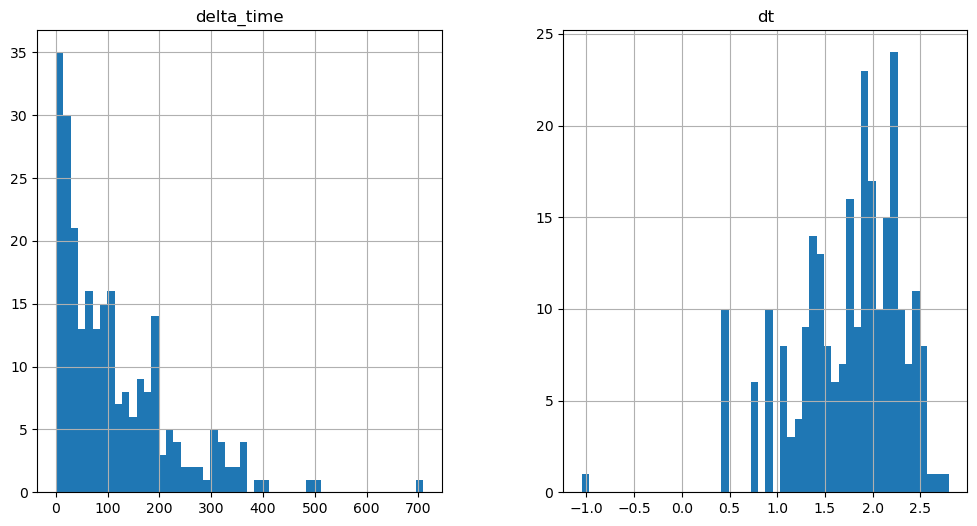

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1287.8102645277977 3.1409801840782166


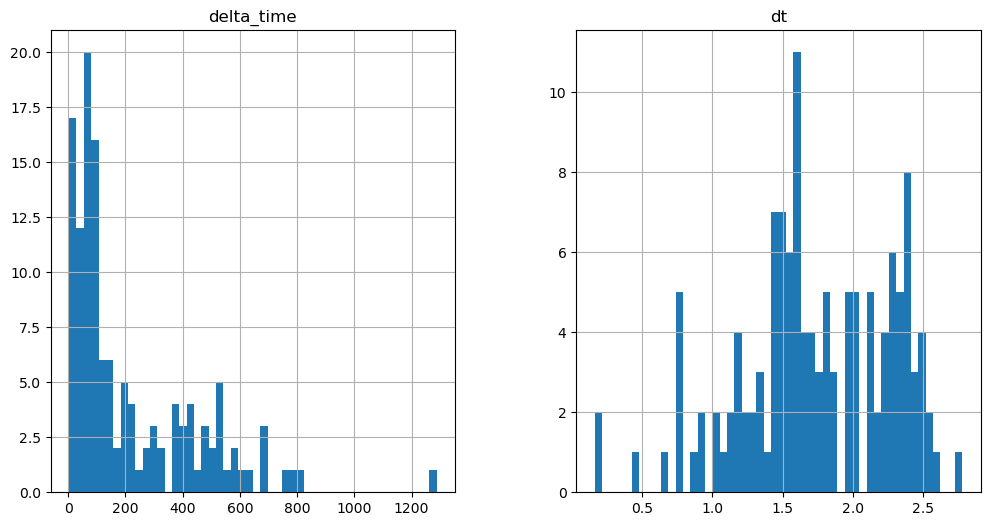

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1488.8343443870544 0.1


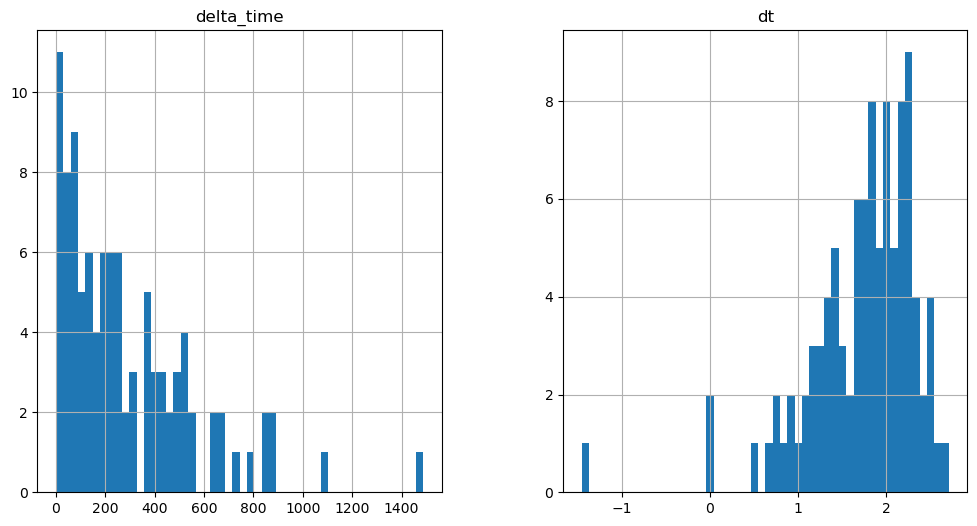

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1969.4073486924171 18.84601092338562


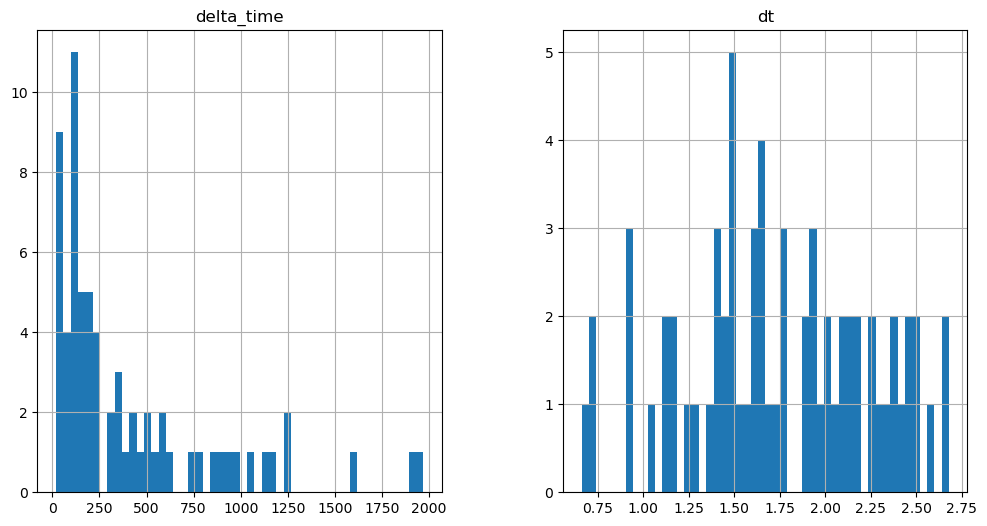

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1630.1792916059494 12.564000606536865


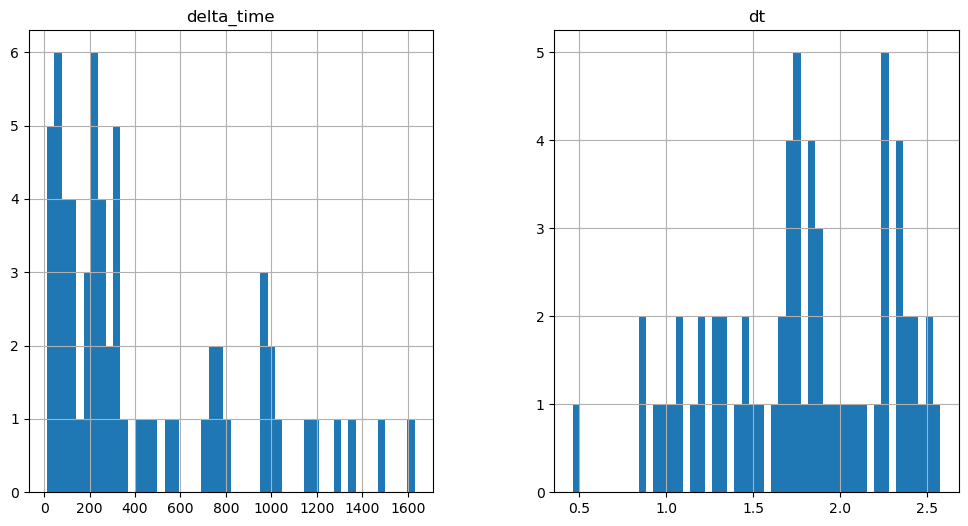

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1840.6270520687103 28.269001364707947


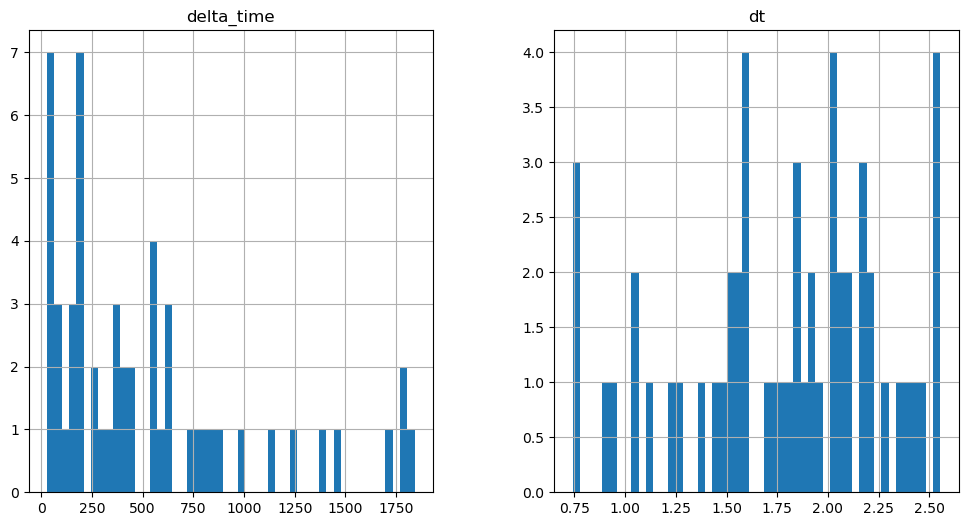

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2161.0085982084274 0.1


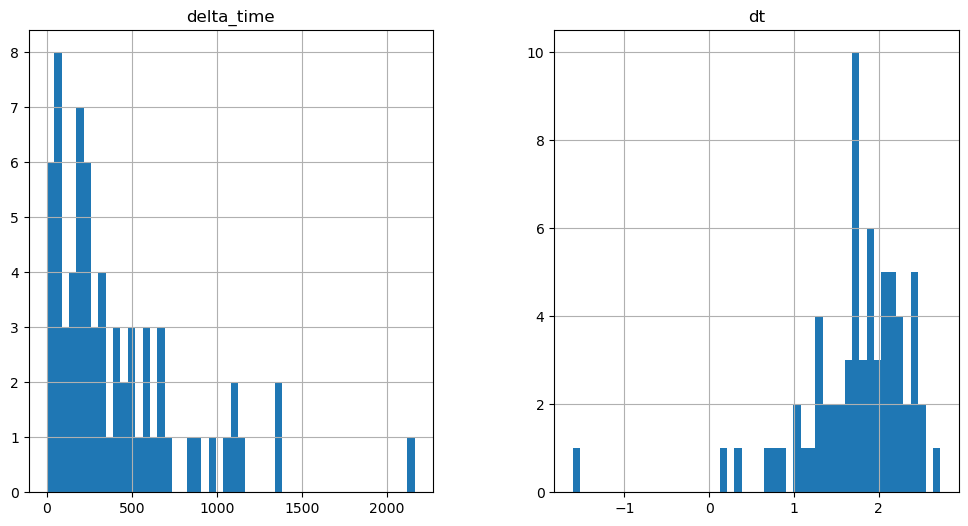

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

518.2650461196899 0.1


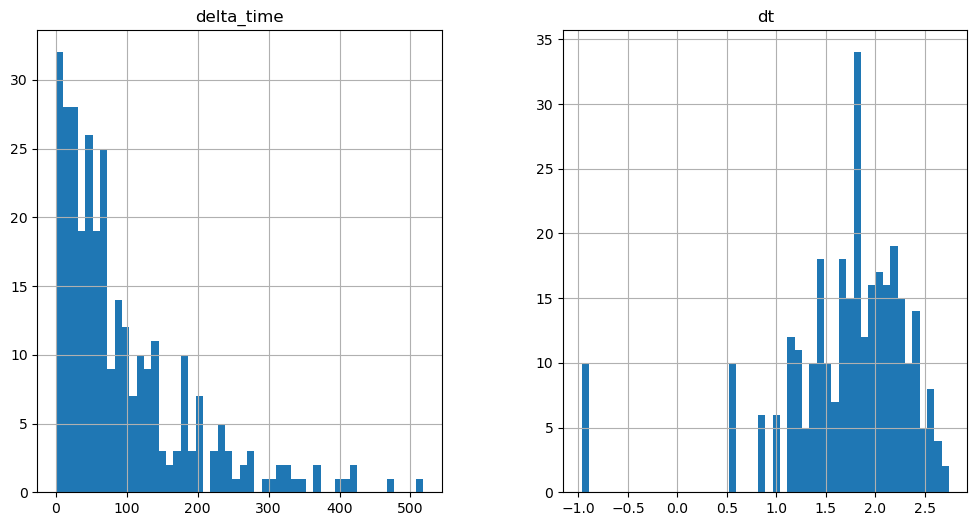

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

361.2150981426239 0.1


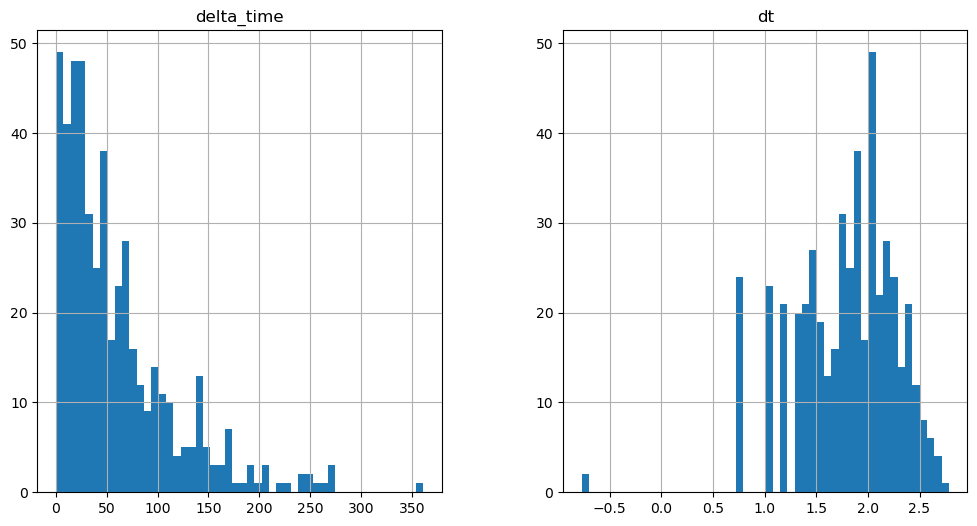

2836.3240008354187 15.705000758171082


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

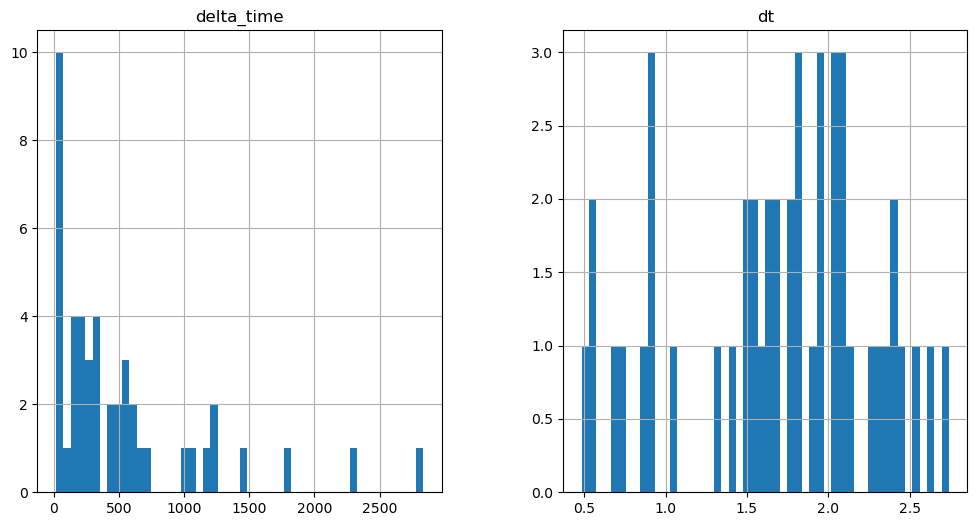

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1868.895702779293 21.987031042575836


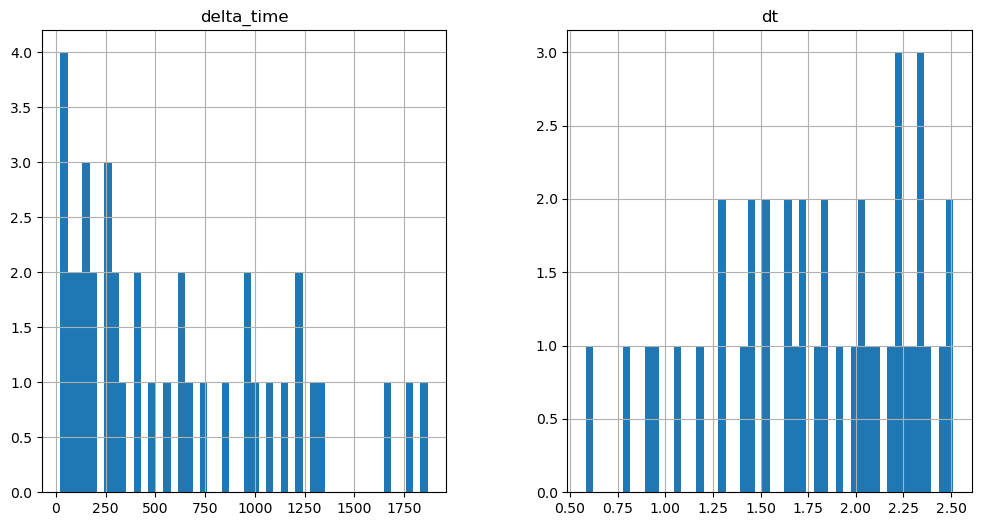

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2487.675173521042 21.98719096183777


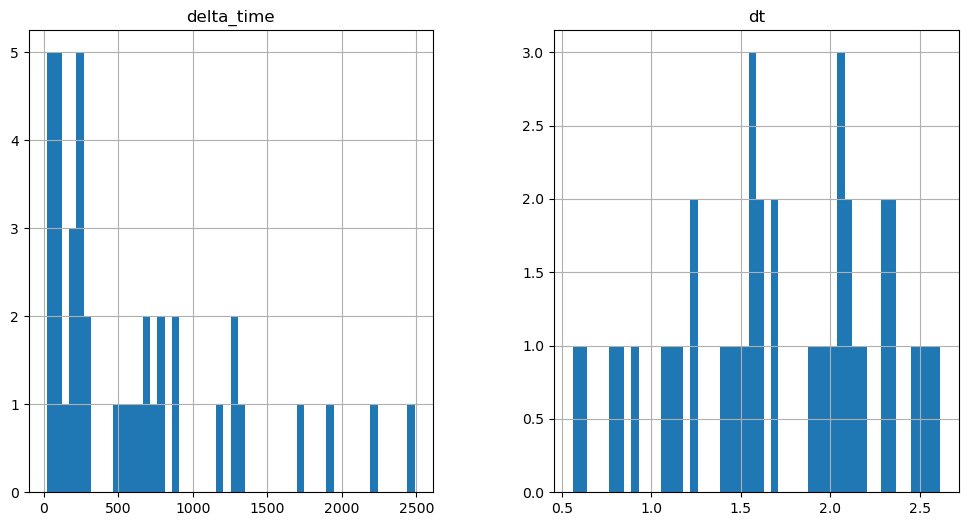

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1020.8253607153893 3.1410101652145386


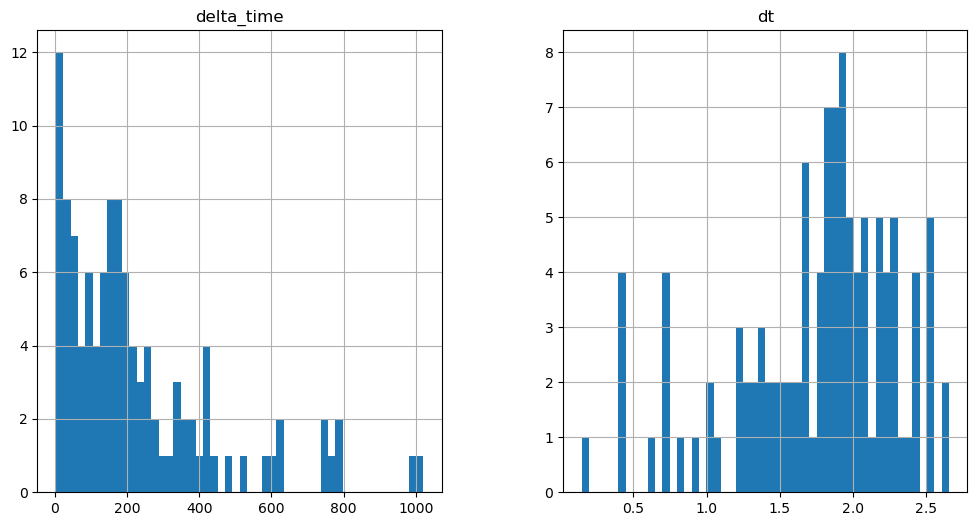

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

559.0985576510429 0.1


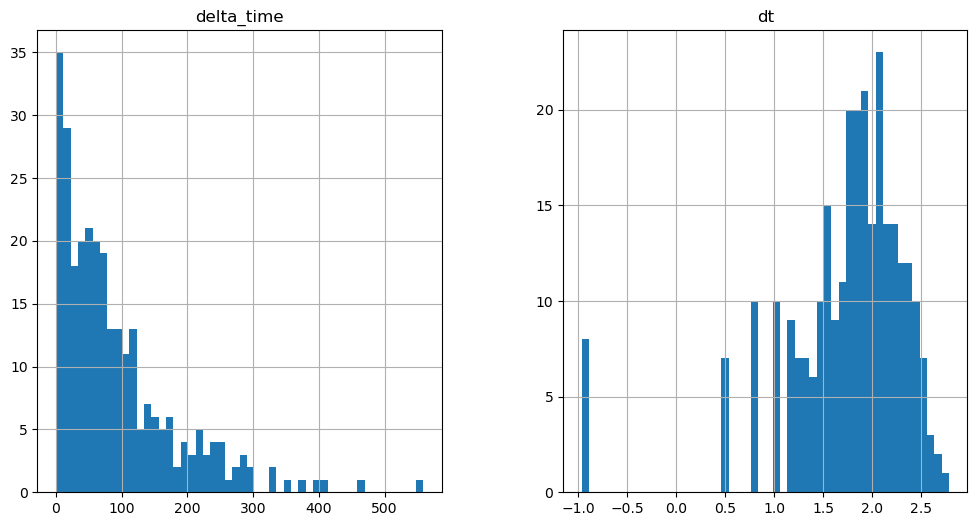

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

741.2812168002129 0.1


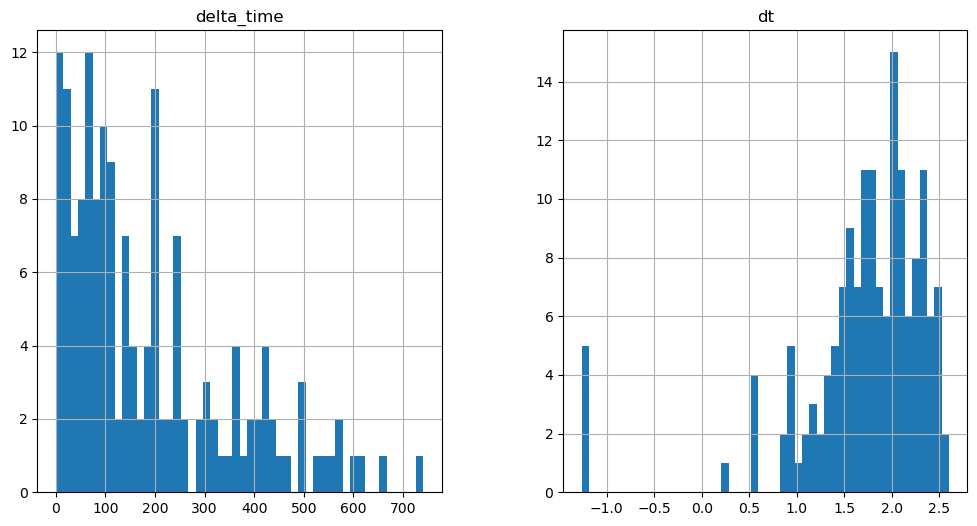

2139.0365060567856 21.987061083316803


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

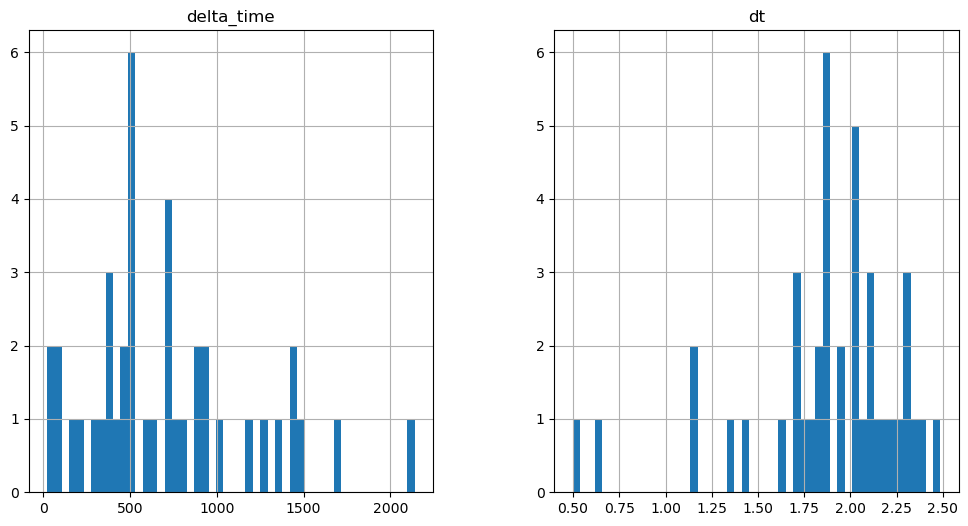

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2123.325805425644 0.1


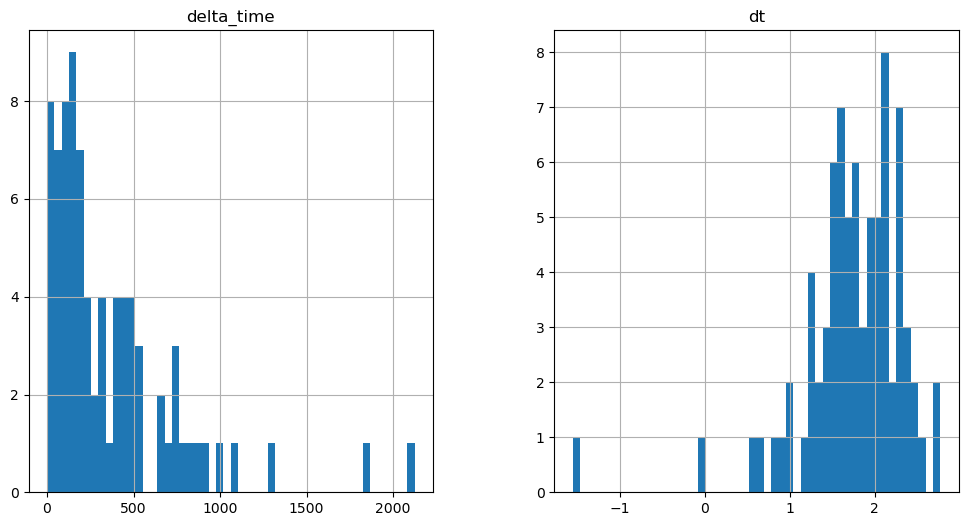

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1605.0614195466042 0.1


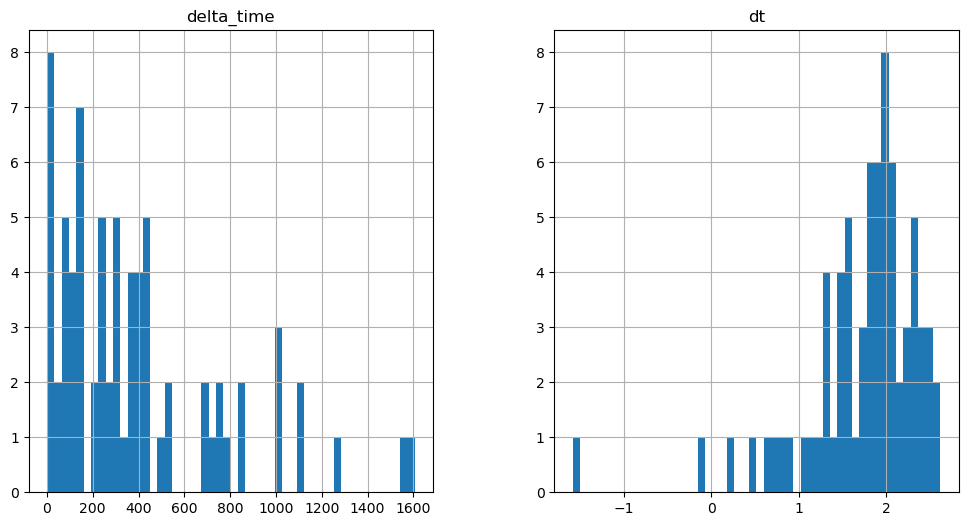

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1699.2935042977333 3.1410102248191833


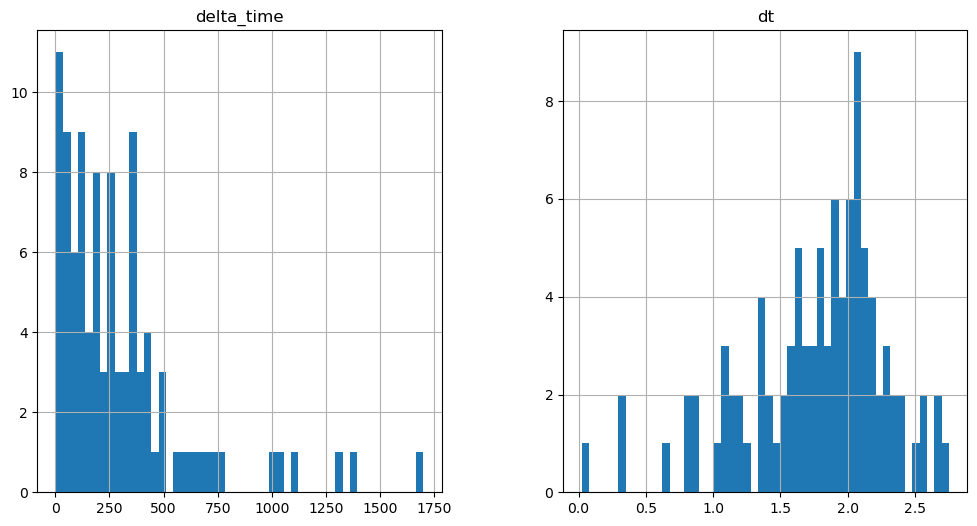

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2088.7787935733795 0.1


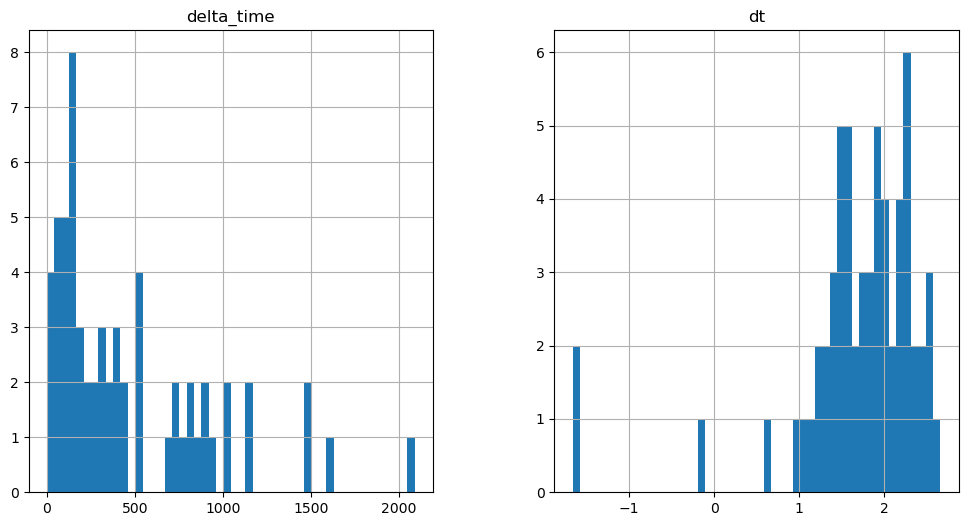

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1341.214586675167 3.1410102248191833


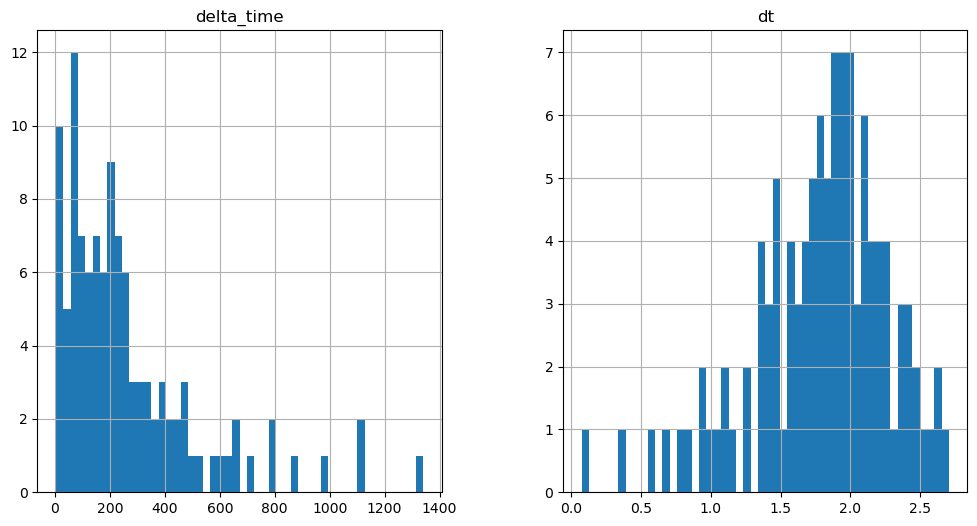

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1925.4446656107903 12.564070641994476


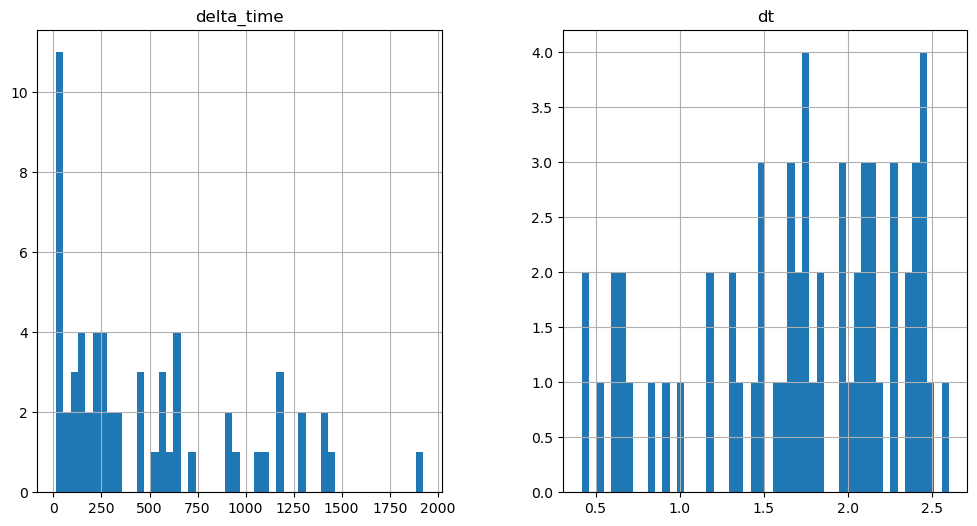

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1118.2021154165268 3.1410001516342163


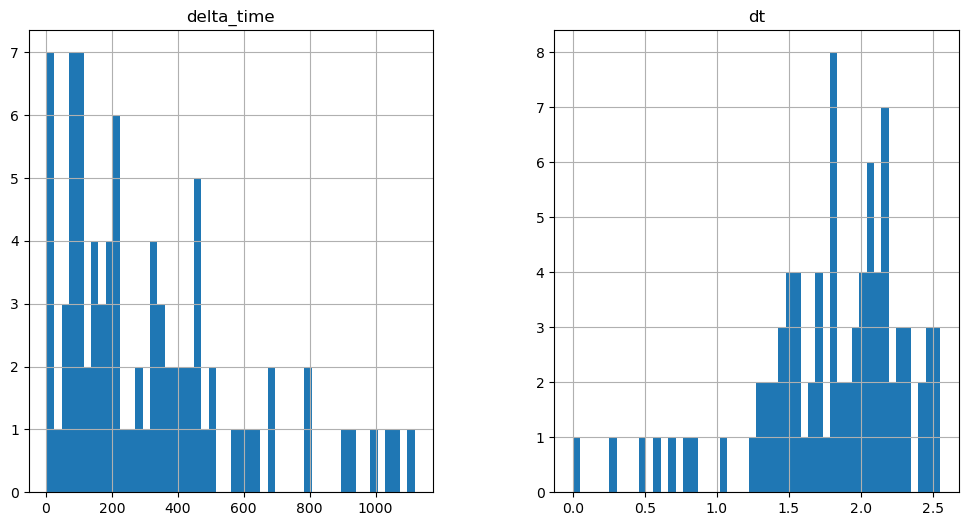

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3970.245586812496 25.128181219100952


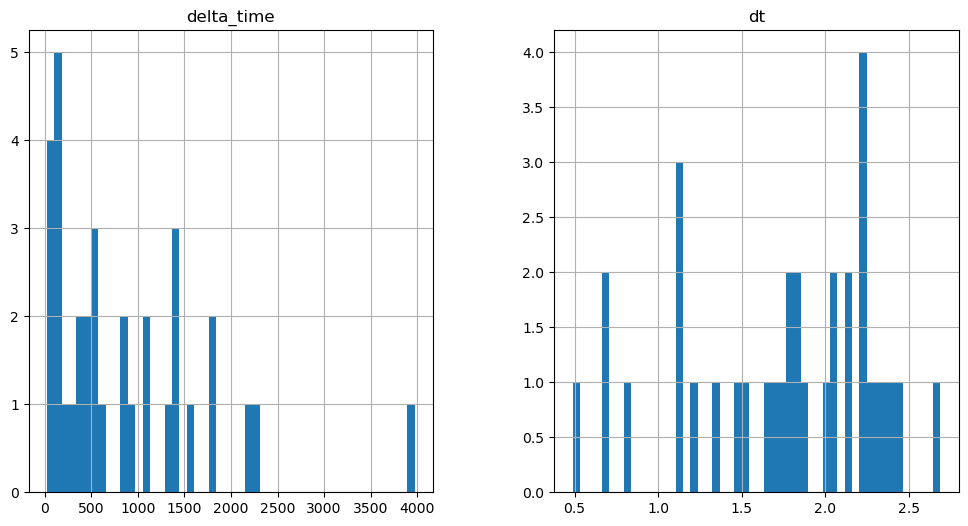

2676.1438828110695 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

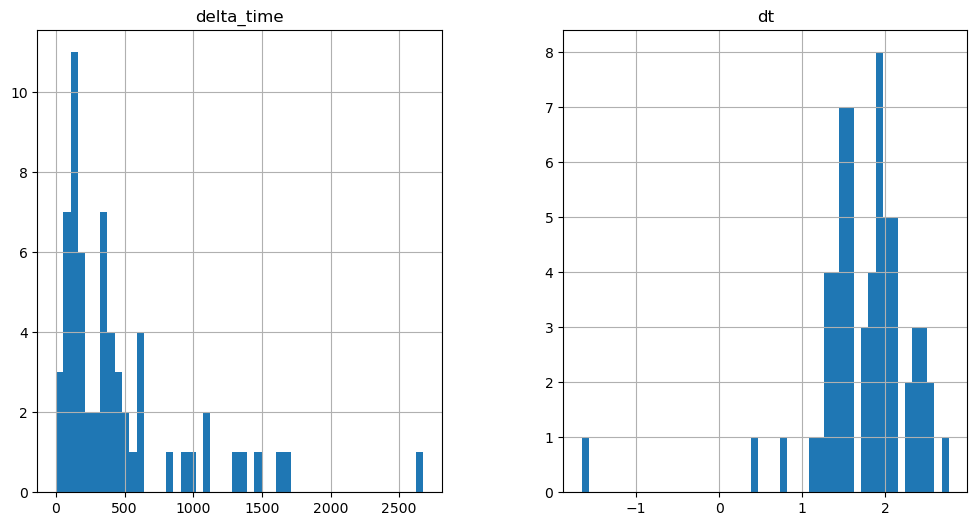

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1155.8920872807503 3.141030192375183


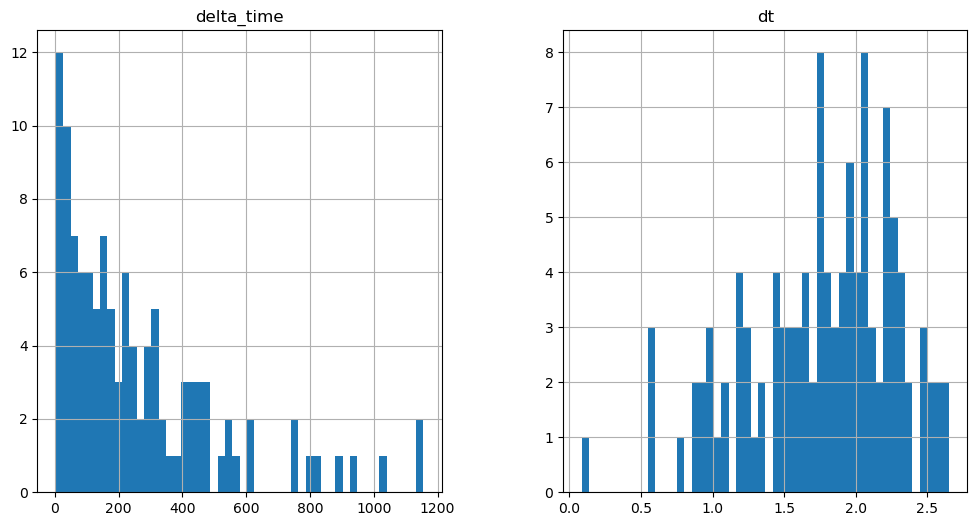

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2993.38493847847 6.282040357589722


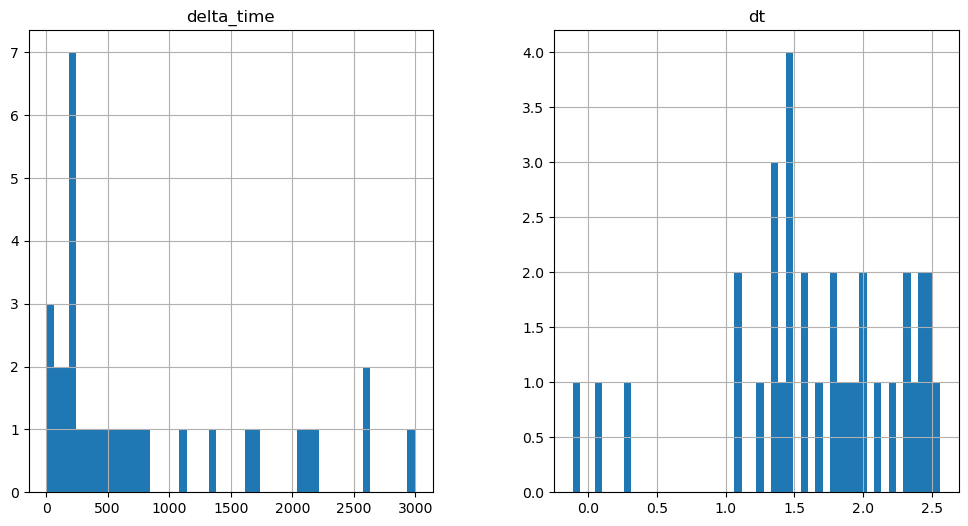

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1777.8105385899544 6.282020330429077


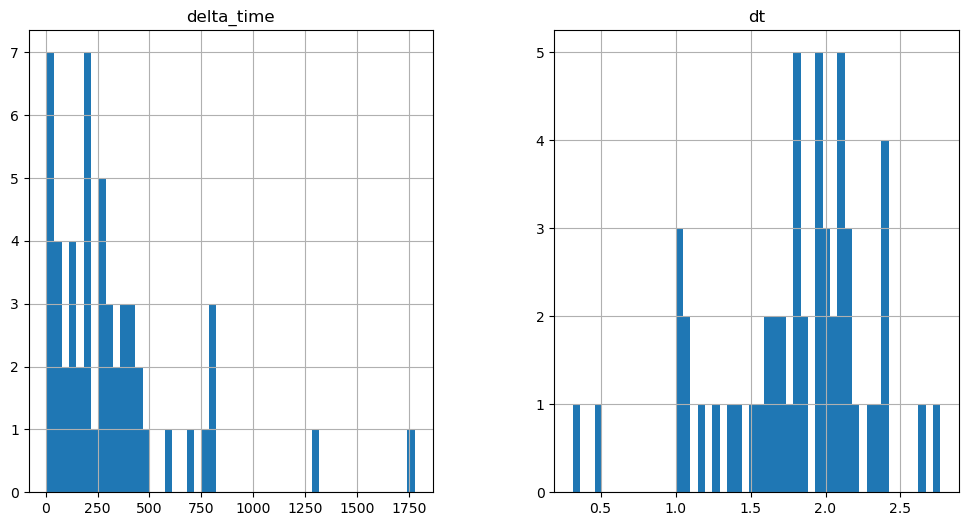

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2032.227651298046 0.1


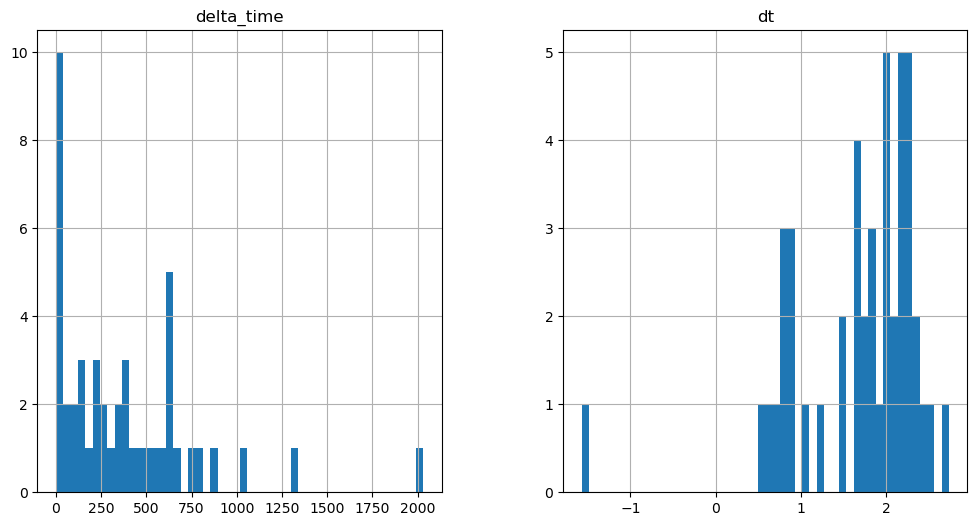

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1105.634665131569 3.141000211238861


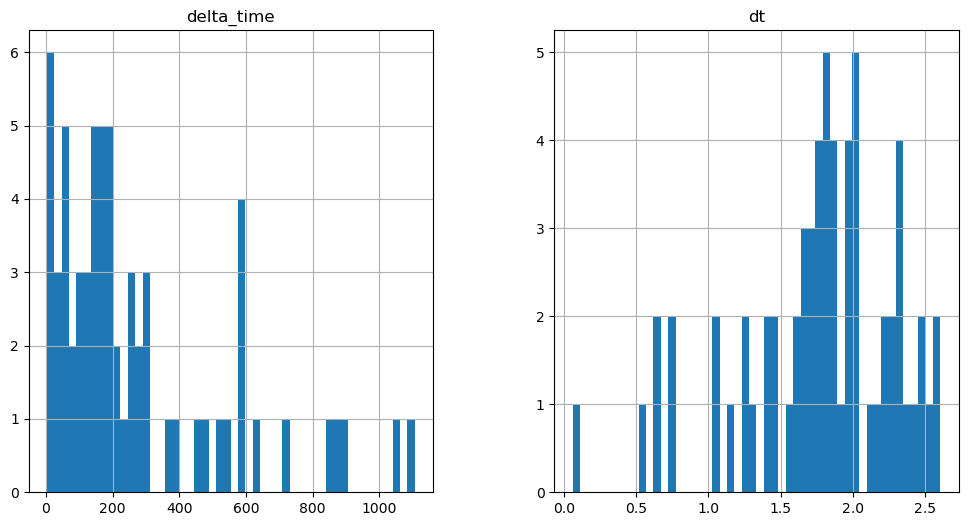

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2465.6968229413033 0.1


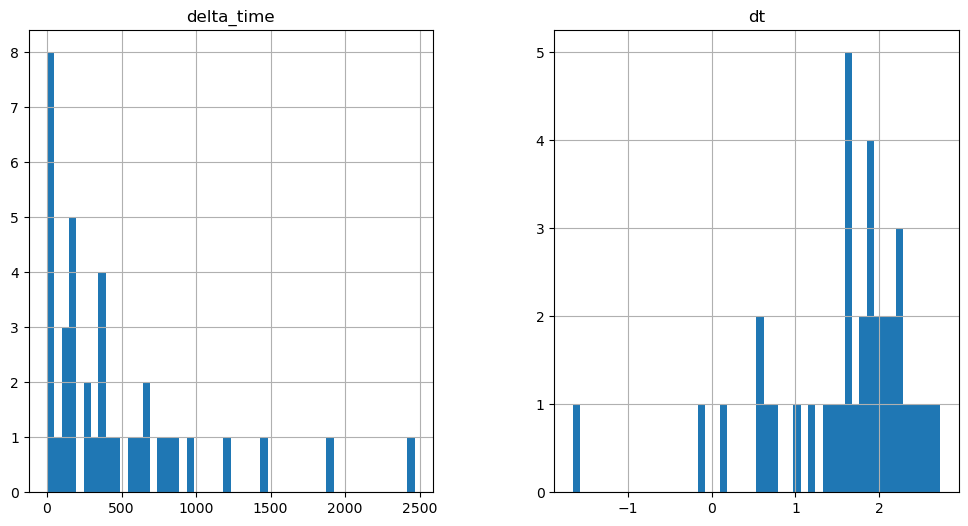

1667.8720831274986 6.282030284404755


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

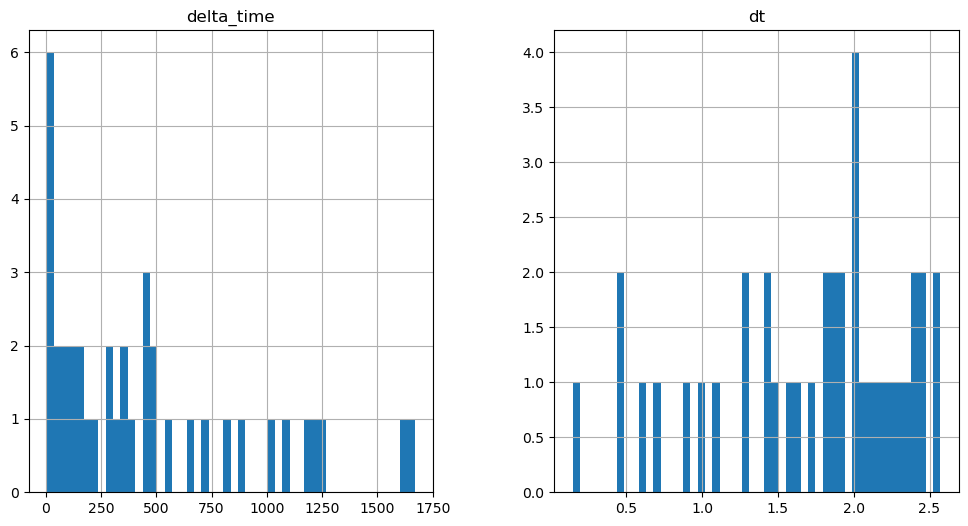

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

103.65335524082184 0.1


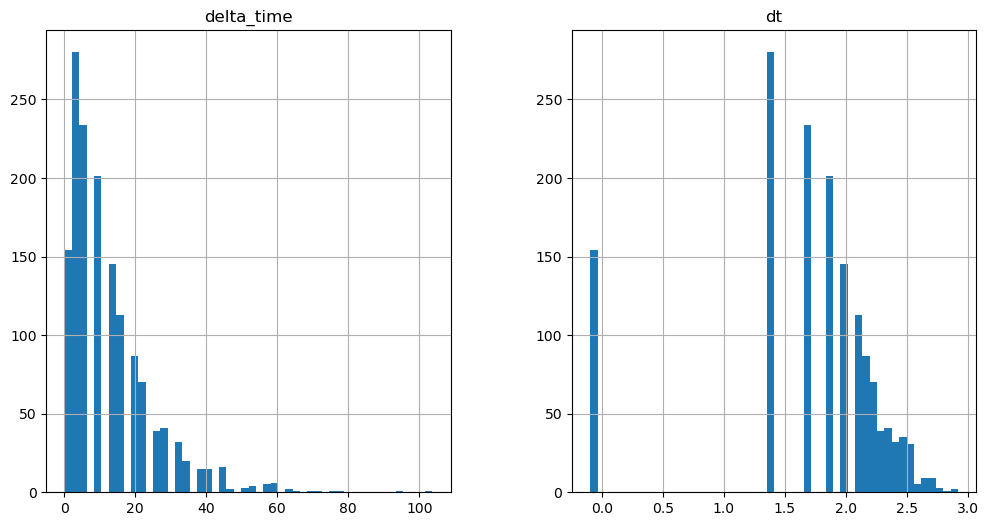

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

914.031675517559 3.141010046005249


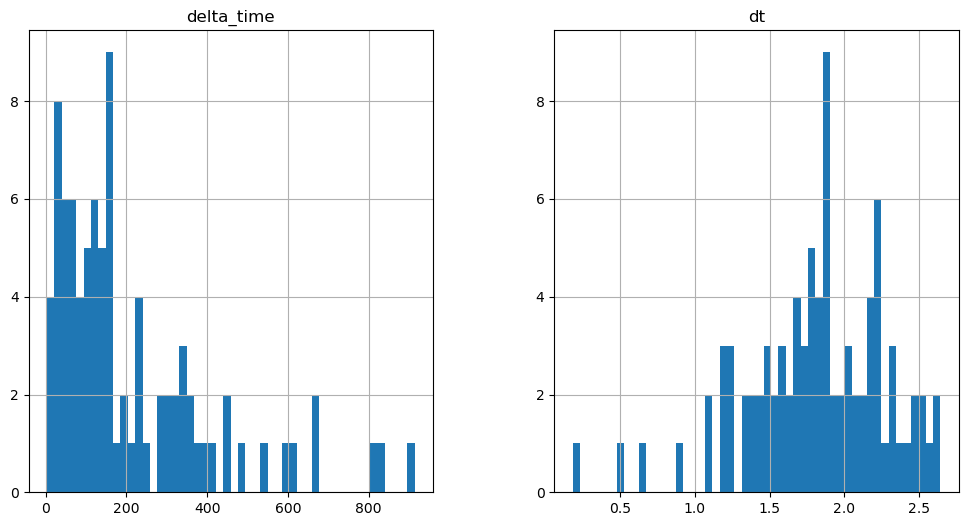

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1485.6950941681862 0.1


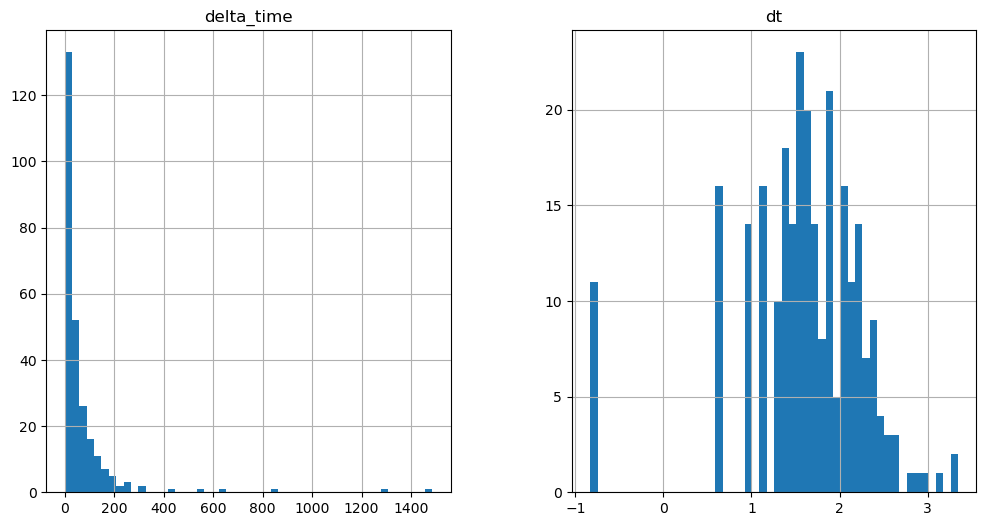

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2993.375781238079 6.282000303268433


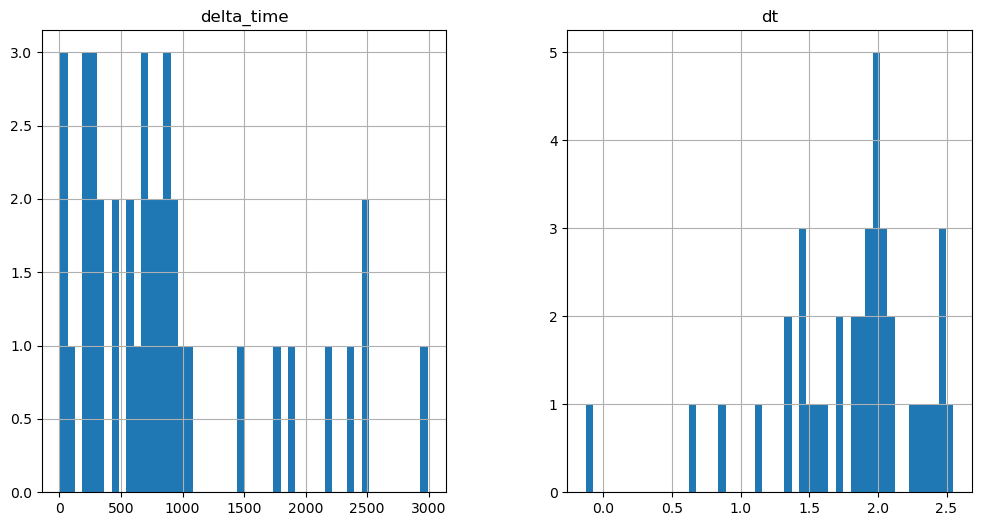

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1507.6801761984825 6.282000303268433


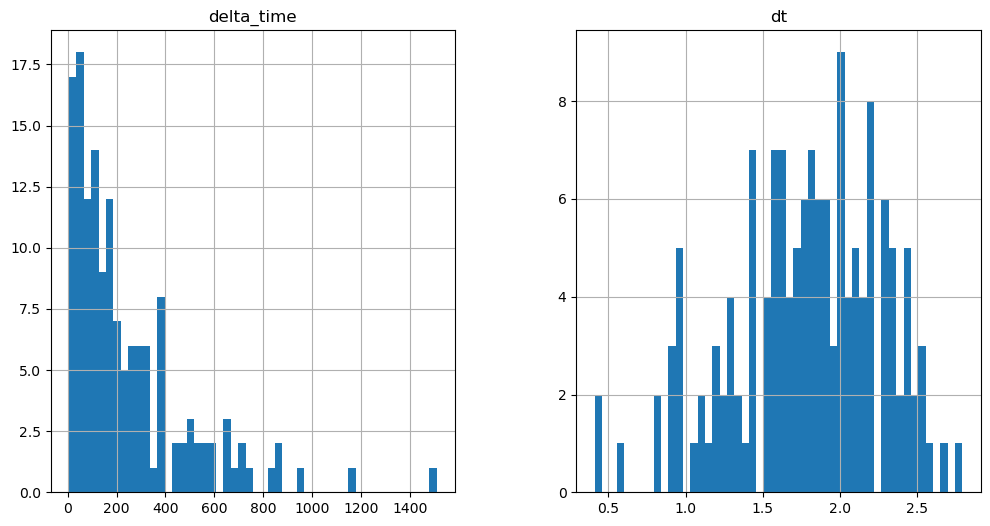

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1919.1511270403862 9.422990560531616


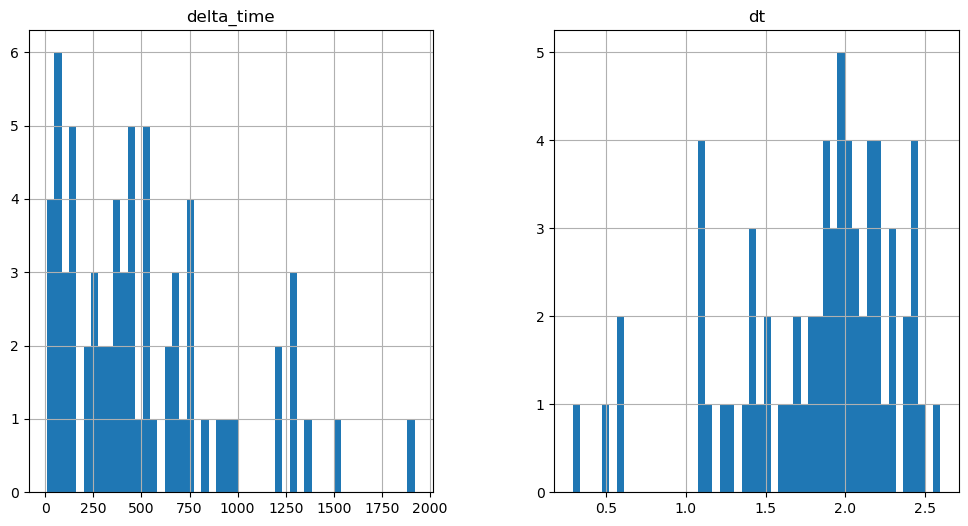

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2085.6241654753685 3.141040086746216


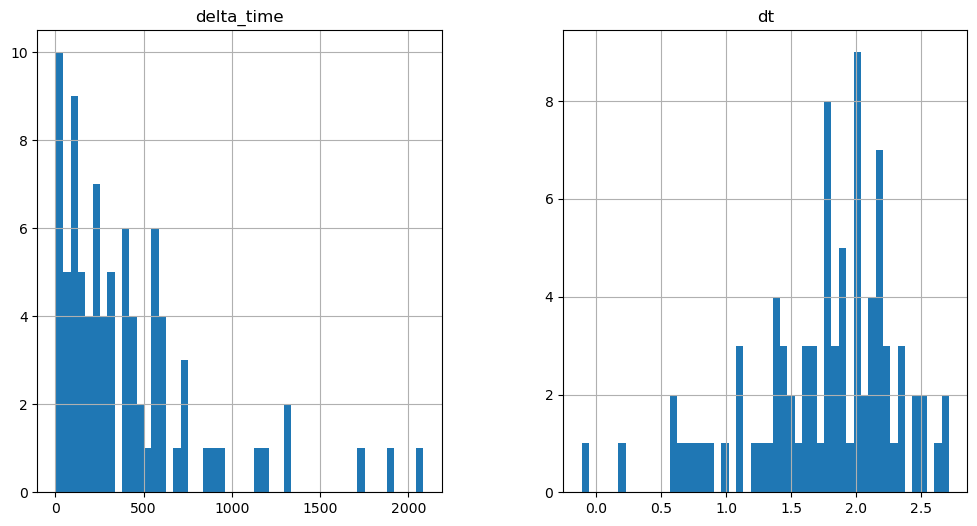

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2047.933103621006 28.269001483917236


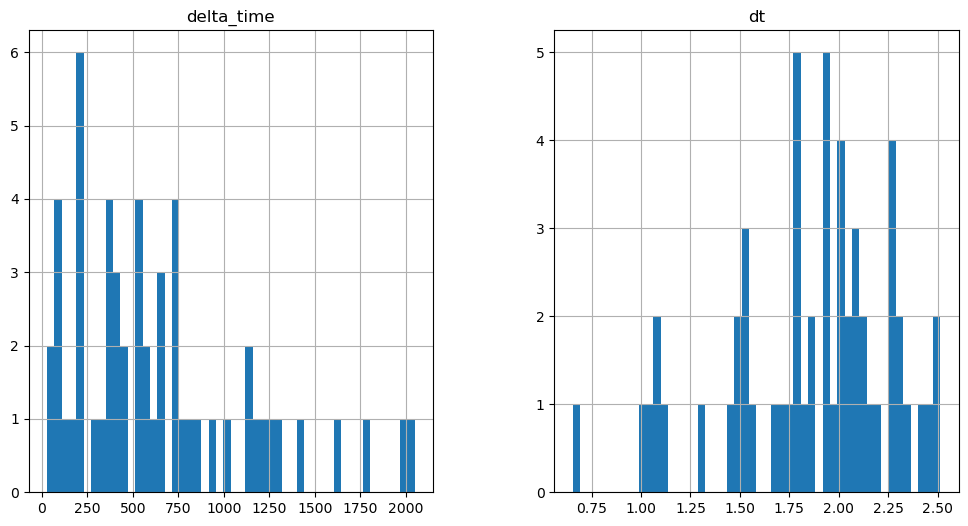

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2047.9322434663773 0.1


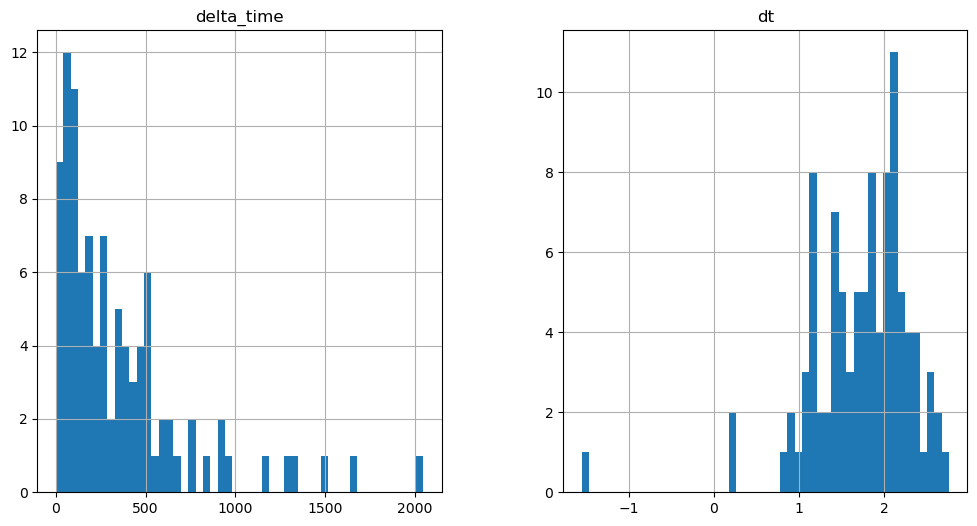

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1906.5871863365173 3.141010105609894


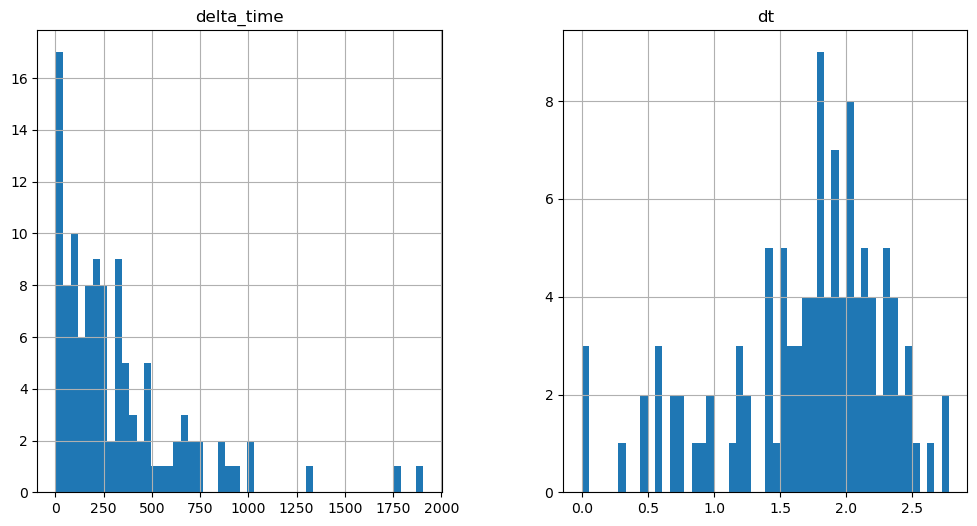

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1721.268236875534 9.422990500926971


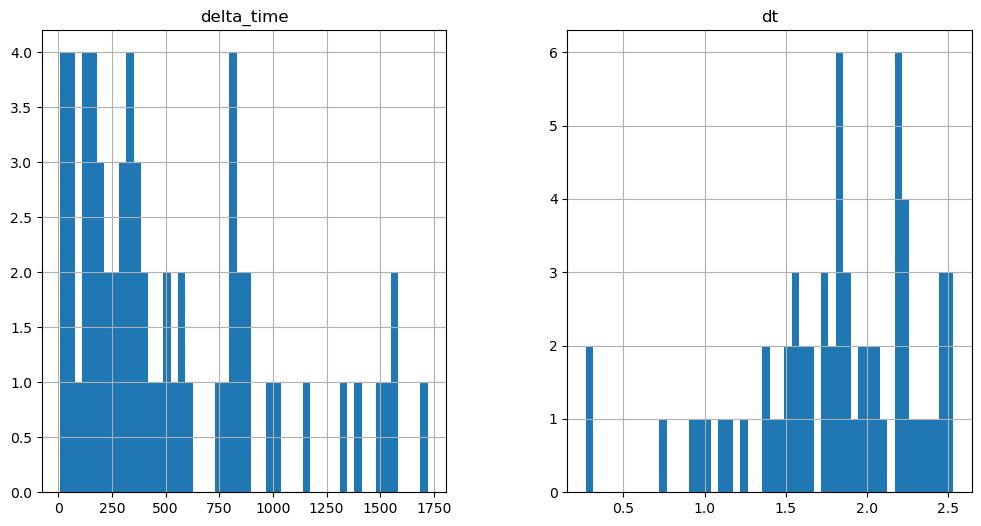

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4739.769439458847 3.140990138053894


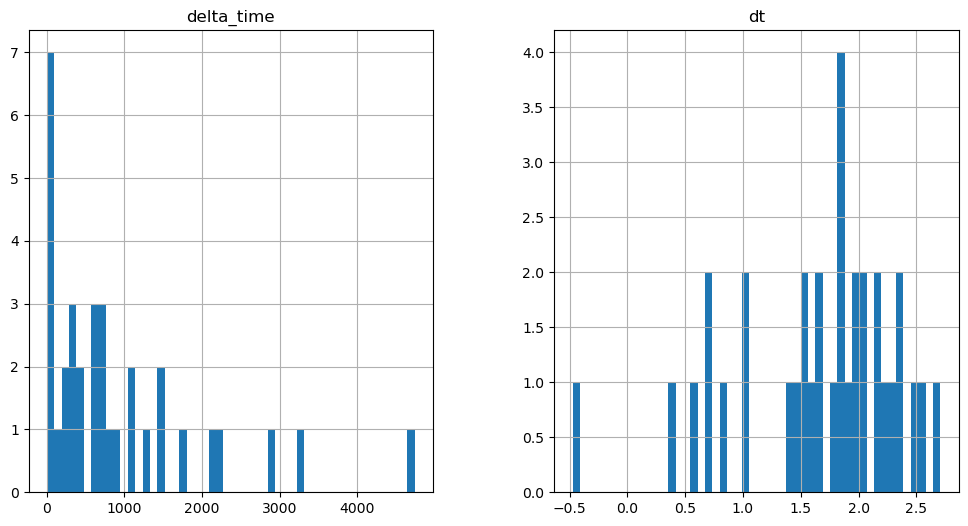

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1328.6431670188904 3.1409900784492493


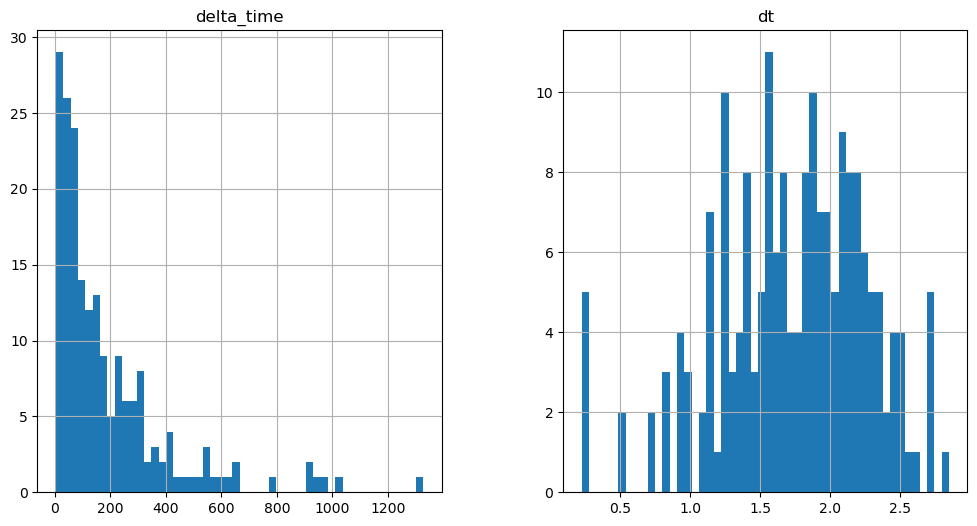

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1972.5482296347618 0.1


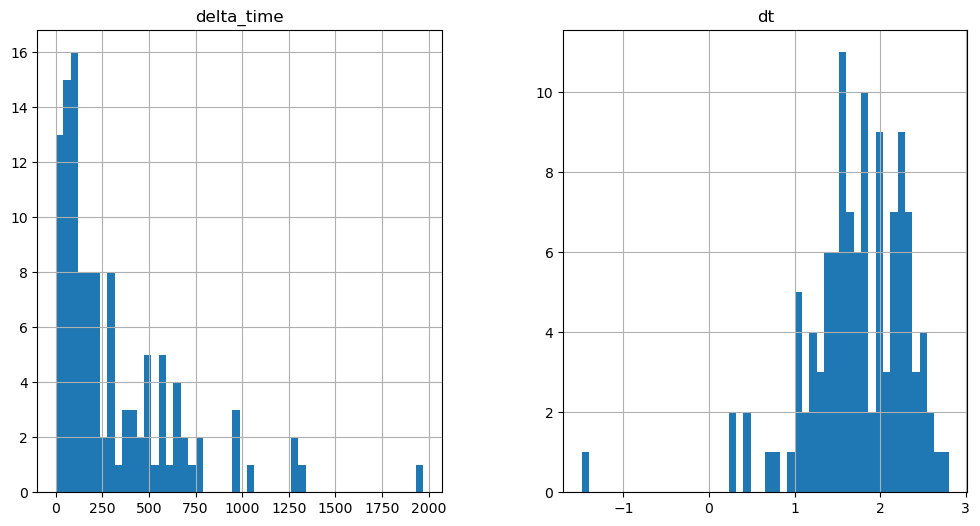

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5091.586662769318 69.10246360301971


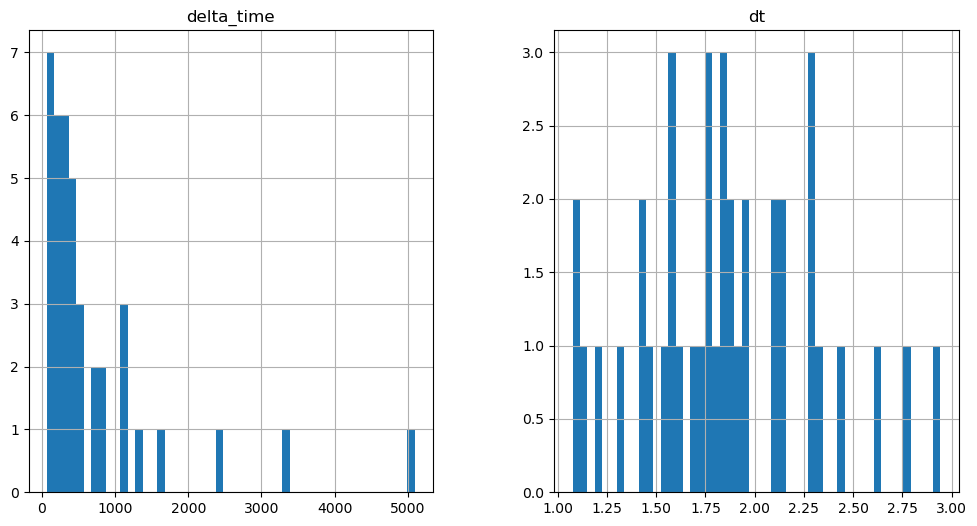

2481.407883346081 15.705110728740692


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

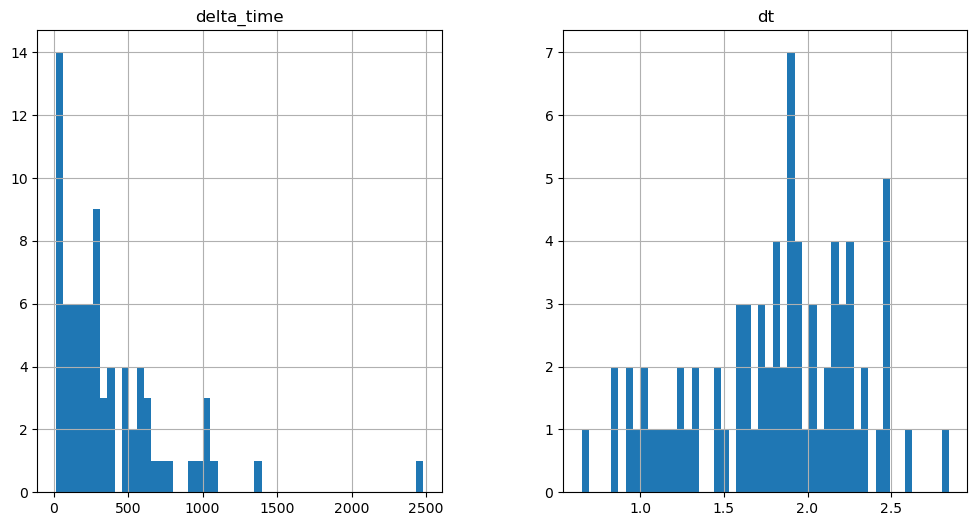

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2311.7908748984337 15.705100655555725


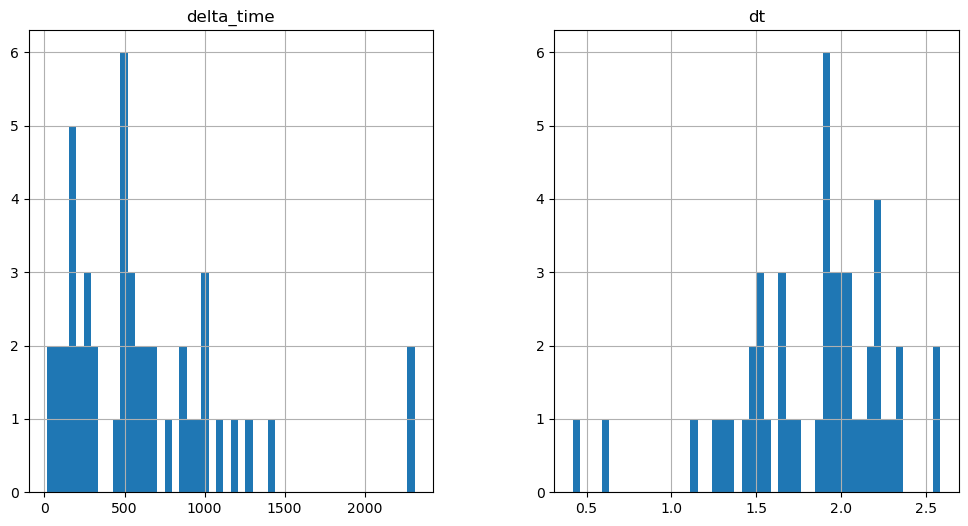

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1350.6392670869827 9.423060536384583


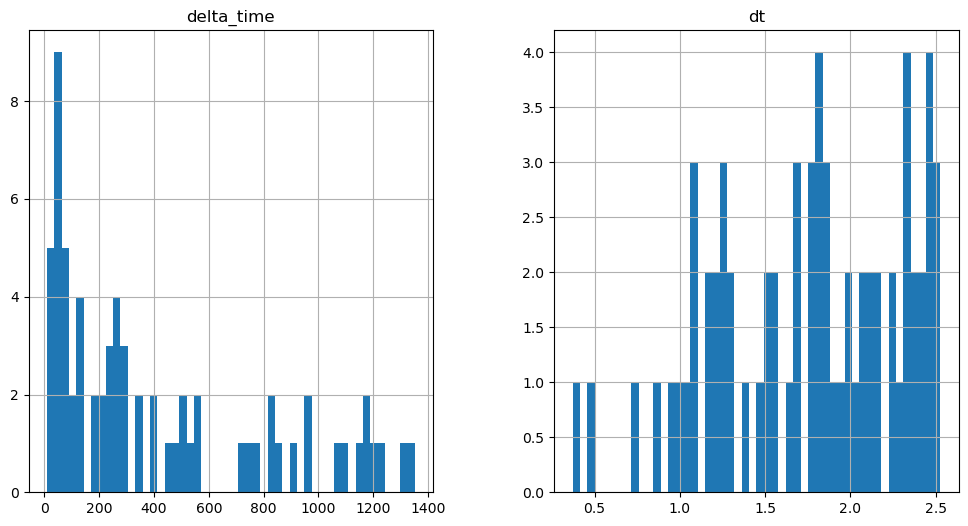

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1344.3574767708778 9.423040509223938


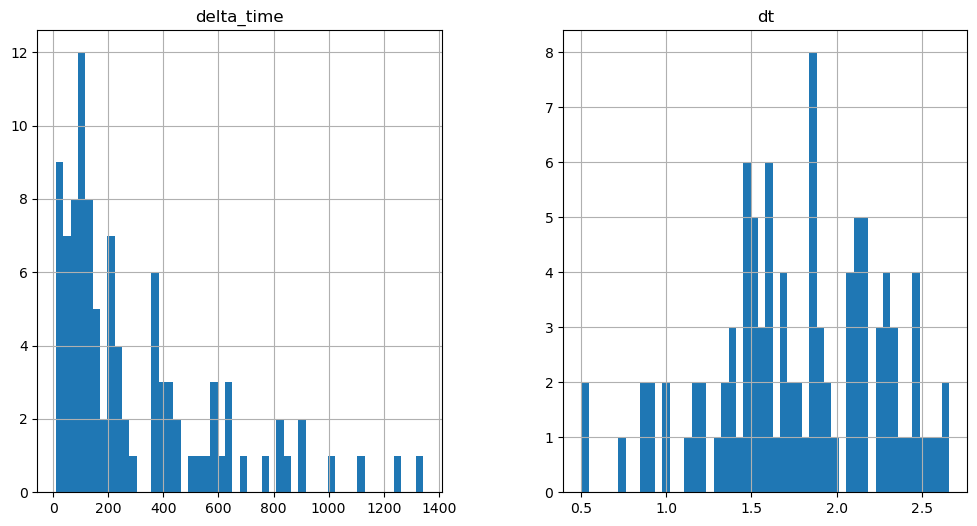

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2490.828633725643 9.423040449619293


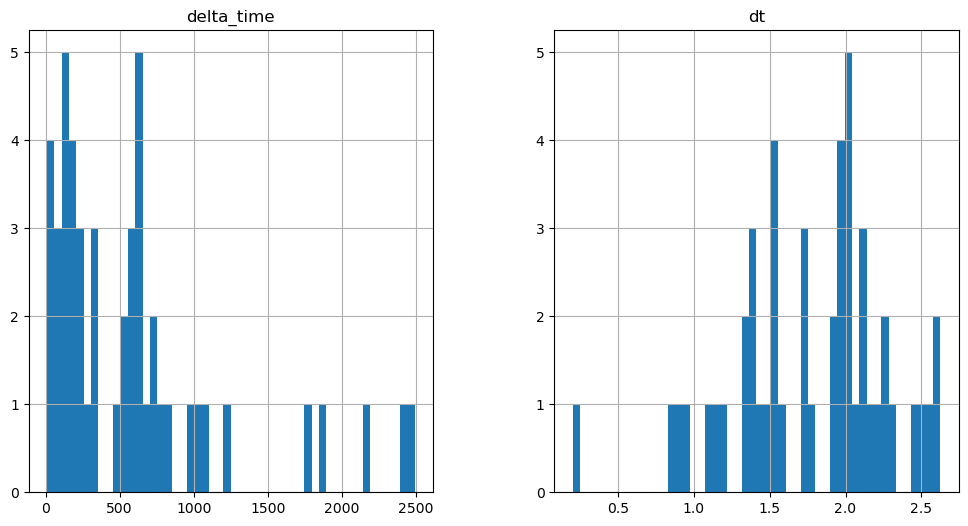

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2704.4139942526817 0.1


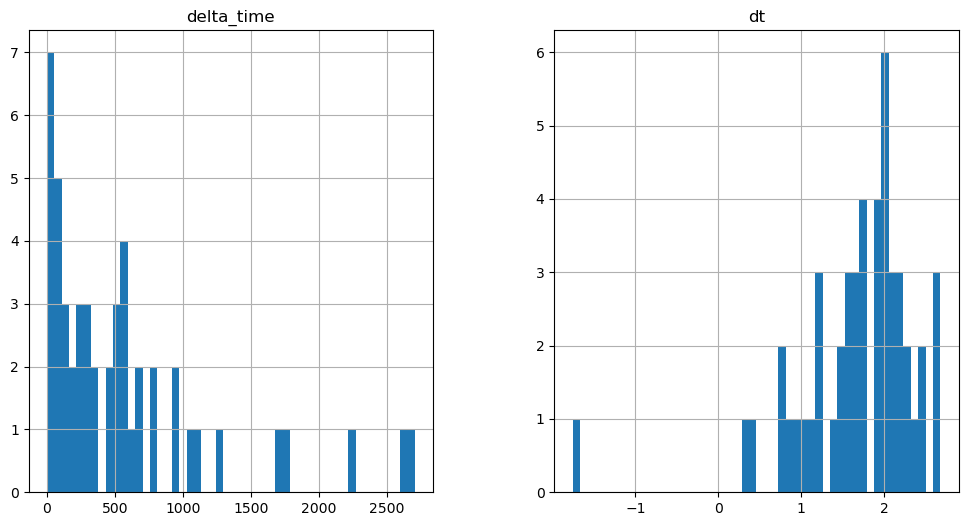

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2939.999415397644 0.1


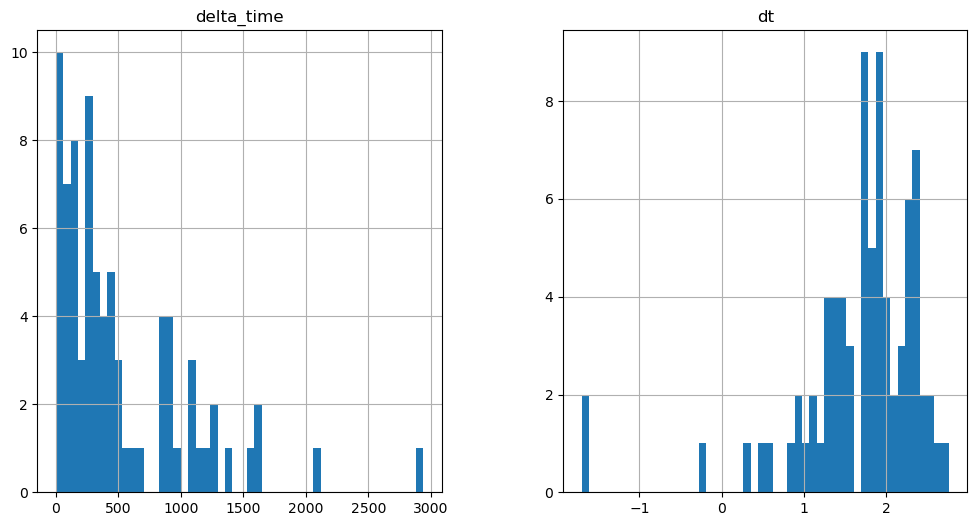

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4840.316359460354 119.3589859008789


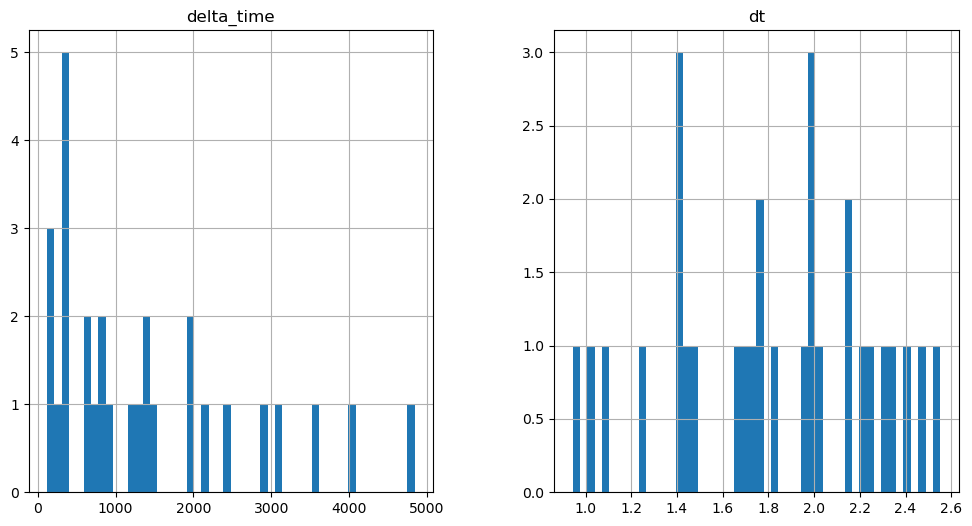

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2892.883333146572 6.282020449638367


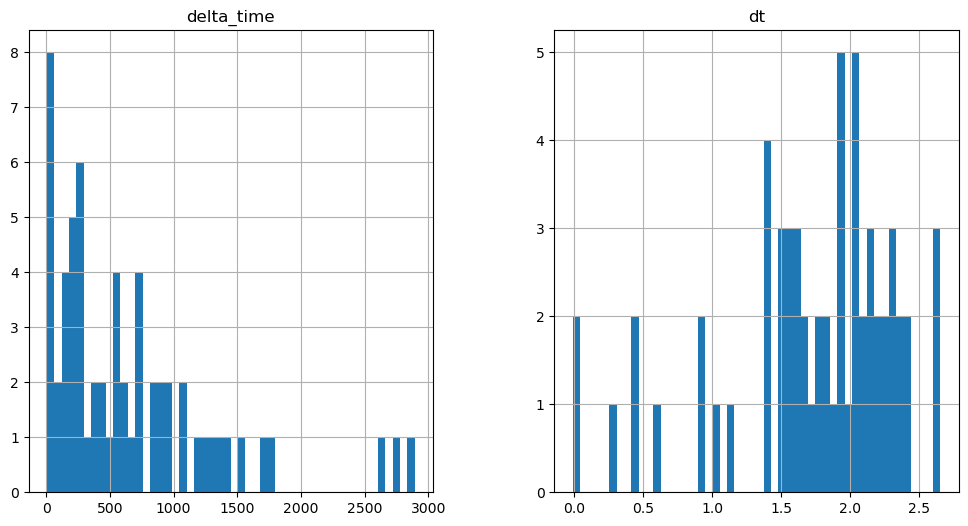

2038.522430896759 6.282030344009399


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

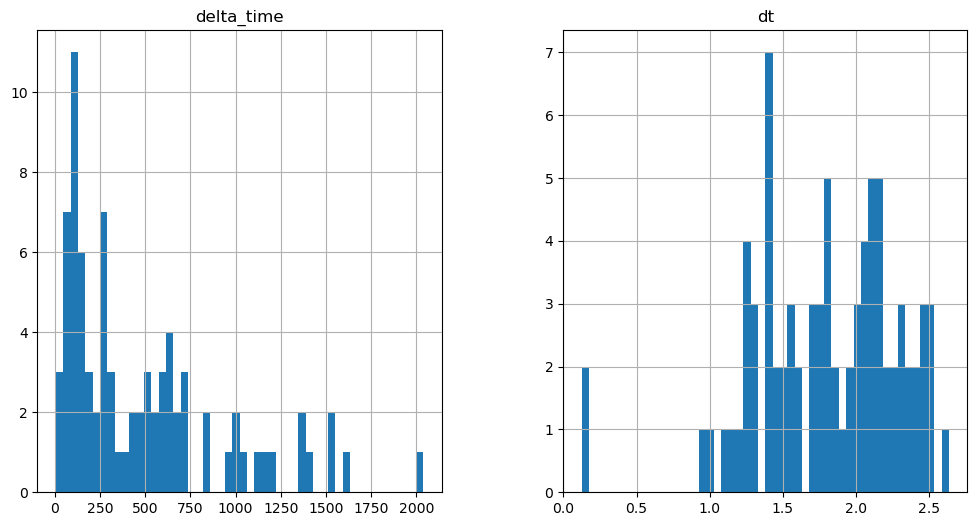

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1030.2557108998299 0.1


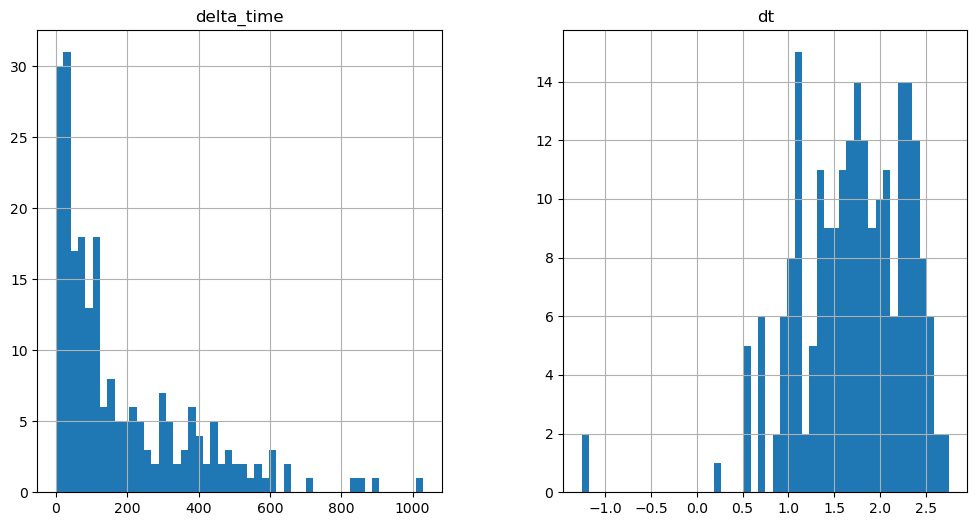

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

778.9735383987427 0.1


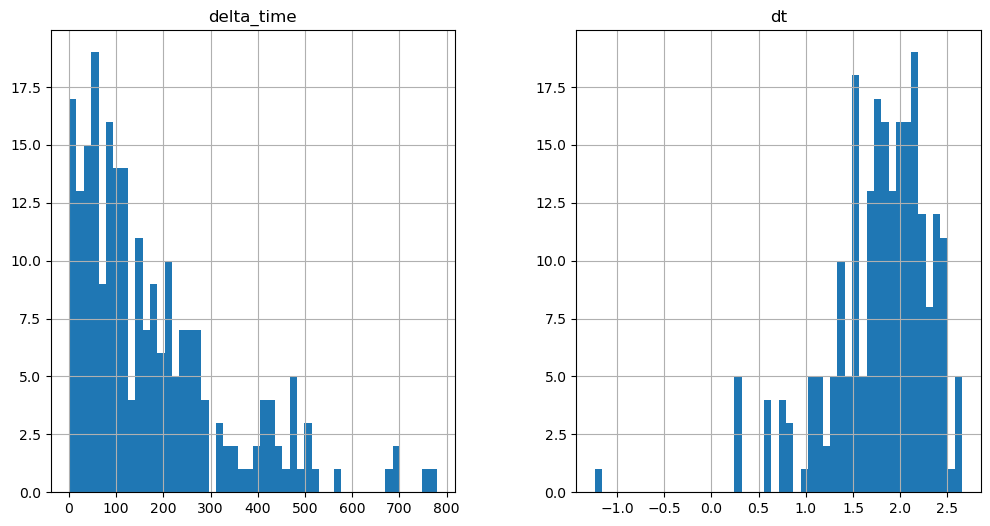

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1774.6728677749634 0.1


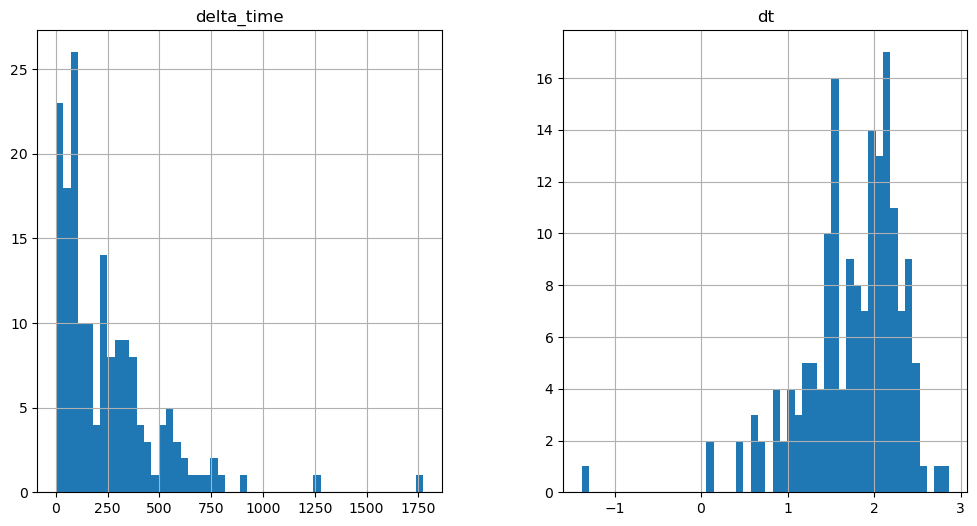

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

7909.096891283989 40.833322048187256


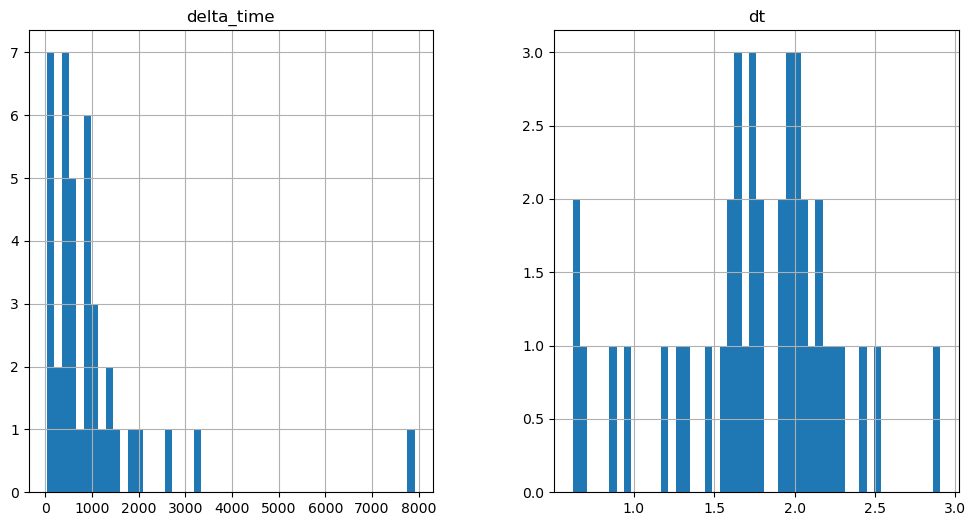

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3122.17985445261 0.1


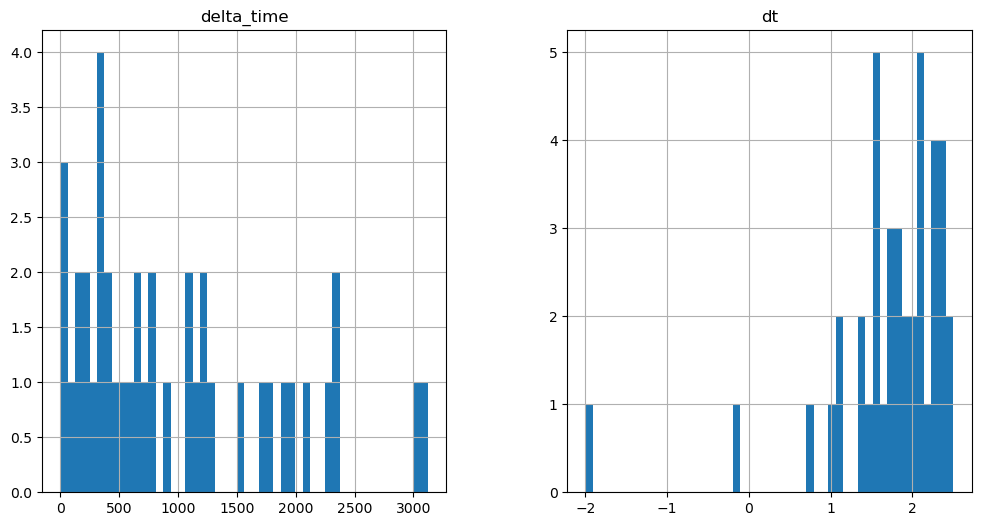

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4507.368523001671 28.26923143863678


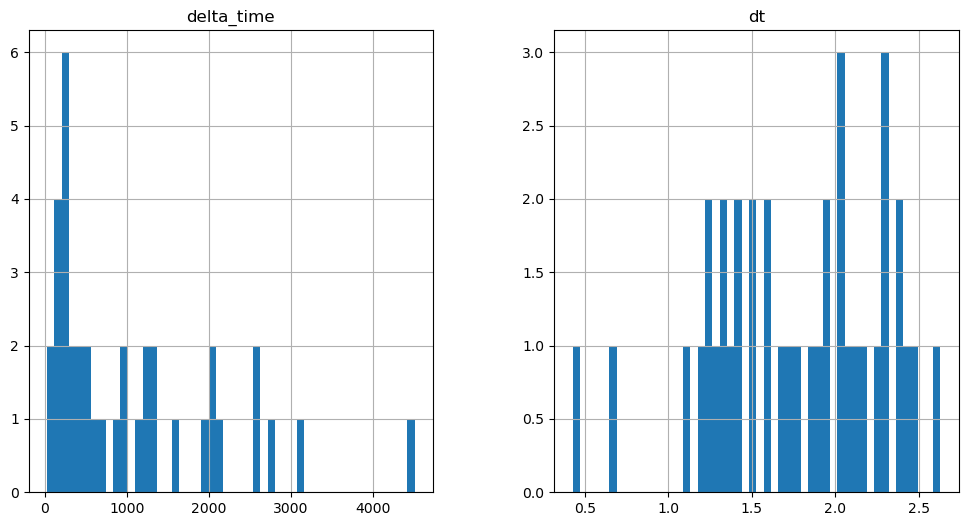

2534.8057653307915 6.282050251960754


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

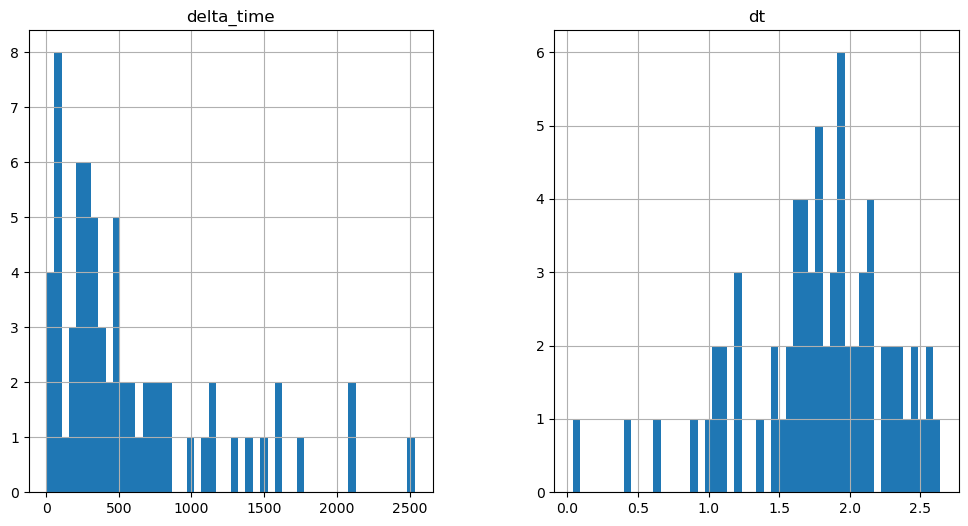

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4136.726204693317 12.564100623130798


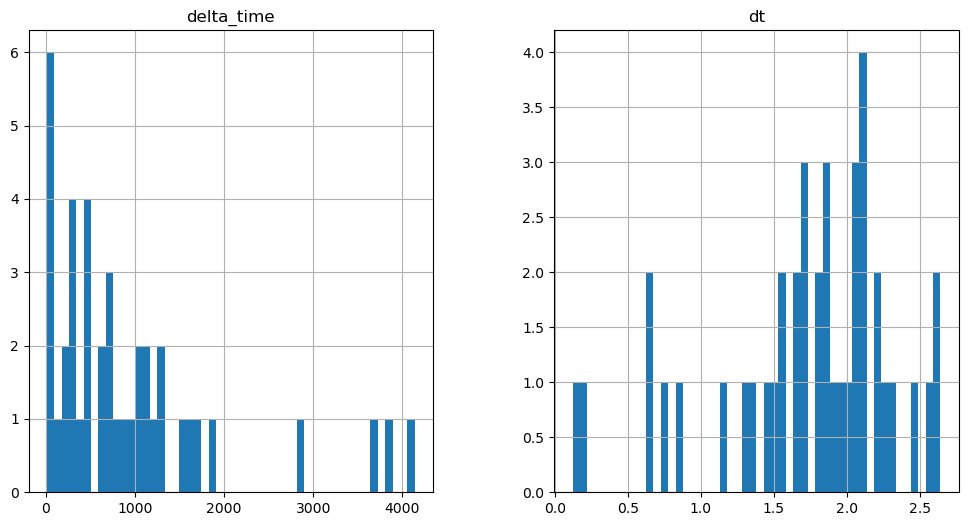

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3024.806919693947 3.1410301327705383


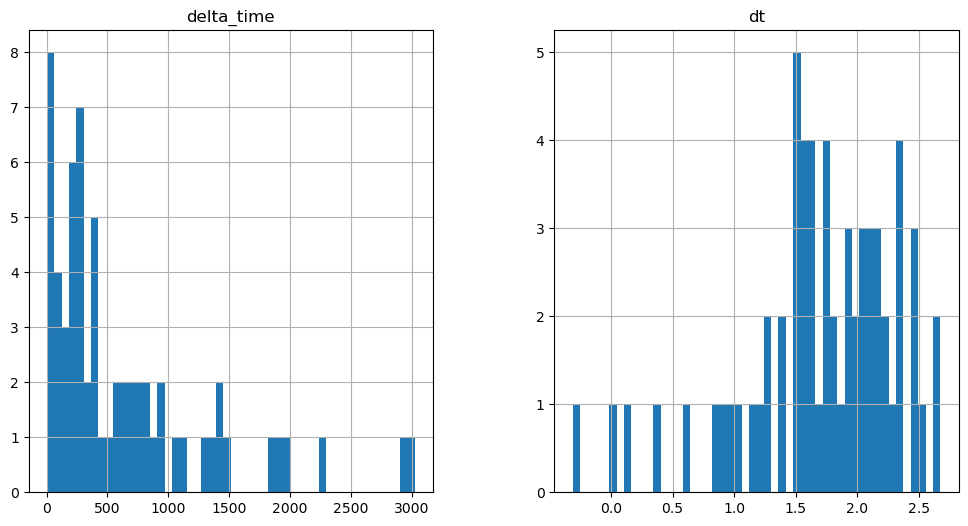

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3332.6187748908997 6.282060265541077


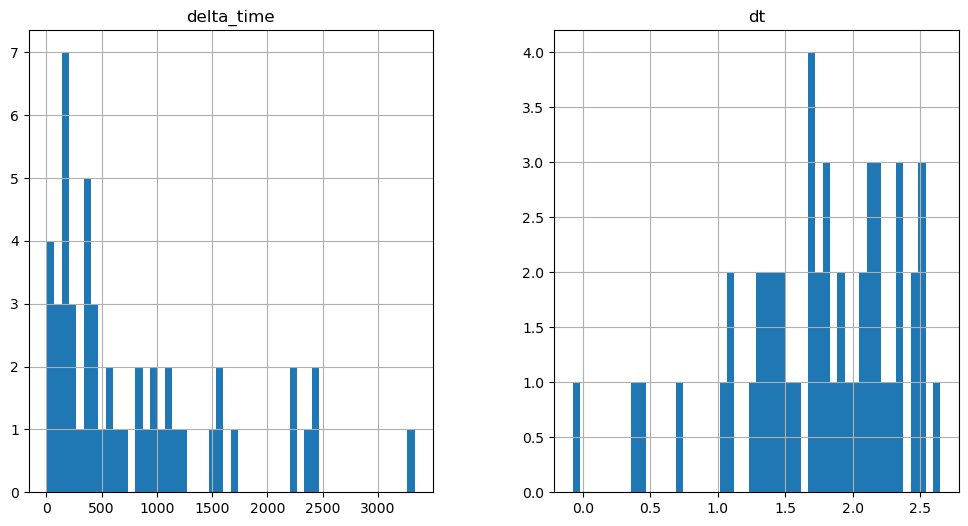

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1645.8969214558601 3.141020119190216


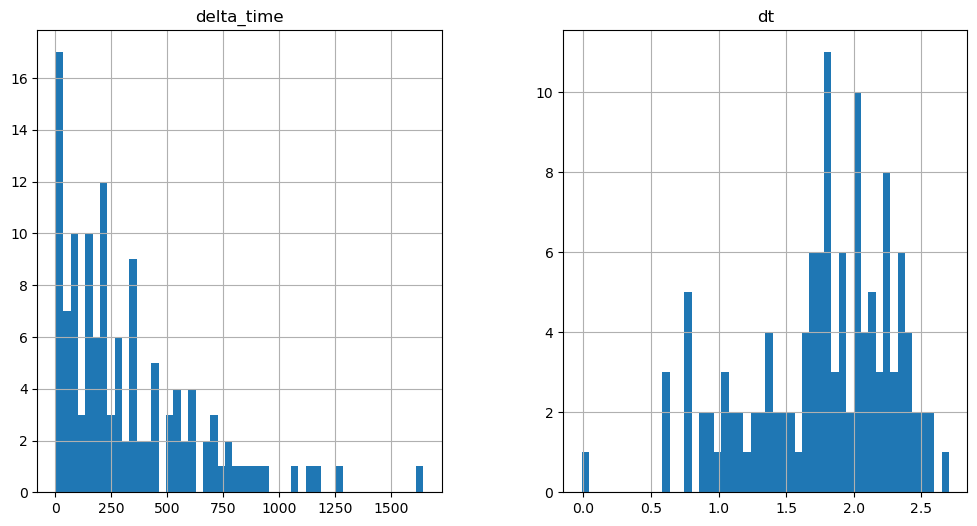

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2355.7653769254684 25.12819117307663


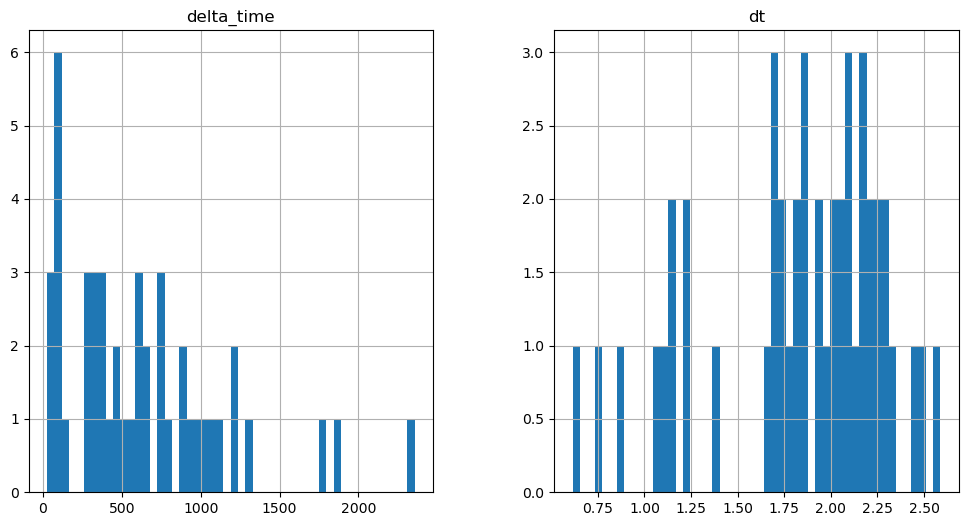

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2735.832925736904 3.141020119190216


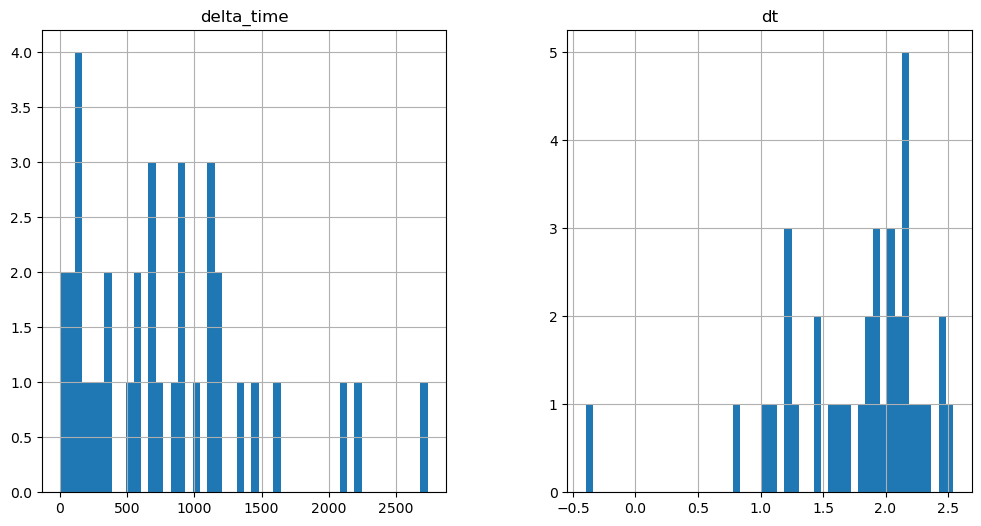

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3448.8443211317062 116.21781587600708


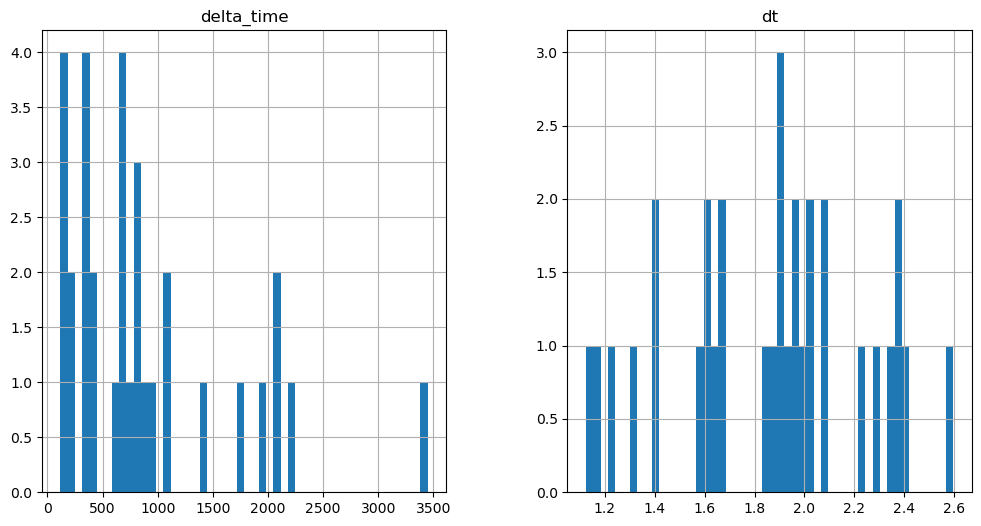

285.8330441713333 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

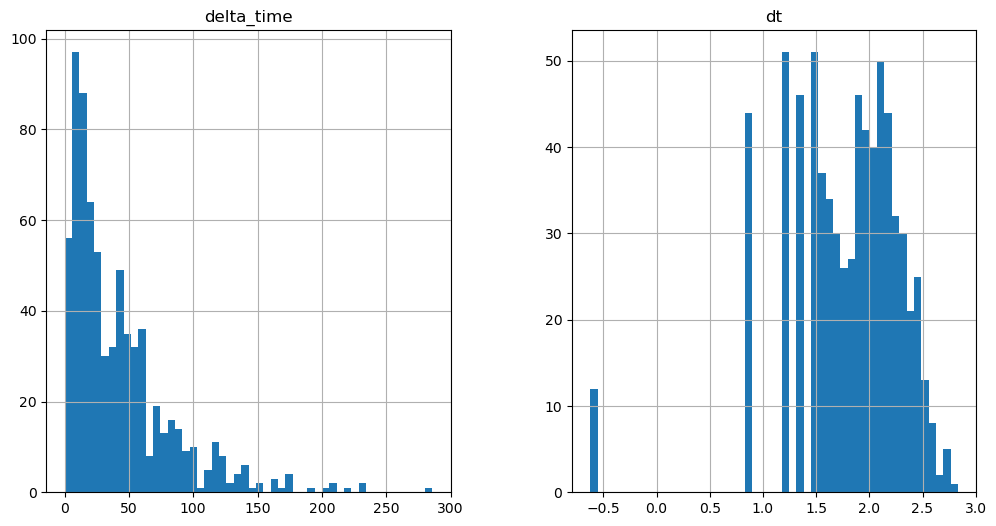

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2512.8161947727203 9.423040628433228


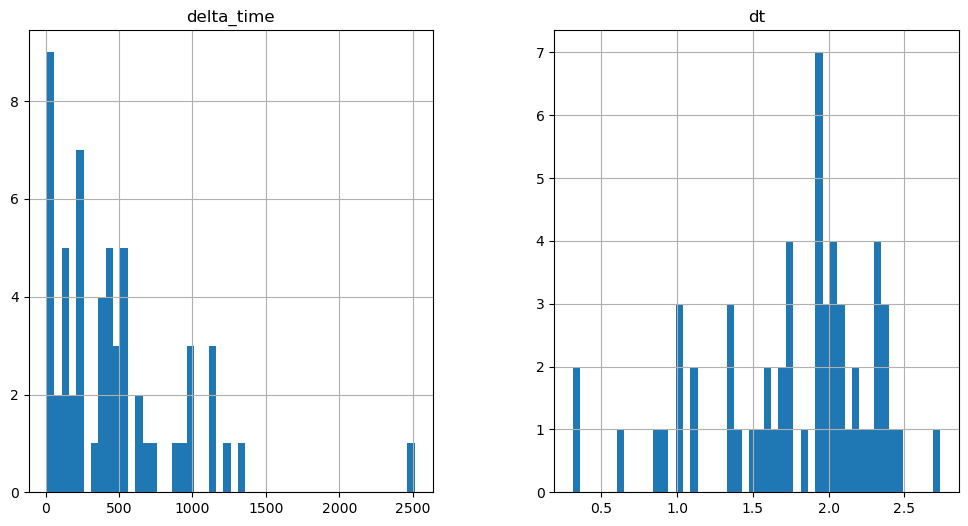

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

863.7793428301811 0.1


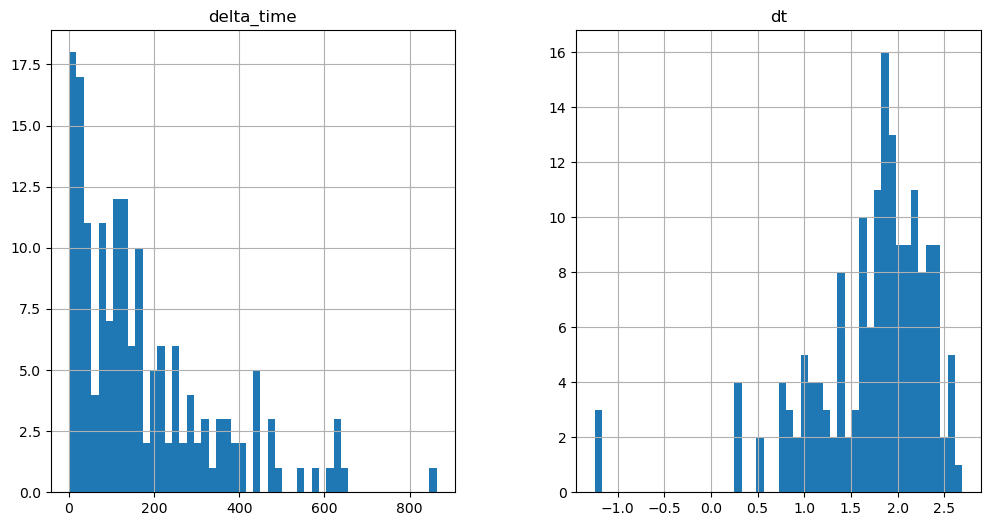

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1824.9351906776428 3.1410202383995056


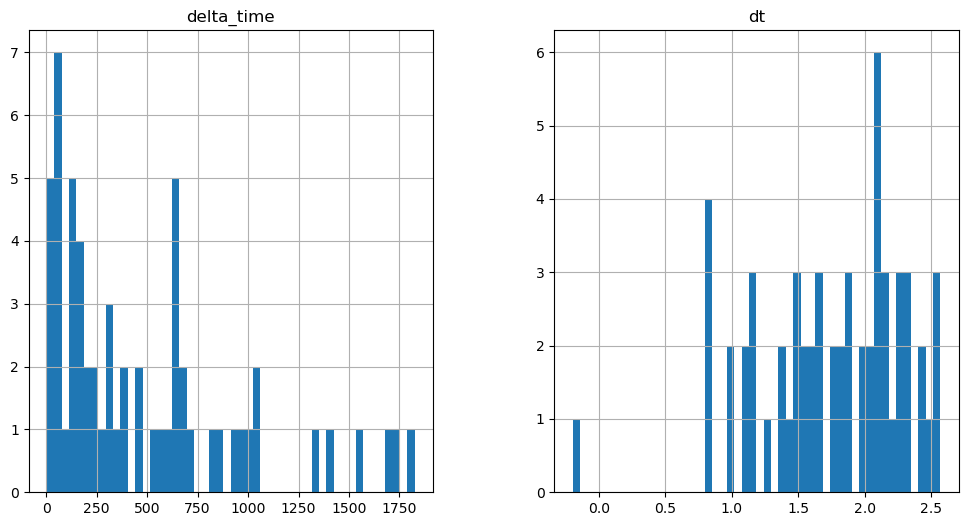

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1696.1501642465591 6.282040357589722


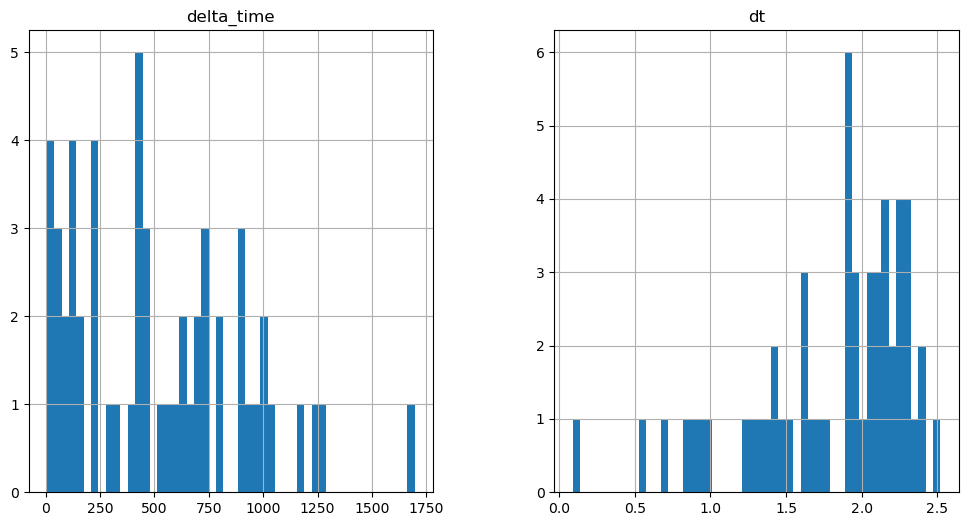

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3106.4739443063736 12.564070641994476


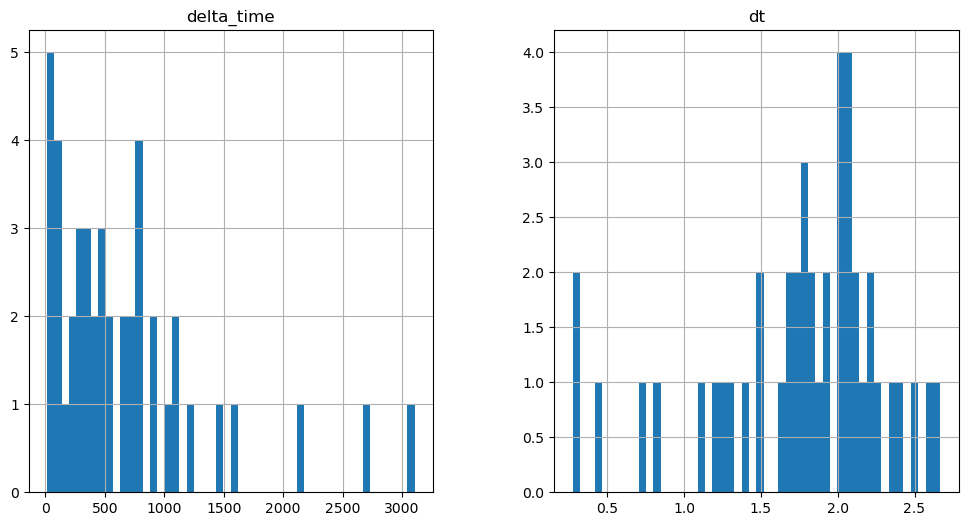

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3910.572604060173 40.83331209421158


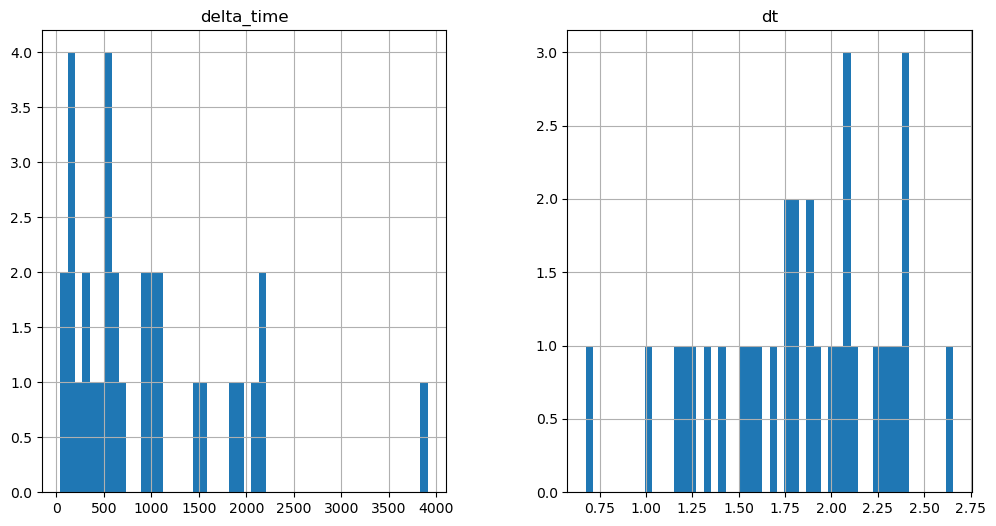

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3857.177221417427 9.423080384731293


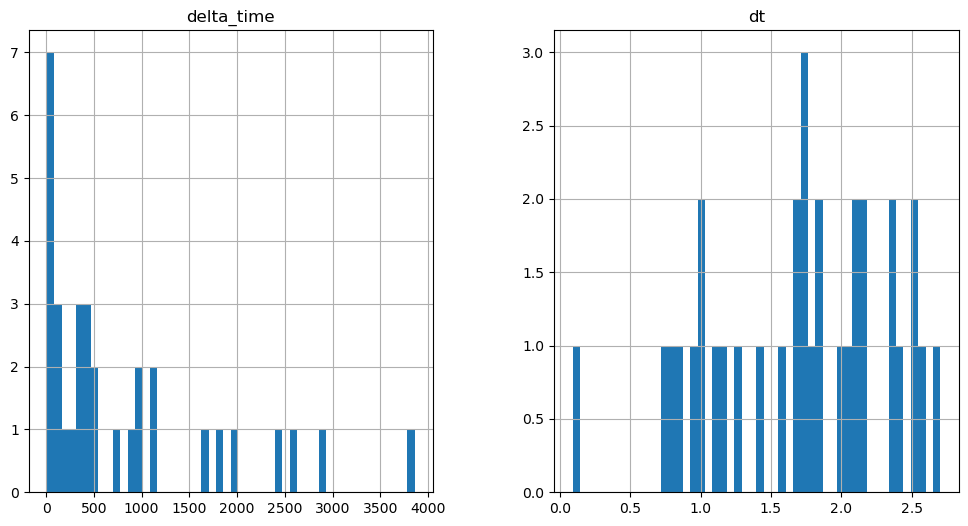

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1140.1898865699768 0.1


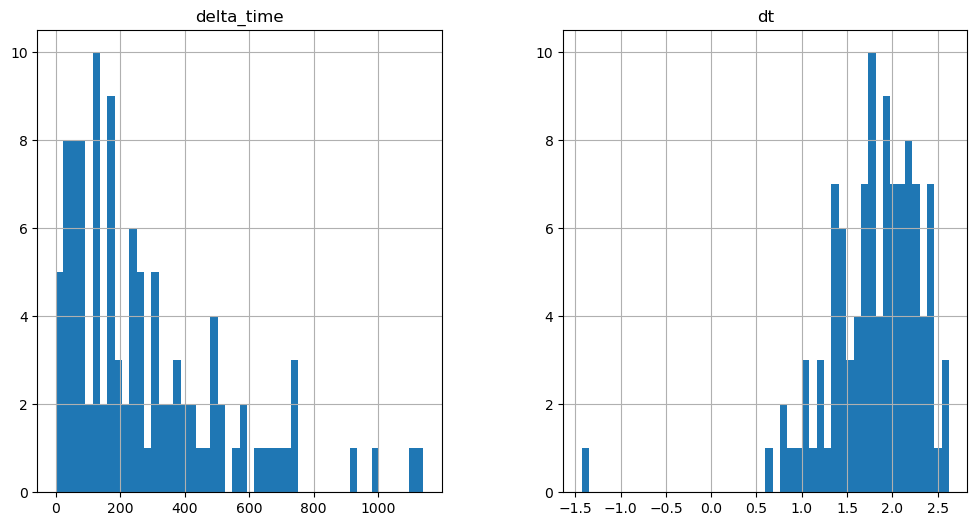

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

175.01422864198685 0.1


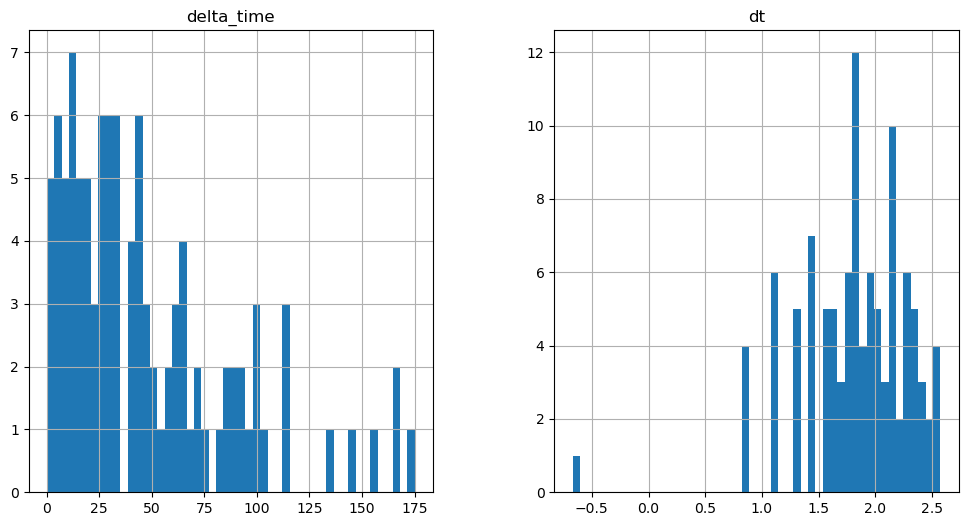

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

411.60853040218353 6.482030272483826


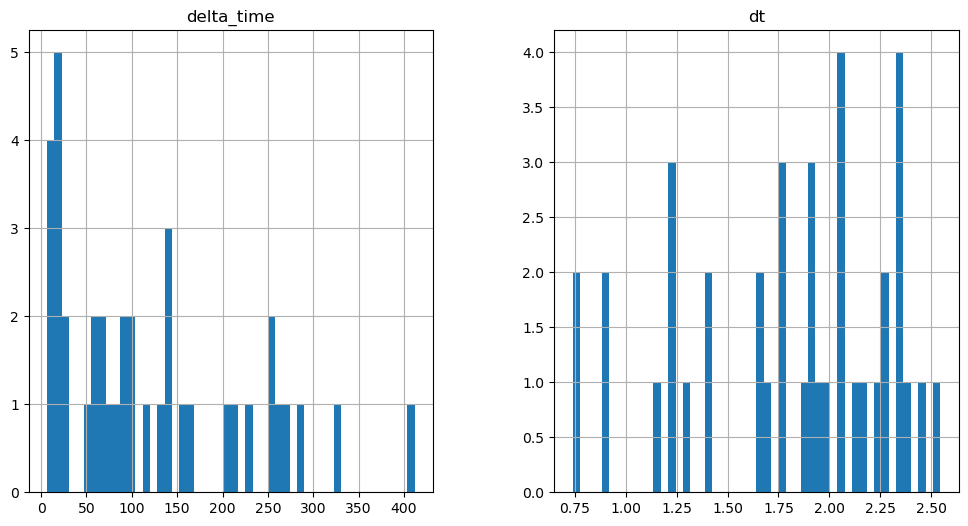

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

110.19438552856445 0.1


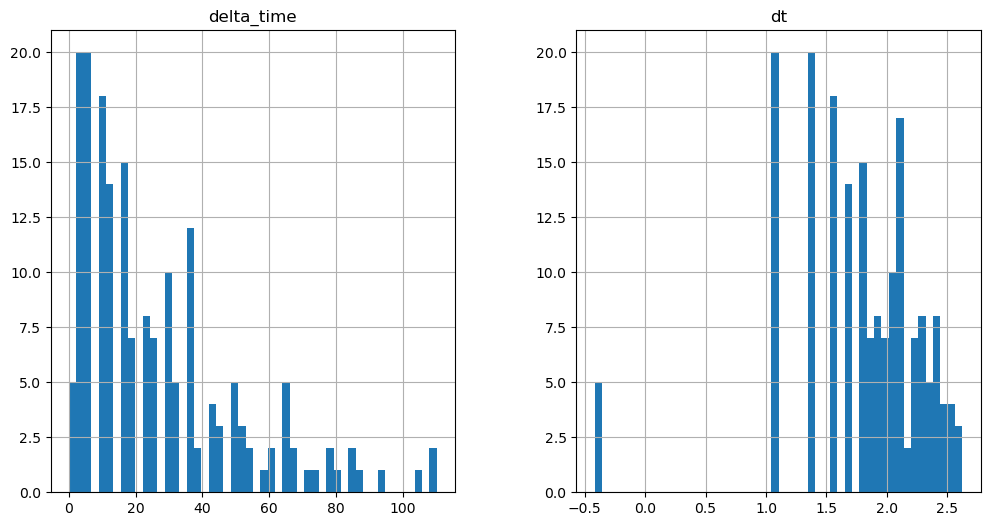

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

395.7661097049713 3.140990197658539


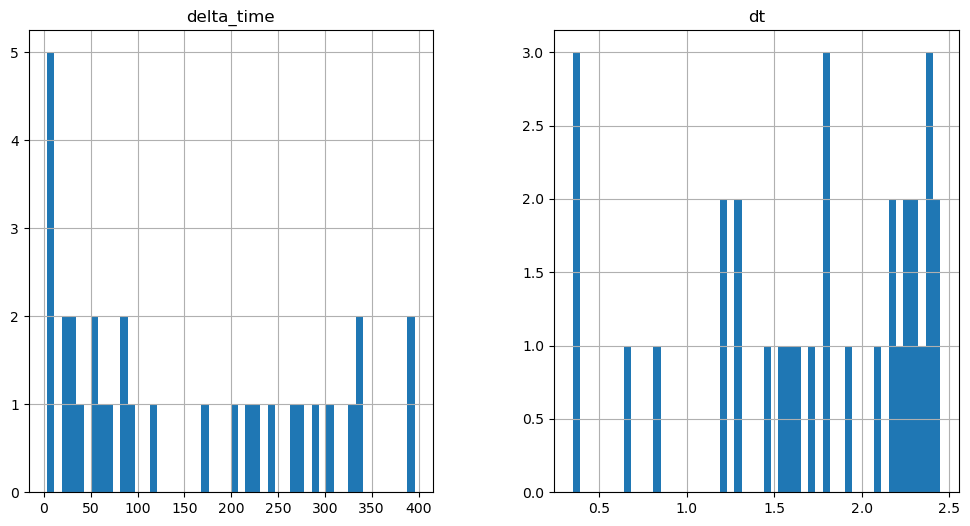

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

888.0345739126205 3.241020143032074


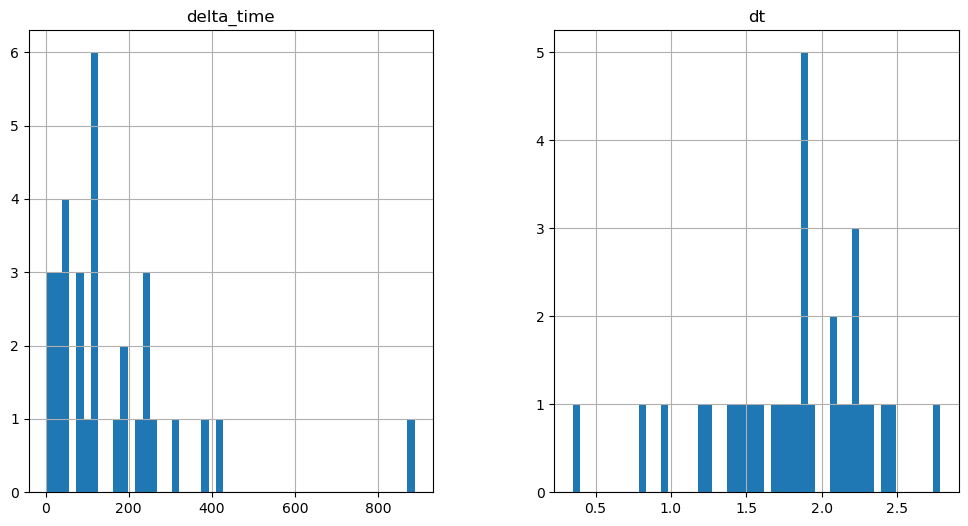

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

424.03757095336914 3.1410300731658936


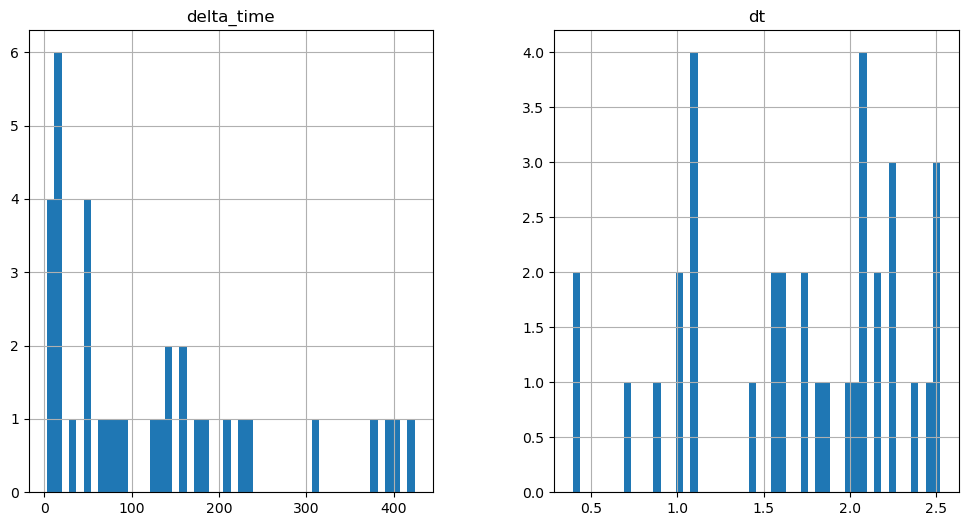

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

51.85604256391525 0.1


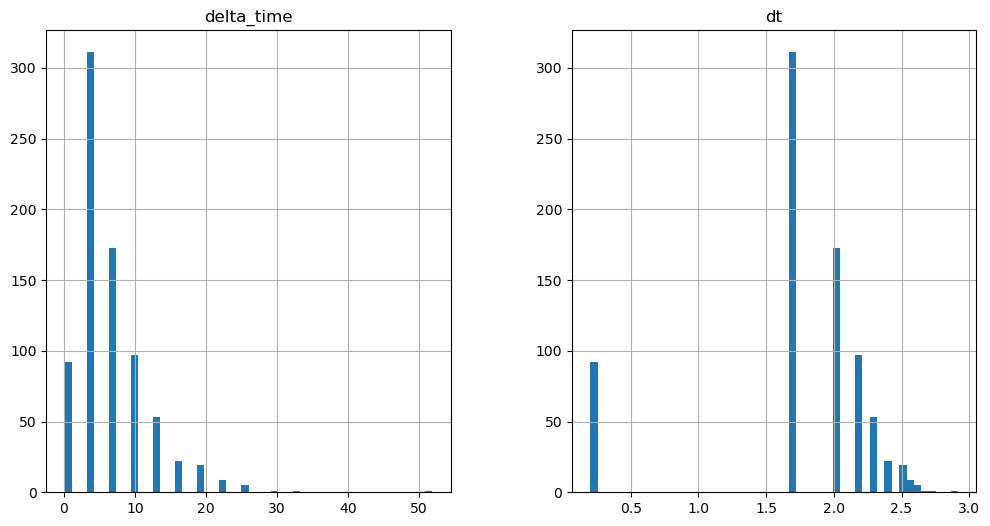

405.12528014183044 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

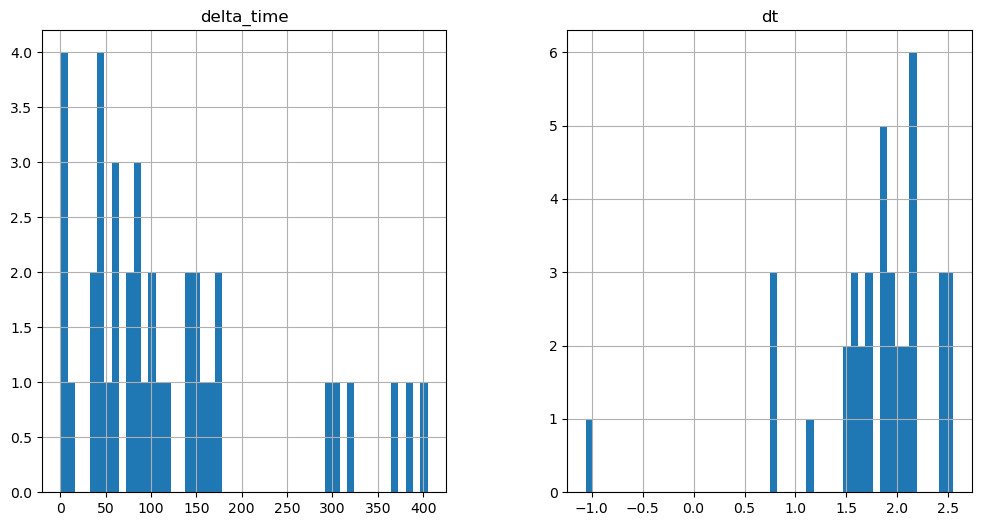

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

576.8983685970306 3.240990161895752


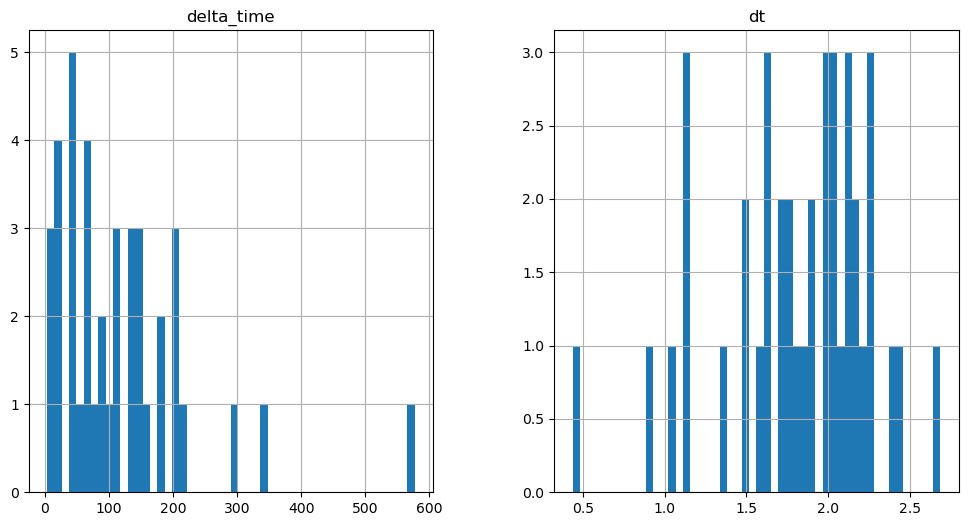

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

213.9083206653595 0.1


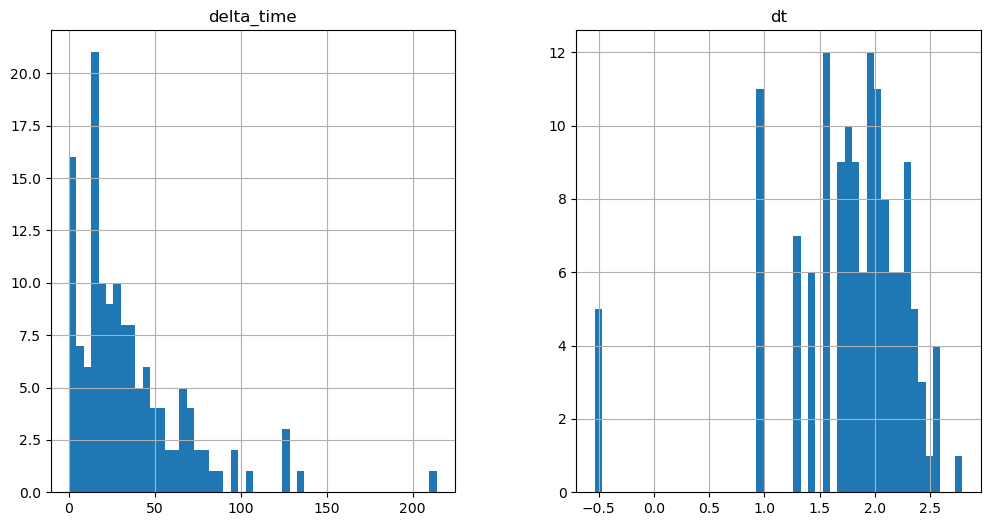

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

479.668133854866 0.1


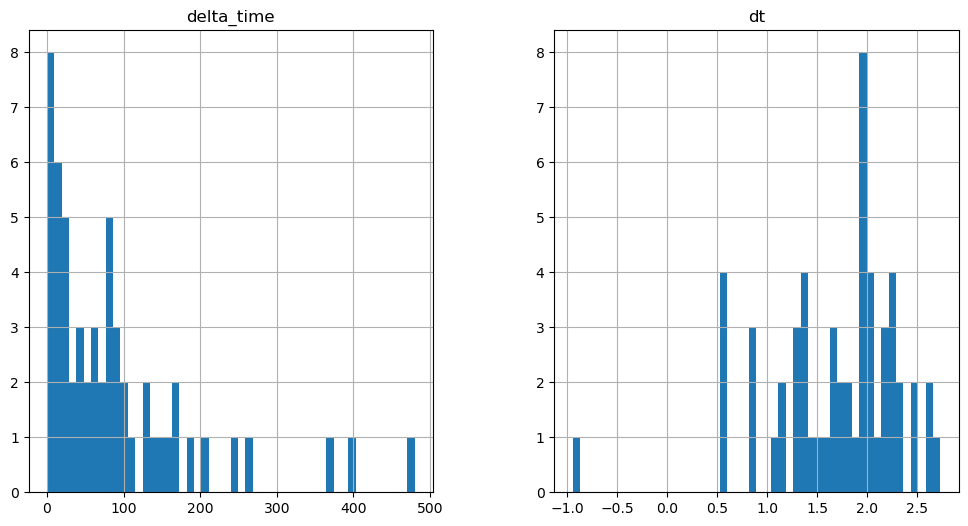

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

583.380399107933 3.2409902215003967


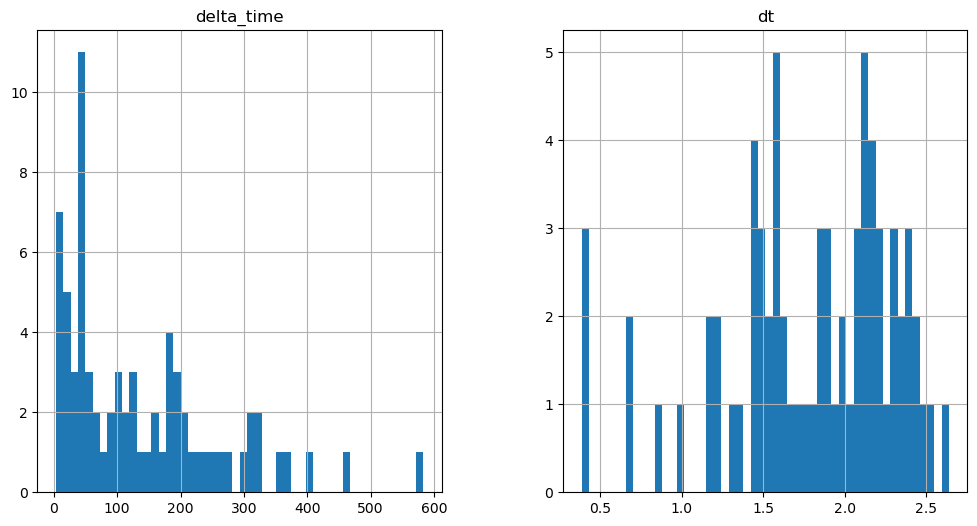

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

583.380399107933 3.2409902215003967


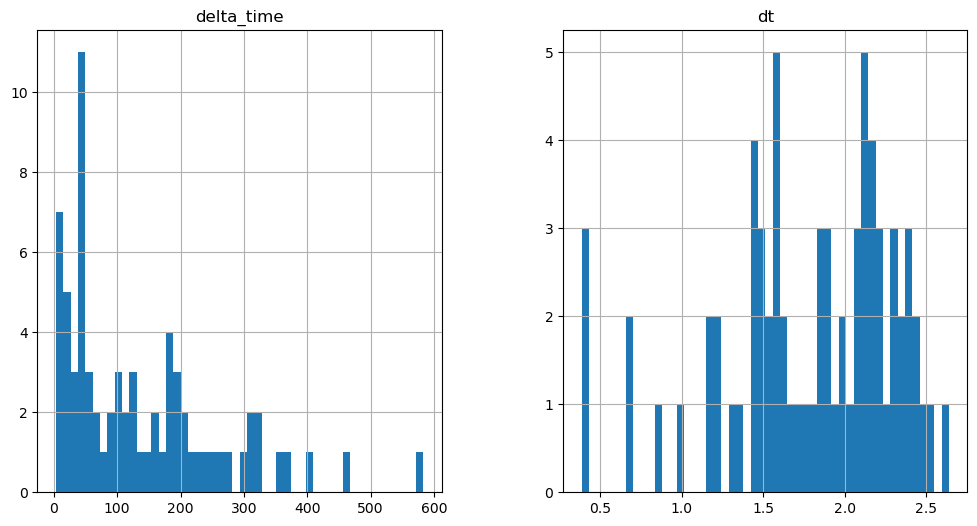

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

502.3553048968315 0.1


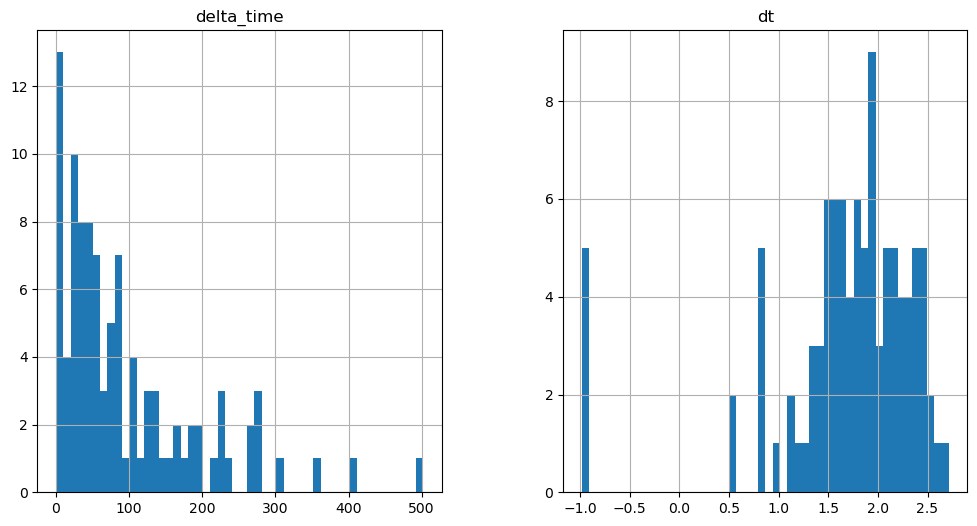

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

401.8890298604965 0.1


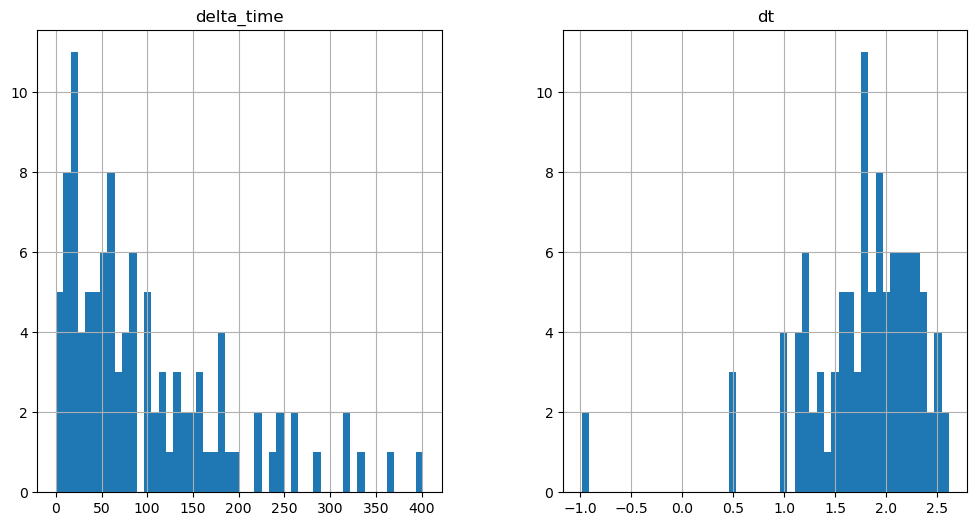

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1082.5075534582138 0.1


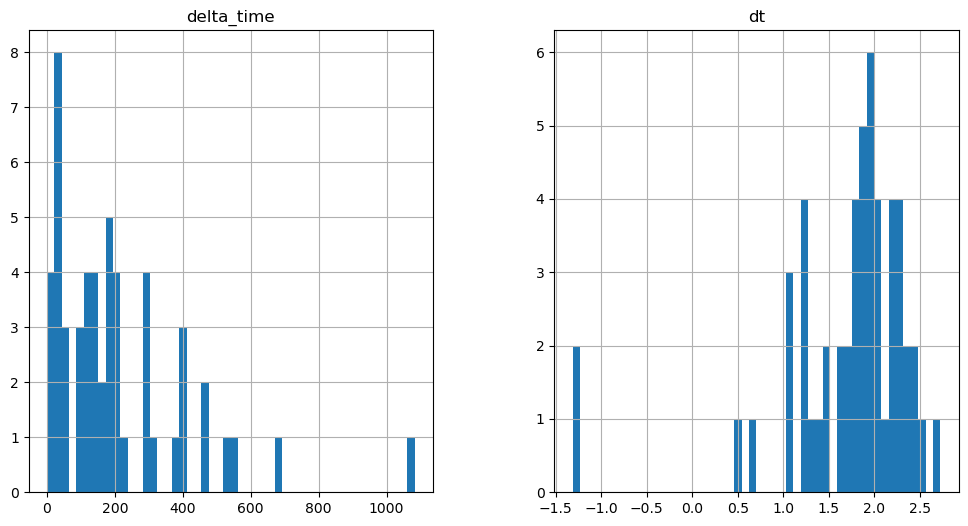

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1743.6798261404037 6.482080280780792


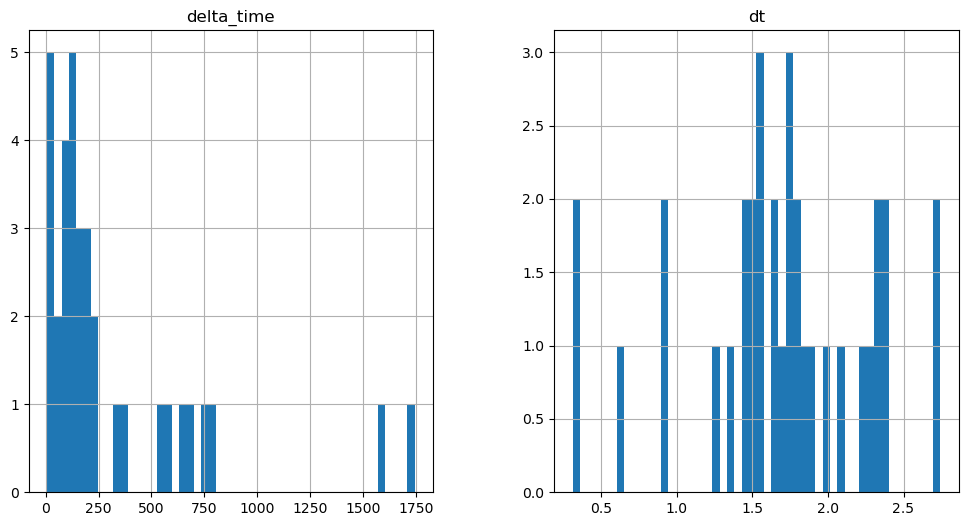

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1069.5347030758858 22.687061071395874


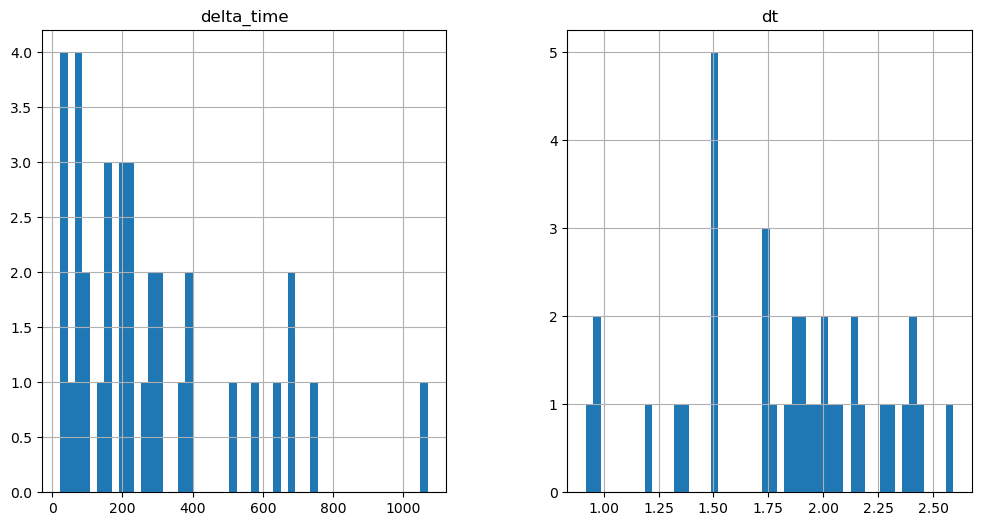

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1202.4218599200249 0.1


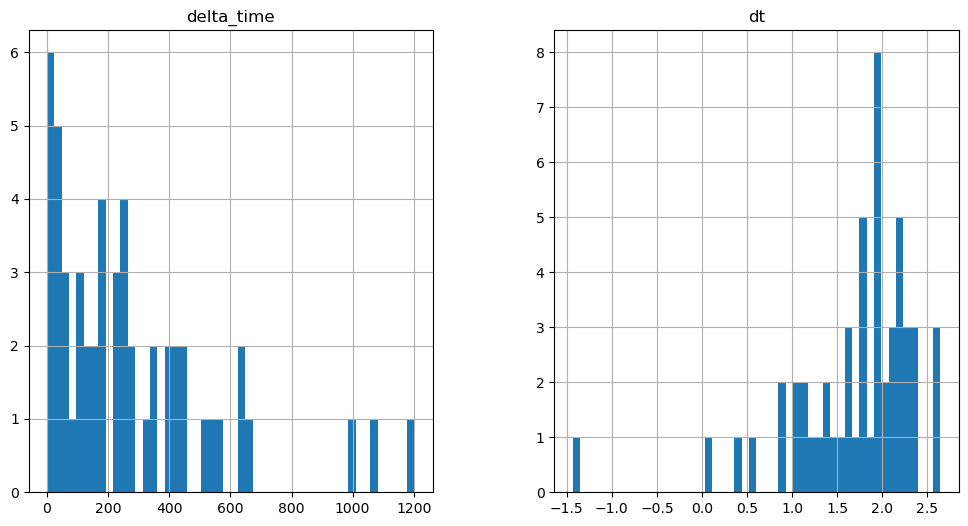

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

612.5550804138184 0.1


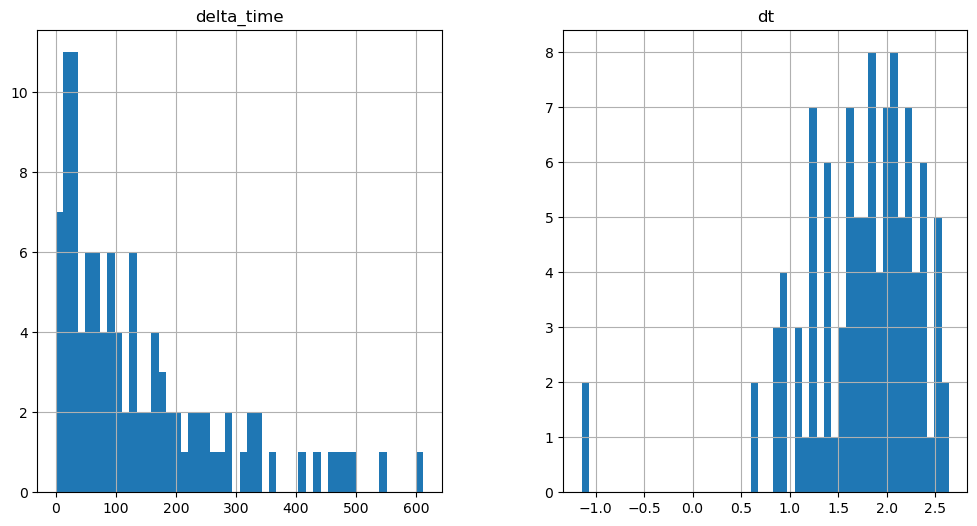

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1157.04849755764 6.482060253620148


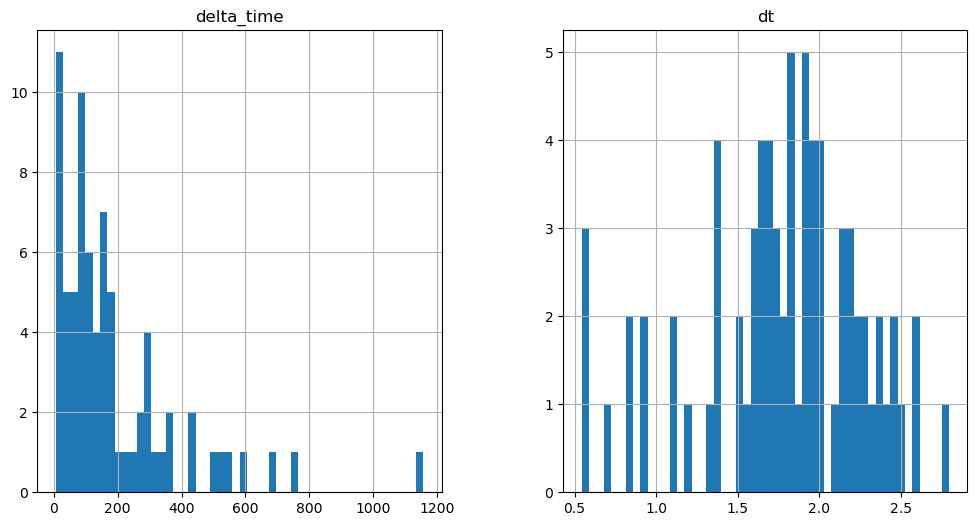

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1717.7465552091599 12.96412056684494


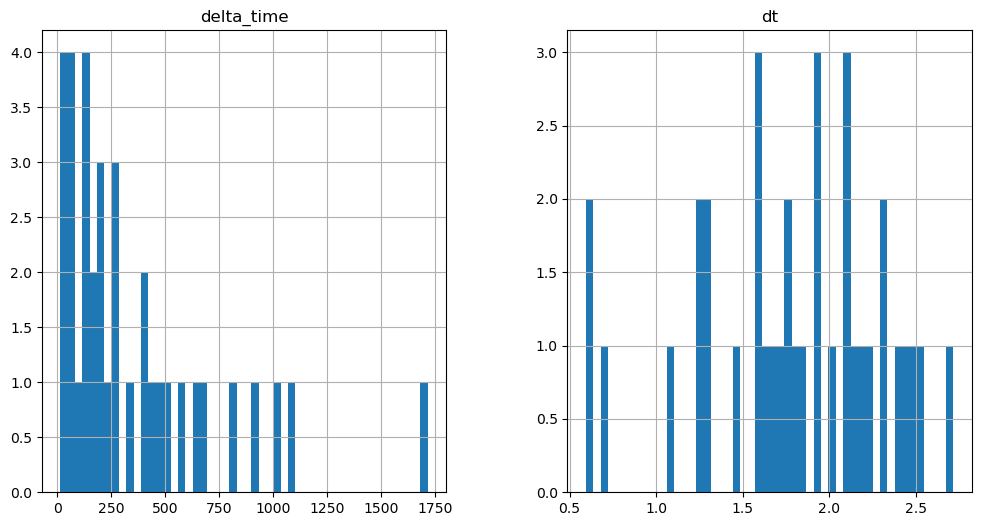

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2148.805056810379 3.241030216217041


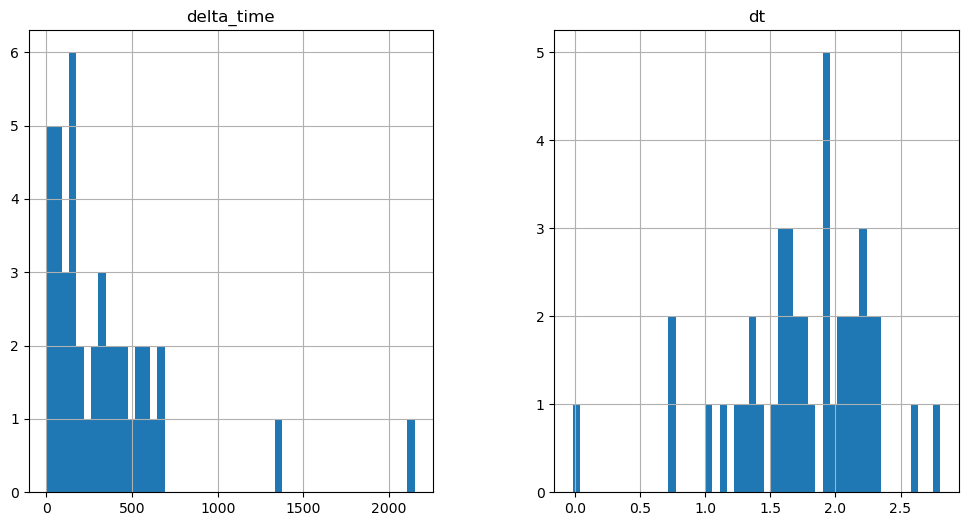

1234.832111299038 6.48207026720047


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

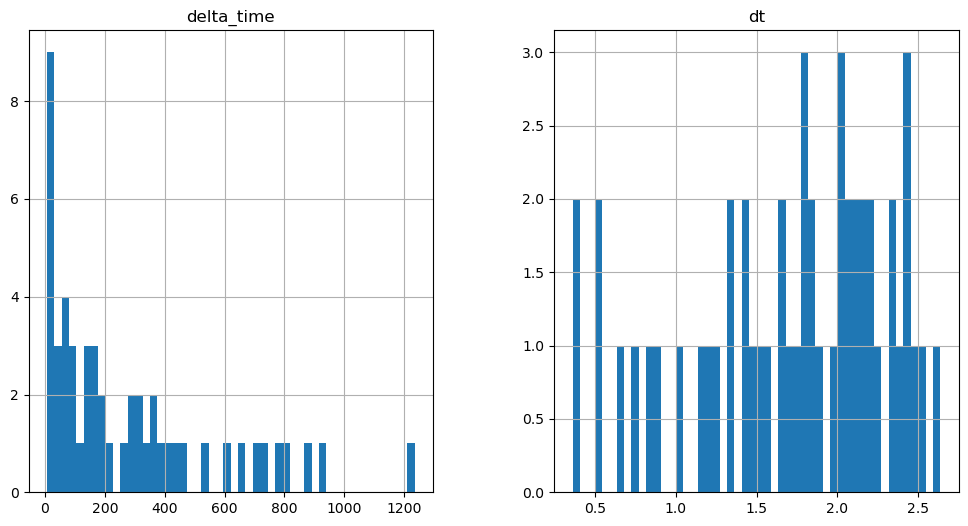

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

635.2417514920235 0.1


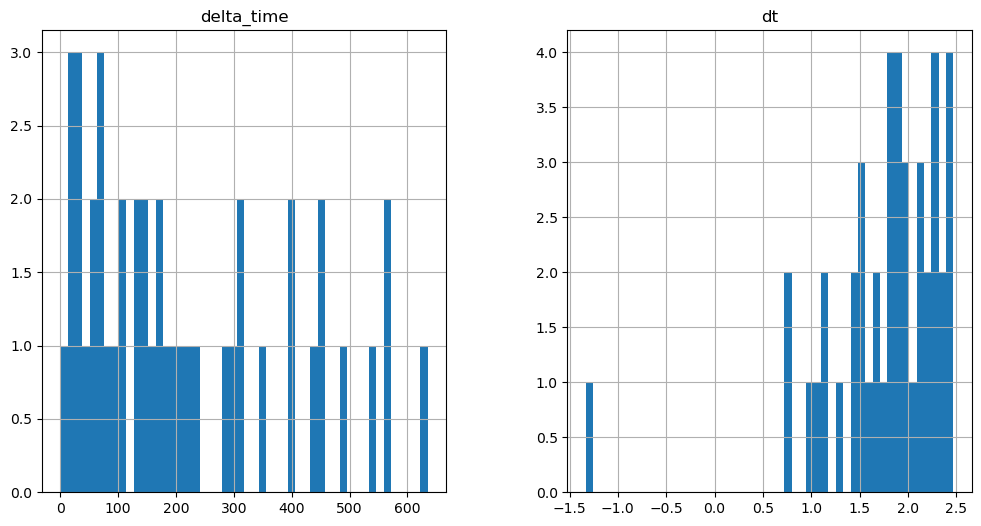

437.53914165496826 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

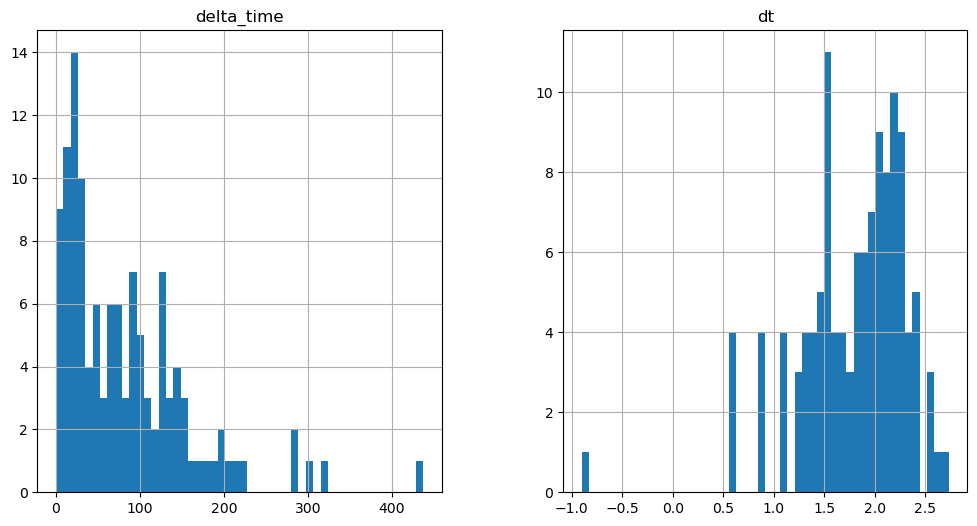

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1066.2985228300095 6.482060372829437


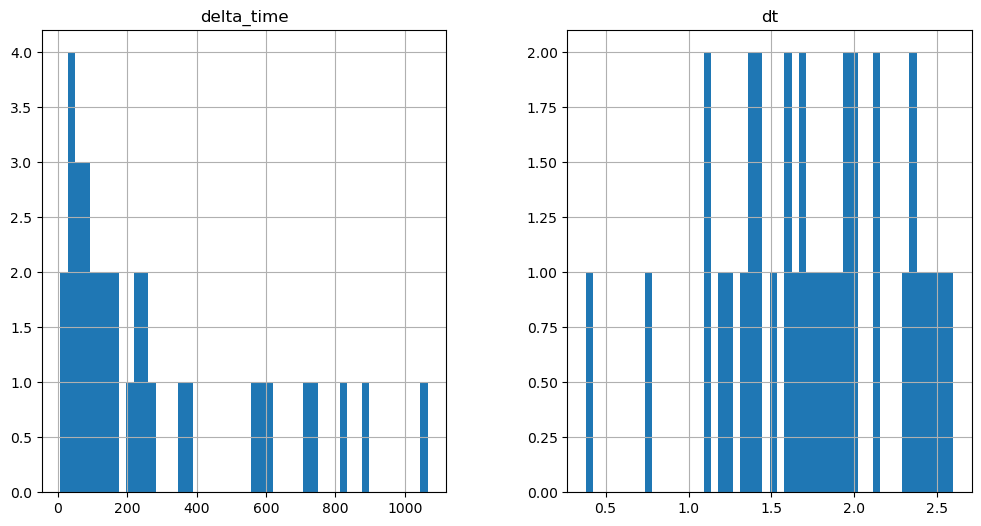

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

337.0642468929291 0.1


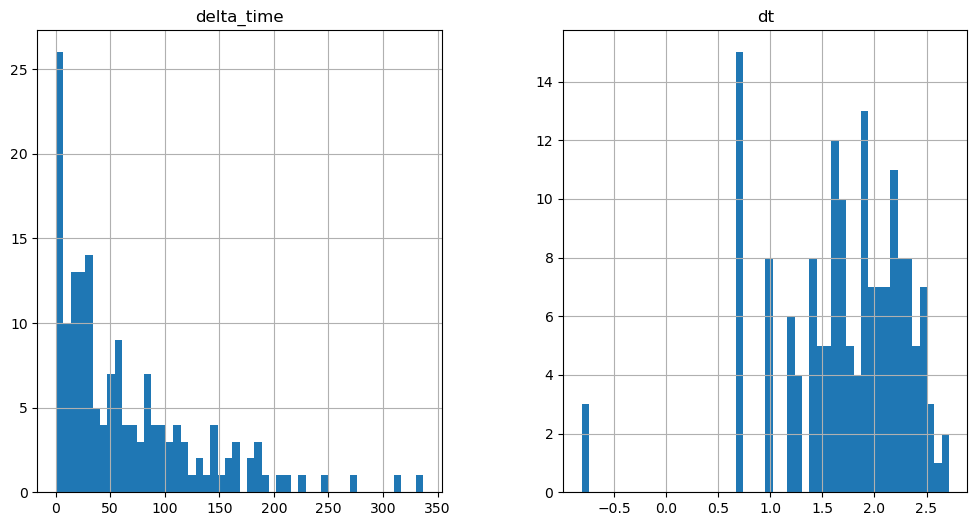

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1040.361732184887 3.2409902215003967


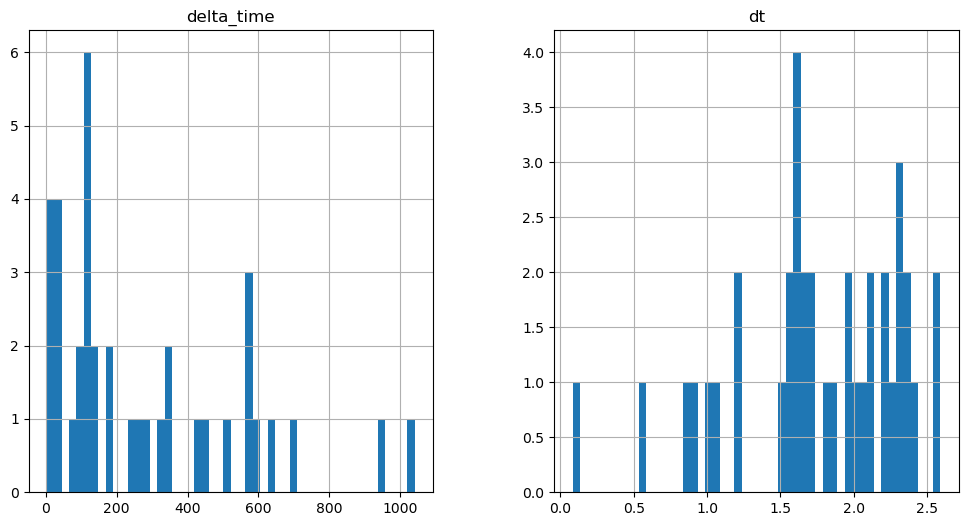

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

463.46340334415436 6.482010304927826


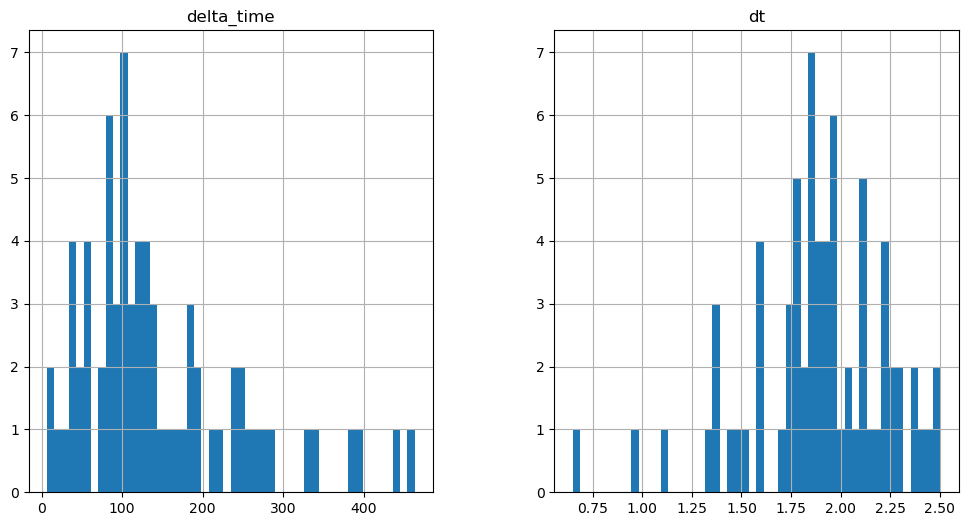

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

243.07524222135544 0.1


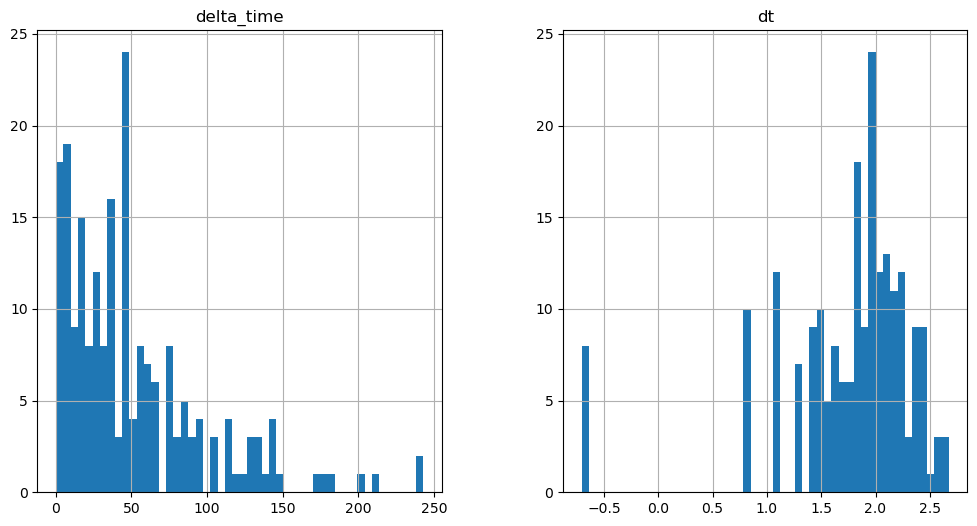

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

346.7872974872589 0.1


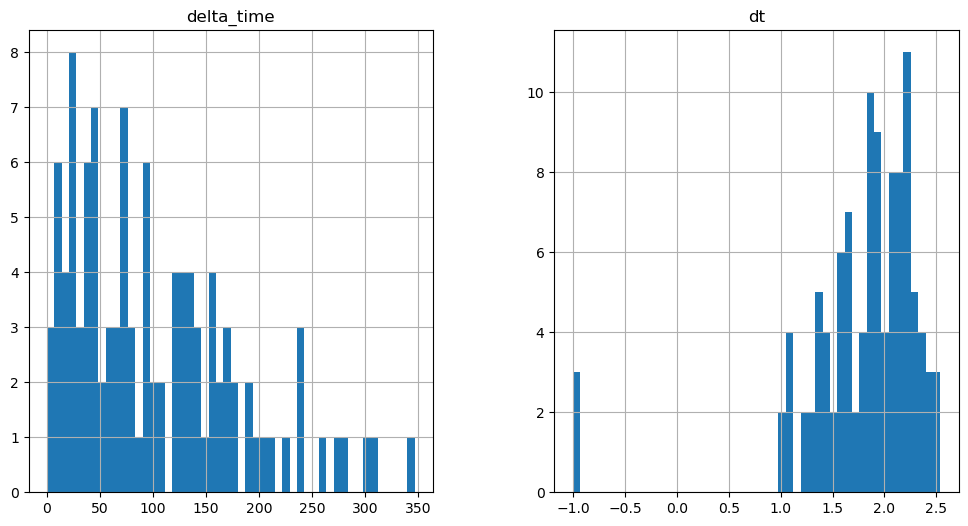

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1134.3512369990349 3.240990161895752


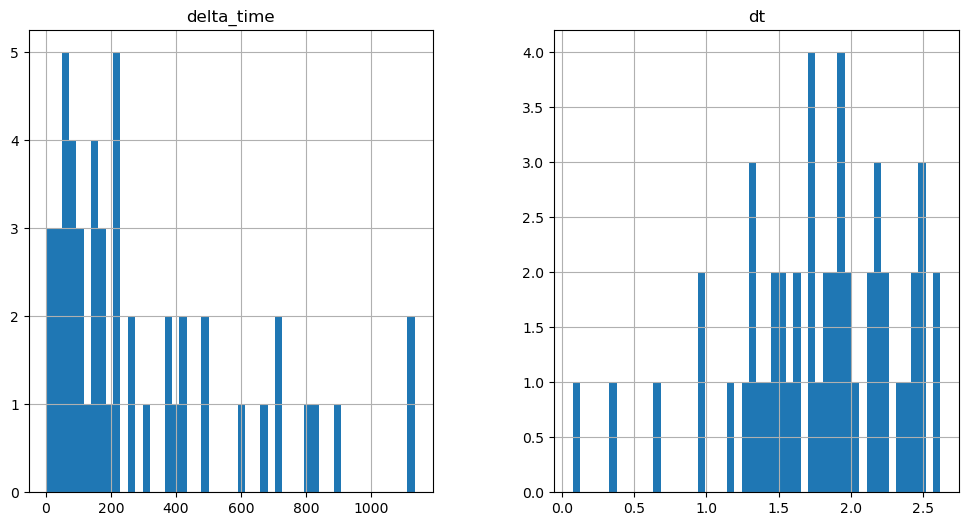

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1908.950745999813 3.241020083427429


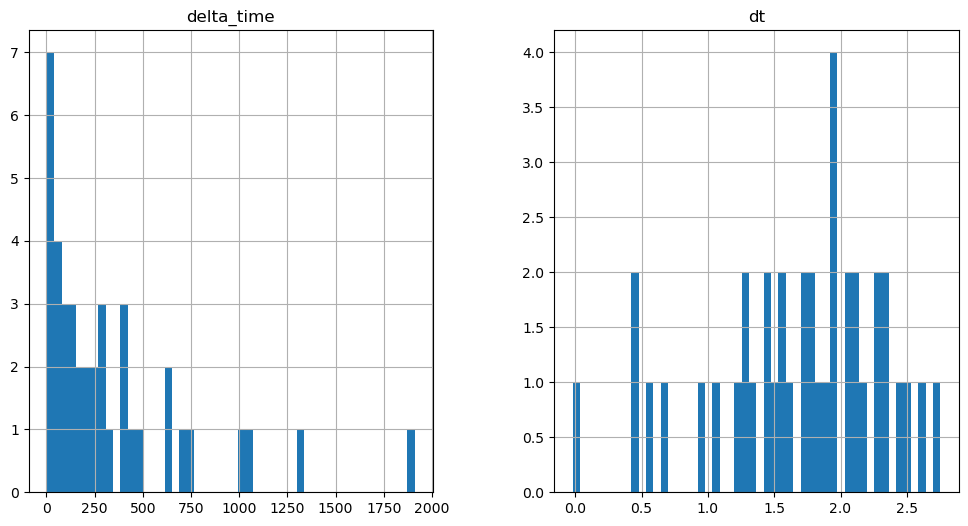

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

913.9633160233498 12.964040637016296


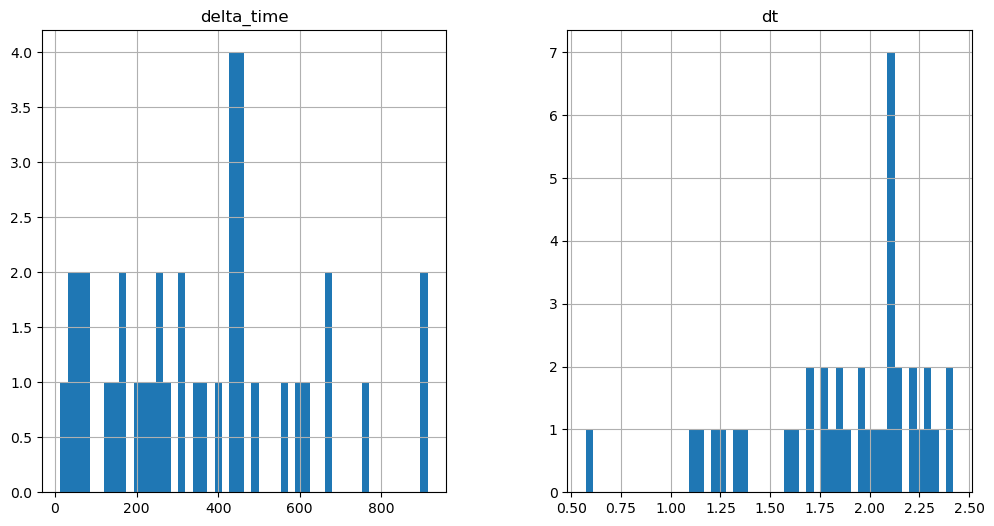

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

819.9741012454033 3.2410002946853638


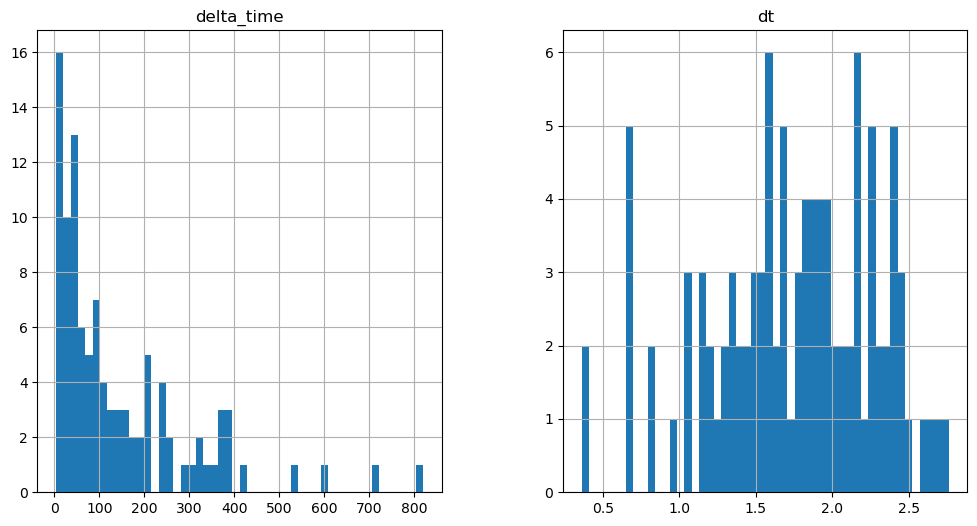

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

304.65442526340485 0.1


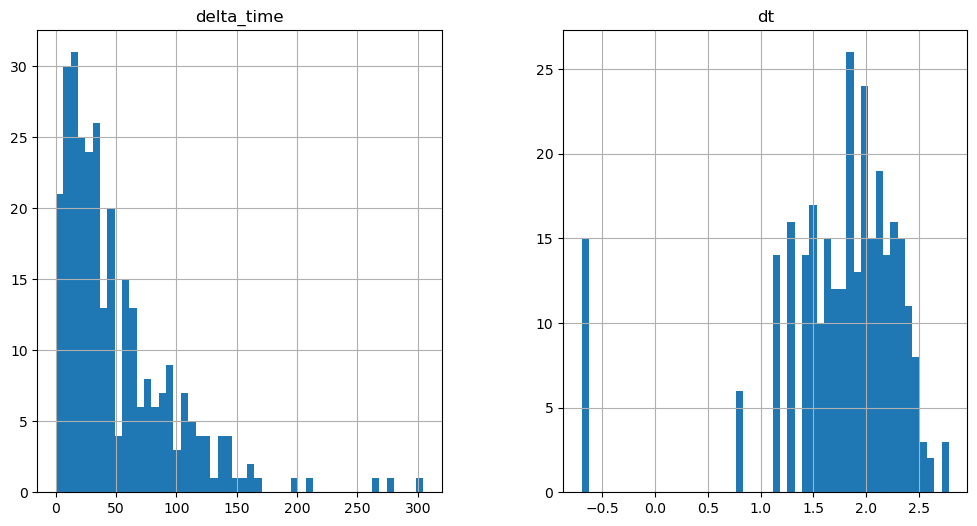

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1335.2945070266724 12.964000701904297


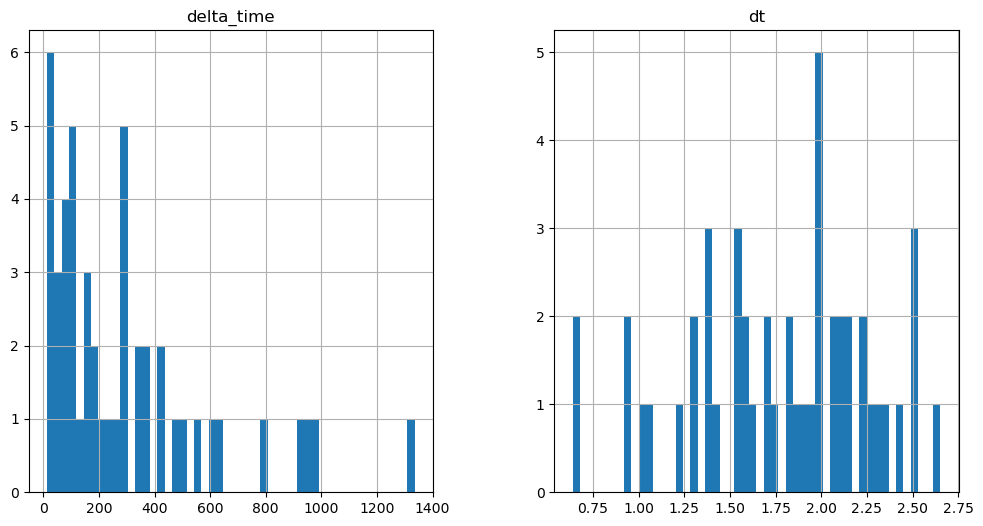

18.082380890846252 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

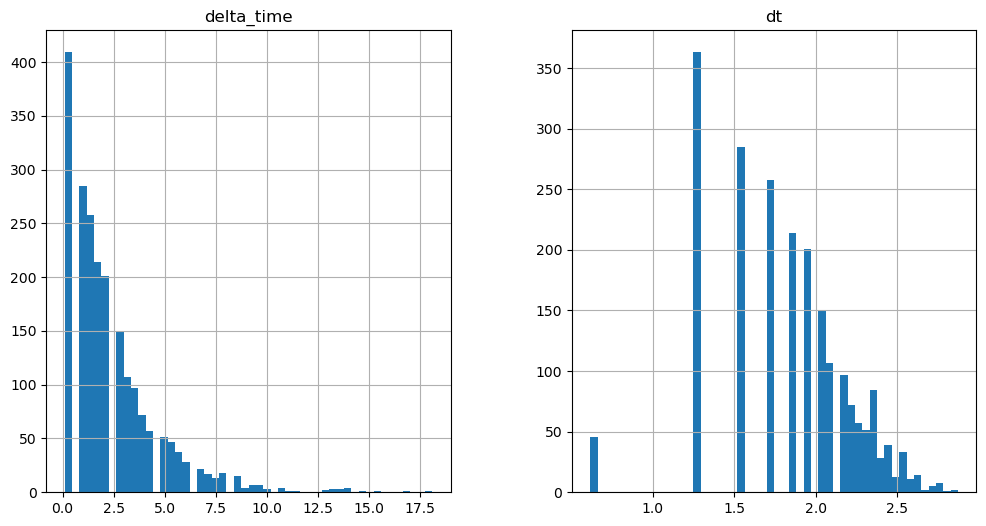

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

361.20674777030945 0.44101011753082275


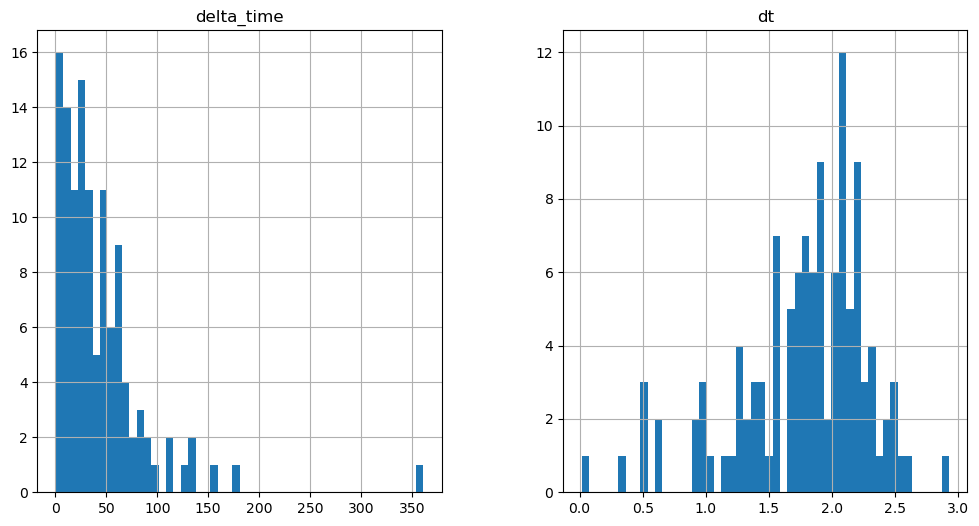

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

22.93377113342285 0.1


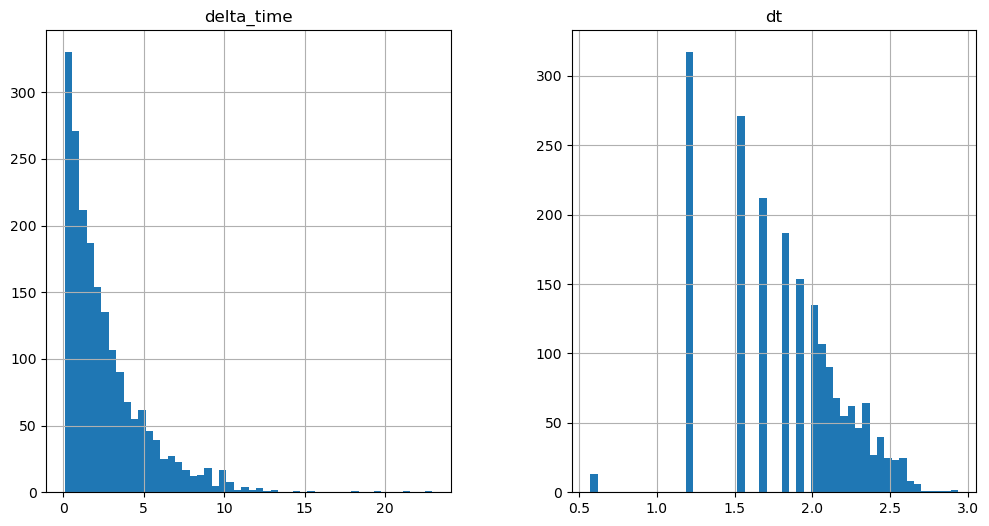

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

18.082400918006897 0.1


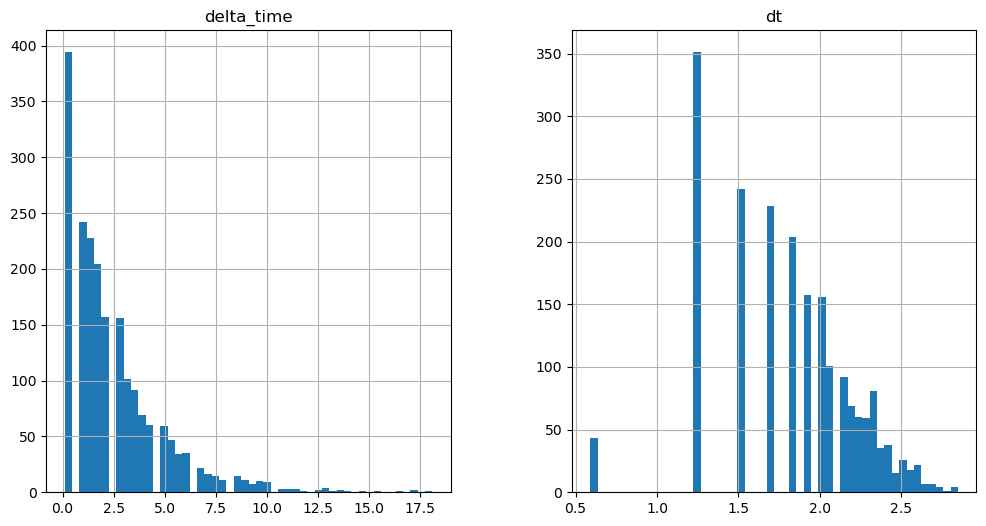

18.96451085805893 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

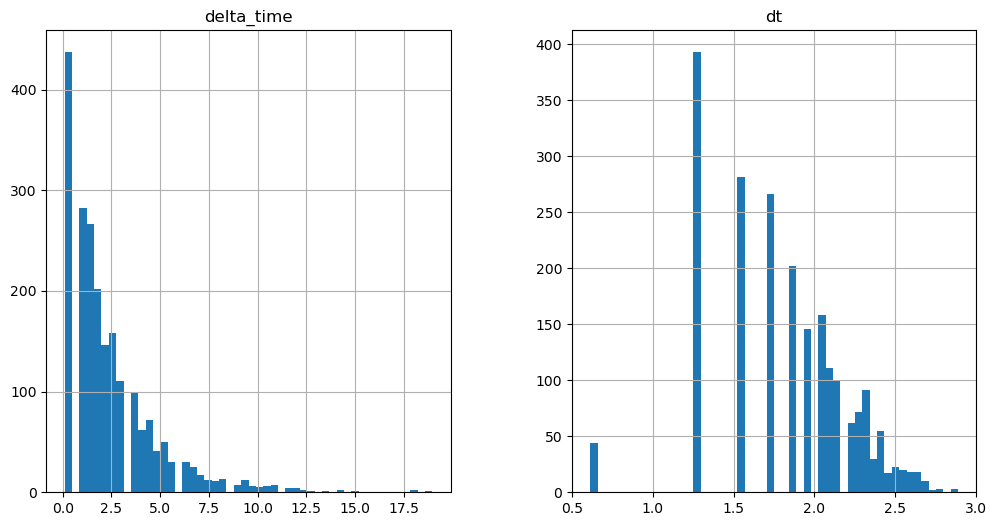

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

25.580011188983917 0.1


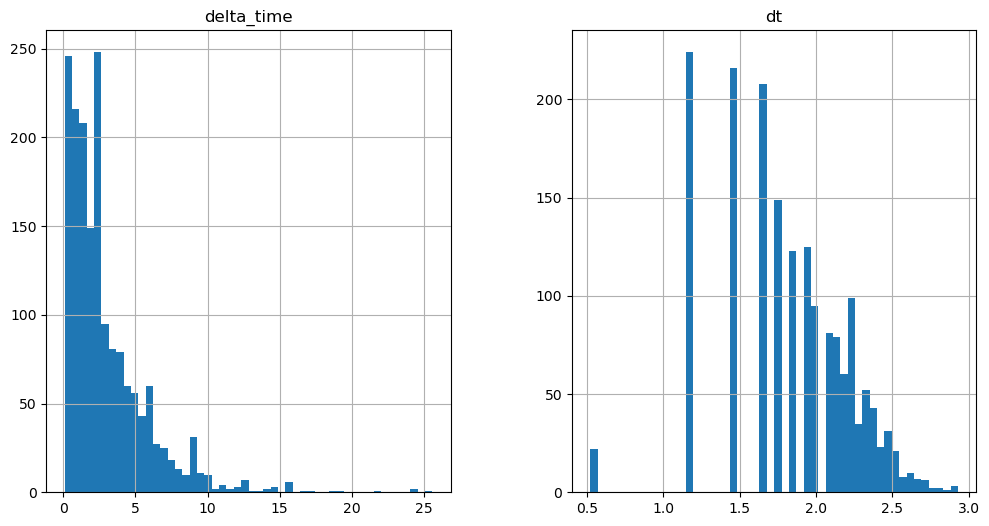

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

221.39929097890854 0.8820800185203552


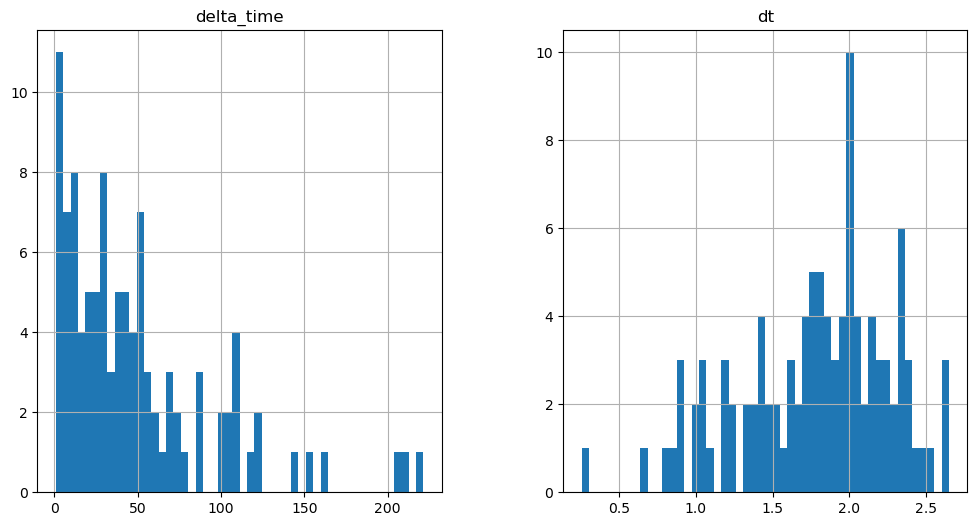

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

24.697931230068207 0.1


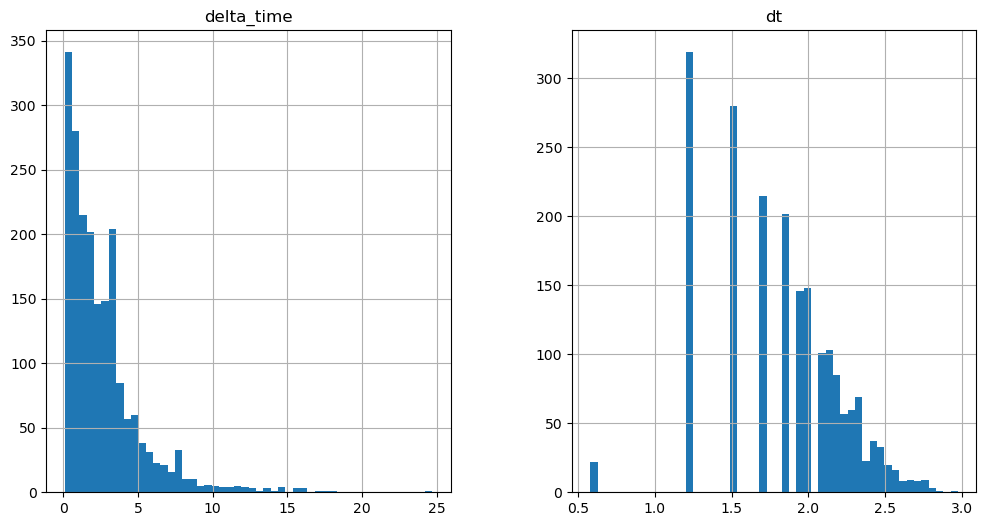

22.492741107940674 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

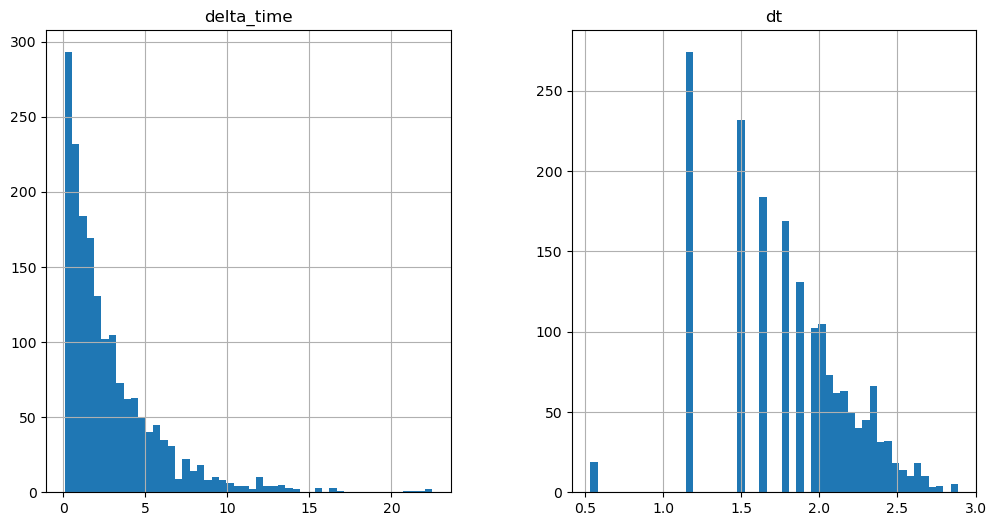

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

231.54287147521973 0.4410399794578552


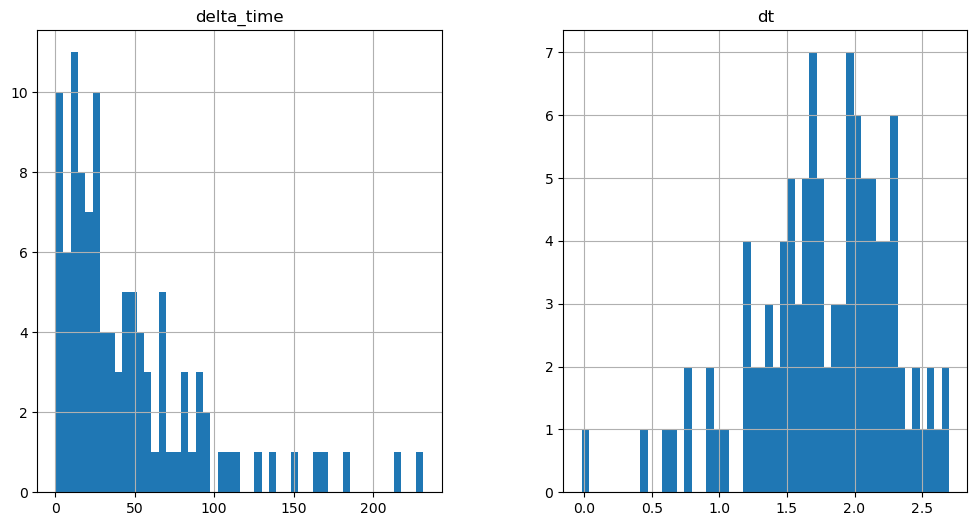

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

26.462051272392273 0.1


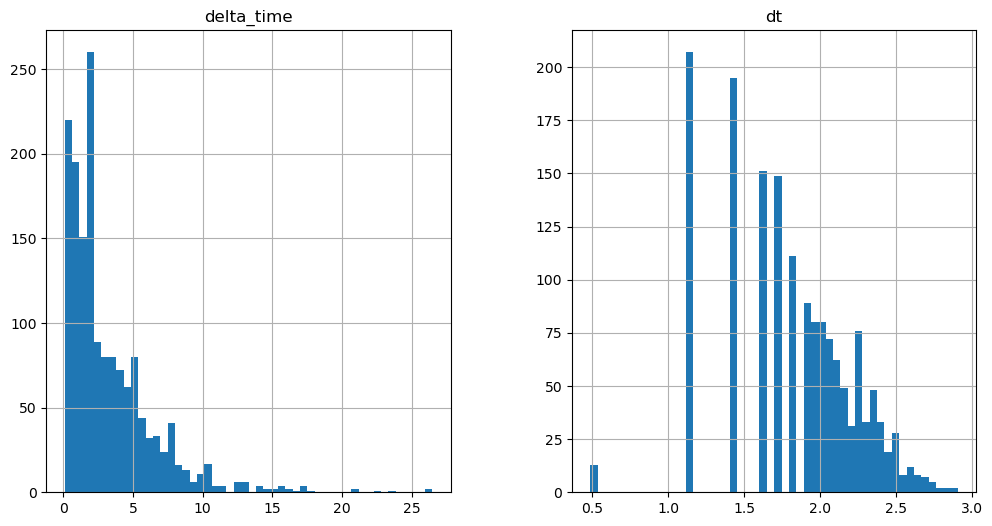

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)


19.84653103351593 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["E"] = np.log10(df_id["energy"])


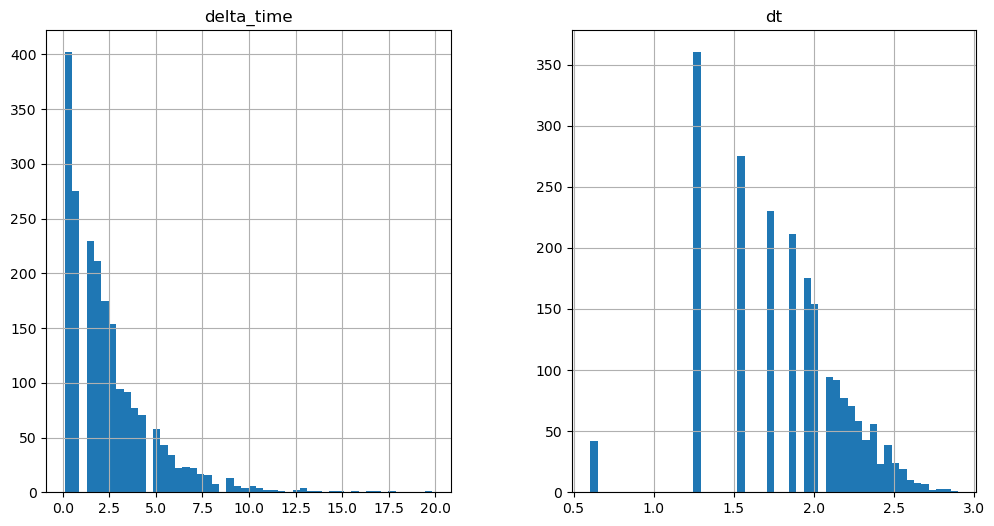

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

190.9678395986557 0.4410399794578552


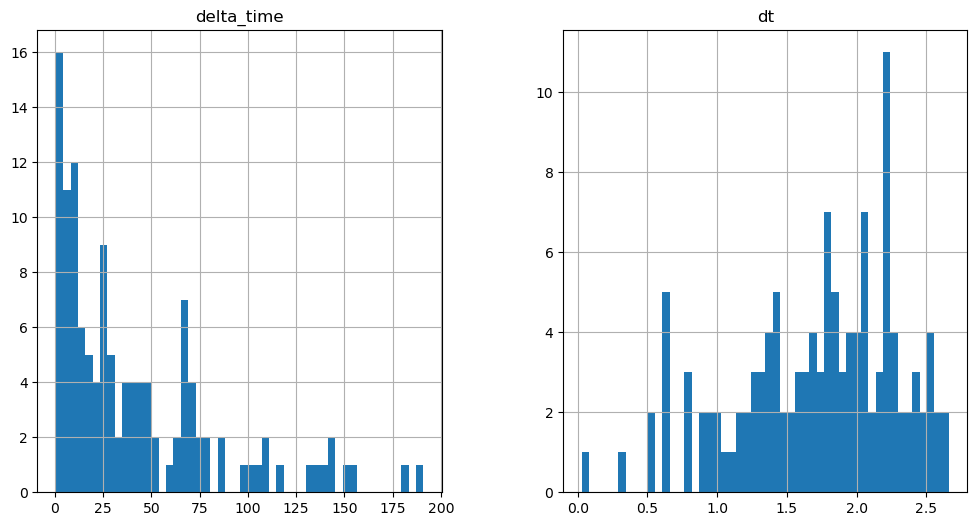

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

25.579991221427917 0.1


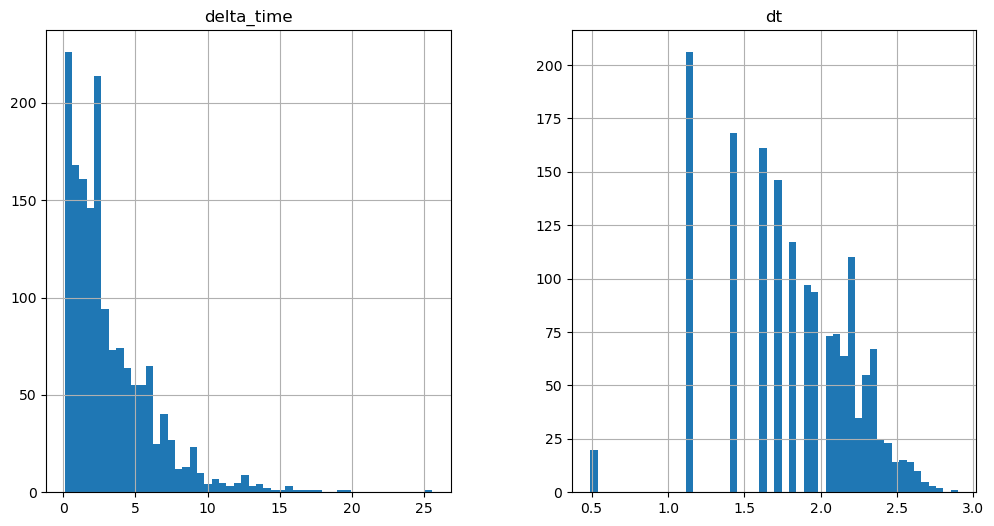

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))


20.728590965270996 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["E"] = np.log10(df_id["energy"])


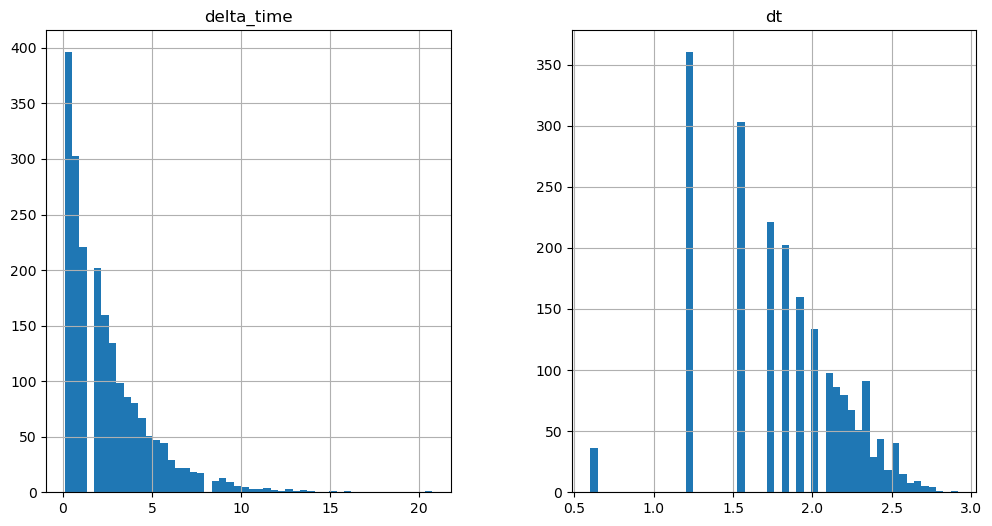

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

381.4948091506958 0.882050096988678


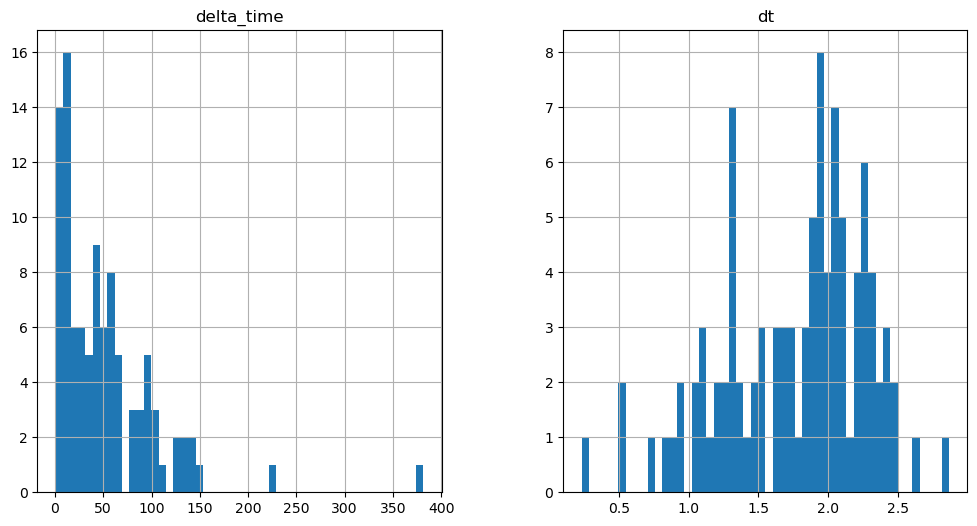

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

22.051710963249207 0.1


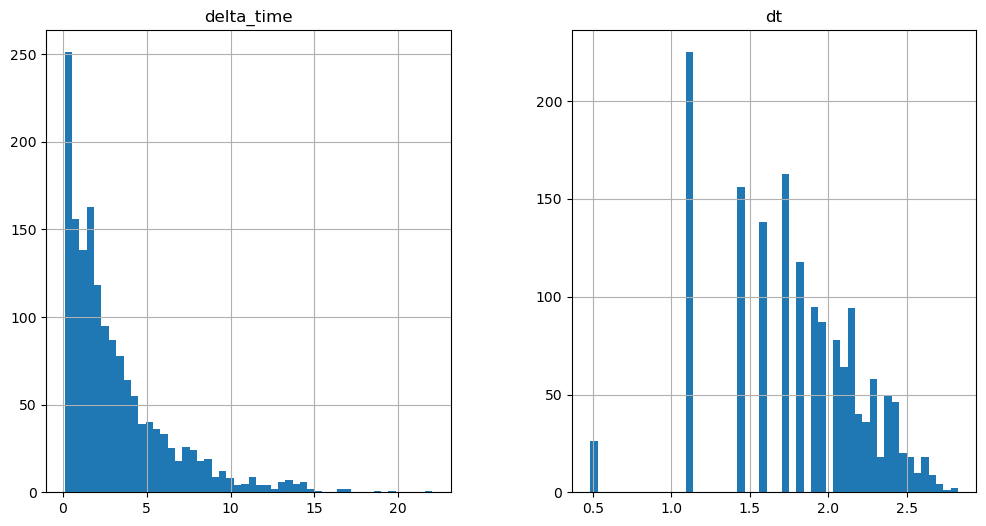

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

18.964460909366608 0.1


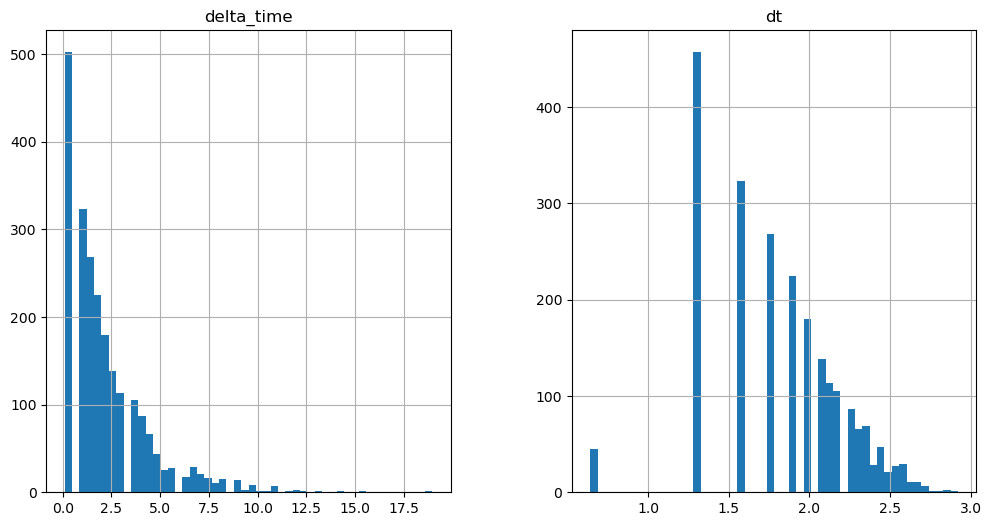

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

313.57500582933426 0.882050096988678


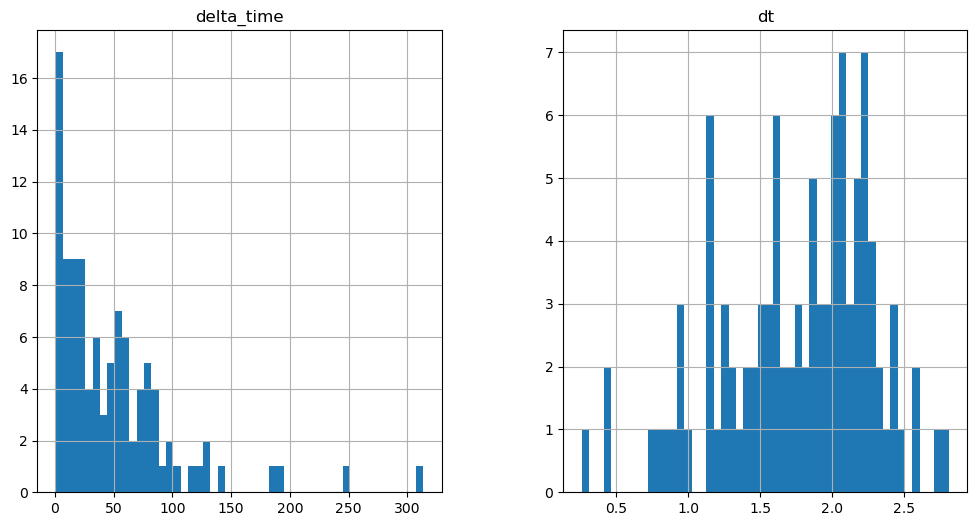

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

18.964431047439575 0.1


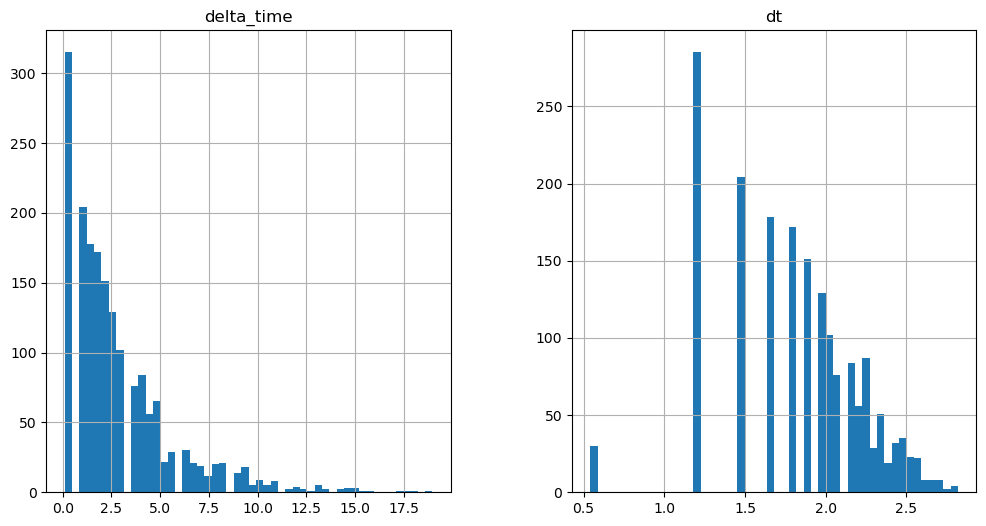

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

983.7727491259575 0.1


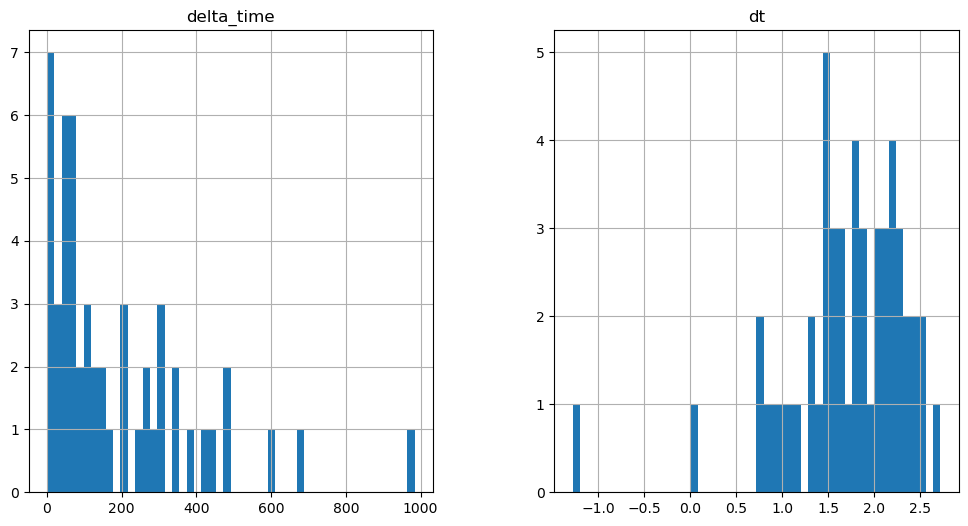

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

35.39494174718857 0.1


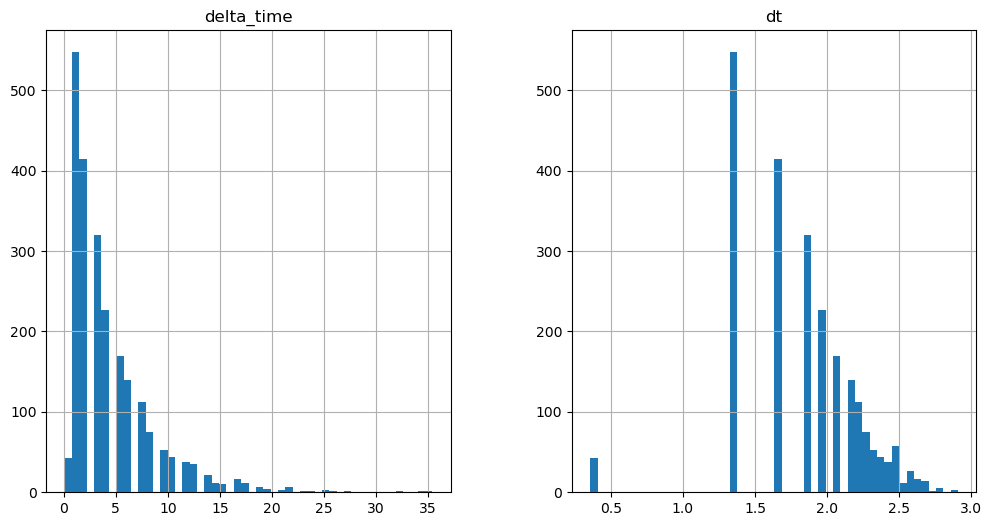

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

22.90282118320465 0.1


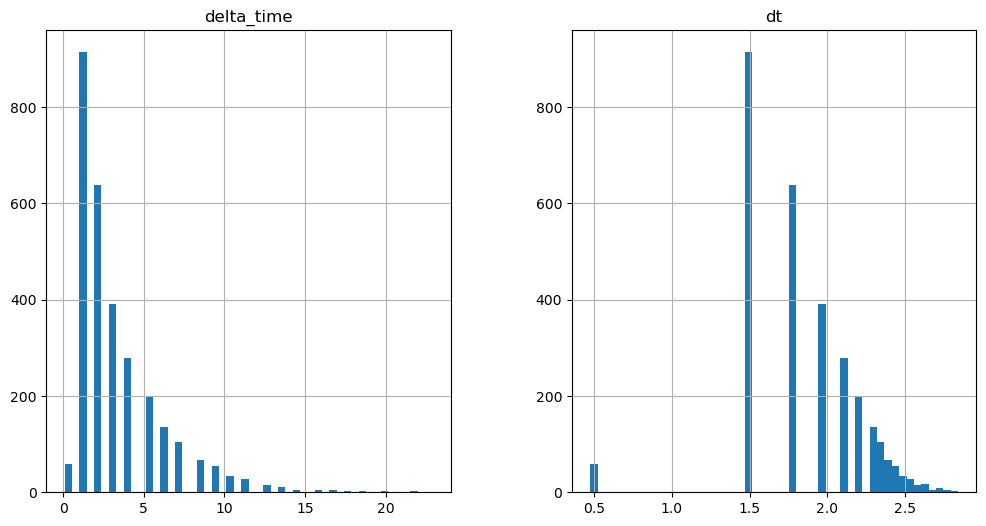

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

426.82335126399994 1.0410400032997131


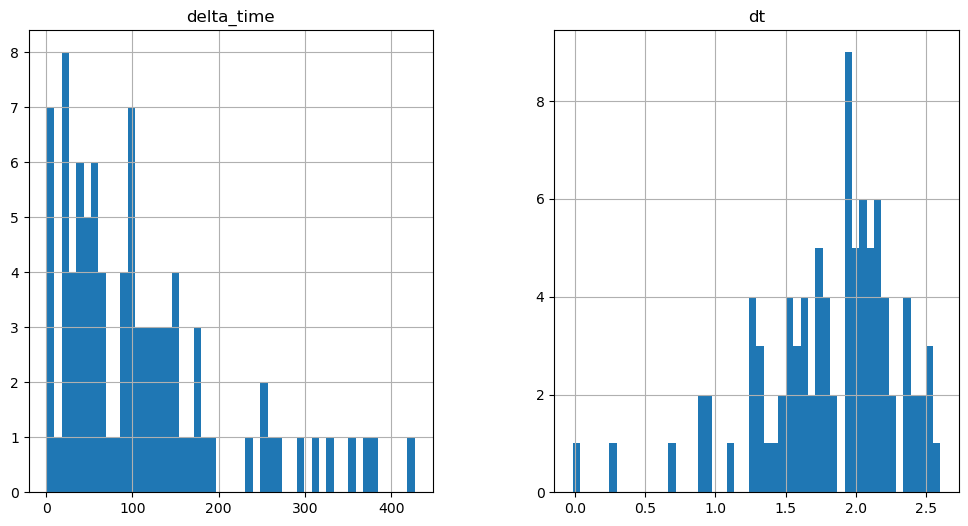

37.477161943912506 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

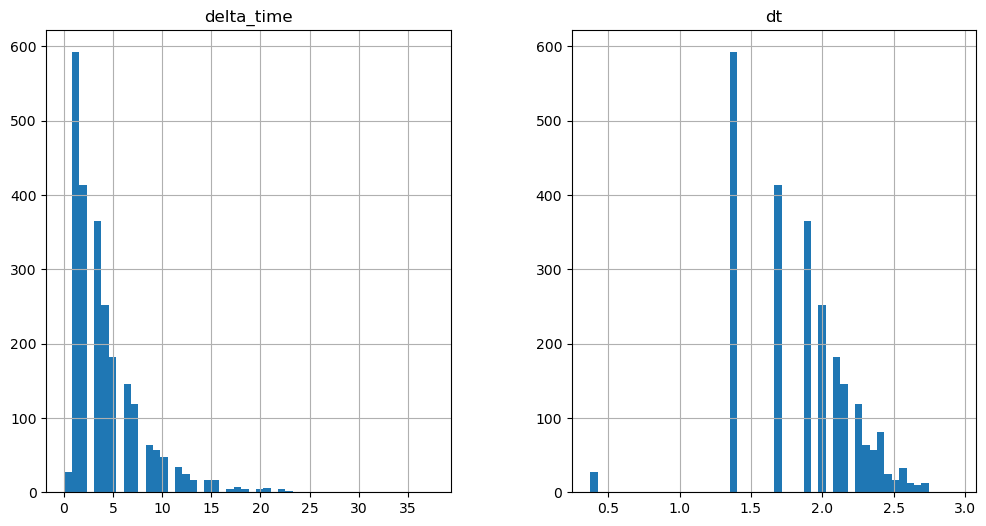

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

24.9846214056015 0.1


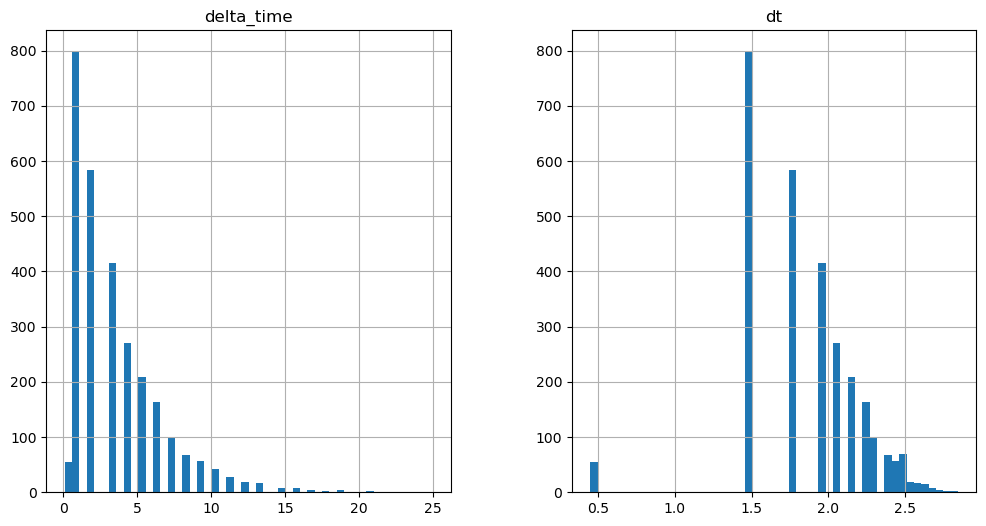

244.64169228076935 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

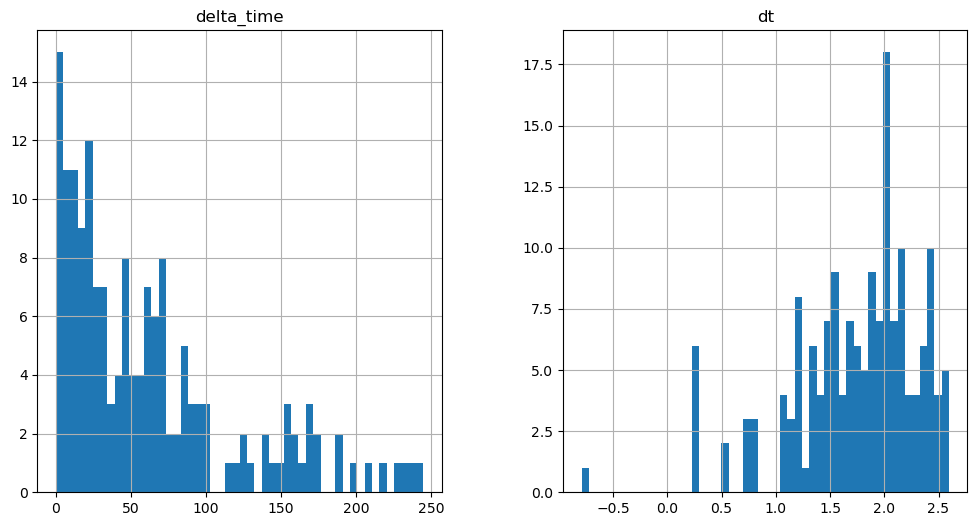

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1201.3468497991562 1.0410400032997131


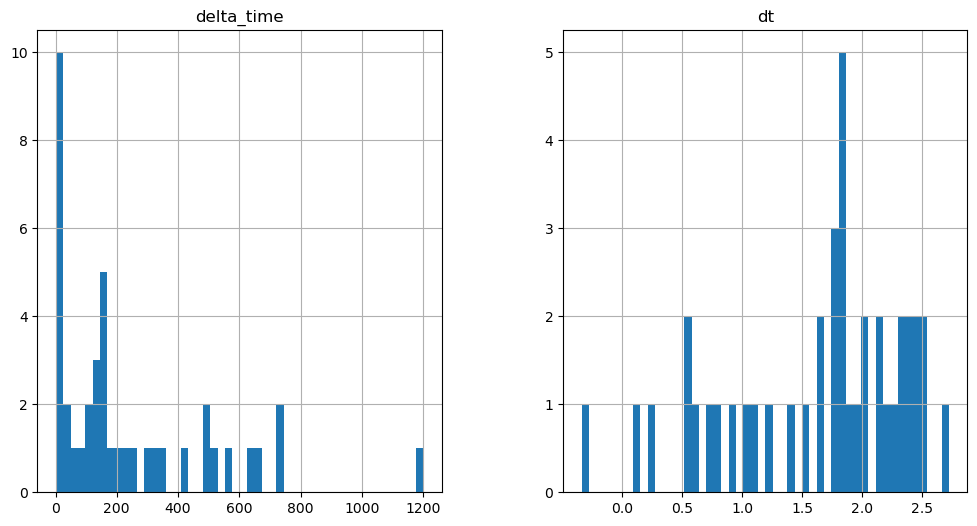

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

26.025671362876892 0.1


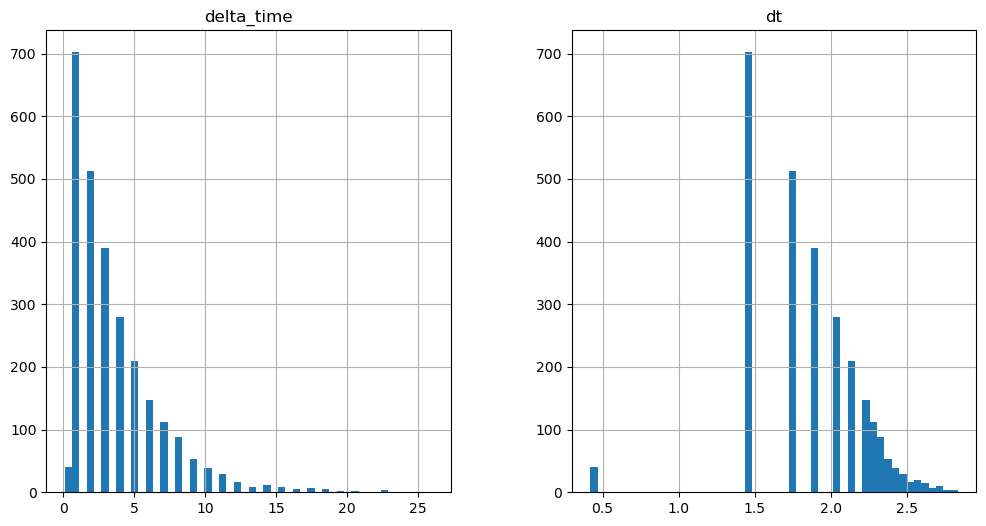

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

372.688308596611 1.0410100817680359


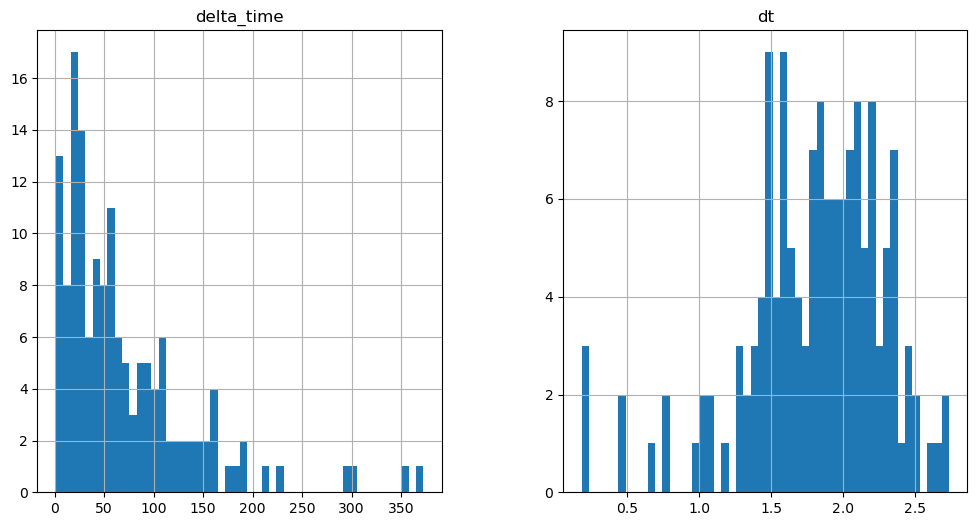

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

582.8334889411926 2.523090183734894


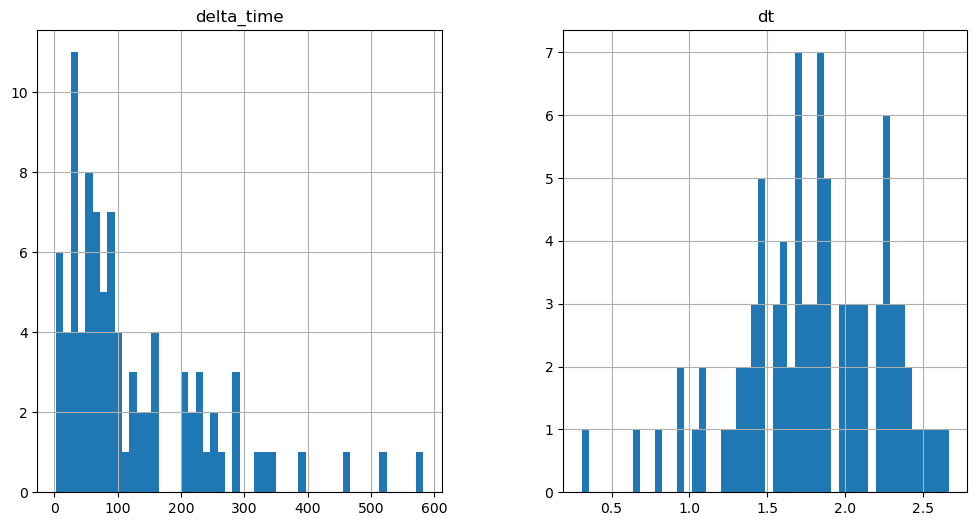

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/Users/steven/opt/anaconda3/envs/ciao-4.15/lib/python3.10/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

10283.739188432693 -60040.101548969746


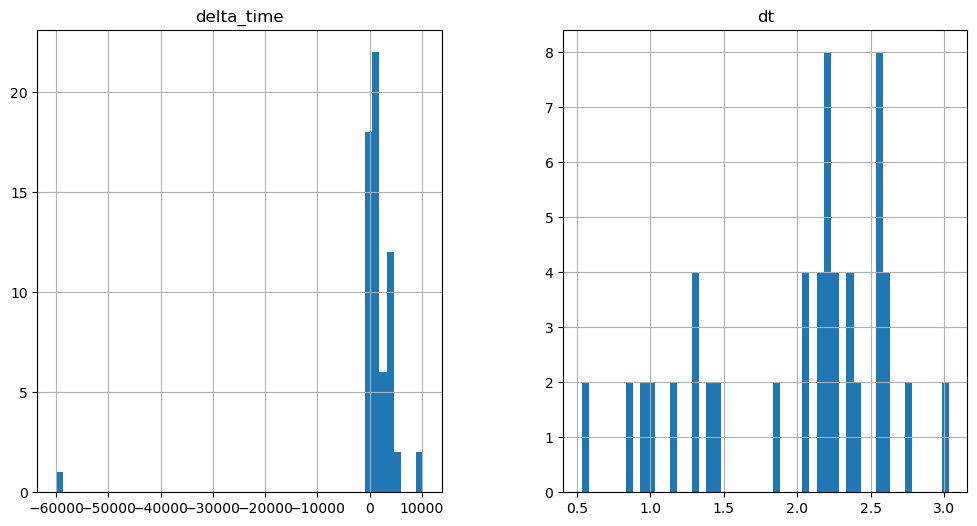

2942.863425731659 3.2410300374031067


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

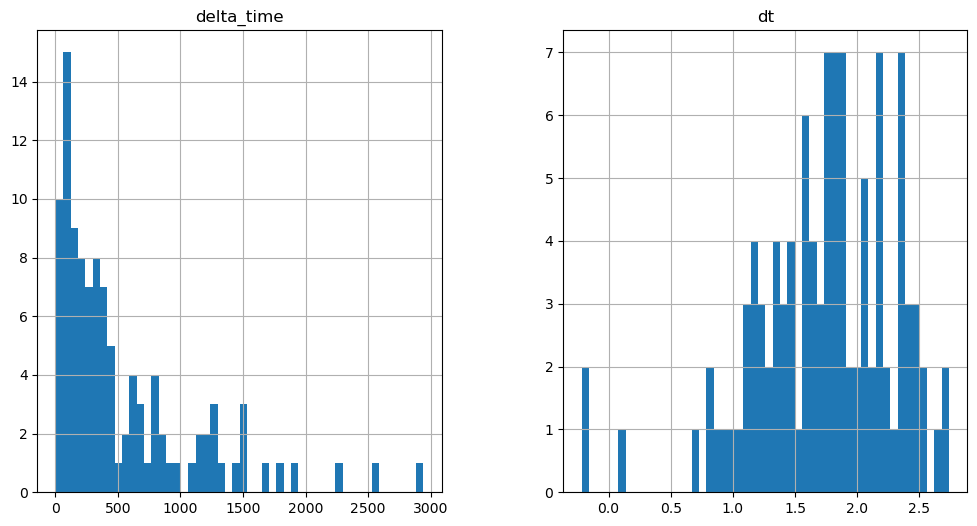

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/Users/steven/opt/anaconda3/envs/ciao-4.15/lib/python3.10/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

839.428991496563 -59797.023047566414


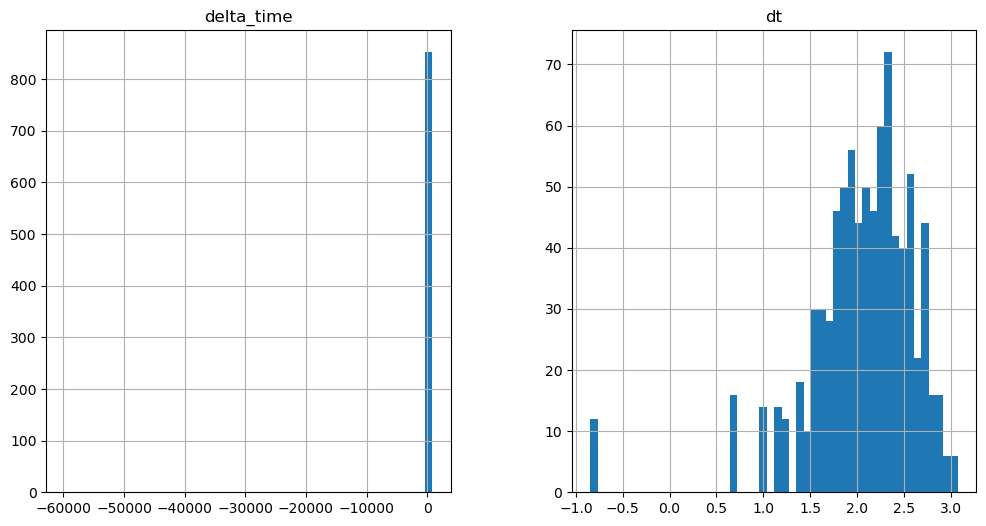

4265.198751151562 -56076.32209300995


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/Users/steven/opt/anaconda3/envs/ciao-4.15/lib/python3.10/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

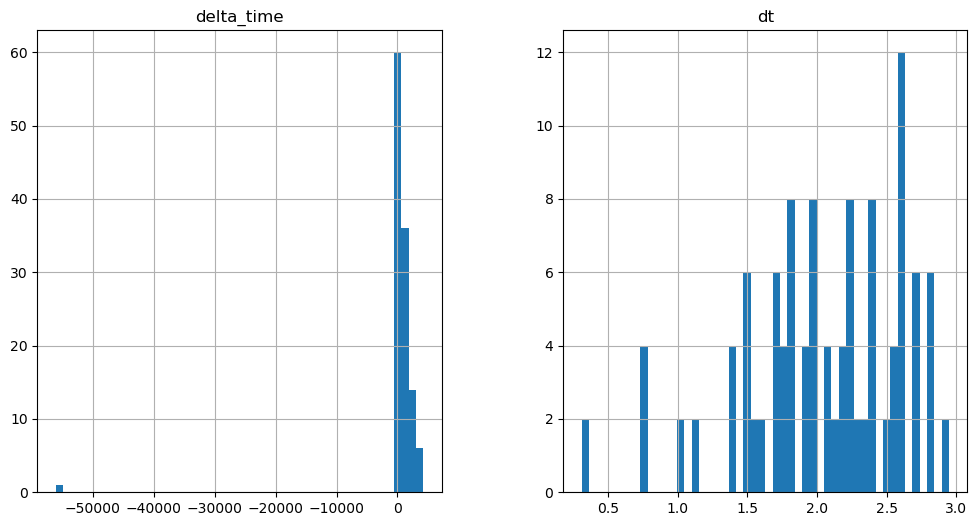

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/Users/steven/opt/anaconda3/envs/ciao-4.15/lib/python3.10/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

1179.738458454609 -59064.55478090048


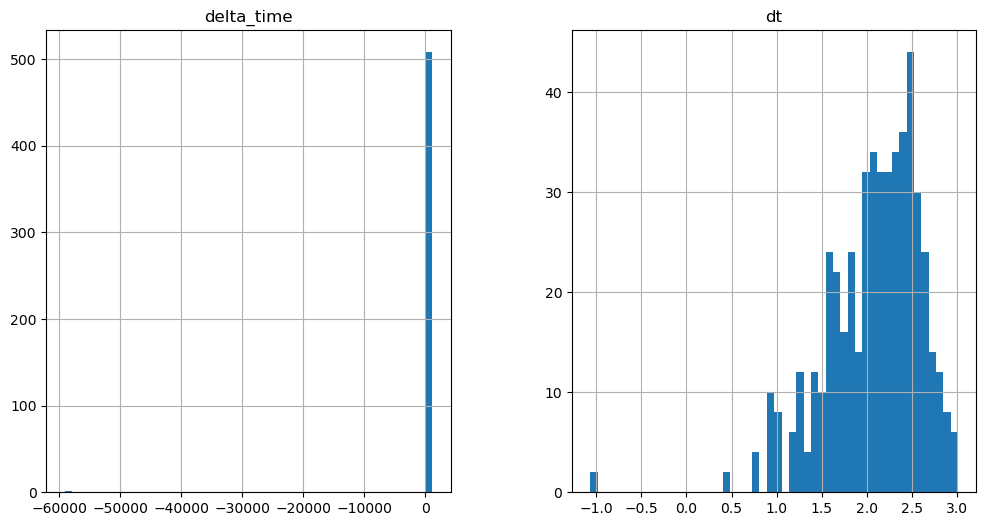

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/Users/steven/opt/anaconda3/envs/ciao-4.15/lib/python3.10/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

4459.667020559311 -57674.15983211994


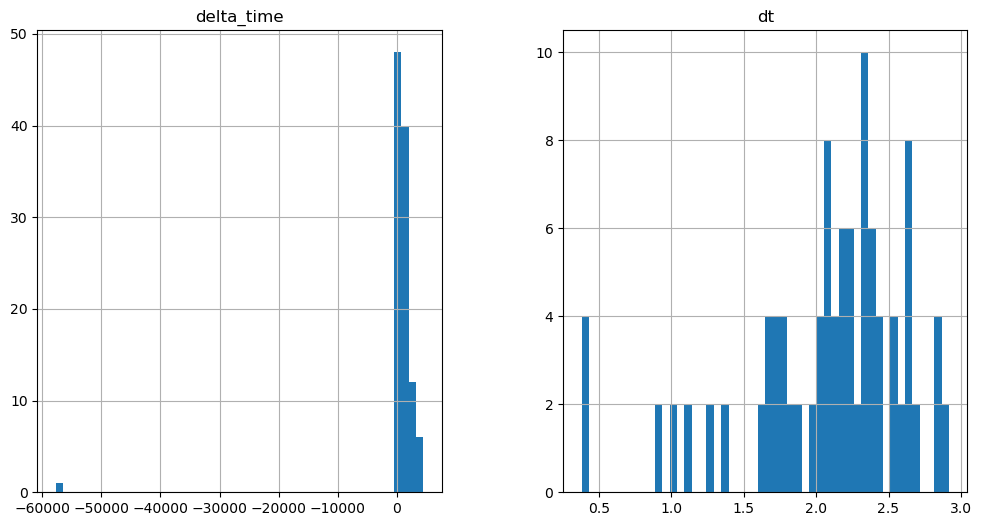

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/Users/steven/opt/anaconda3/envs/ciao-4.15/lib/python3.10/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

10202.78800457716 -60036.86023914814


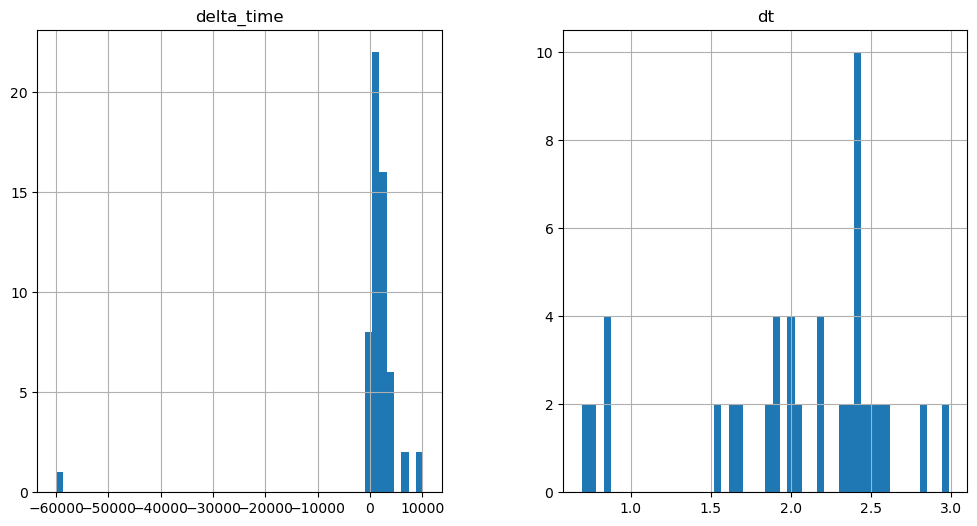

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/Users/steven/opt/anaconda3/envs/ciao-4.15/lib/python3.10/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

4446.684099912643 -57946.403735518456


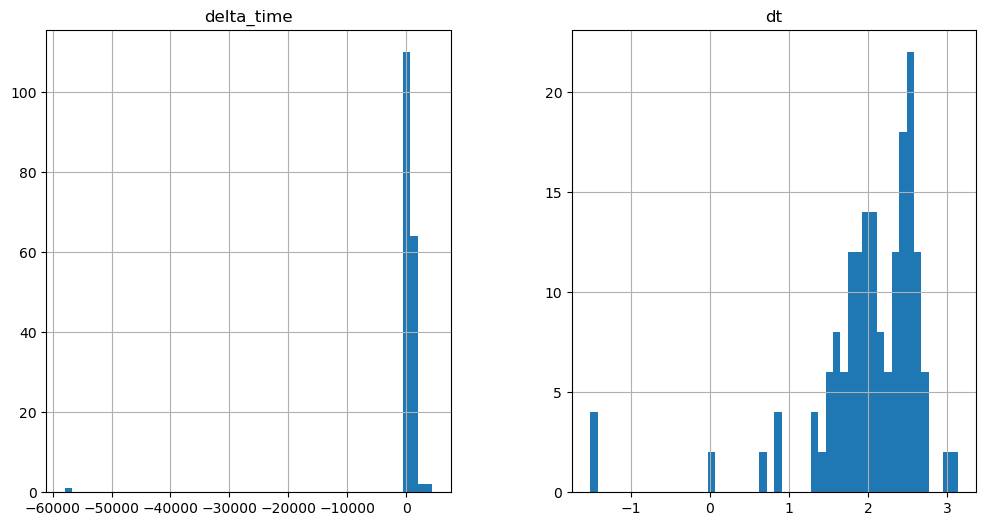

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/Users/steven/opt/anaconda3/envs/ciao-4.15/lib/python3.10/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

4929.615383803844 -58575.15975654125


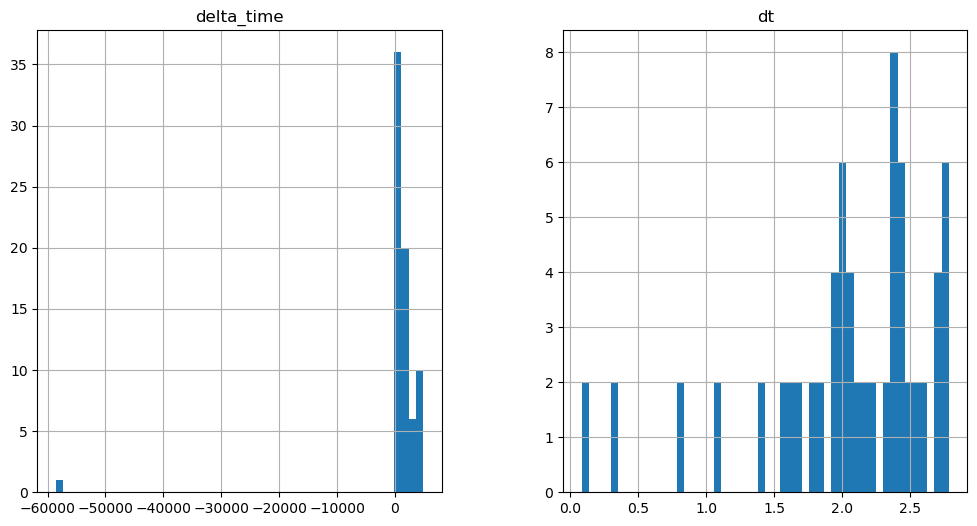

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/Users/steven/opt/anaconda3/envs/ciao-4.15/lib/python3.10/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

4715.702993273735 -57758.432496249676


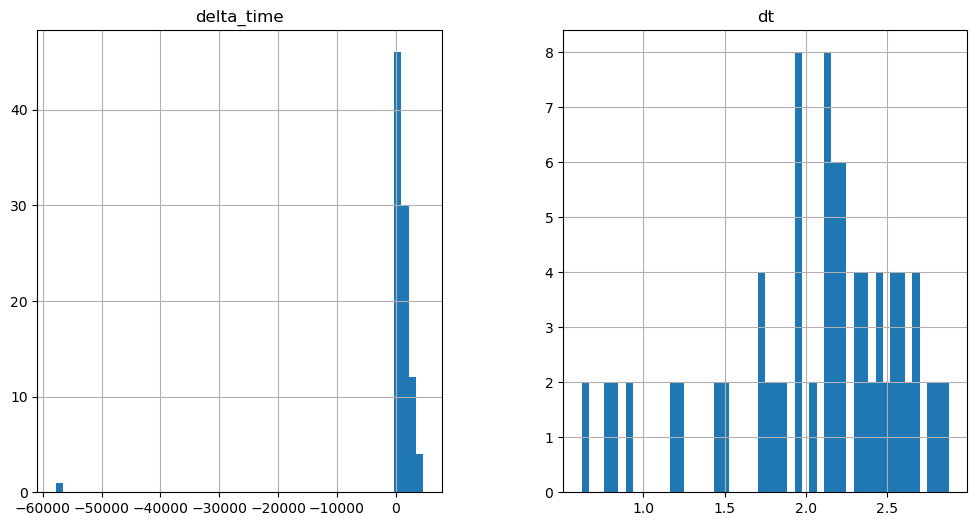

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/Users/steven/opt/anaconda3/envs/ciao-4.15/lib/python3.10/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

2907.20901376009 -58704.80761307478


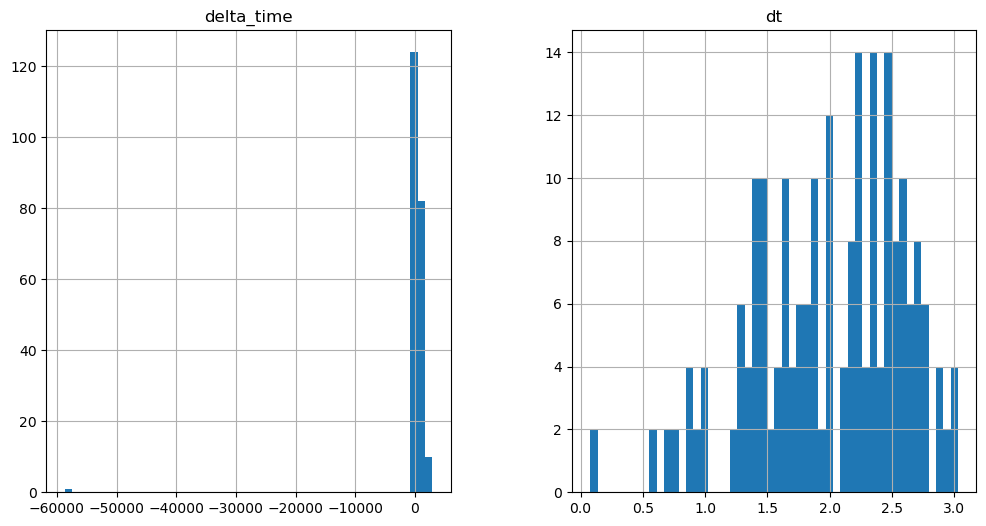

1228.3537407517433 -60091.95811146498


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/Users/steven/opt/anaconda3/envs/ciao-4.15/lib/python3.10/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

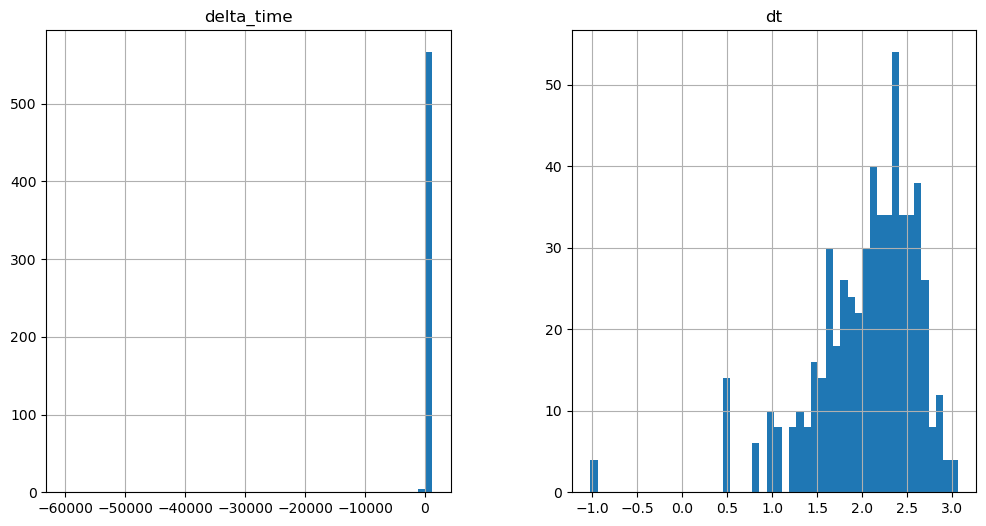

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/Users/steven/opt/anaconda3/envs/ciao-4.15/lib/python3.10/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

2693.294263124466 -58225.13030934334


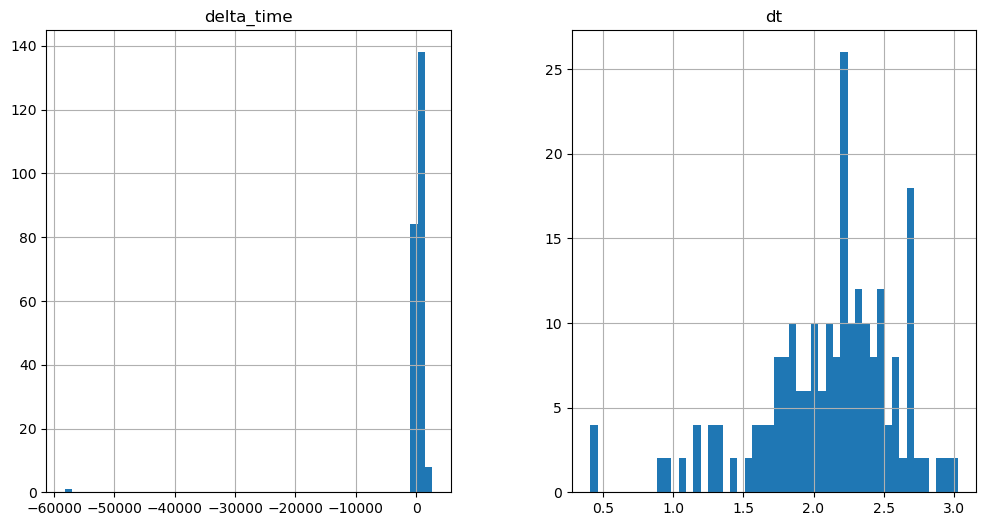

5133.805473804474 -59754.89388501644


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/Users/steven/opt/anaconda3/envs/ciao-4.15/lib/python3.10/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

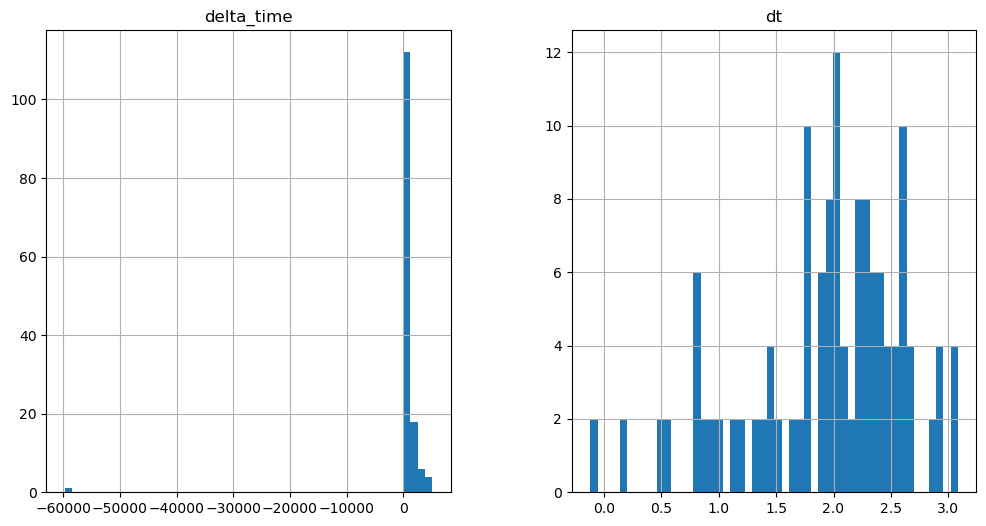

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/Users/steven/opt/anaconda3/envs/ciao-4.15/lib/python3.10/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

3999.4154777526855 -57606.09561878443


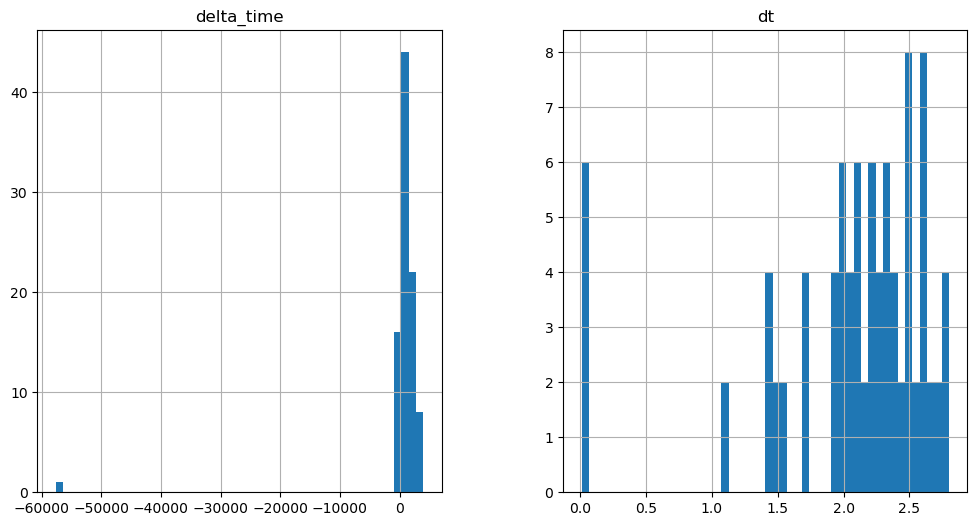

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/Users/steven/opt/anaconda3/envs/ciao-4.15/lib/python3.10/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

5597.264486312866 -58056.59153133631


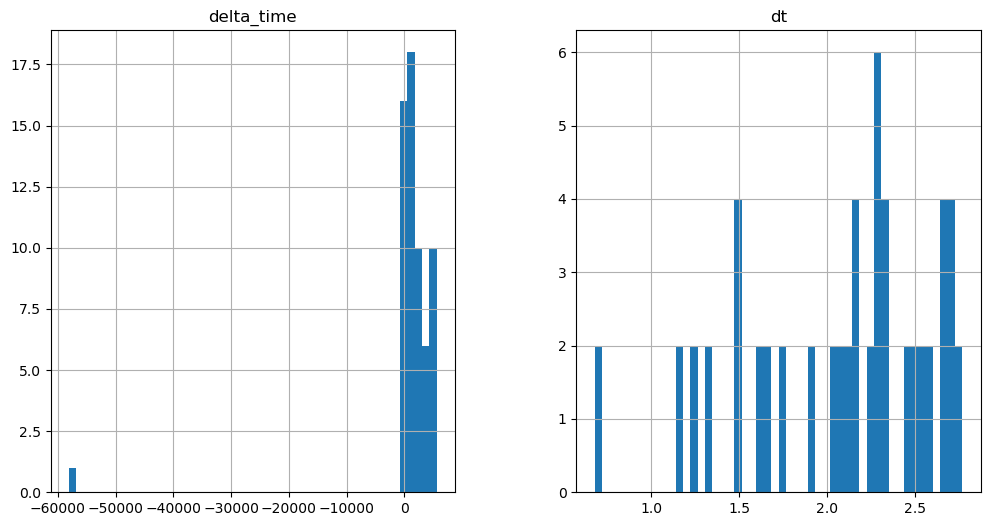

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/Users/steven/opt/anaconda3/envs/ciao-4.15/lib/python3.10/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

2913.6822839975357 -59327.073503792286


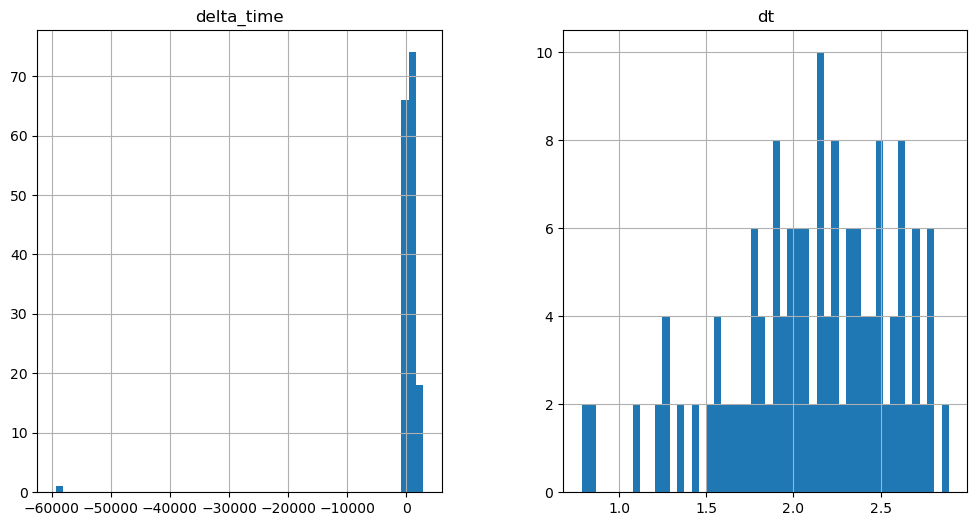

1824.7050602436066 -59190.95409709215


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/Users/steven/opt/anaconda3/envs/ciao-4.15/lib/python3.10/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

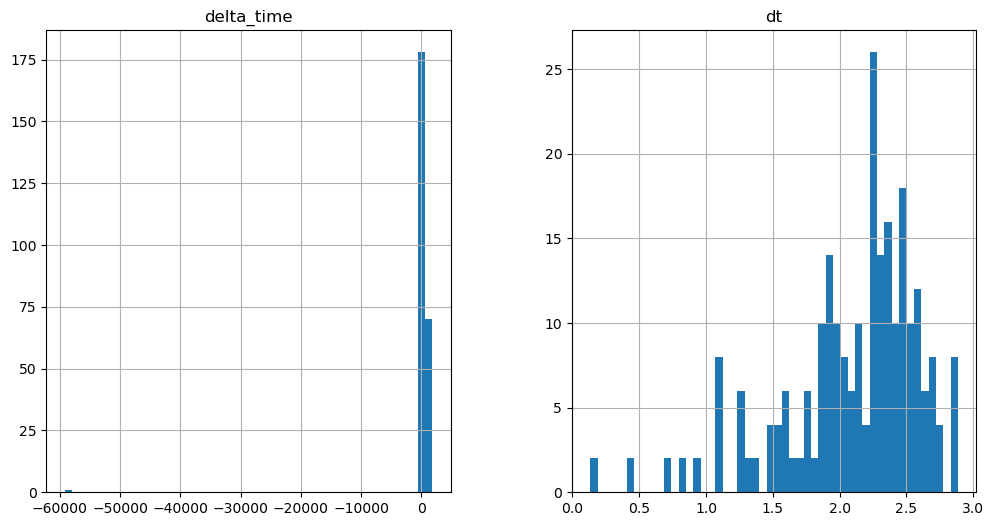

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/Users/steven/opt/anaconda3/envs/ciao-4.15/lib/python3.10/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

346.79051691293716 -60101.68193209171


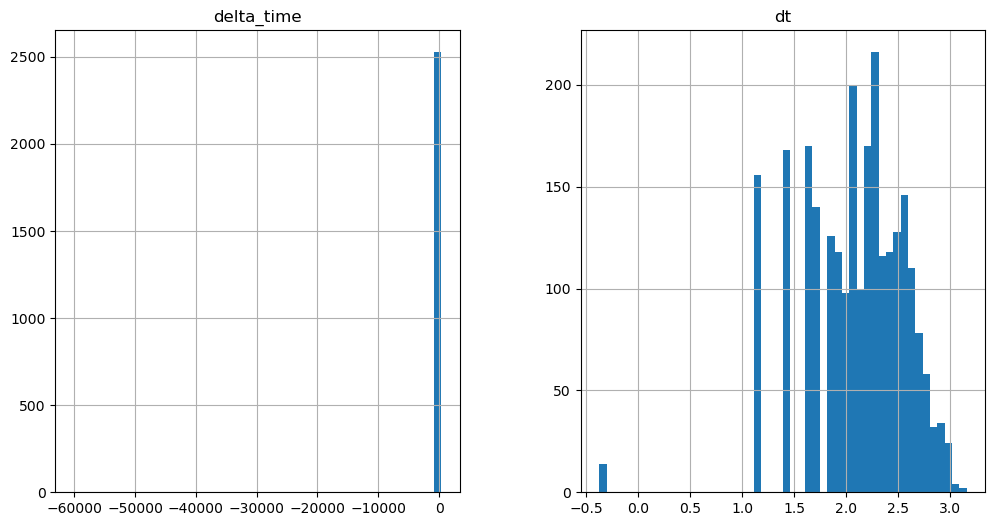

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2090.4696642160416 0.1


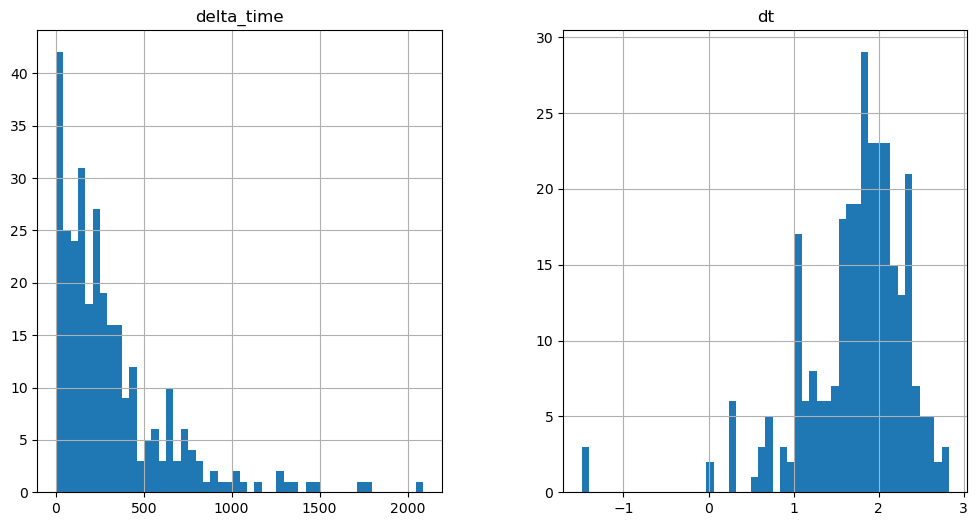

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4900.439994096756 3.2410401105880737


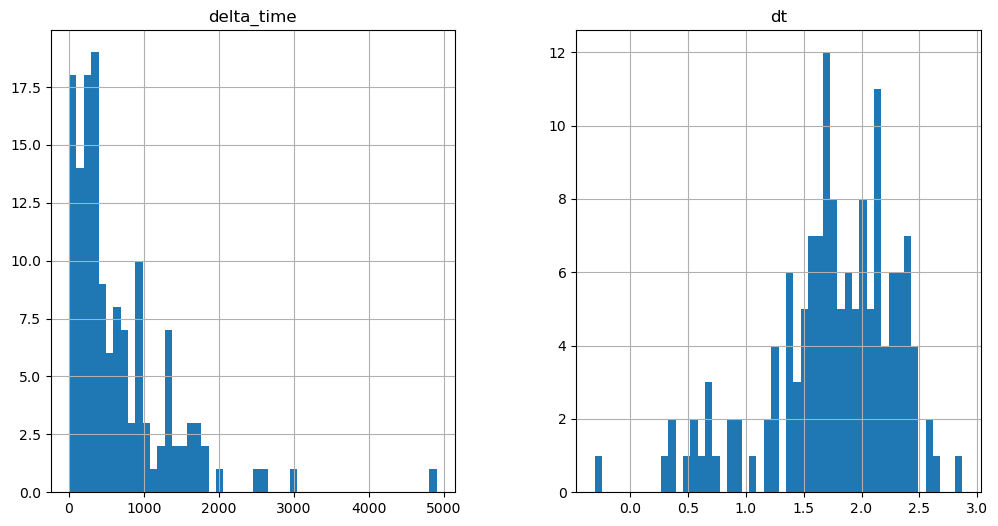

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1088.9894242286682 0.1


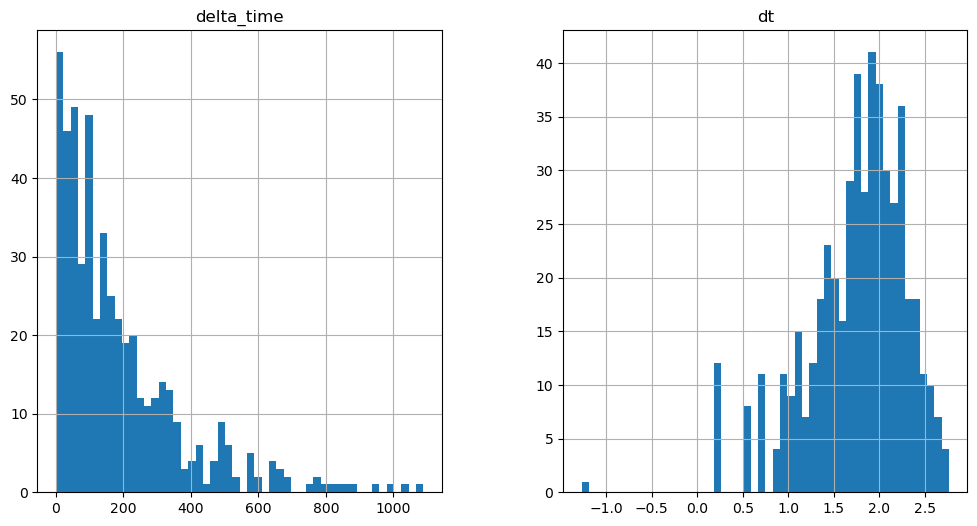

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3315.583695292473 12.96416062116623


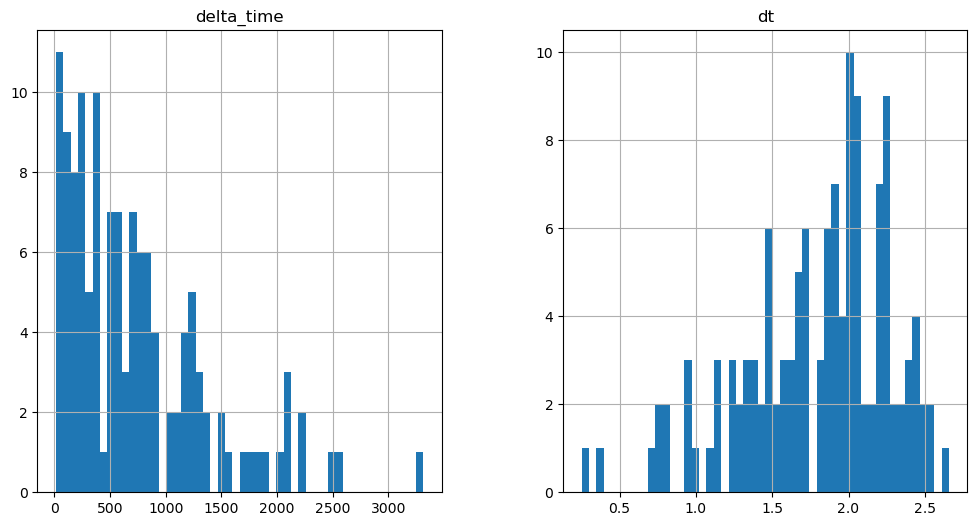

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

7237.205010652542 48.61540240049362


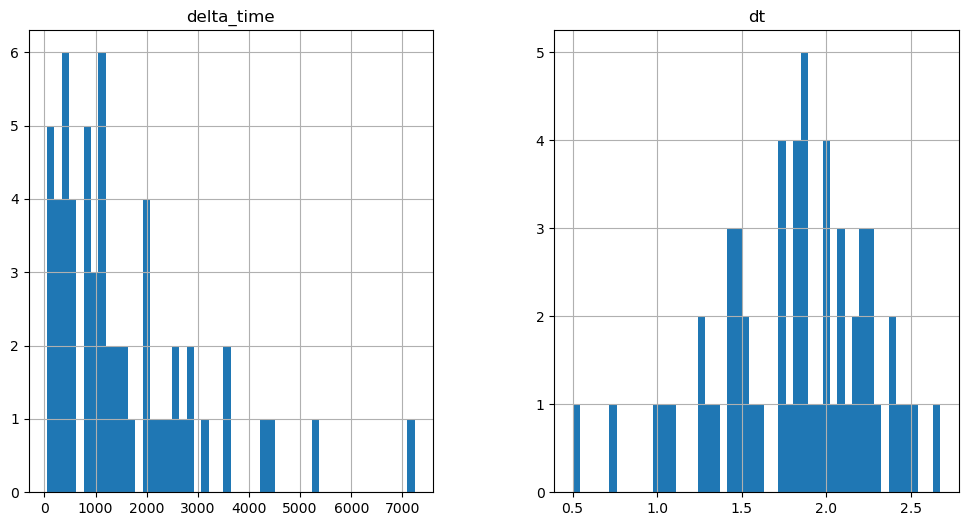

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4229.557140767574 12.96414053440094


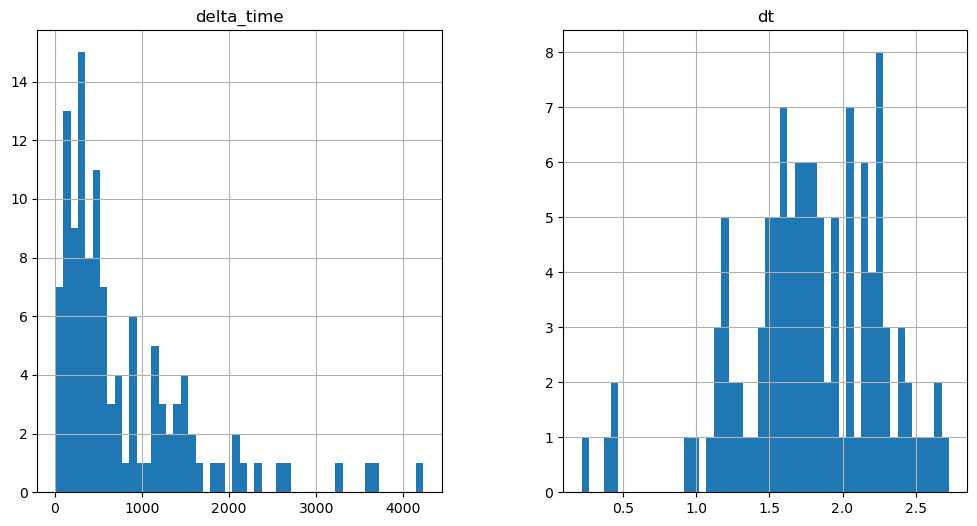

15453.27766996622 58.33864289522171


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

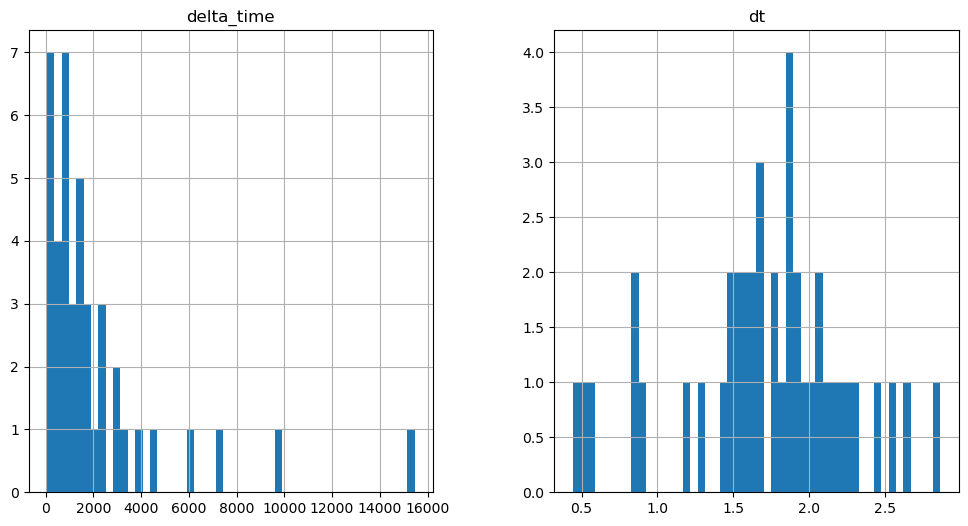

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

871.83955347538 0.1


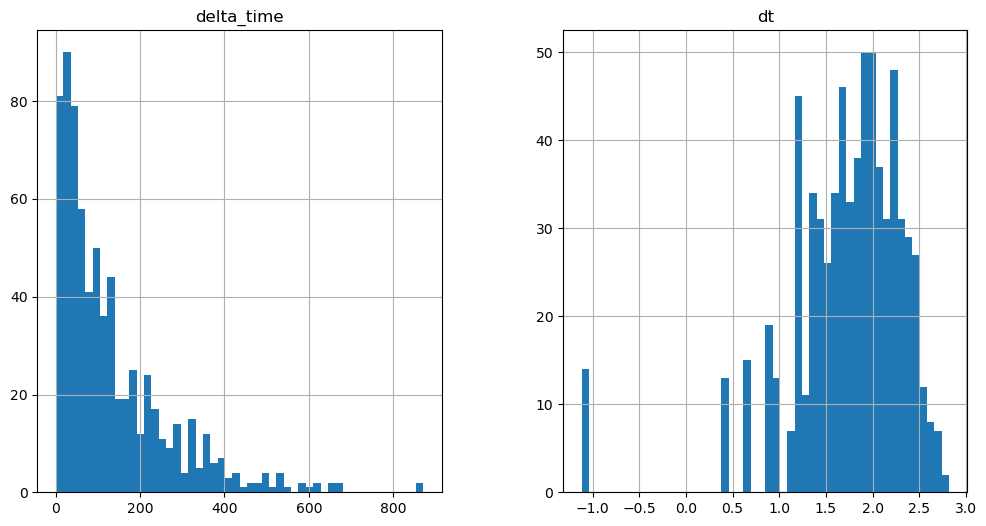

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

8319.729694545269 6.4820802211761475


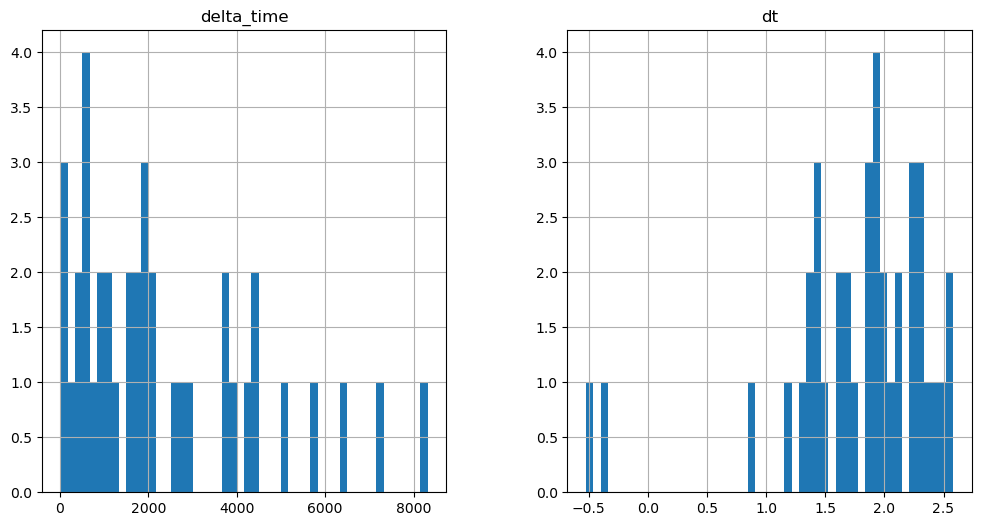

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3698.0265842676163 48.61497259140015


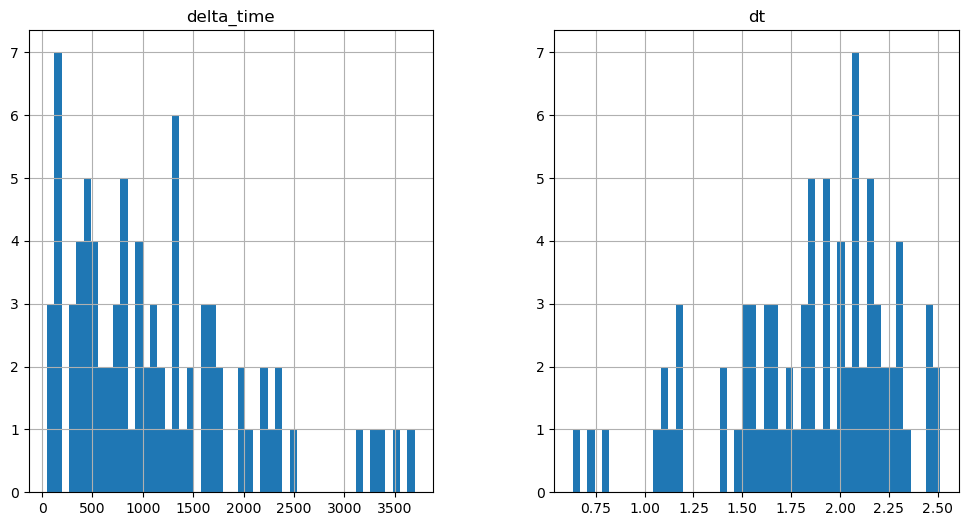

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

11314.470473766327 55.0976727604866


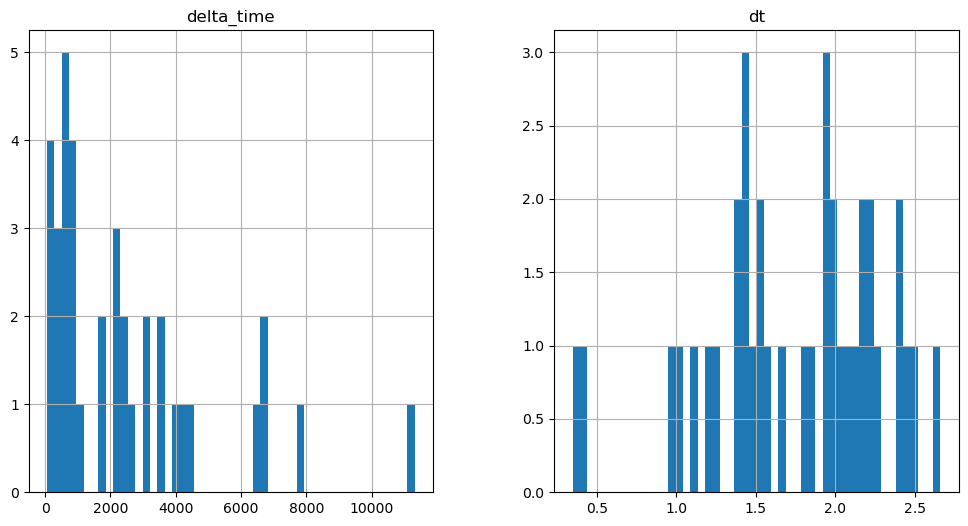

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5555.142066836357 9.723120391368866


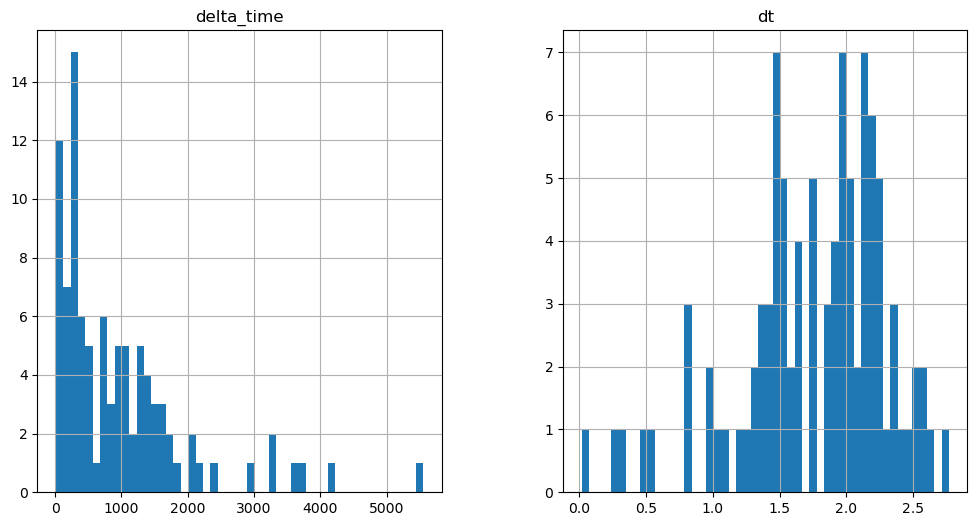

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2706.268364906311 3.241040050983429


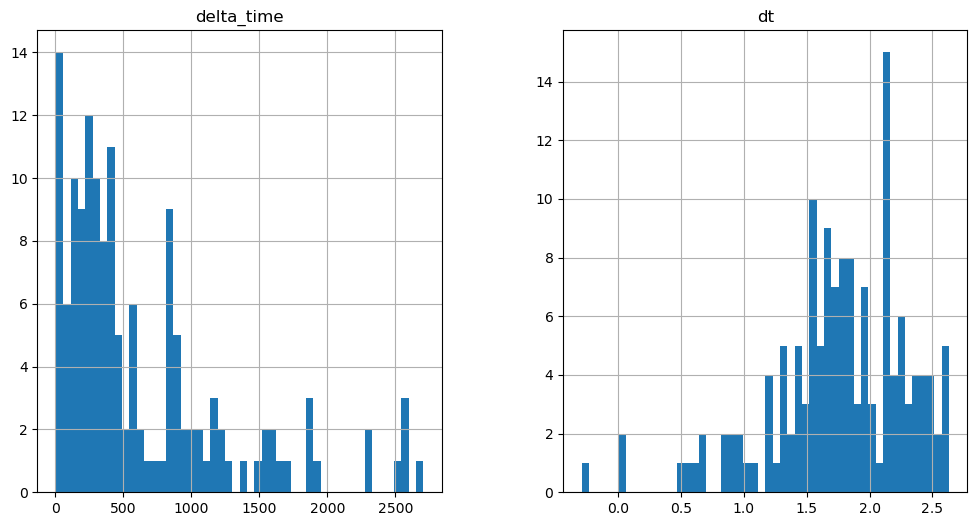

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5535.679935932159 16.205190777778625


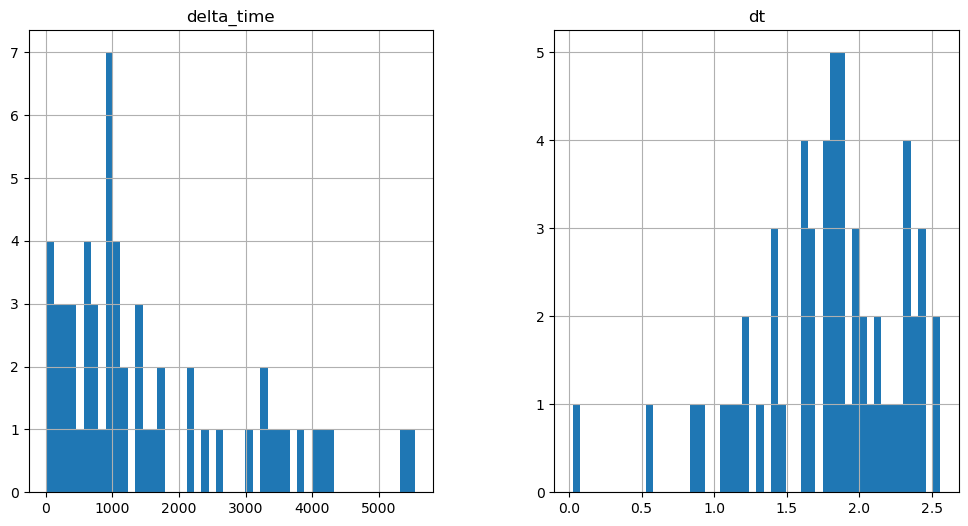

4018.885120332241 3.2410401105880737


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

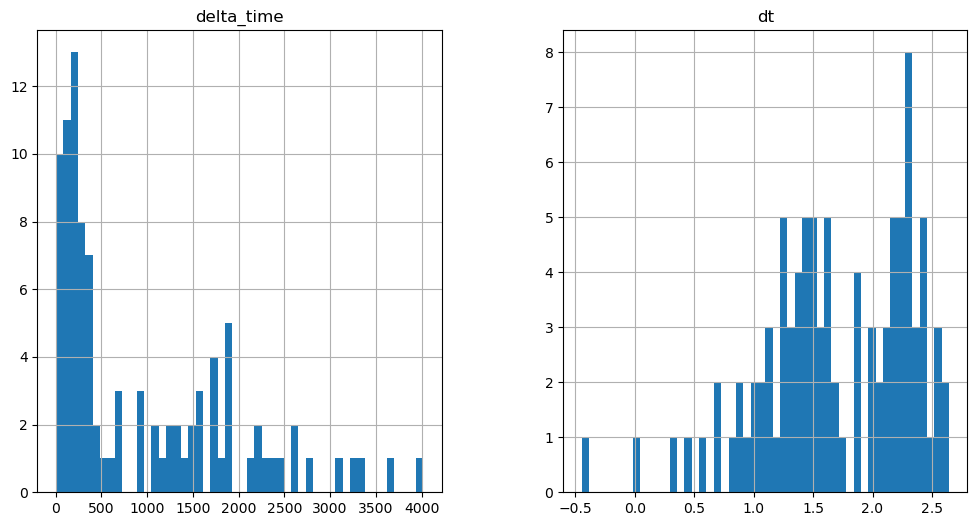

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4287.883313655853 0.1


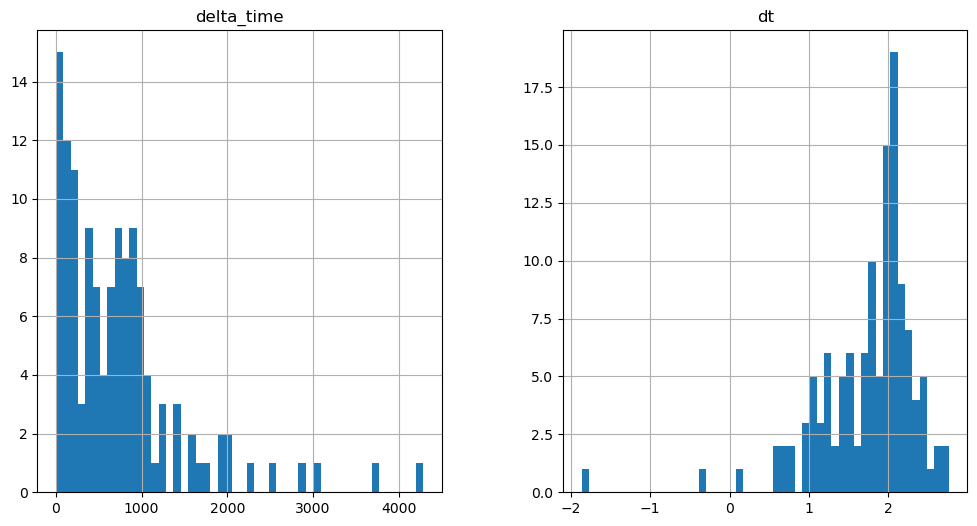

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1319.1031457781792 0.1


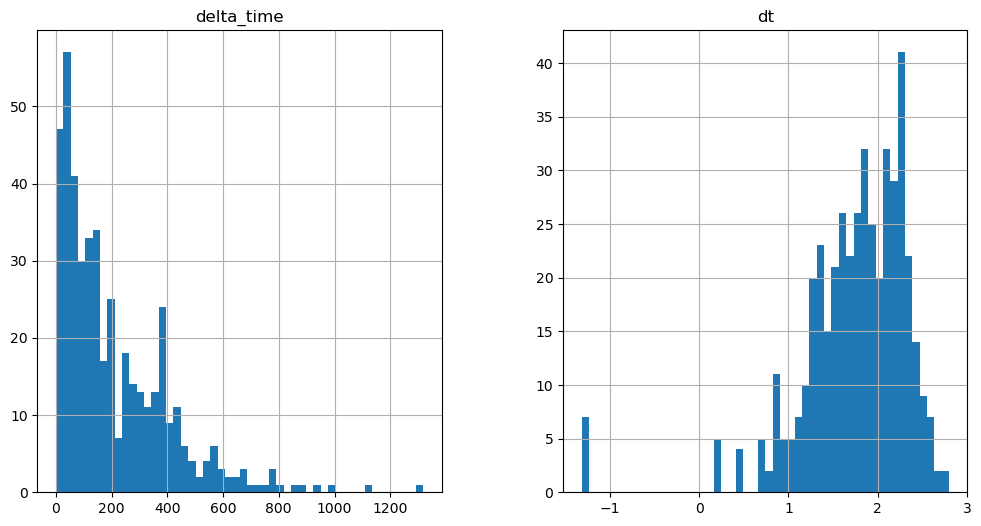

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3078.9809533953667 3.241040050983429


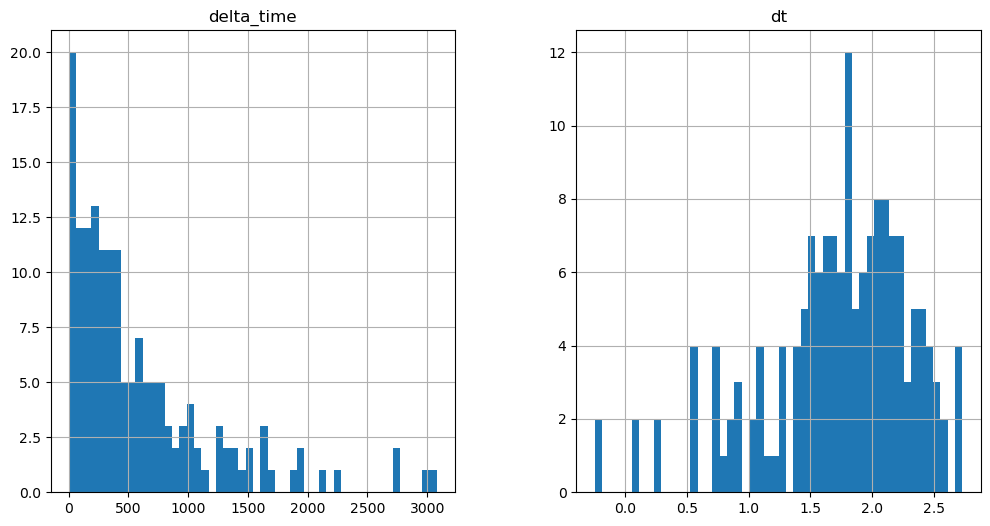

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3260.4861525297165 9.723120391368866


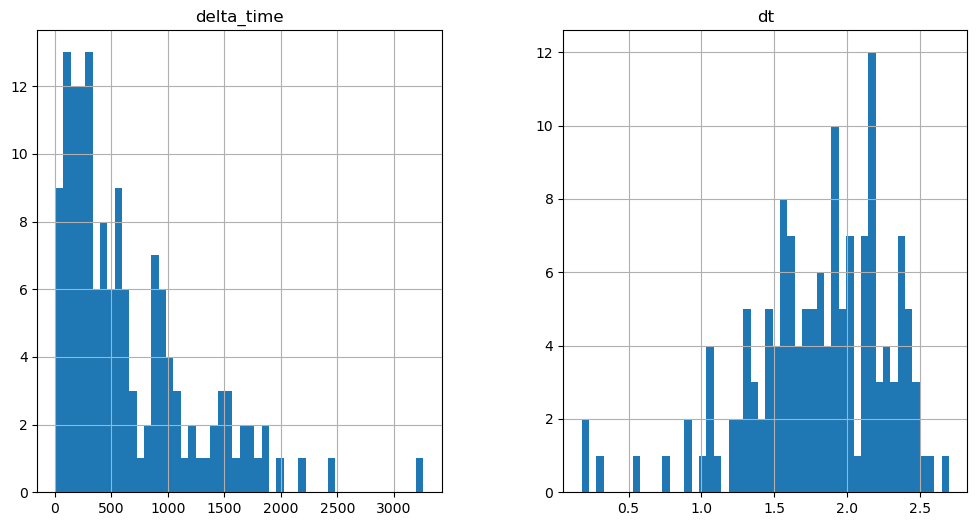

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2949.3463670015335 0.1


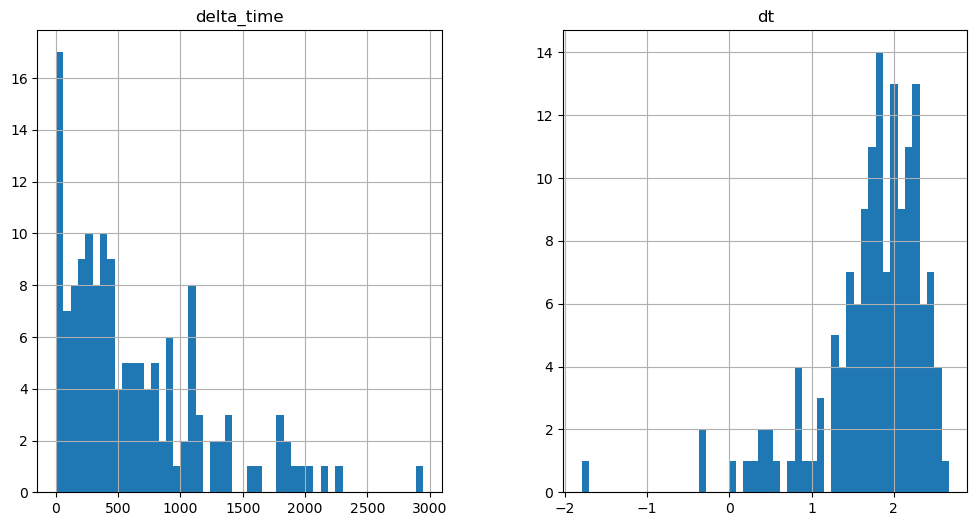

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4401.332269310951 9.723120510578156


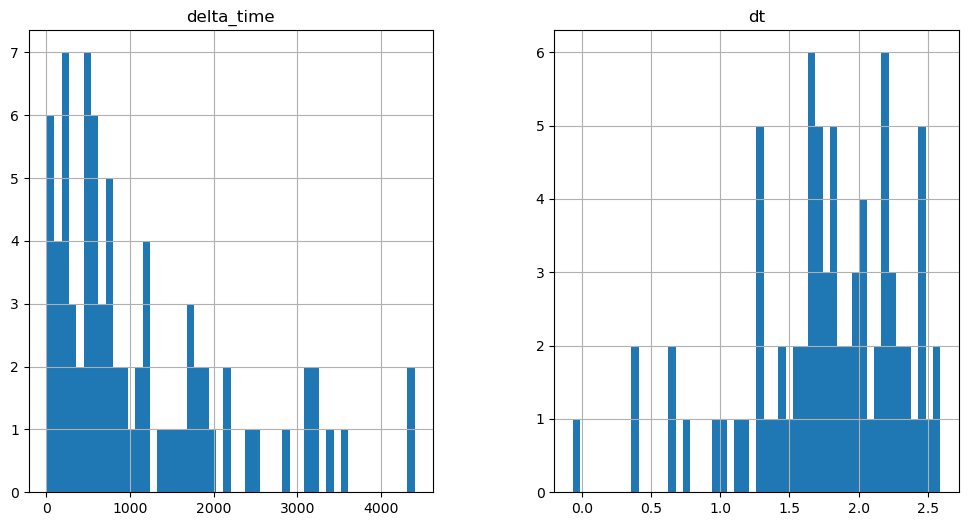

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1069.542663514614 0.1


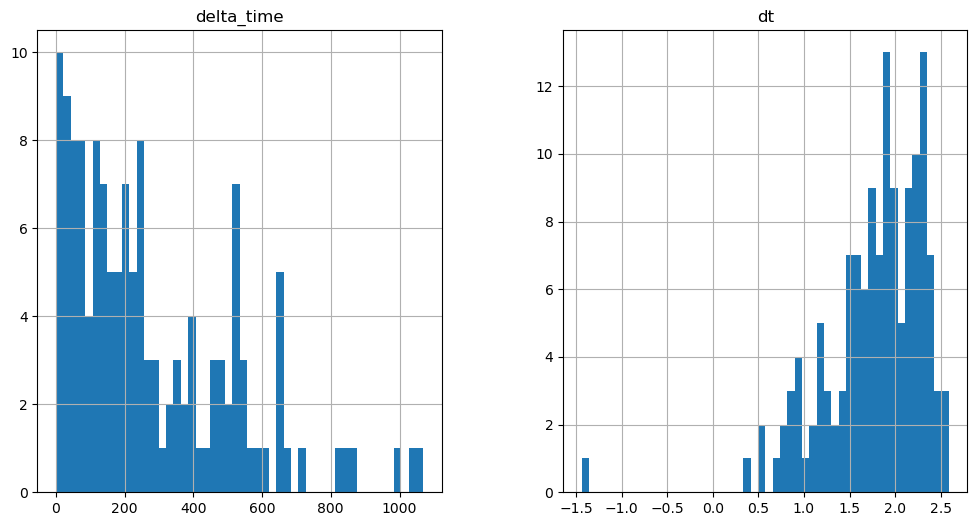

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3124.3401867747307 19.446210861206055


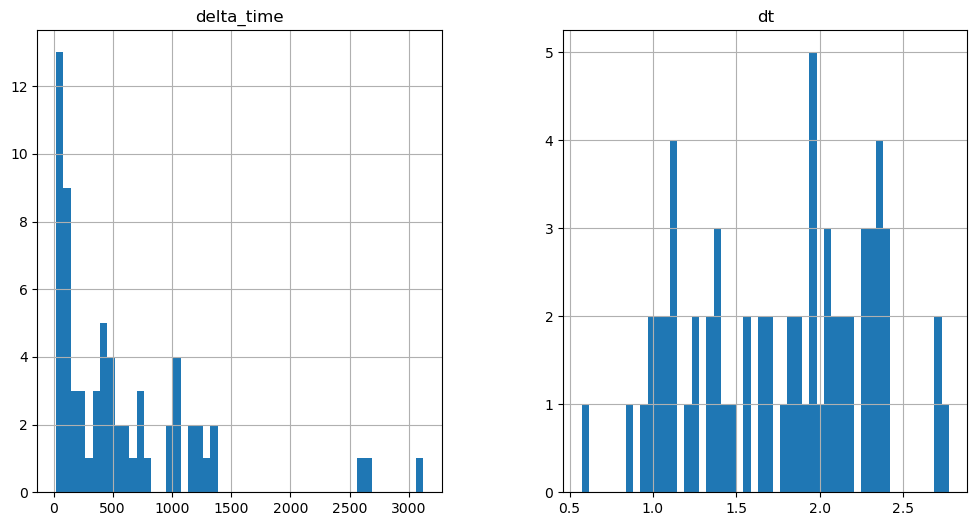

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3581.3462896943092 6.482070326805115


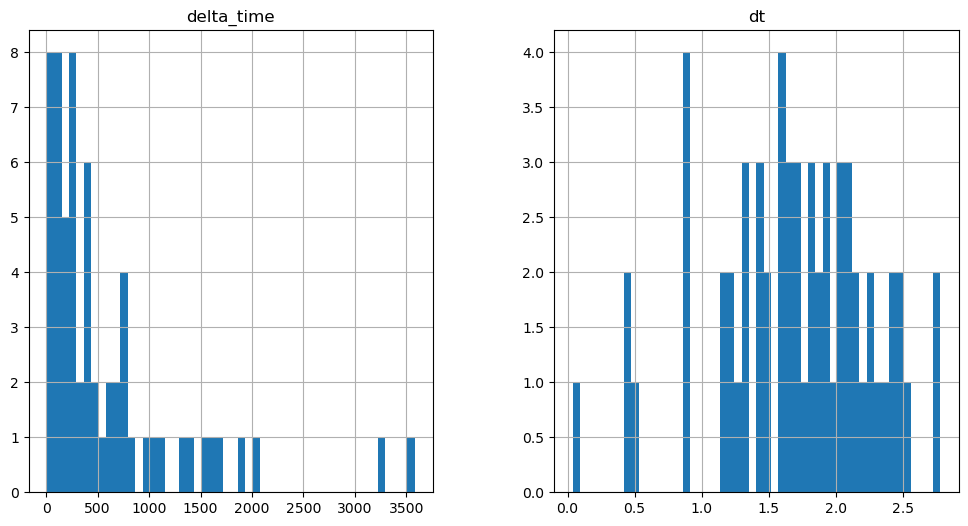

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1370.9554688334465 0.1


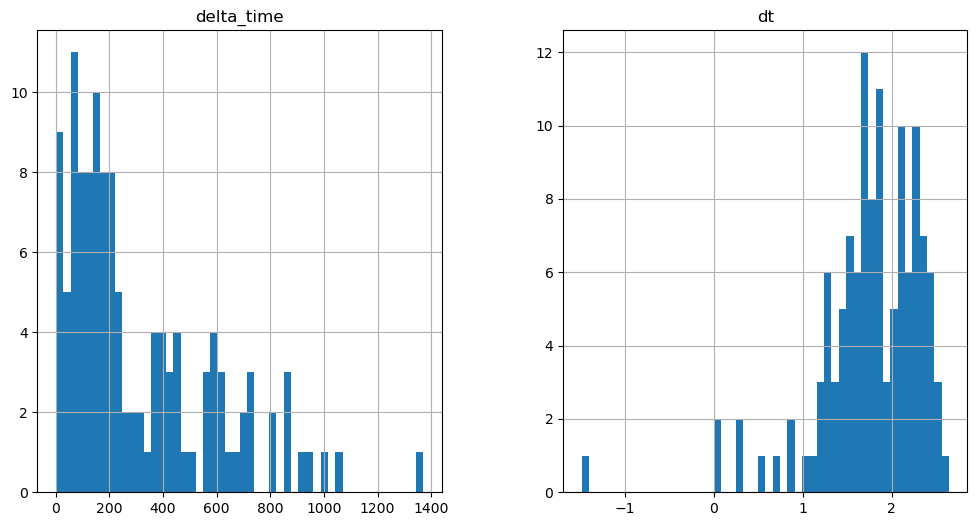

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1578.3824890851974 3.2410402297973633


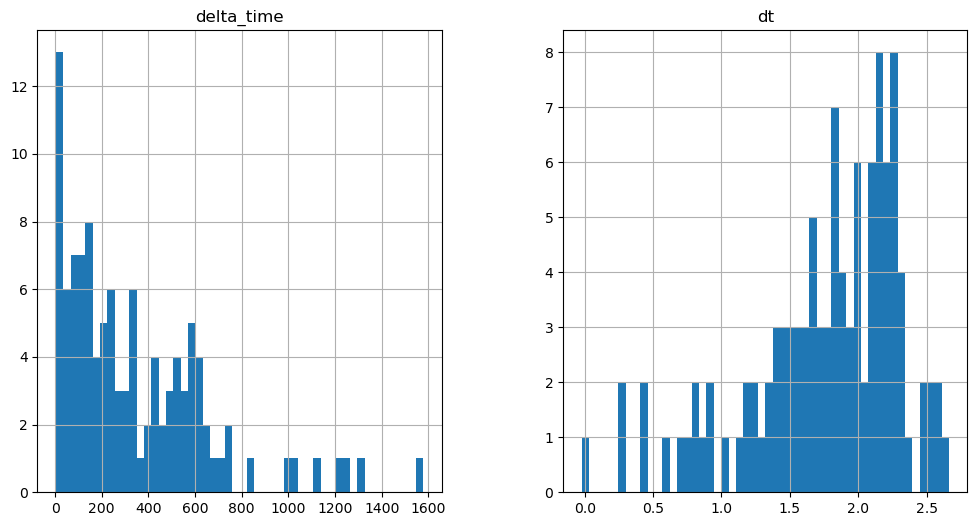

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1195.9361800551414 0.1


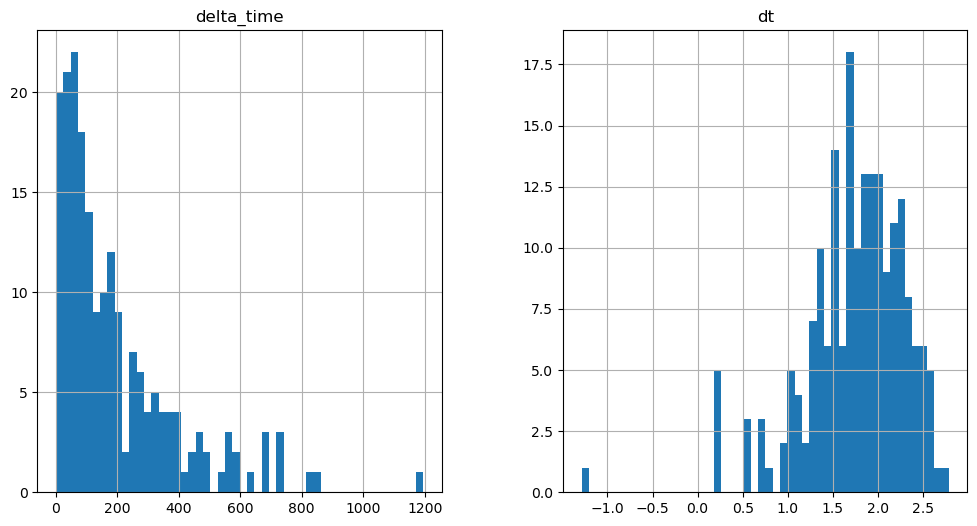

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3707.74756616354 9.723080456256866


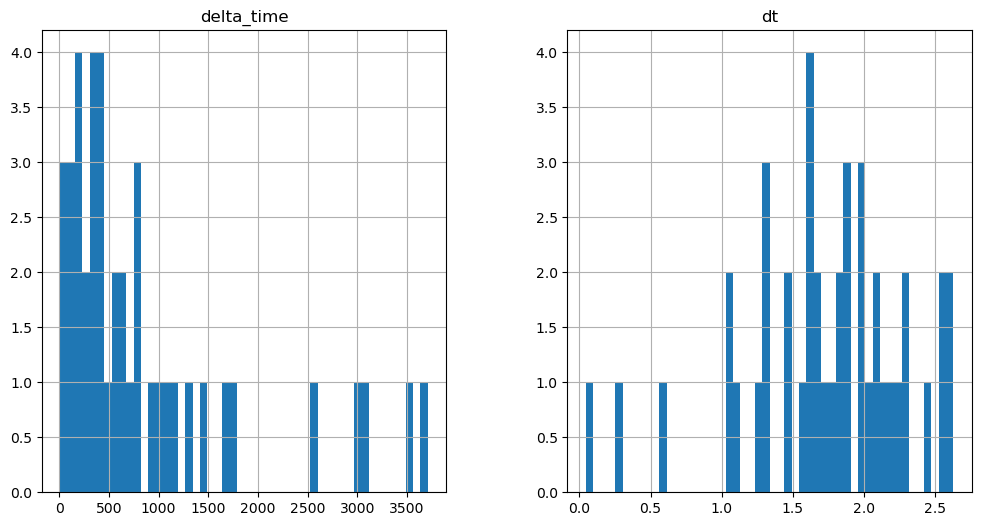

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2297.8806052207947 3.2410301566123962


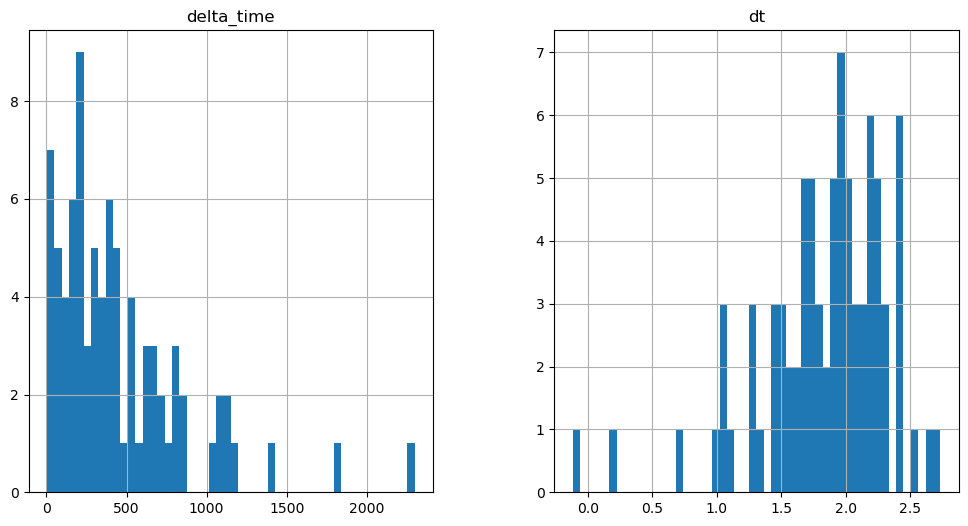

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1691.8121948838234 29.169341385364532


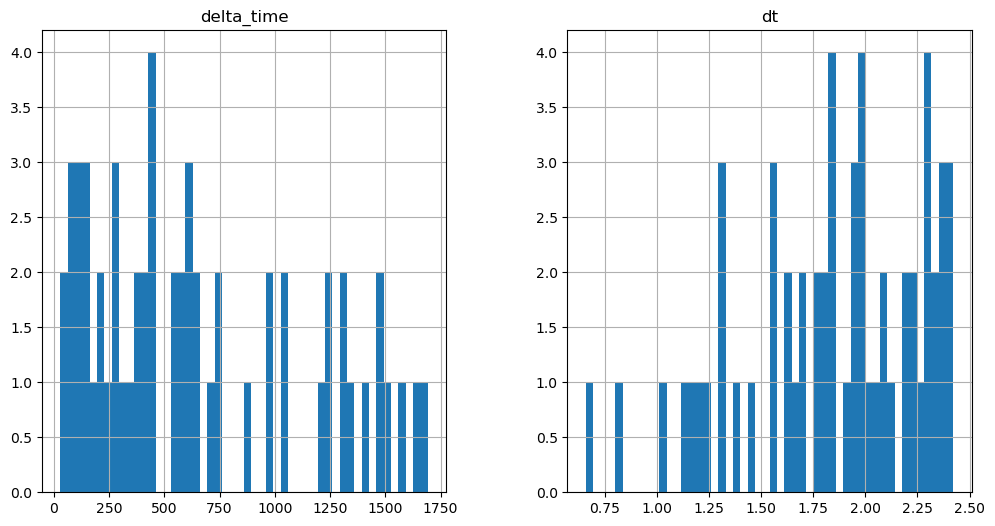

4543.908957958221 29.169231414794922


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

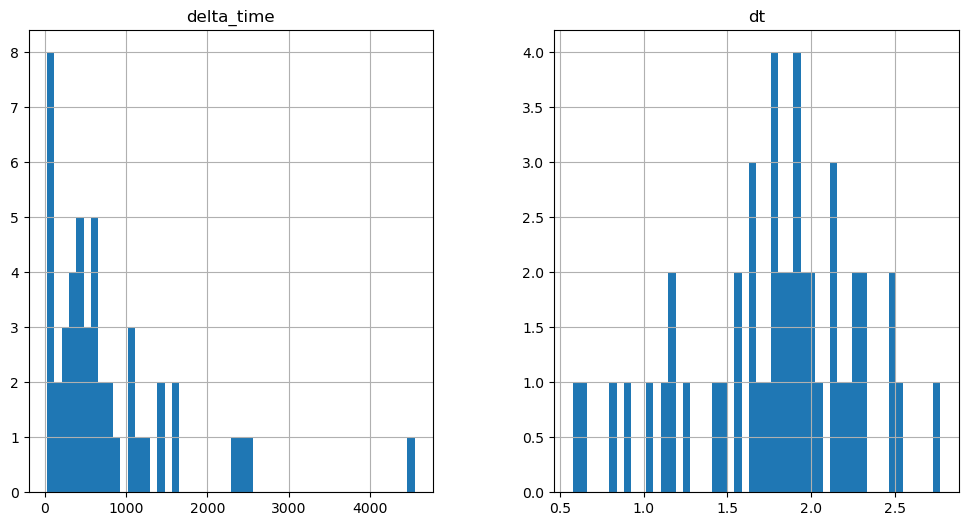

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1649.6882629394531 3.2410300374031067


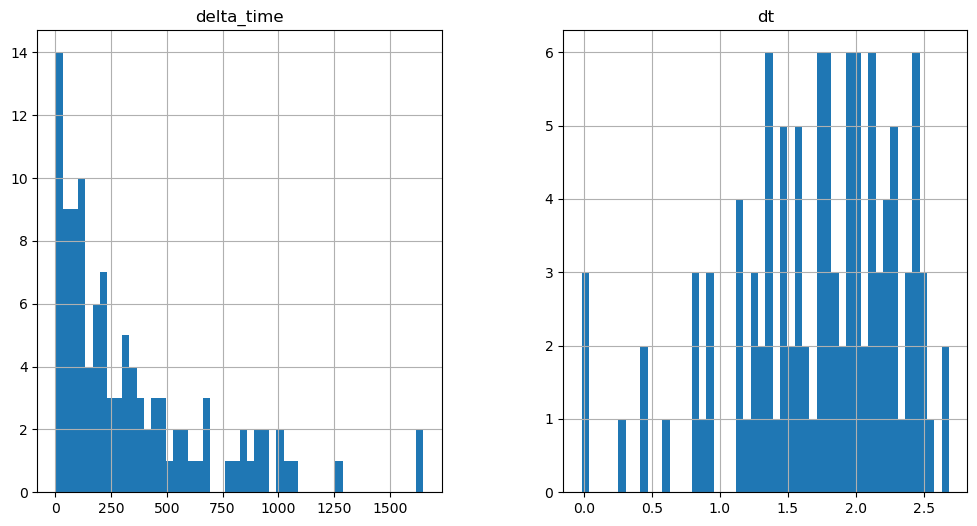

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1711.2648859024048 3.241030216217041


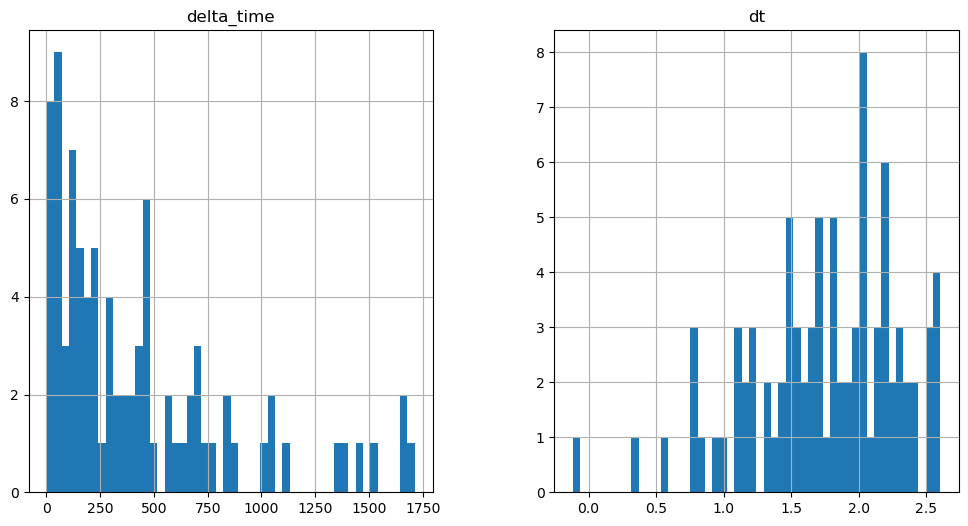

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1251.0406927466393 3.2410301566123962


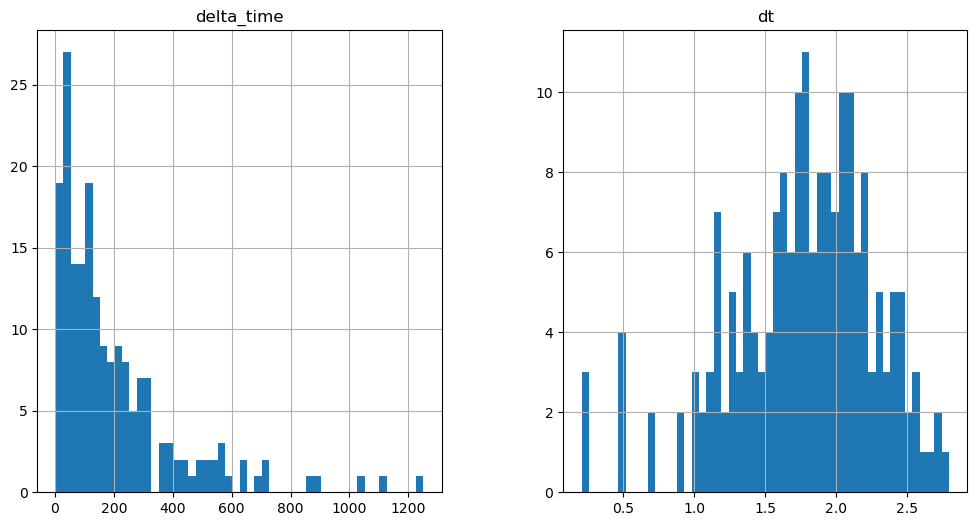

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1393.6311992406845 6.482010304927826


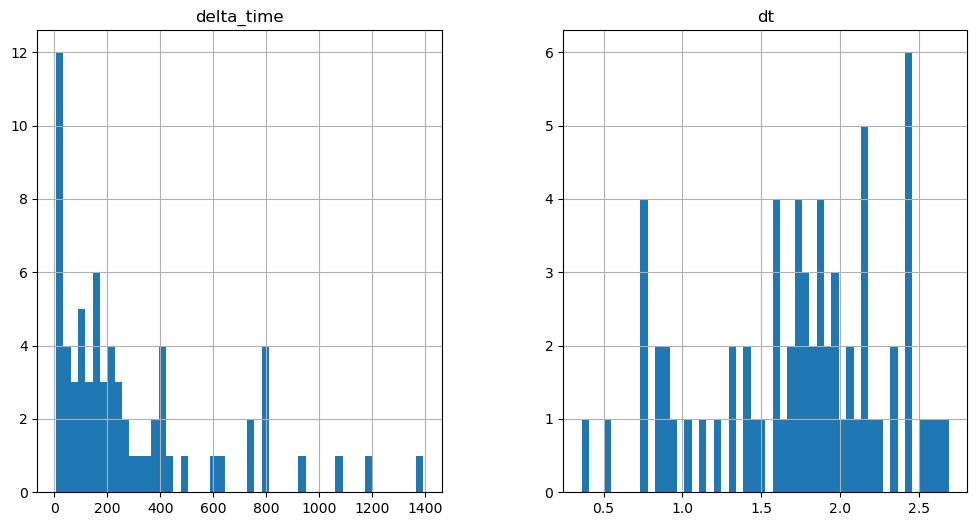

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1163.5200276374817 6.481990396976471


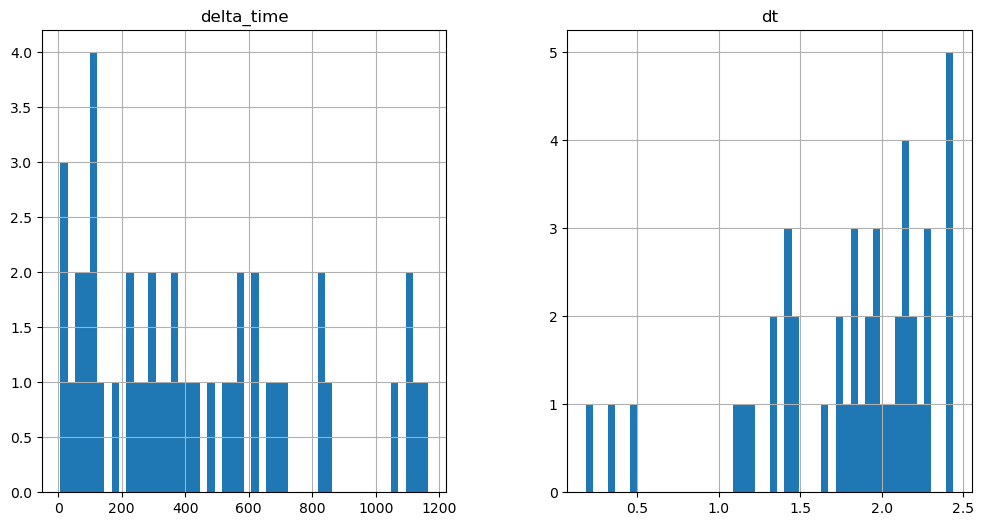

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2019.1447102427483 6.482010245323181


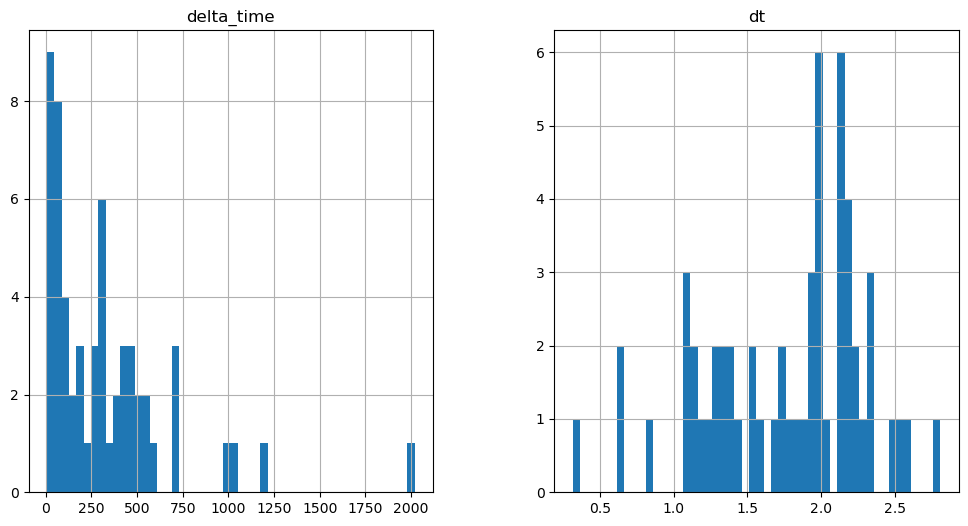

998.2288295030594 9.723030388355255


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

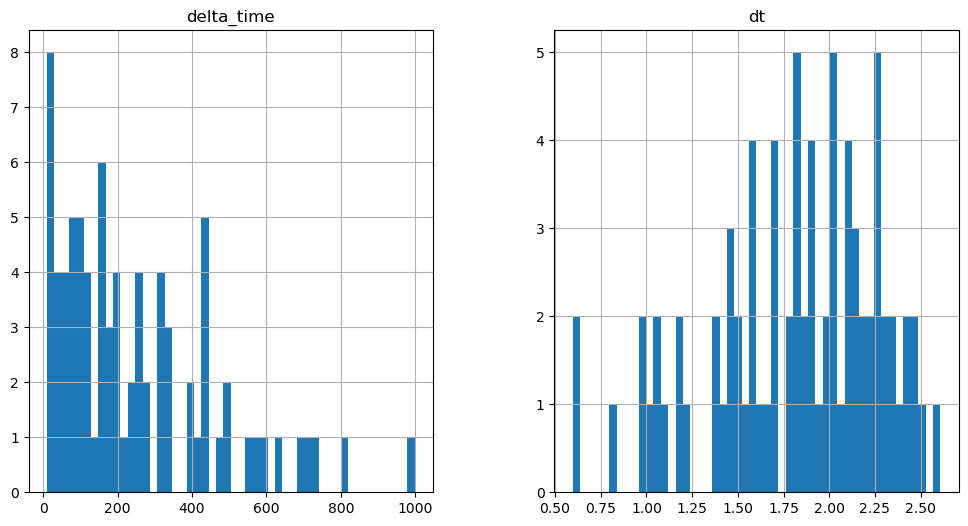

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2369.1729075312614 25.92803120613098


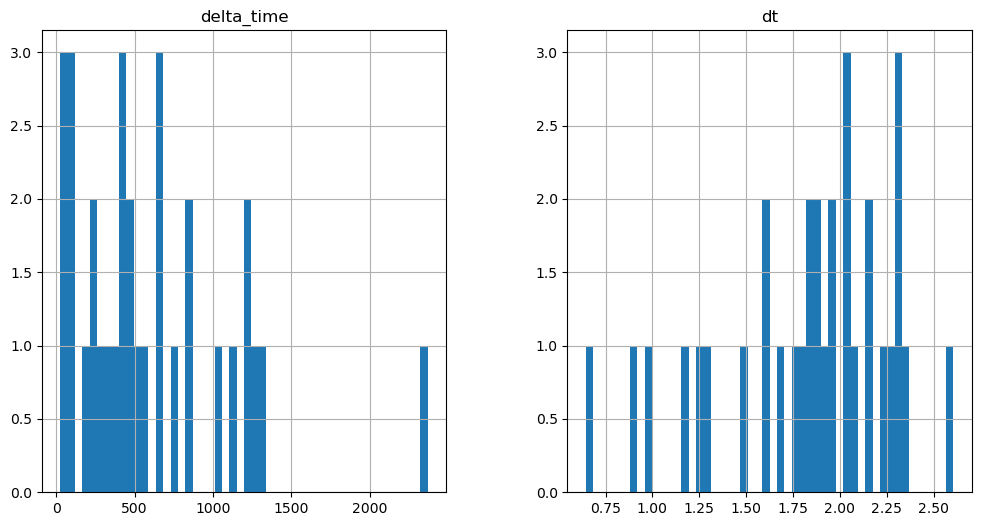

77.7840638756752 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

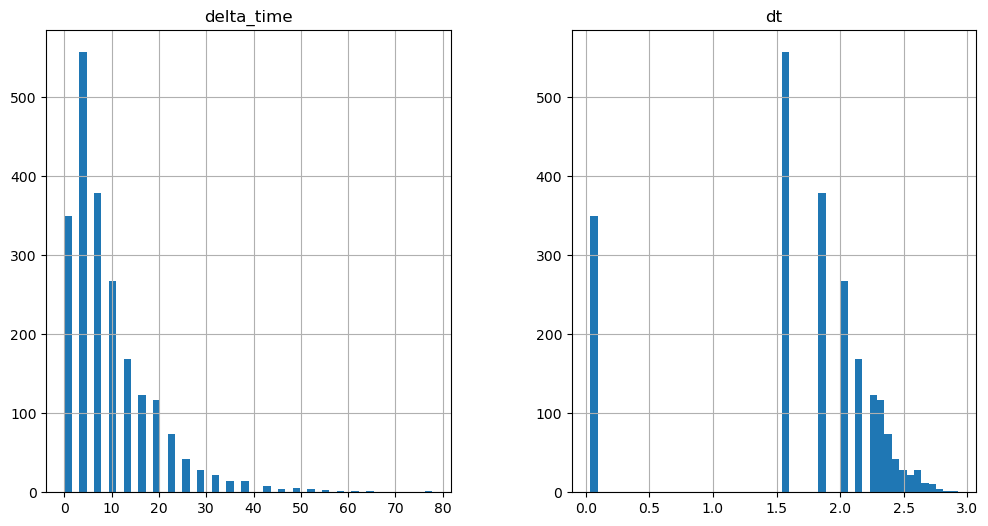

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2369.1729174256325 12.964000642299652


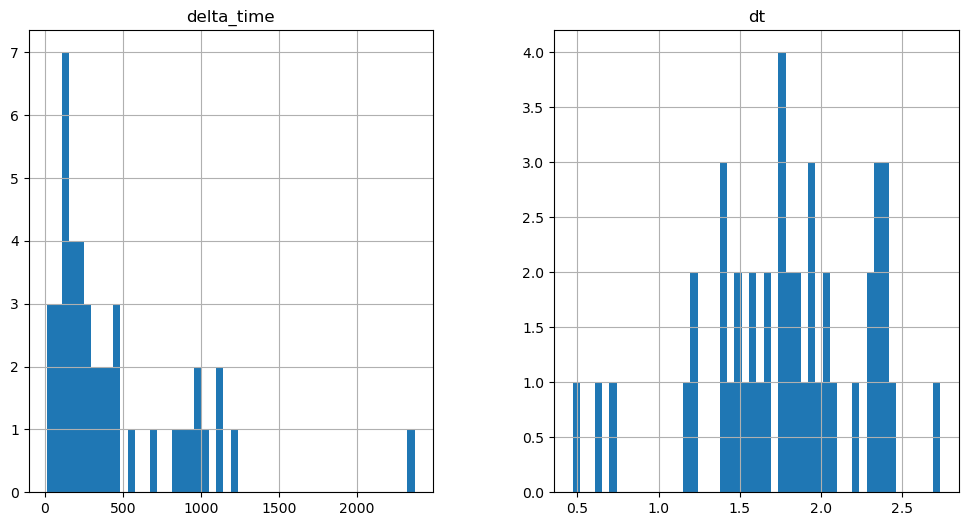

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

574.6687185764313 1.3231000900268555


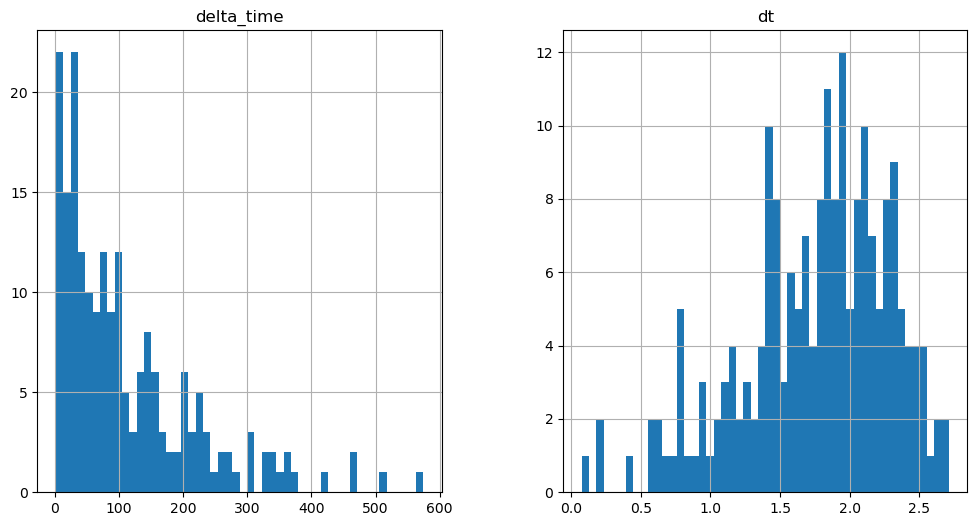

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

350.181427359581 0.8820800185203552


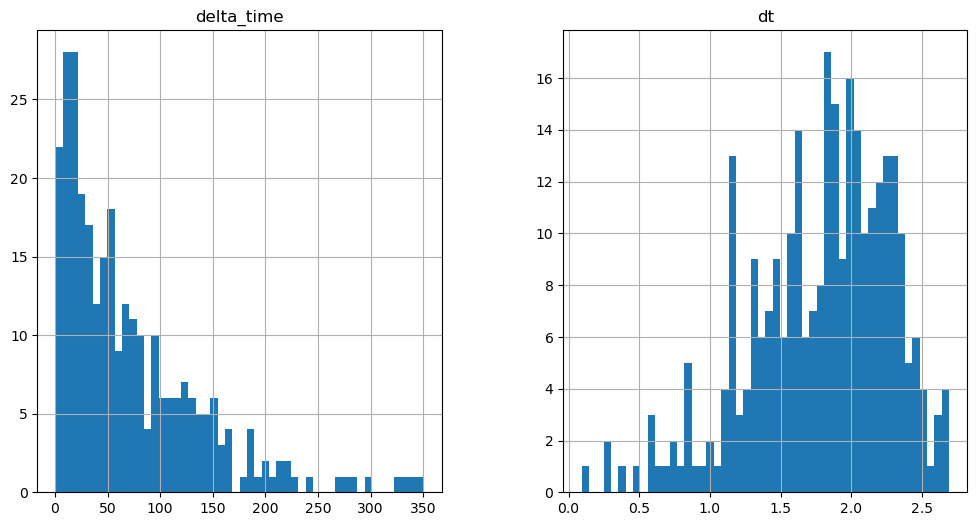

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

163.62377816438675 0.1


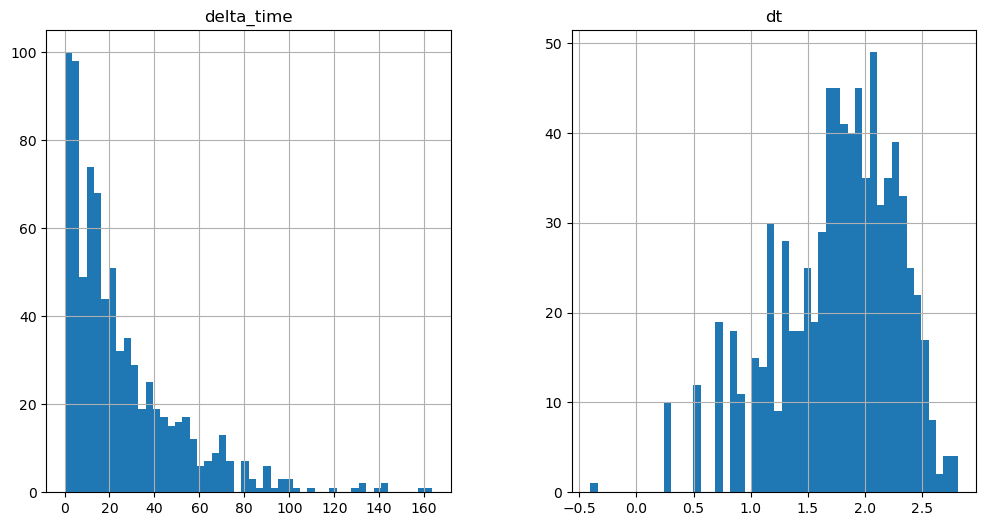

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

249.6254923939705 0.441020131111145


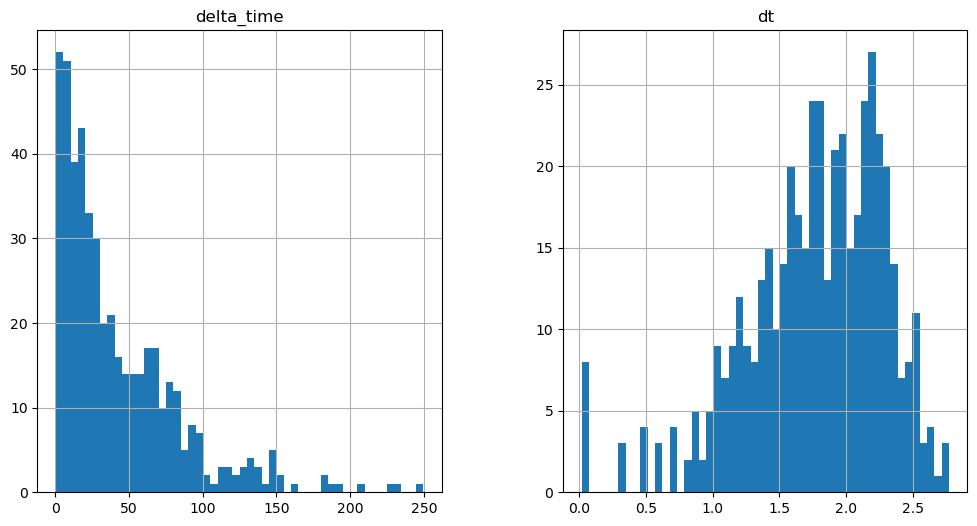

1357.5021476745605 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

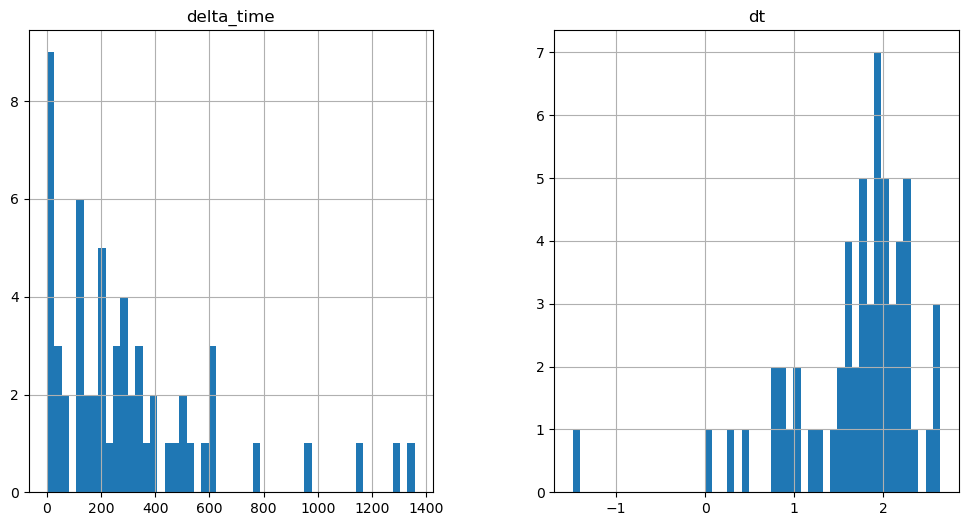

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1111.9144448637962 0.1


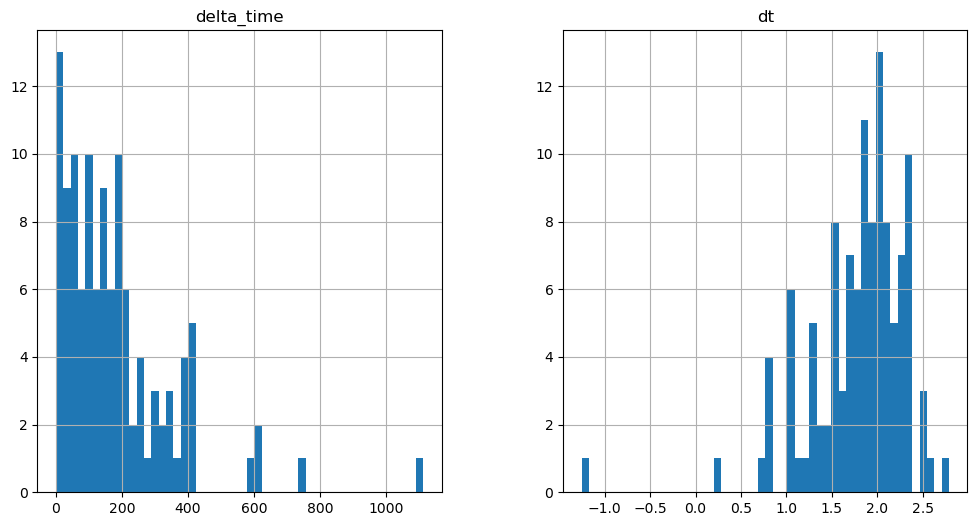

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1608.1938394904137 0.1


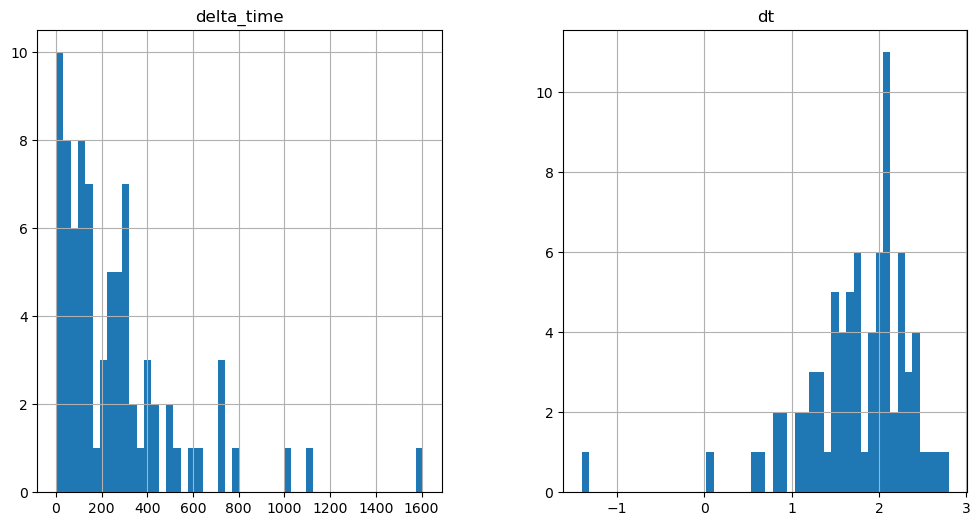

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1385.1857783198357 3.140990197658539


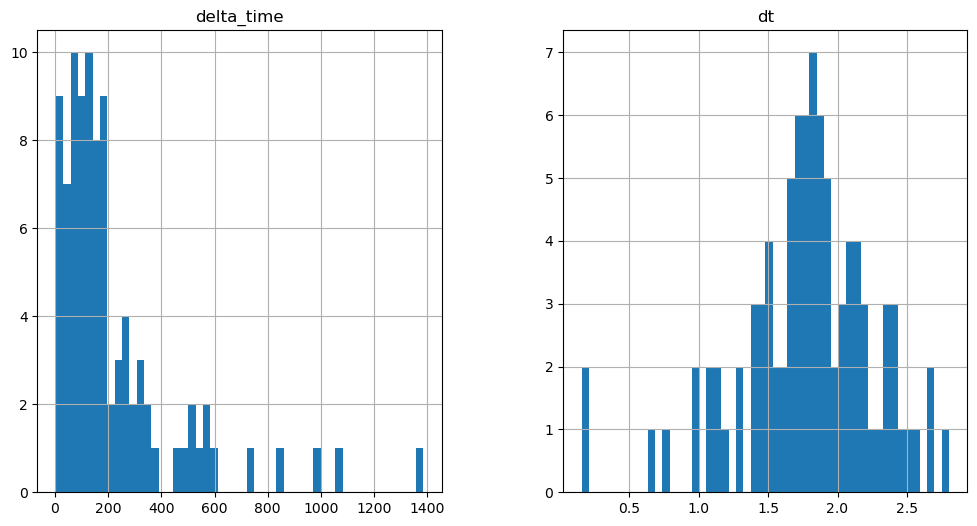

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2446.8574110269547 6.282040178775787


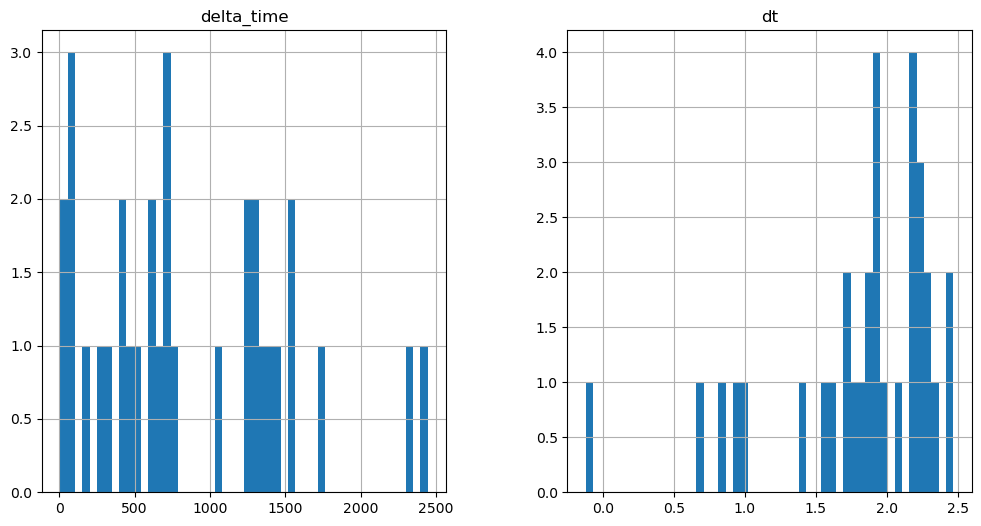

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1300.3795843720436 0.1


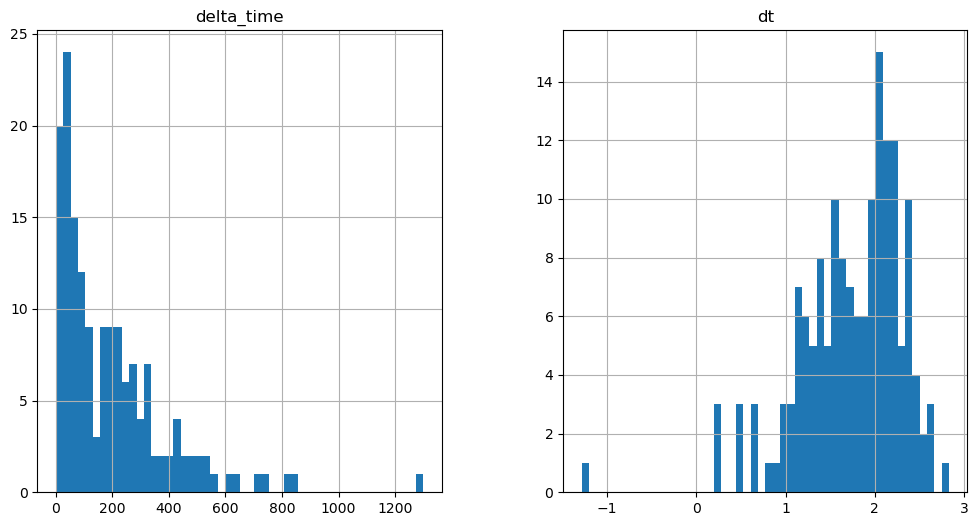

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1137.0447862744331 0.1


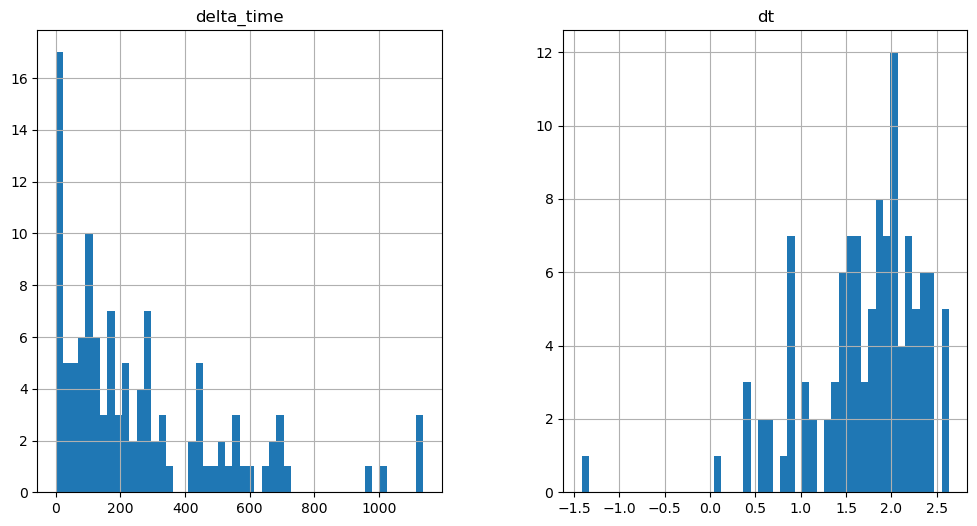

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2286.6643131375313 6.282040357589722


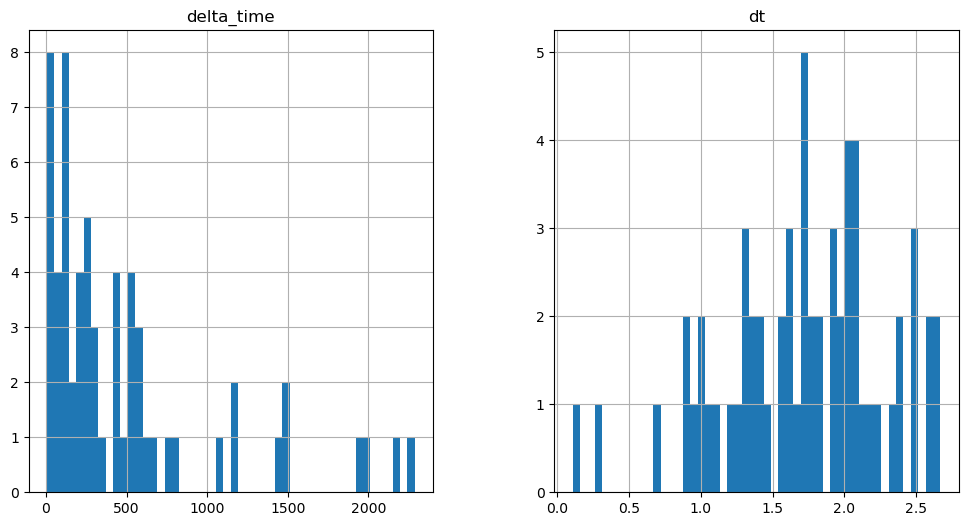

84.8076342344284 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

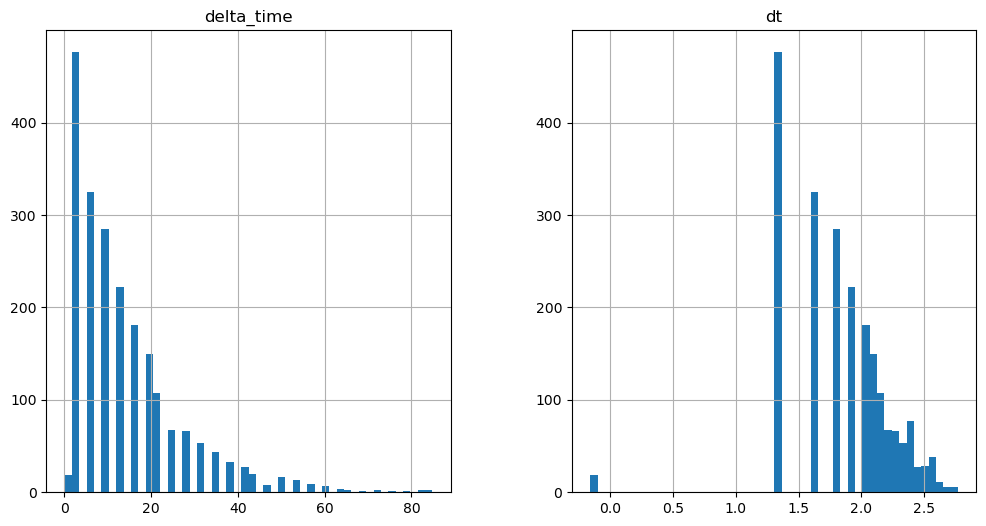

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3087.6242025494576 25.128161191940308


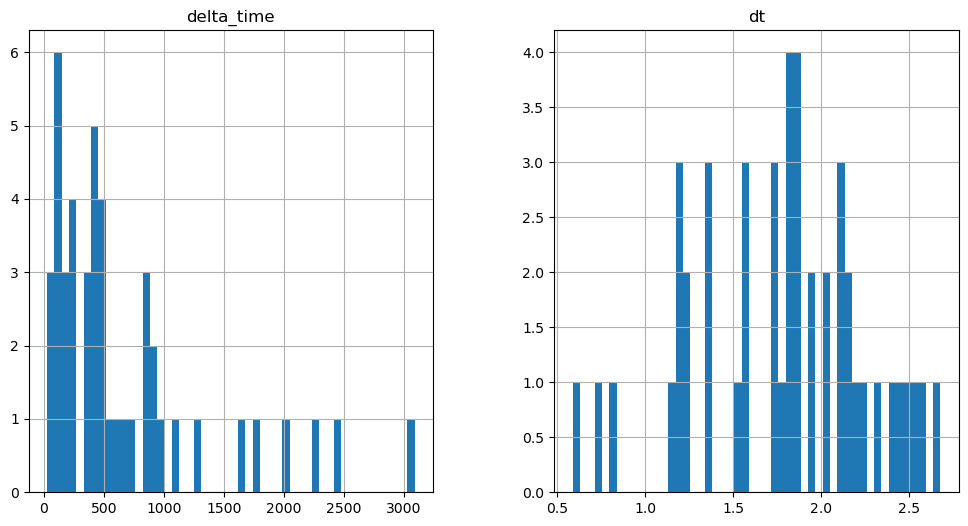

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1218.716900229454 3.1410101652145386


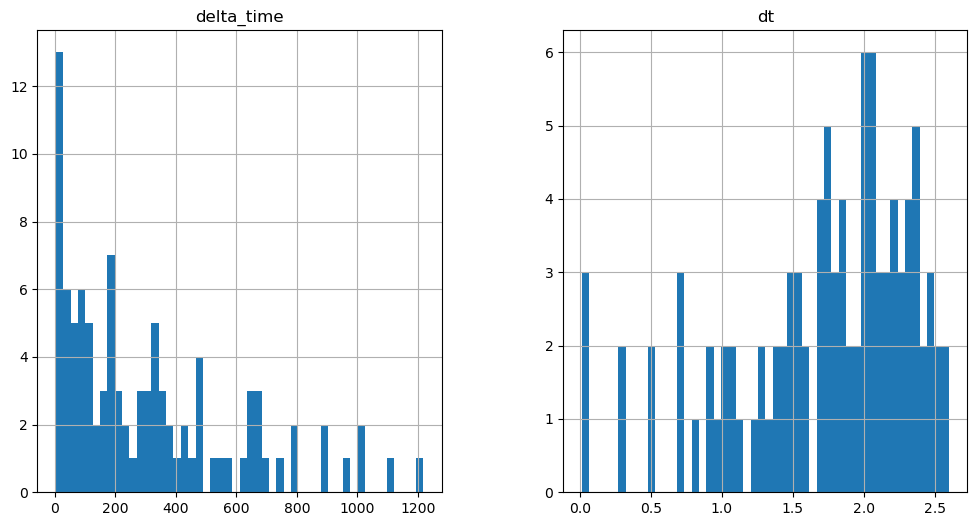

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4573.326456010342 12.564090549945831


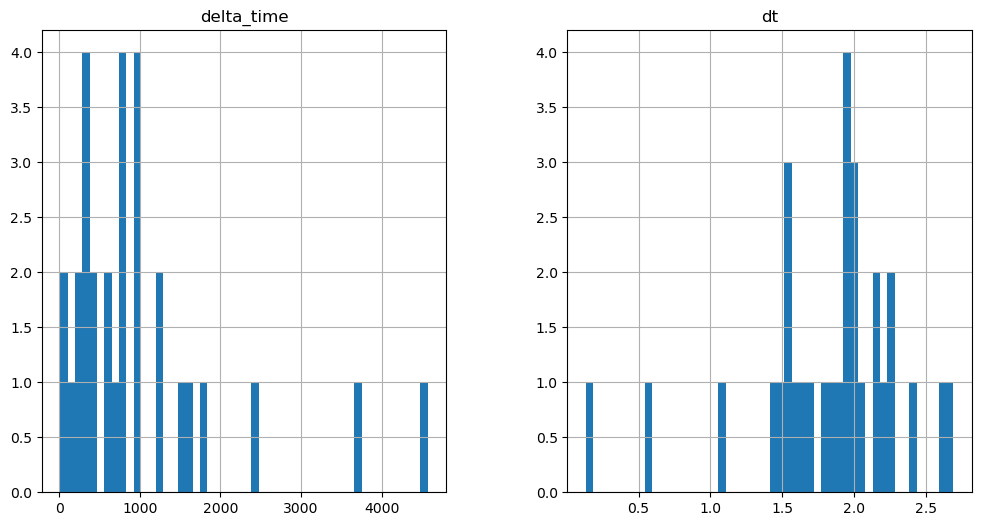

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2029.0960304141045 21.987160980701447


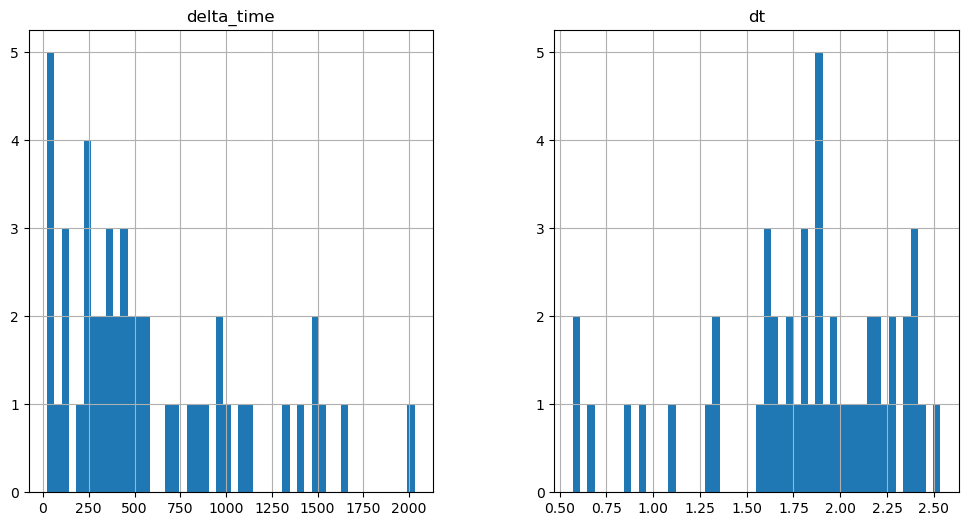

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2135.890535533428 25.128121316432953


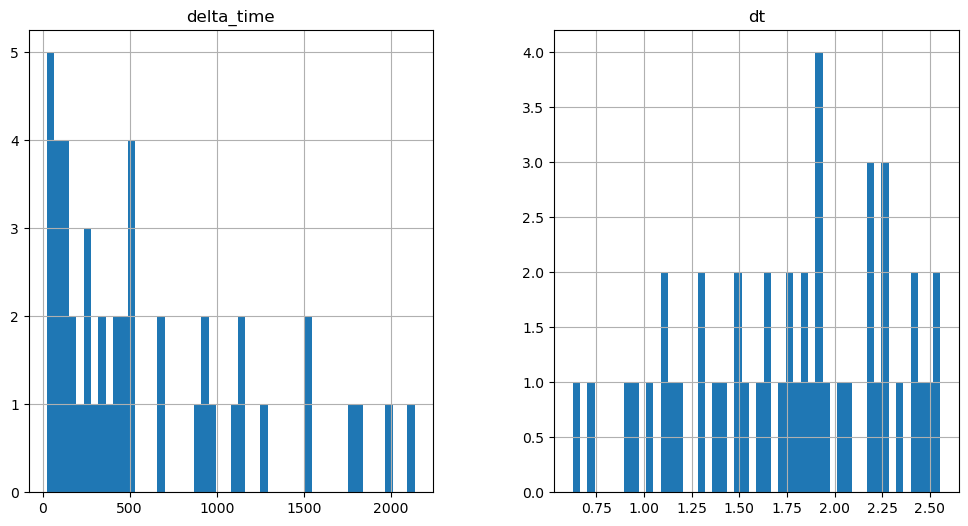

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

807.2418998479843 0.1


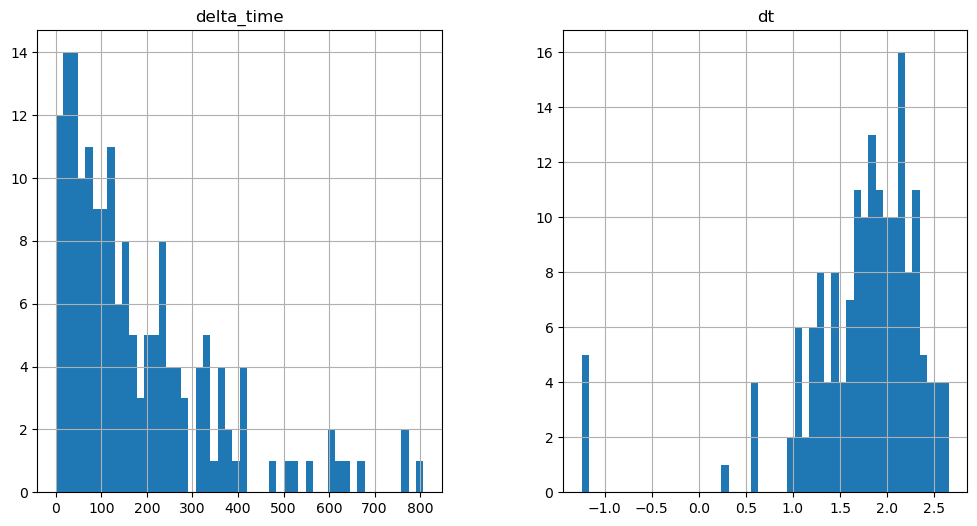

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1557.9458770751953 3.141020178794861


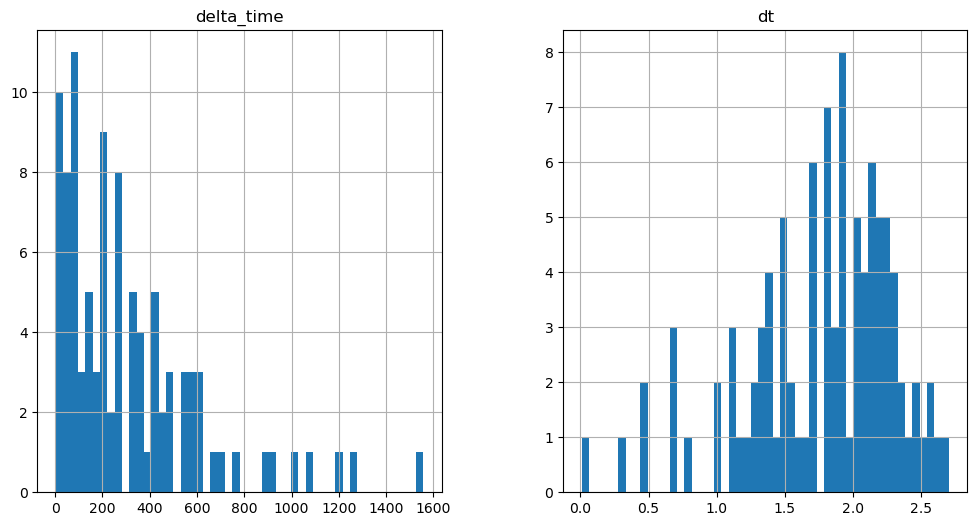

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

414.6130204796791 0.1


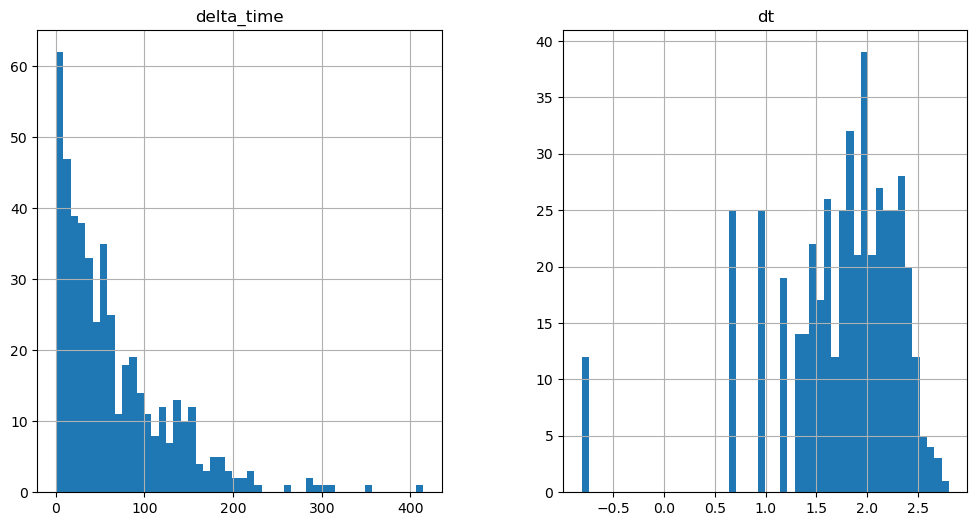

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1237.562261223793 3.1410101652145386


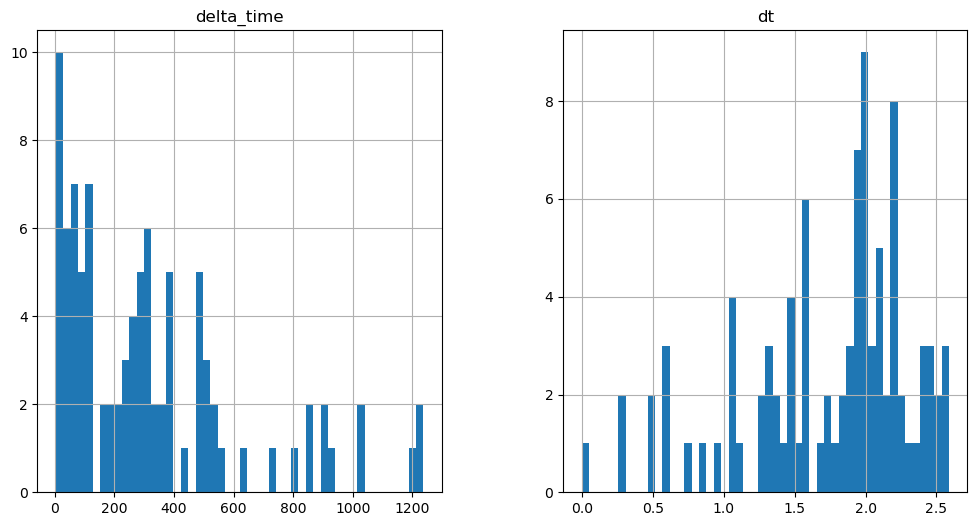

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1454.2952221035957 0.1


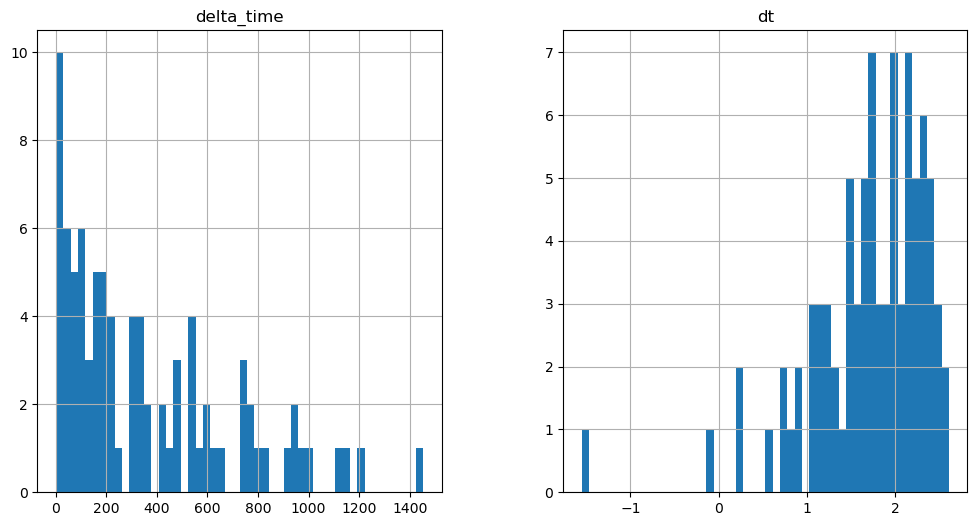

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2902.3027339577675 9.423060536384583


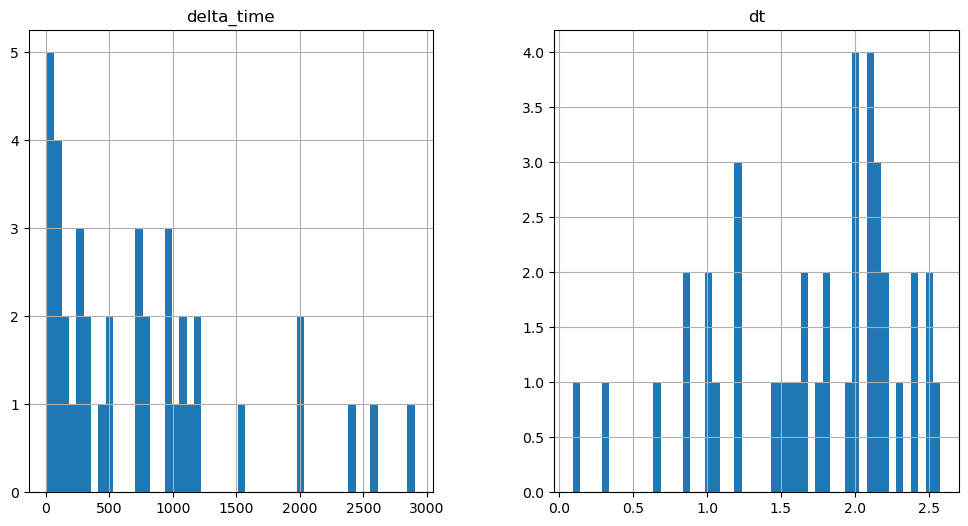

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

631.3454312682152 0.1


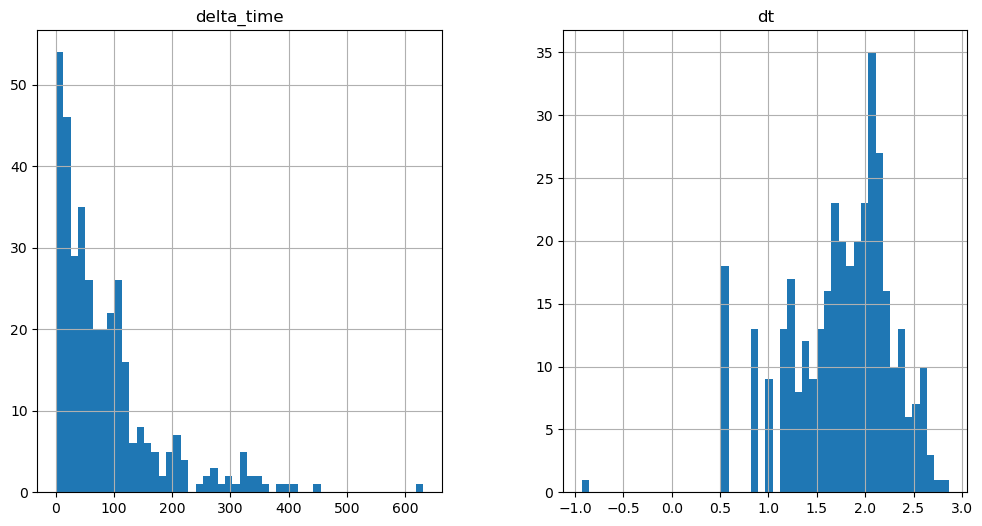

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

650.1918421983719 0.1


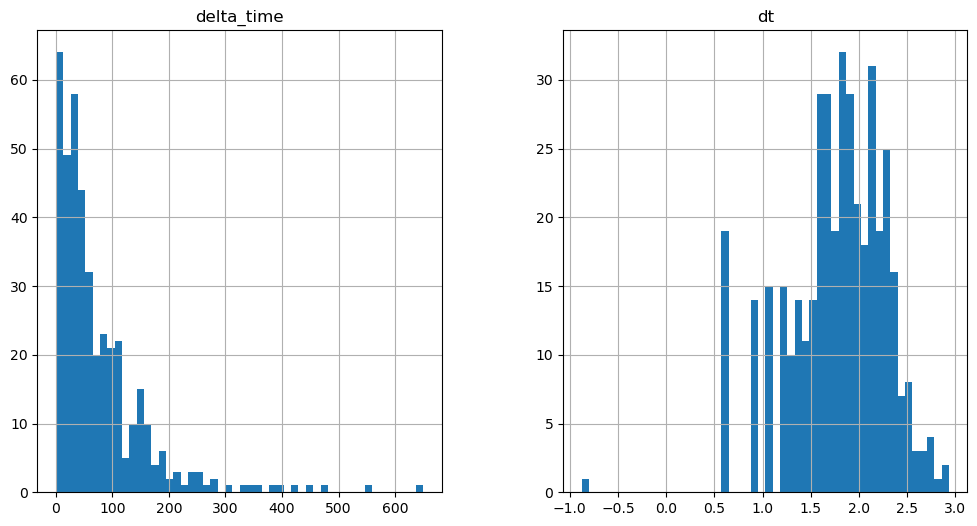

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2003.9713393449783 3.141030013561249


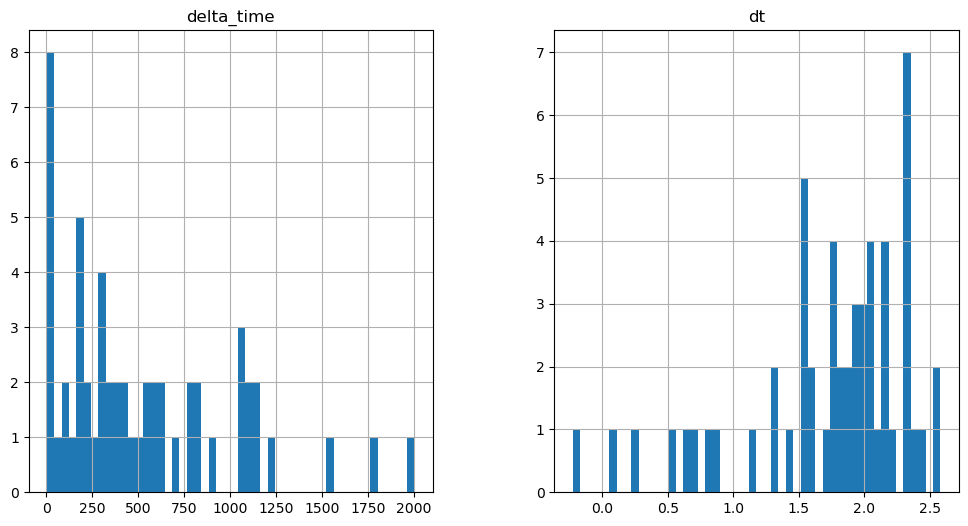

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2098.2035440206528 0.1


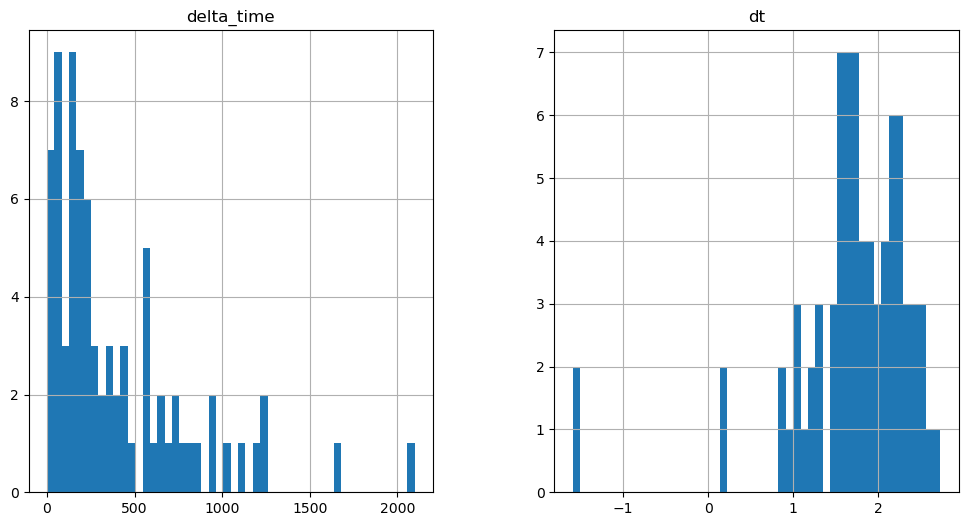

1664.7433225512505 21.987151086330414


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

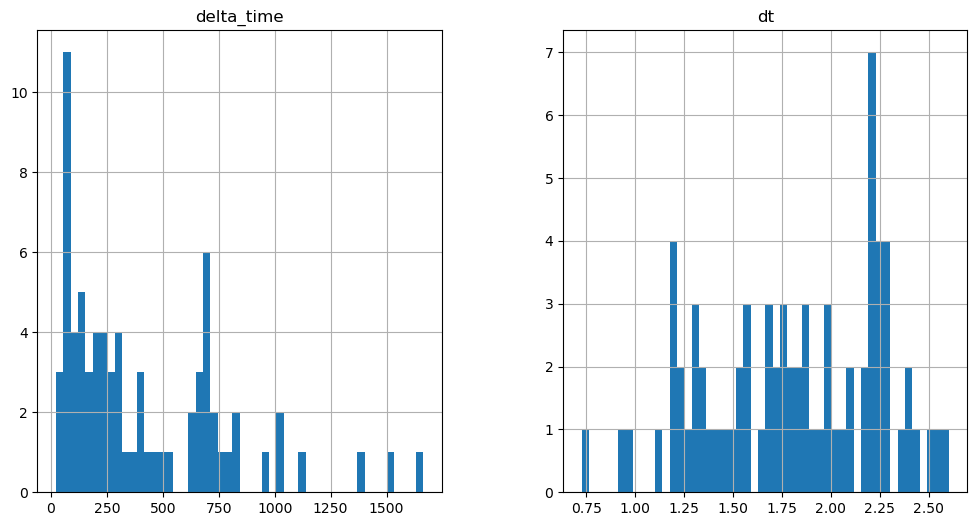

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4061.3421213030815 21.987150967121124


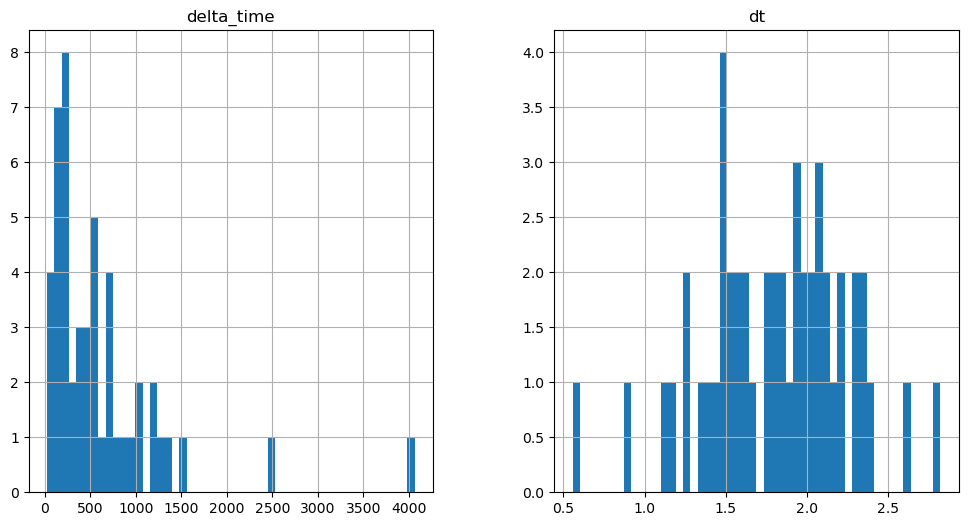

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1146.4742269515991 0.1


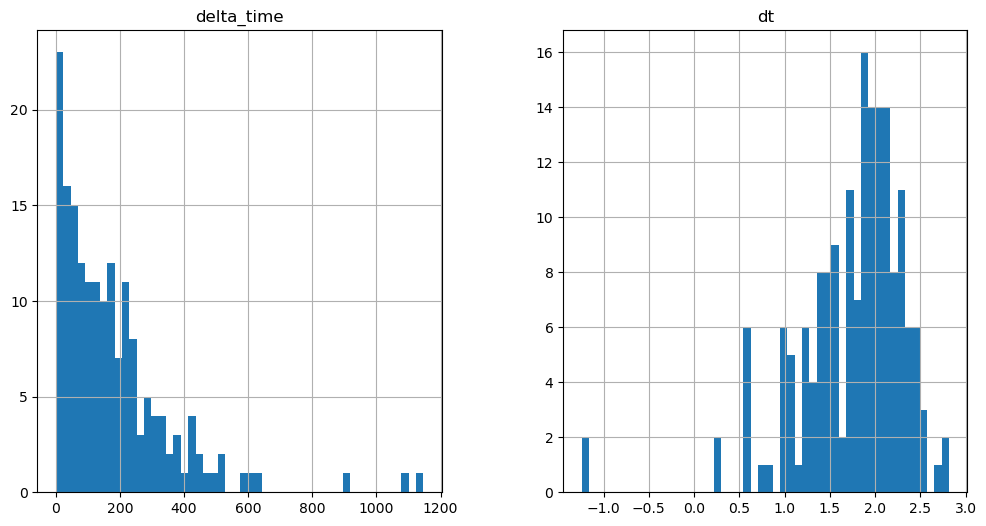

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

848.0762620568275 0.1


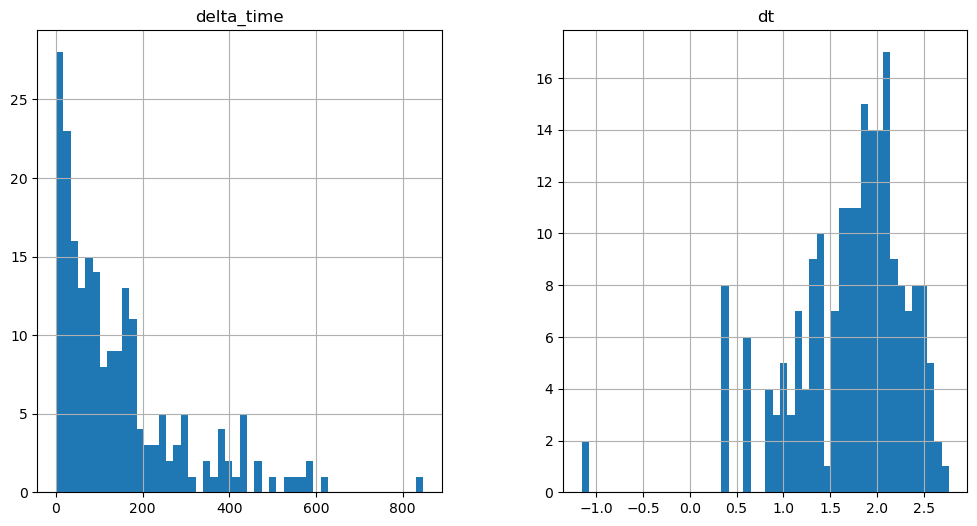

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1325.510695695877 0.1


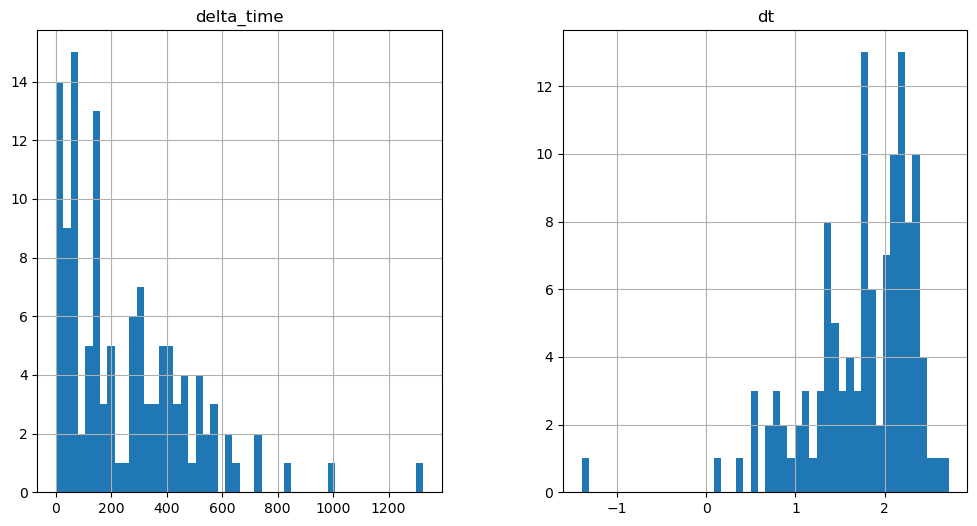

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2877.1793926358223 47.11538231372833


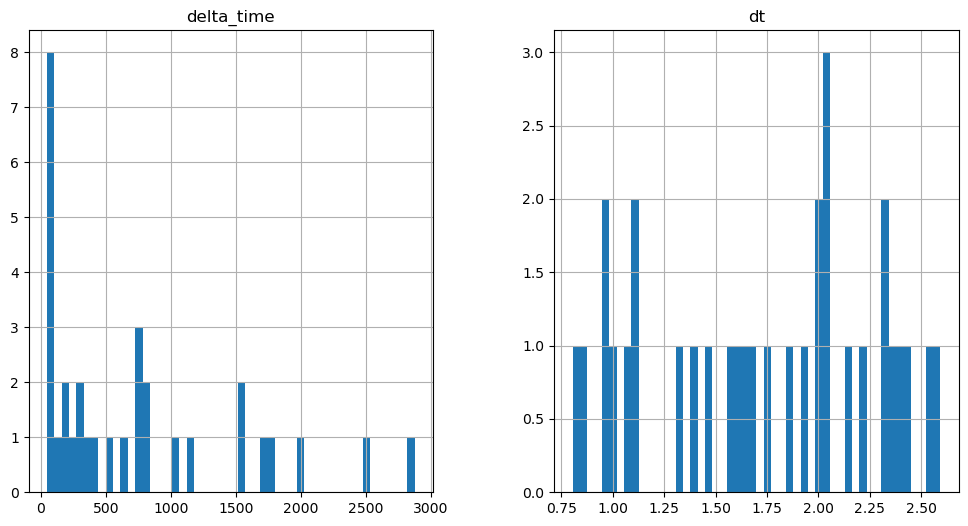

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

709.8704652190208 0.1


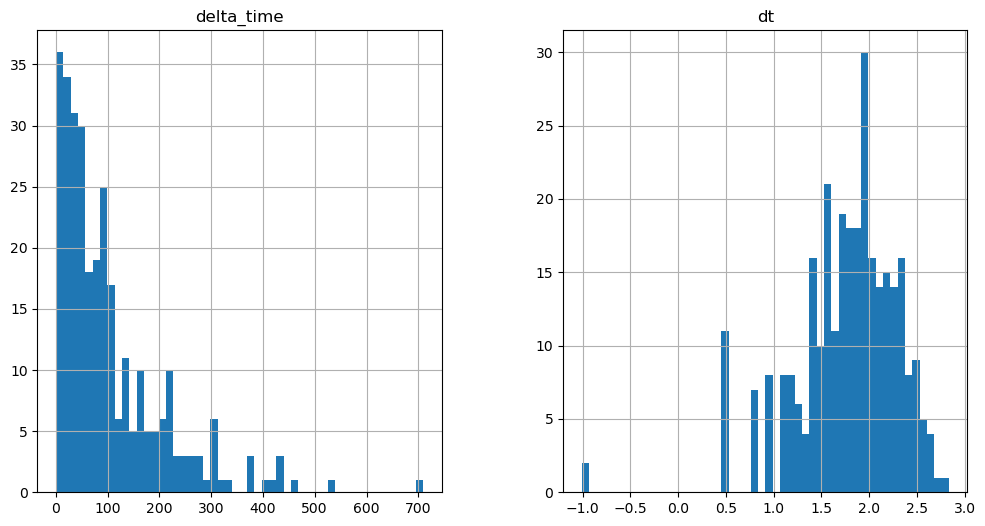

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

295.2561546564102 0.1


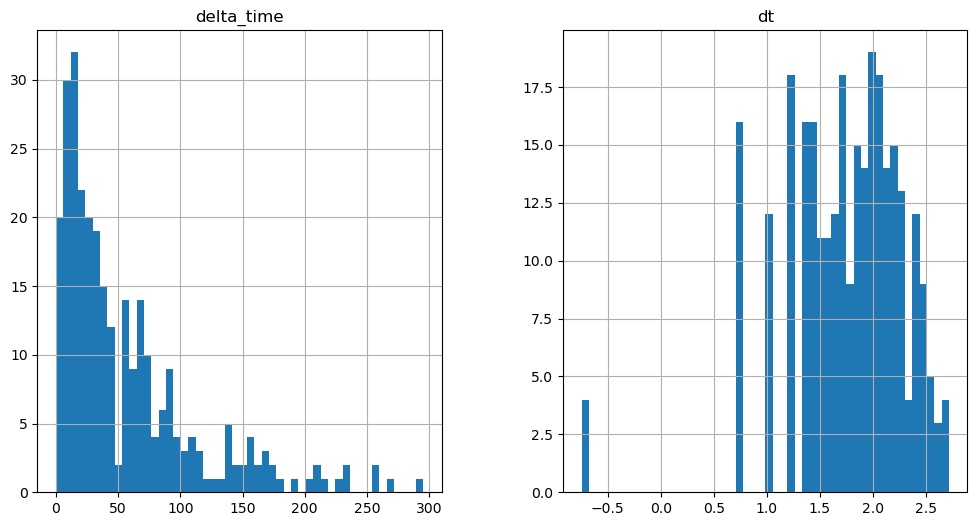

515.1281454563141 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

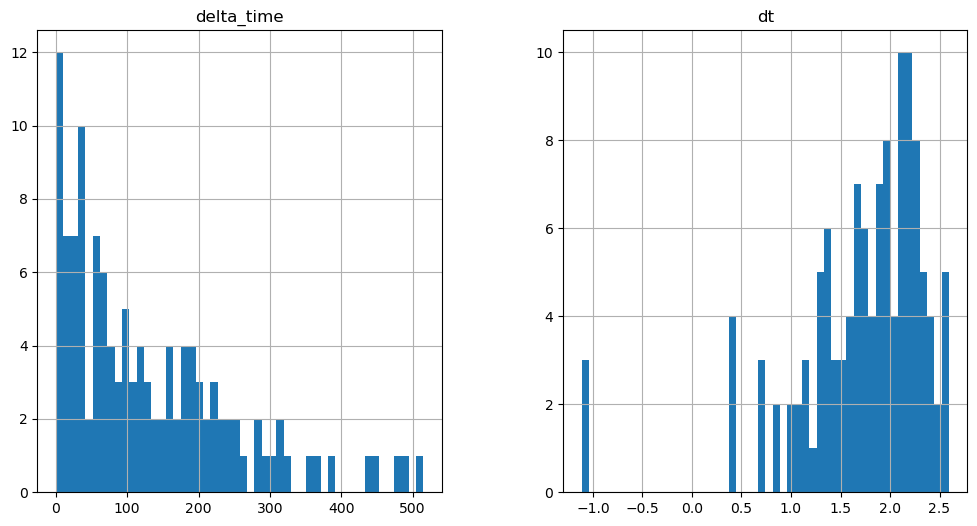

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

753.8460474610329 0.1


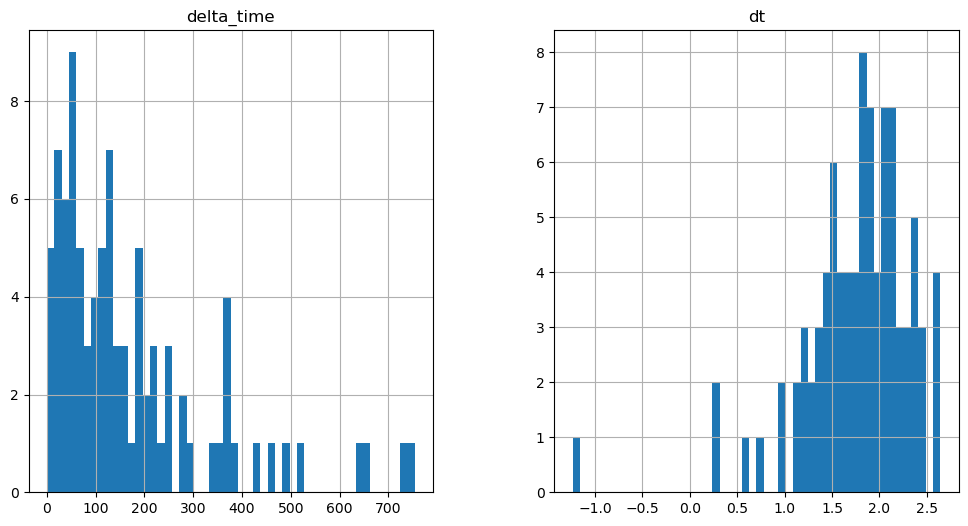

1422.884480535984 3.141020119190216


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

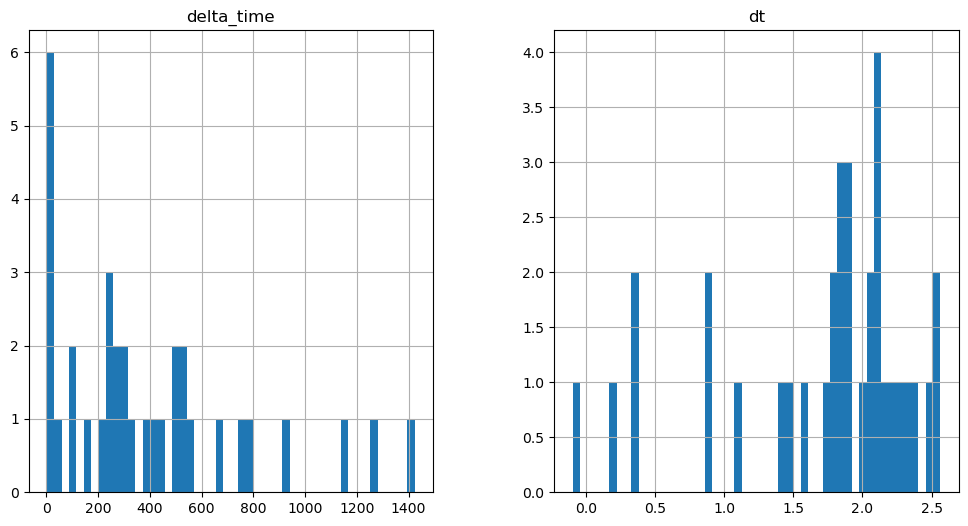

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

713.0126655101776 0.1


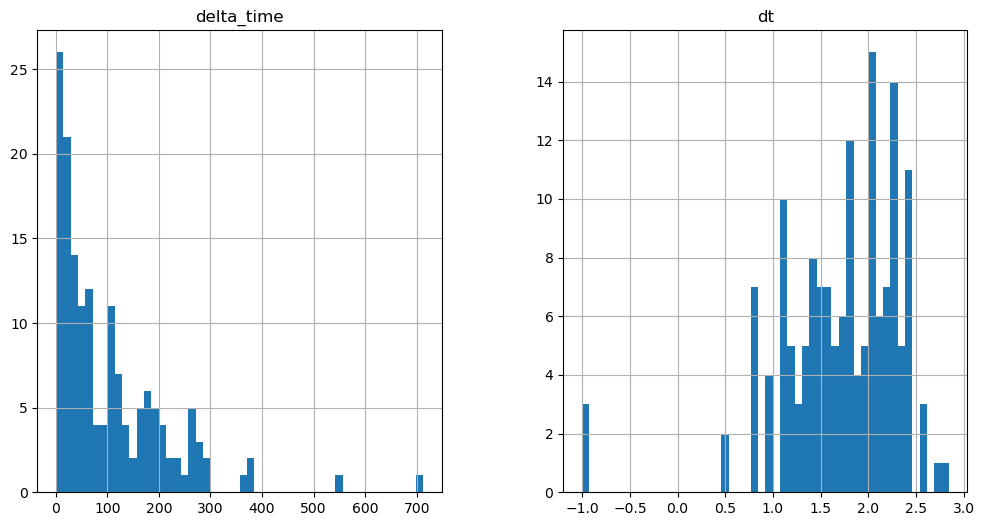

370.64083832502365 3.141020178794861


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

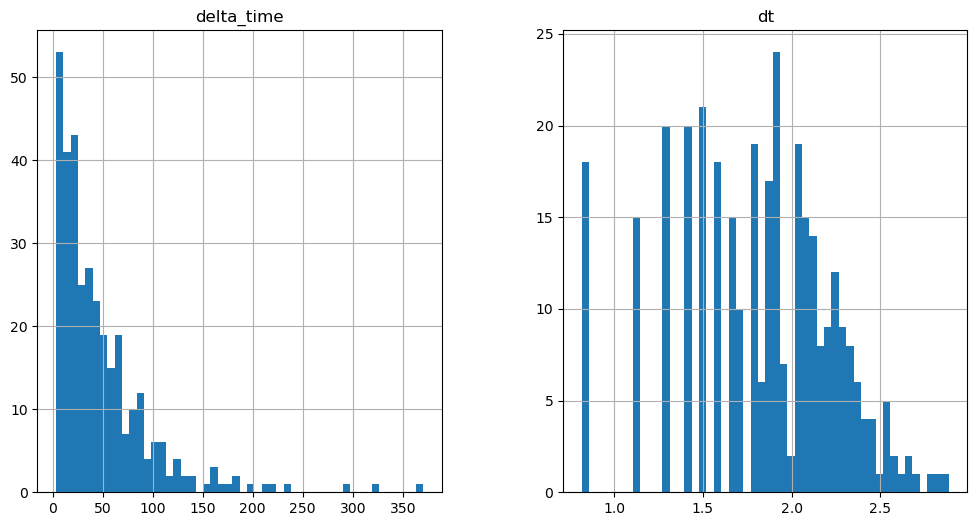

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

59.67945295572281 0.1


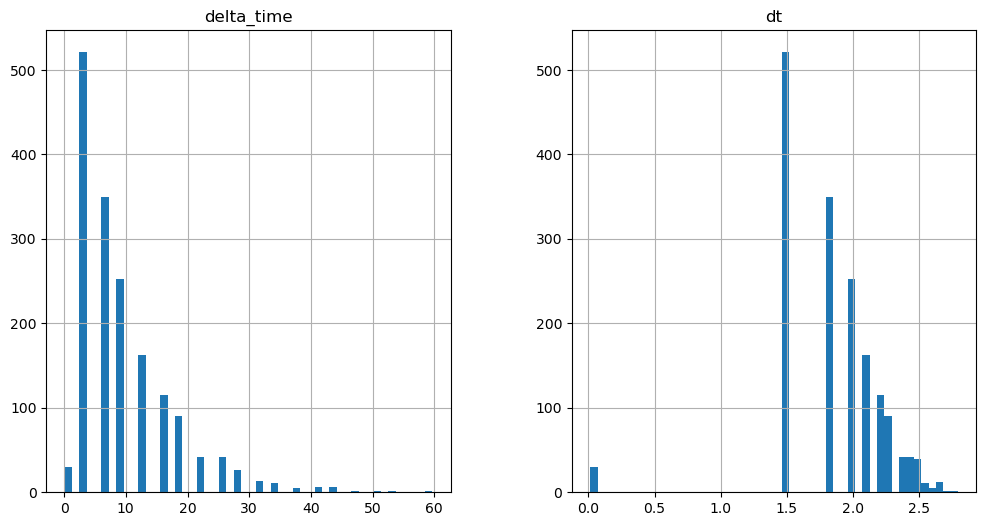

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2808.0721194148064 3.1410102248191833


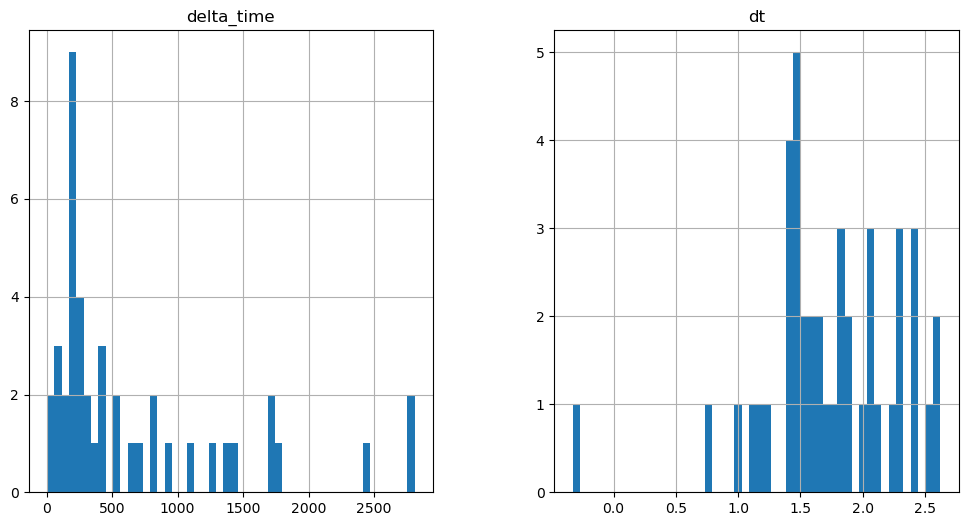

2779.8040580153465 6.282040238380432


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

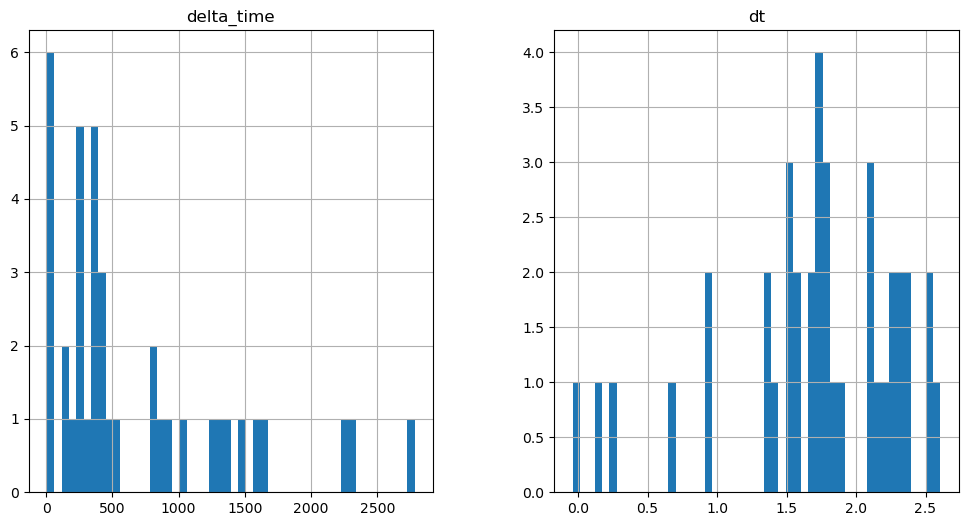

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3486.533073246479 15.705090761184692


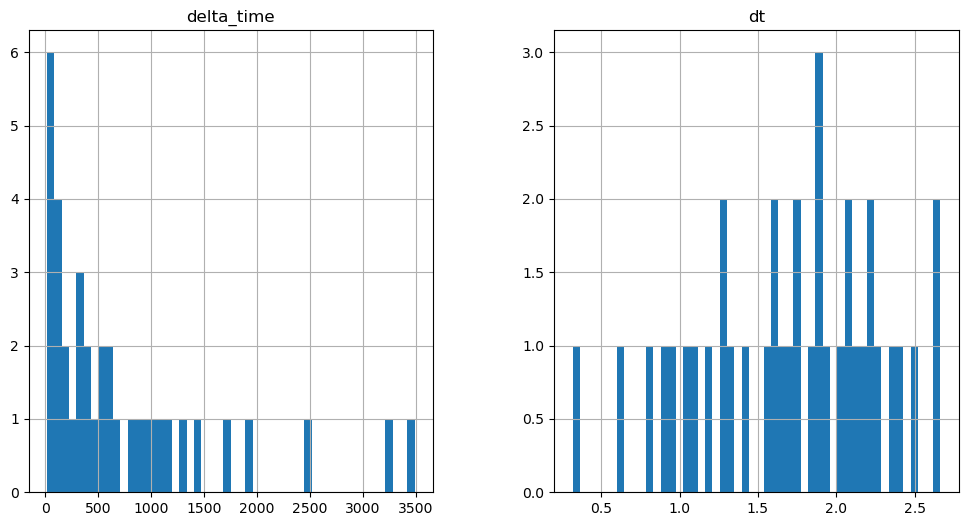

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2760.957927107811 25.12817120552063


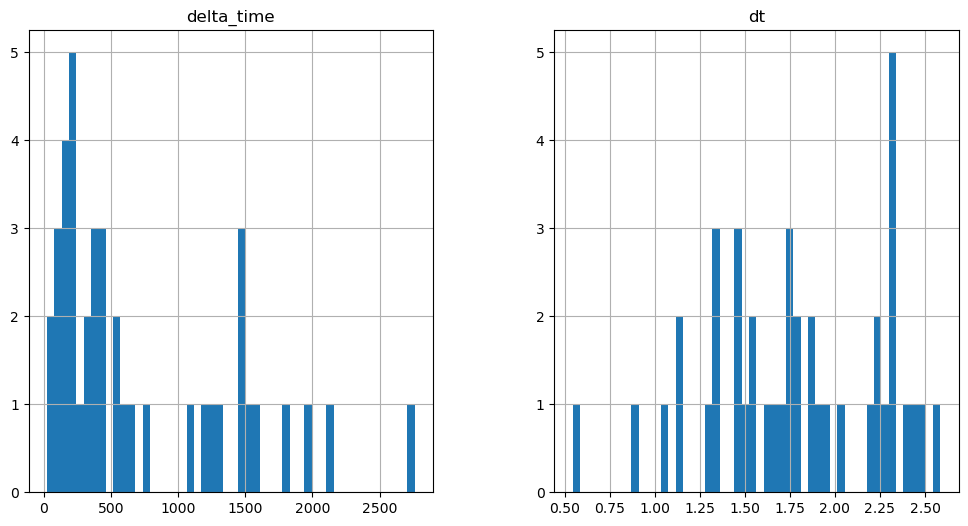

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2236.4040110707283 6.282040297985077


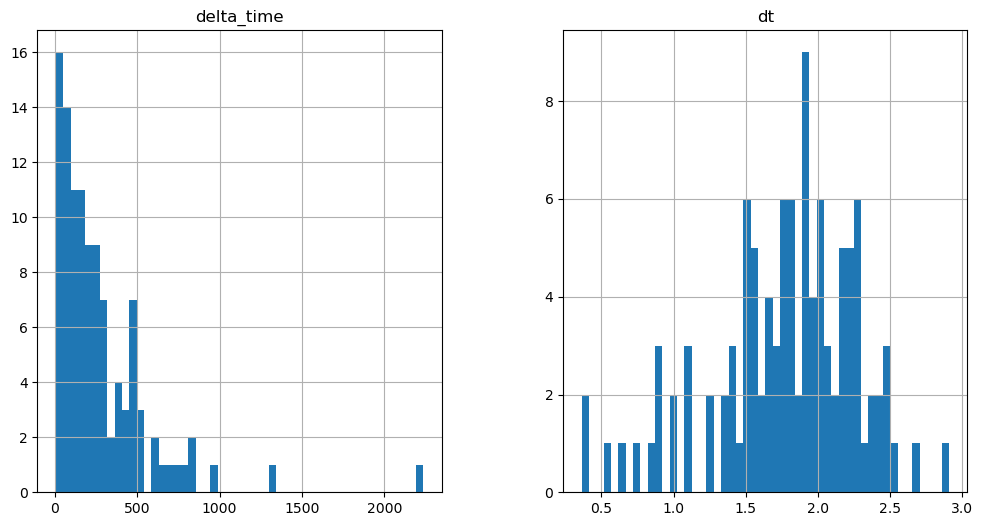

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1312.9470452070236 3.1410301327705383


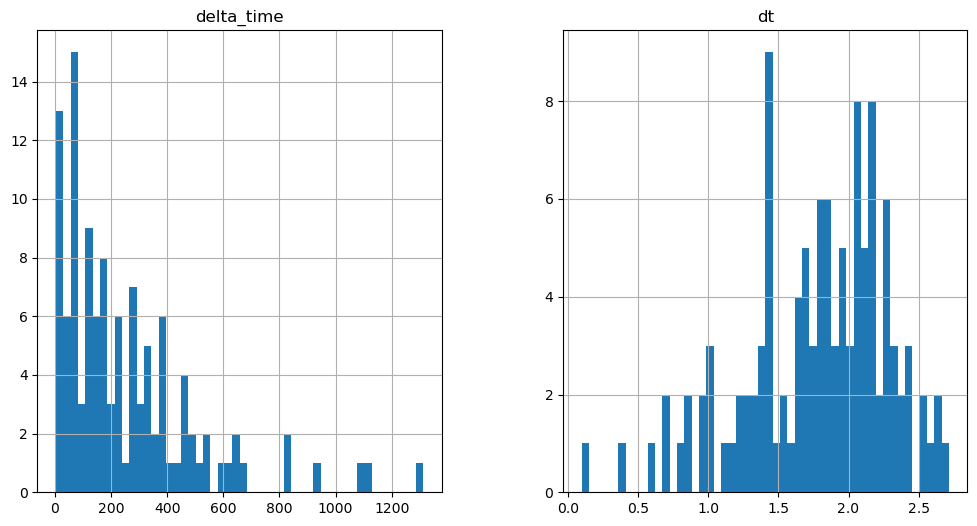

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

691.0241842865944 0.1


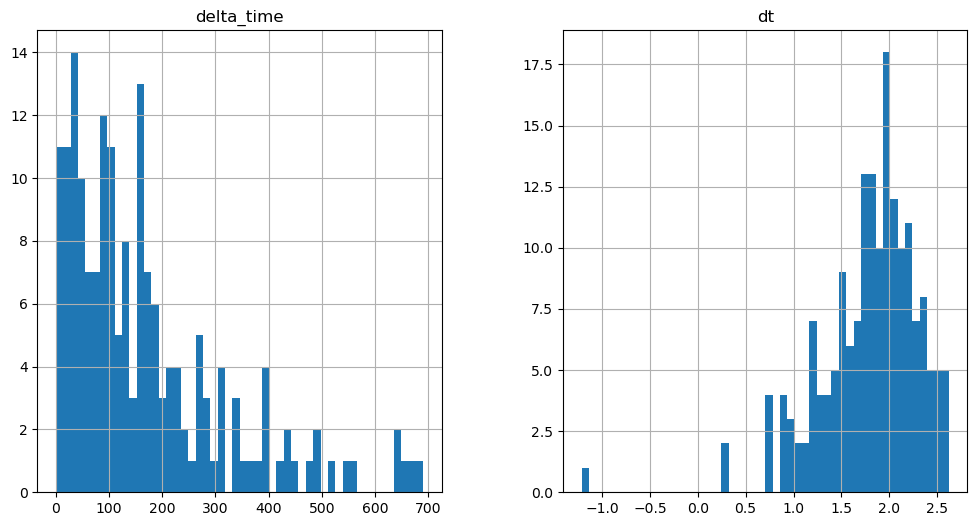

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

263.8454629778862 0.1


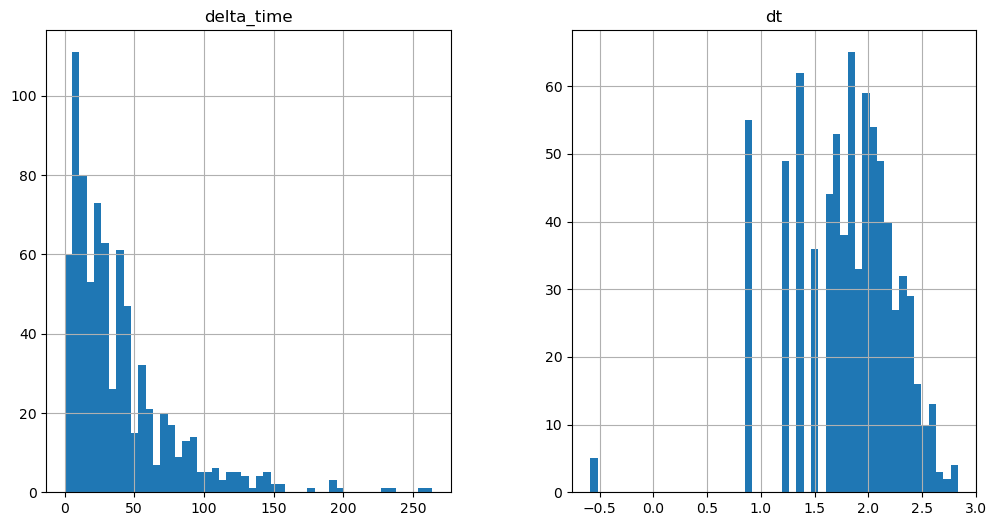

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2418.585320174694 0.1


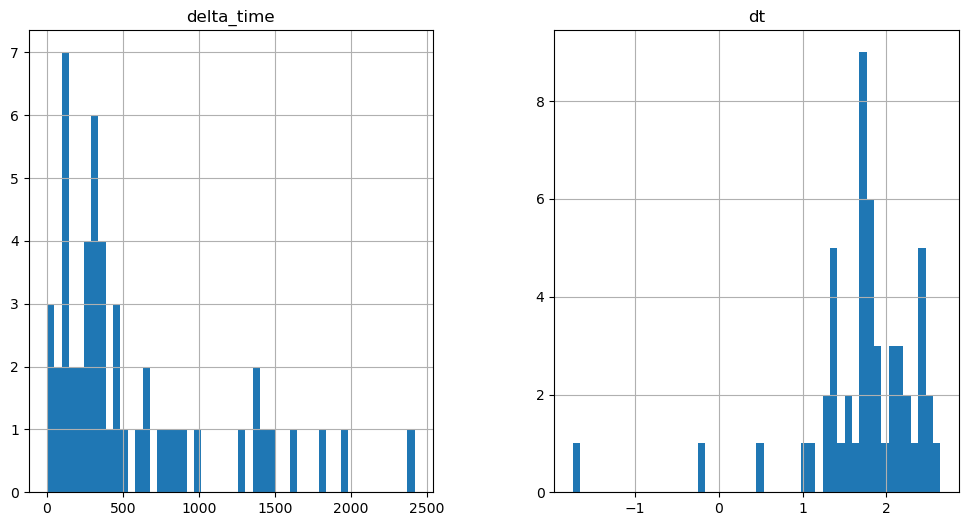

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

201.0241500735283 0.1


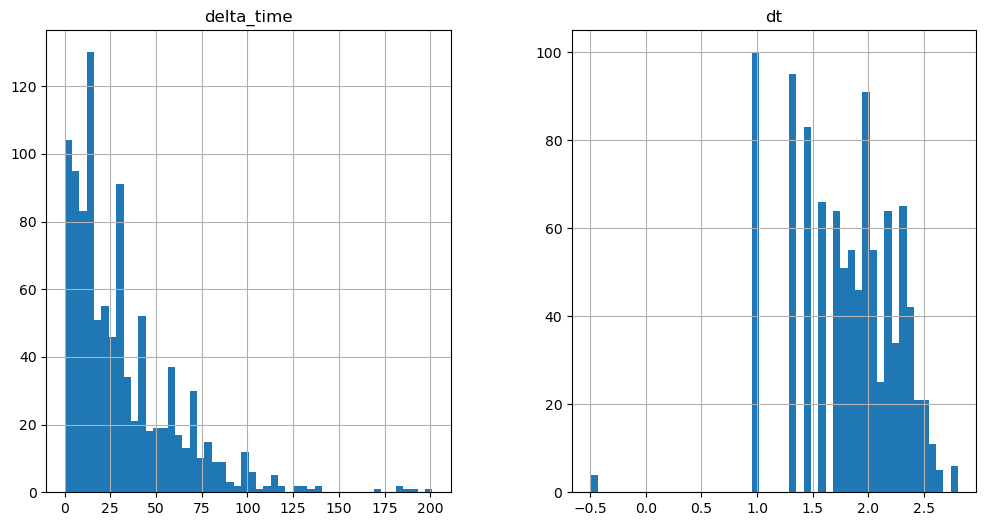

2302.3549251556396 40.833032071590424


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

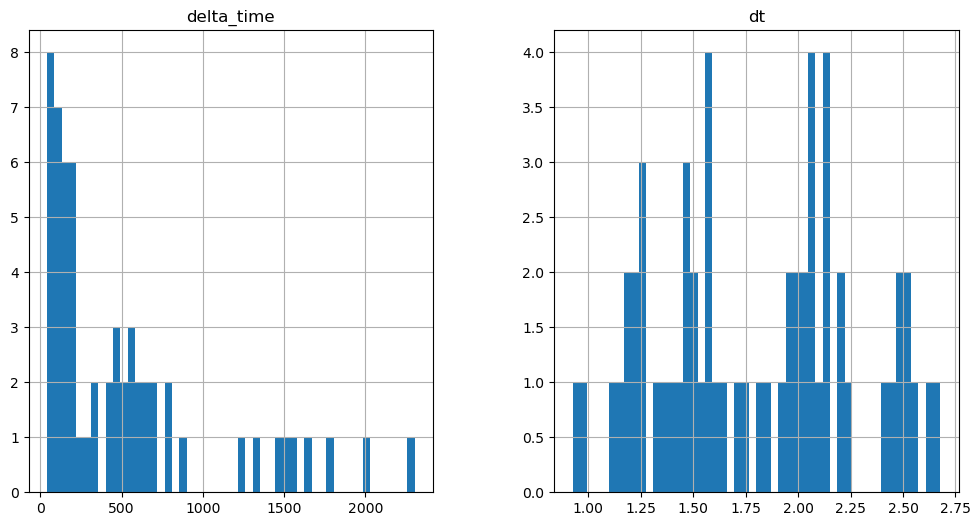

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1152.7479975819588 6.282020330429077


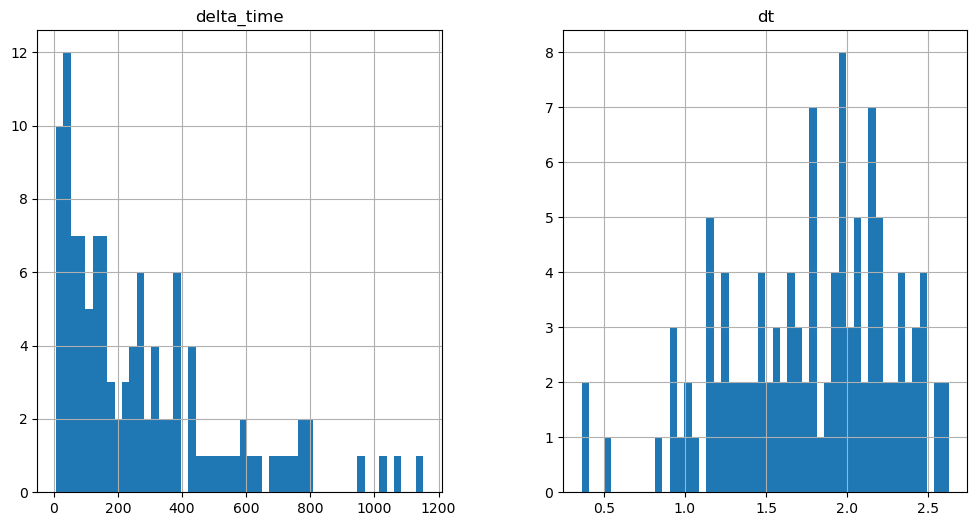

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1978.8322588205338 15.705030739307404


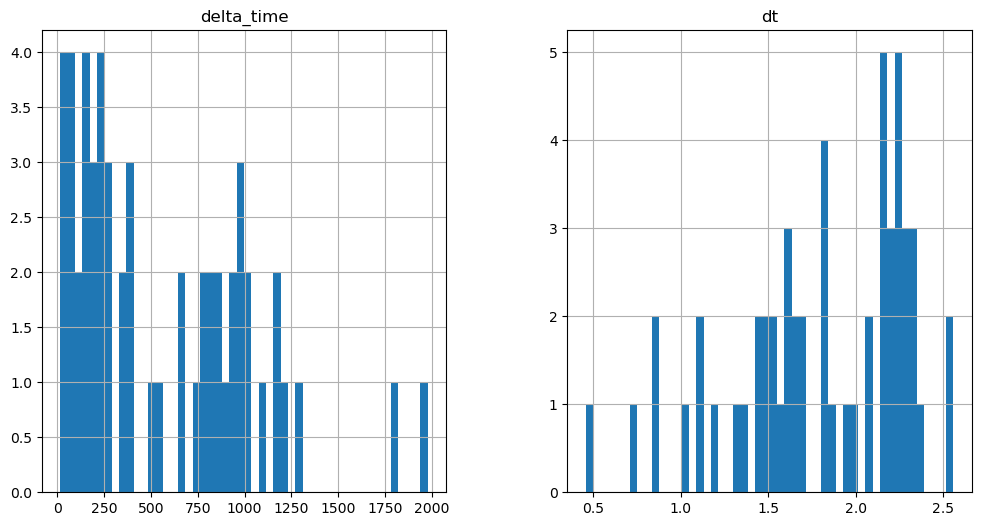

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1617.6165008544922 0.1


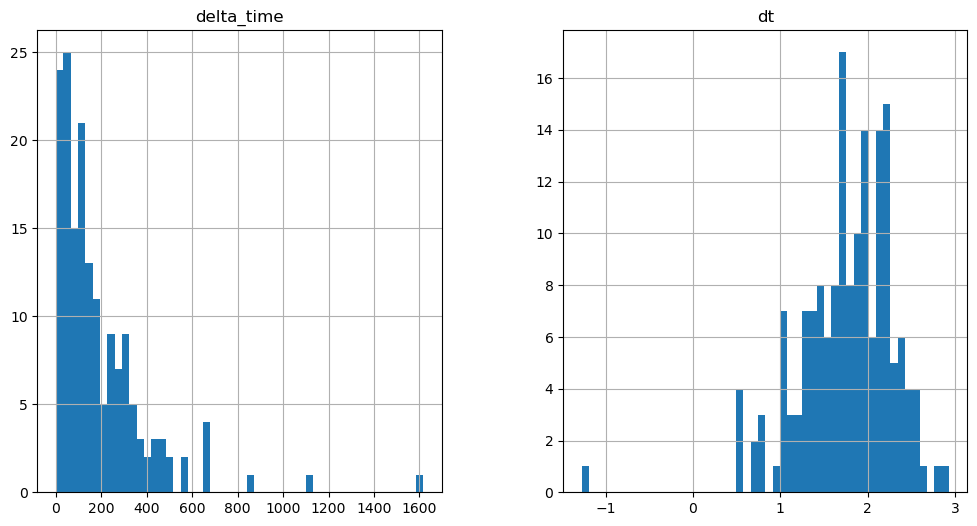

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1611.3343507647514 31.41010147333145


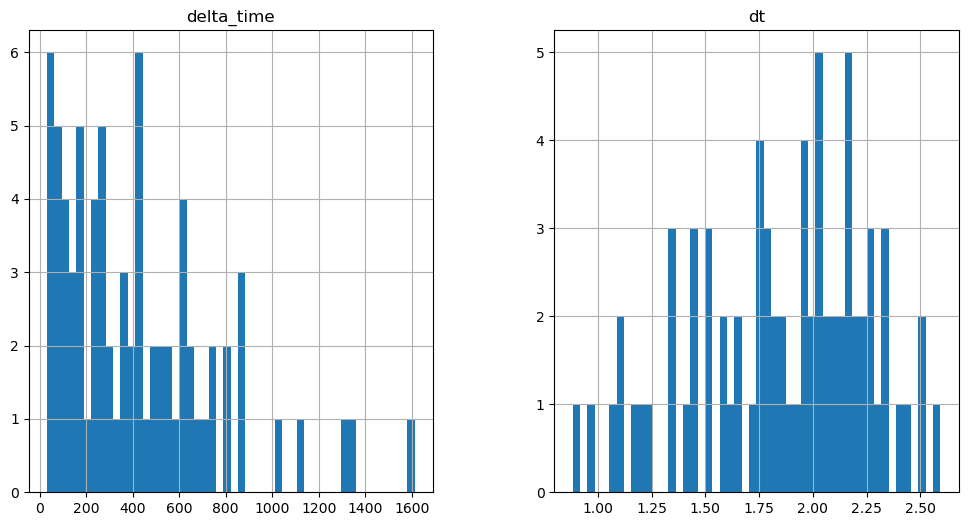

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3671.8320635557175 9.423010528087616


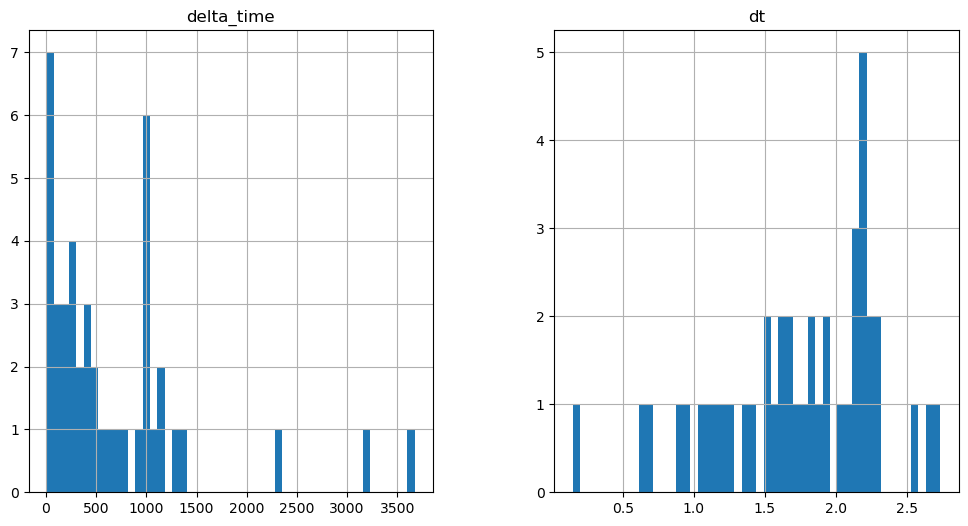

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1953.7133576273918 3.140990197658539


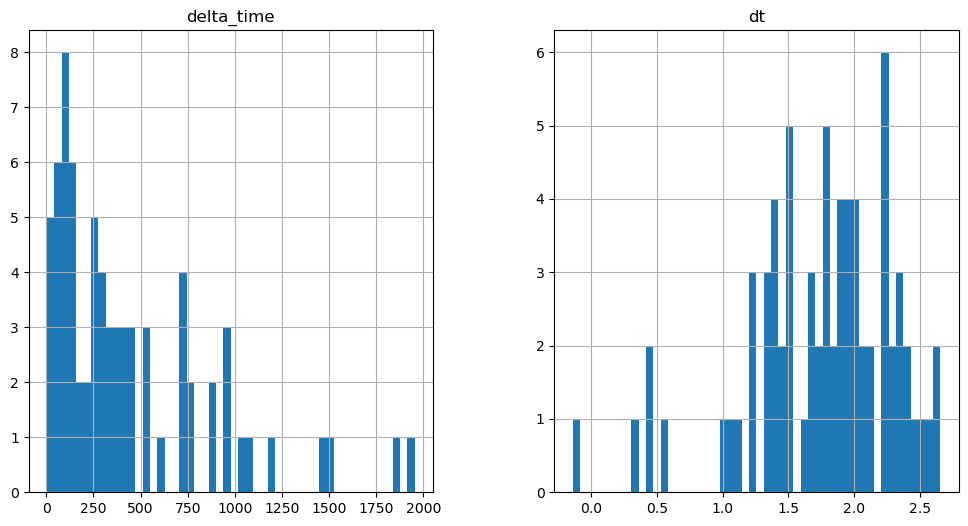

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2176.71718865633 6.28201025724411


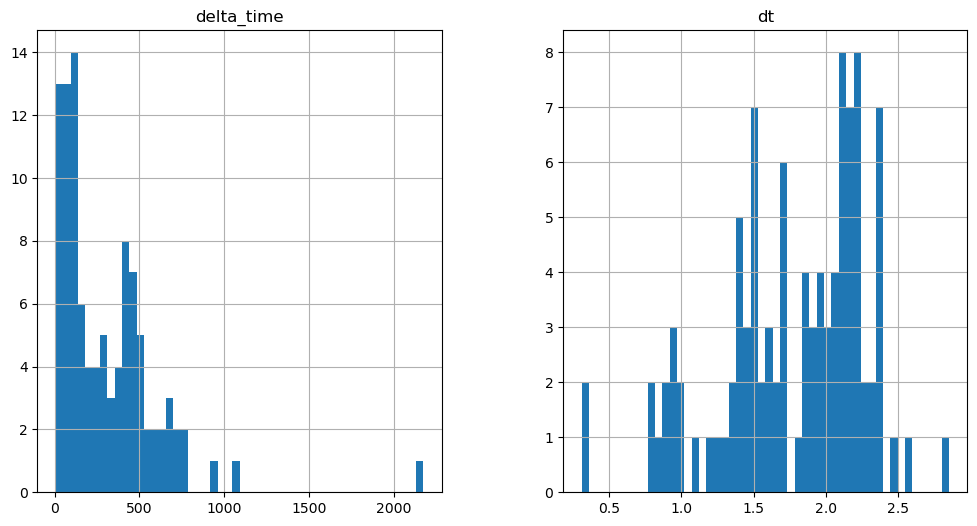

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1372.6181985139847 3.141010105609894


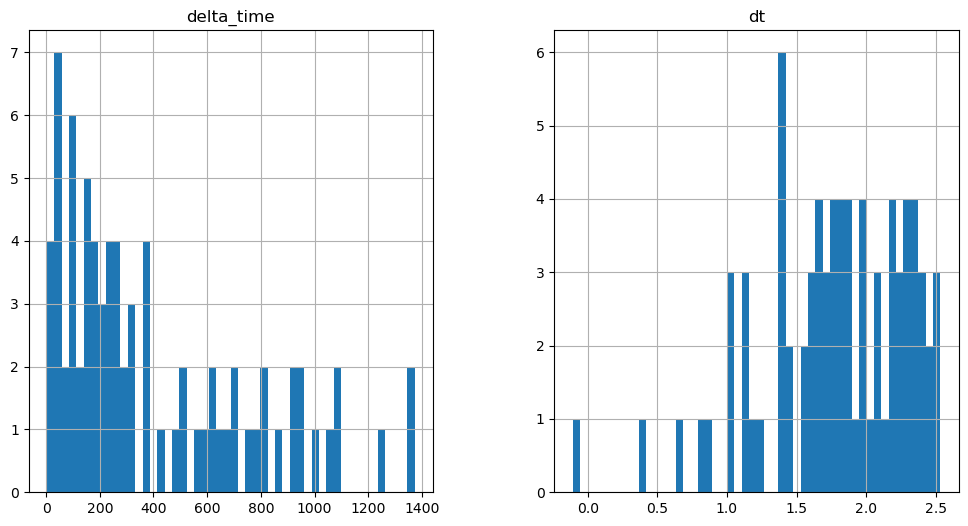

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3005.939630329609 6.281990349292755


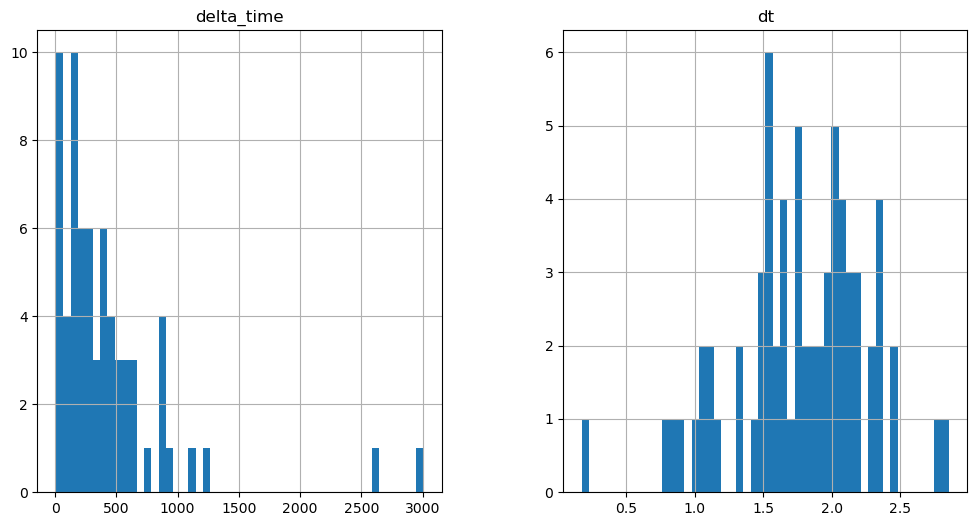

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1894.0246345996857 21.987021148204803


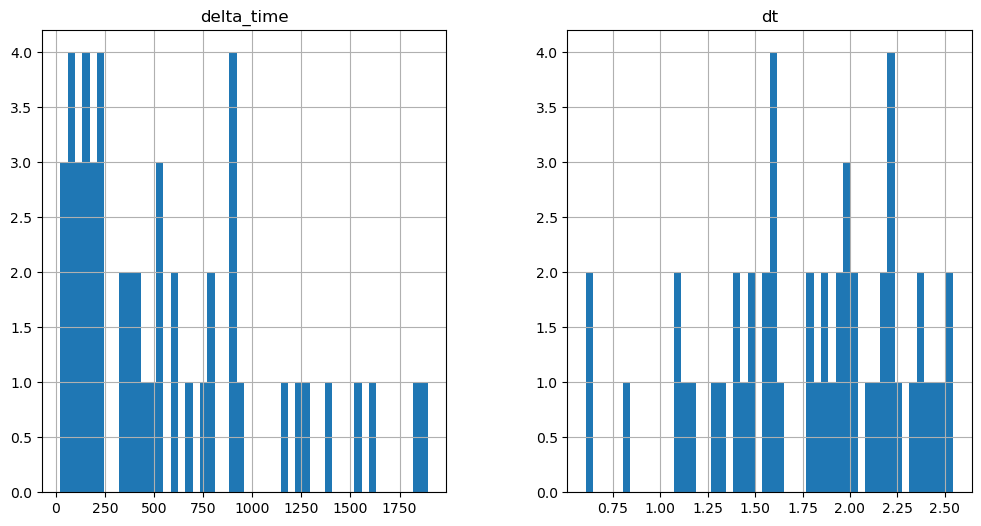

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1272.106853544712 0.1


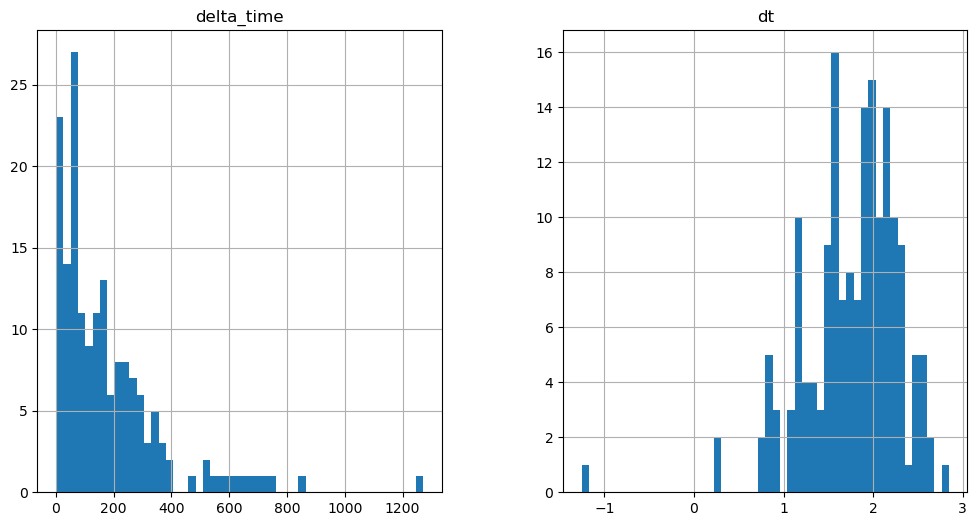

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1906.5887352228165 0.1


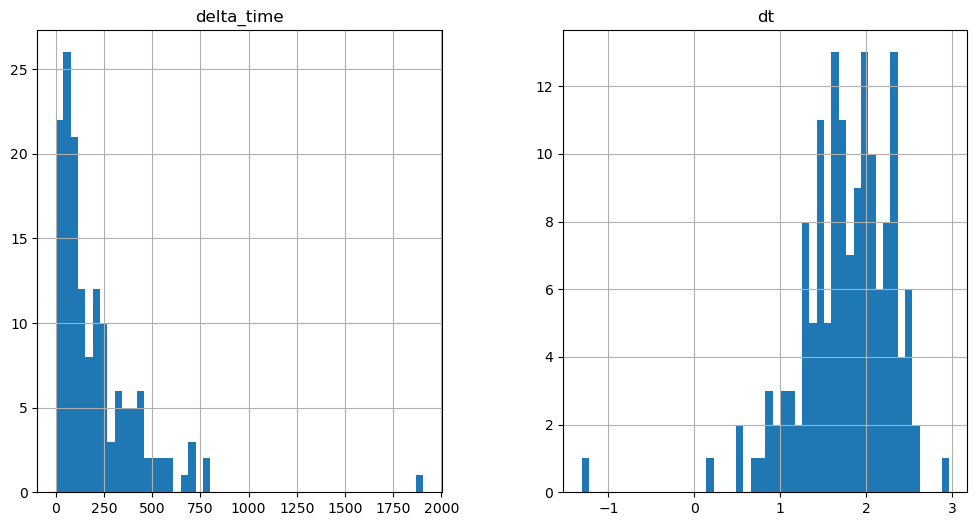

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

797.8141294717789 0.1


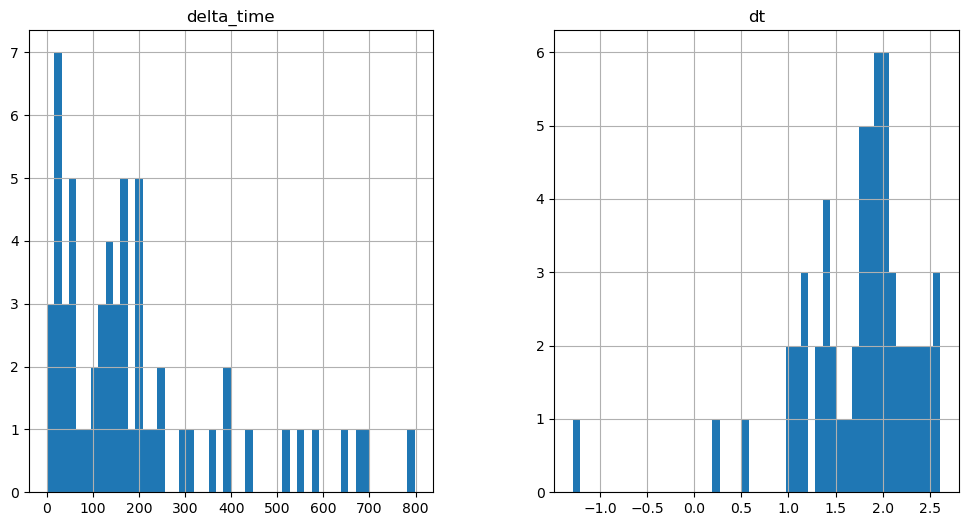

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

505.70107489824295 3.1409801840782166


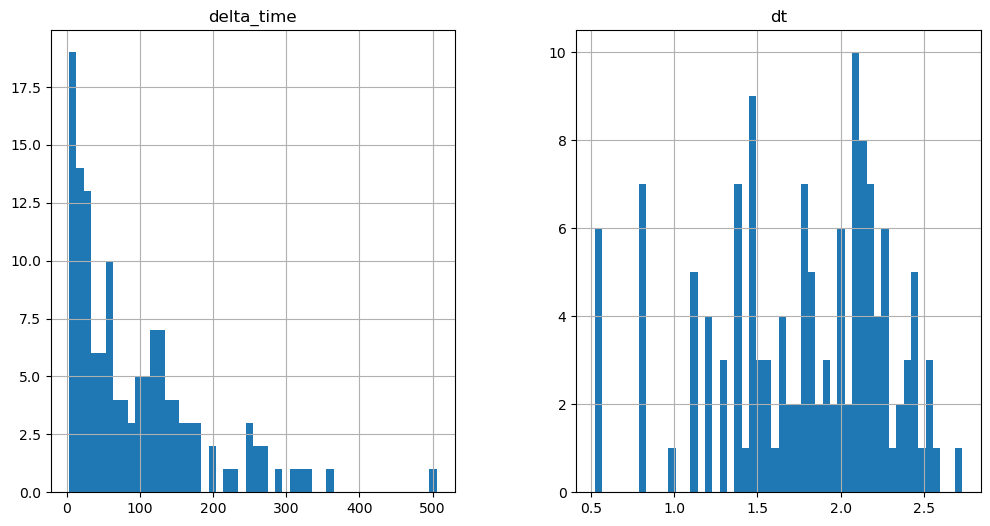

2284.906153380871 48.61502248048782


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

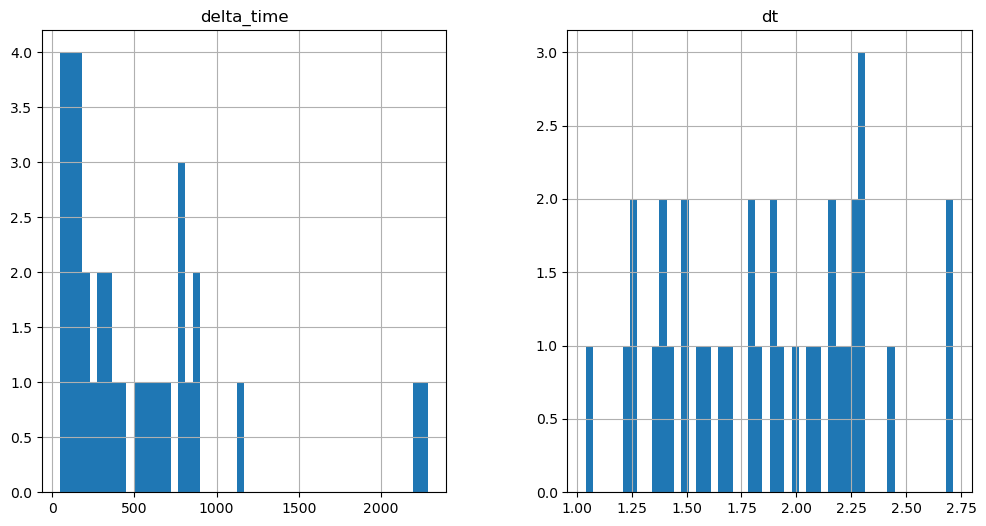

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

469.94520330429077 3.2409902215003967


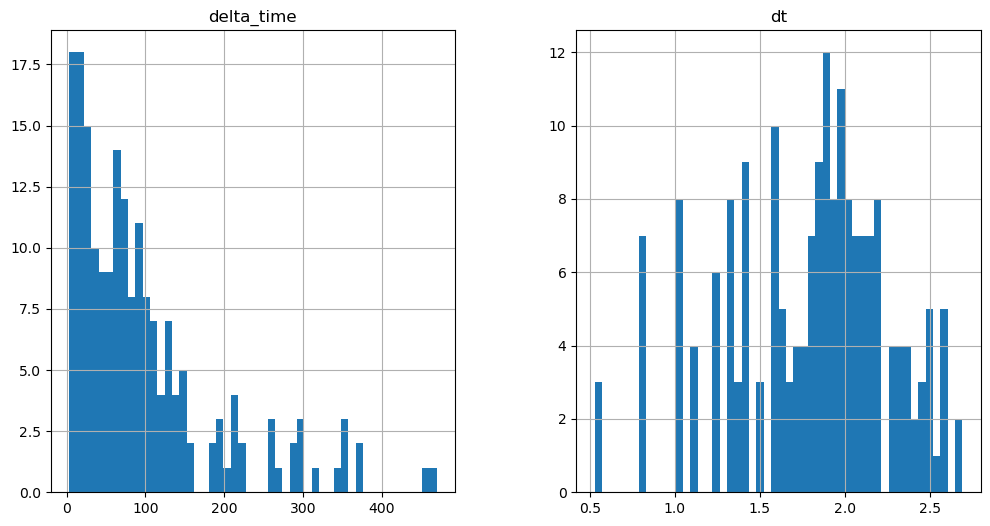

1270.4725729823112 3.241010069847107


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

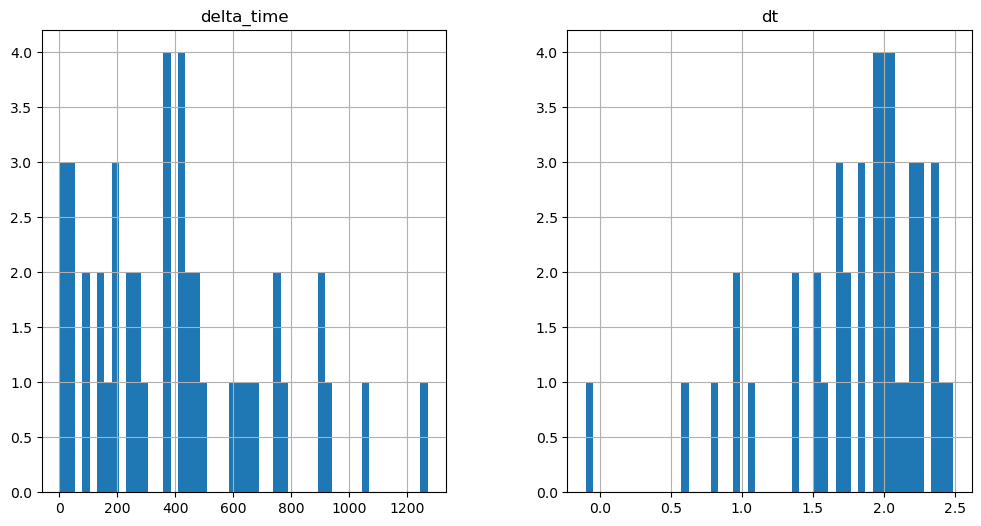

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3179.417980134487 6.481990233063698


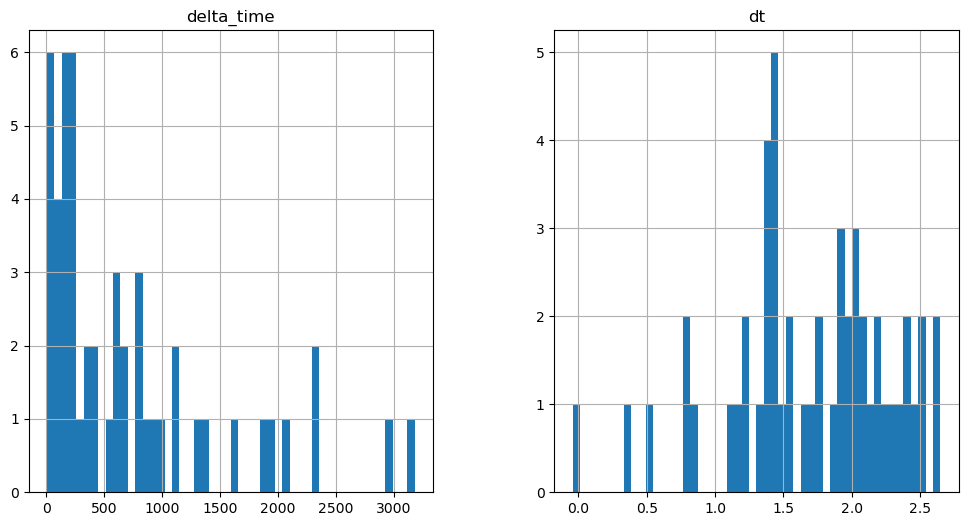

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4786.95234104991 12.964000463485718


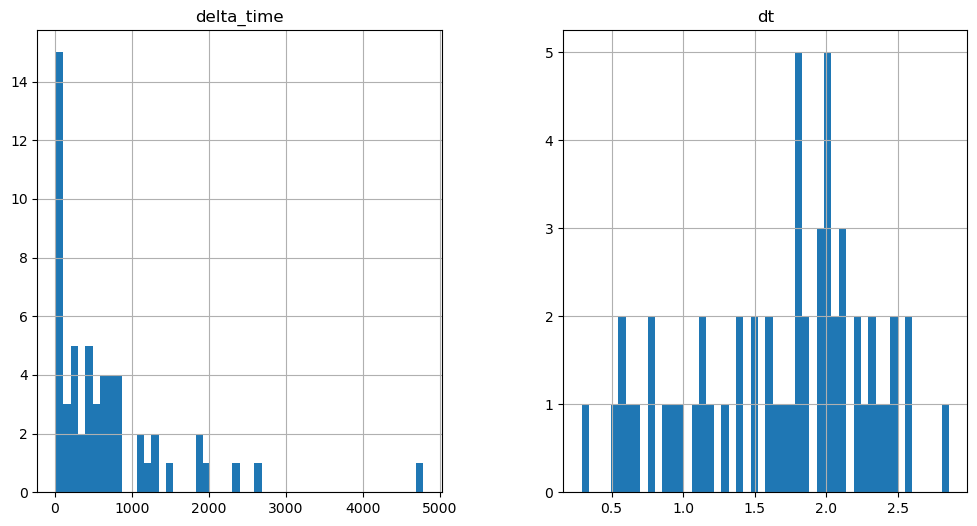

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2680.304571285844 0.1


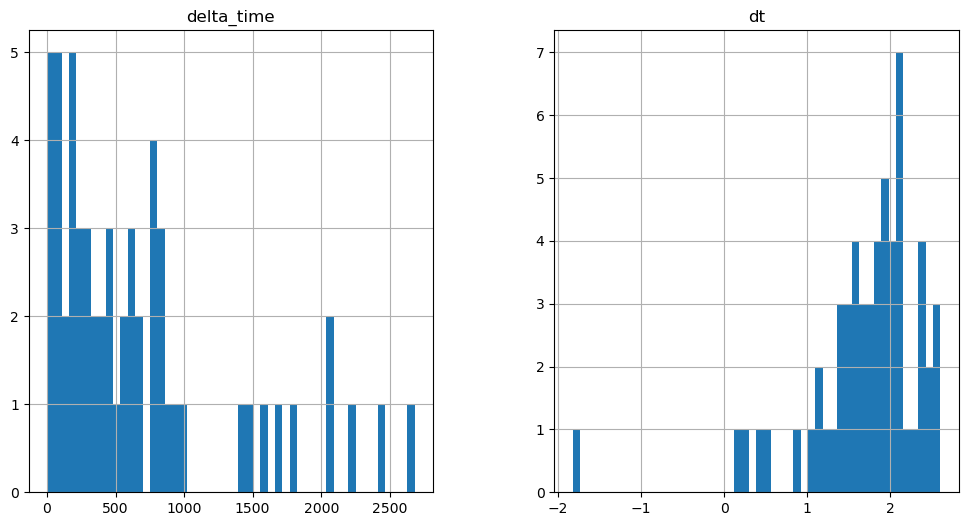

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2249.251855030656 0.1


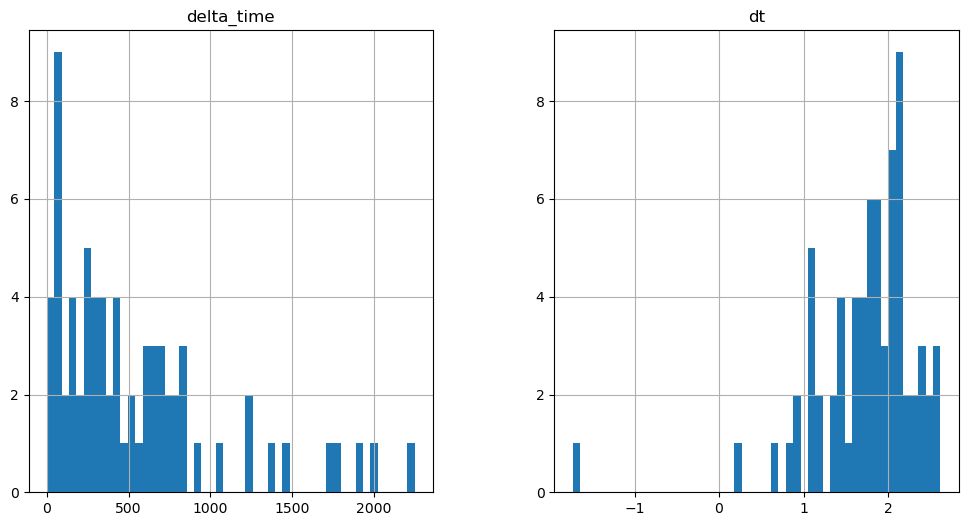

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2015.9002961814404 0.1


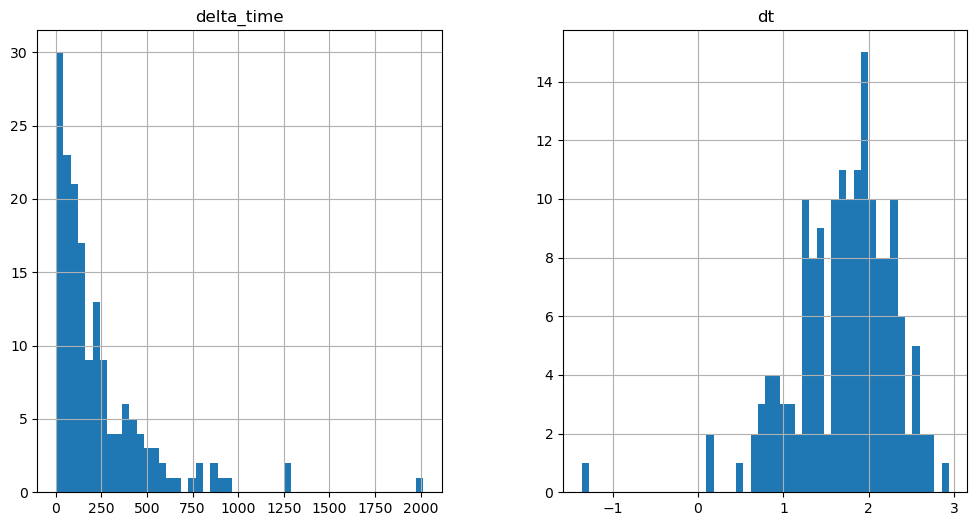

2566.869467034936 9.723010301589966


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

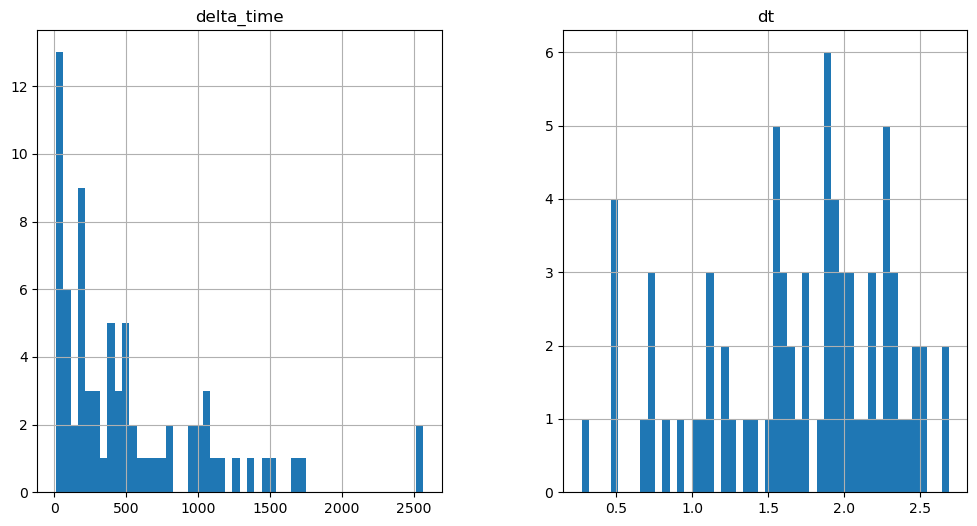

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1322.326709985733 3.241010069847107


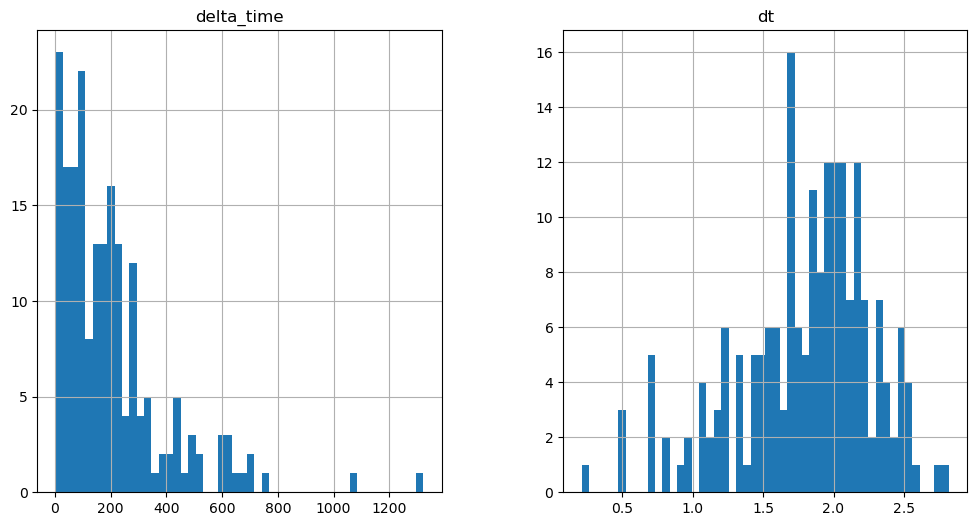

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1131.107922717929 0.1


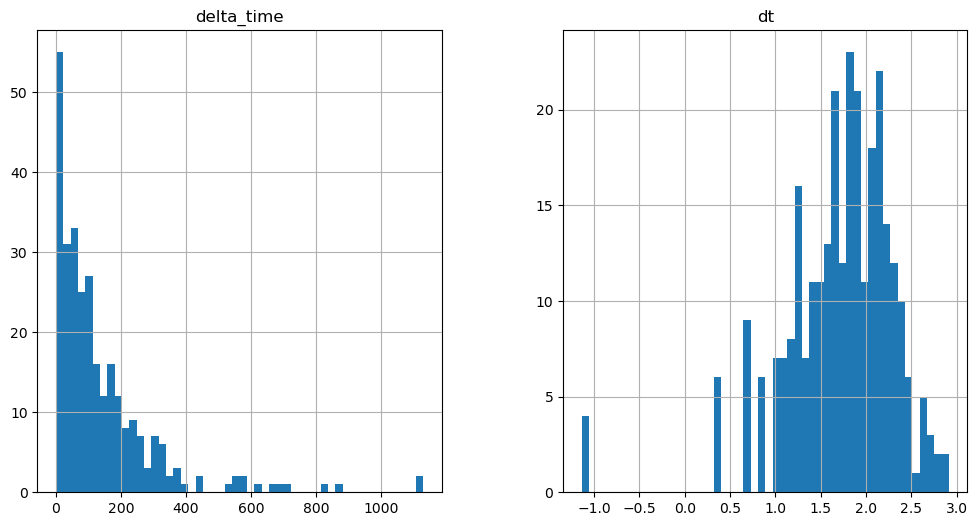

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1733.9333354979753 3.240980163216591


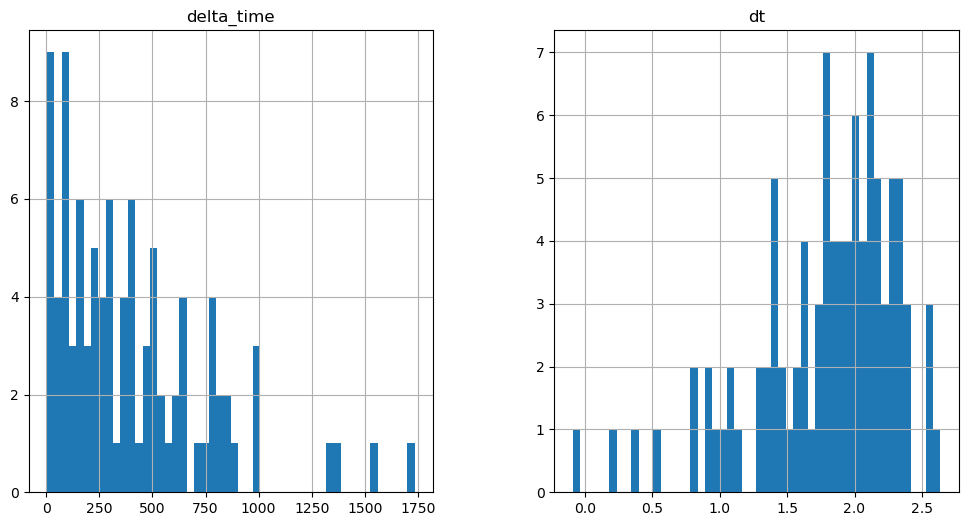

1390.3876525461674 3.240990161895752


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

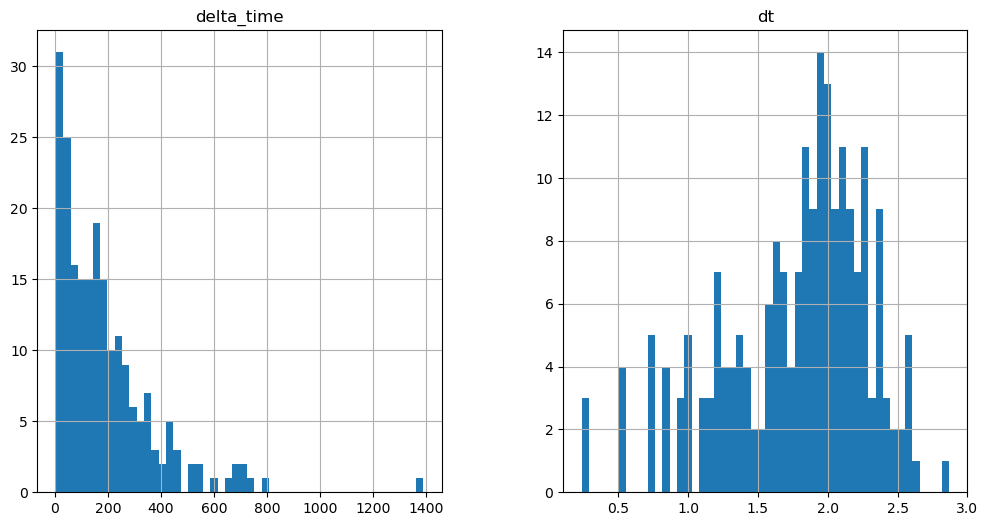

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1218.6148061156273 0.1


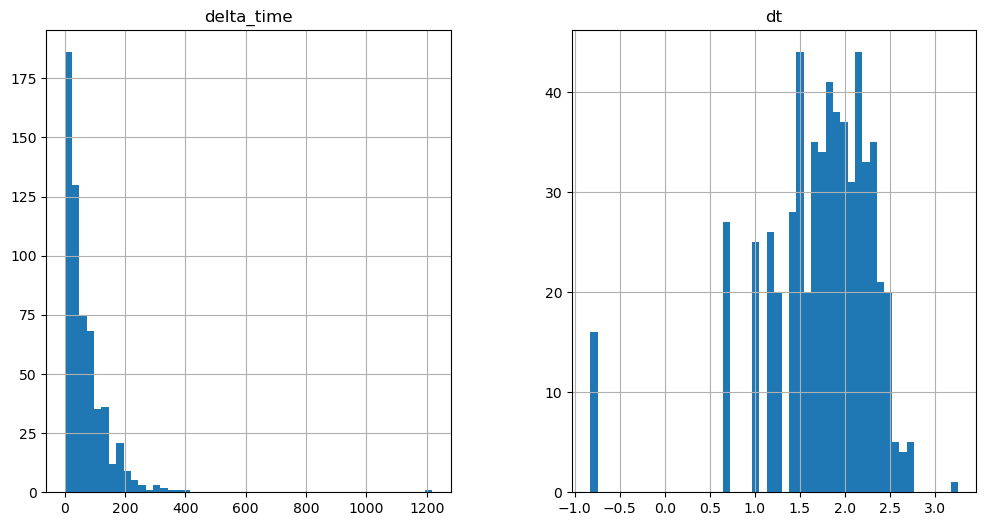

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4035.0409625321627 35.650941386818886


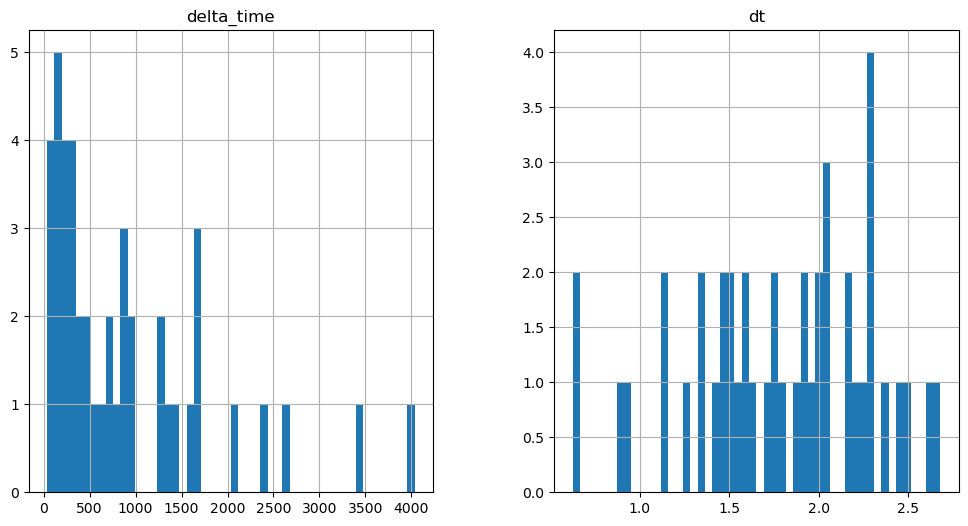

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1682.077313631773 6.481970325112343


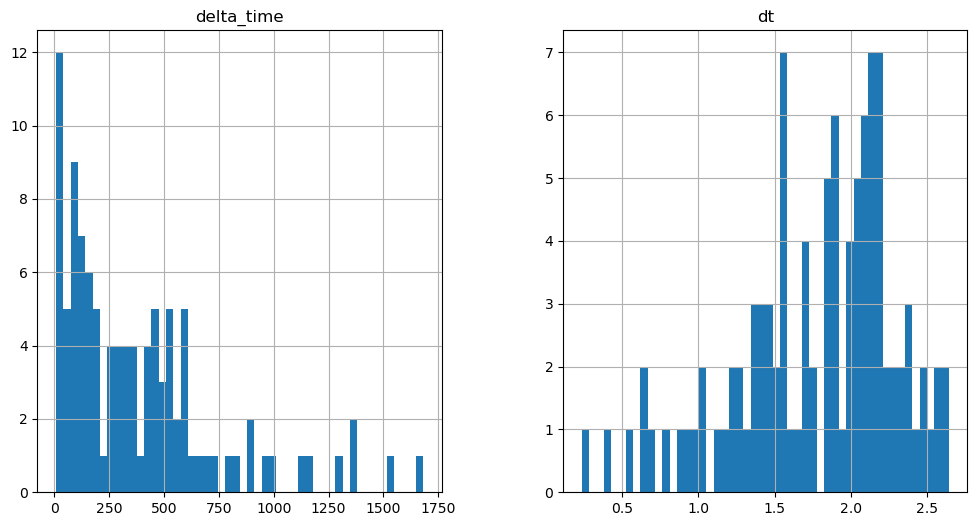

3445.179570287466 16.20498062670231


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

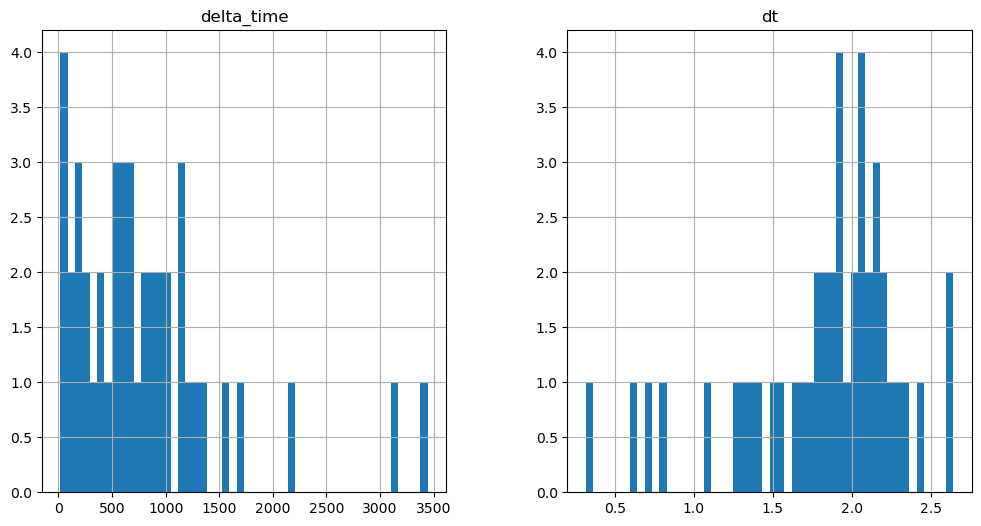

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2093.6839991360903 29.168981075286865


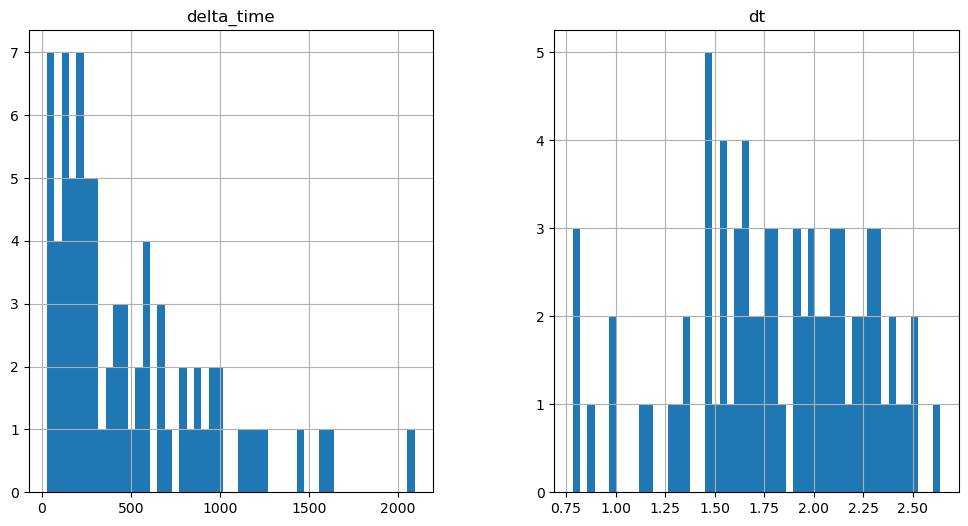

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2041.8279571831226 16.20499062538147


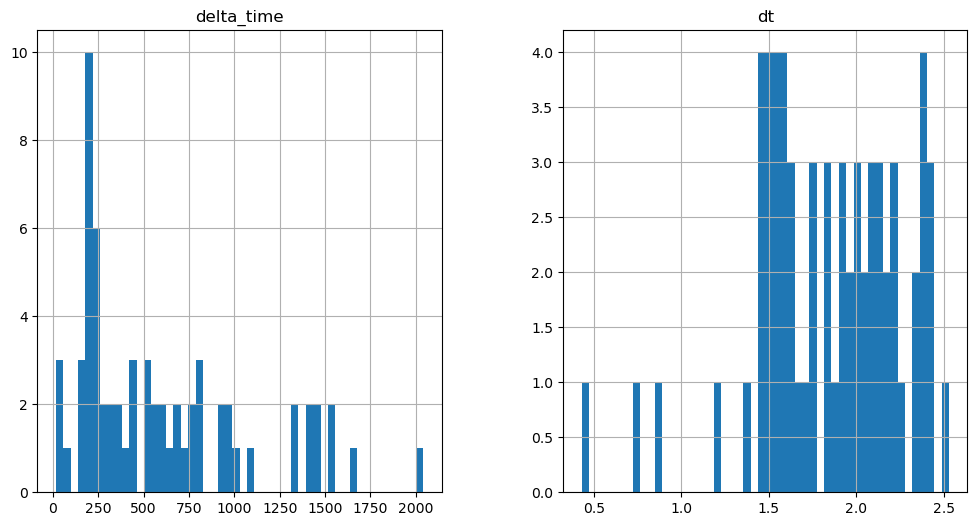

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

6582.464848861098 3.240980163216591


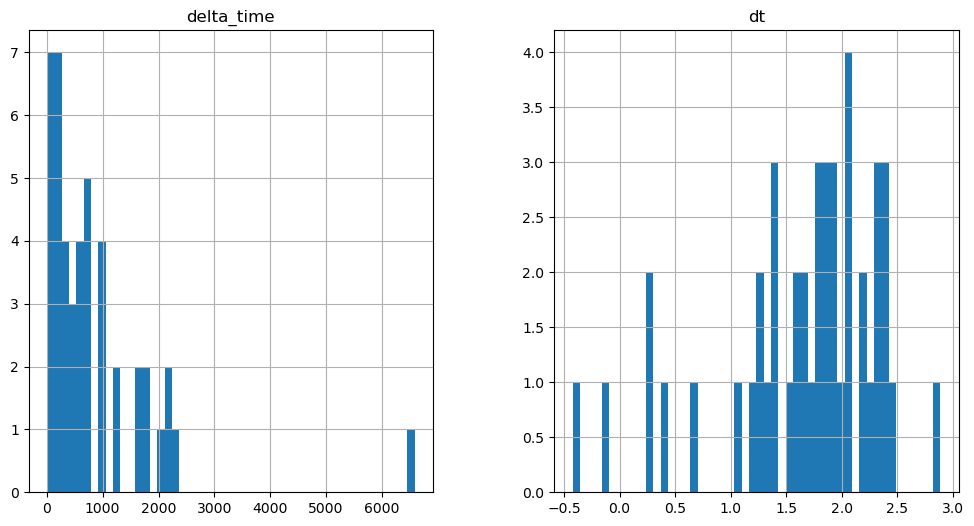

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3062.7421758770943 9.722980380058289


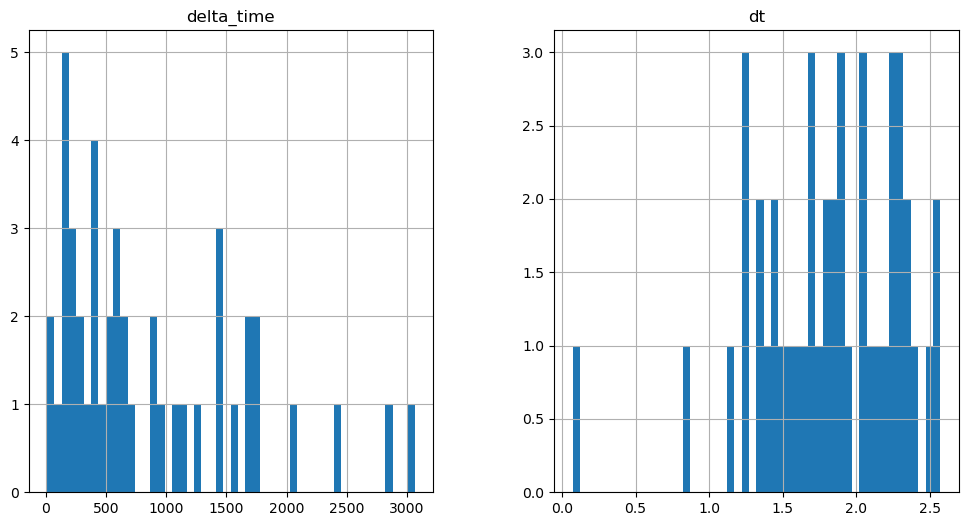

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3928.0883285701275 0.1


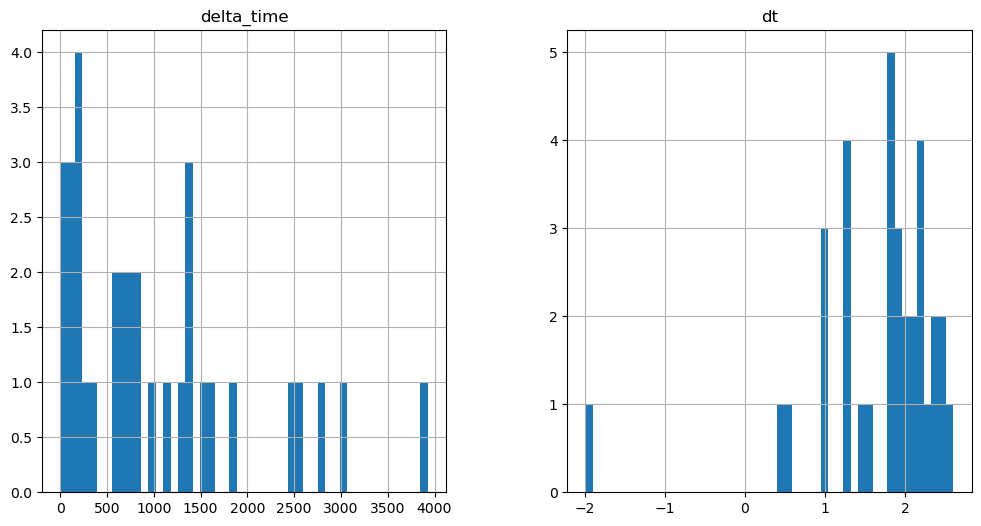

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1685.3183536231518 6.481990233063698


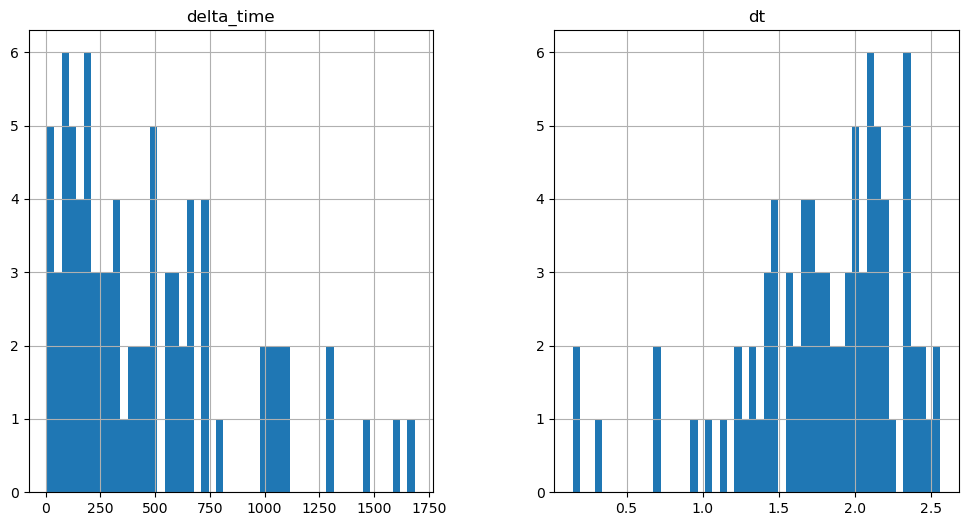

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1808.4762184470892 3.240980163216591


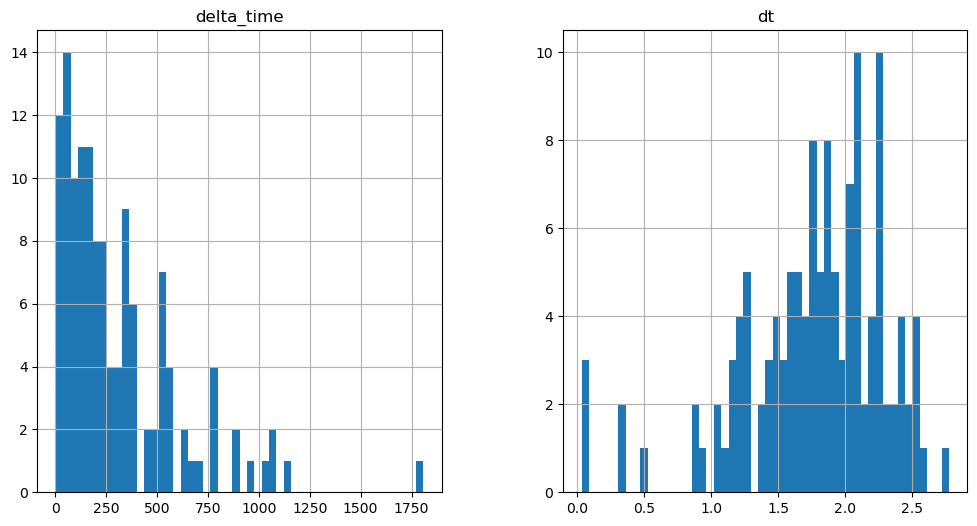

1351.4956611543894 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

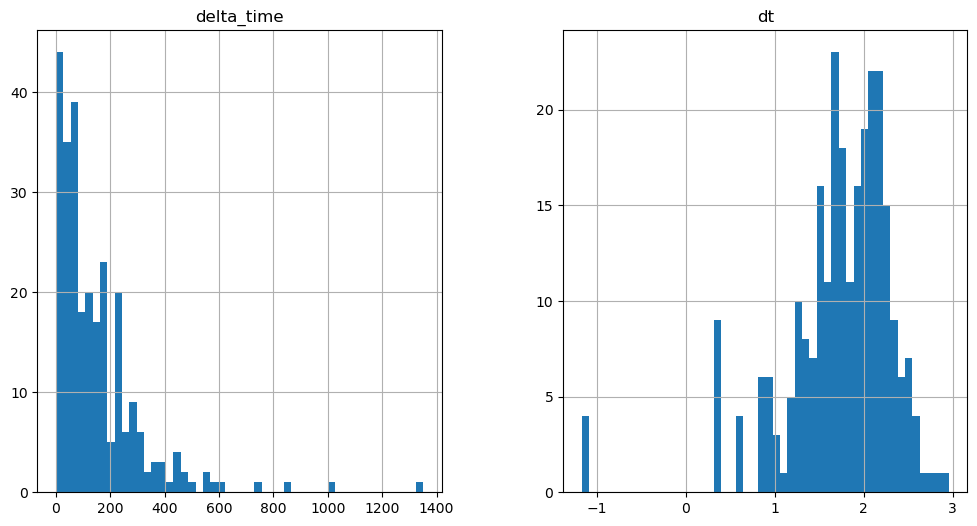

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5632.852452993393 19.4459707736969


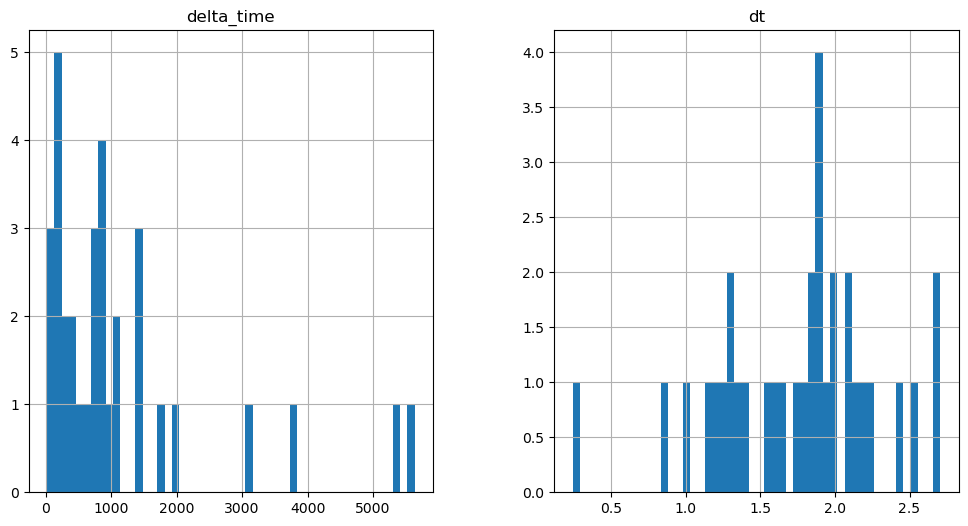

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3545.6506940871477 6.48200024664402


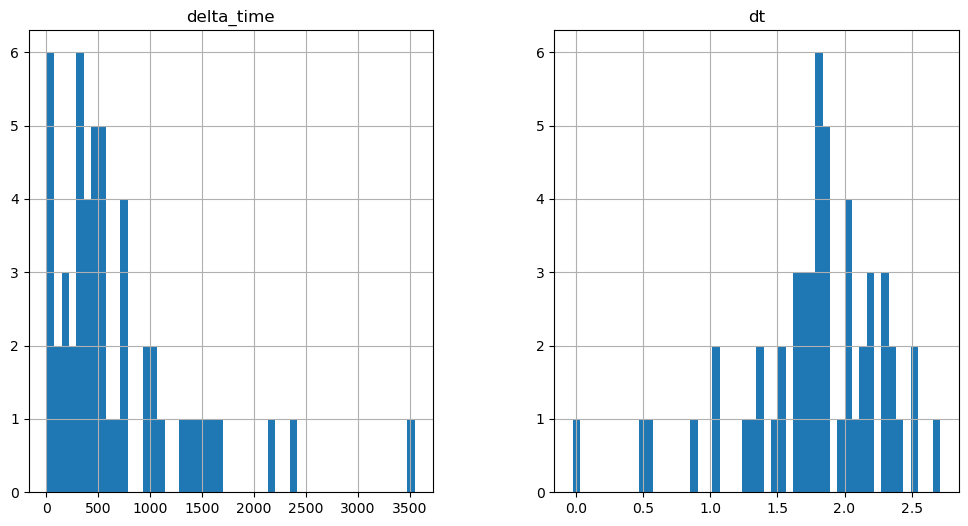

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1189.4582186341286 6.482040286064148


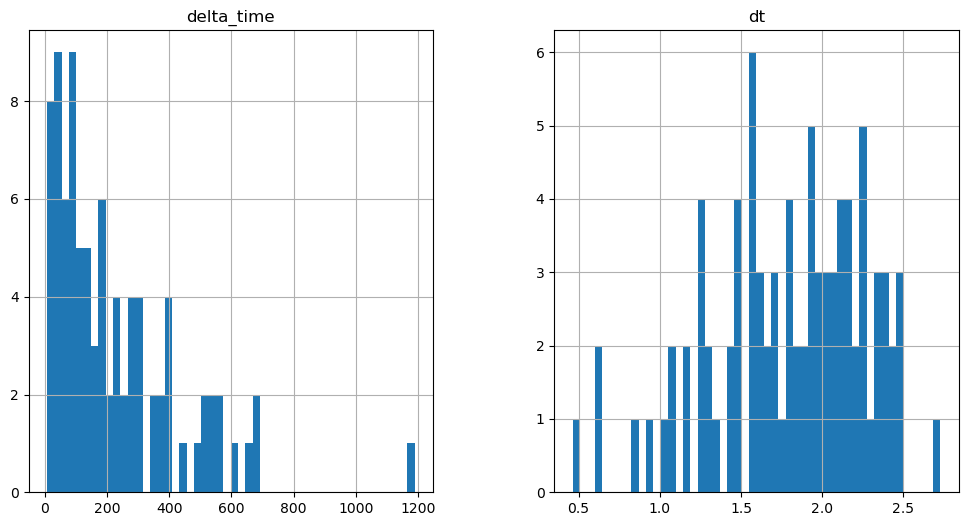

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1905.7216940522194 6.482060372829437


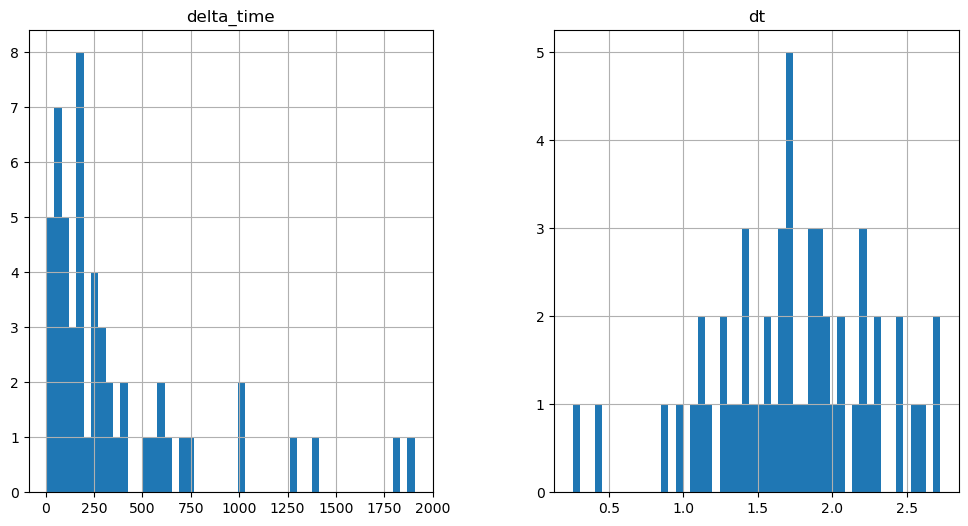

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2398.359958410263 12.964080512523651


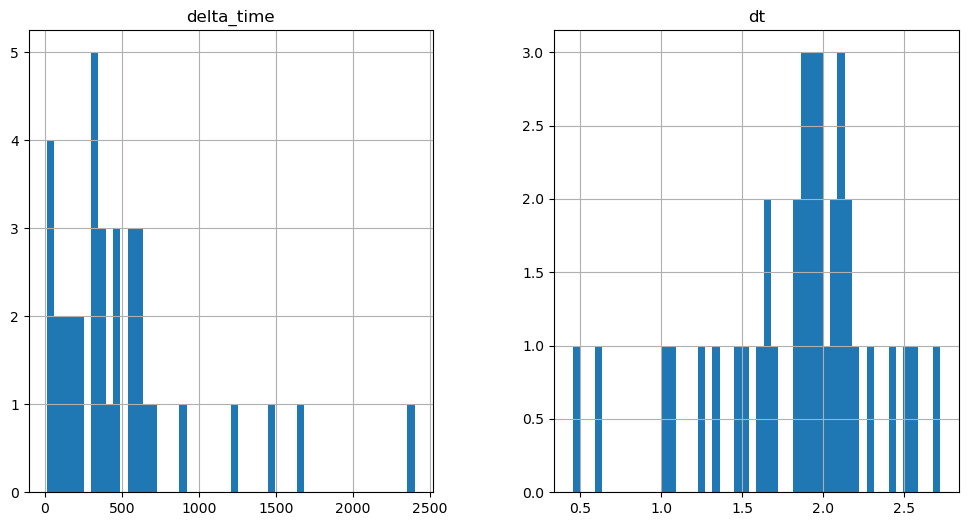

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2323.8177147507668 3.2410300970077515


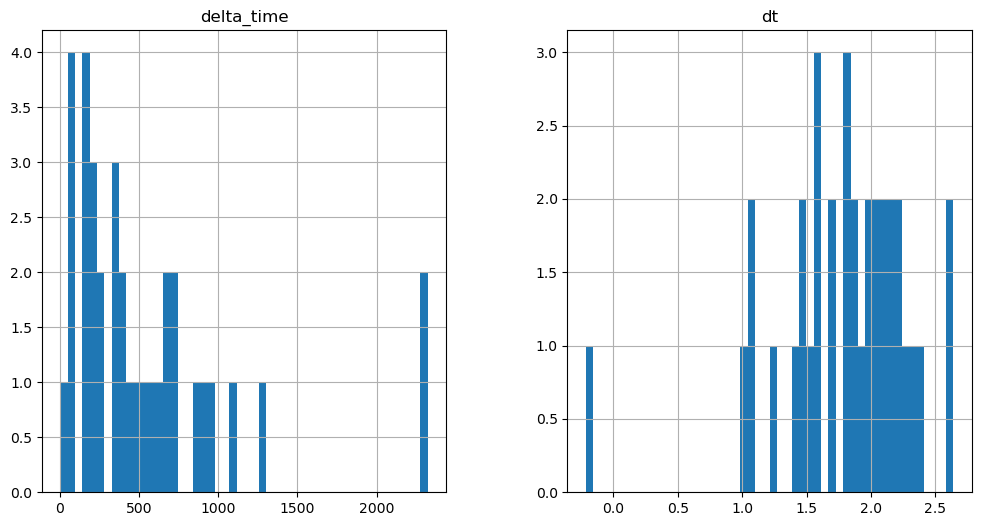

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

959.3426672816277 0.1


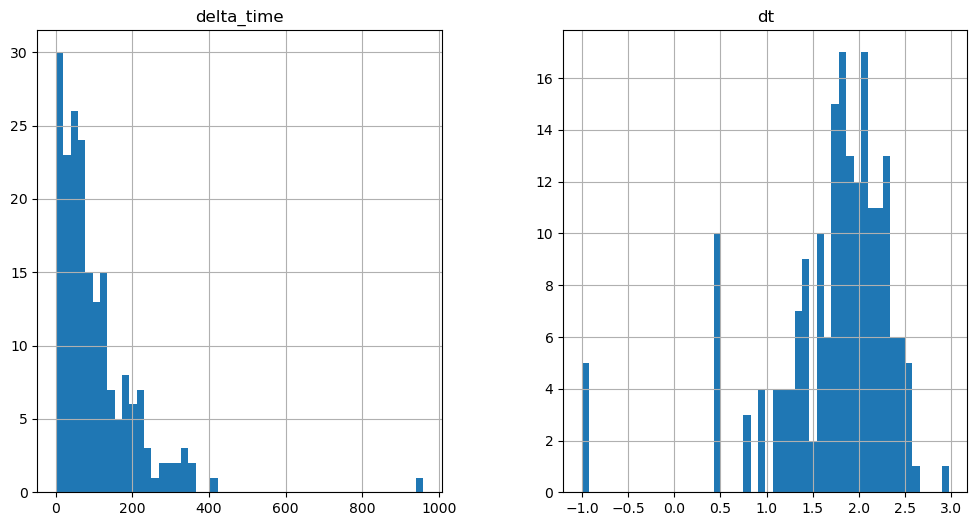

628.7591609954834 3.241020143032074


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

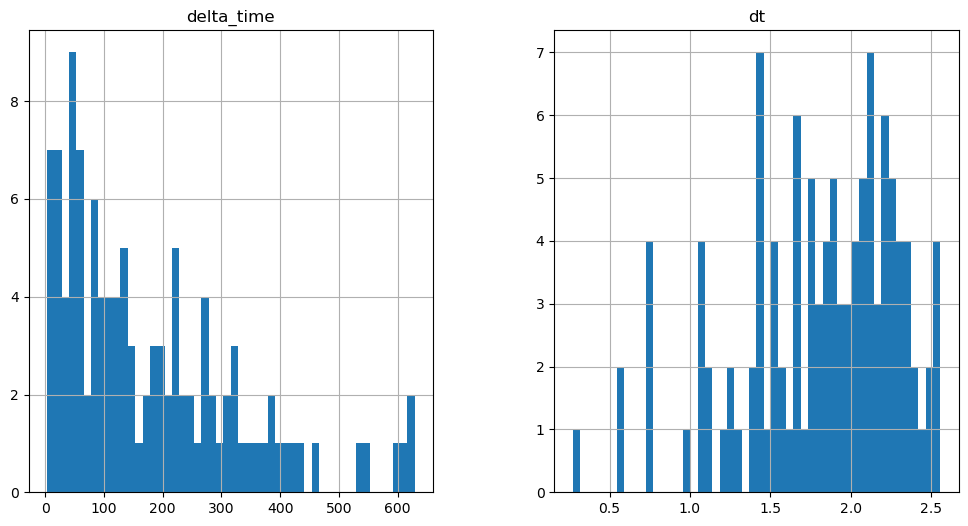

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1769.5996572971344 12.964050769805908


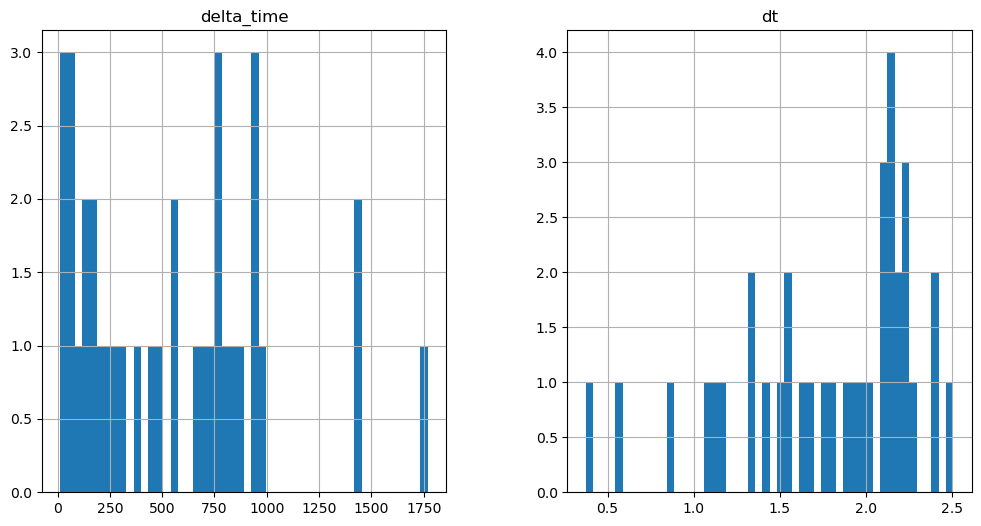

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

142.60446697473526 0.1


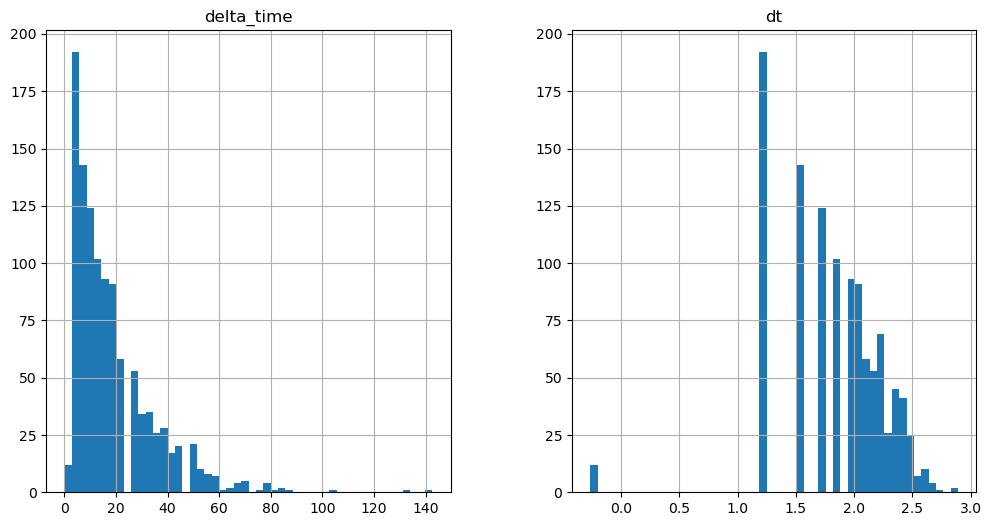

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1234.8299710154533 3.241000235080719


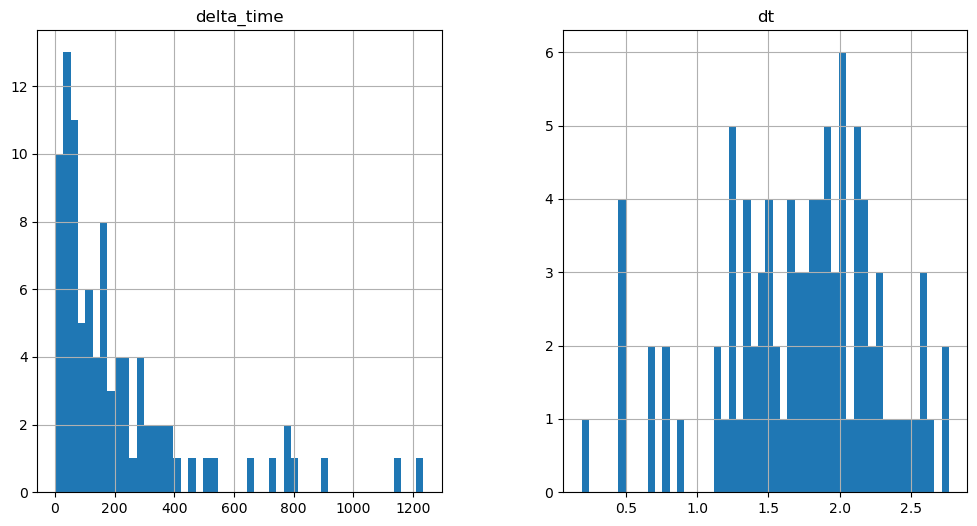

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

913.9694650173187 3.2410202026367188


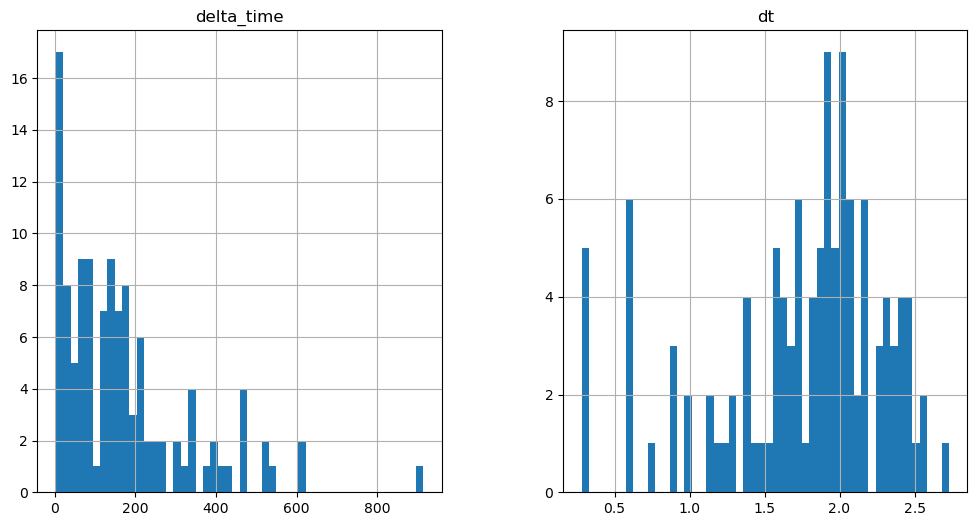

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3014.153718650341 38.8921719789505


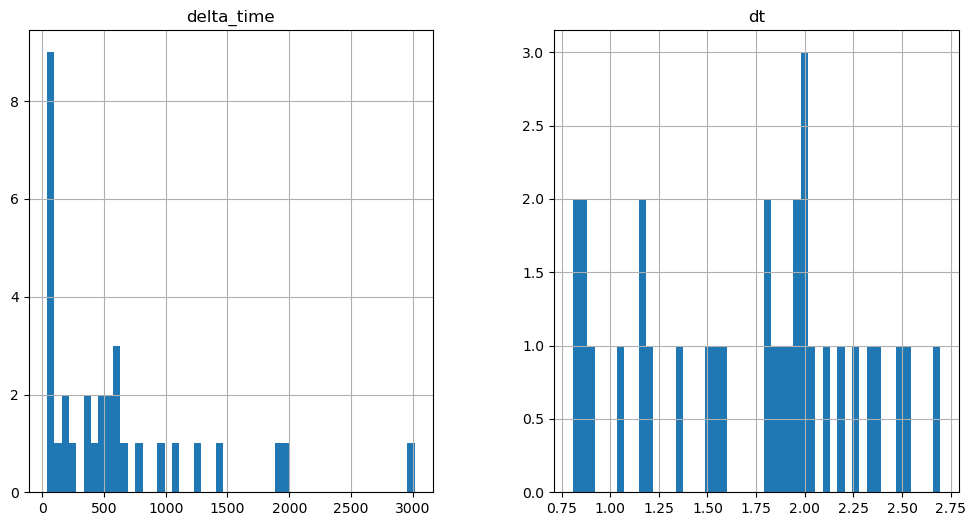

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2152.024706721306 9.722990572452545


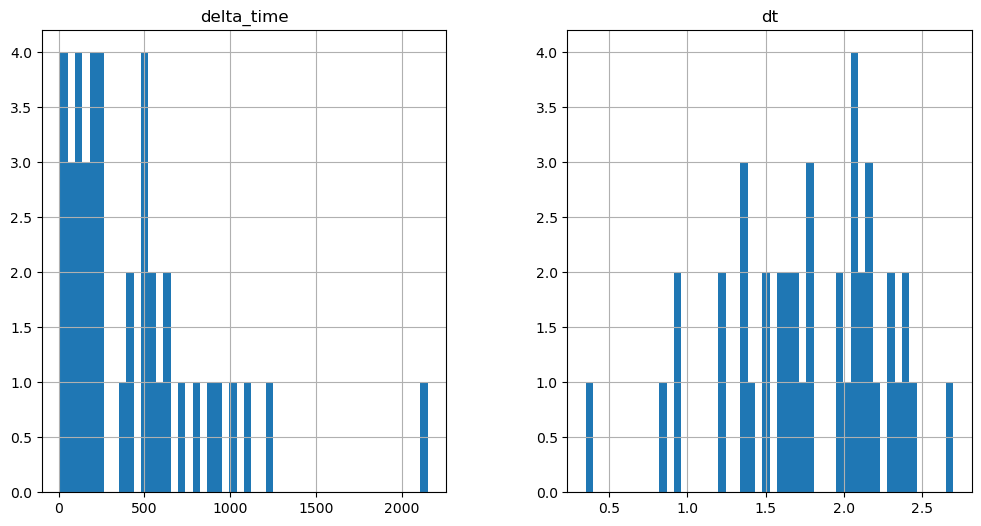

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

936.6493168473244 0.1


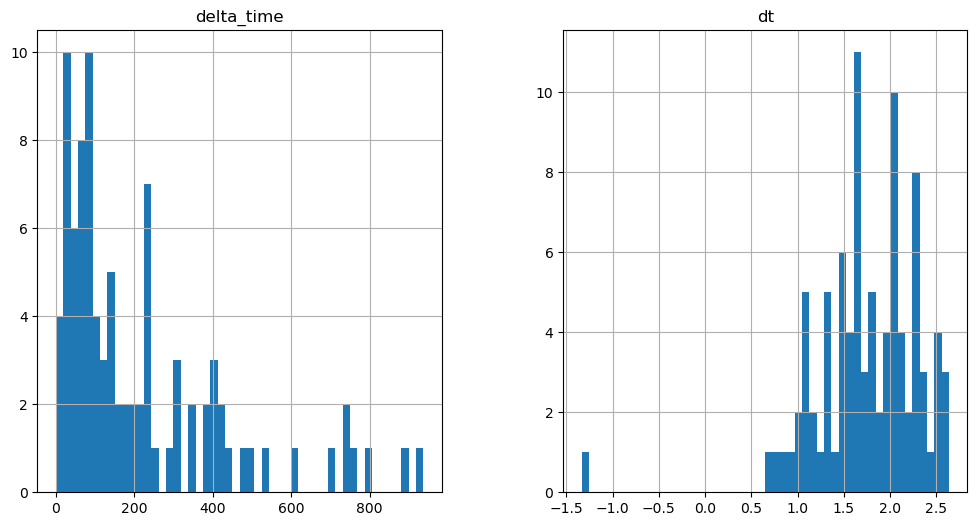

1108.422534942627 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

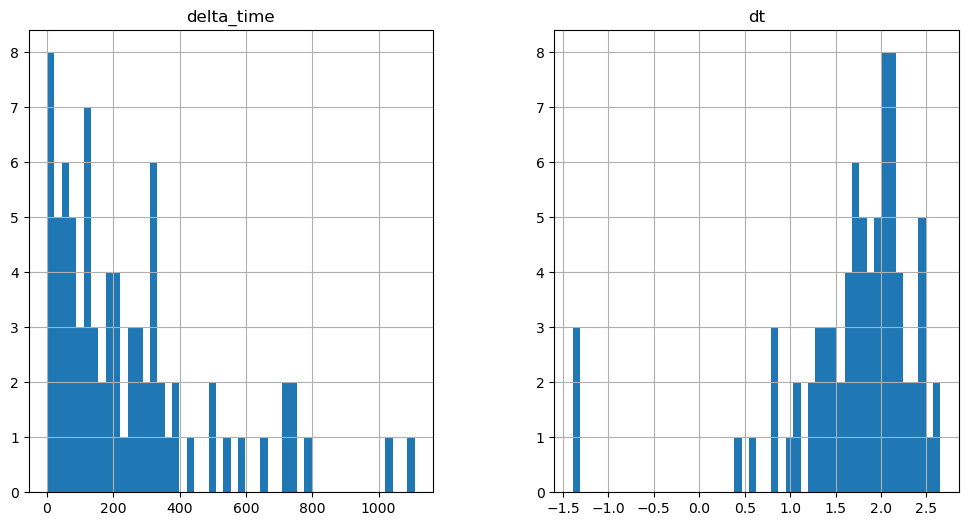

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

832.9373913407326 0.1


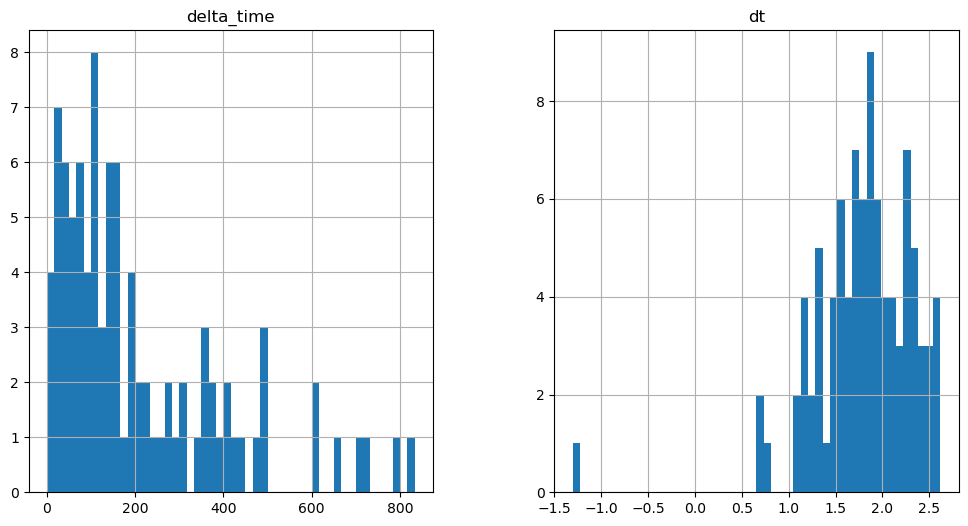

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

469.9452532529831 0.1


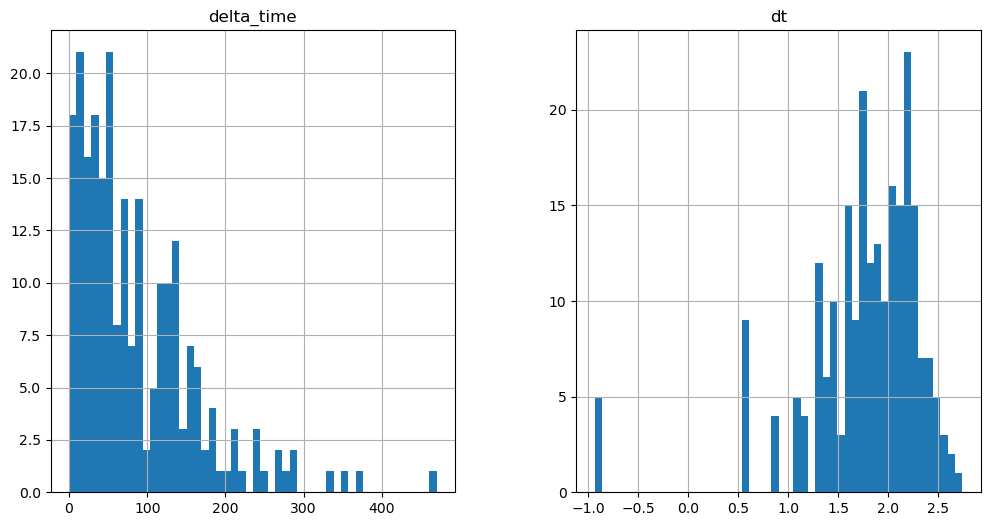

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

518.5602357387543 3.2409902215003967


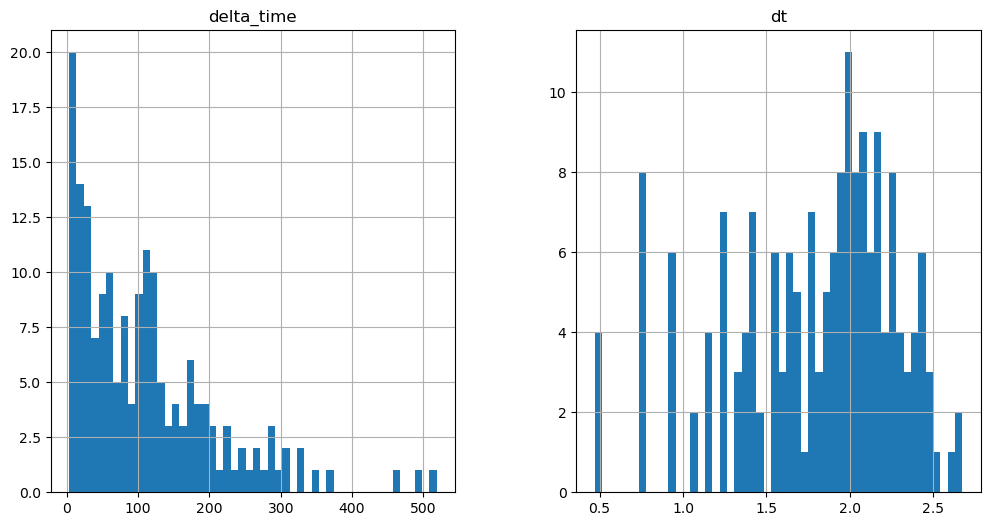

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/Users/steven/opt/anaconda3/envs/ciao-4.15/lib/python3.10/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

1573.641078710556 -73888.88657784462


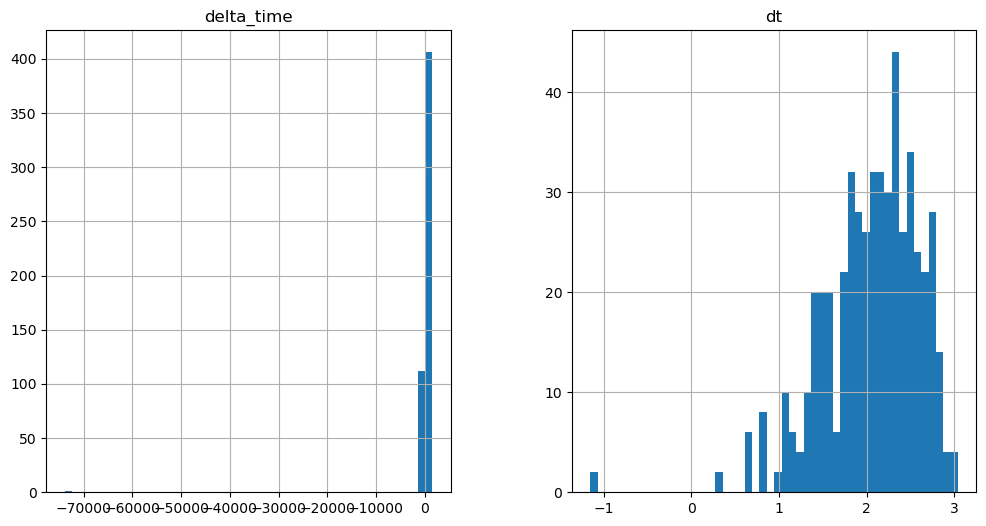

3345.165047466755 3.1410200595855713


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

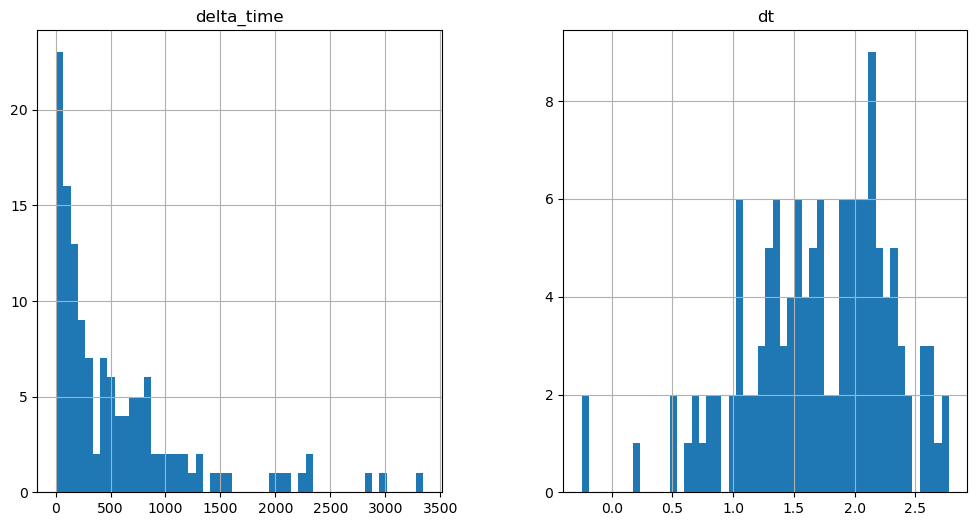

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/Users/steven/opt/anaconda3/envs/ciao-4.15/lib/python3.10/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

5393.097249925137 -72516.26932919025


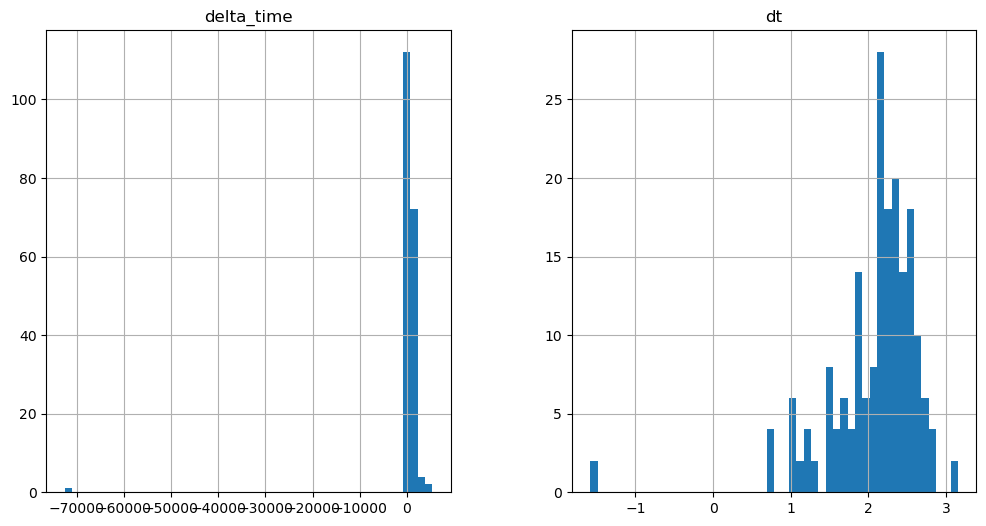

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/Users/steven/opt/anaconda3/envs/ciao-4.15/lib/python3.10/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

135.06301683187485 -75019.64609450102


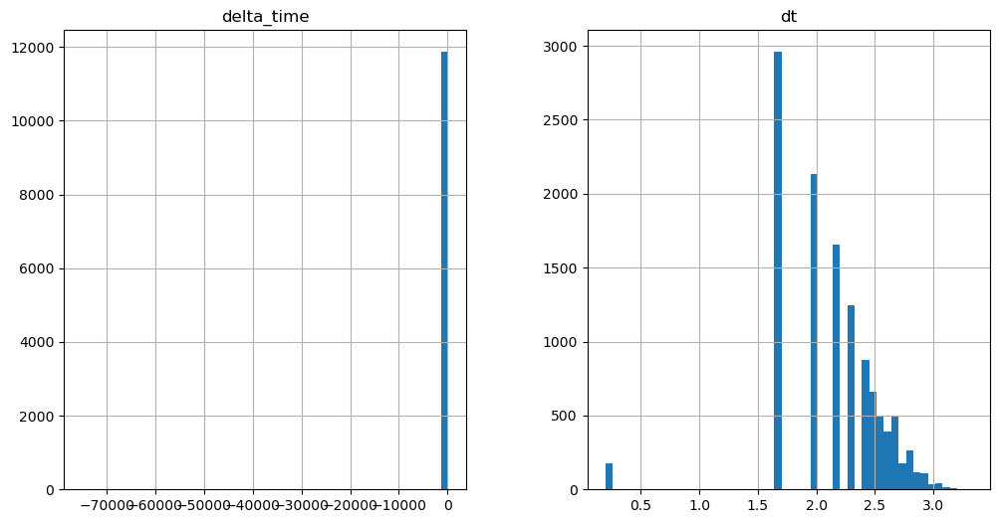

5097.843325018883 -73559.08149147034


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/Users/steven/opt/anaconda3/envs/ciao-4.15/lib/python3.10/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

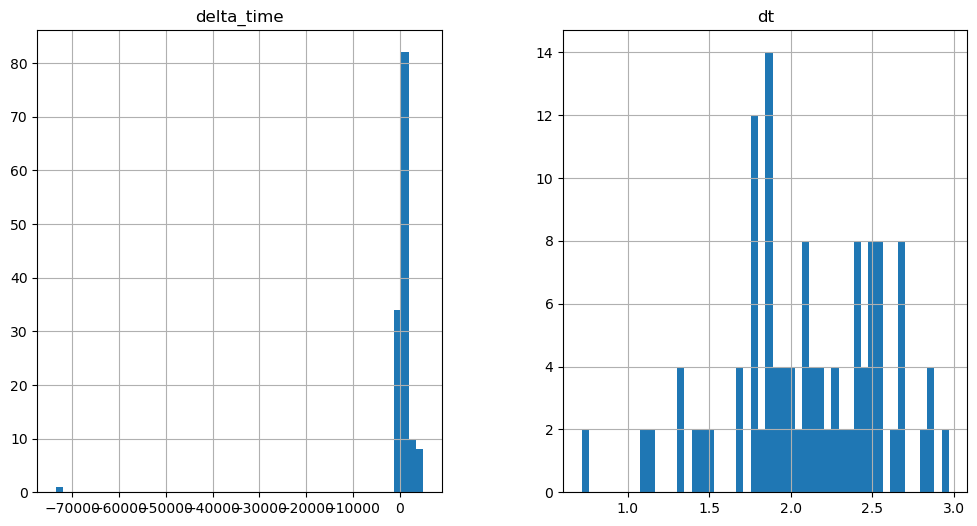

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/Users/steven/opt/anaconda3/envs/ciao-4.15/lib/python3.10/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

10110.879535973072 -73216.71283429861


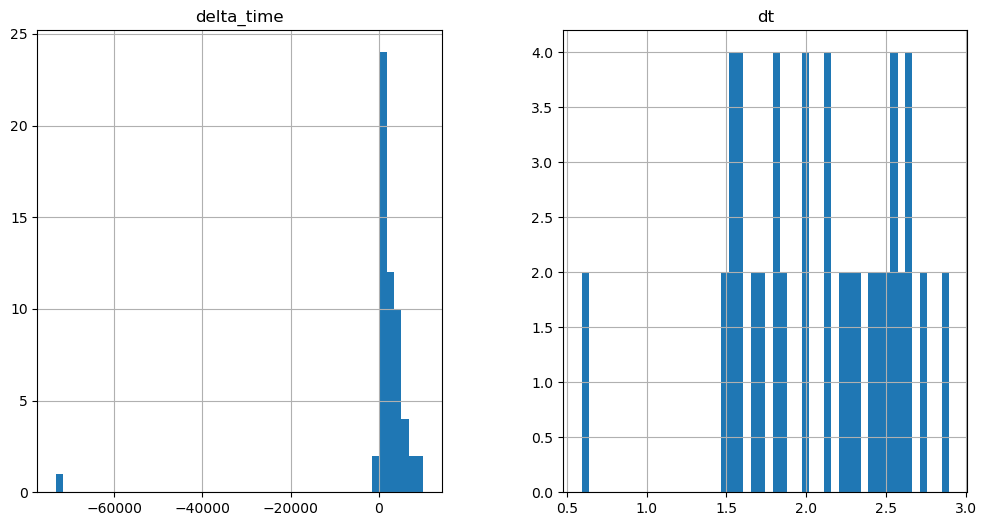

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/Users/steven/opt/anaconda3/envs/ciao-4.15/lib/python3.10/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

1426.0141113996506 -74718.11005938053


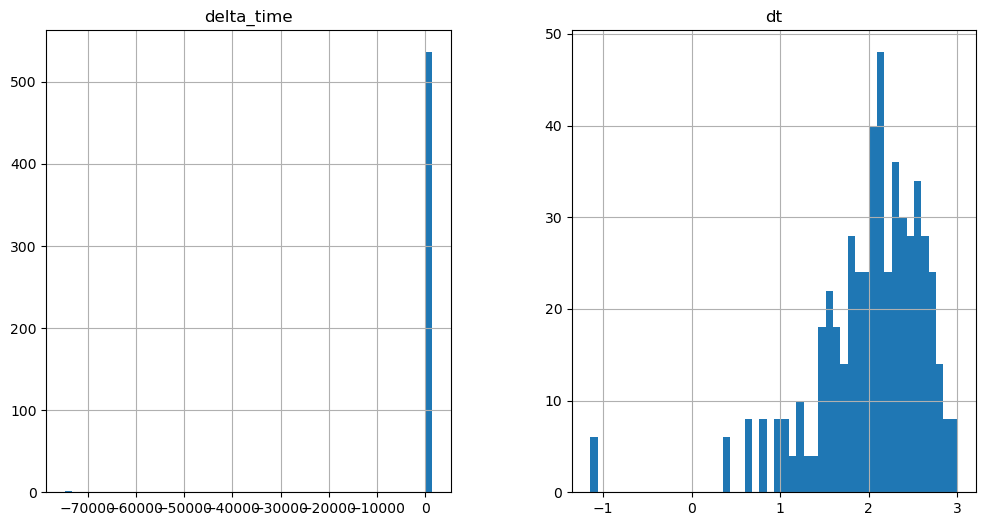

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/Users/steven/opt/anaconda3/envs/ciao-4.15/lib/python3.10/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

1118.196015894413 -74102.47422856092


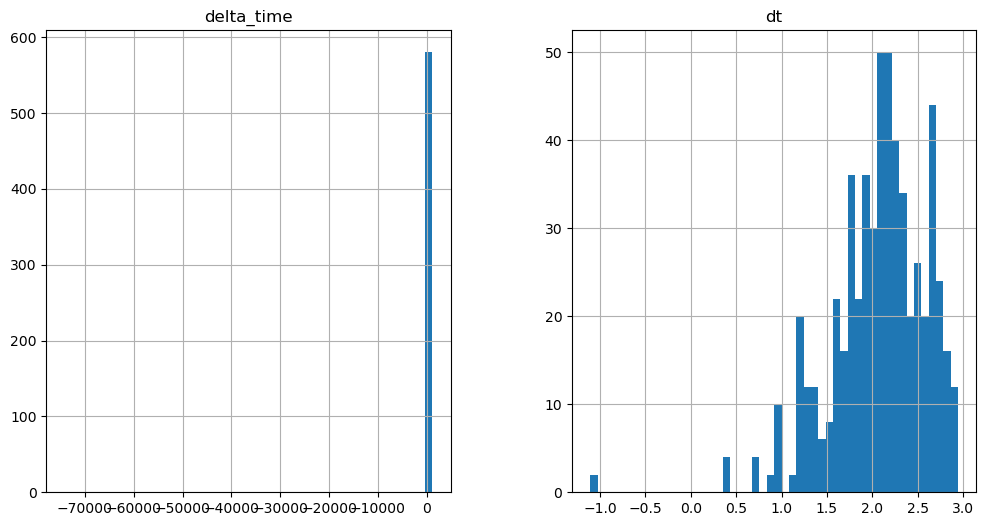

6495.588345170021 -73700.42653852701


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/Users/steven/opt/anaconda3/envs/ciao-4.15/lib/python3.10/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

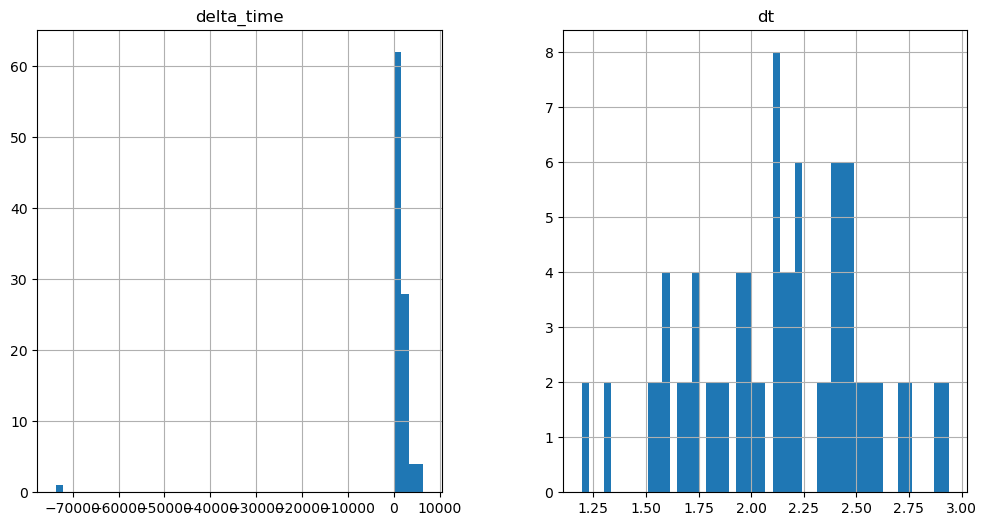

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/Users/steven/opt/anaconda3/envs/ciao-4.15/lib/python3.10/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

1771.5241086483002 -74843.75008571148


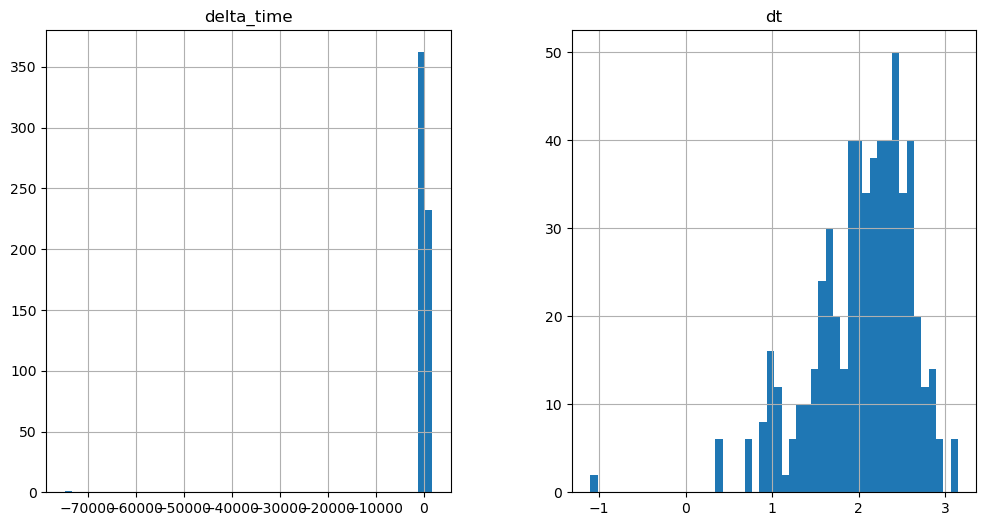

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/Users/steven/opt/anaconda3/envs/ciao-4.15/lib/python3.10/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

7299.684295415878 -69494.62848800421


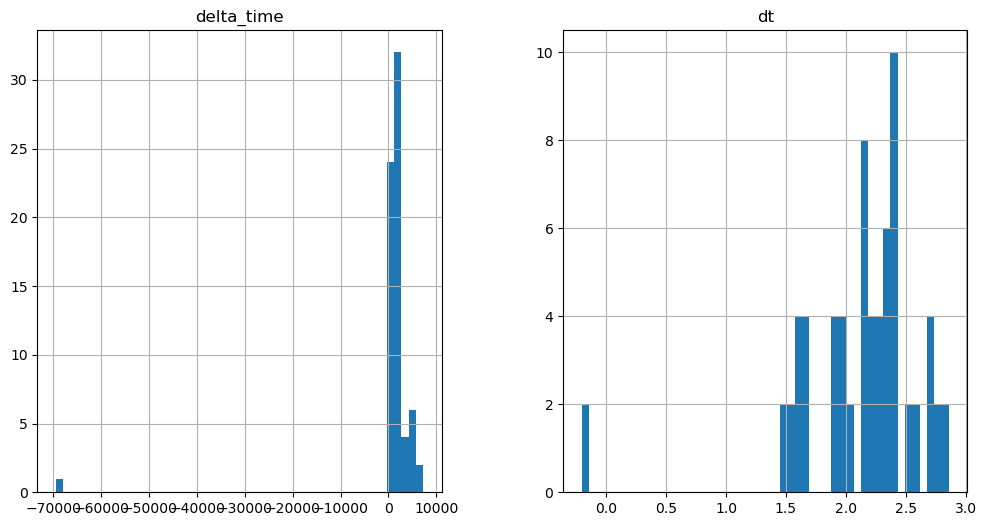

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/Users/steven/opt/anaconda3/envs/ciao-4.15/lib/python3.10/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

6454.755412995815 -73376.90369224548


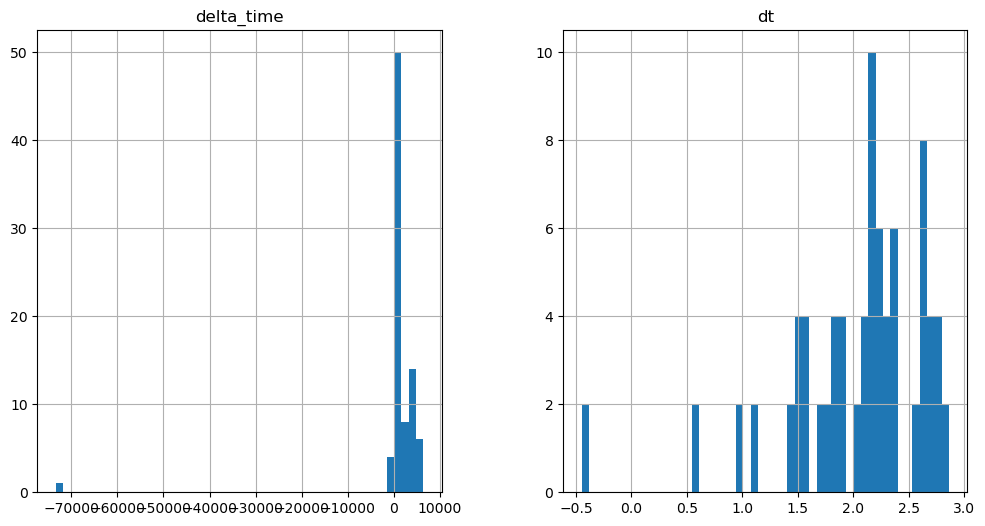

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/Users/steven/opt/anaconda3/envs/ciao-4.15/lib/python3.10/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

3844.58421254158 -73650.17062604427


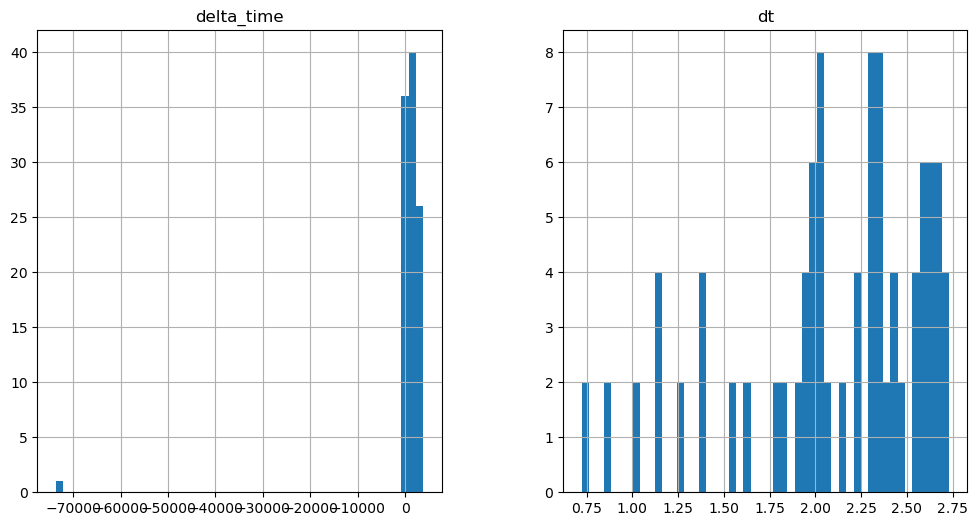

8025.255371630192 -71018.012604177


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/Users/steven/opt/anaconda3/envs/ciao-4.15/lib/python3.10/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

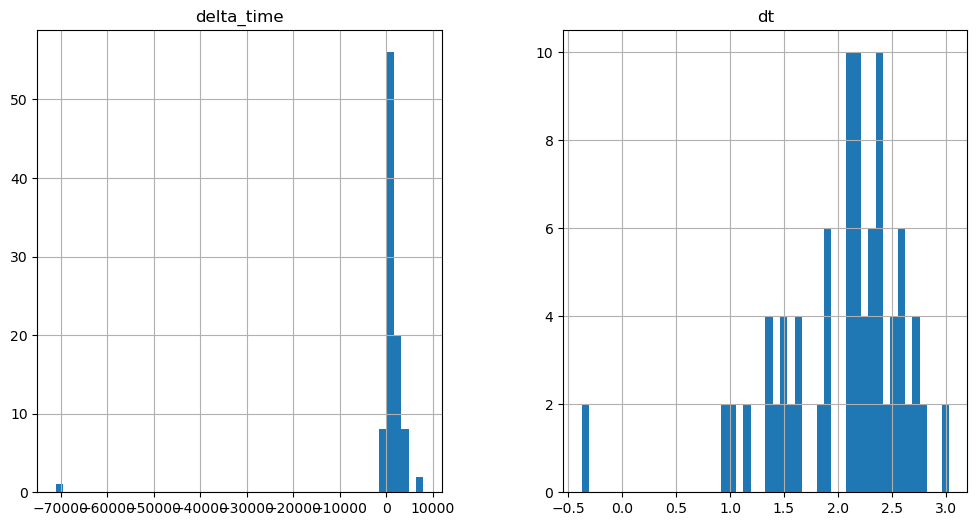

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/Users/steven/opt/anaconda3/envs/ciao-4.15/lib/python3.10/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

6951.033447861671 -73191.58478301764


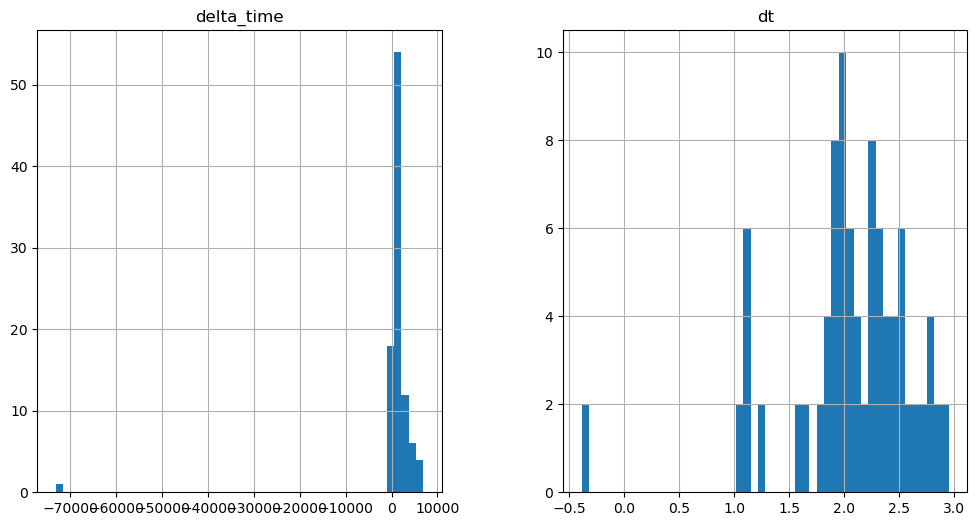

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/Users/steven/opt/anaconda3/envs/ciao-4.15/lib/python3.10/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

4152.4018877744675 -74159.01232141256


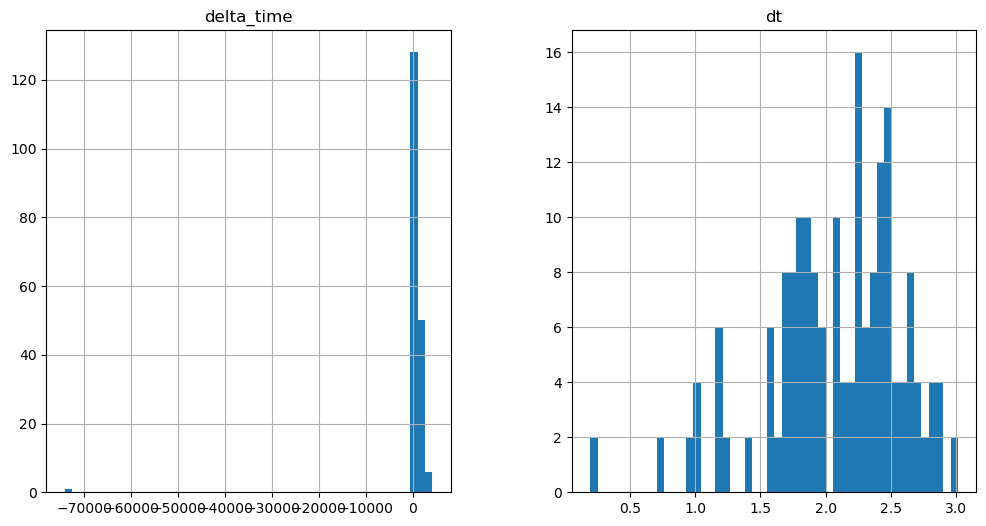

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/Users/steven/opt/anaconda3/envs/ciao-4.15/lib/python3.10/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

4513.61719584465 -74005.1033937335


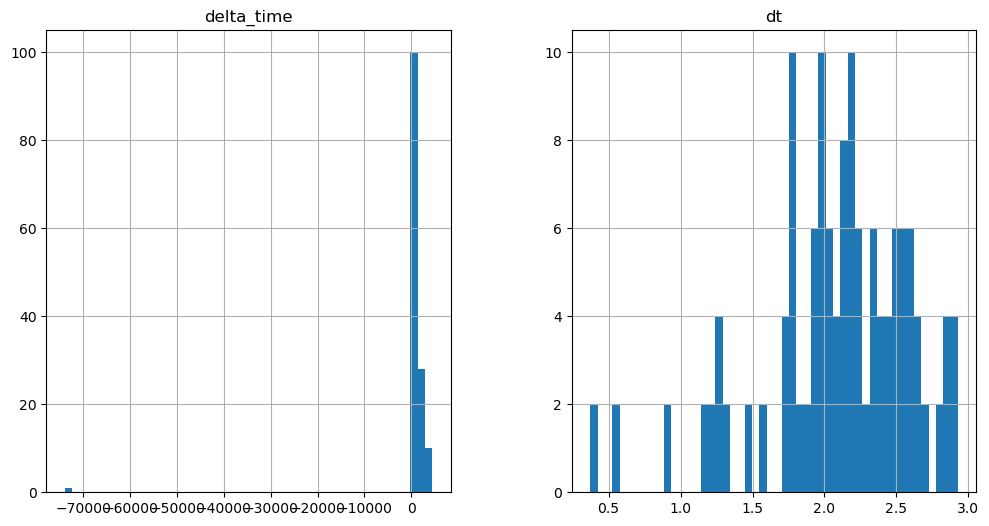

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/Users/steven/opt/anaconda3/envs/ciao-4.15/lib/python3.10/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

2644.722172319889 -74608.17524385452


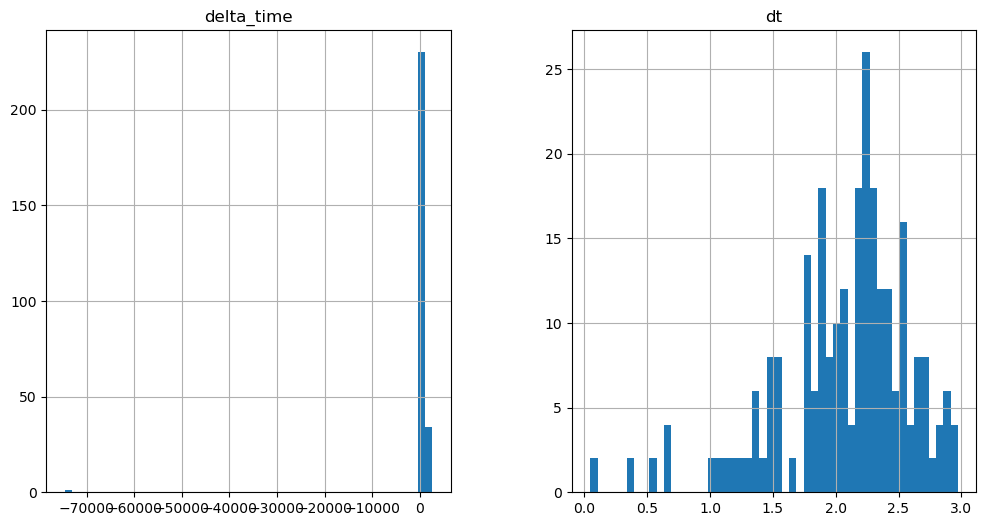

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/Users/steven/opt/anaconda3/envs/ciao-4.15/lib/python3.10/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

2930.5531966090202 -72516.27003920078


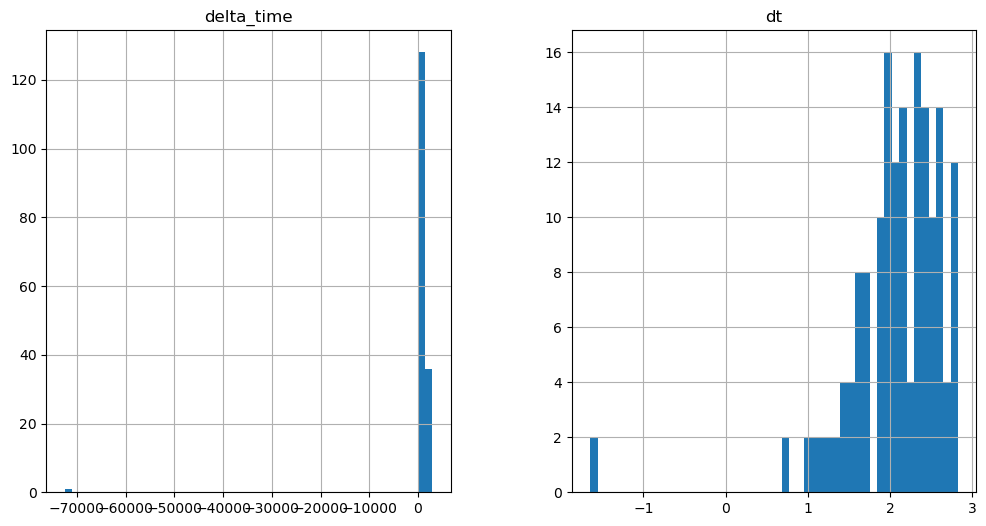

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/Users/steven/opt/anaconda3/envs/ciao-4.15/lib/python3.10/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

5503.032325446606 -73571.64506208897


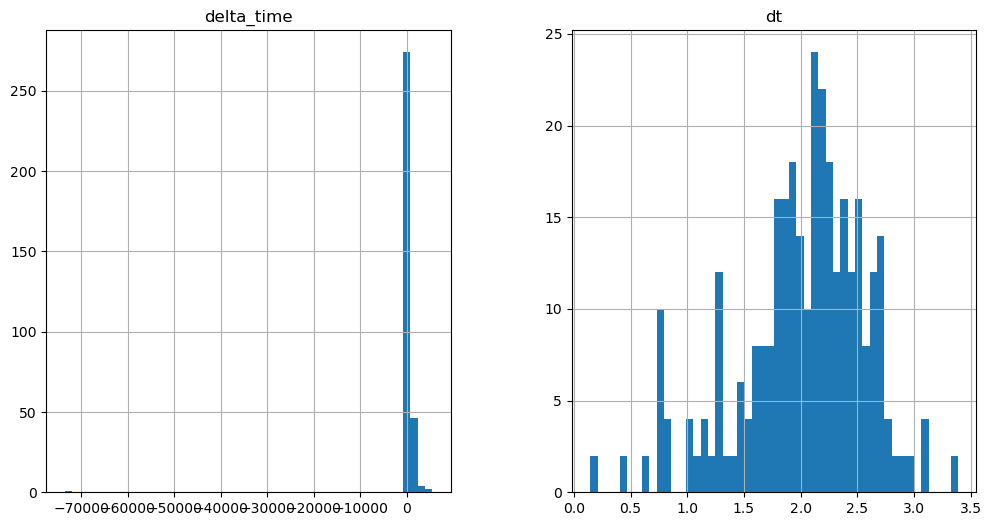

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/Users/steven/opt/anaconda3/envs/ciao-4.15/lib/python3.10/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

888.903014600277 -74828.04507499933


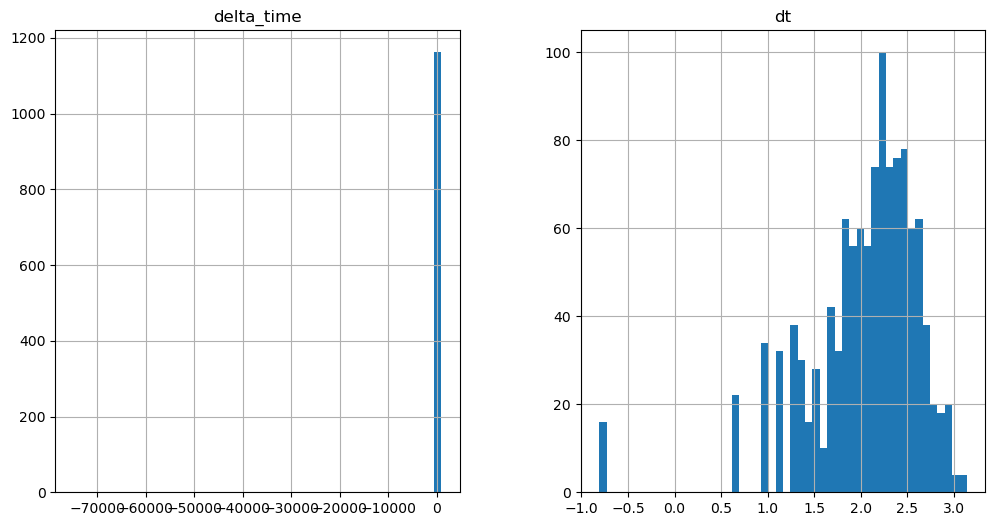

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))


766.4040383696556 -74900.2880885601


/Users/steven/opt/anaconda3/envs/ciao-4.15/lib/python3.10/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-c

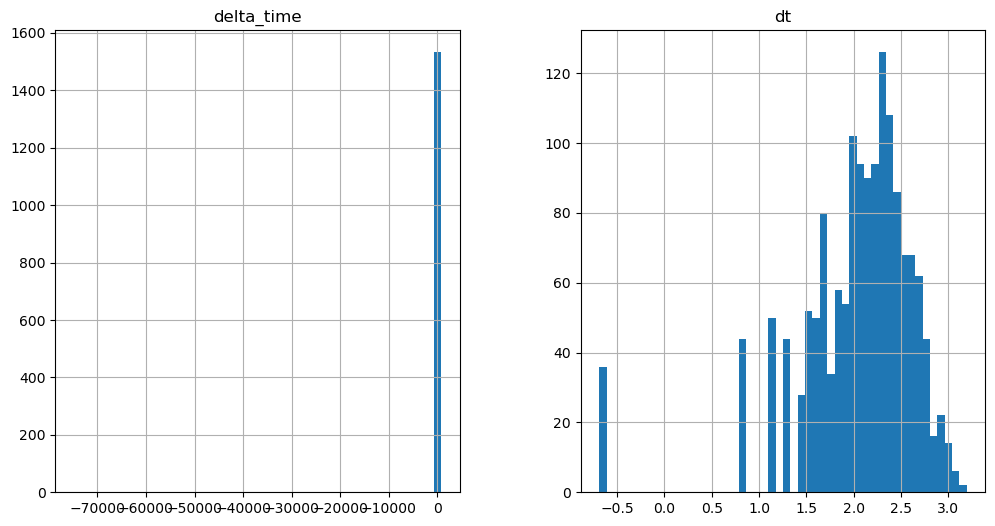

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

888.9052641391754 3.141010105609894


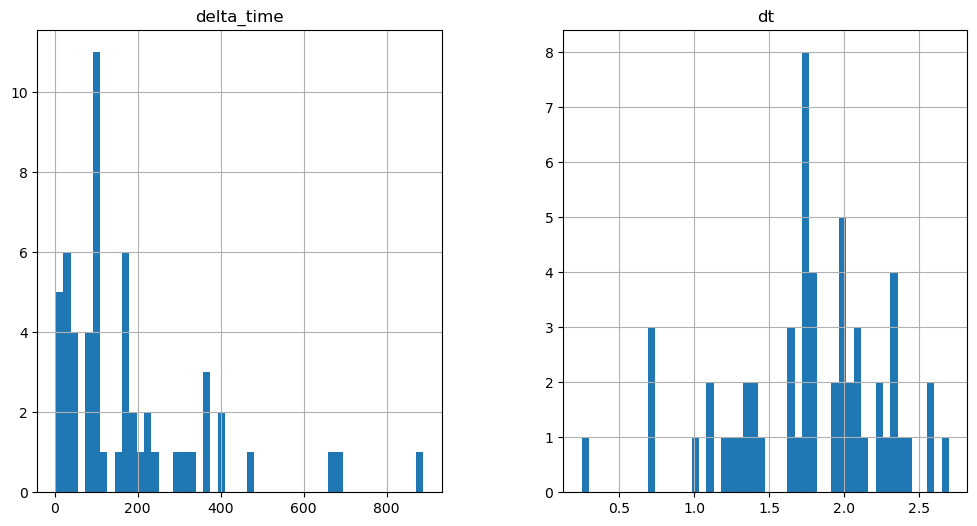

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

810.3799400925636 25.12807124853134


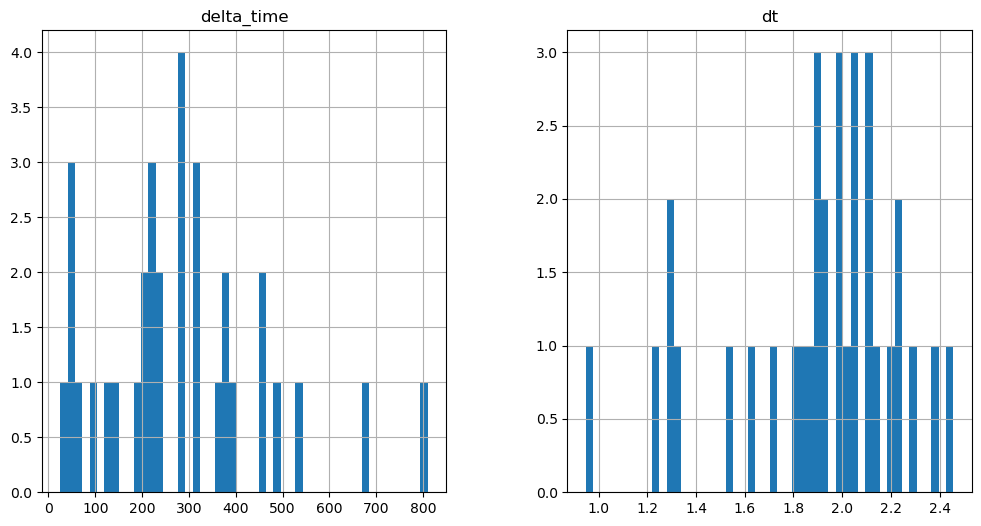

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

615.6395406723022 0.1


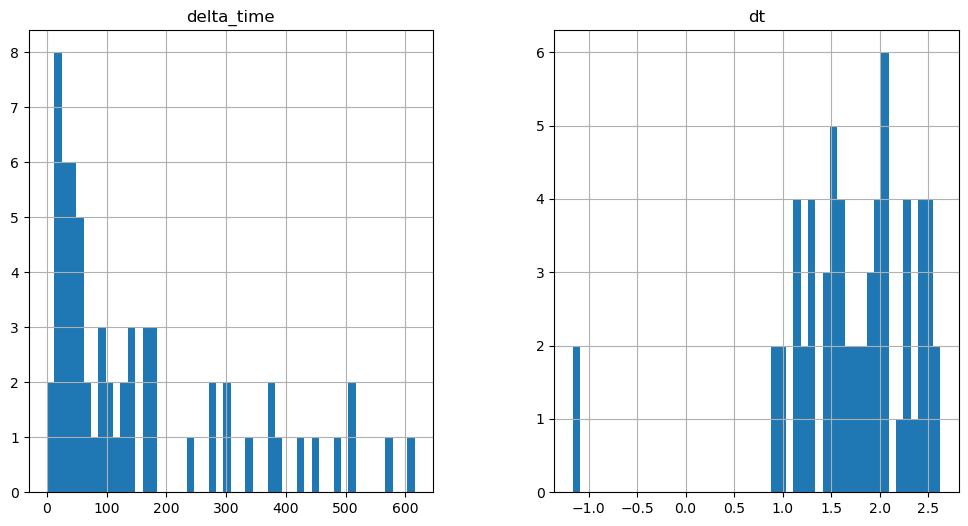

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

568.5238782167435 0.1


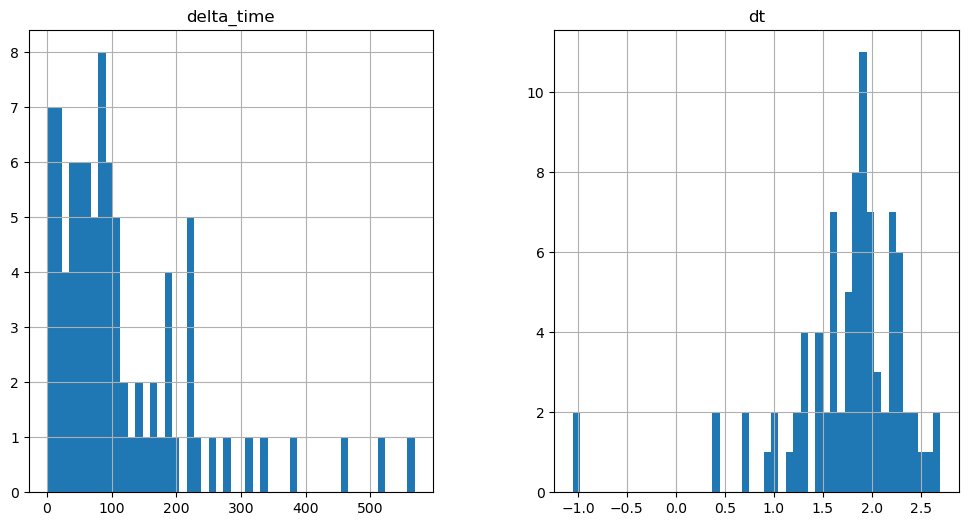

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

697.3058446645737 6.282030344009399


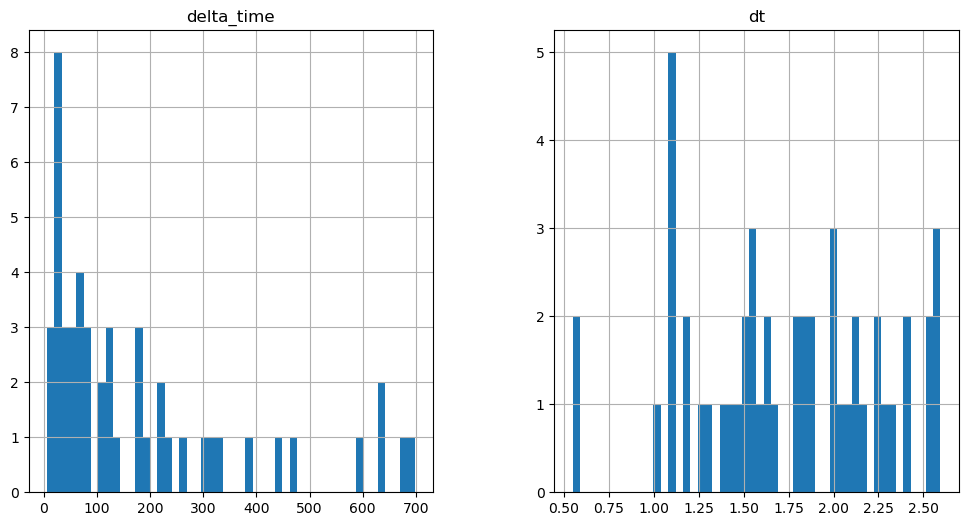

650.190502345562 3.1410102248191833


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

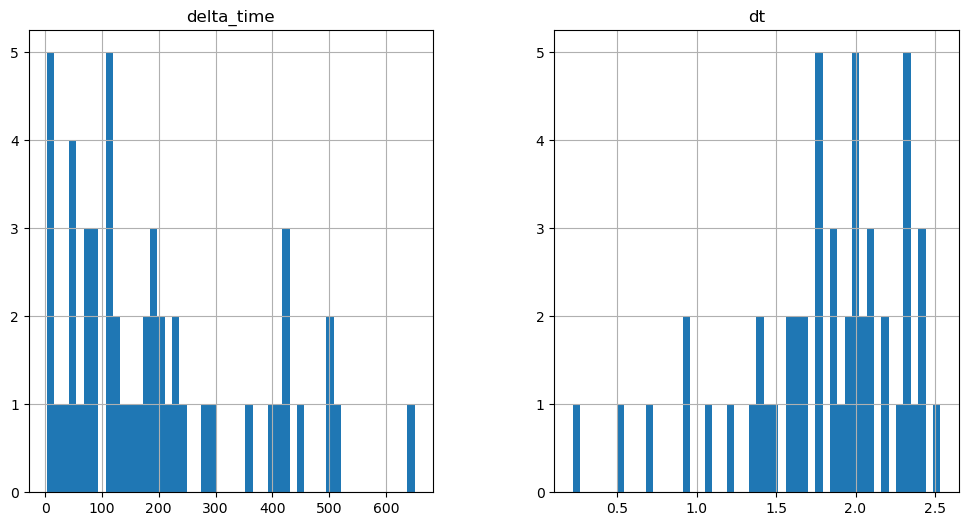

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

998.8431796431541 3.1410102248191833


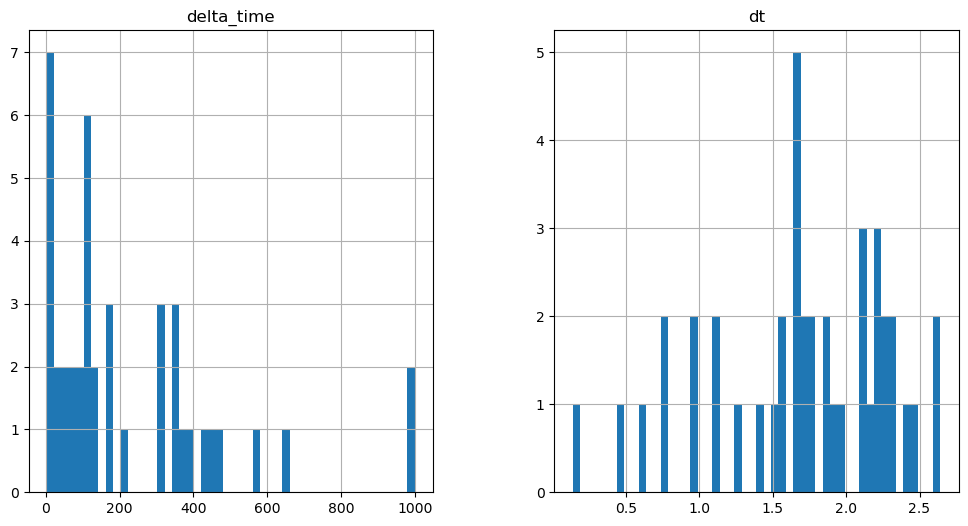

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

873.2025234103203 0.1


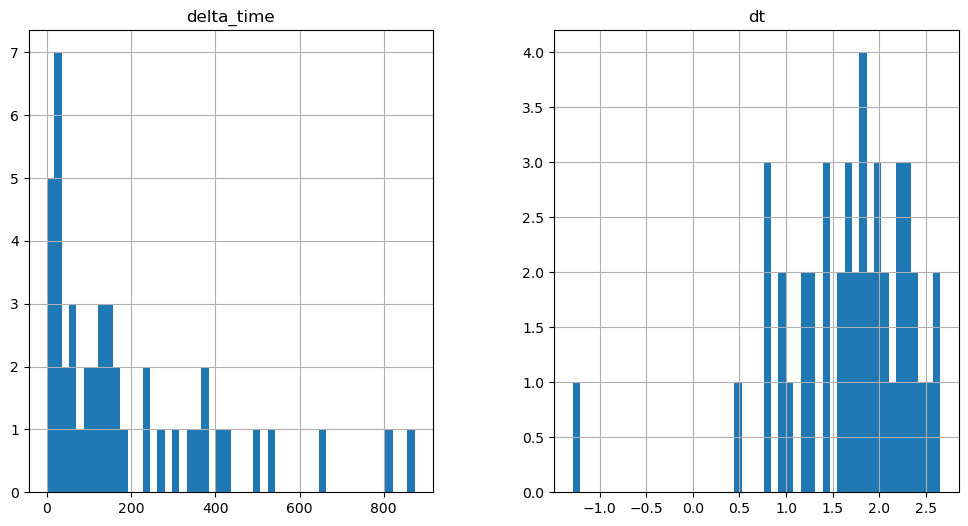

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

719.293145775795 0.1


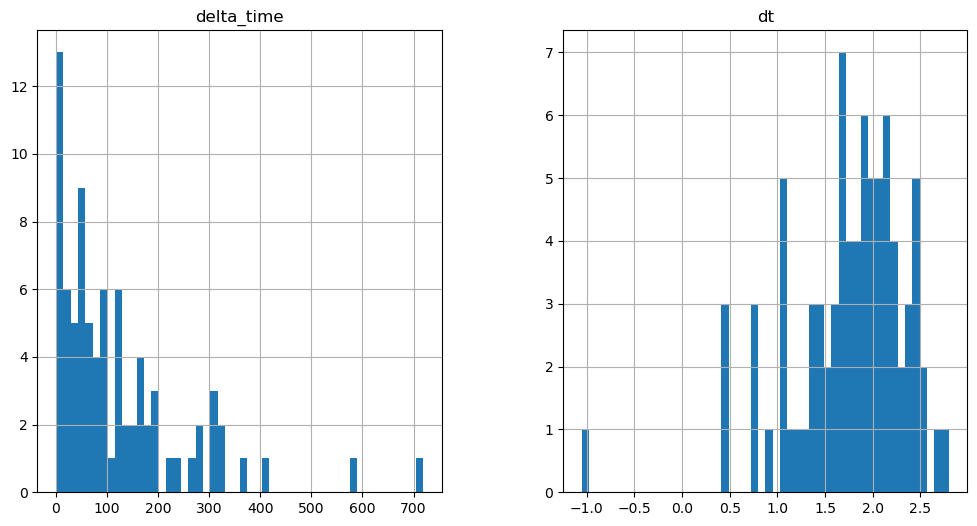

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

439.74235159158707 0.1


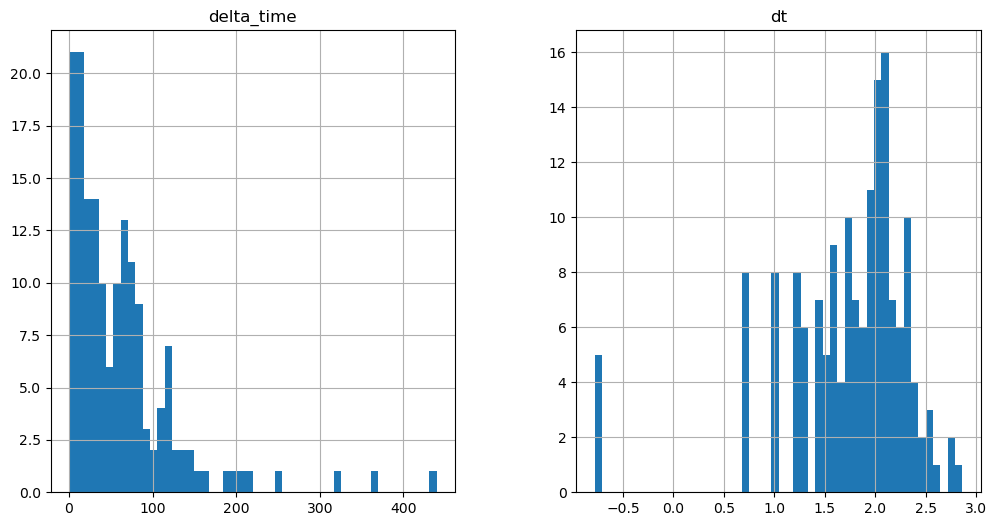

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

241.85850203037262 0.1


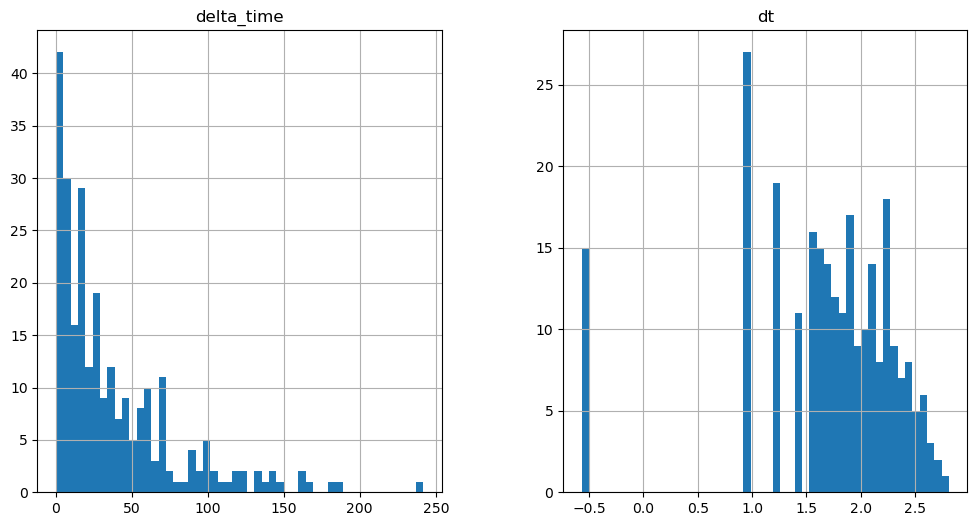

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

684.742183804512 3.1410101652145386


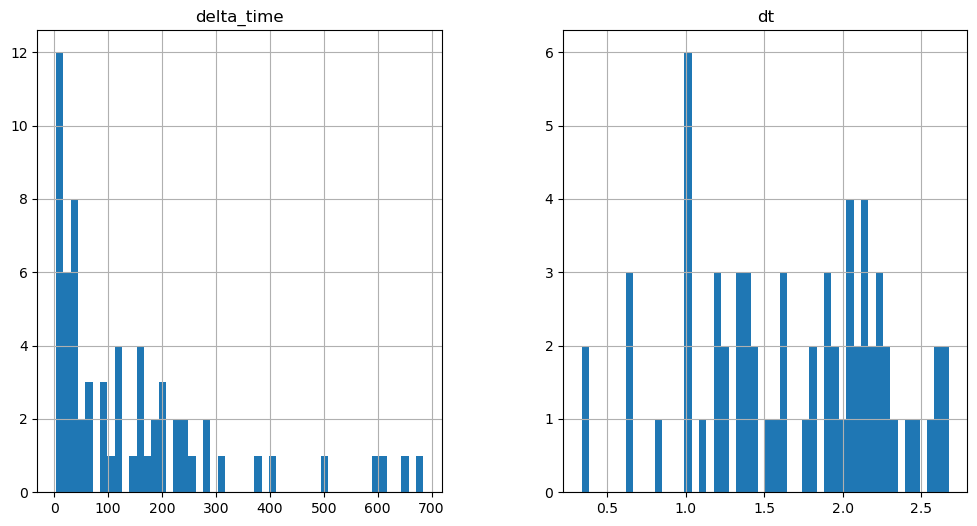

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

637.6265214681625 3.141010105609894


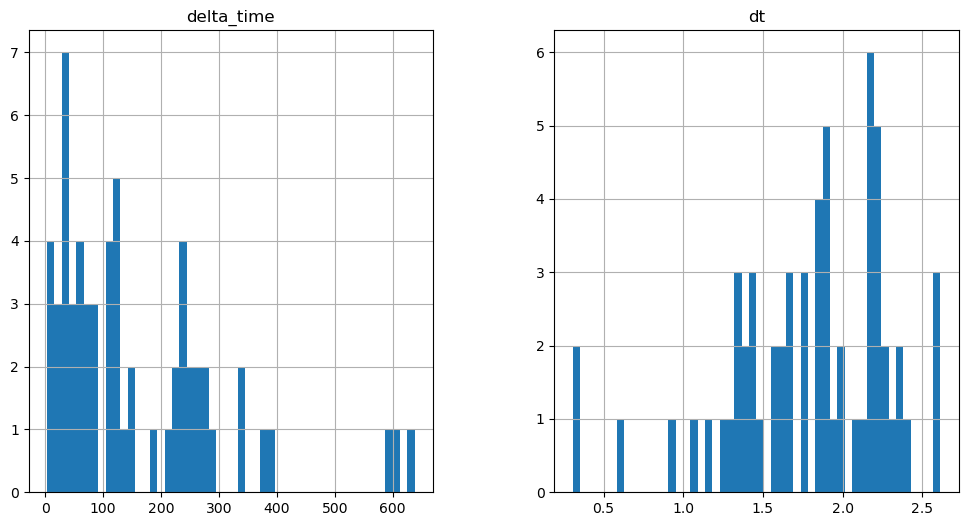

468.0102832913399 3.140990197658539


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

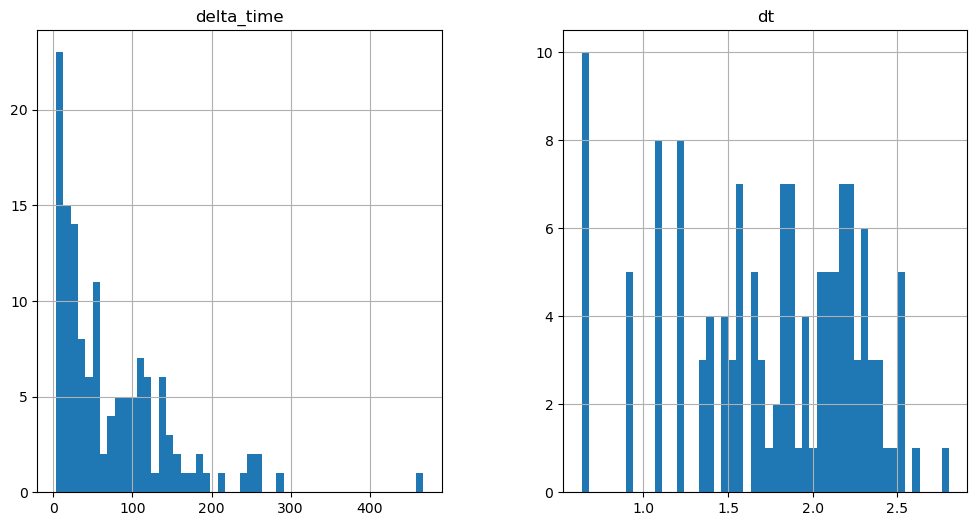

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

791.5399395823479 3.1410102248191833


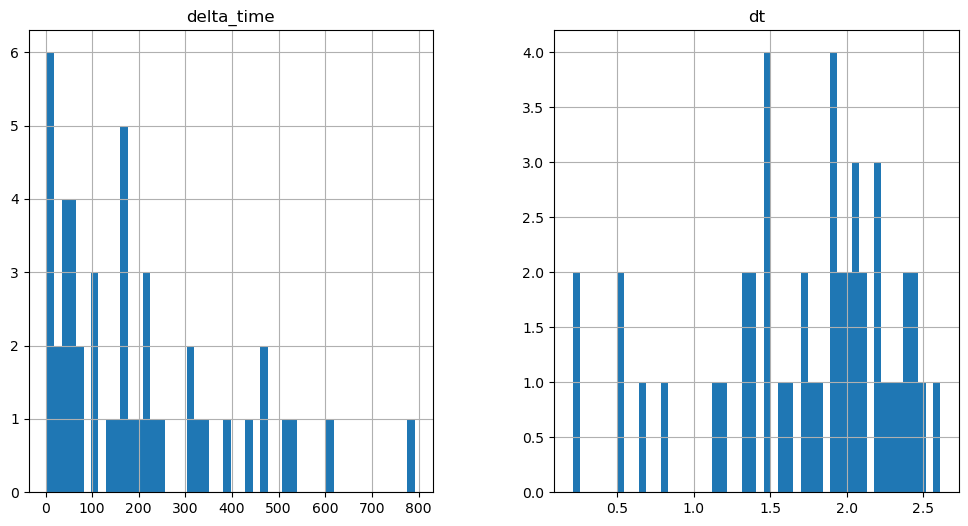

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

659.6147730946541 0.1


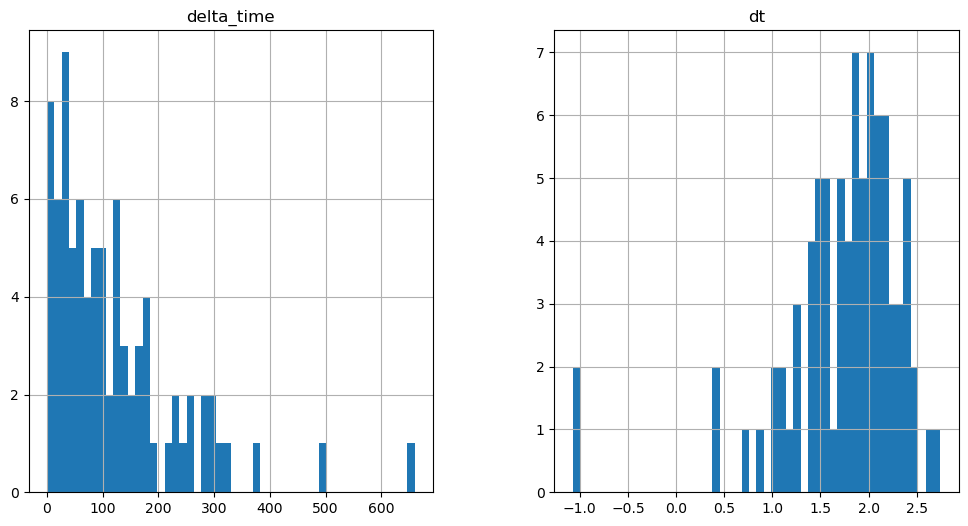

64.8199424892664 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

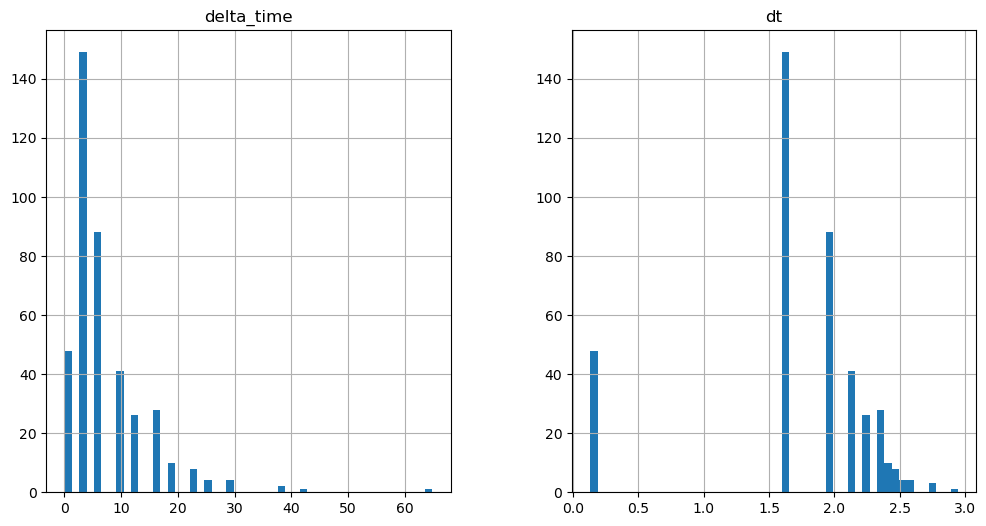

292.11346447467804 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

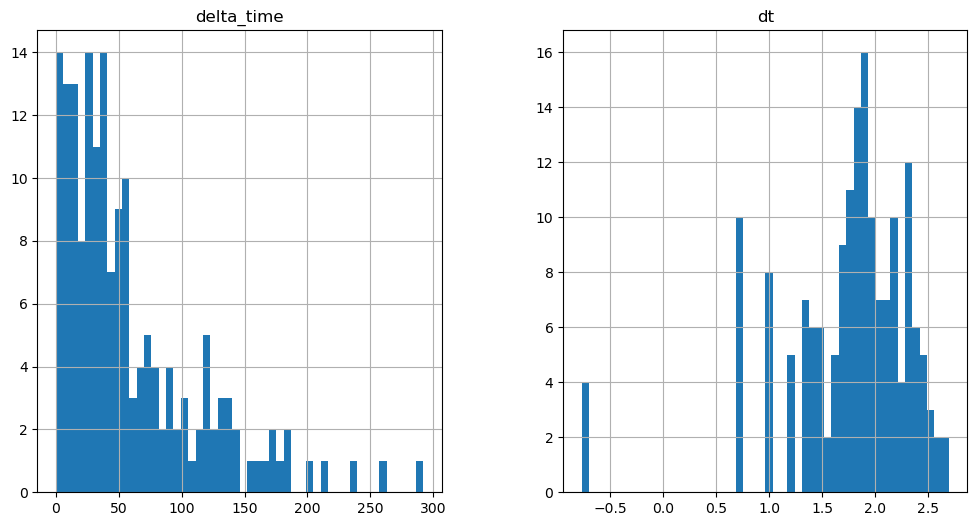

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

621.9227809309959 0.1


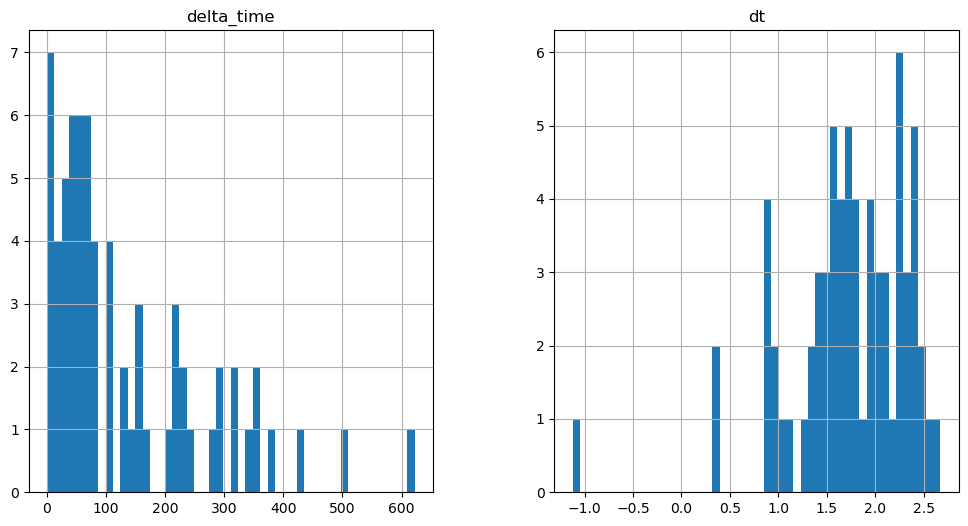

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

901.4743846058846 18.84612101316452


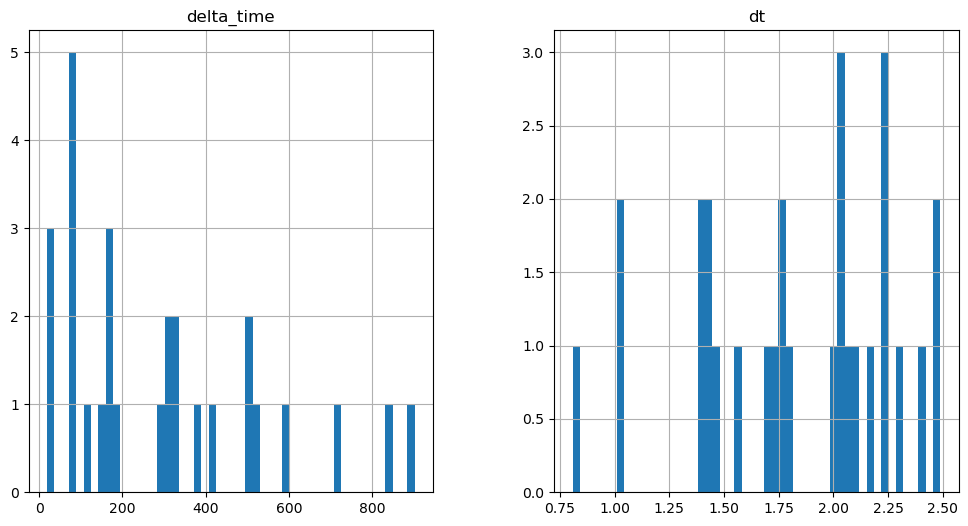

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

552.8187376856804 0.1


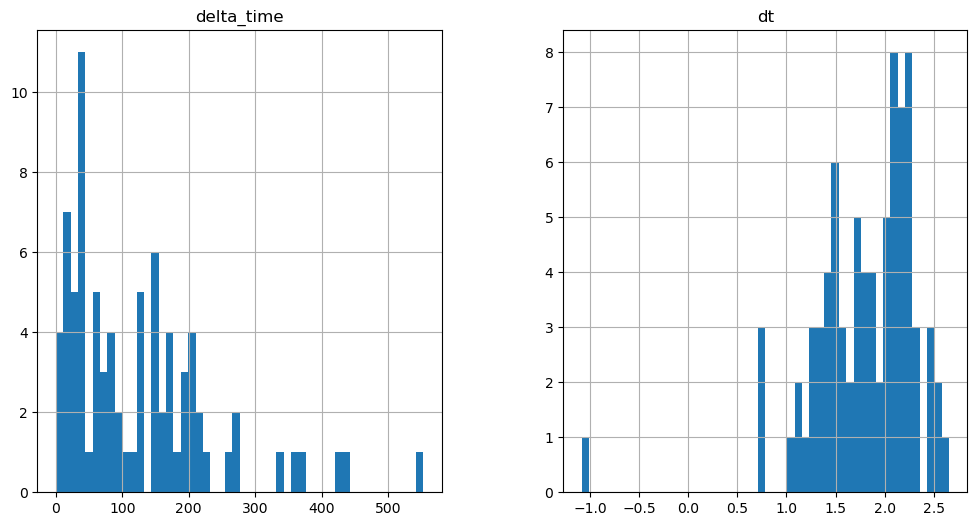

552.8187376856804 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

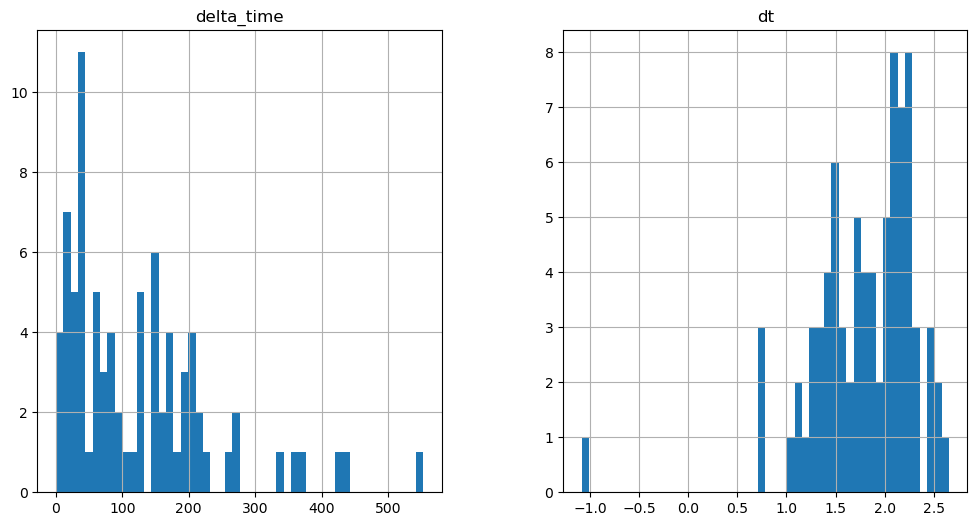

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2271.9601821303368 3.2410301566123962


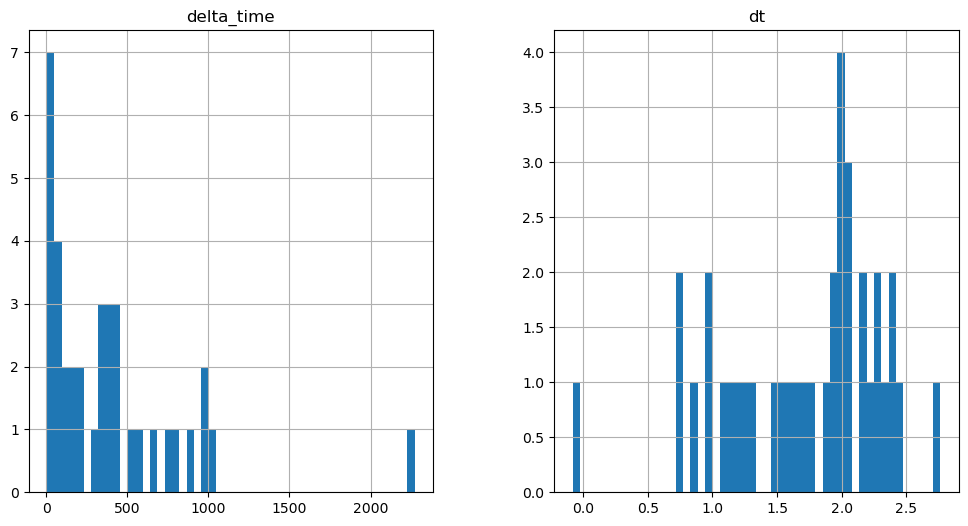

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1043.6100915074348 9.723070442676544


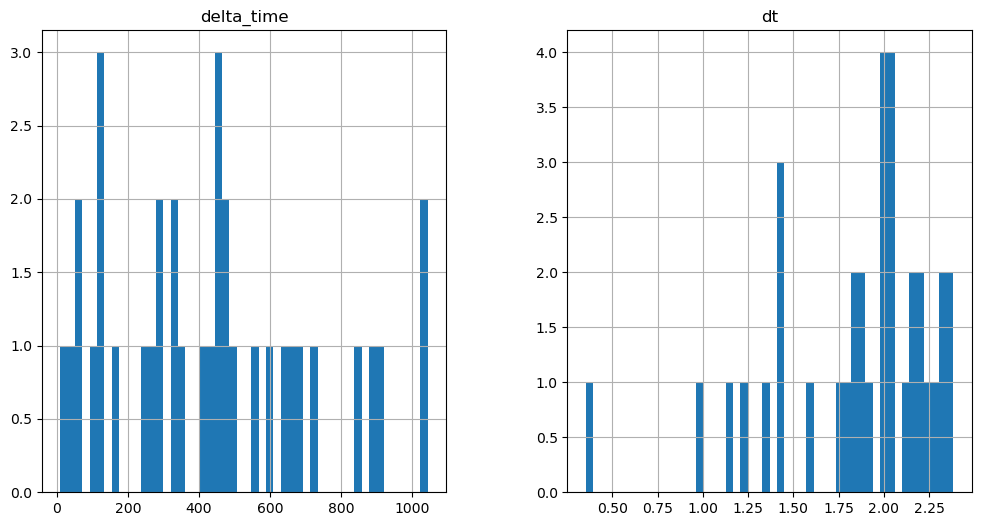

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1173.2504277825356 3.2410300970077515


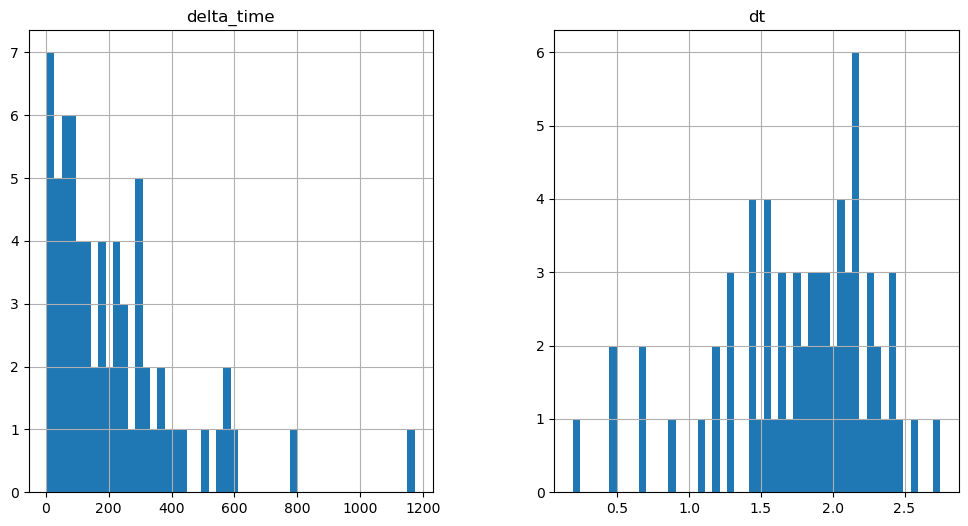

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1691.8157134056091 3.241040050983429


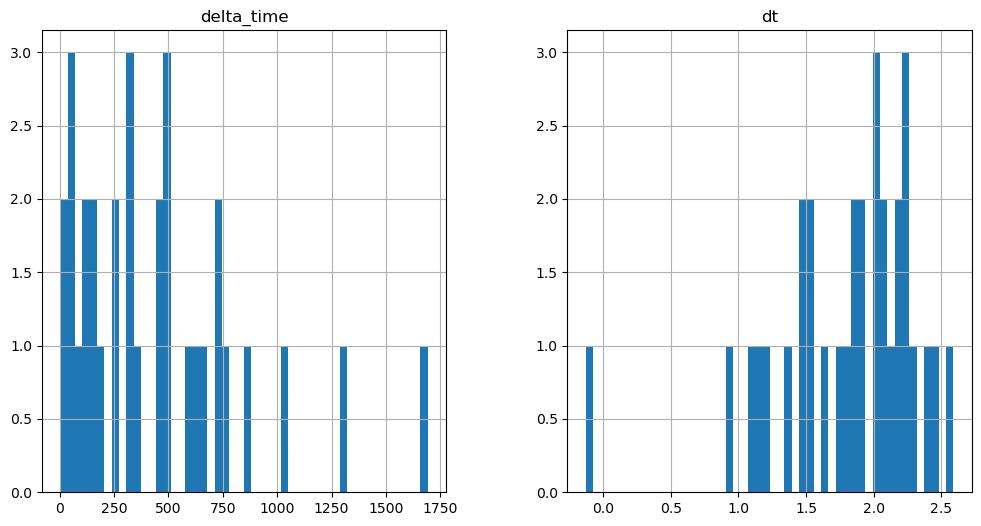

700.061964571476 3.2410202026367188


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

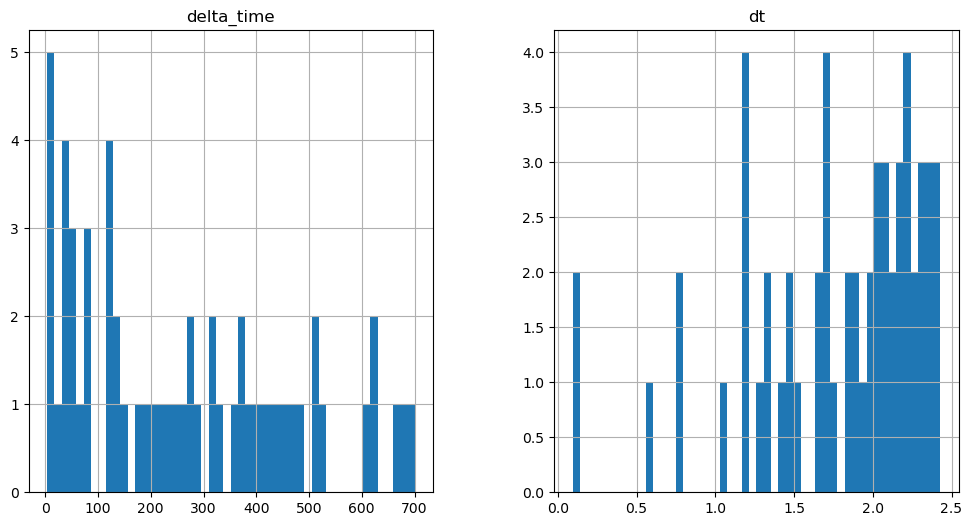

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1458.4510825872421 16.205040752887726


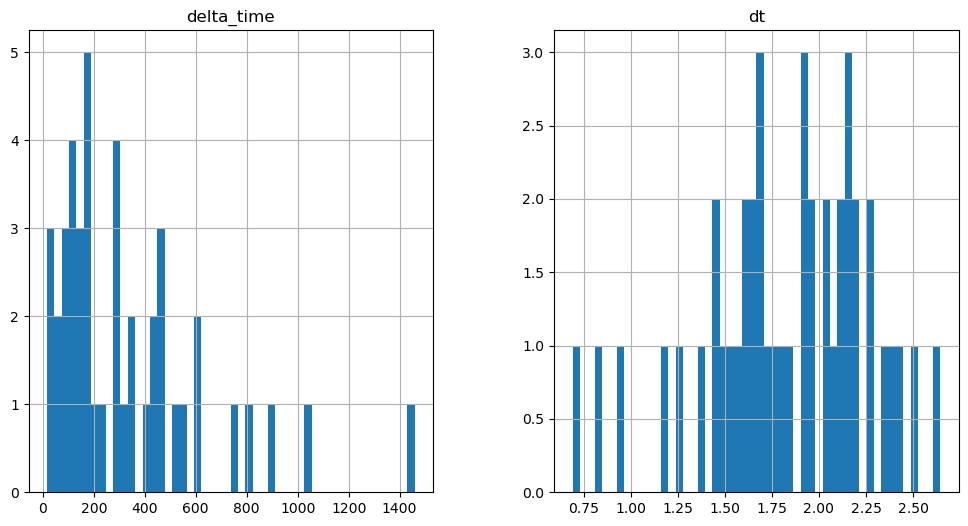

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

755.1536875963211 6.481980383396149


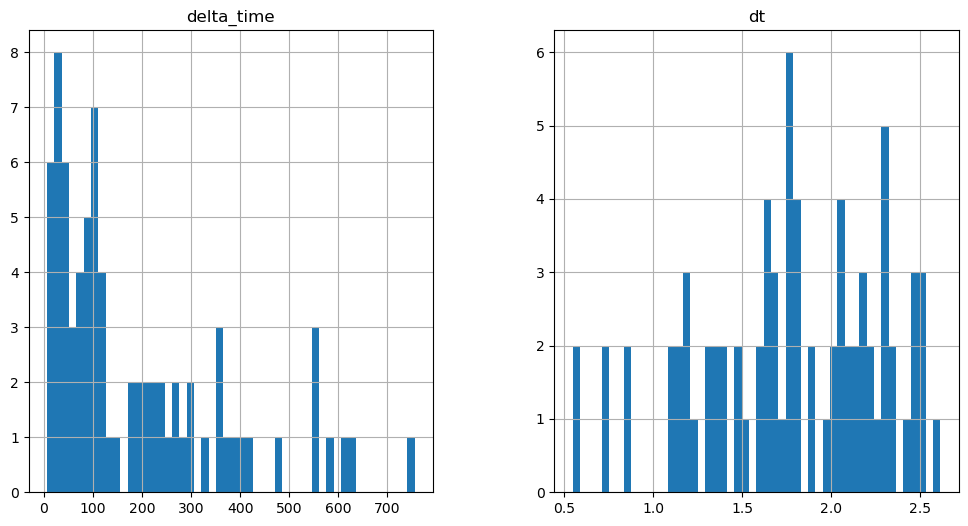

2651.1403218507767 16.20501083135605


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

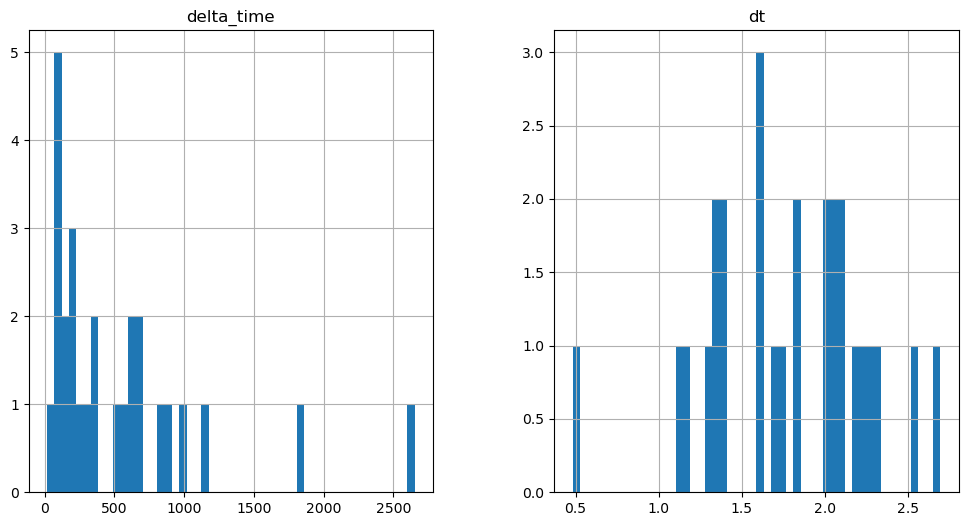

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

531.5244363546371 0.1


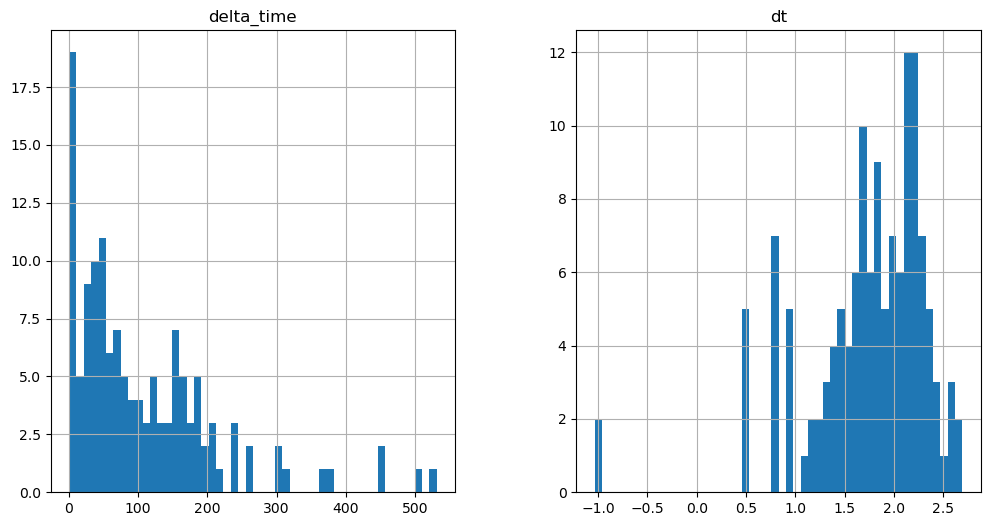

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2732.1654757857323 45.37403231859207


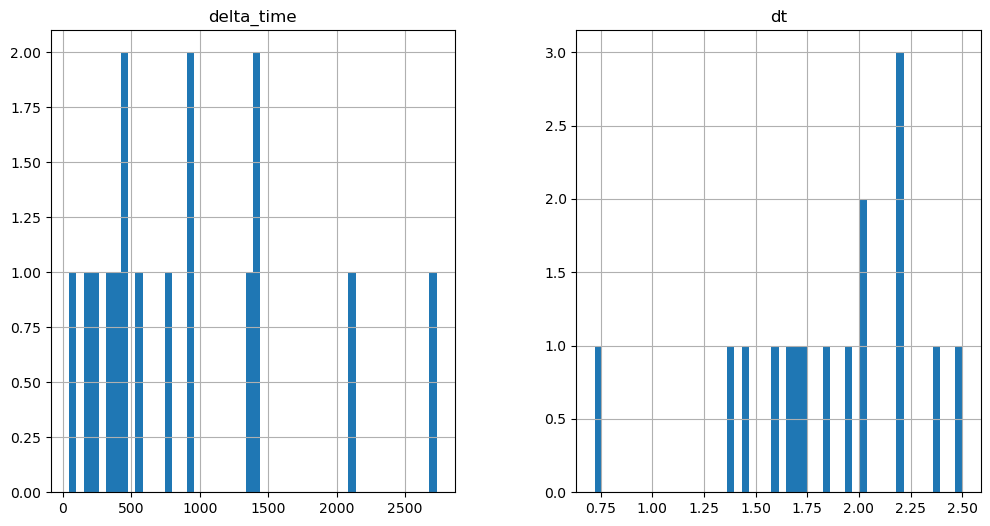

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1101.9476544260979 3.241020143032074


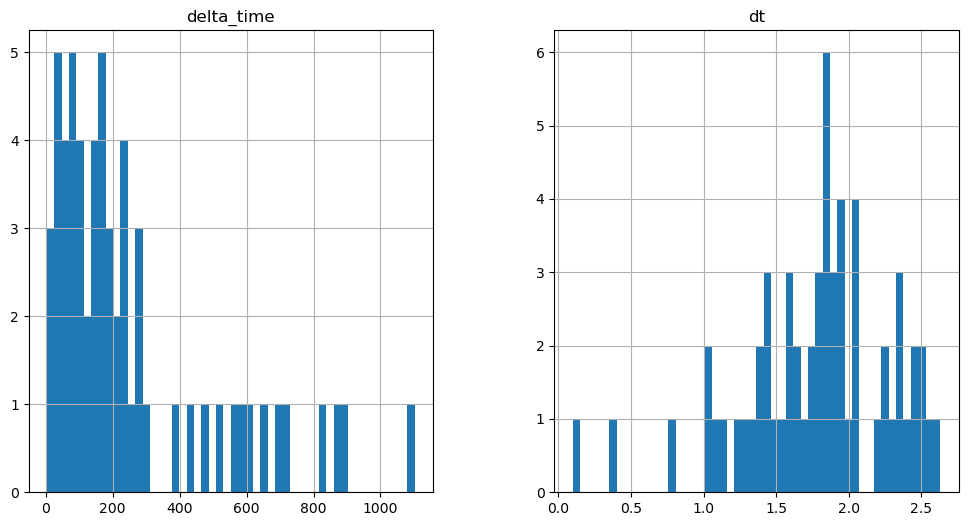

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

787.5676087737083 0.1


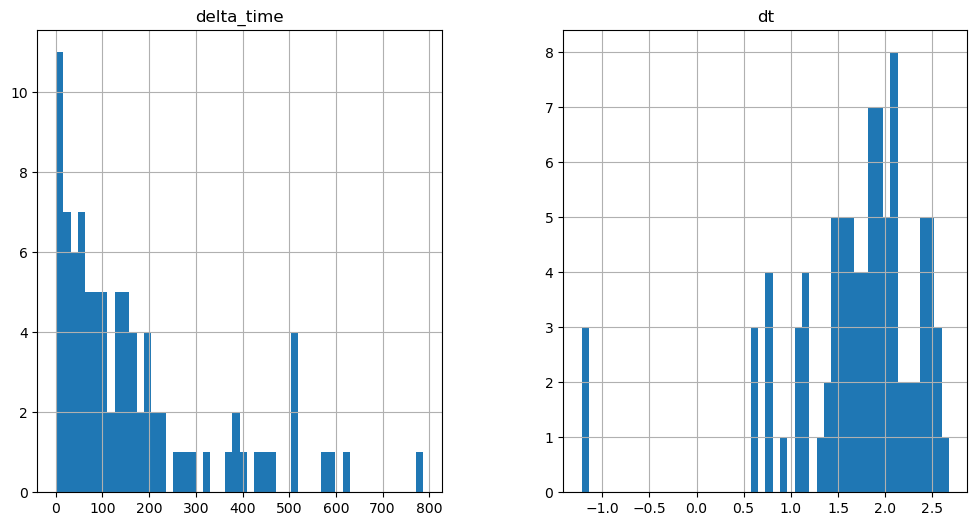

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1231.5835708379745 0.1


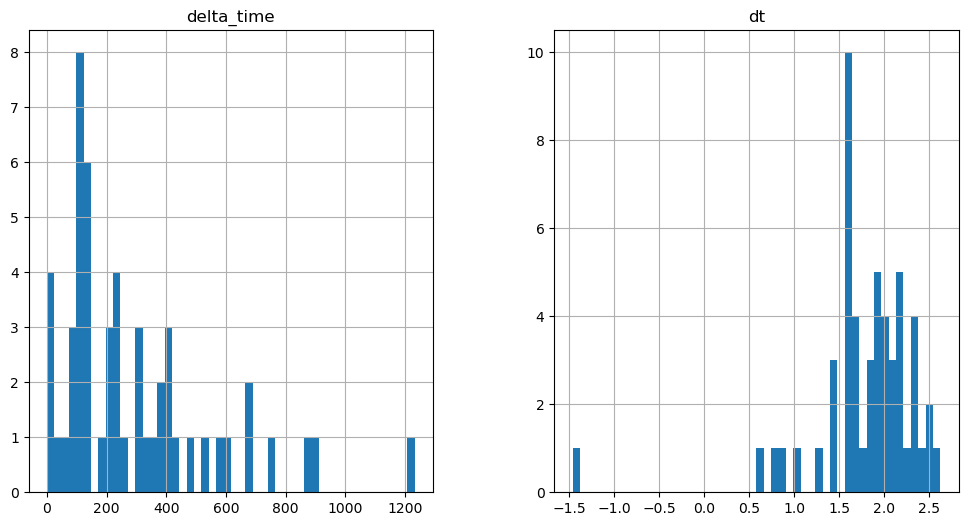

2728.9284766316414 58.338192880153656


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

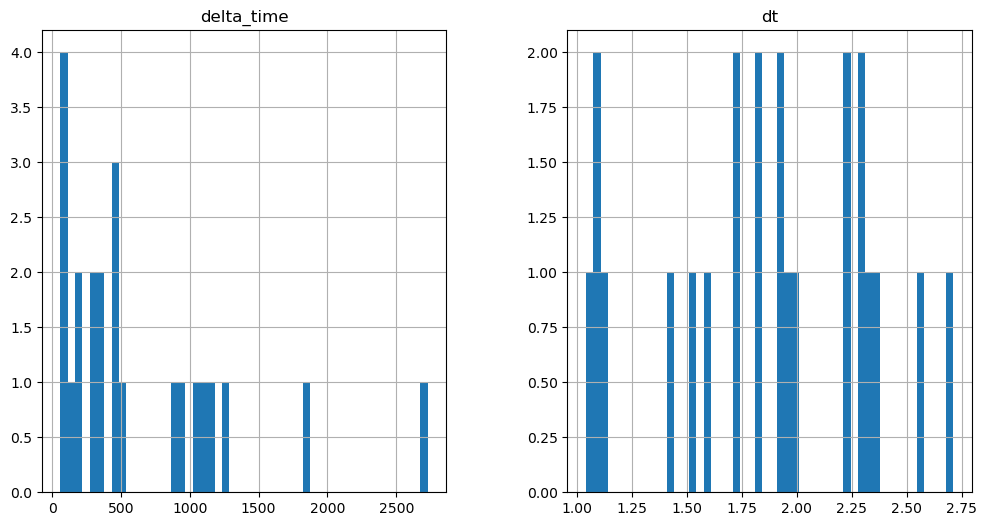

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1759.869108080864 0.1


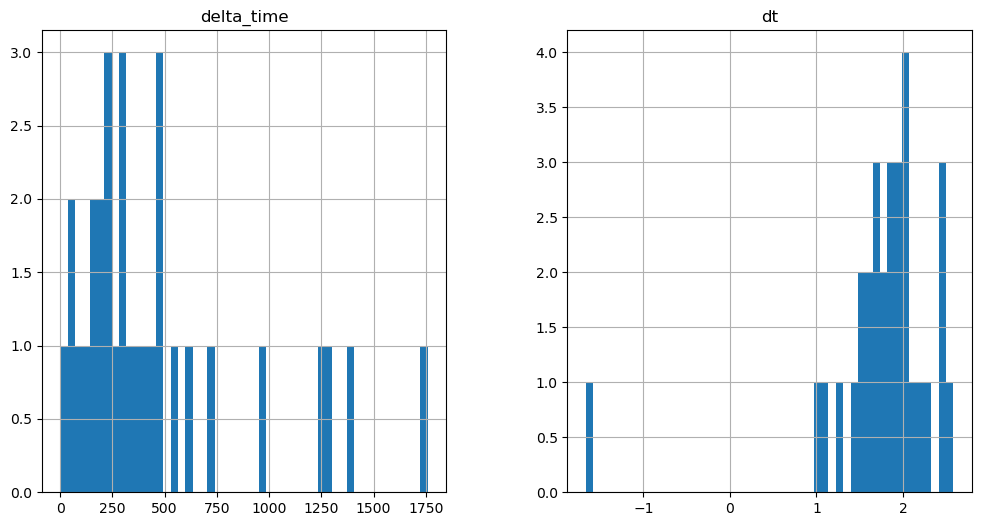

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1144.076597392559 6.482020258903503


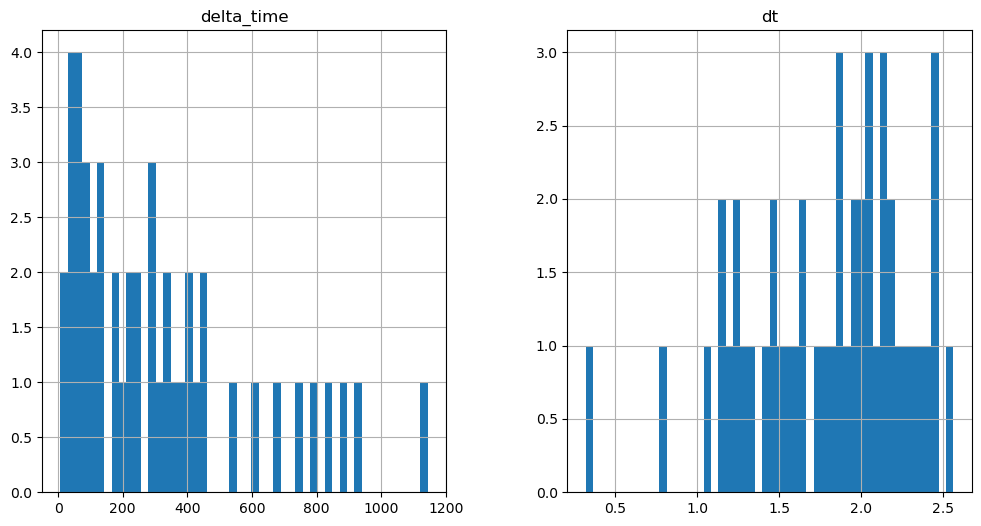

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1714.5021248459816 0.1


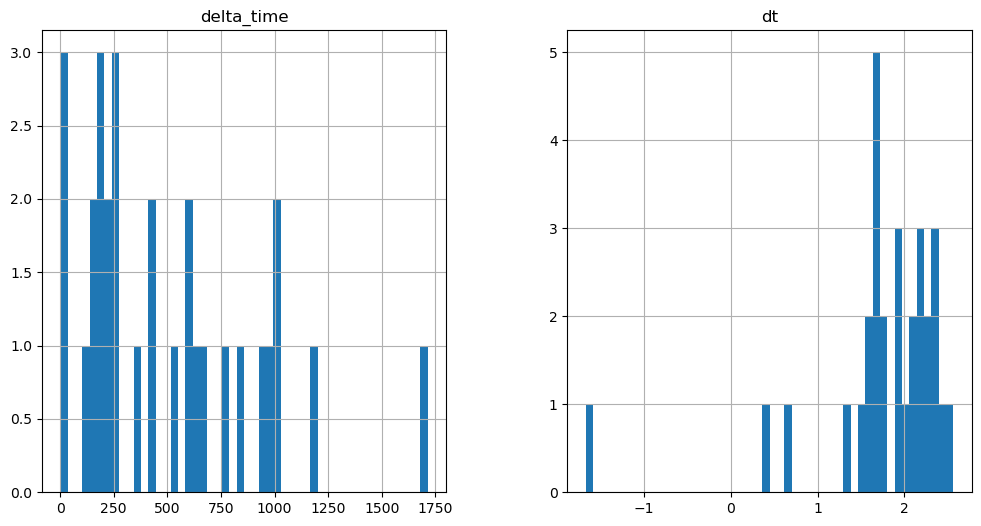

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

764.8805978298187 3.241020083427429


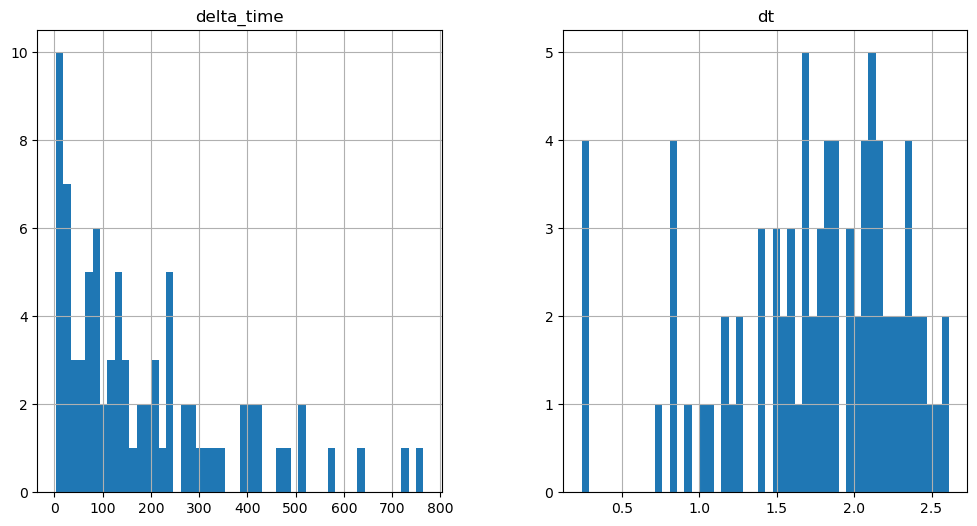

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1364.4661374092102 16.205130696296692


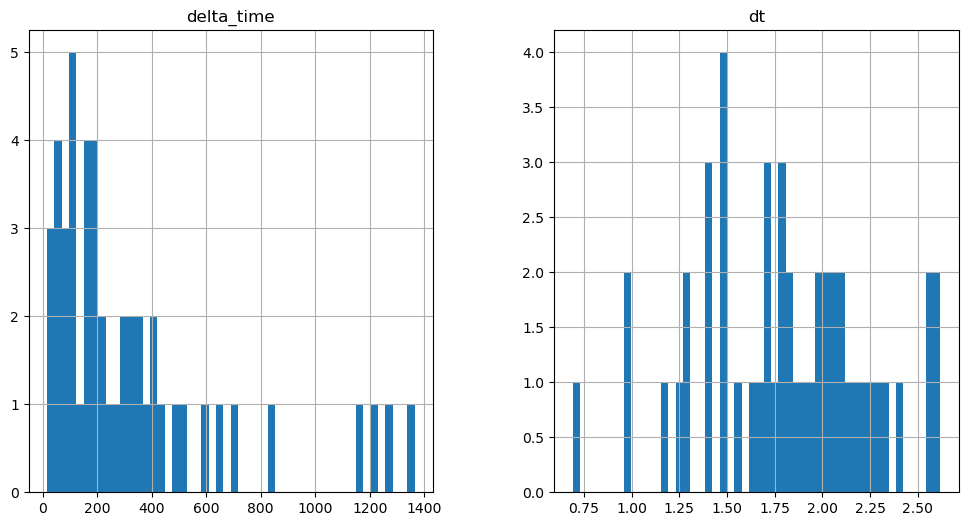

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

431.0561811327934 0.1


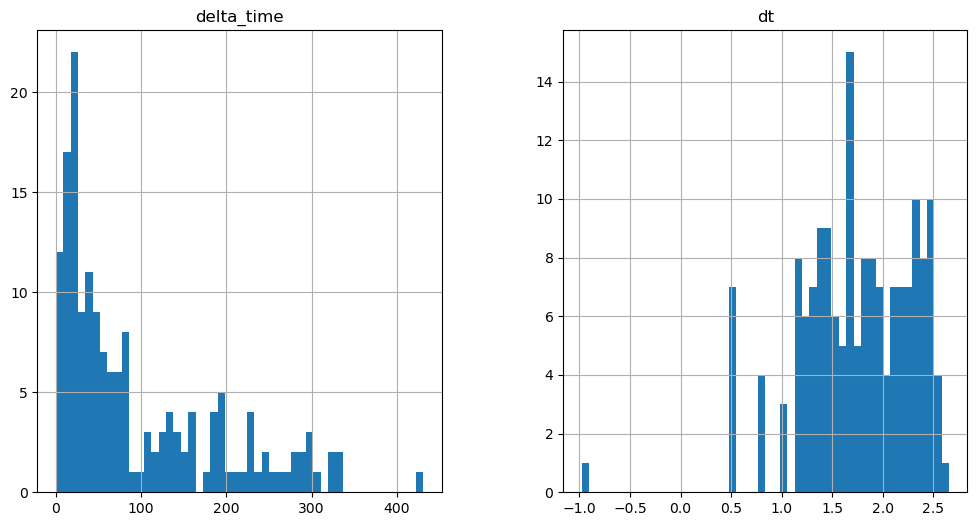

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1614.0304697752 3.2410200238227844


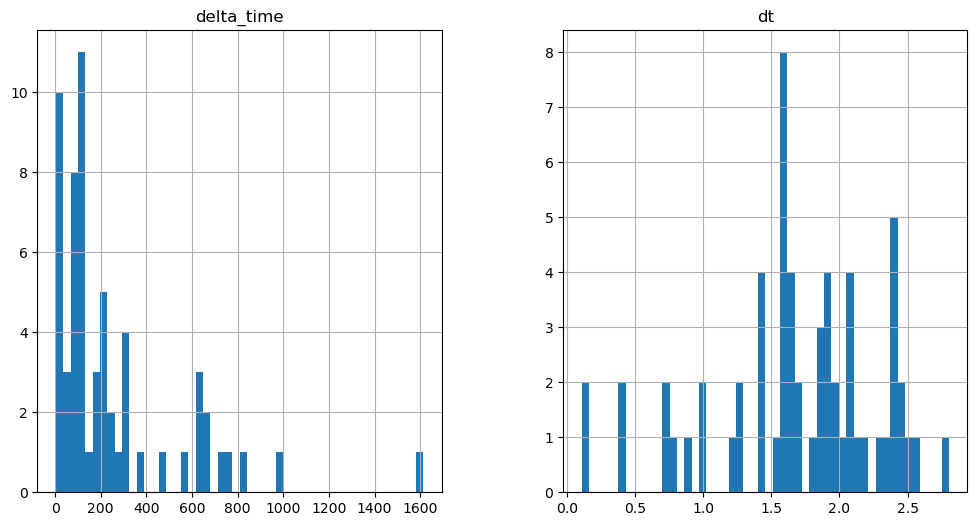

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1140.8402563333511 3.241020143032074


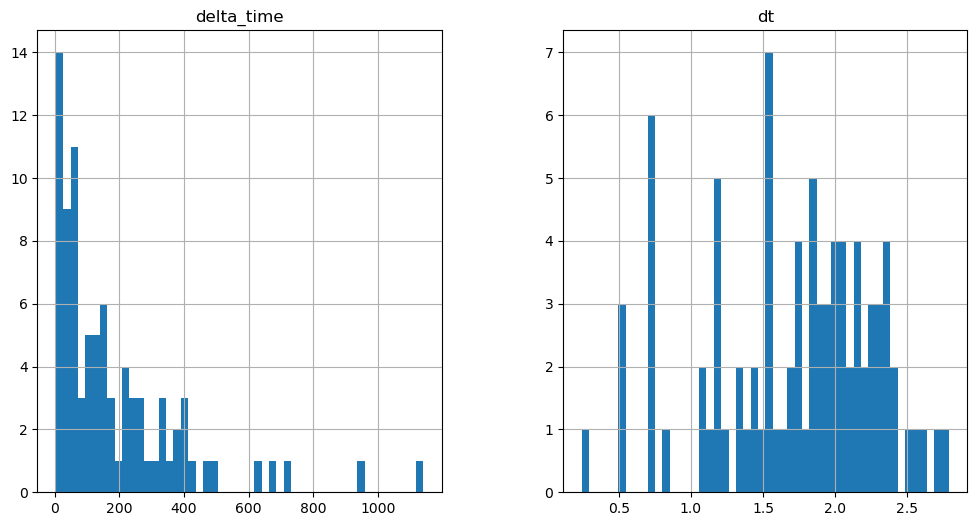

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1212.141999900341 0.1


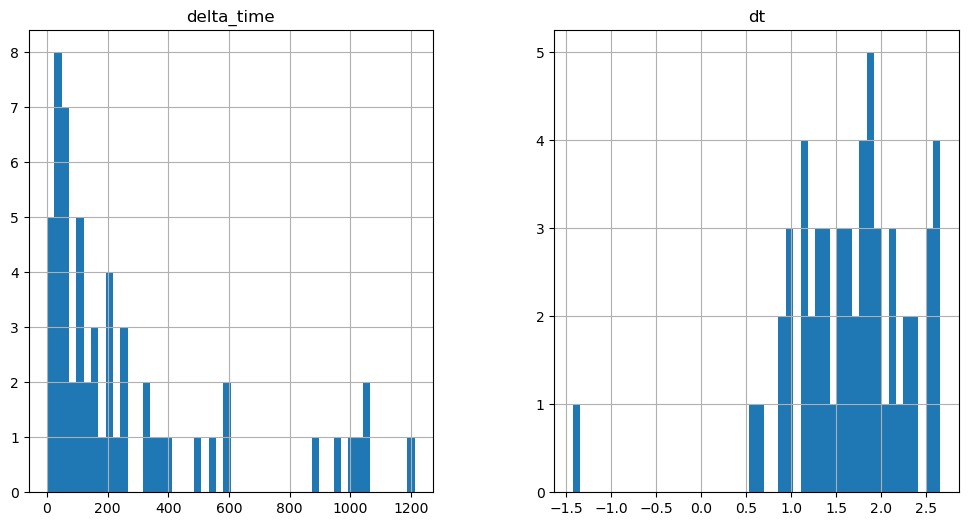

424.57367104291916 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

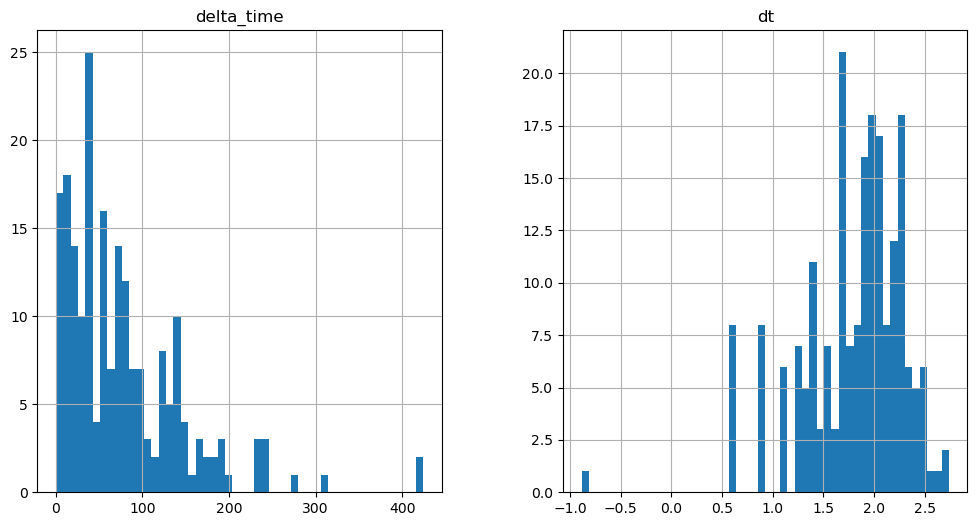

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1179.729608297348 3.241020083427429


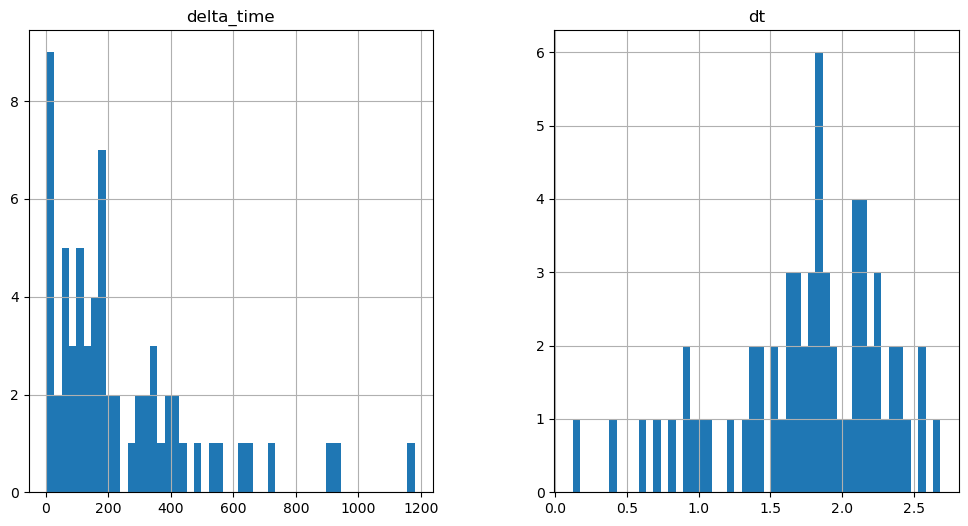

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2346.491906642914 32.41016173362732


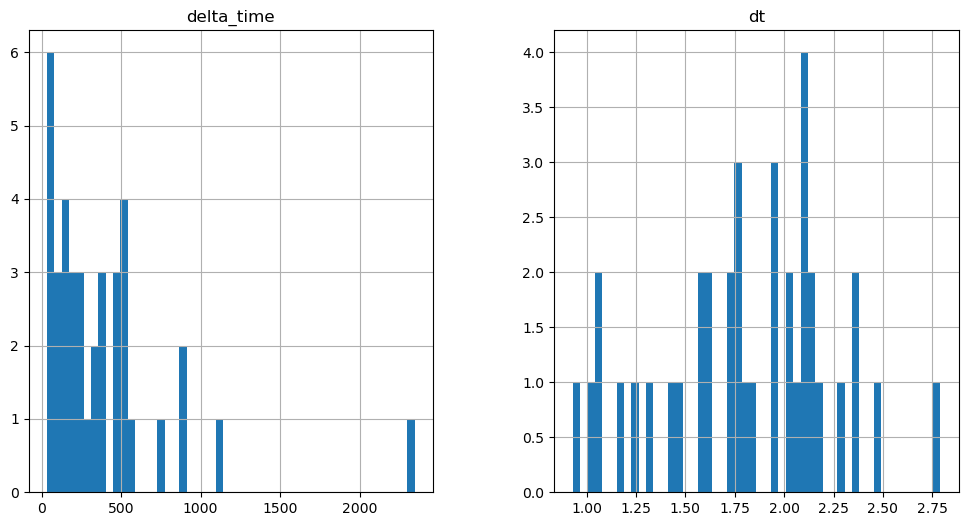

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

499.1183148622513 3.2410101890563965


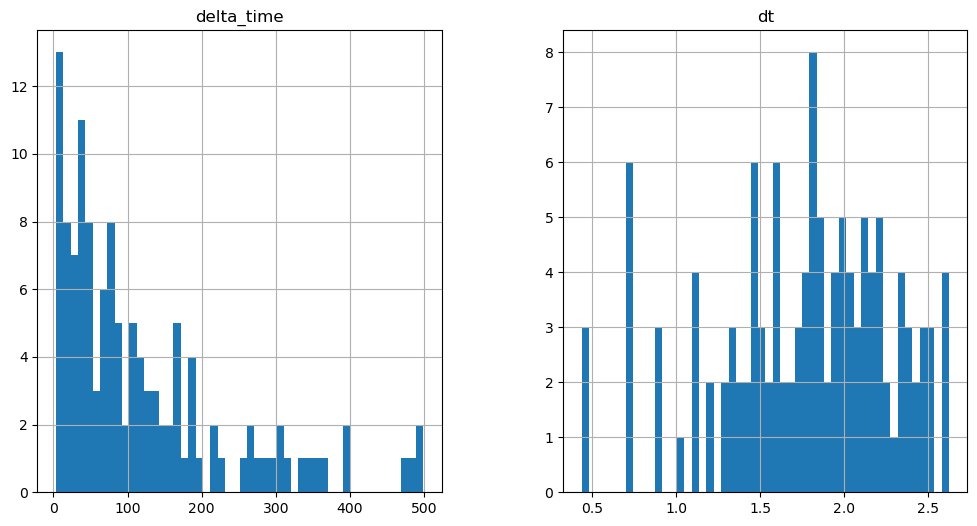

619.0349608659744 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

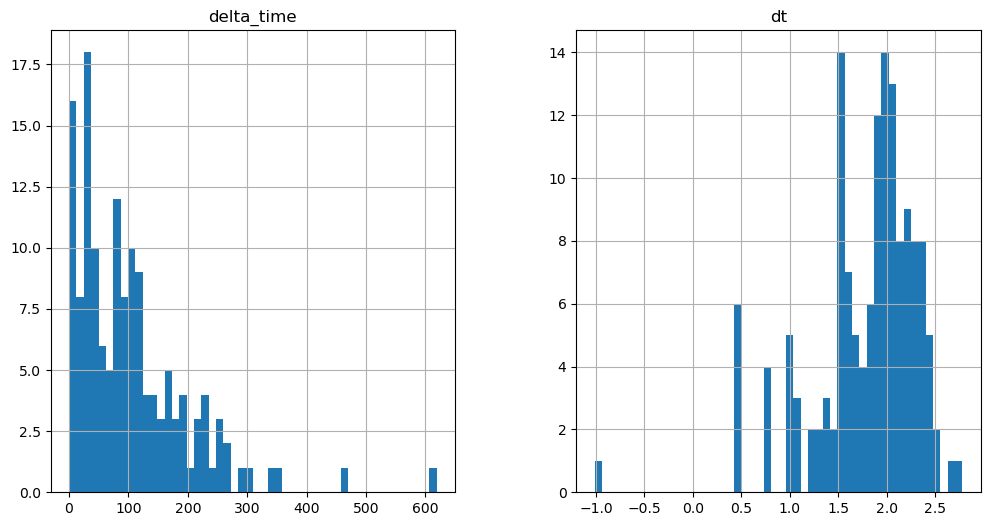

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1558.931717634201 12.964120507240295


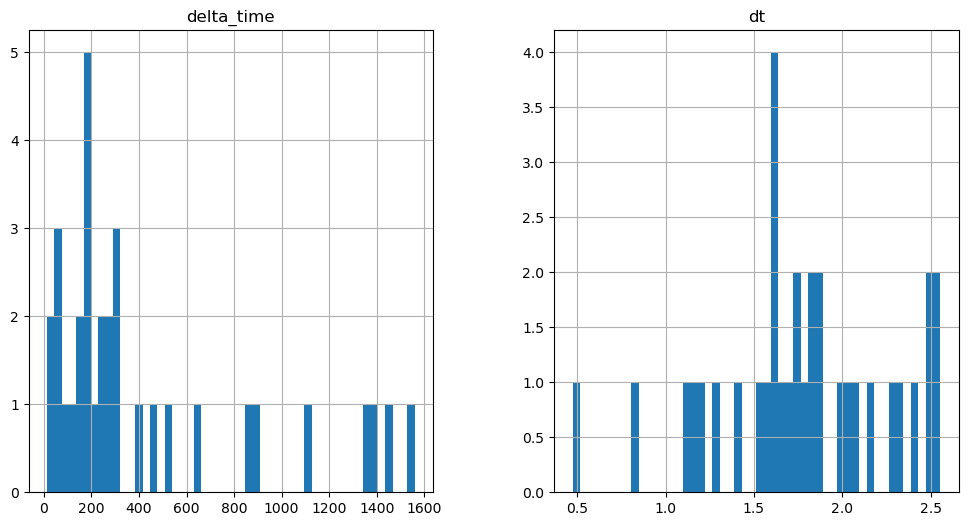

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

891.2823444604874 3.2410202622413635


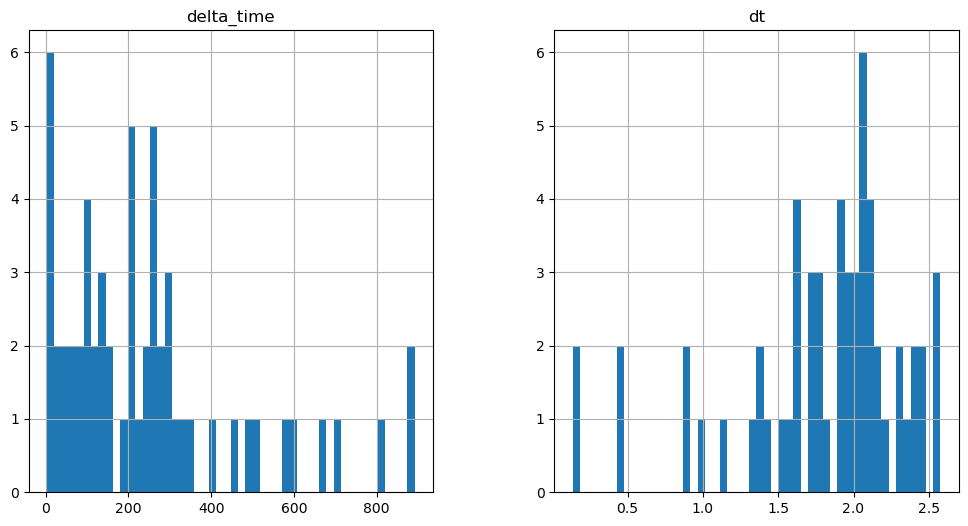

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

674.1337931752205 0.1


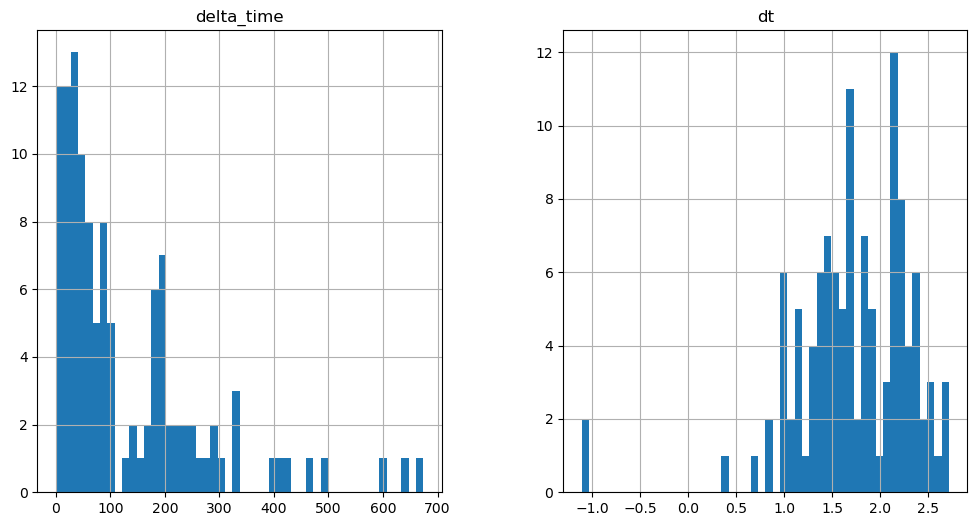

1030.6384013295174 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

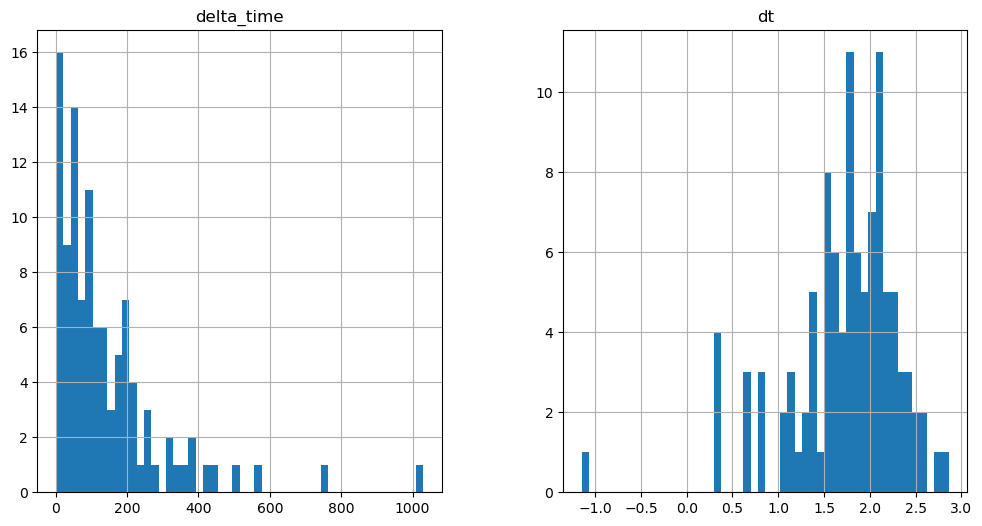

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1623.7417207360268 6.482000231742859


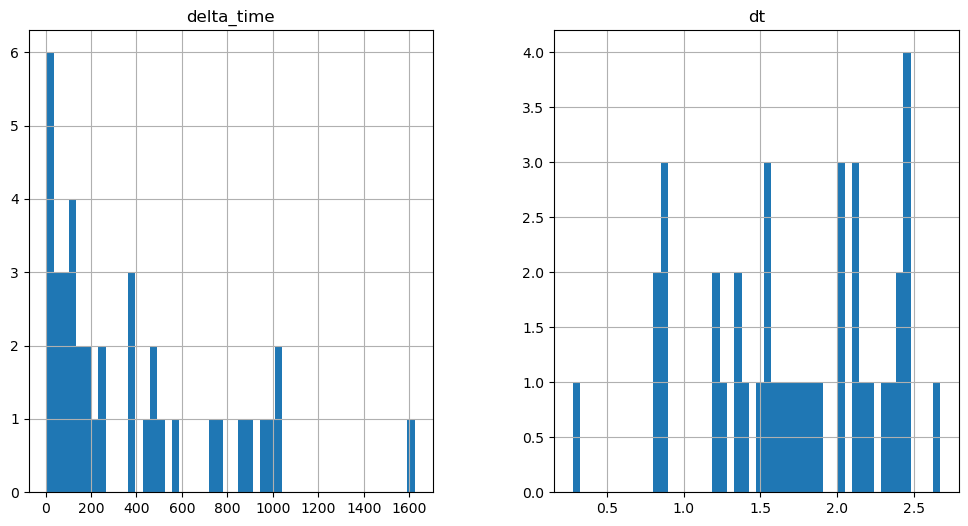

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

298.1721348762512 0.1


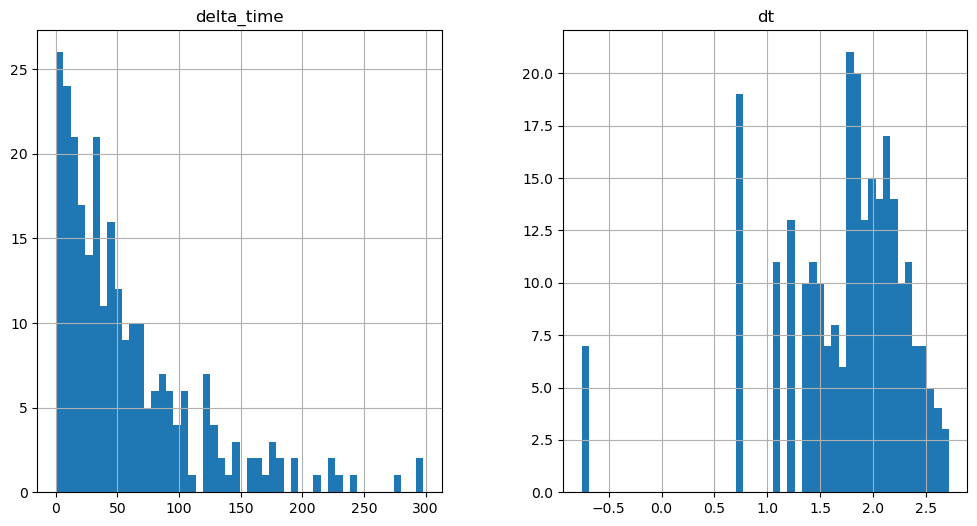

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1656.1516425013542 0.1


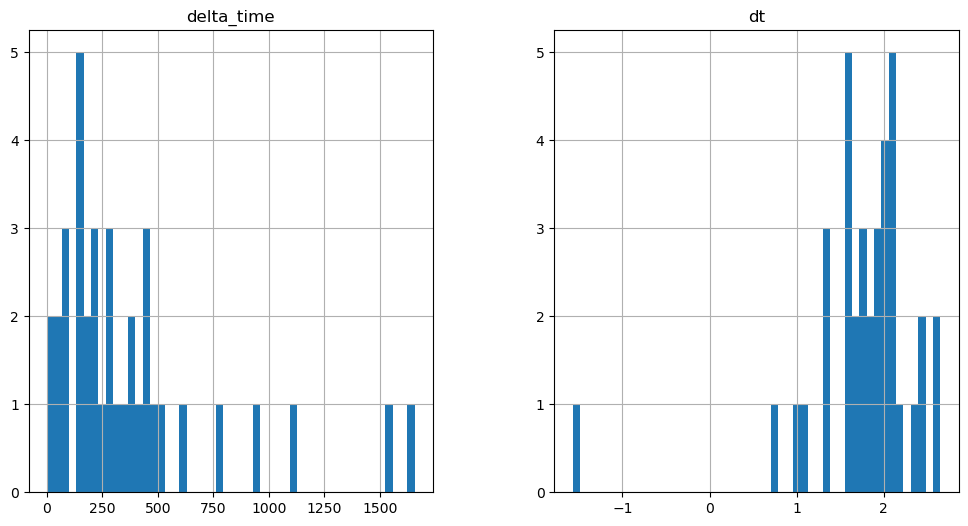

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2229.8088609576225 0.1


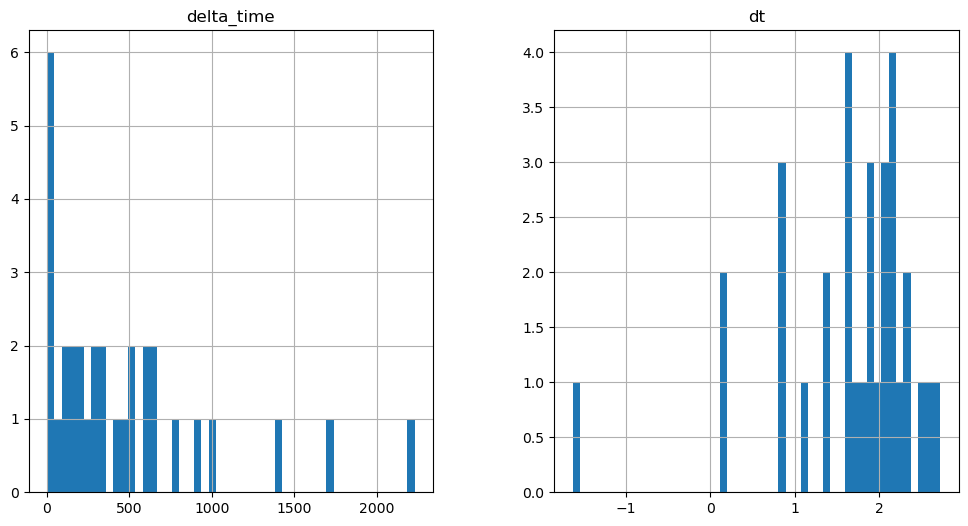

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

505.596195101738 0.1


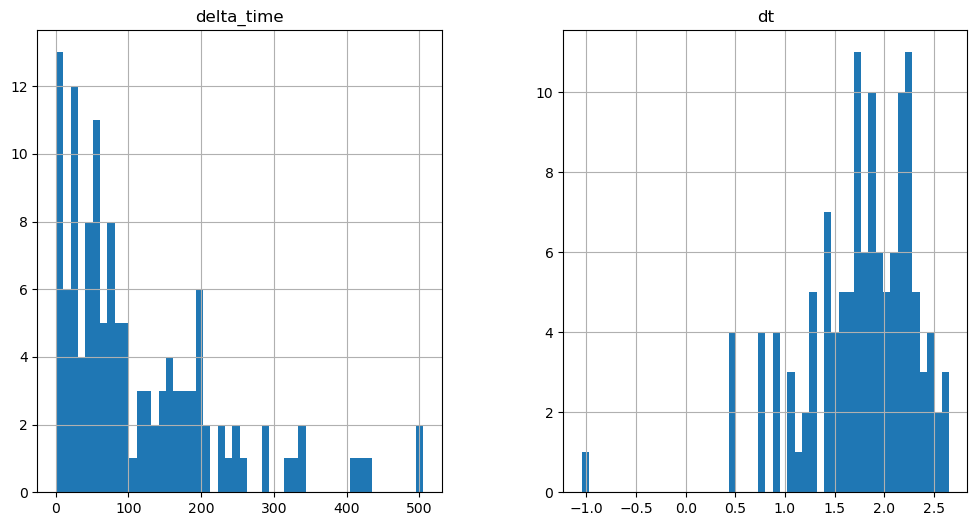

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

619.0313507914543 0.1


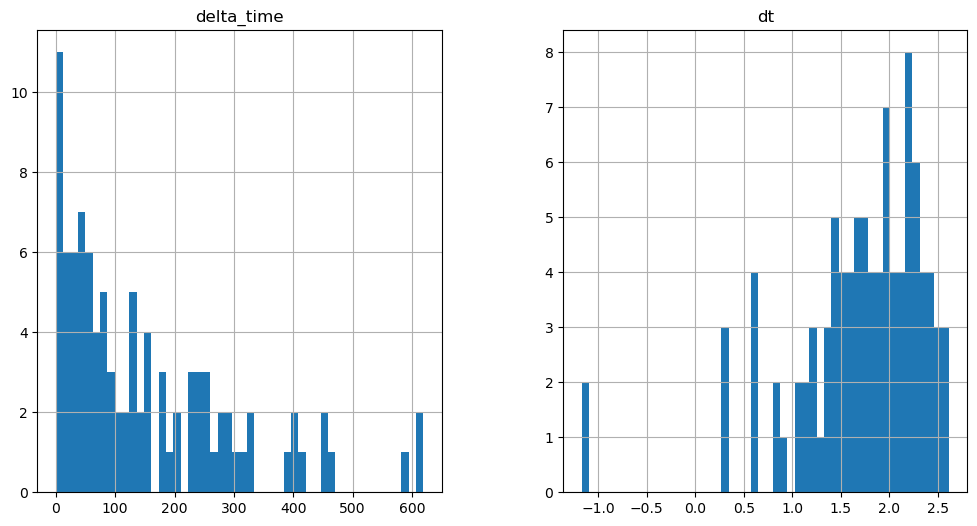

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

622.2722609043121 0.1


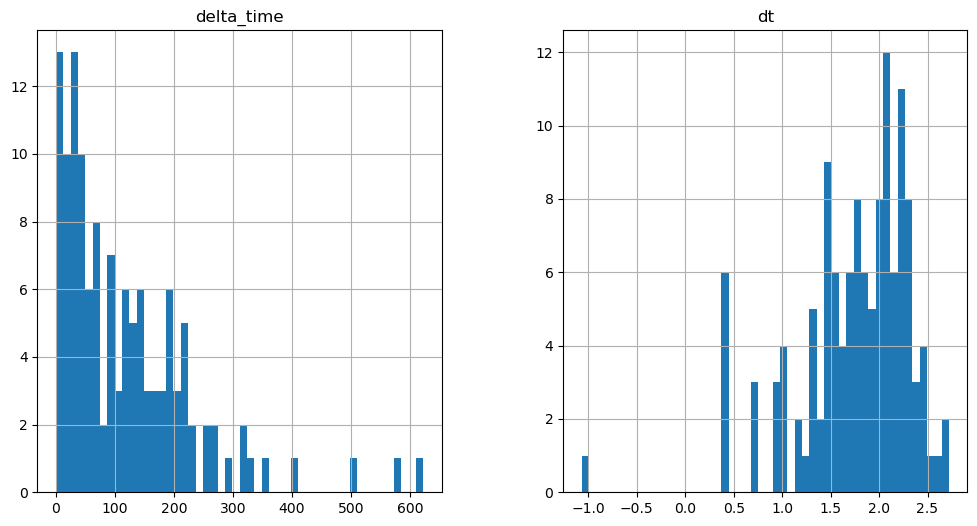

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1228.3459913730621 38.89226192235947


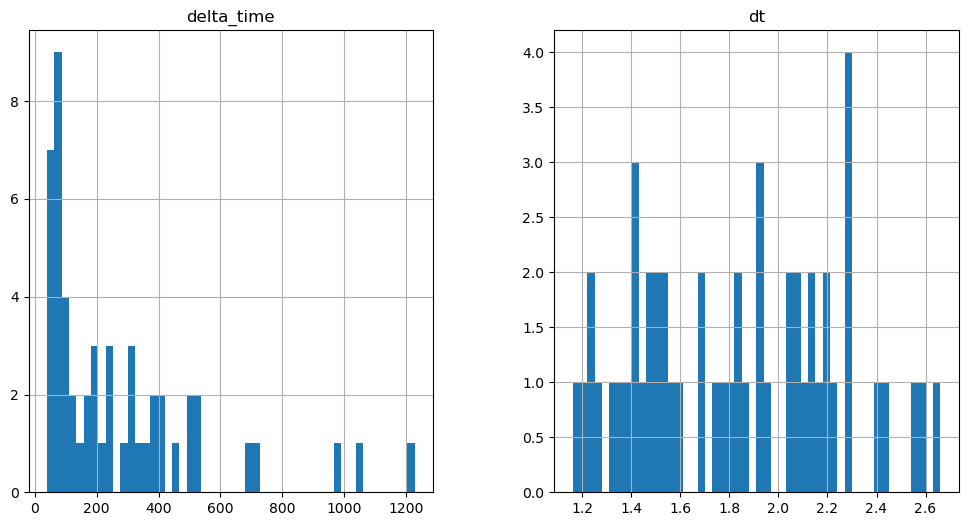

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1533.0012565851212 3.2410102486610413


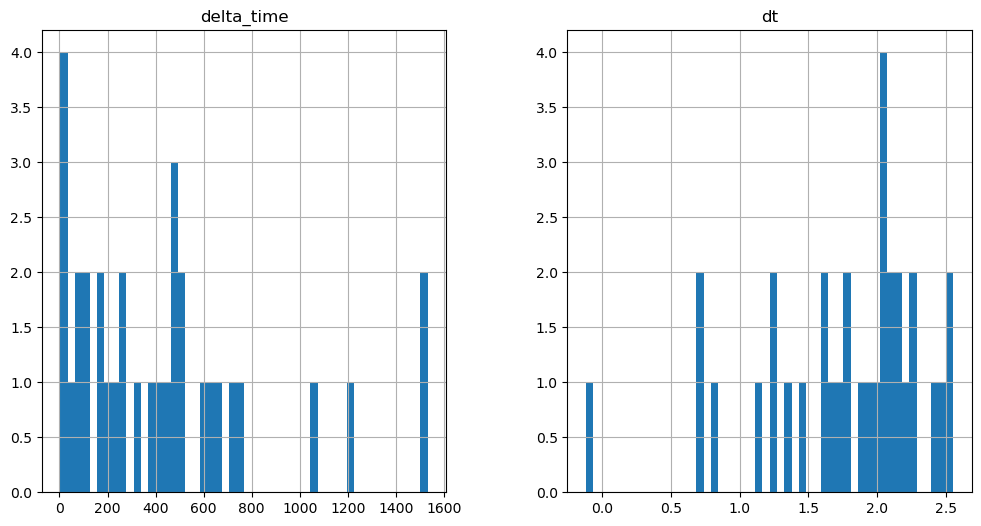

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

917.2057558894157 0.1


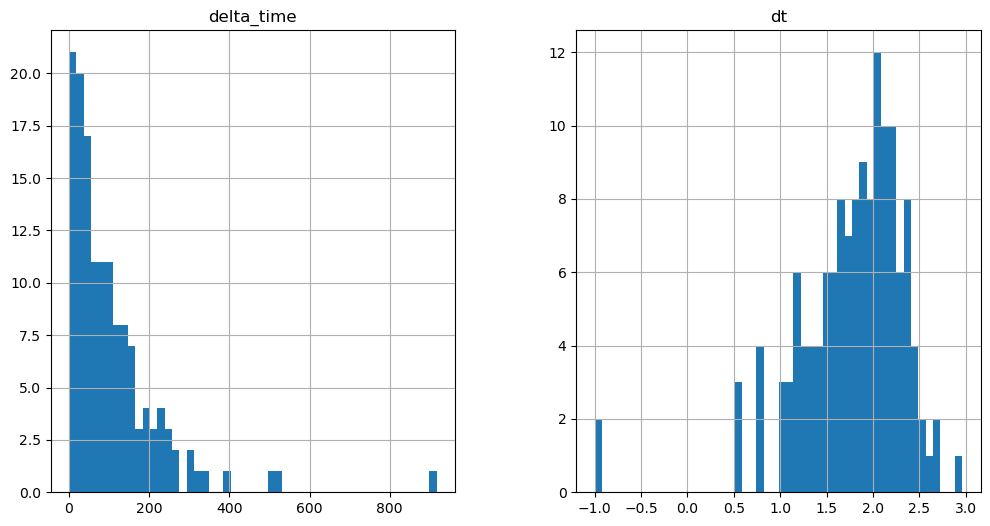

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1092.2221744656563 0.1


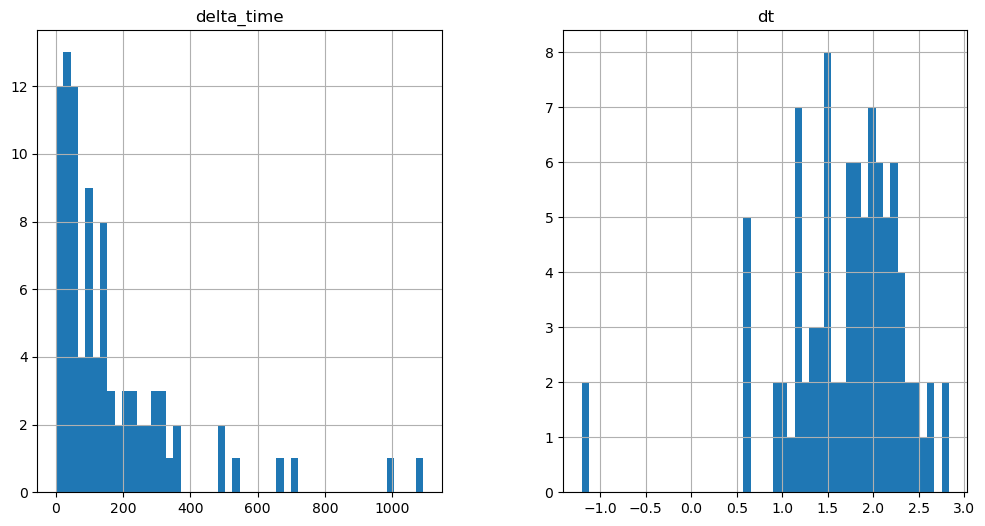

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1597.8270301222801 3.2410102486610413


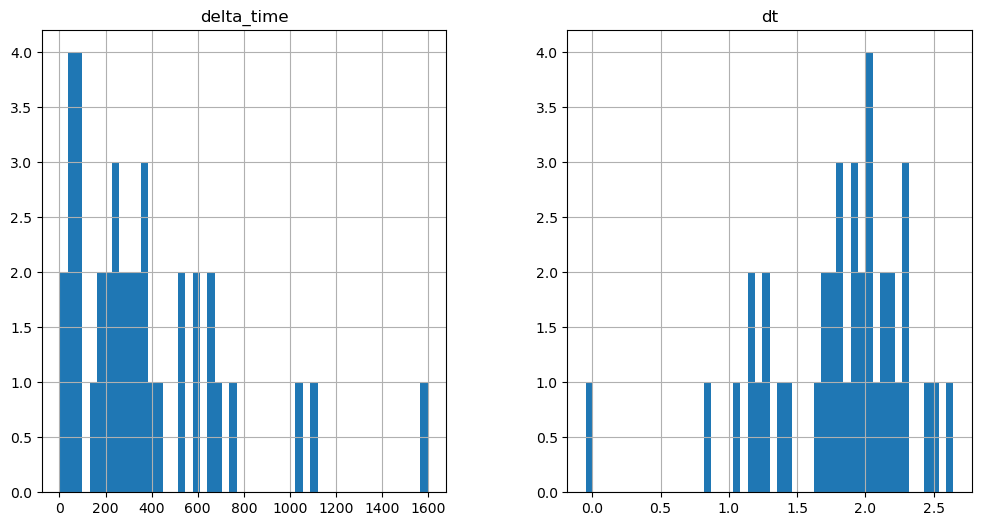

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1361.230948150158 0.1


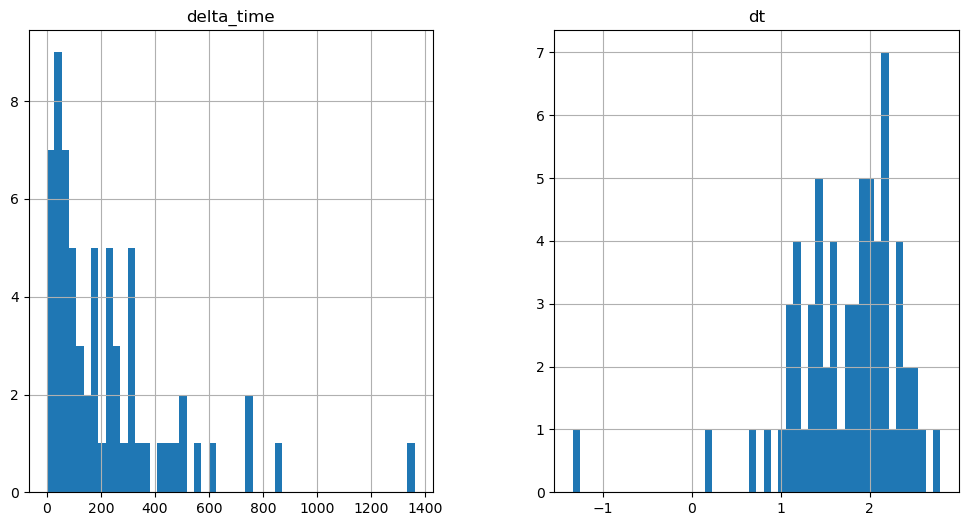

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1555.6937777400017 9.723050653934479


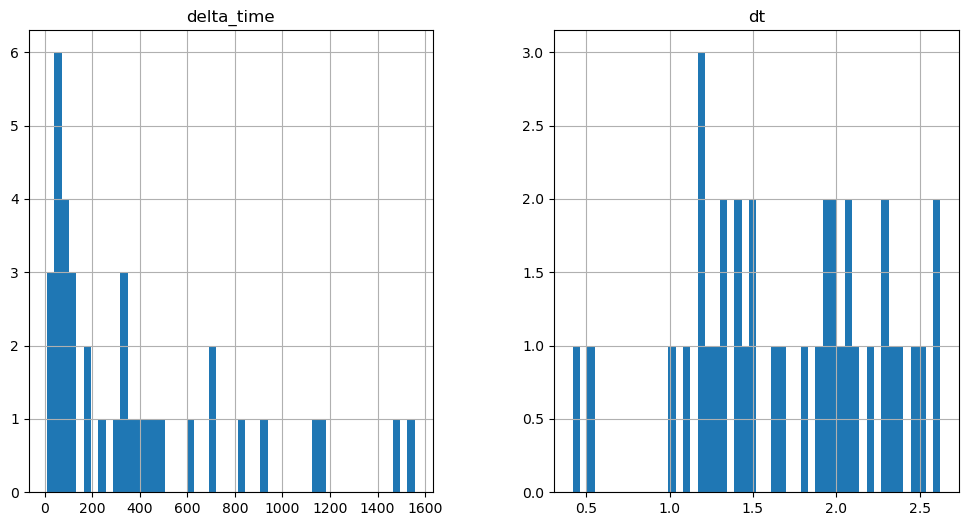

732.4716663956642 3.2410301566123962


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

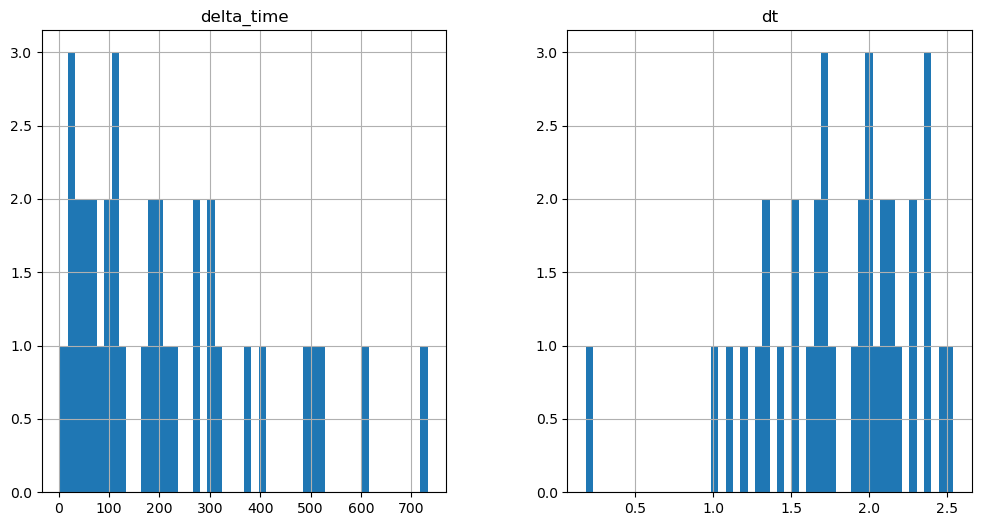

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1033.8856514692307 9.723080515861511


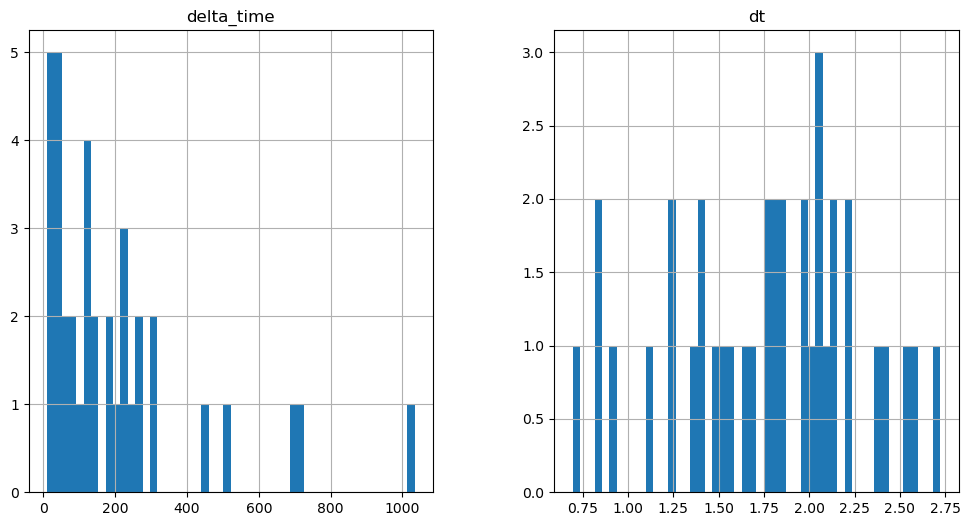

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

298.17550468444824 0.1


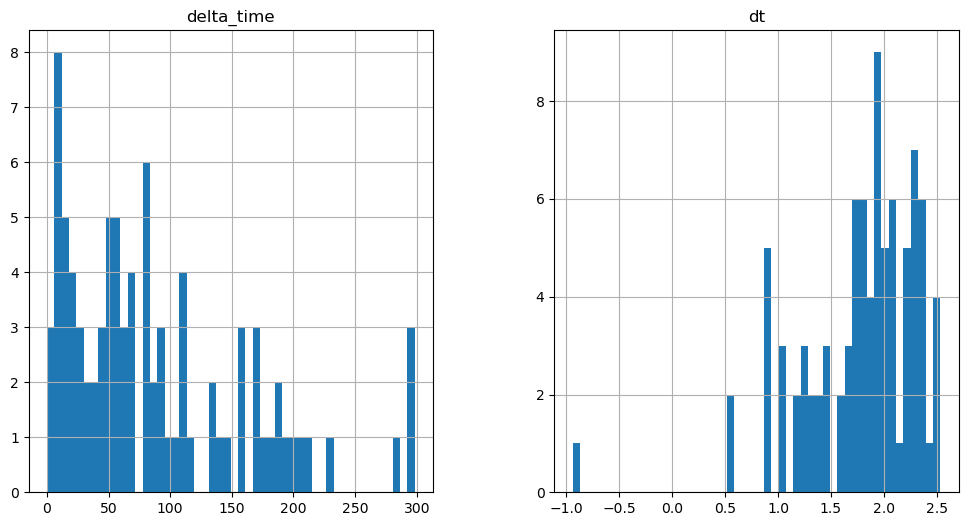

126.40048623085022 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

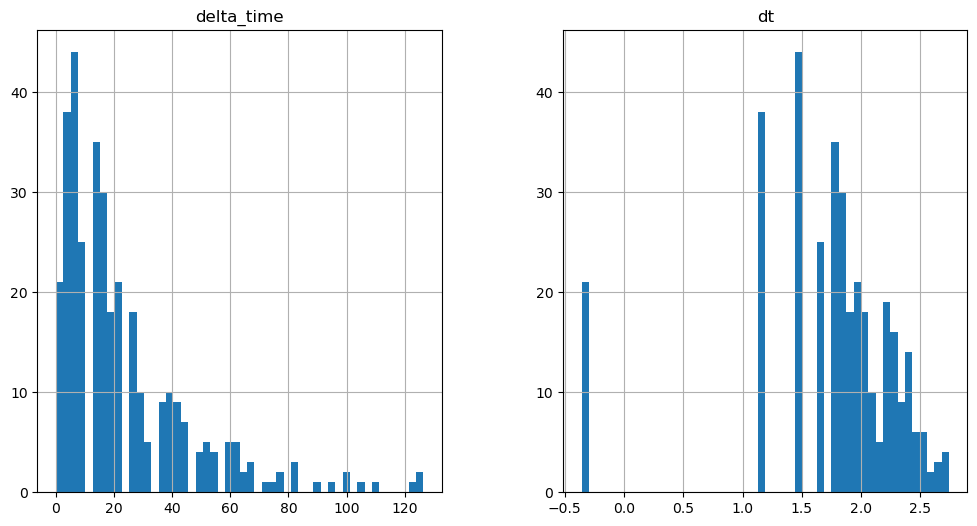

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

829.6971712112427 3.241000235080719


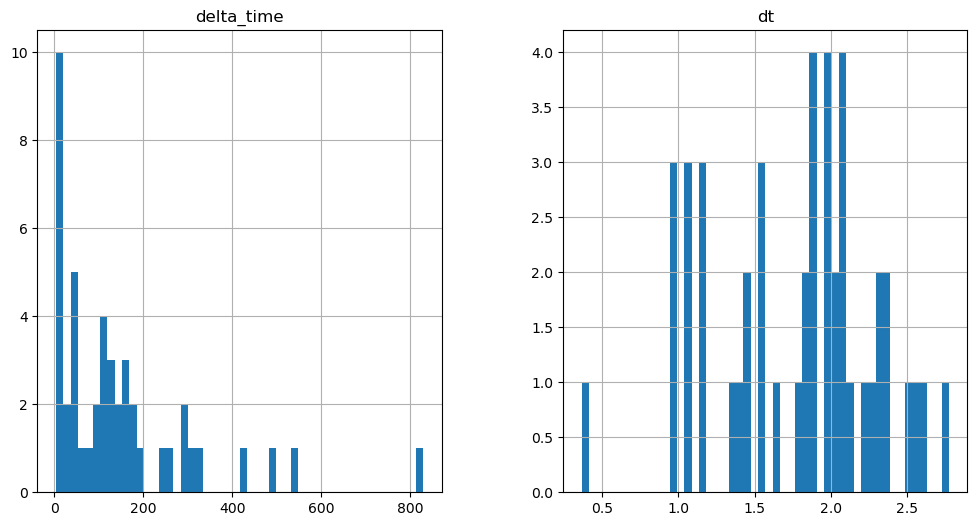

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

515.3203256726265 0.1


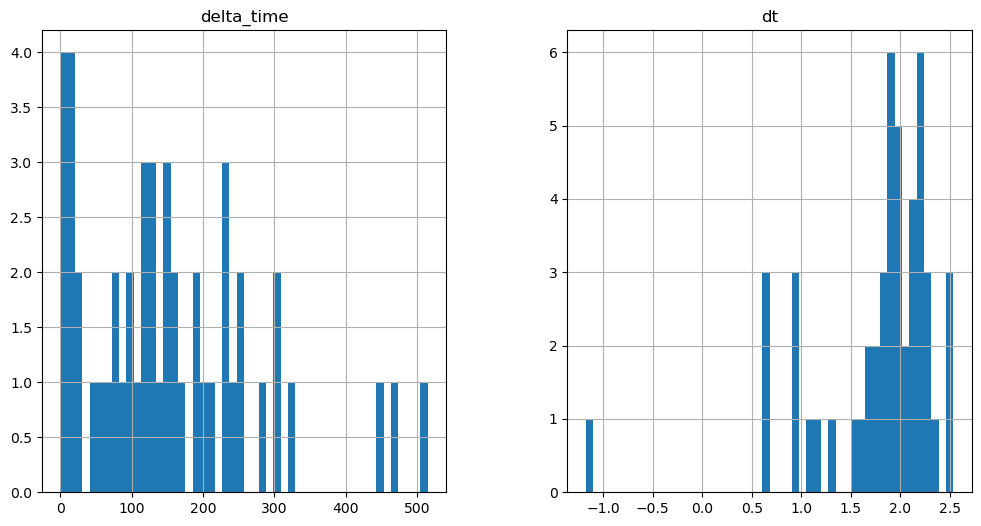

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

275.4851838350296 0.1


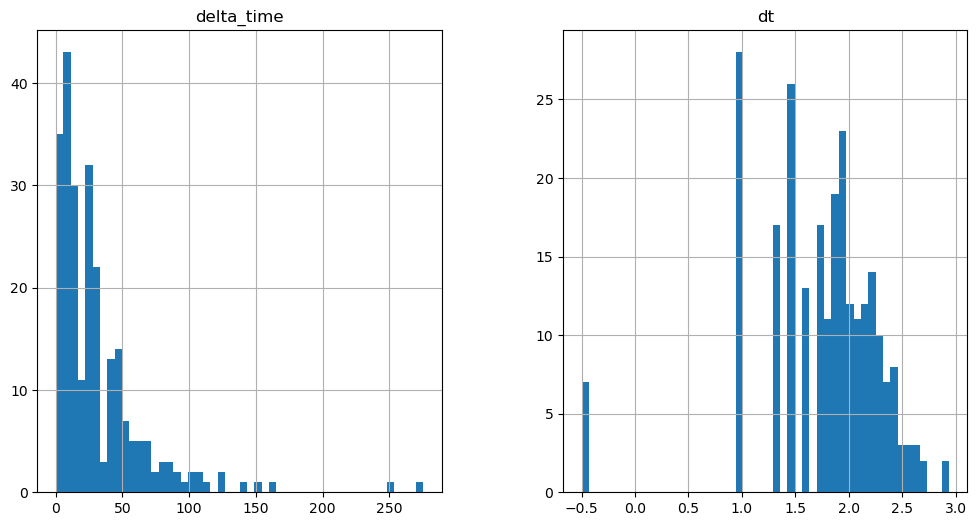

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1332.0580959320068 0.1


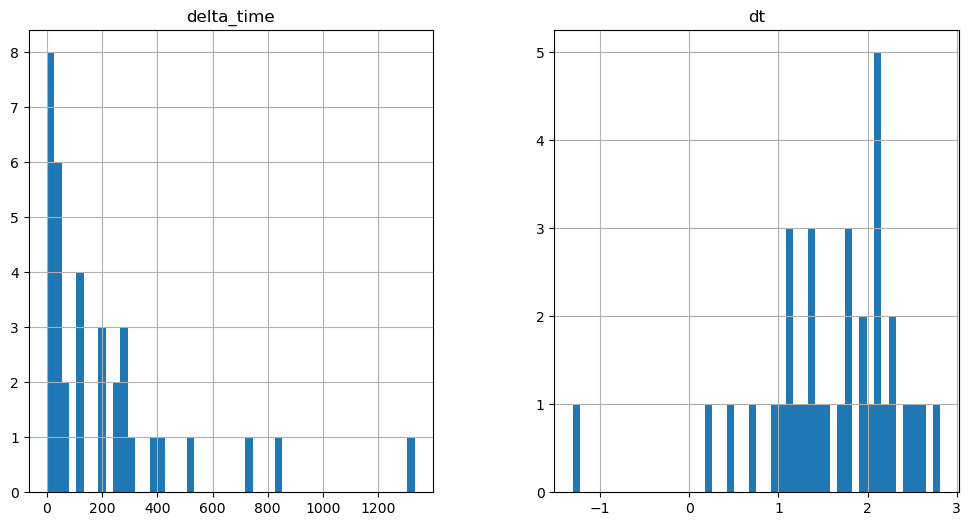

732.4704668521881 6.48205041885376


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

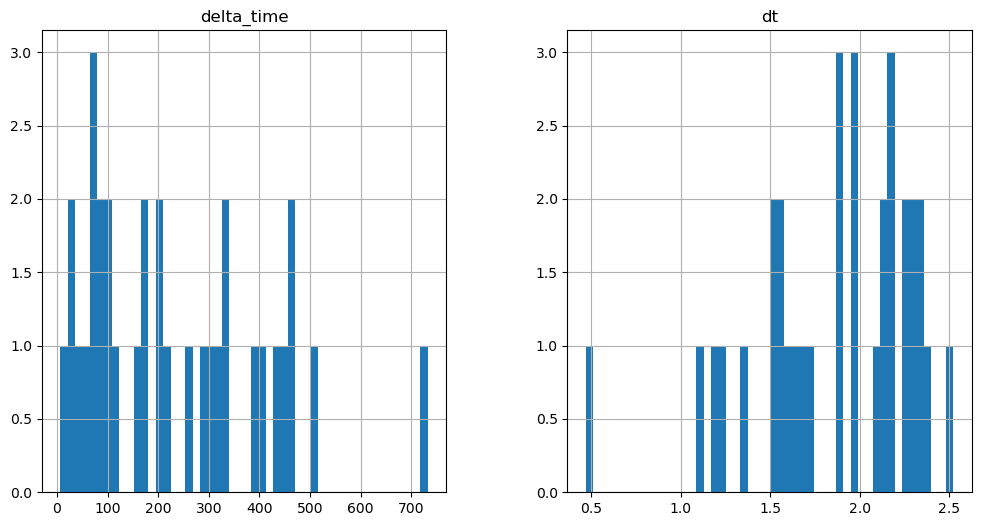

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1743.6741476655006 12.96410059928894


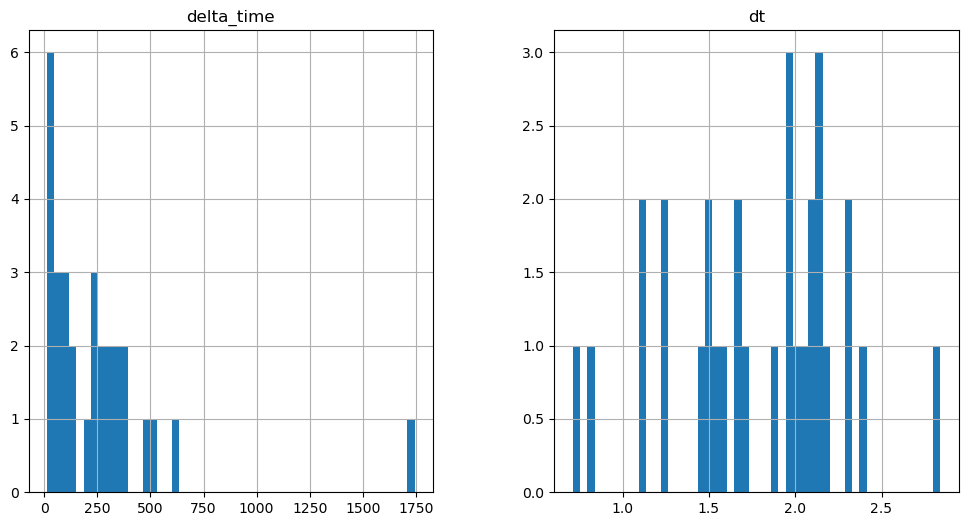

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

502.35696482658386 0.1


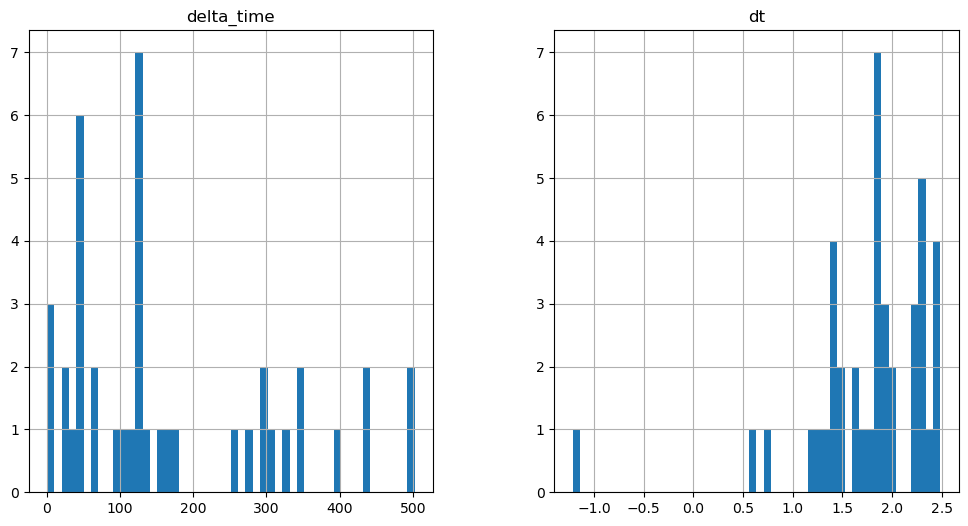

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

680.6134336590767 6.482030272483826


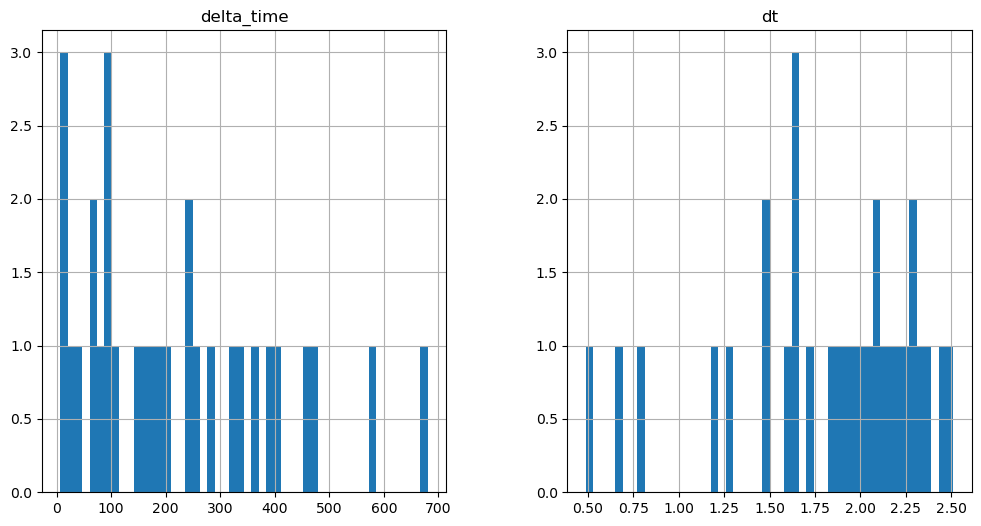

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

294.93279457092285 0.1


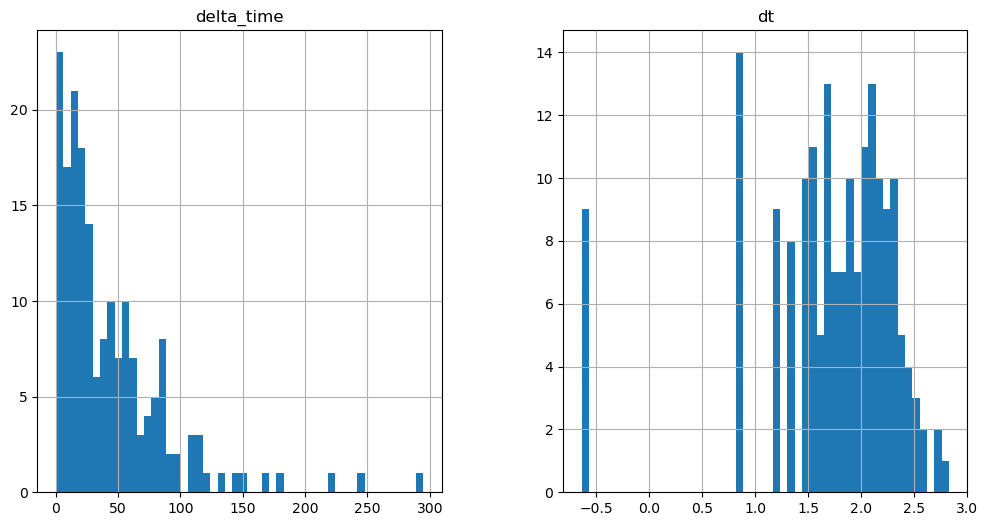

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

447.2597221136093 0.1


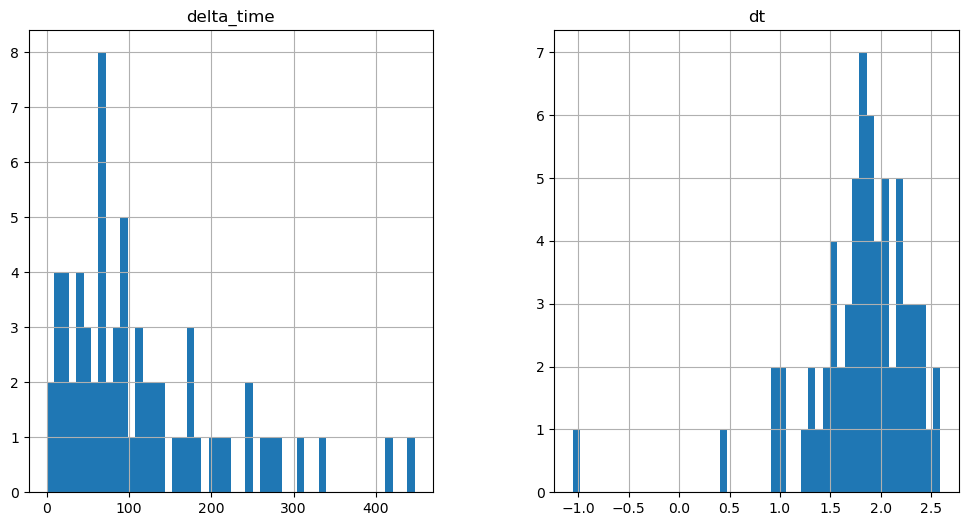

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

492.63431429862976 0.1


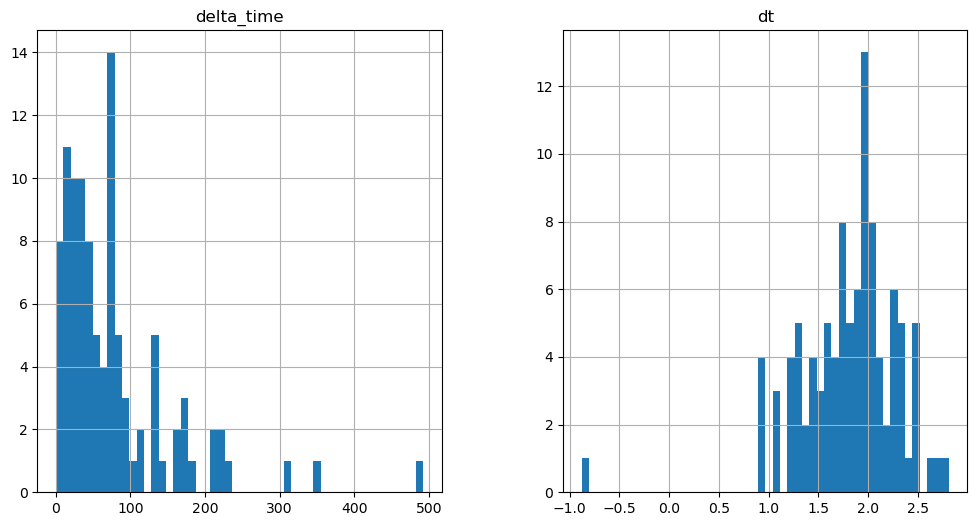

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

871.8335732221603 3.2410101890563965


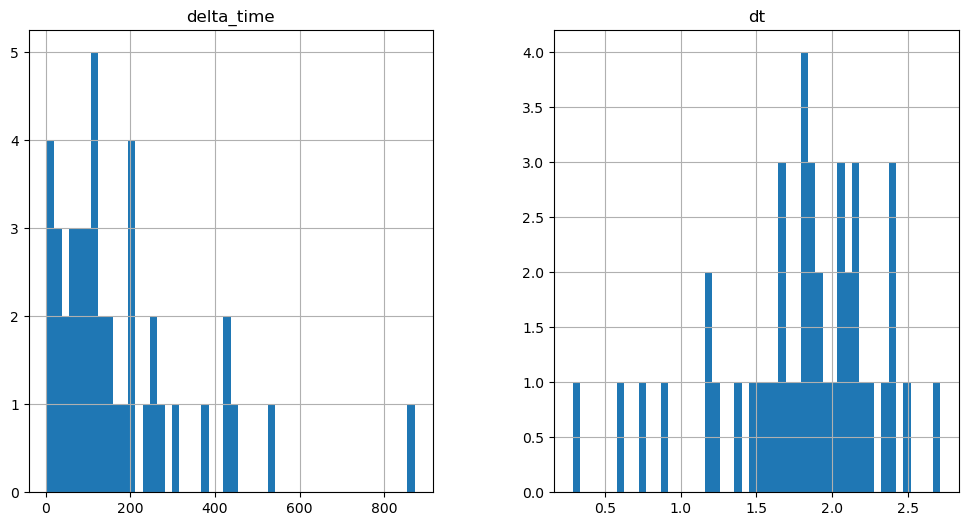

269.00442320108414 3.241000175476074


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

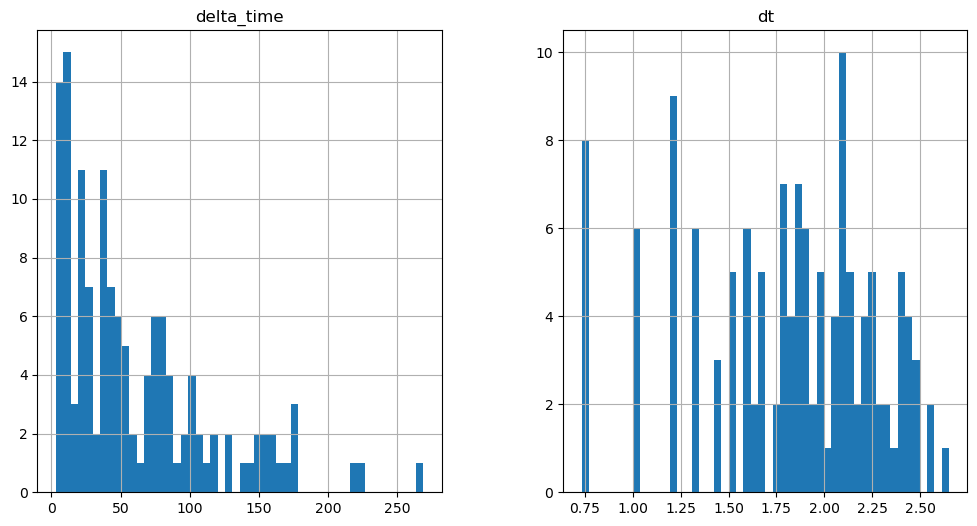

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

473.1879234313965 0.1


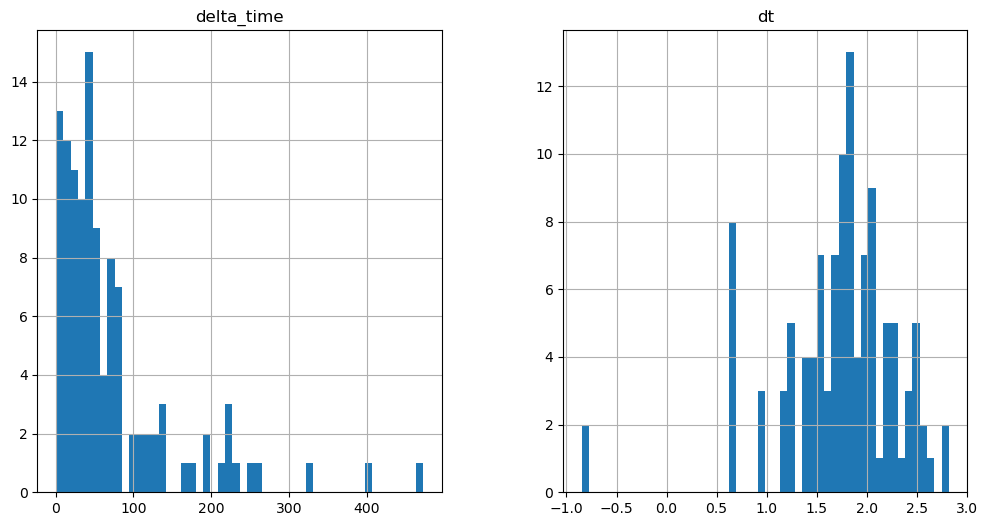

612.5512703061104 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

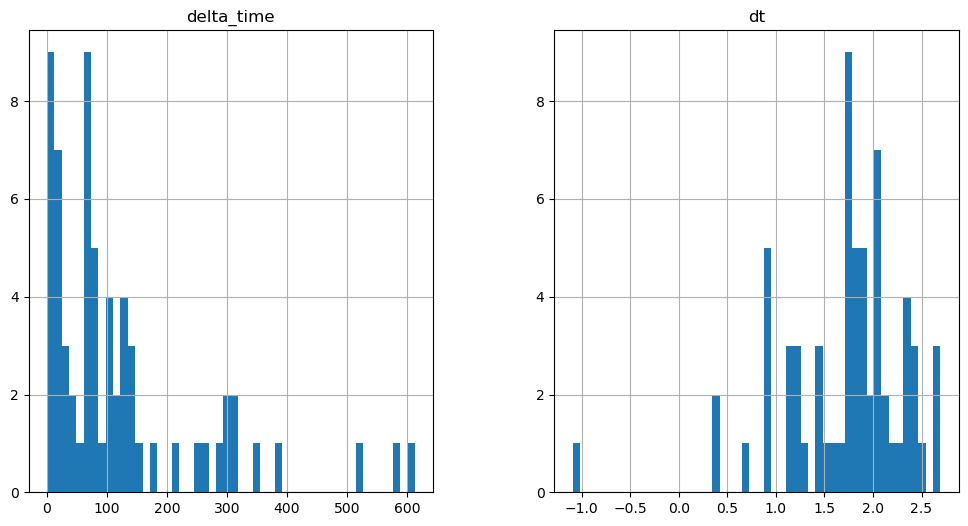

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1124.6304755210876 0.1


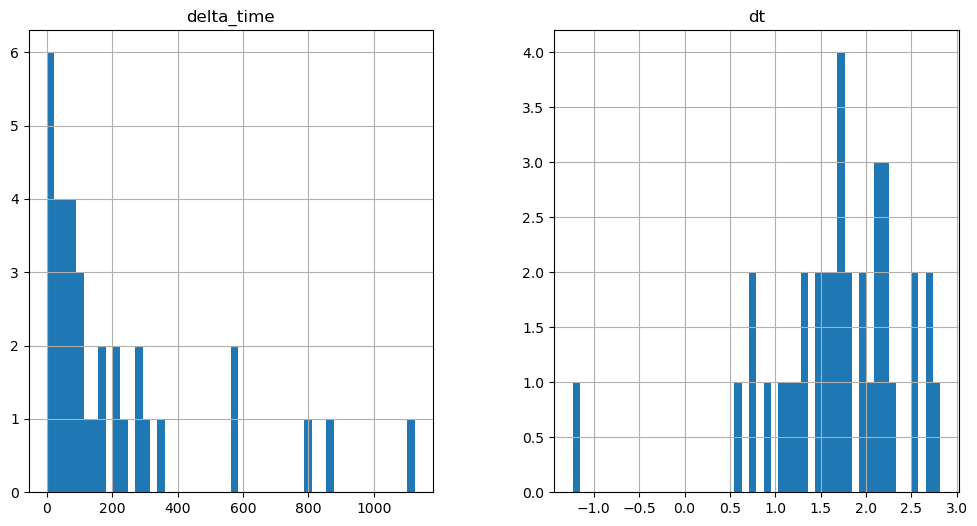

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))


969.0586786270142 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["E"] = np.log10(df_id["energy"])


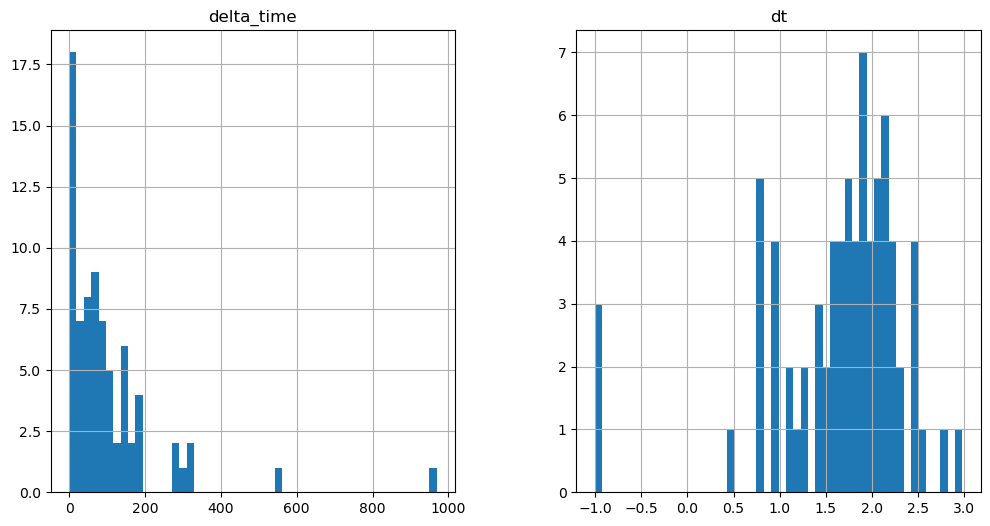

735.7079966664314 3.2410101294517517


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

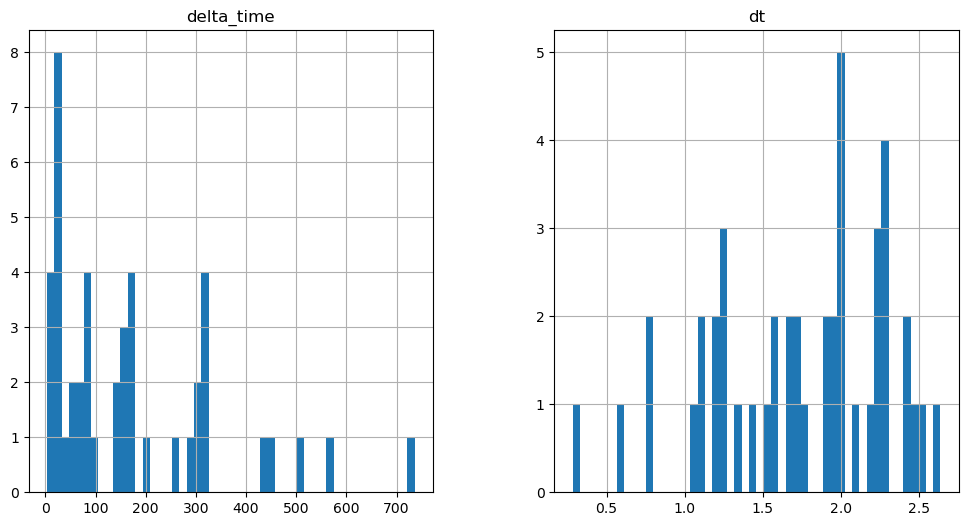

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1257.5153024792671 3.241020143032074


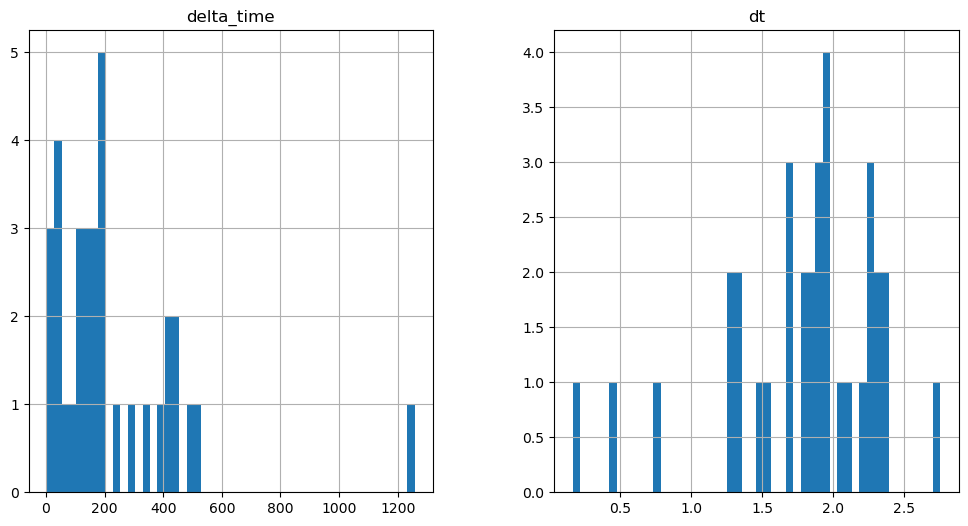

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

52.924052715301514 0.441010057926178


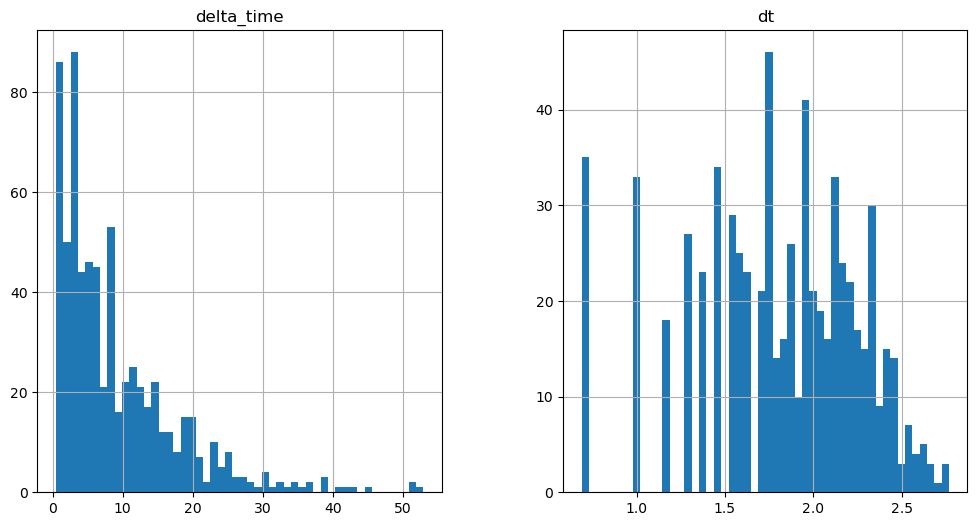

107.17143529653549 0.441010057926178


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

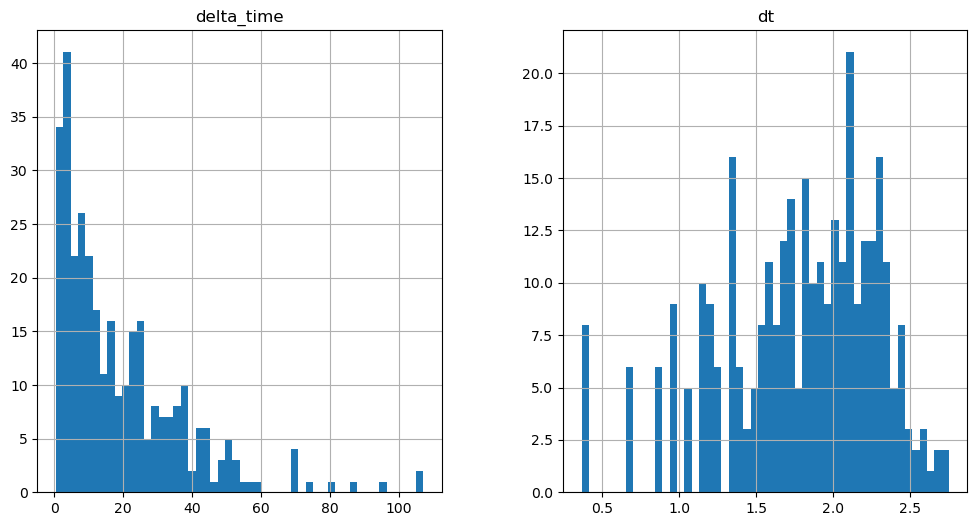

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

456.9123626947403 4.851360380649567


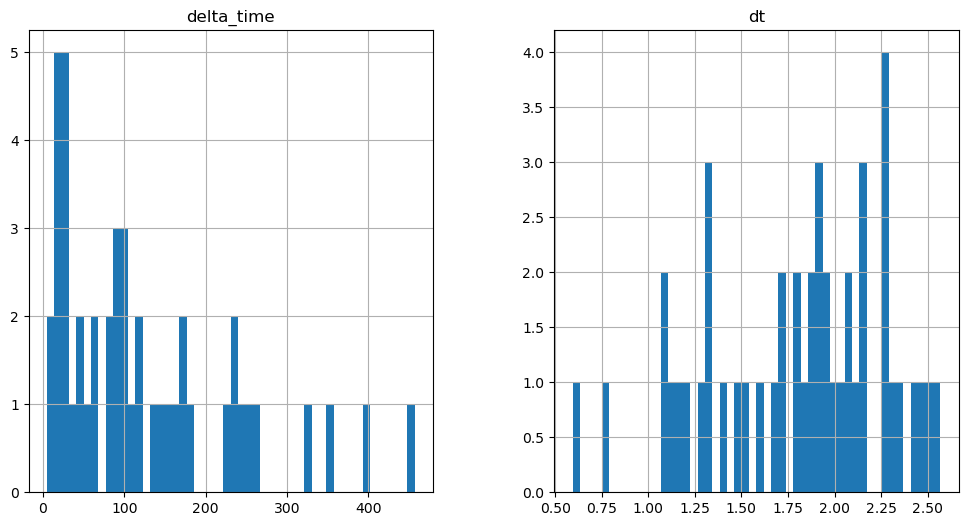

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/Users/steven/opt/anaconda3/envs/ciao-4.15/lib/python3.10/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: invalid value encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexi

80.26831394433975 -5819.452717959881


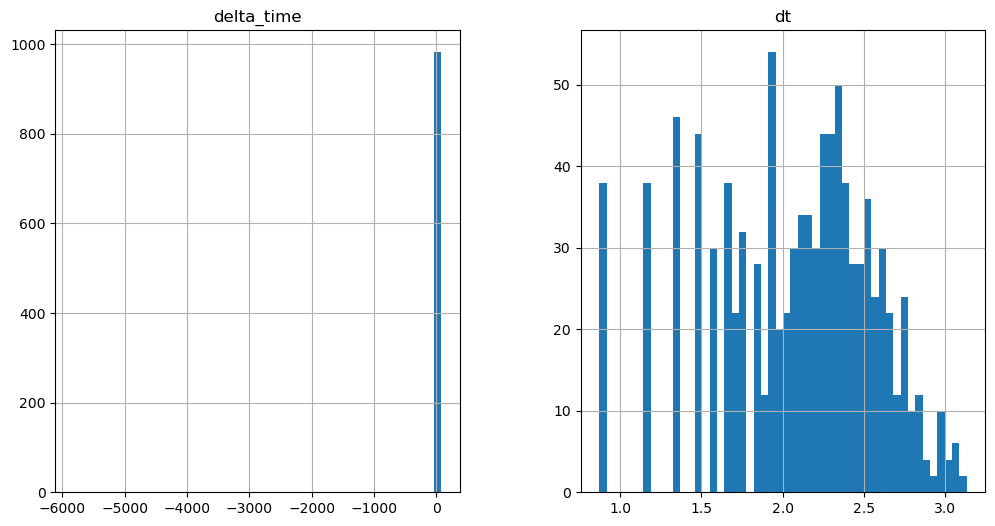

18.964460909366608 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

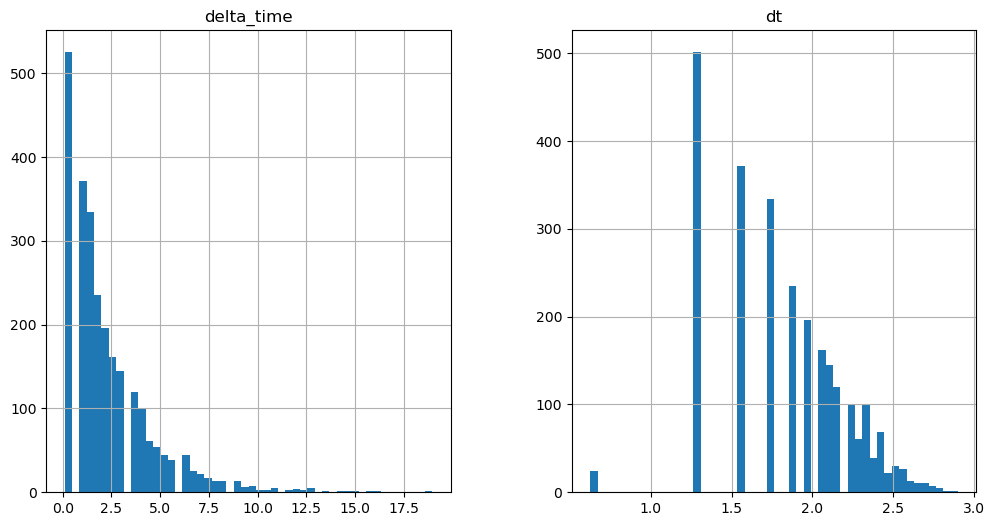

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3270.1653535217047 6.482000231742859


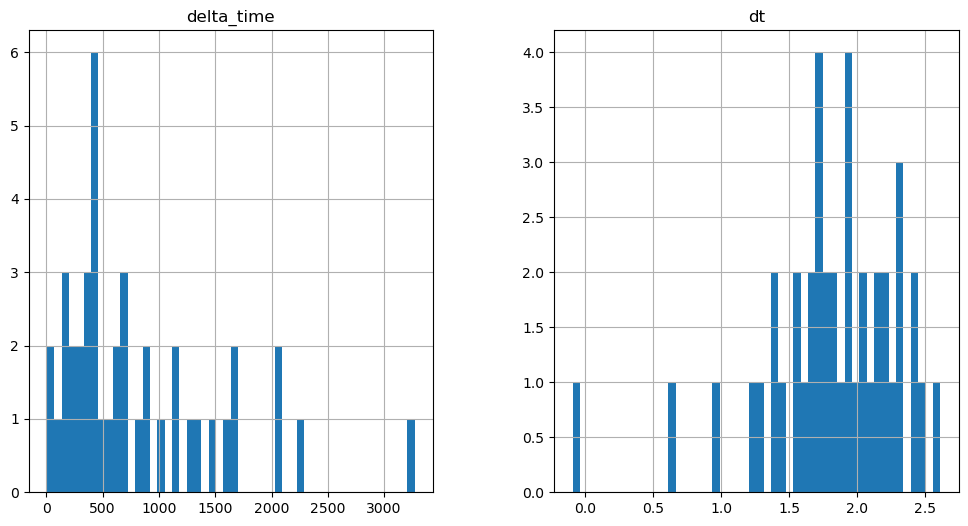

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

155.56779596209526 0.1


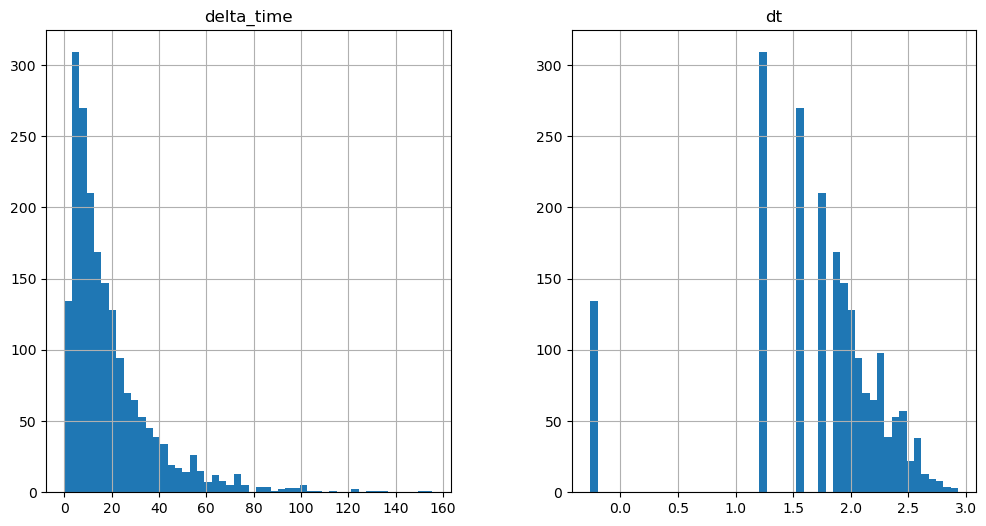

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4333.21182371676 0.1


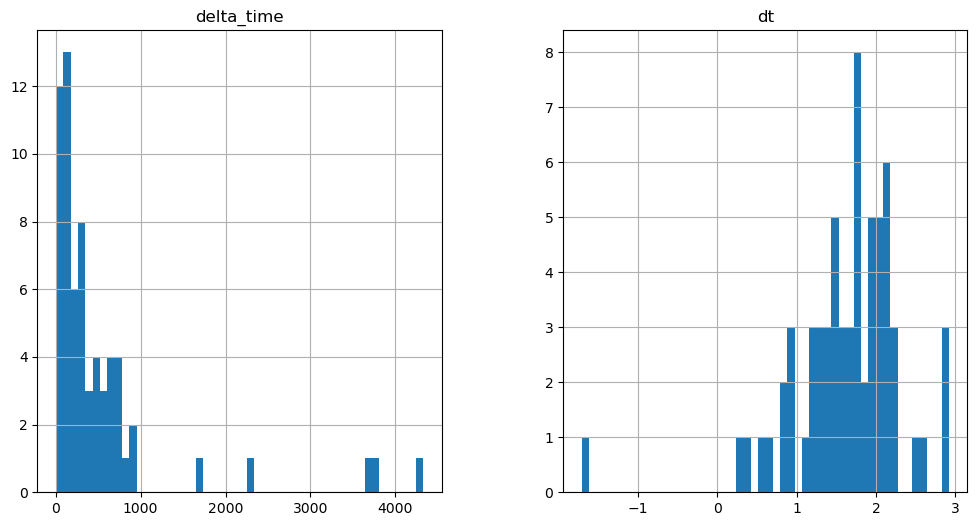

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4670.275836393237 29.168971091508865


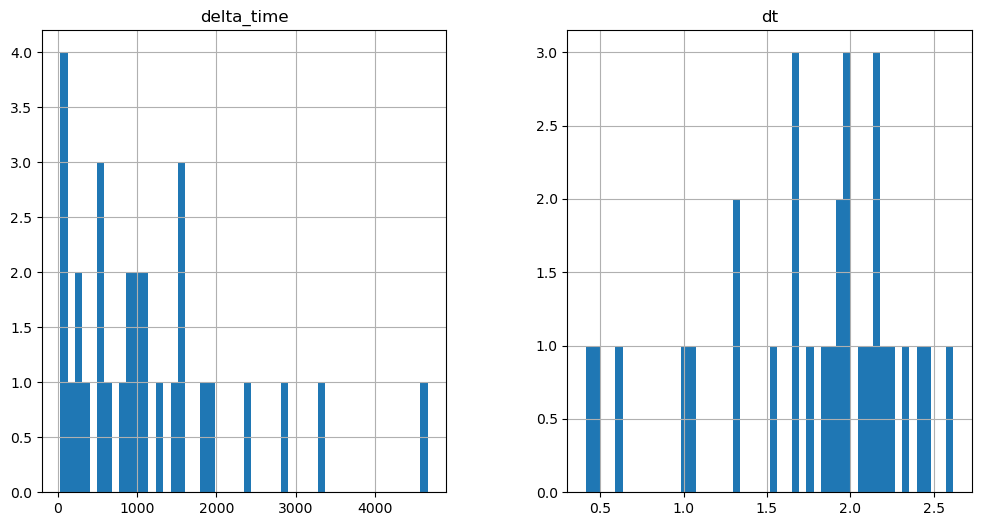

1678.8360833525658 3.241010069847107


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

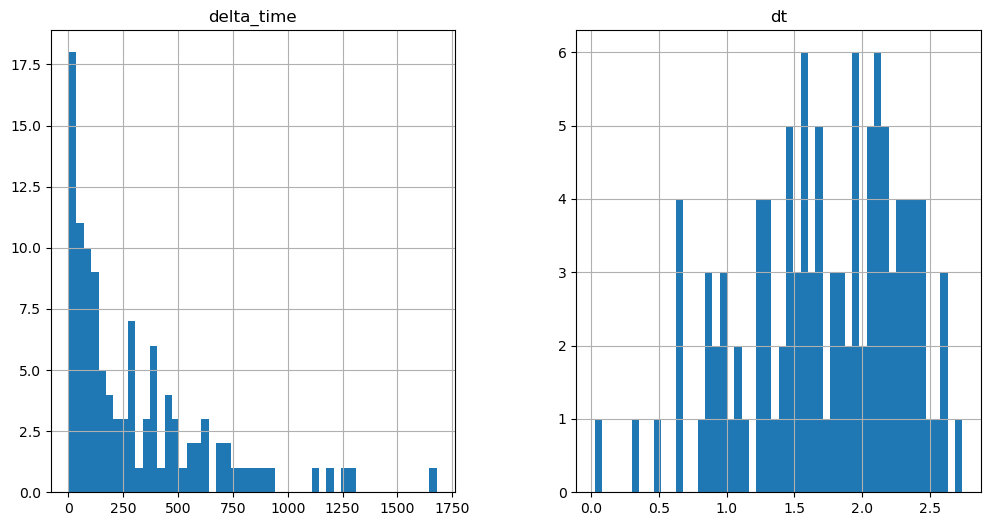

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1234.8195866197348 3.240990161895752


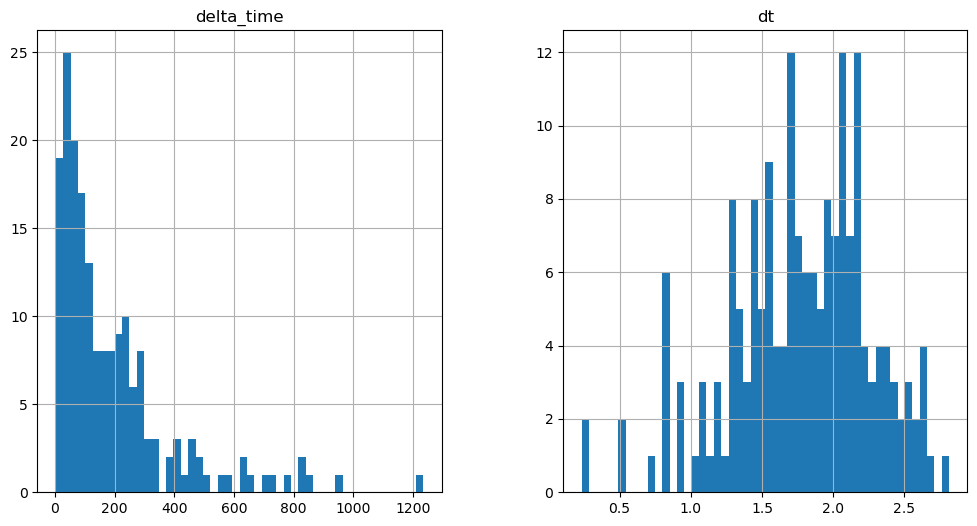

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3487.3121117204428 0.1


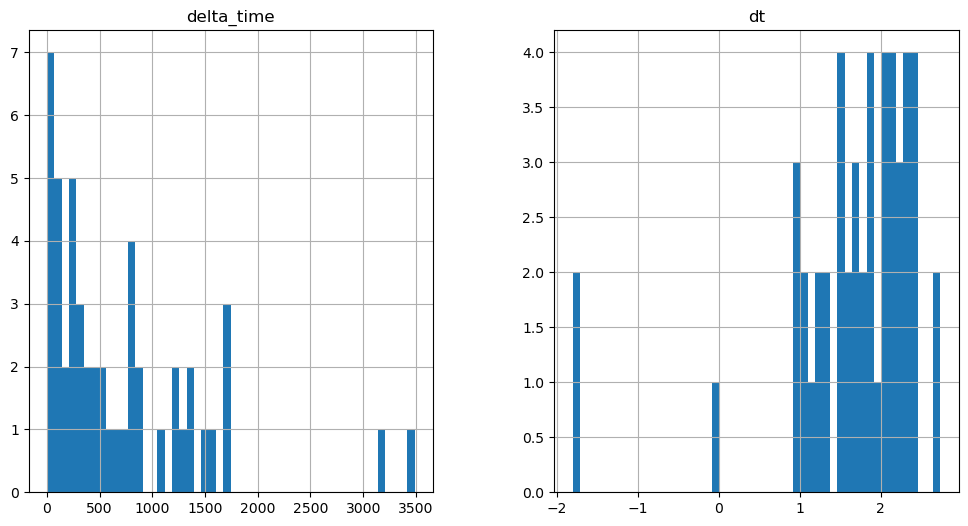

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5373.571862965822 16.204980611801147


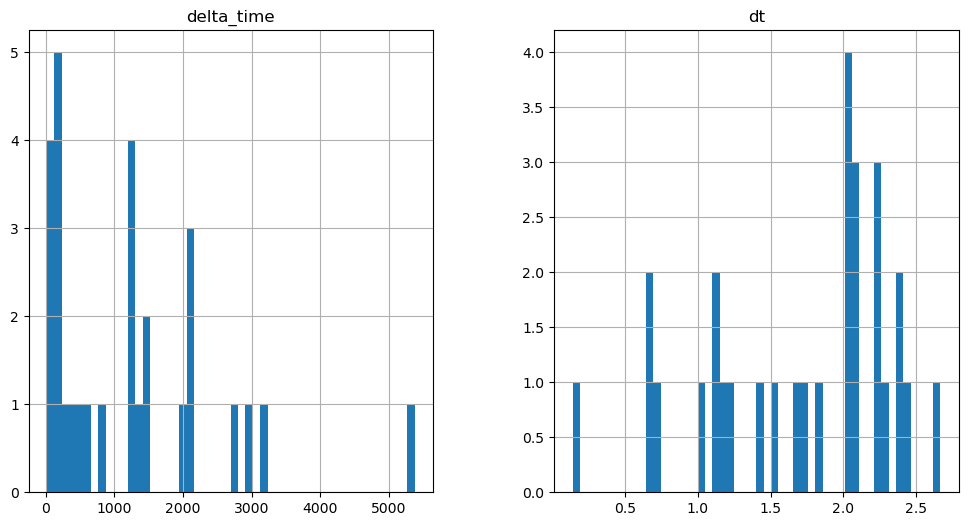

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1383.905302271247 9.722980380058289


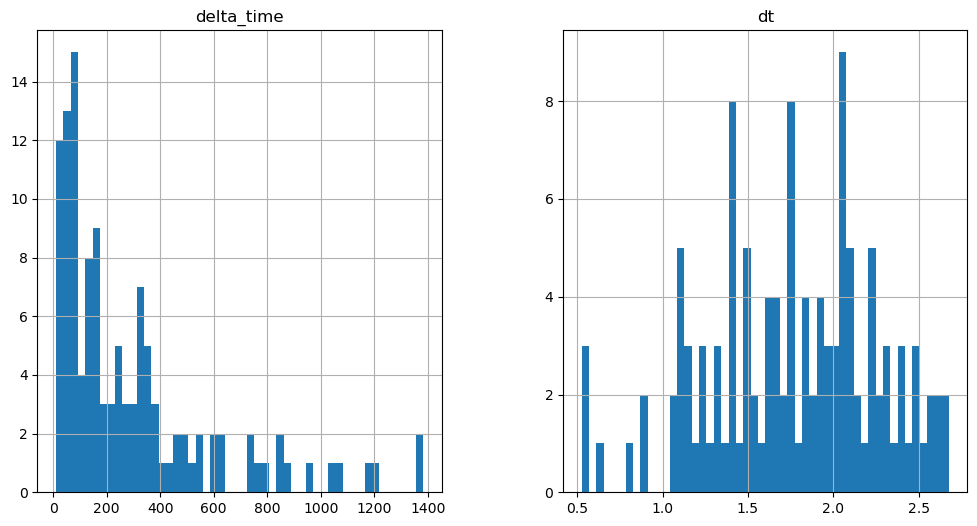

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2505.2902446240187 9.72298039495945


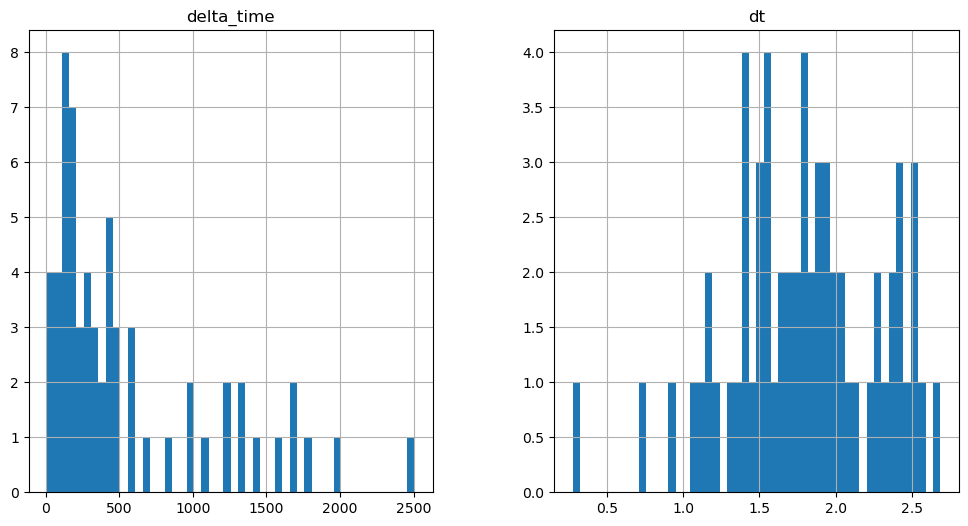

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

51.601042568683624 0.441010057926178


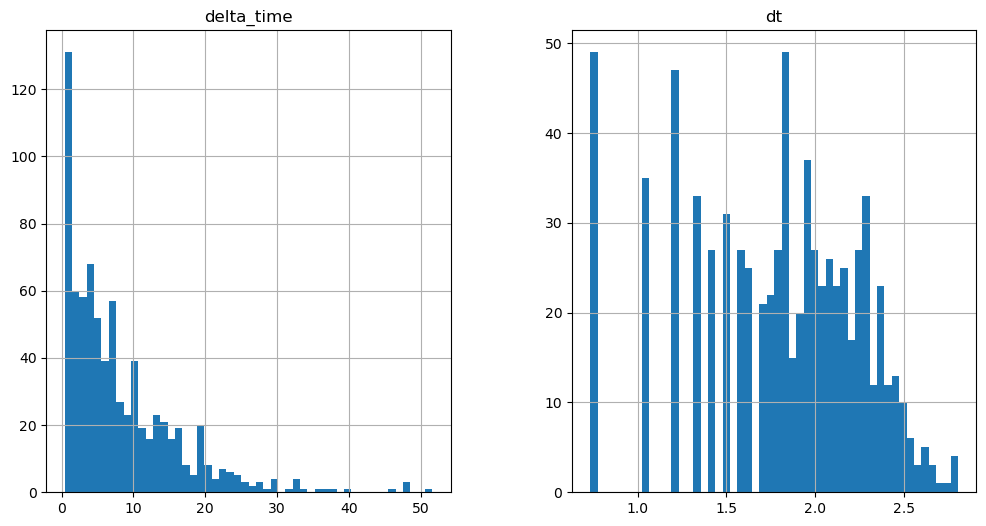

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

17.641590774059296 0.1


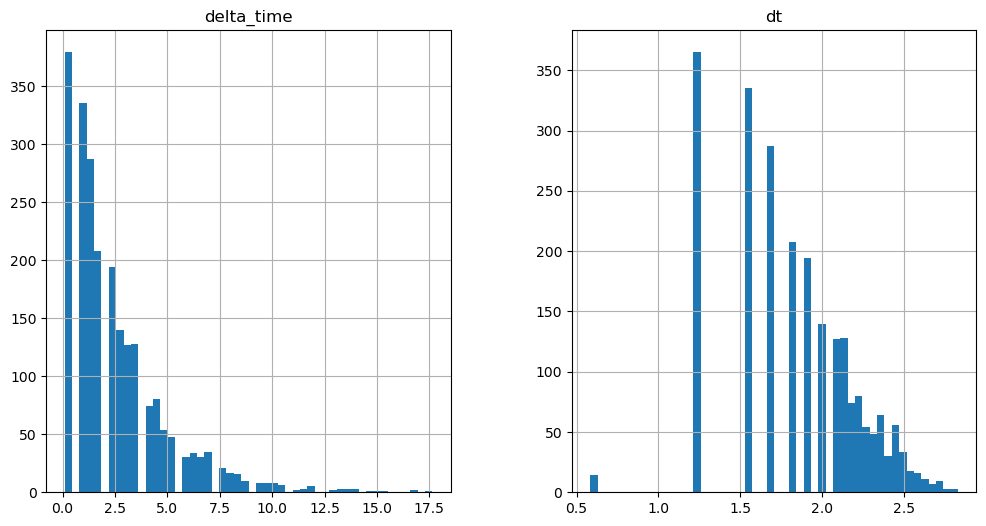

70.56556338071823 0.441020131111145


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

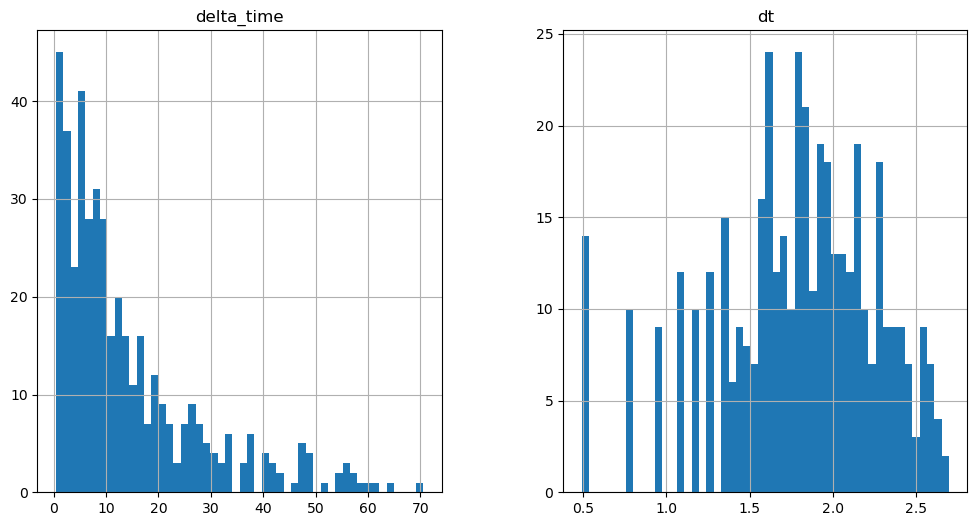

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

6.6155102252960205 0.1


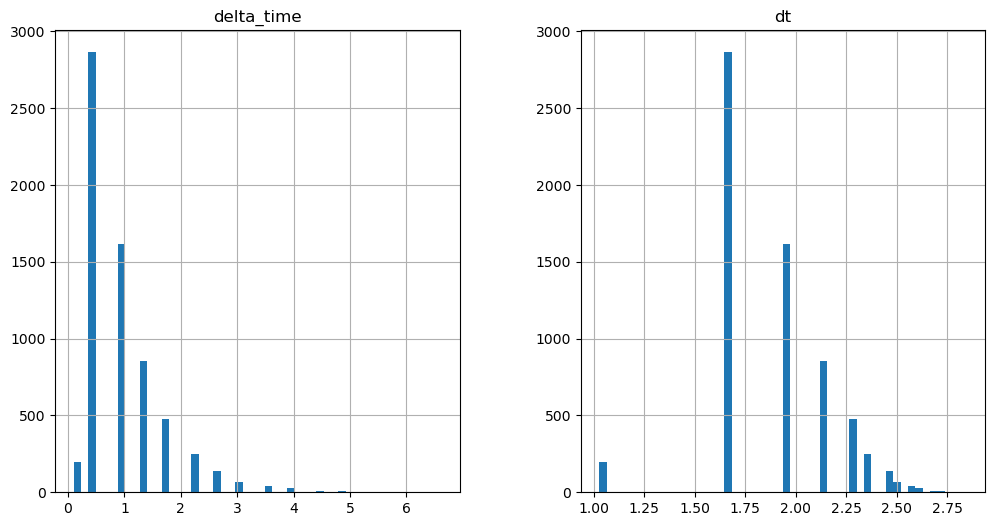

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

48.07288235425949 0.1


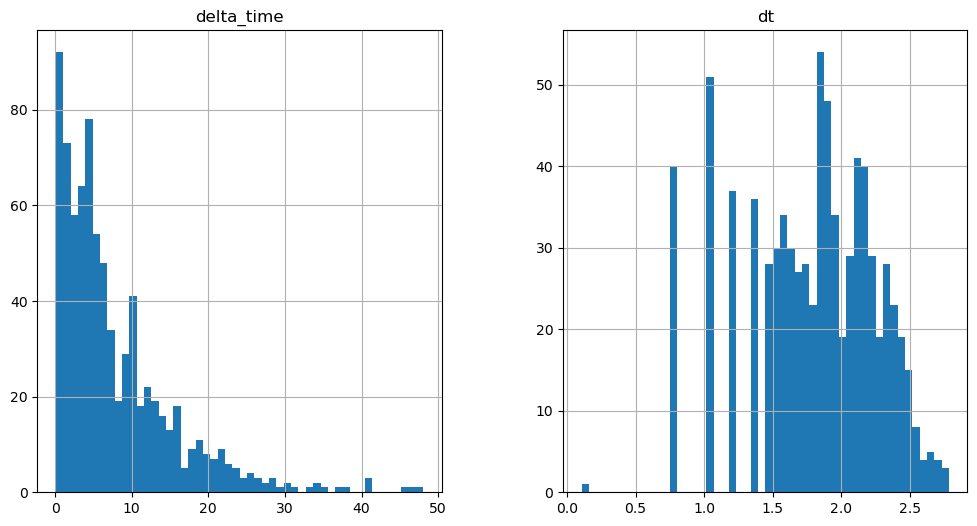

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

22.051721155643463 0.1


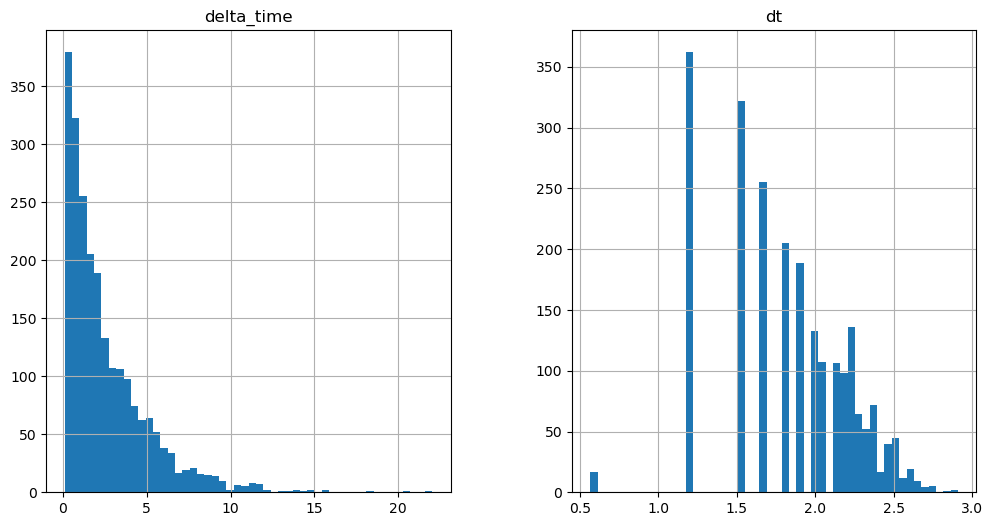

84.23802411556244 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

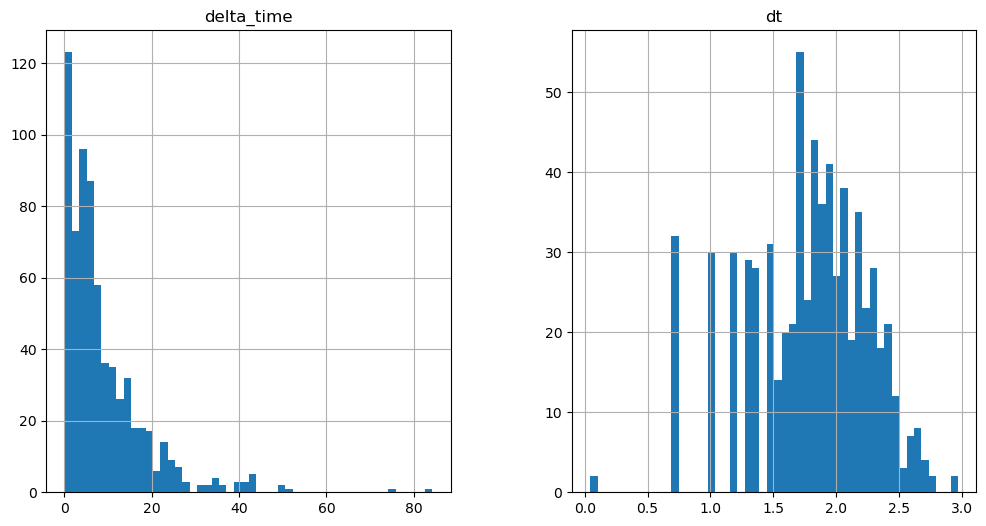

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

46.74992227554321 0.1


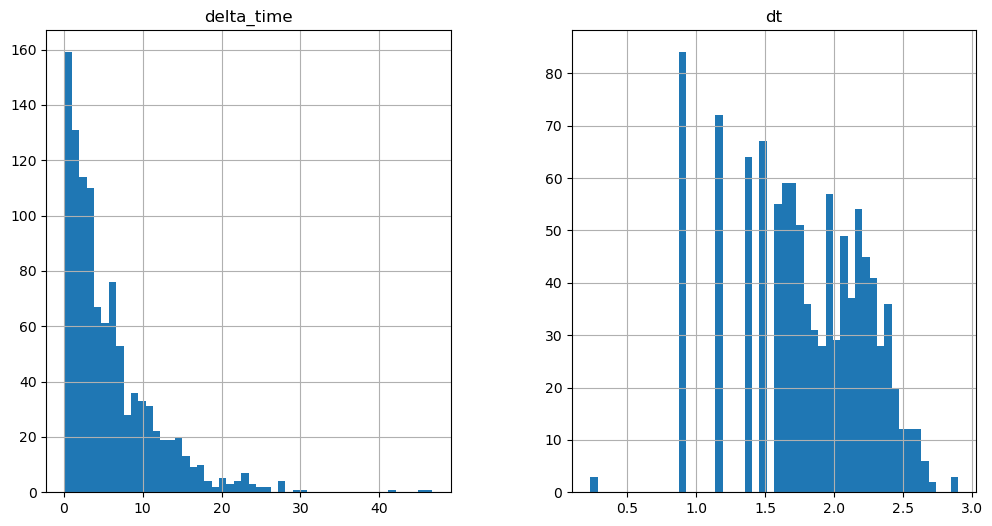

3183.82247030735 1.7641299962997437


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

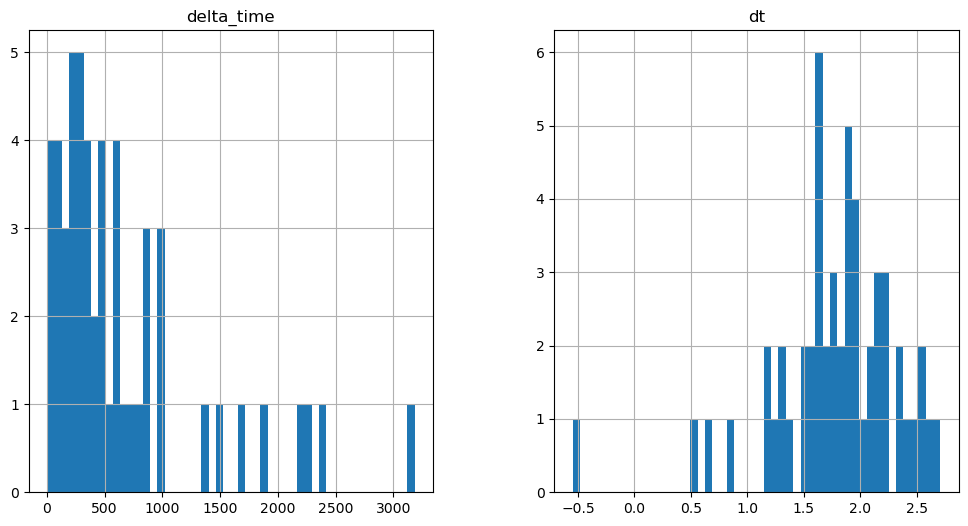

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2454.7937435507774 2.205180048942566


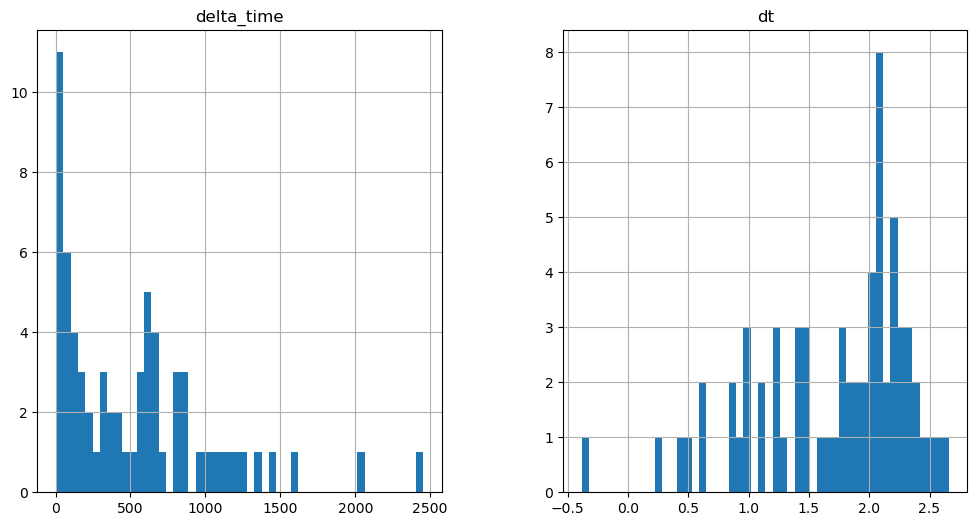

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

20.28755110502243 0.1


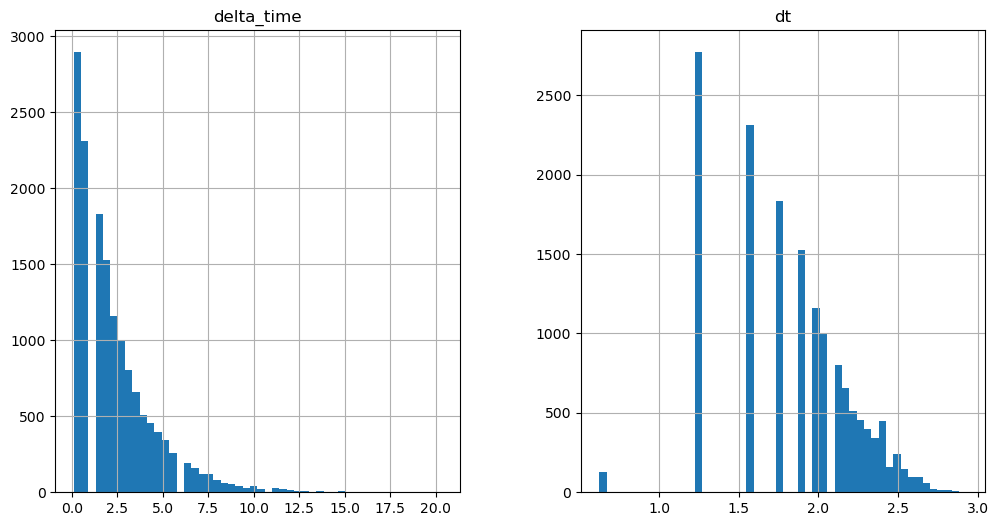

2213.602676600218 9.722990408539772


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

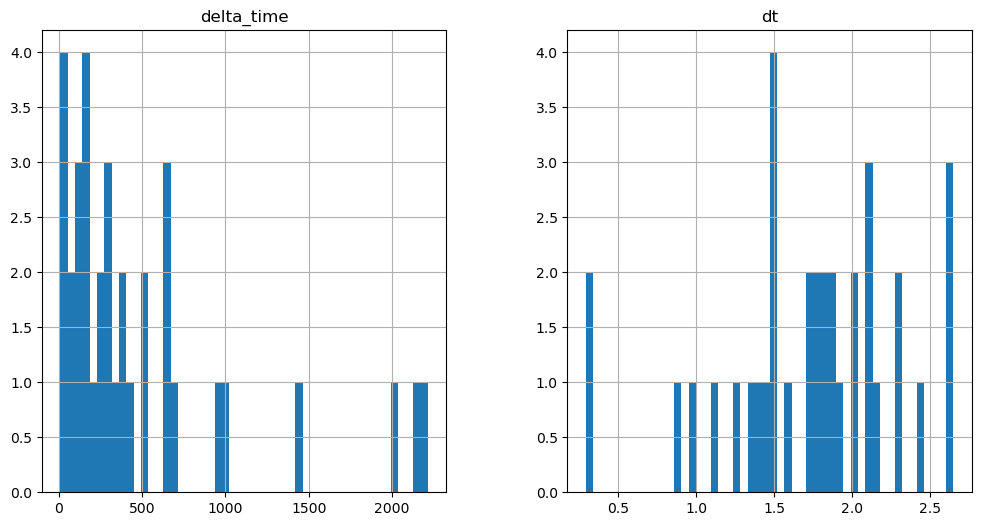

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

985.2638484835625 0.1


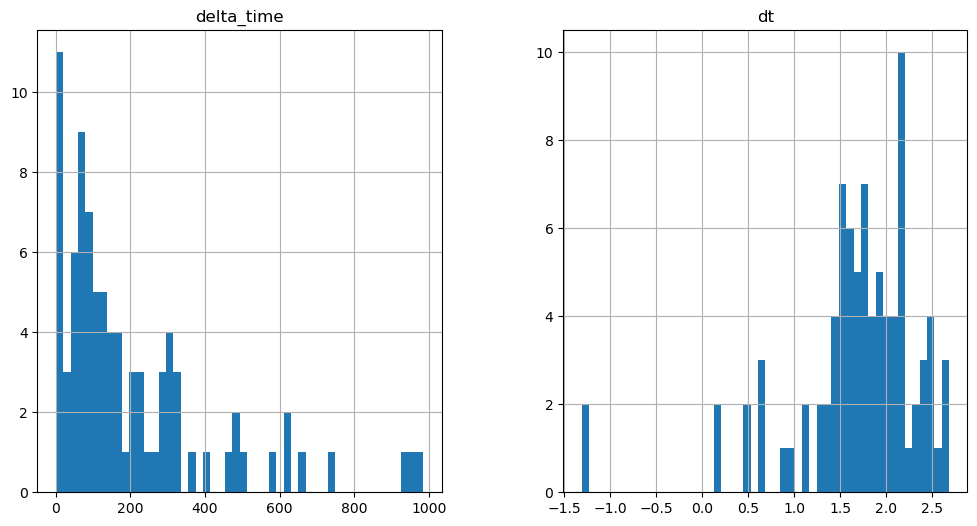

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1532.9926999509335 6.482010245323181


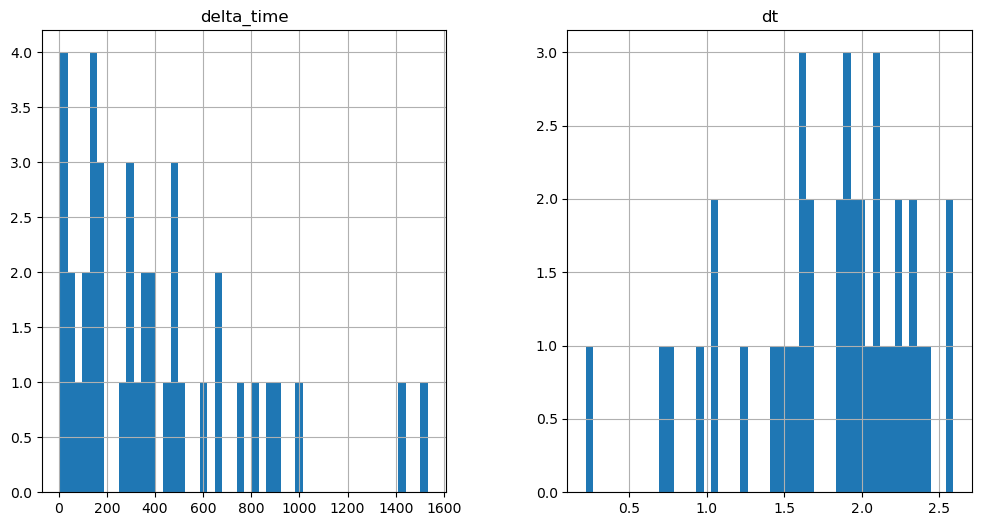

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))


191.21893754601479 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["E"] = np.log10(df_id["energy"])


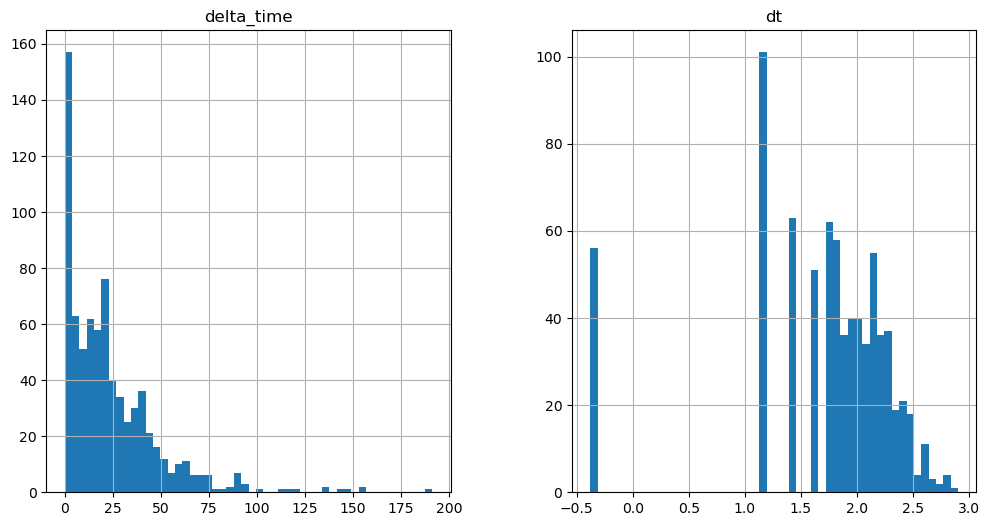

891.2746848613024 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

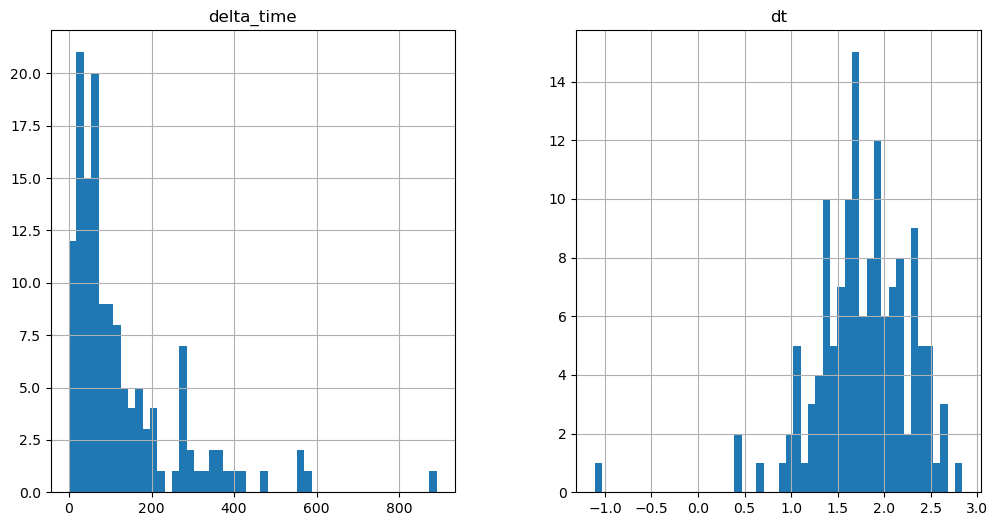

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1166.9772675037384 2.6461902260780334


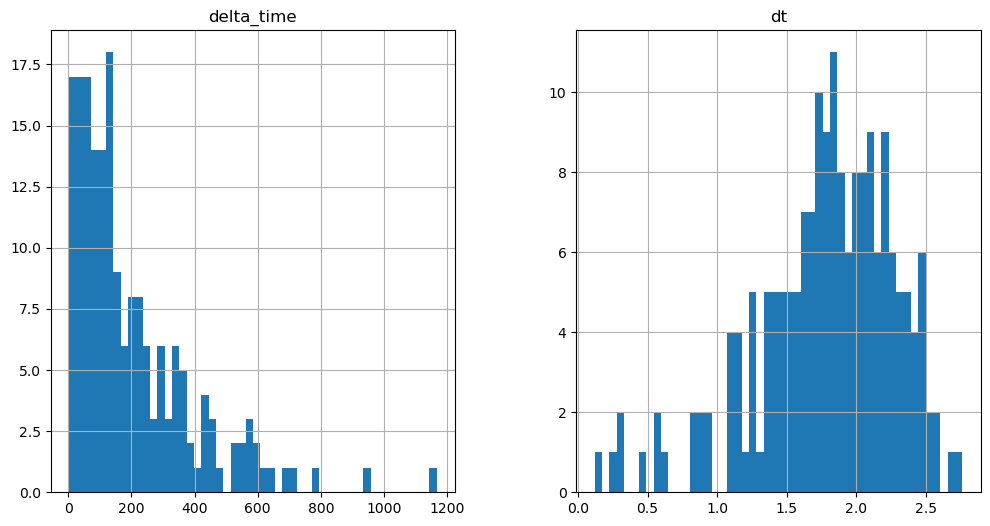

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1166.9772675037384 2.6461902260780334


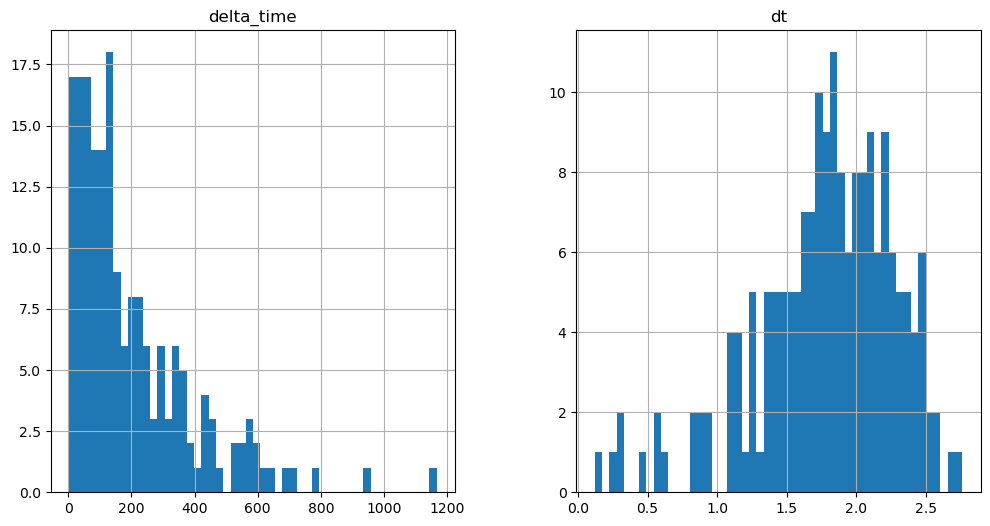

288.44916462898254 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

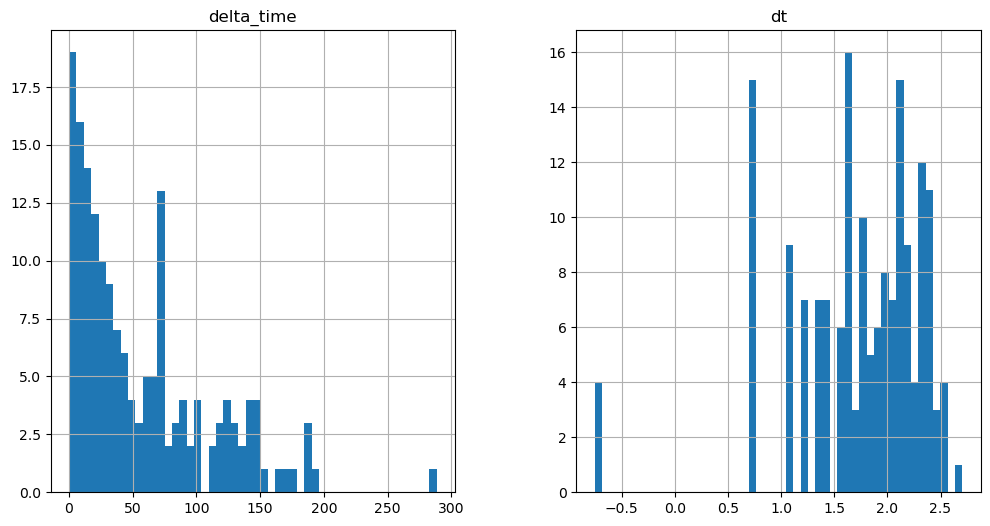

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

713.0205558538437 0.1


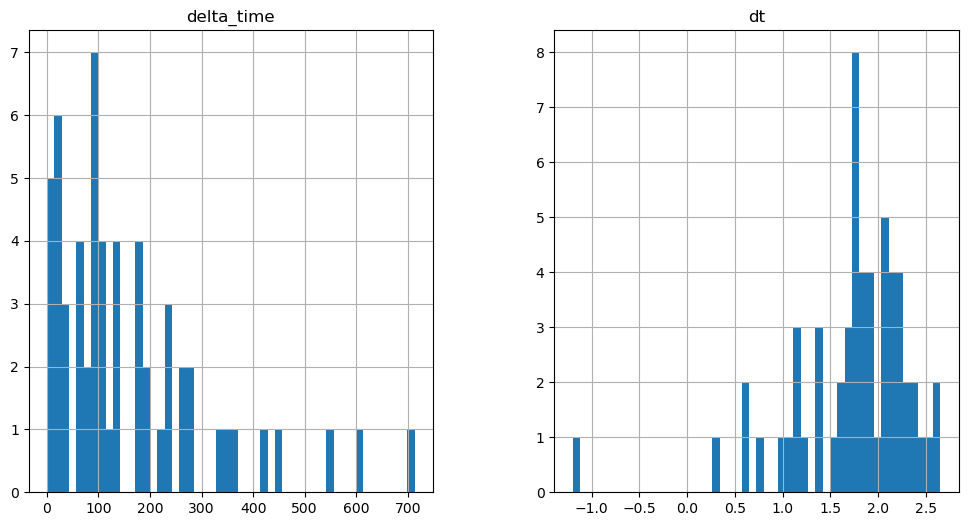

353.26925778388977 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

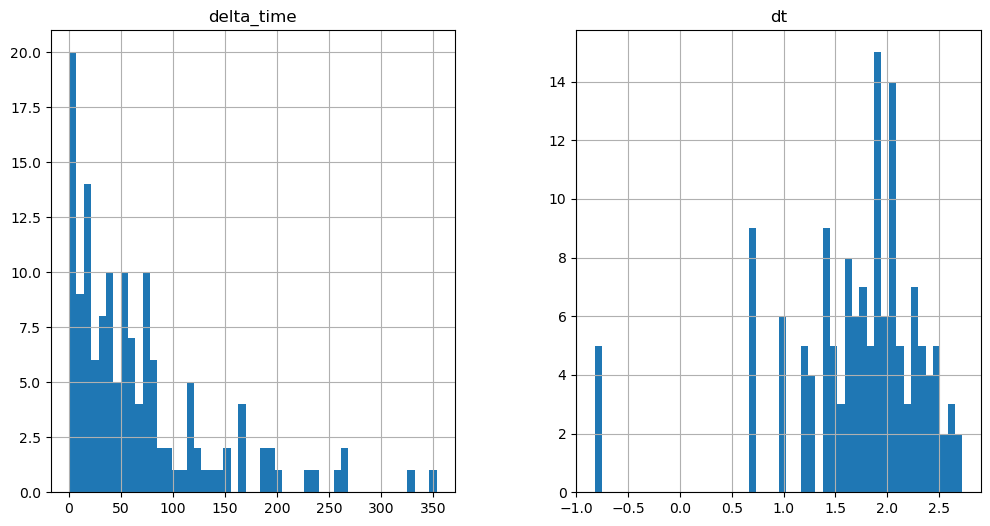

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3143.7722074389458 3.240990161895752


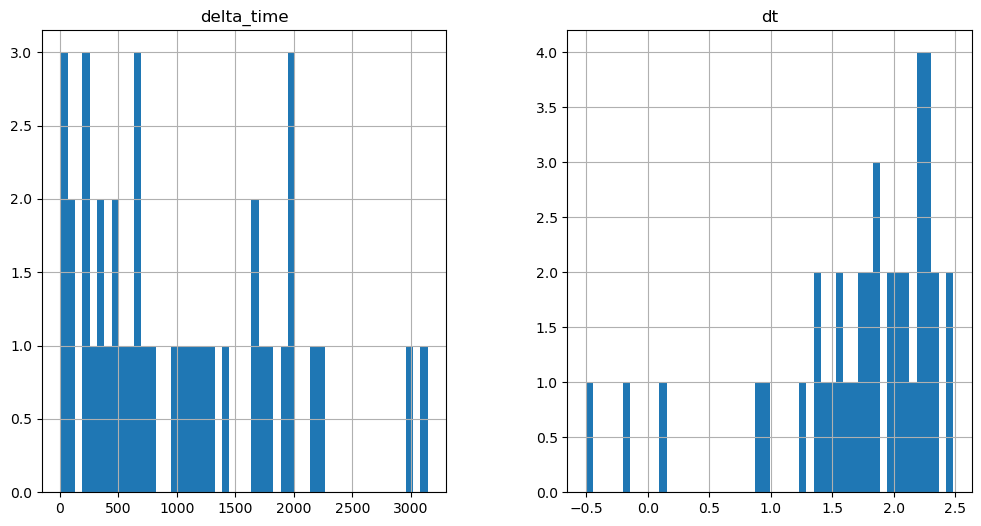

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

641.7184022068977 0.1


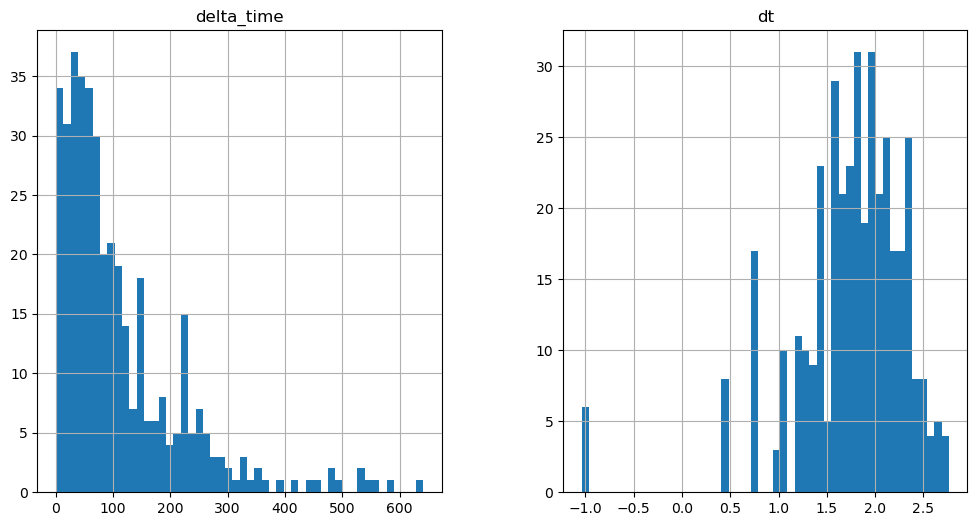

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2294.6296148896217 3.241020083427429


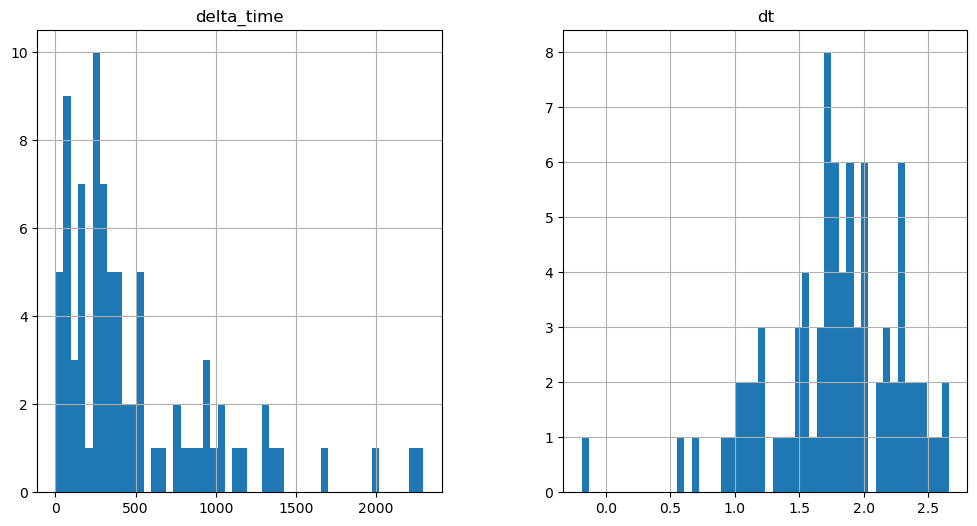

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3863.274773299694 12.964020669460297


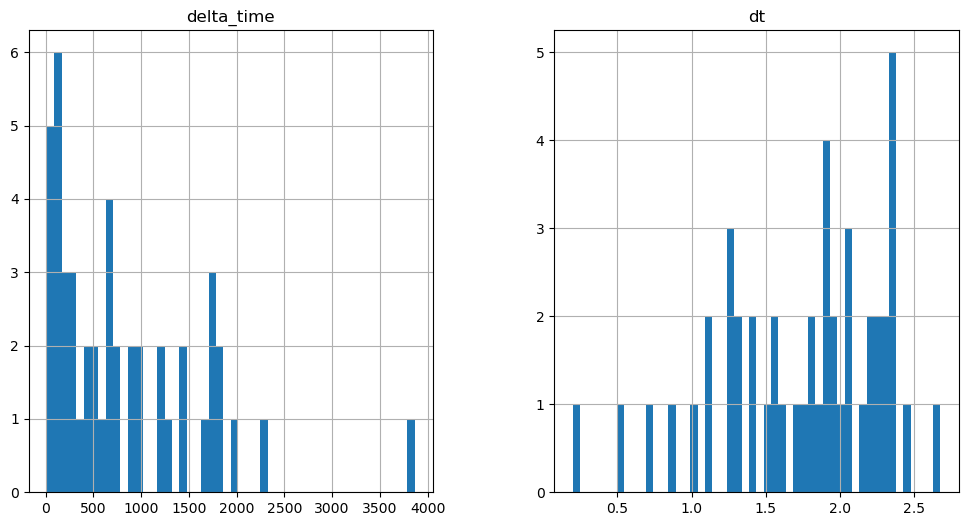

3140.531307399273 3.2409903407096863


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

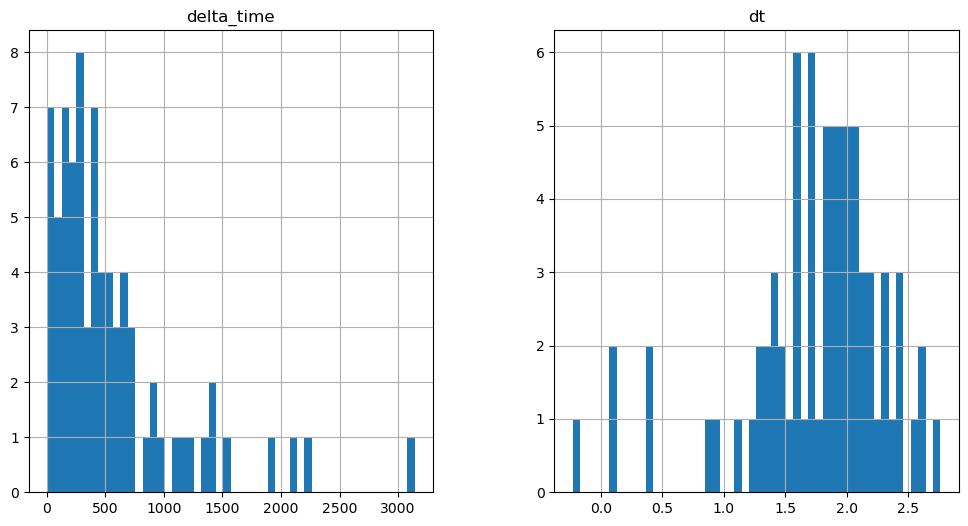

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2751.6109377741814 0.1


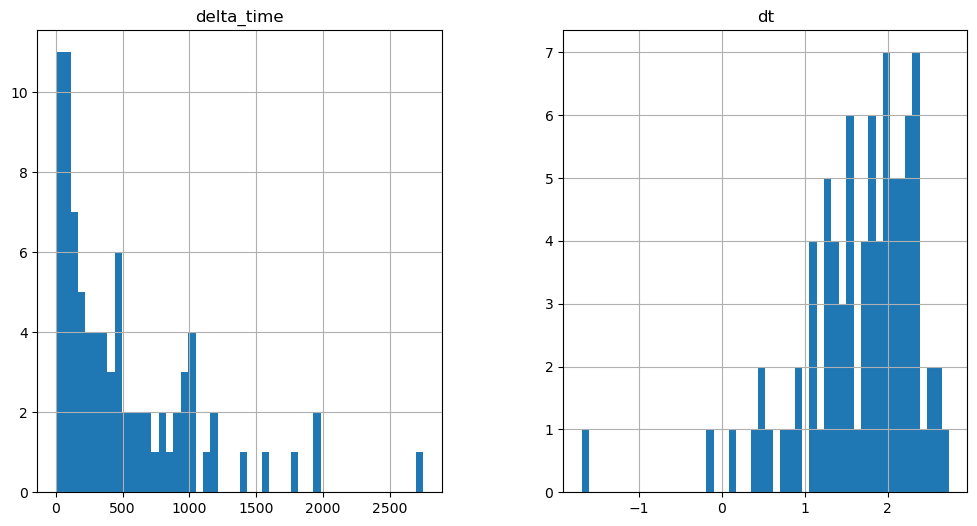

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3091.916364789009 12.96399074792862


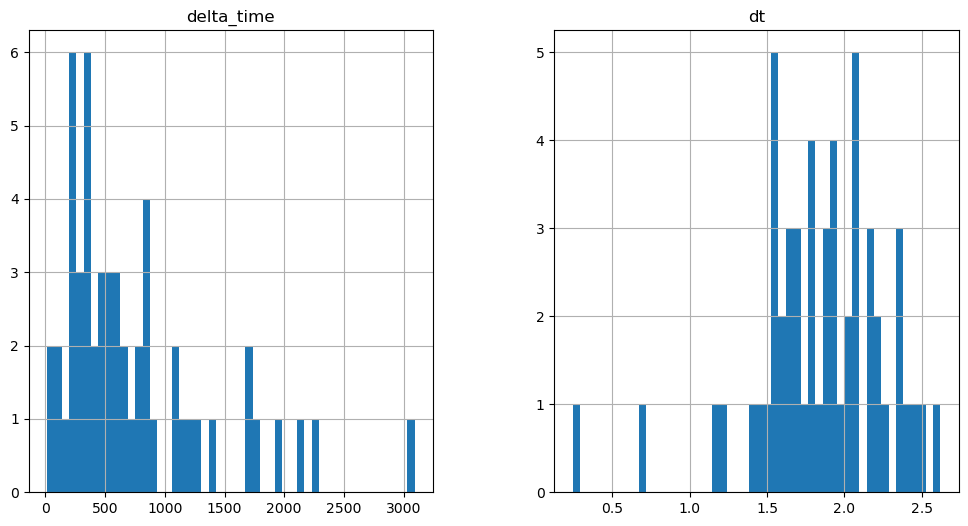

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

709.7796855568886 3.2409902215003967


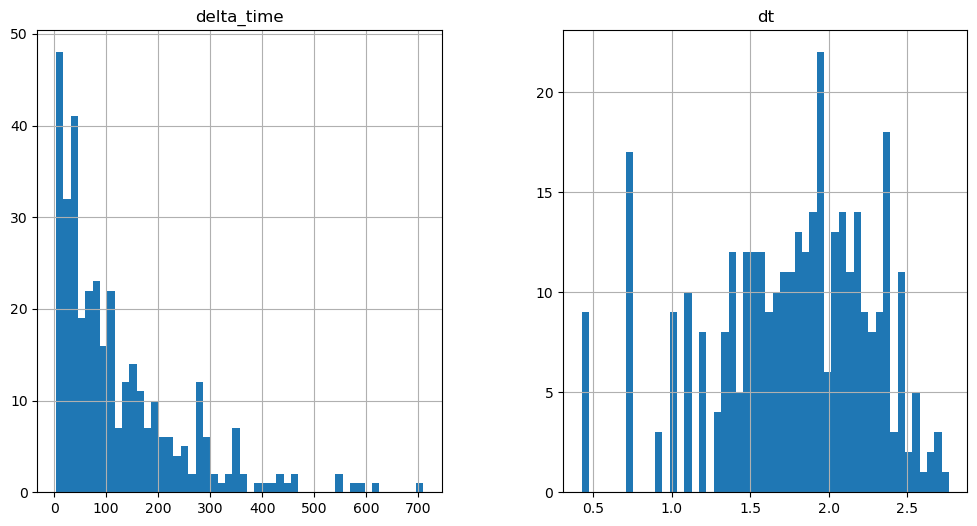

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1756.6232379078865 6.482000350952148


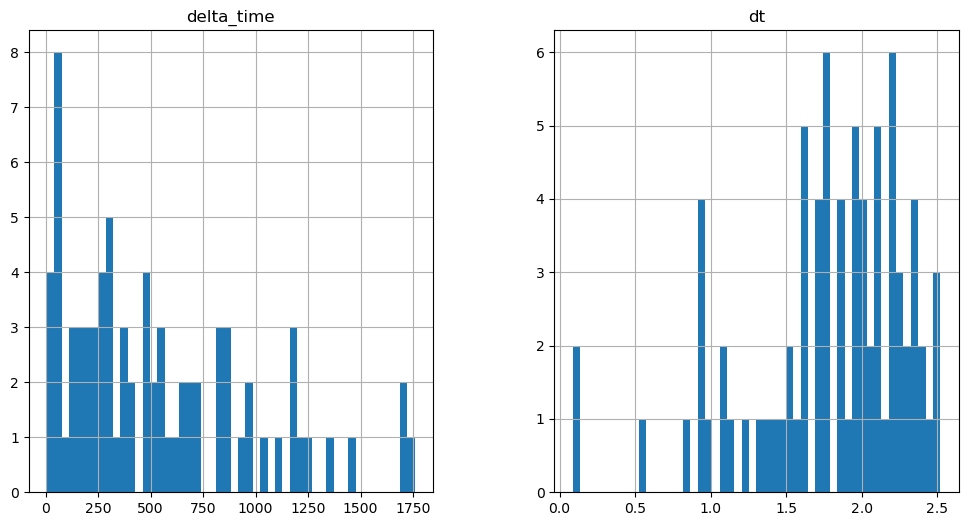

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

433.4608916044235 6.282030284404755


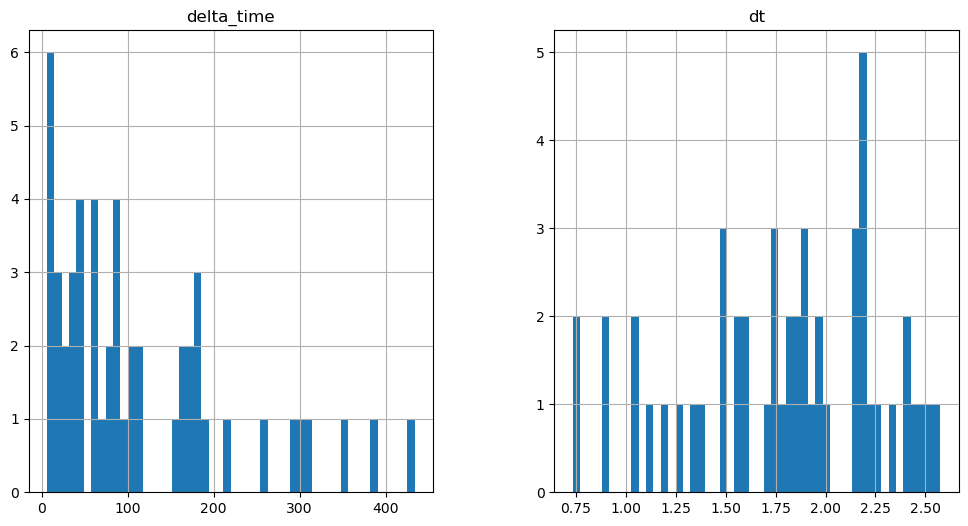

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

239.8342120051384 3.240990161895752


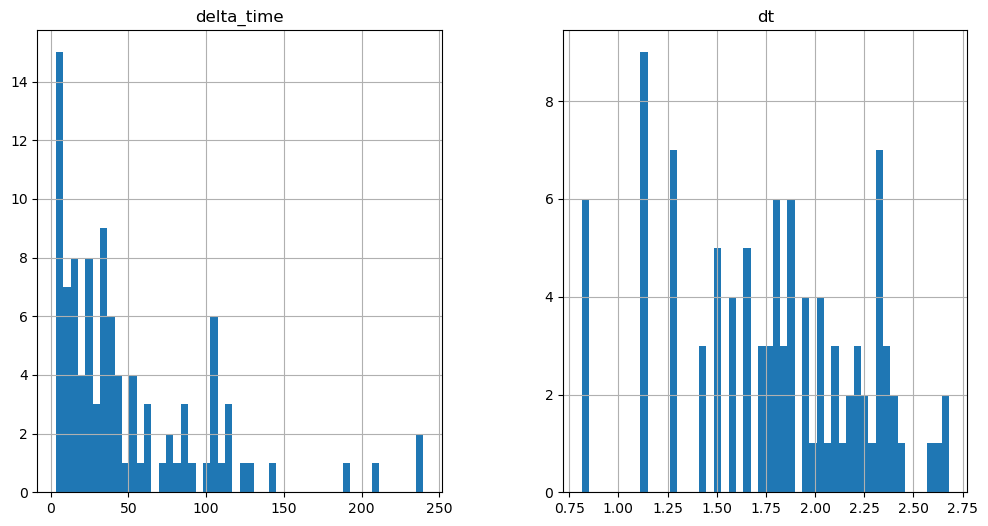

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1633.4648007750511 3.2409902215003967


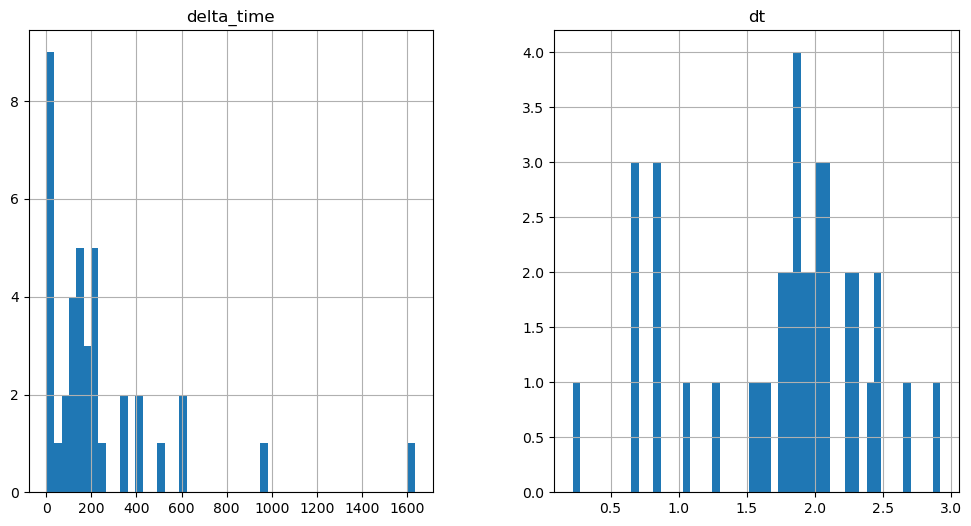

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2560.3914680480957 0.1


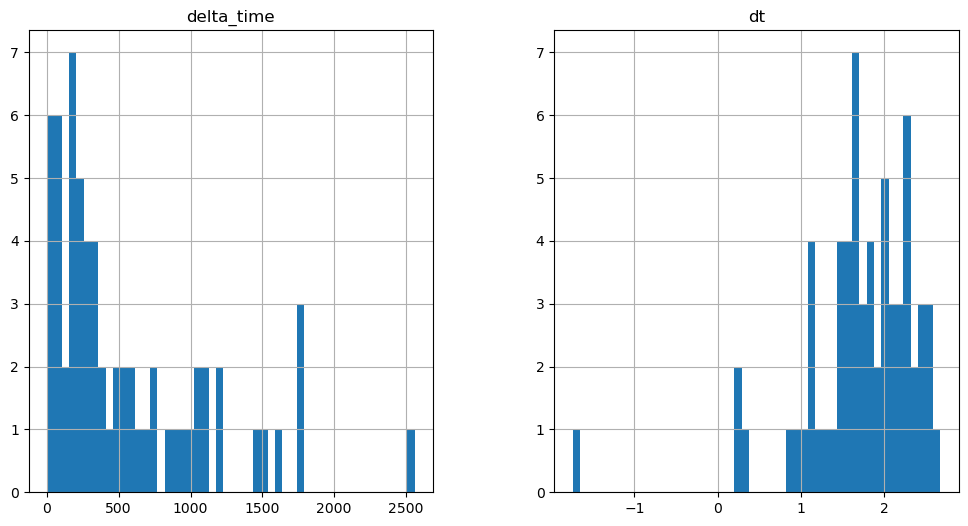

3040.0596021413803 22.687011063098907


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

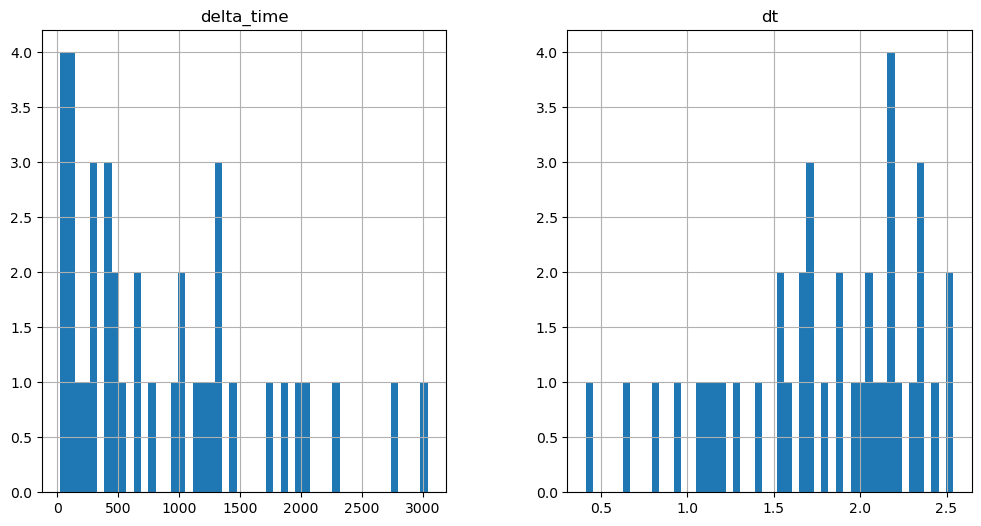

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2035.3490417599678 6.481980383396149


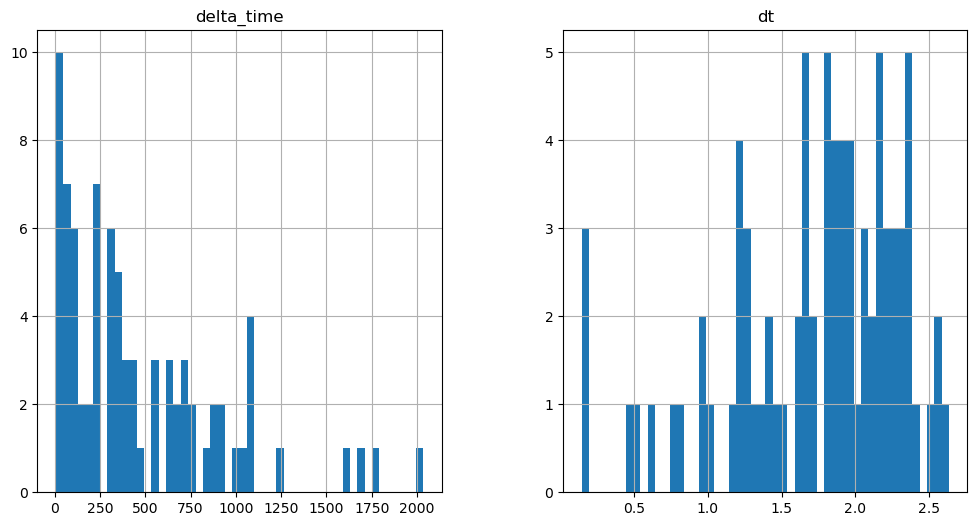

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

9311.398016035557 9.7230304479599


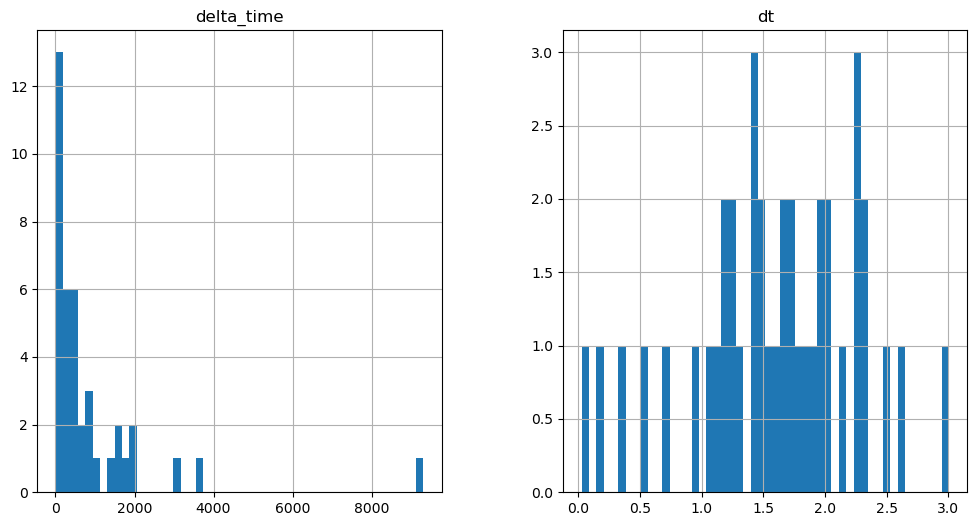

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3911.8890657424927 58.338012993335724


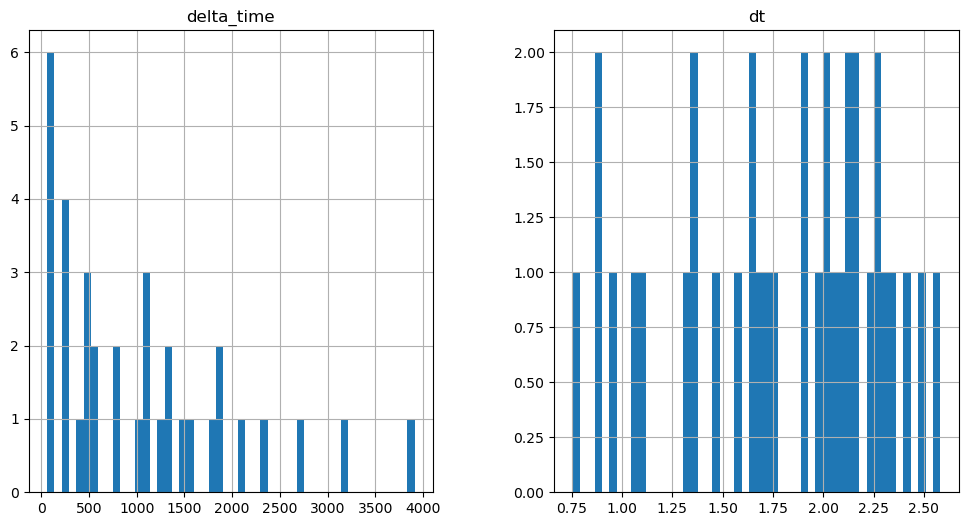

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3892.44305485487 3.2410101294517517


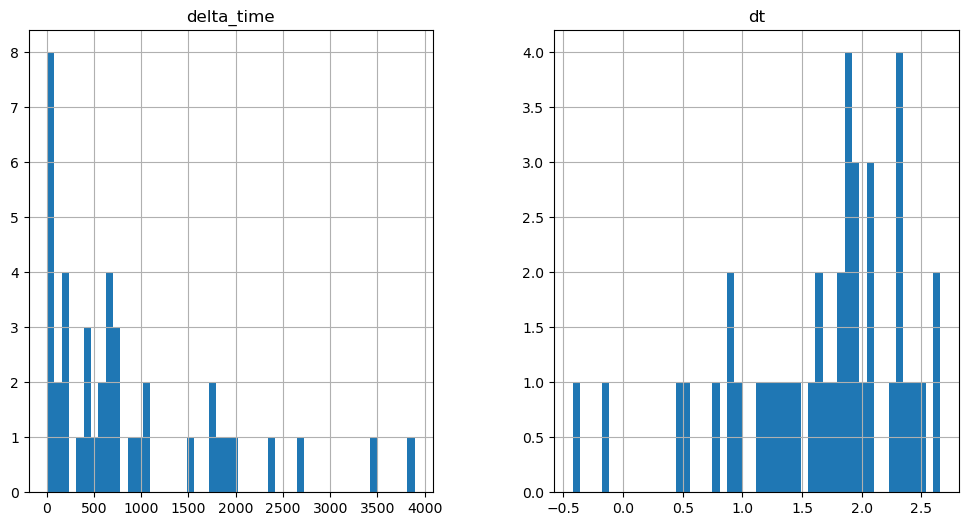

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1218.616851091385 6.481980383396149


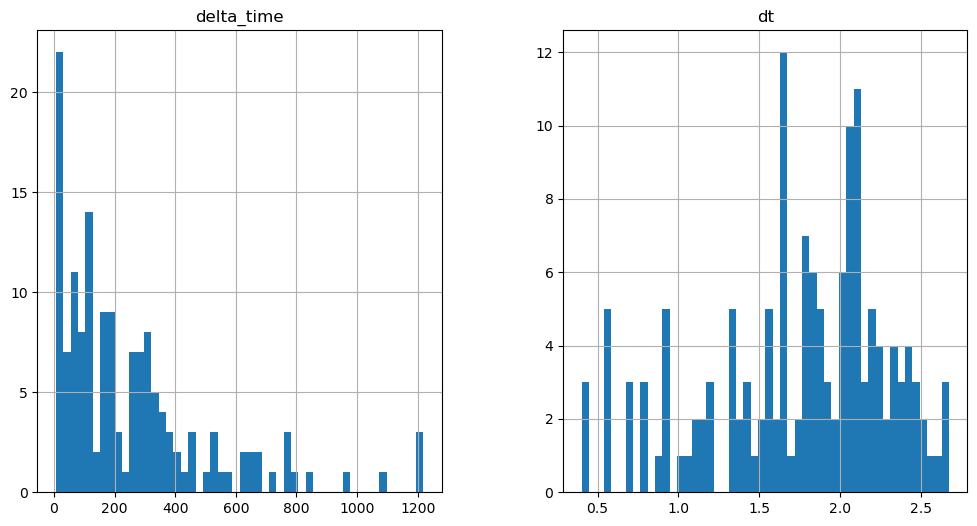

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3817.90007096529 3.241000175476074


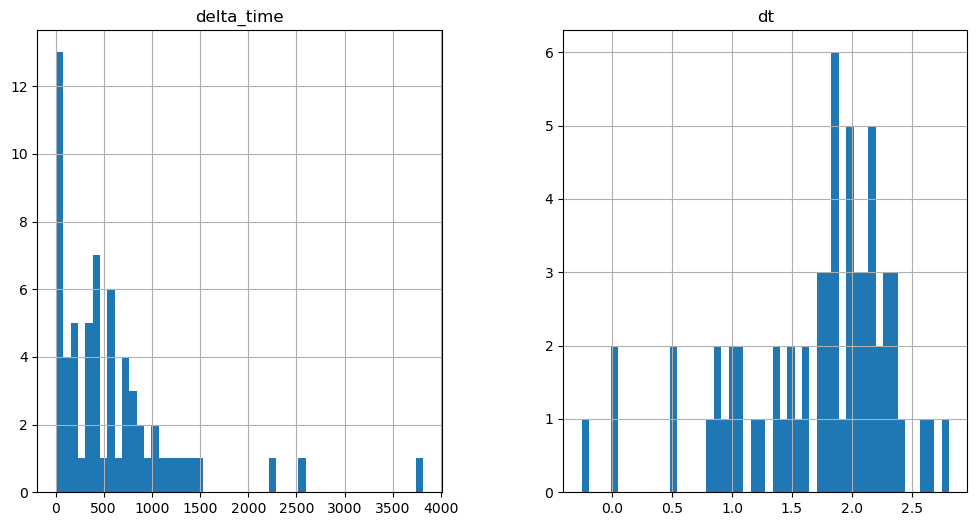

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3561.8608582615852 19.446030914783478


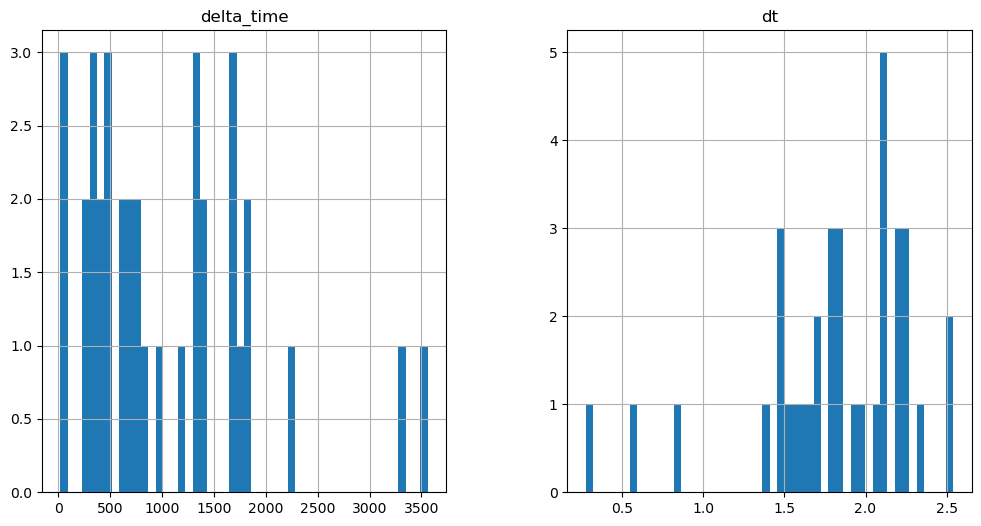

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2450.1975625753403 3.2409903407096863


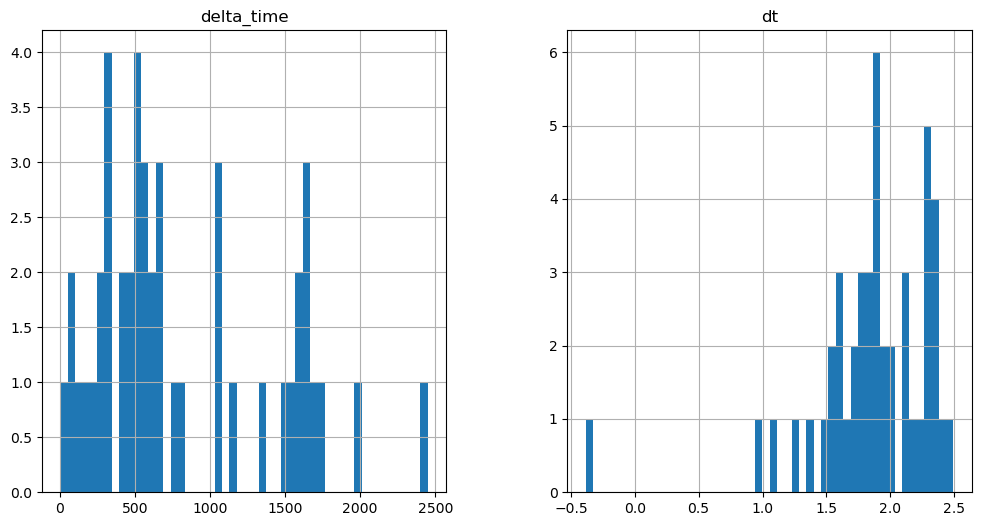

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

956.0955078601837 0.1


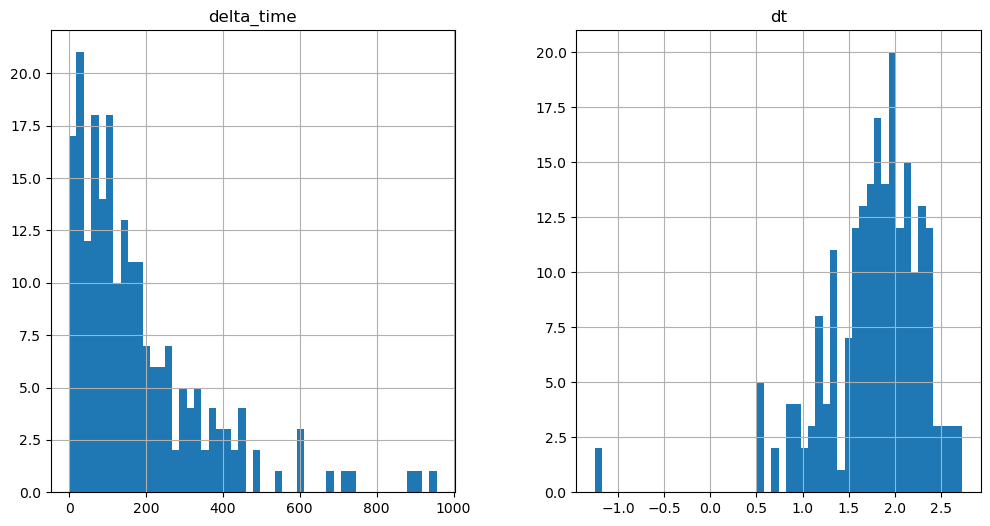

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

6712.121365904808 32.41001158952713


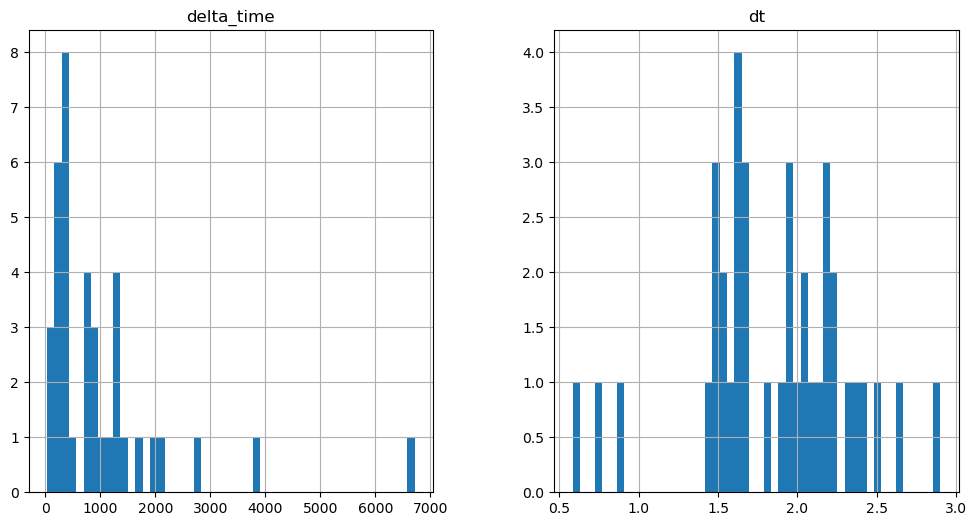

683.8513742685318 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

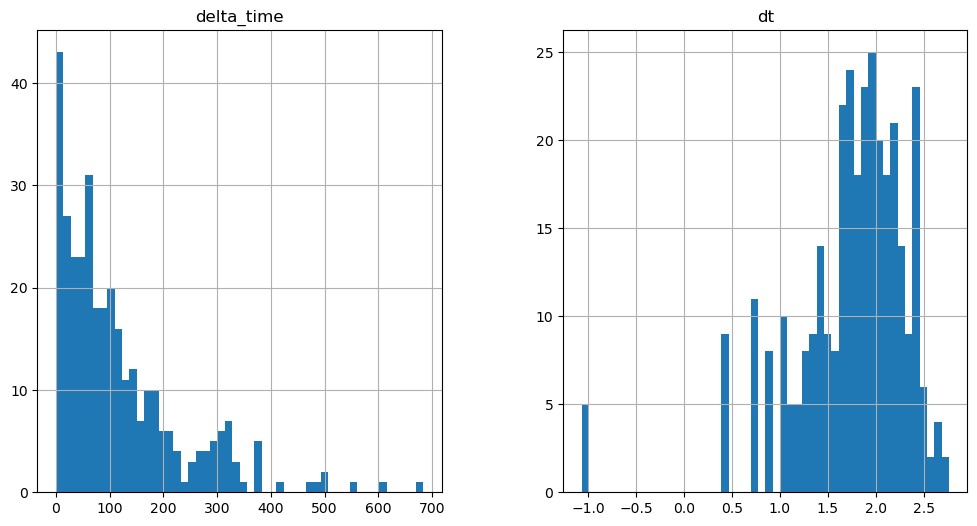

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2161.748258113861 0.1


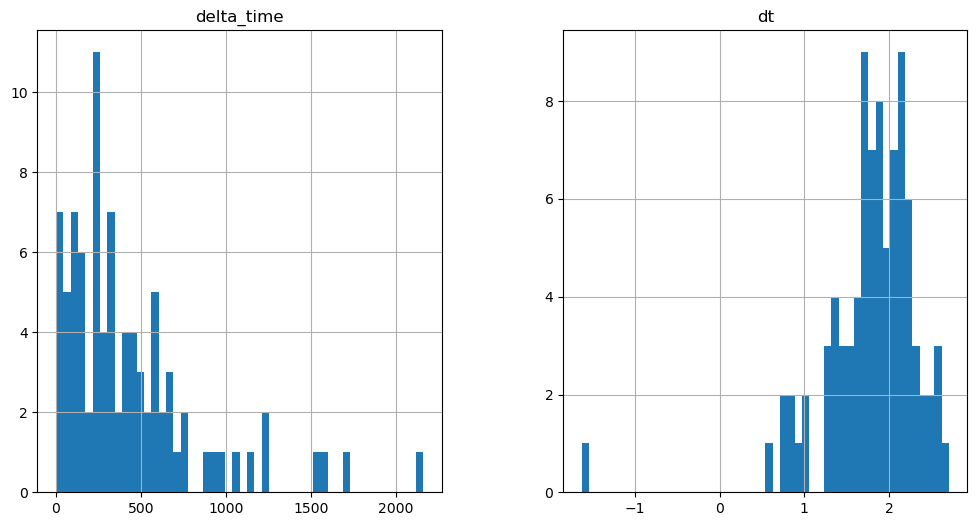

2897.45548504591 9.723020374774933


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

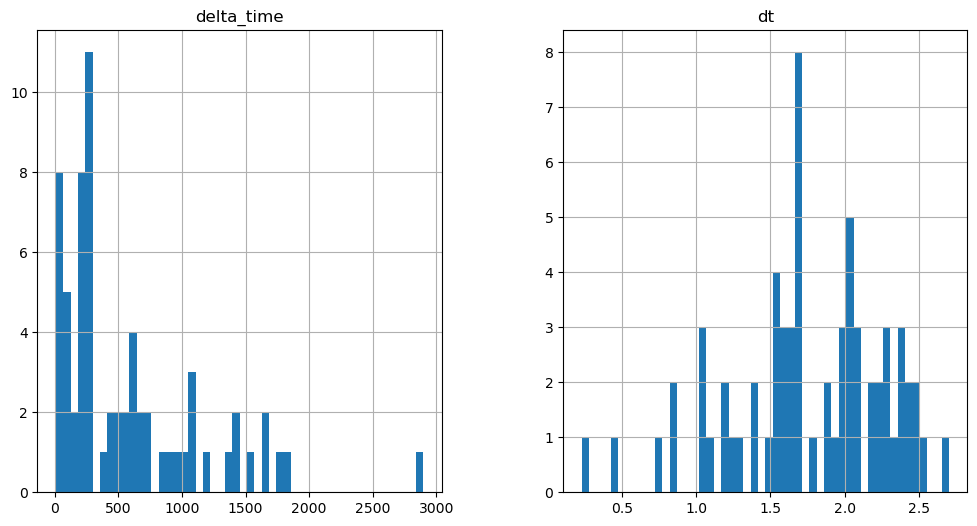

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

852.3836326599121 3.2409703135490417


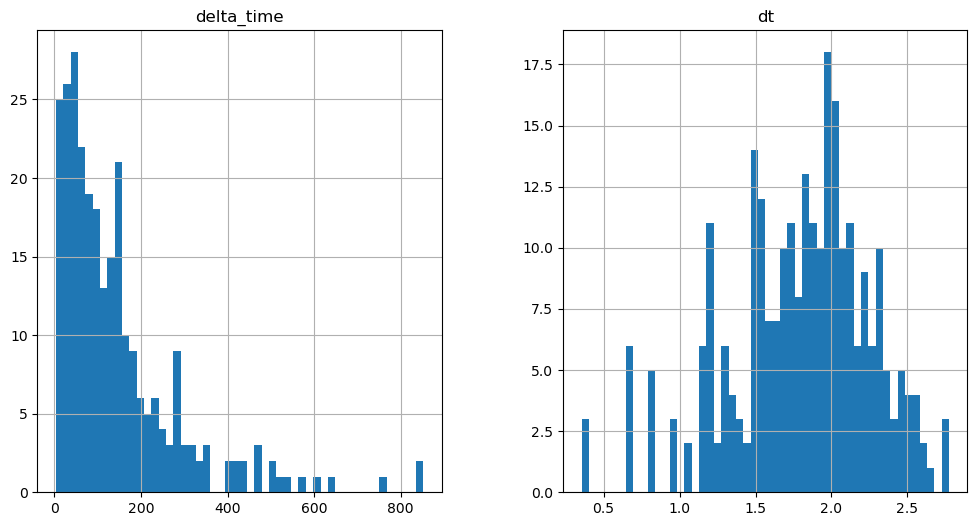

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

570.4162784814835 0.1


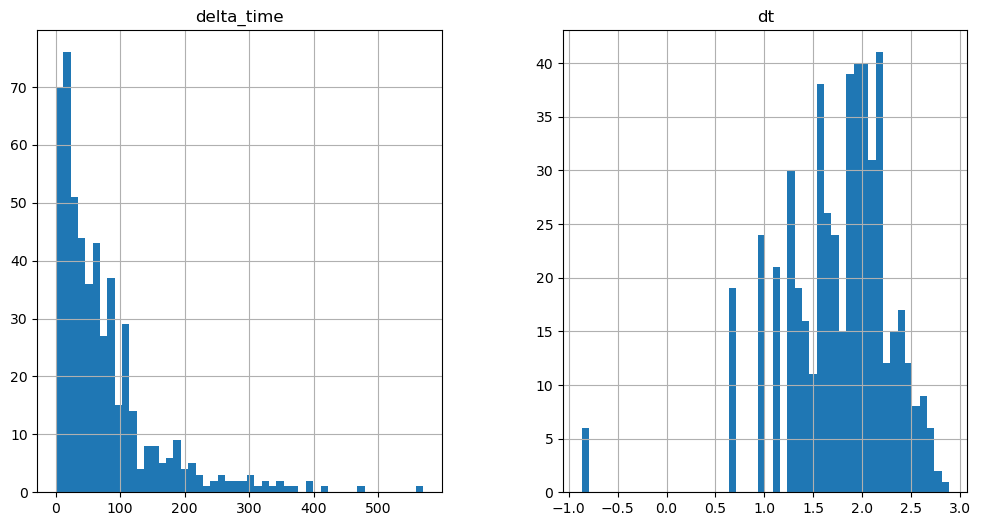

884.7934843301773 3.2409902215003967


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

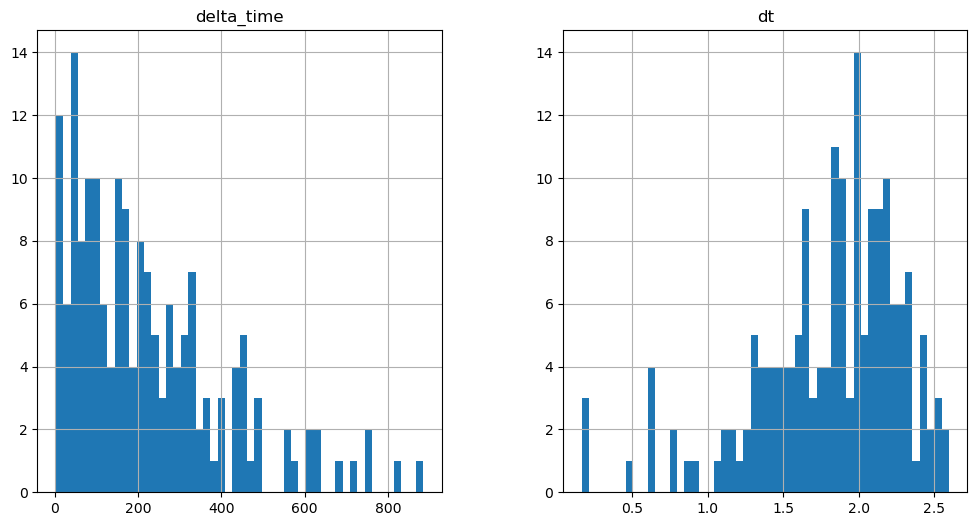

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2609.0321697592735 3.241040050983429


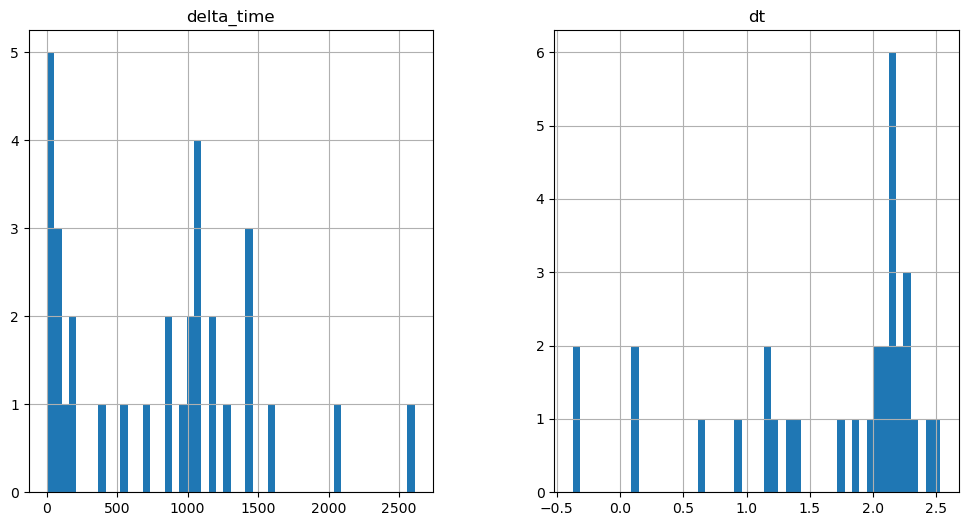

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

395.4052296280861 0.1


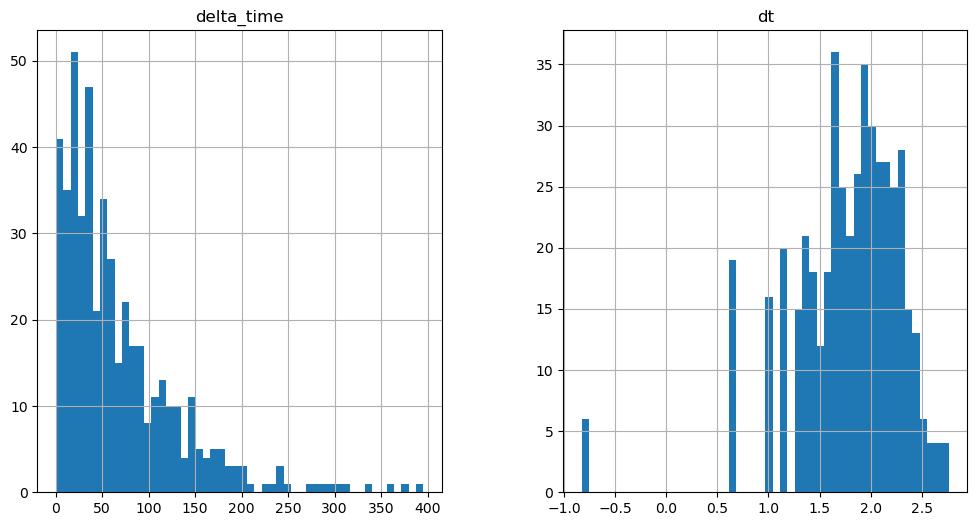

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5234.25265032053 6.4820404052734375


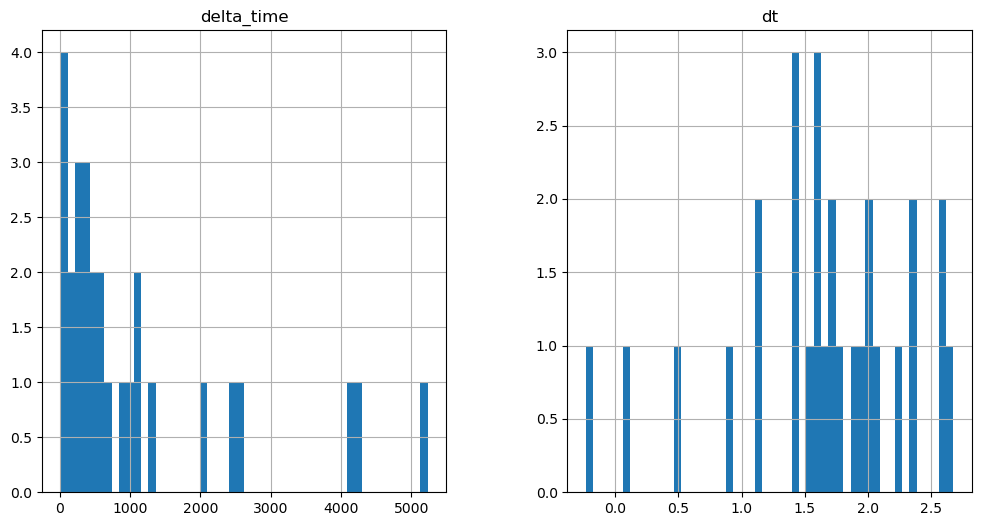

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

327.34320628643036 0.1


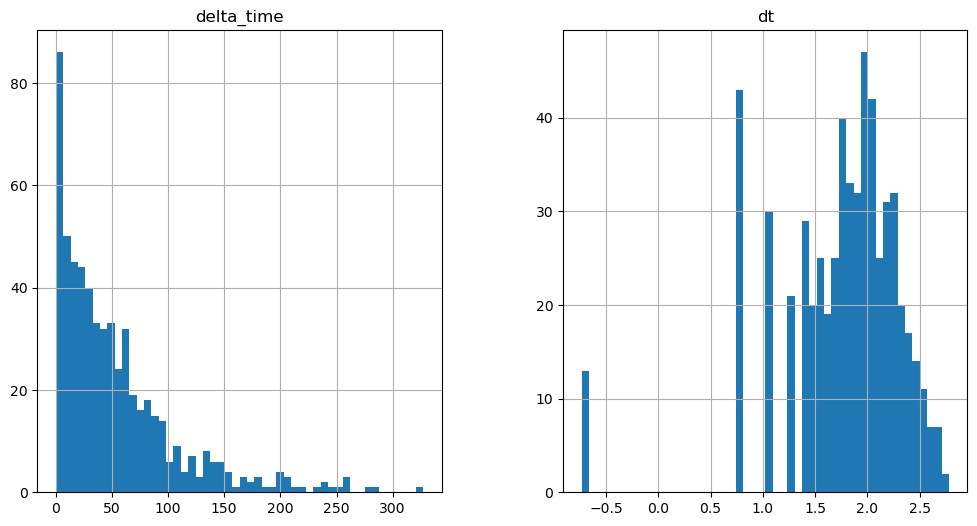

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

680.6177638173103 0.1


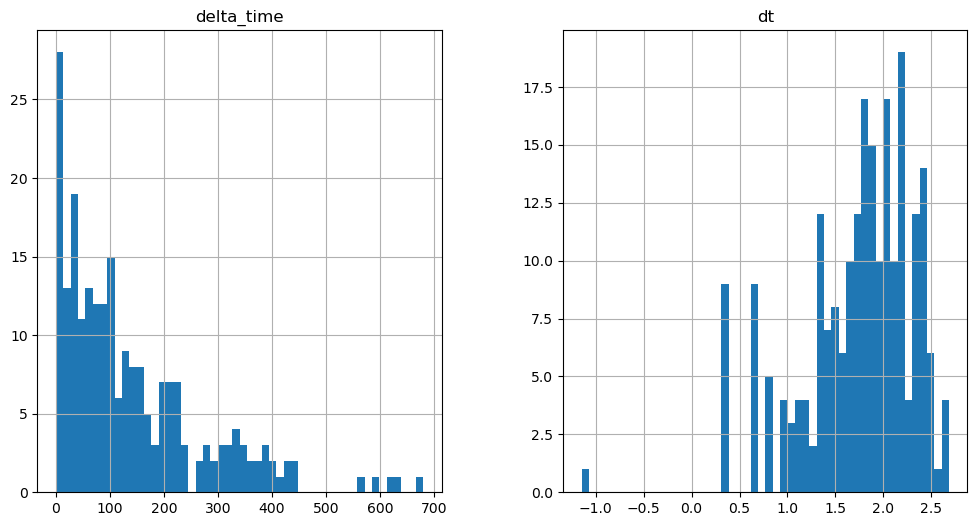

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2083.9857537150383 3.2410301566123962


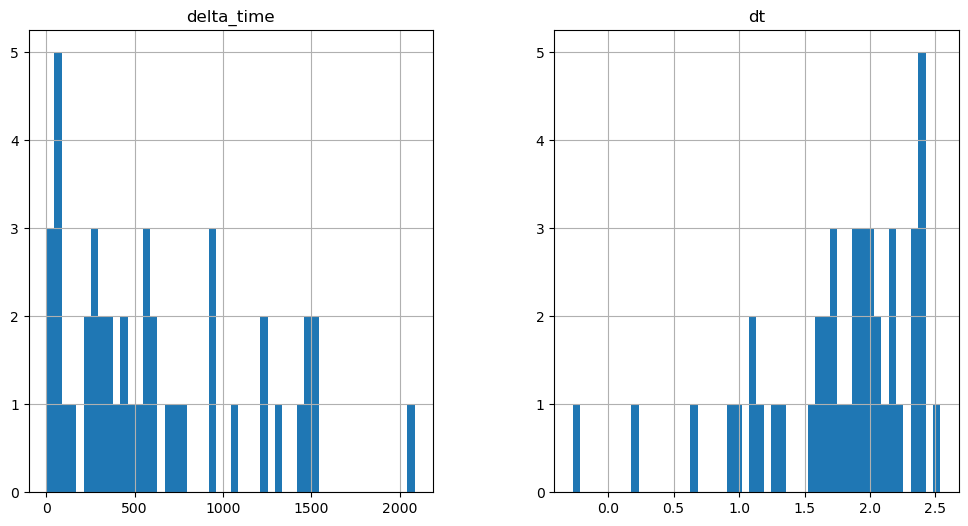

1251.0378822088242 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

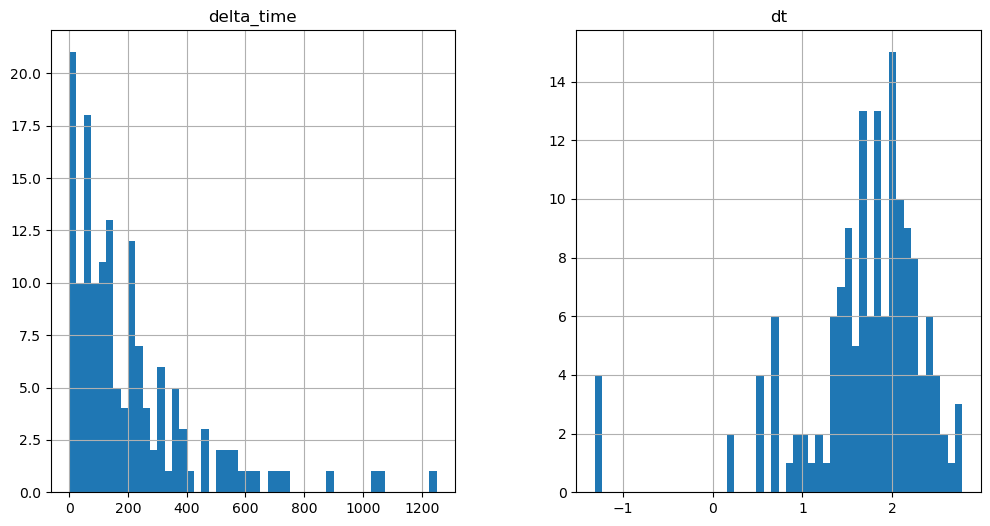

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

777.8480387330055 0.1


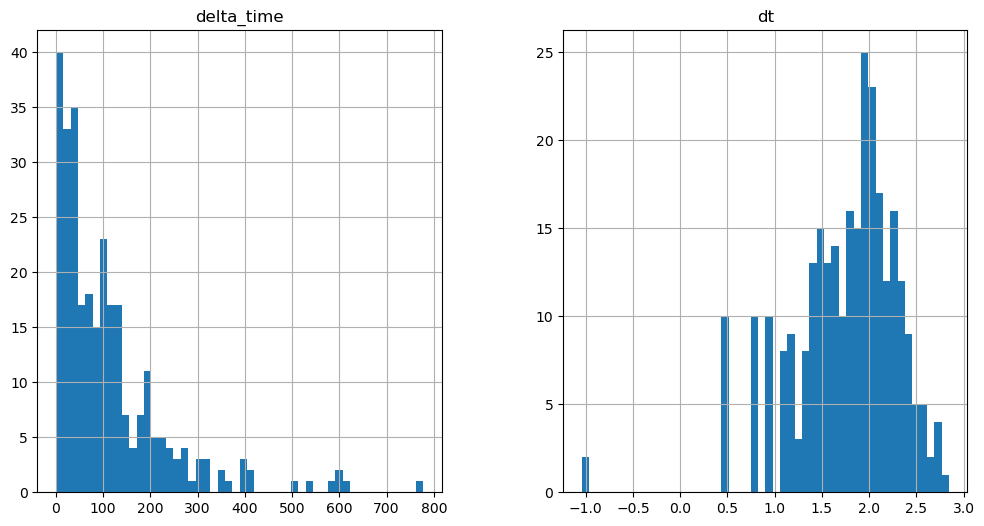

2083.9857537150383 3.2410301566123962


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

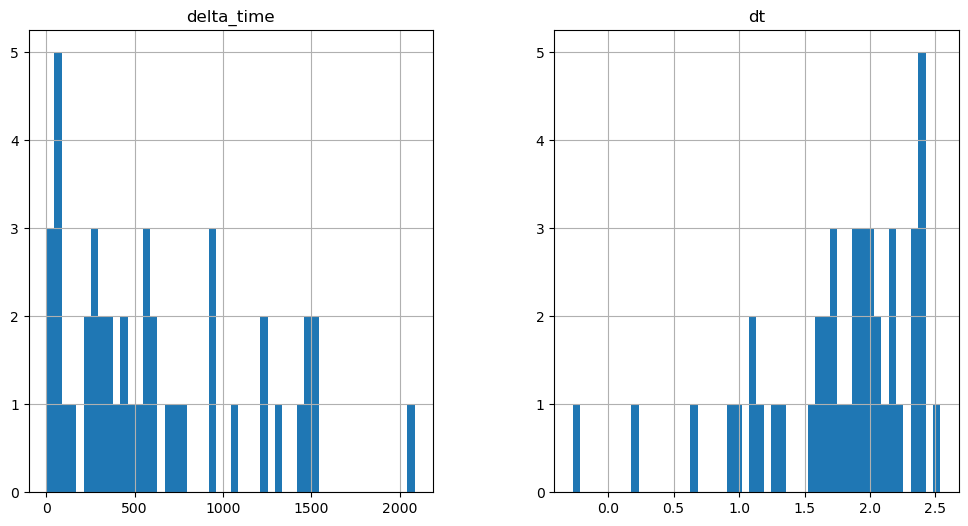

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

518.5647557377815 0.1


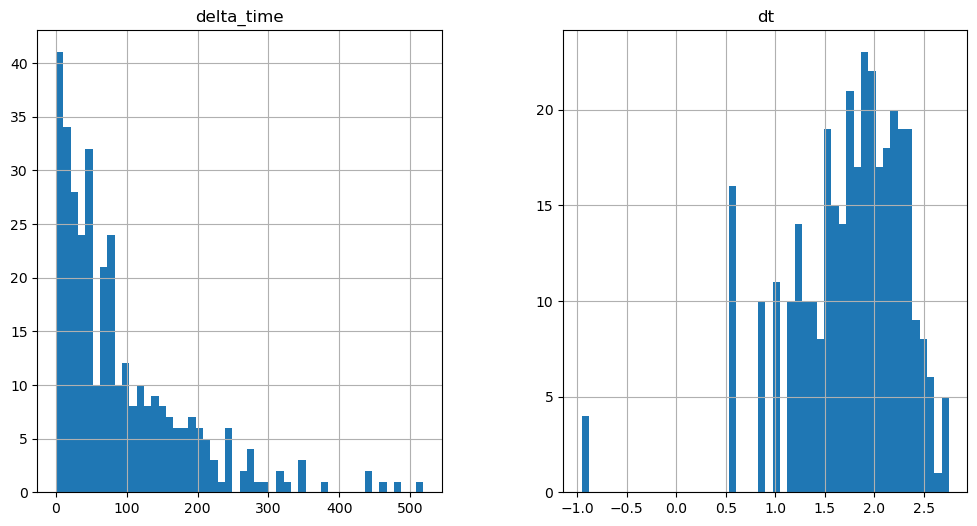

226.87151128053665 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

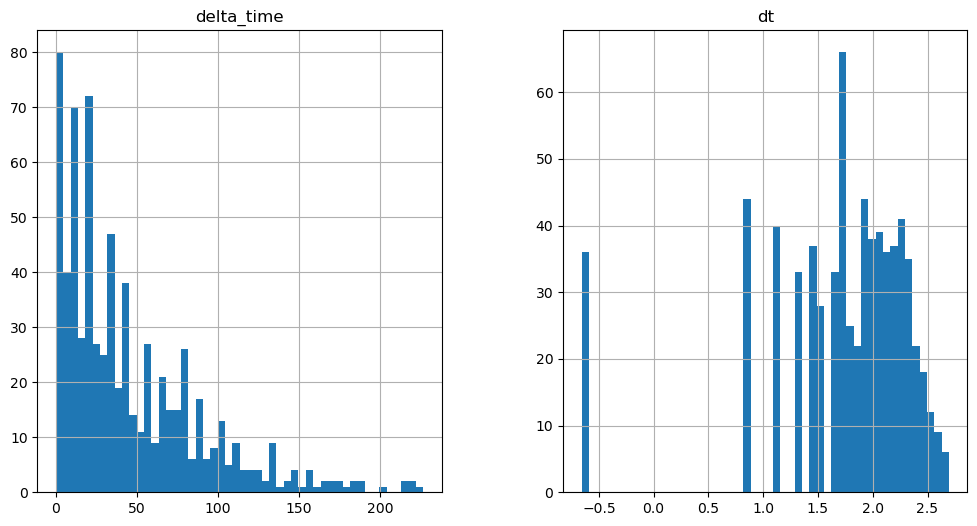

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1746.9182668924332 3.2410300970077515


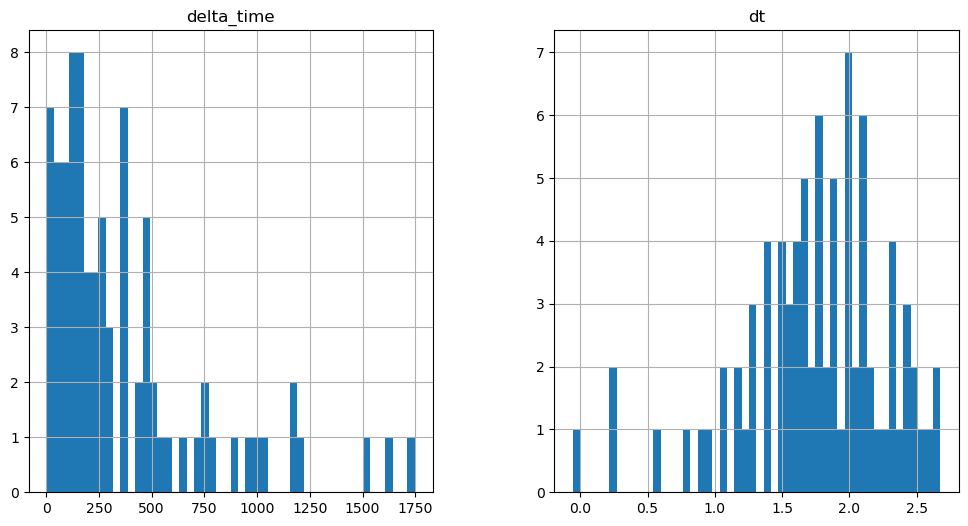

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

238.85990190505981 0.1


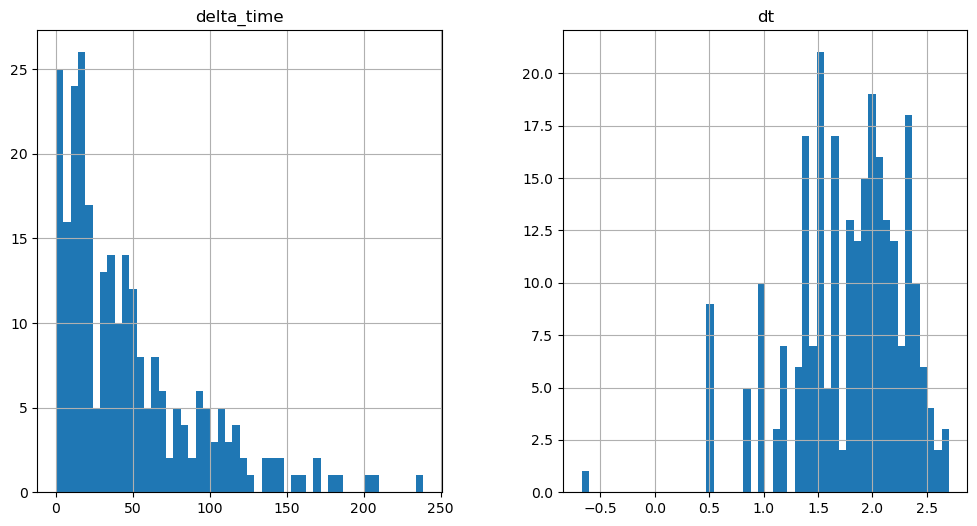

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

879.9274839758873 10.787150621414185


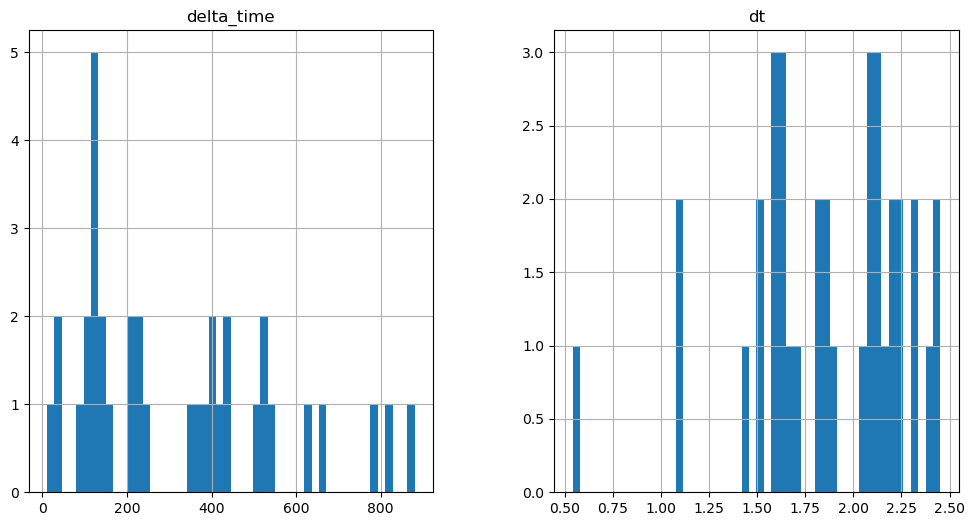

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1598.0388187766075 13.869230687618256


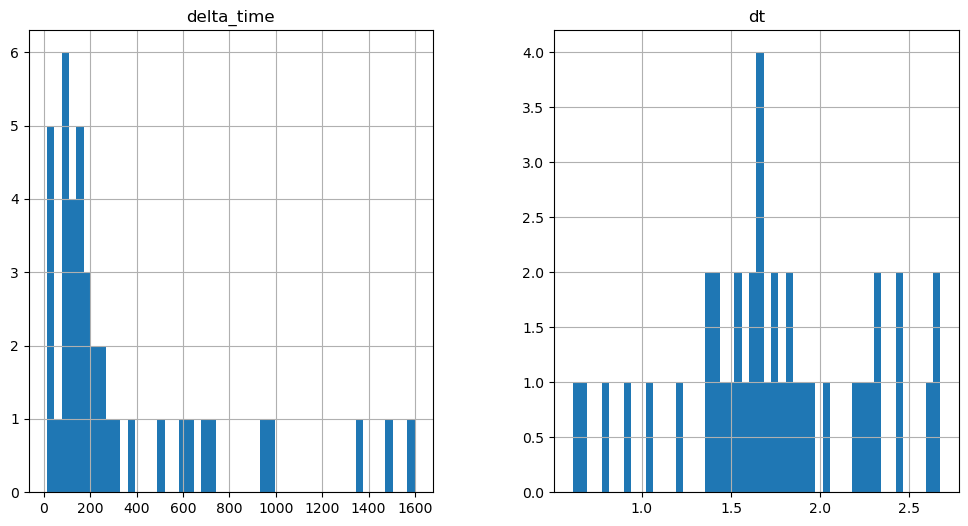

827.5319709777832 3.082030236721039


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

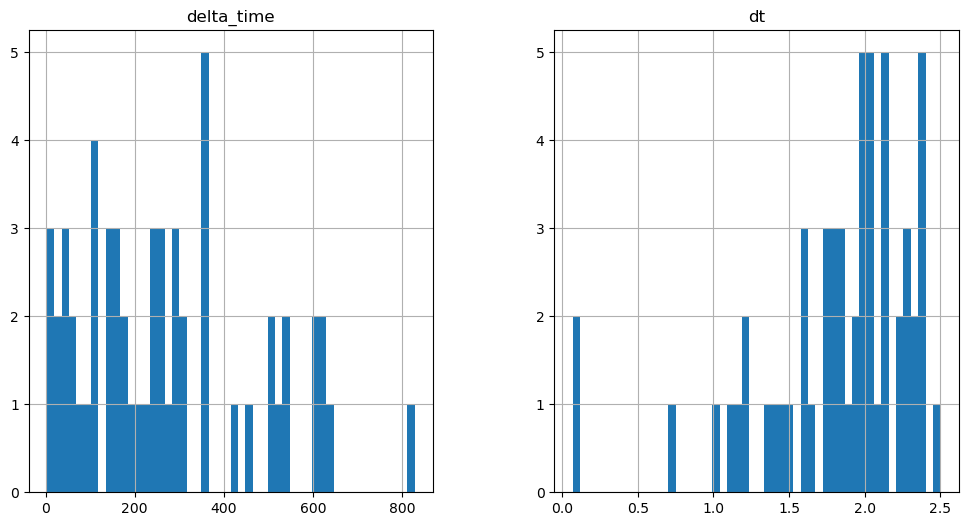

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1852.3070021271706 4.623070240020752


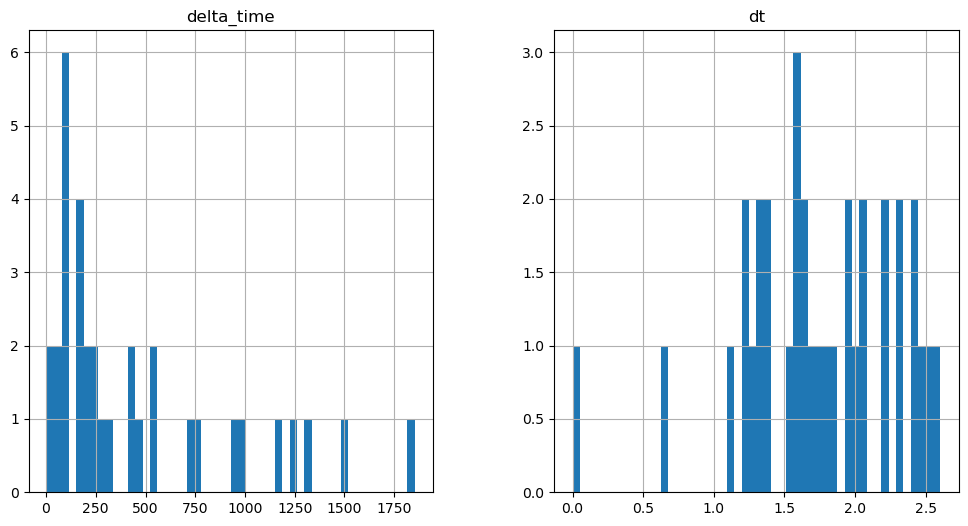

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1708.9961649179459 1.5410400032997131


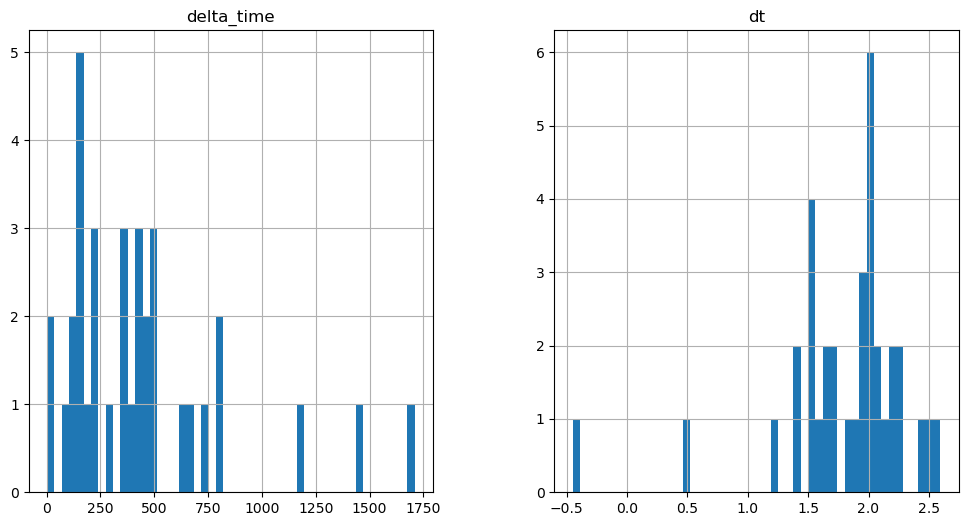

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1545.656466782093 6.16411030292511


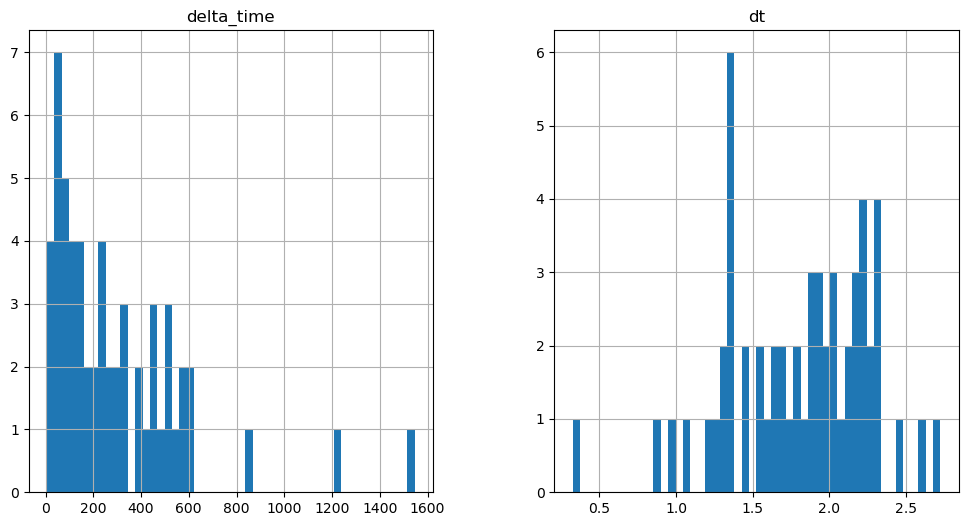

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

503.915875017643 1.5410101413726807


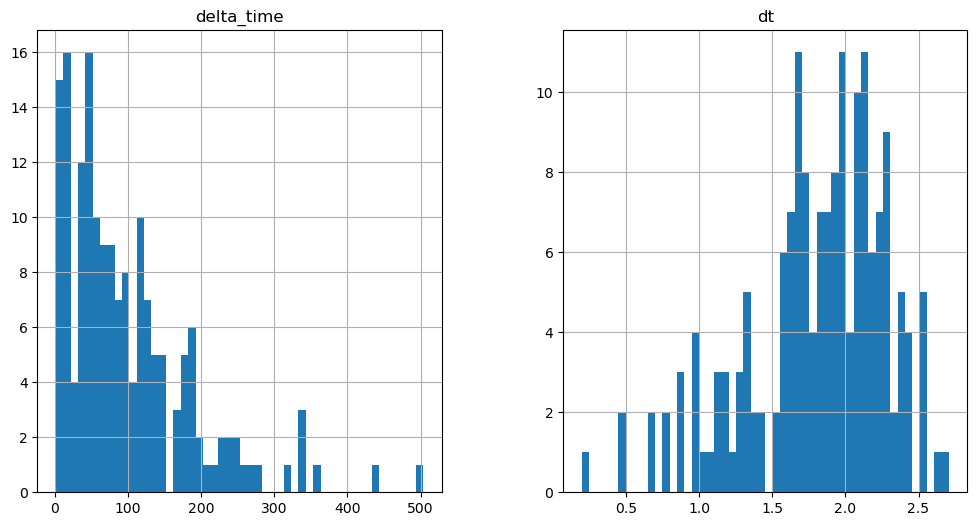

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1118.7814255952835 3.082030236721039


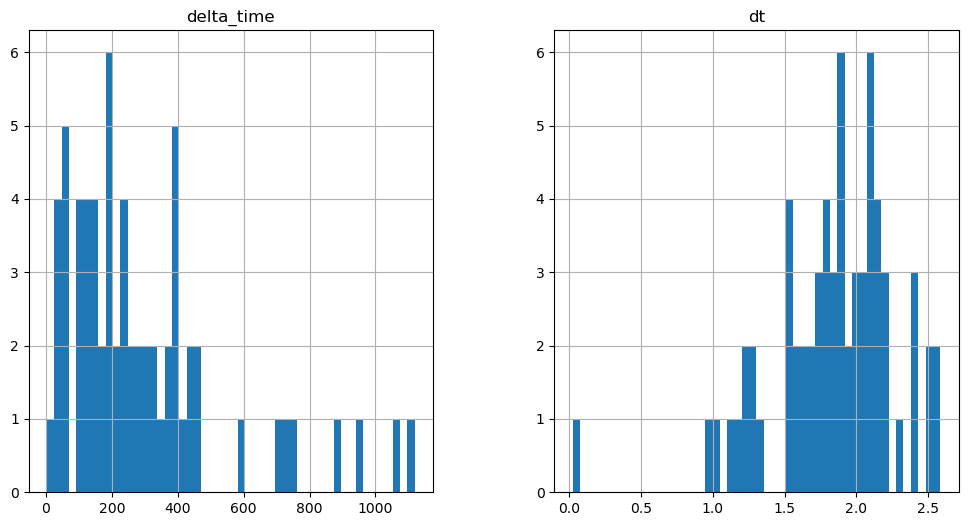

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2234.4808109998703 38.52553194761276


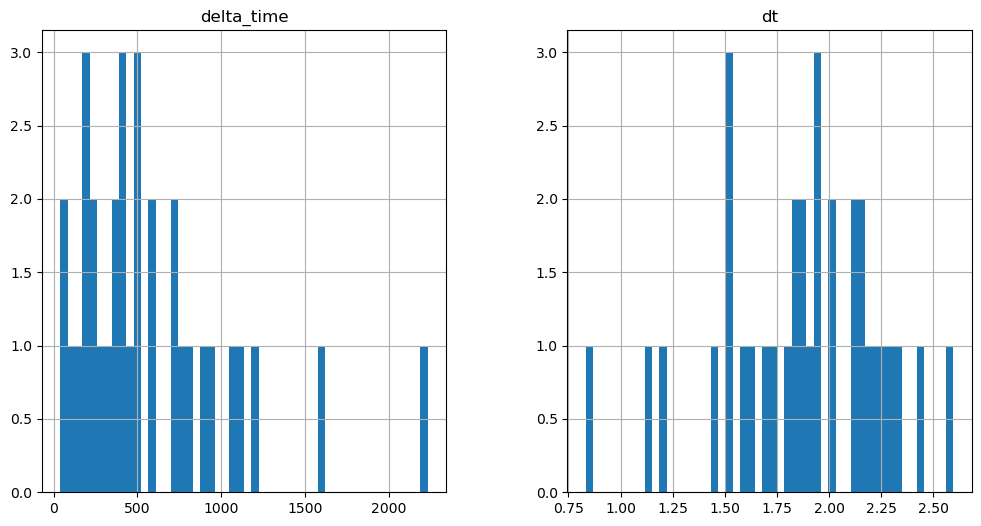

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2331.565176010132 4.623070120811462


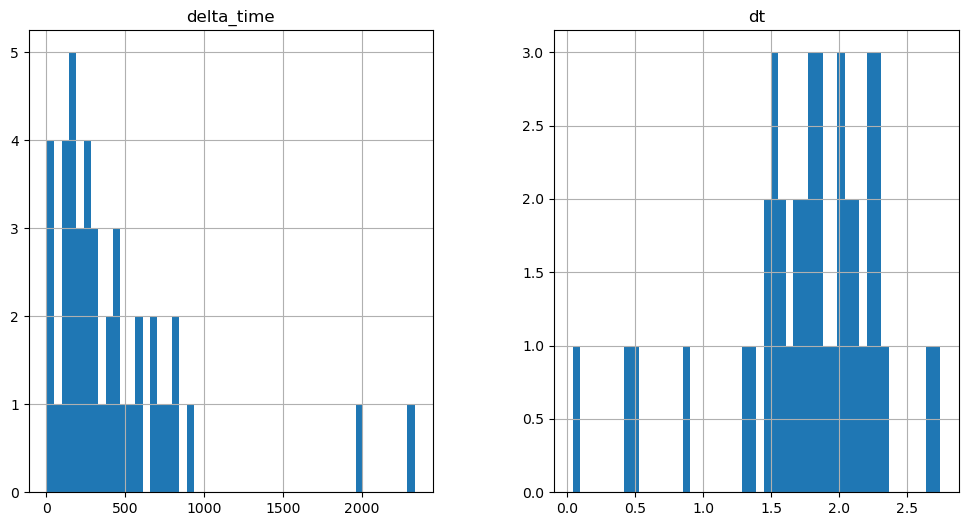

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4855.014342874289 12.964000478386879


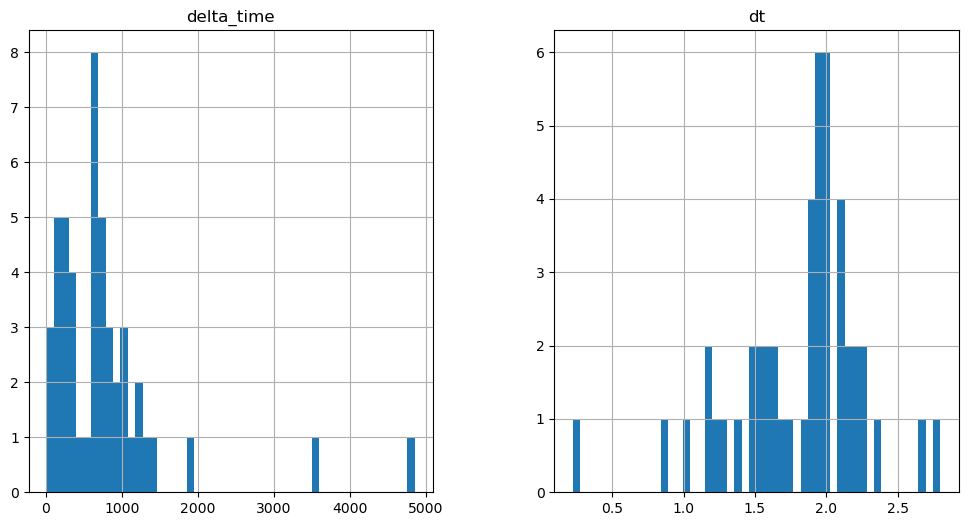

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

755.1524084806442 0.1


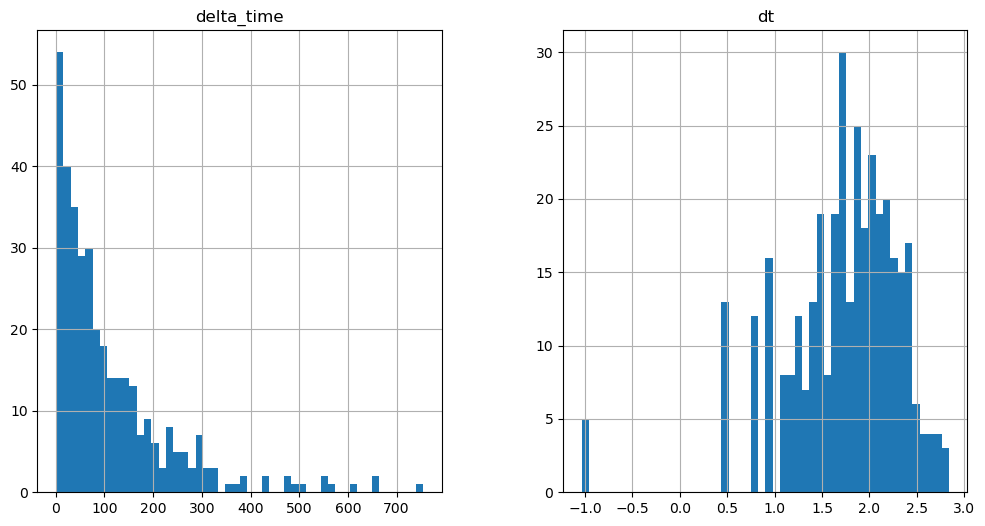

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1157.036323517561 0.1


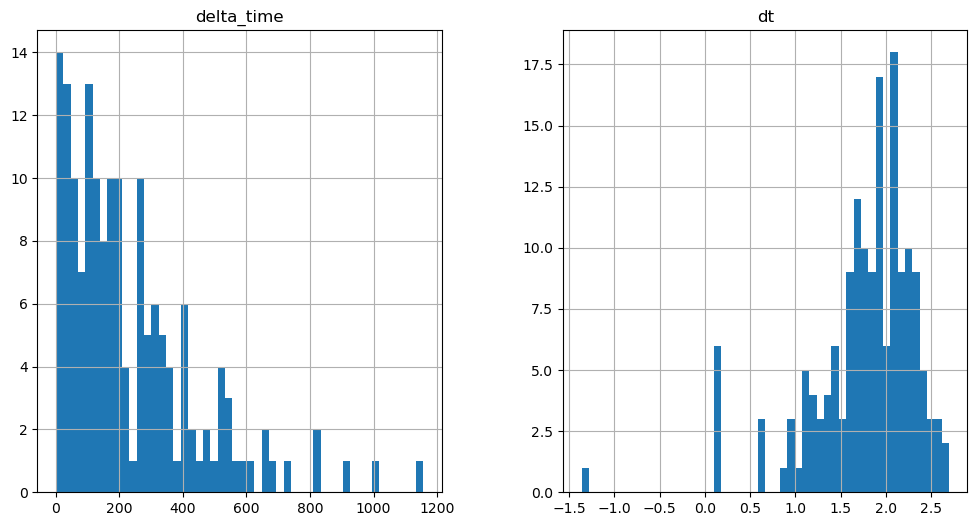

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3396.5654478371143 6.48200024664402


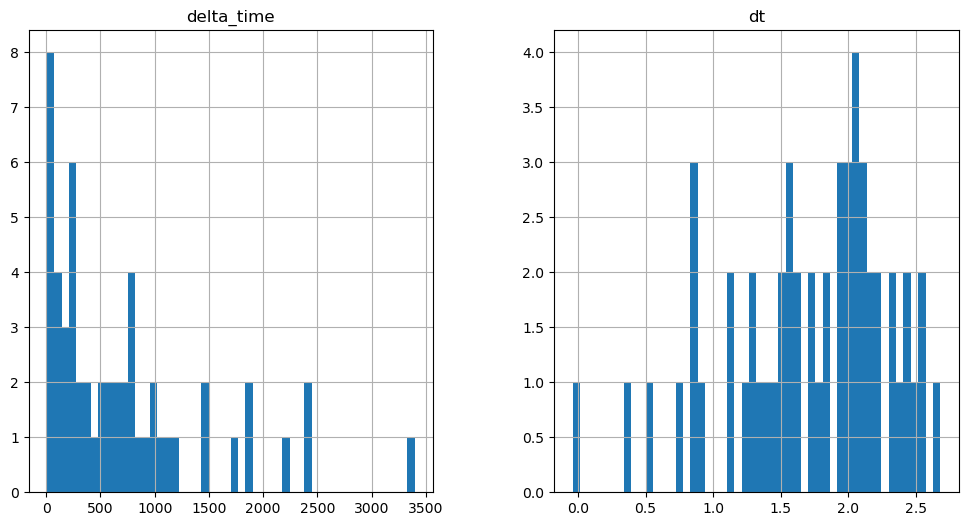

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

952.8534558862448 0.1


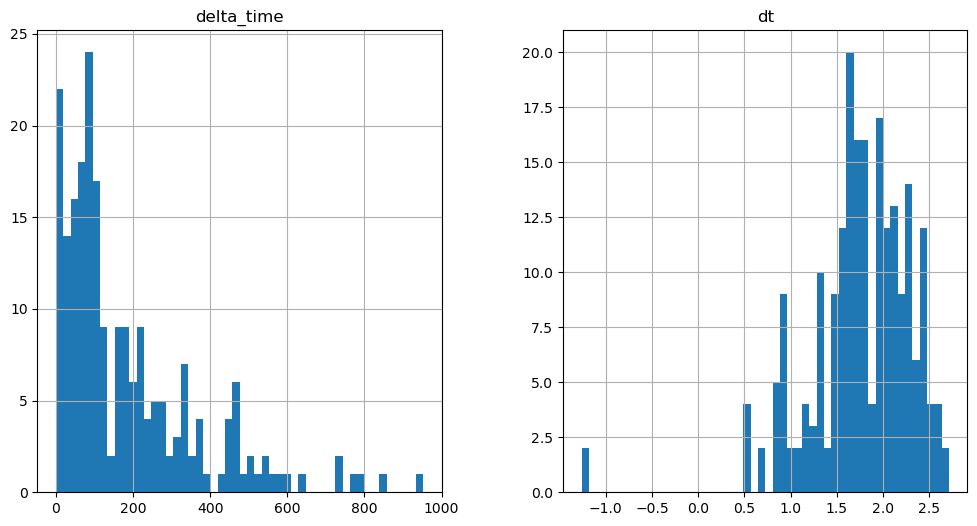

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2677.063930824399 3.241010084748268


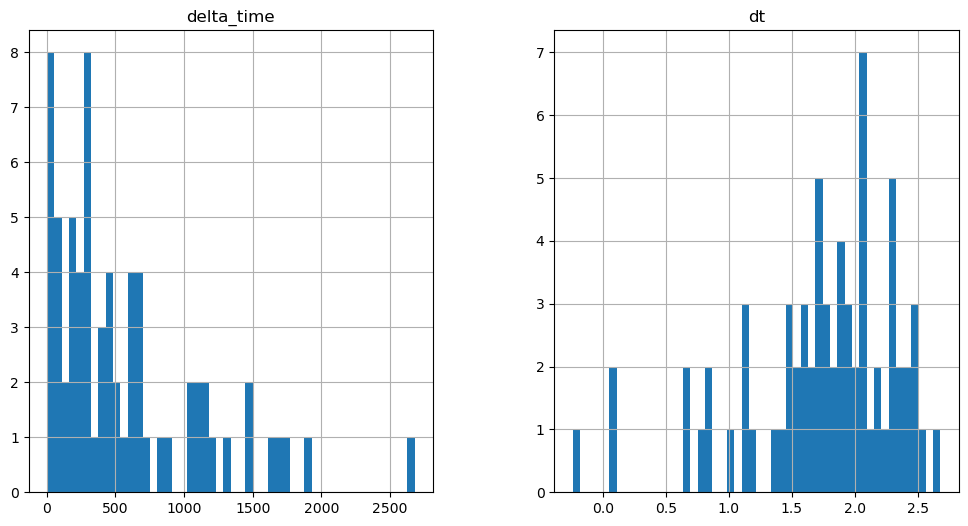

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1769.5846266150475 3.241010069847107


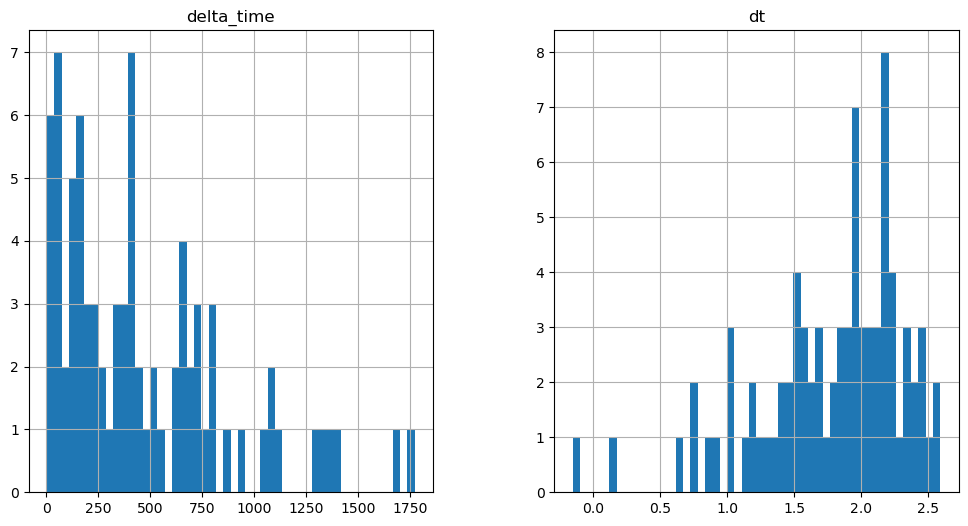

1312.6041693985462 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

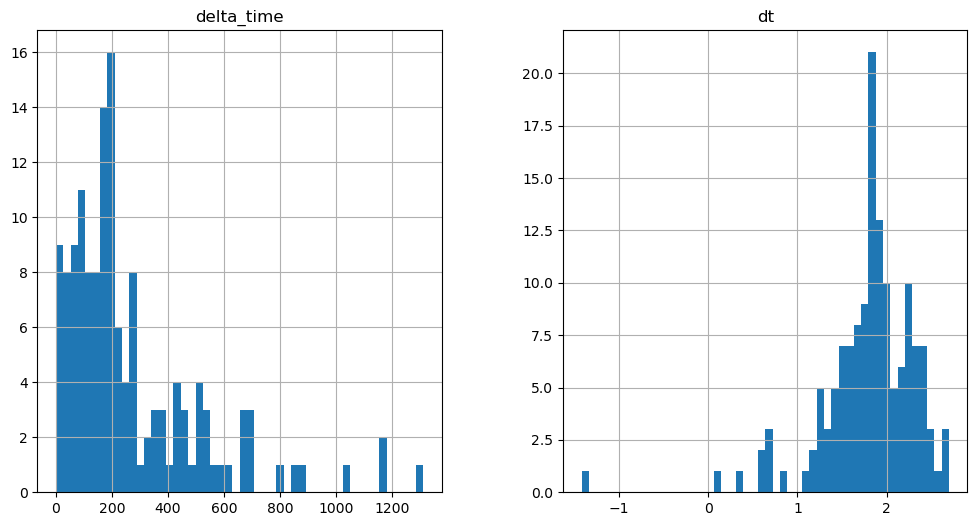

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2929.8617103099823 6.482000231742859


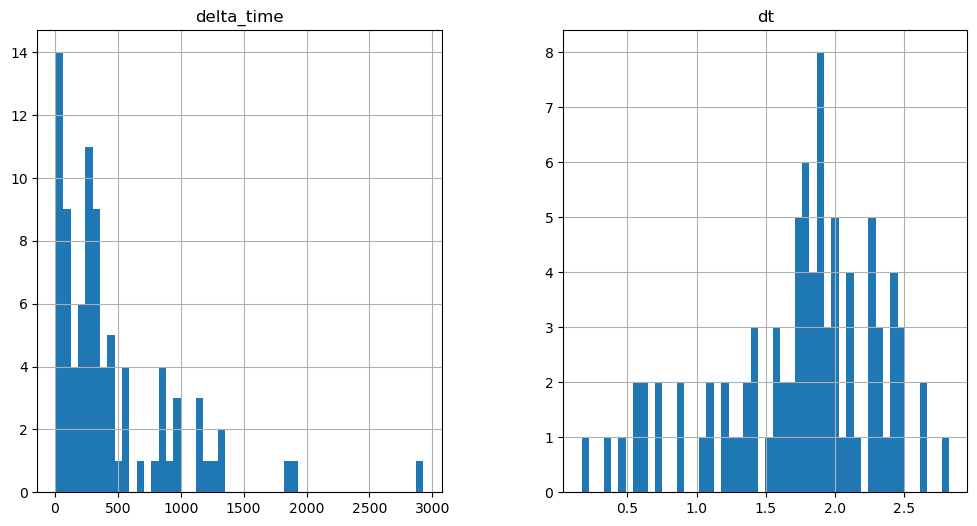

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1497.3408263474703 6.482000231742859


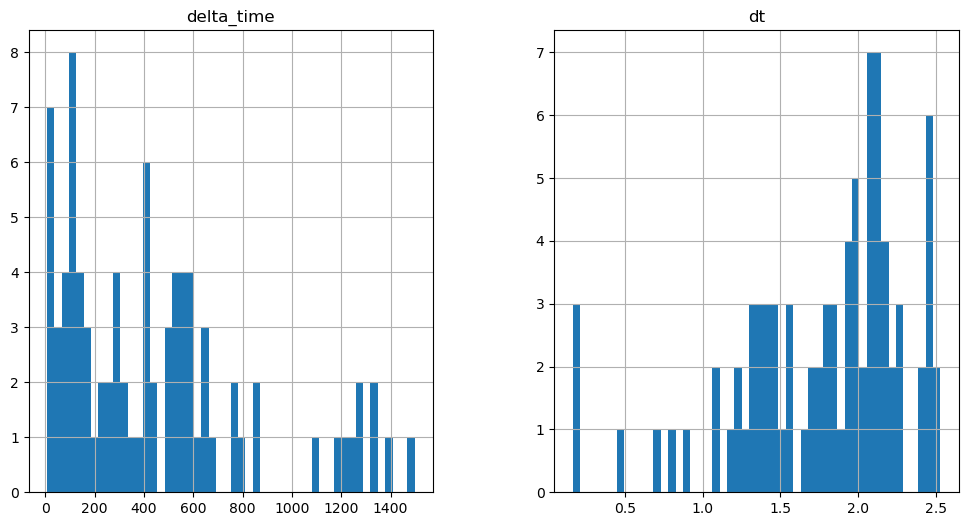

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3782.244012415409 9.72298039495945


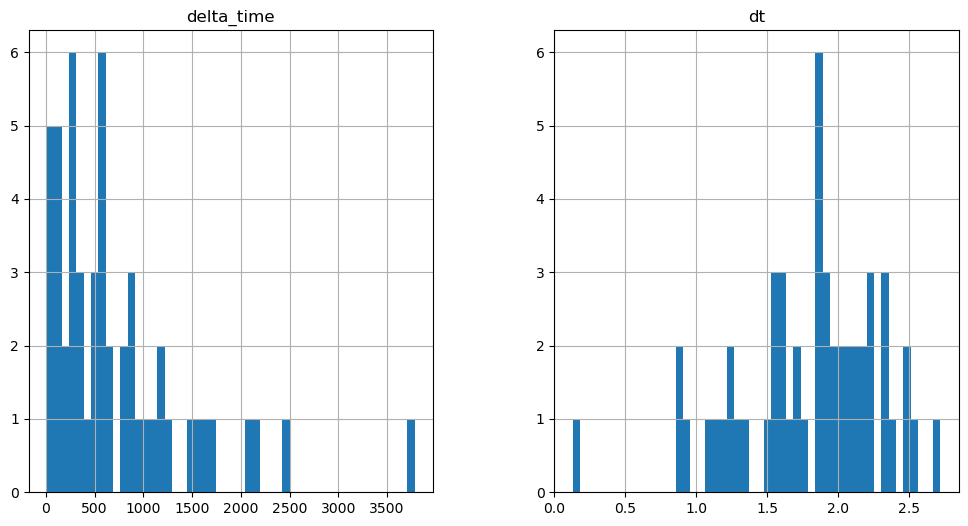

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2787.257934898138 19.446000710129738


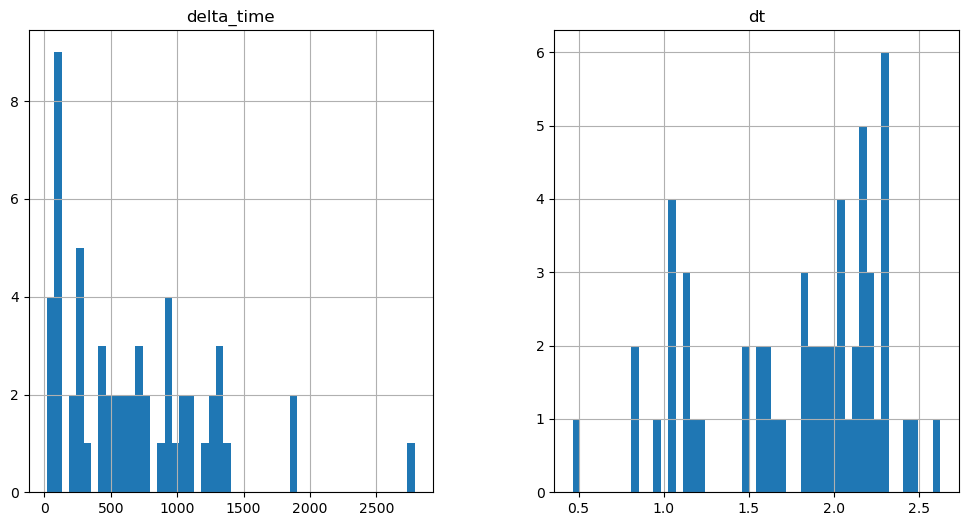

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2391.856399998069 19.4459707736969


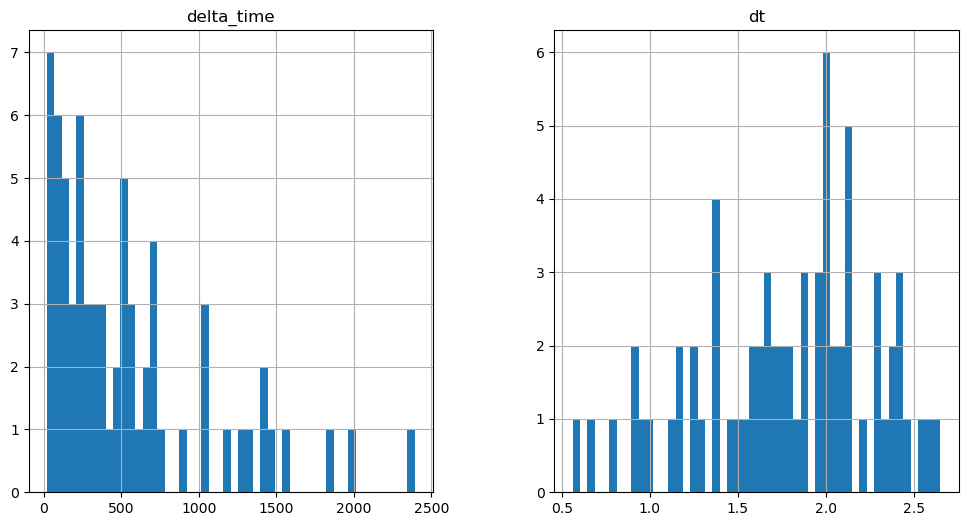

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1853.850559785962 6.481990247964859


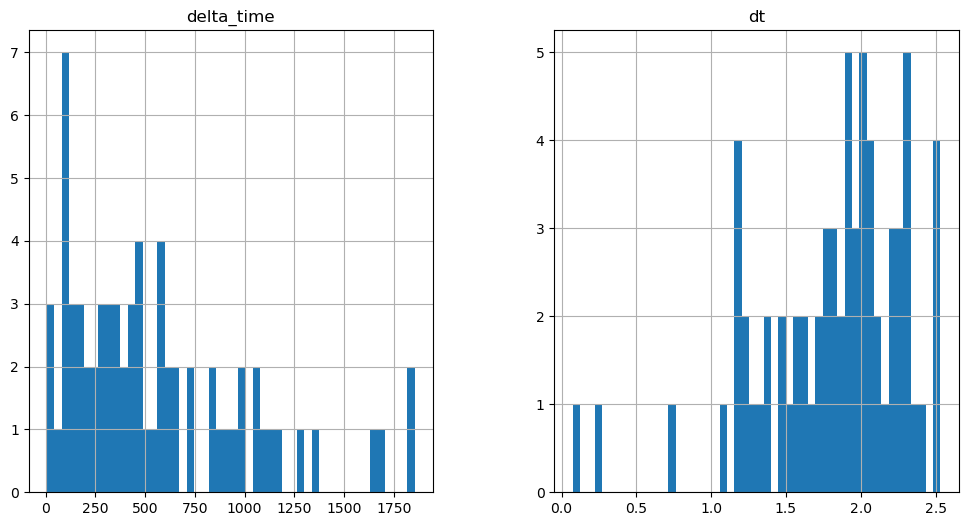

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1818.1995884627104 0.1


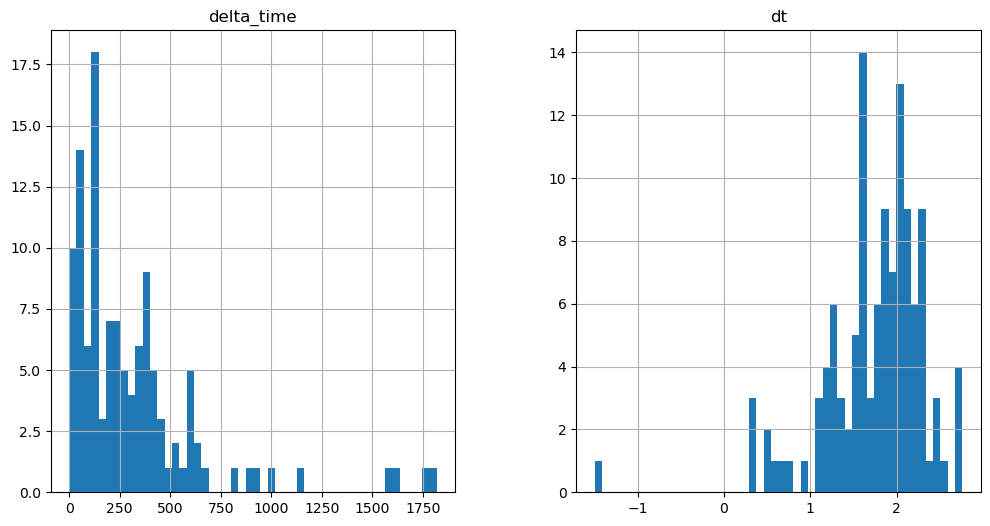

2414.54311093688 3.240990161895752


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

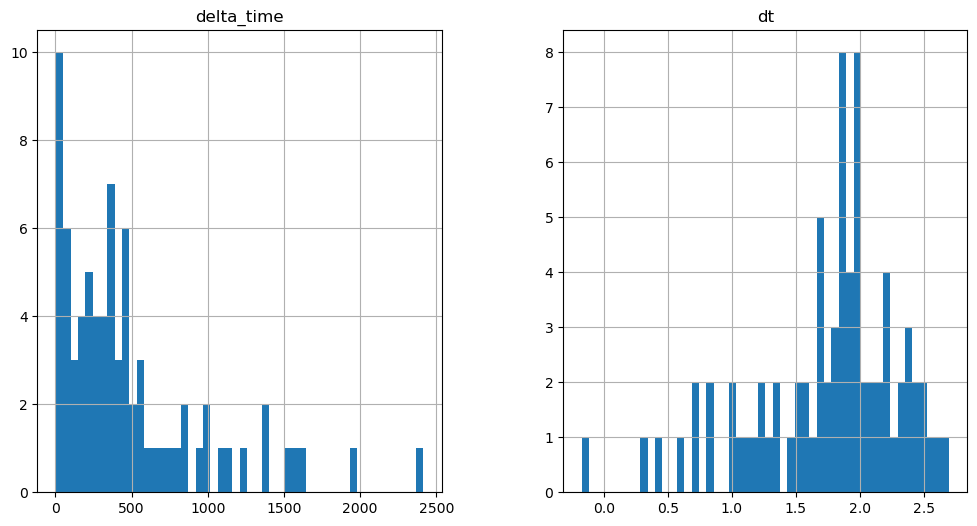

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

797.2854099571705 0.1


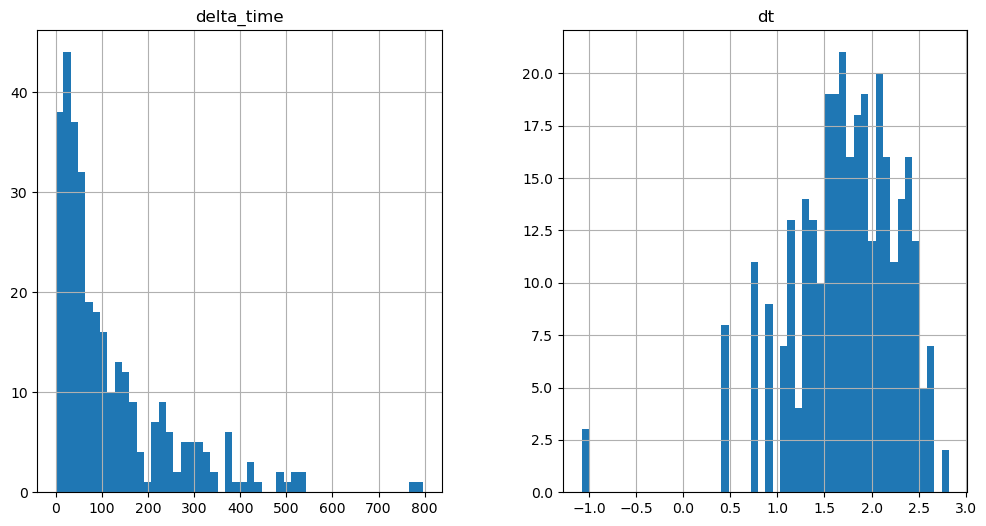

1601.1204895973206 9.246110558509827


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

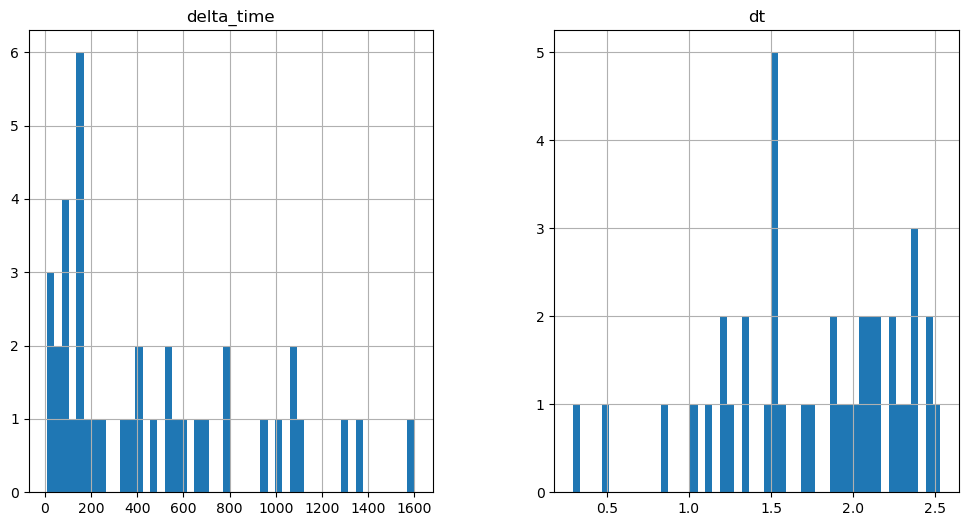

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2485.6662634015083 3.0820401906967163


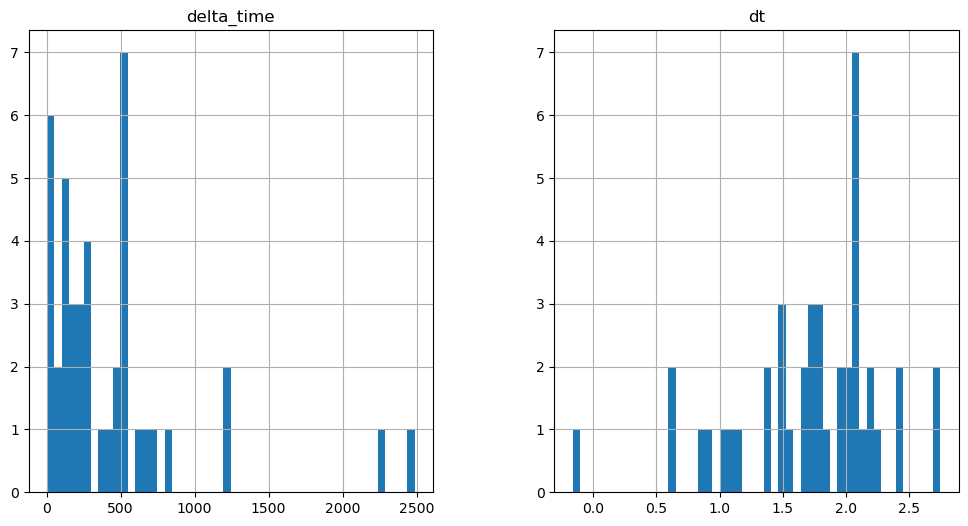

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

602.5391197800636 1.5410400032997131


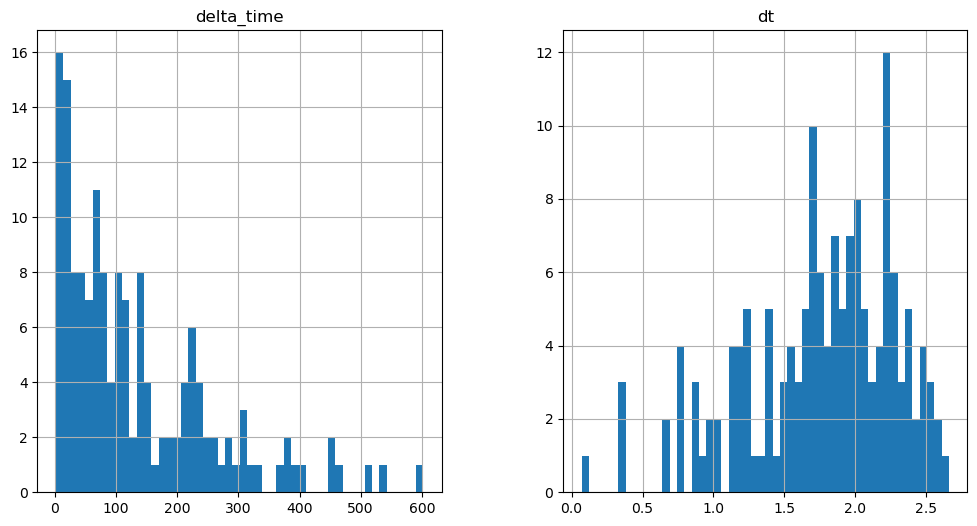

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1989.4573680758476 6.164080381393433


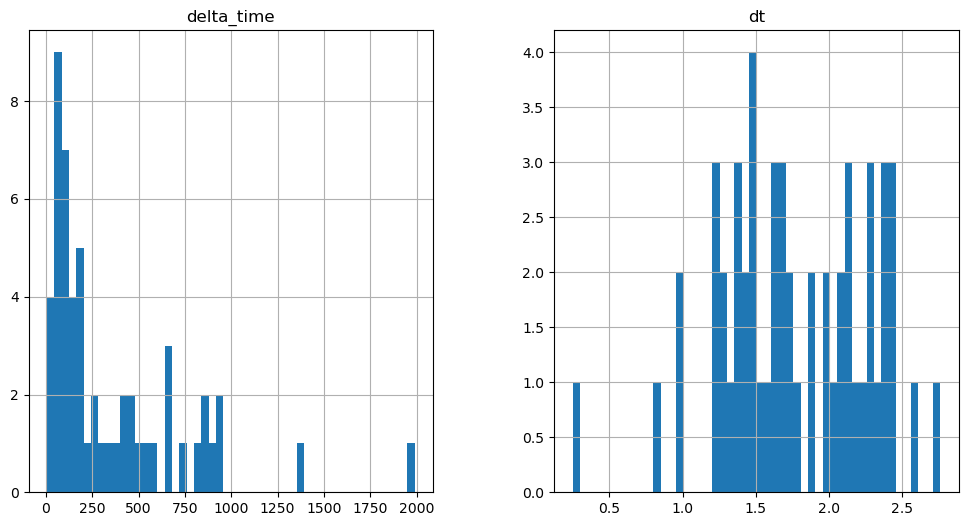

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1431.608310520649 6.164080321788788


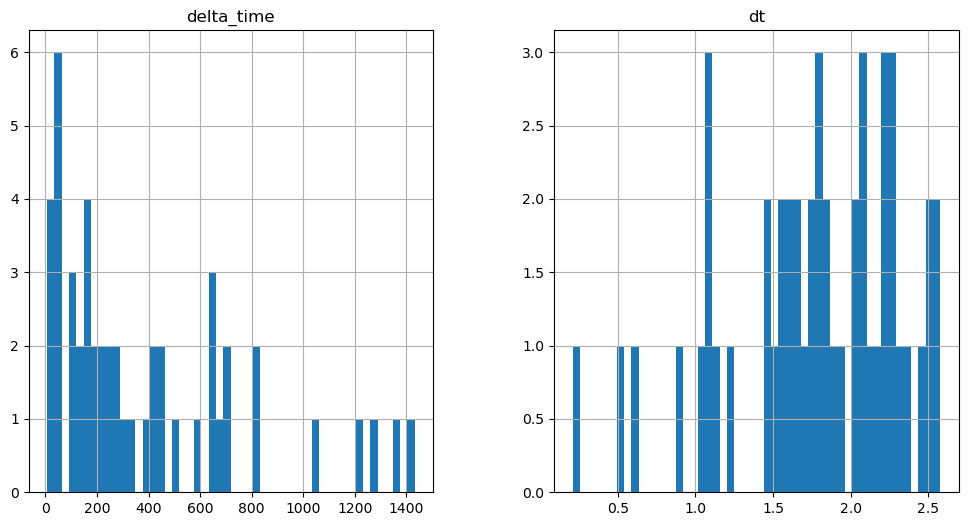

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

947.7274268865585 3.082030177116394


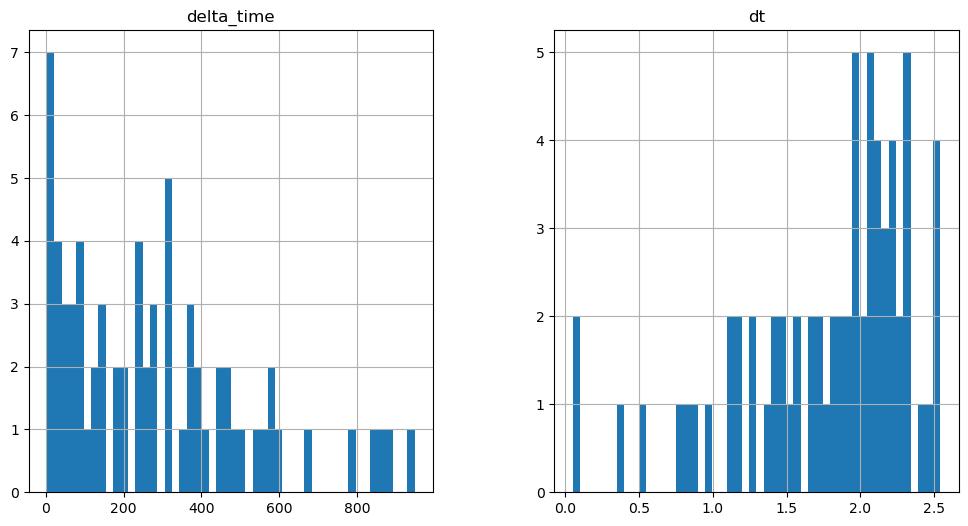

2155.268879890442 19.446040987968445


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

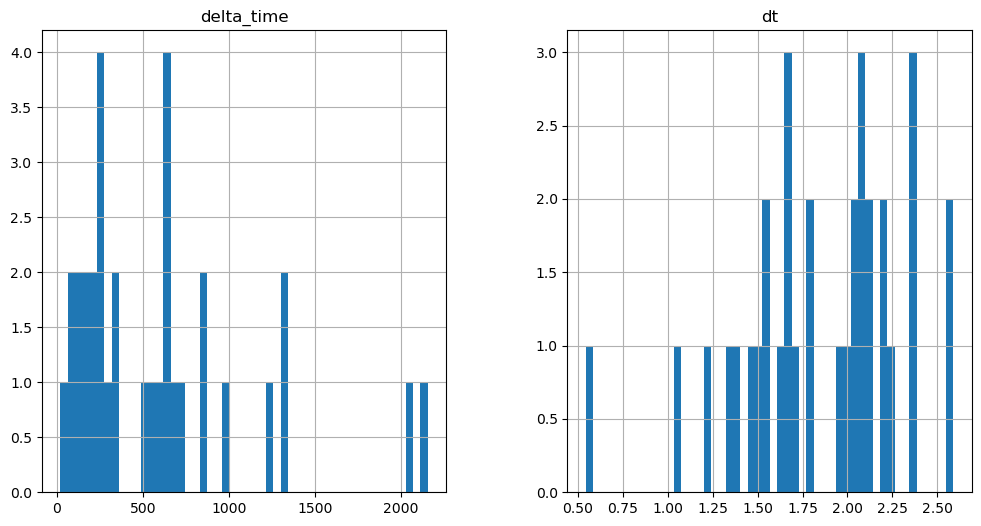

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1403.355541586876 3.241000235080719


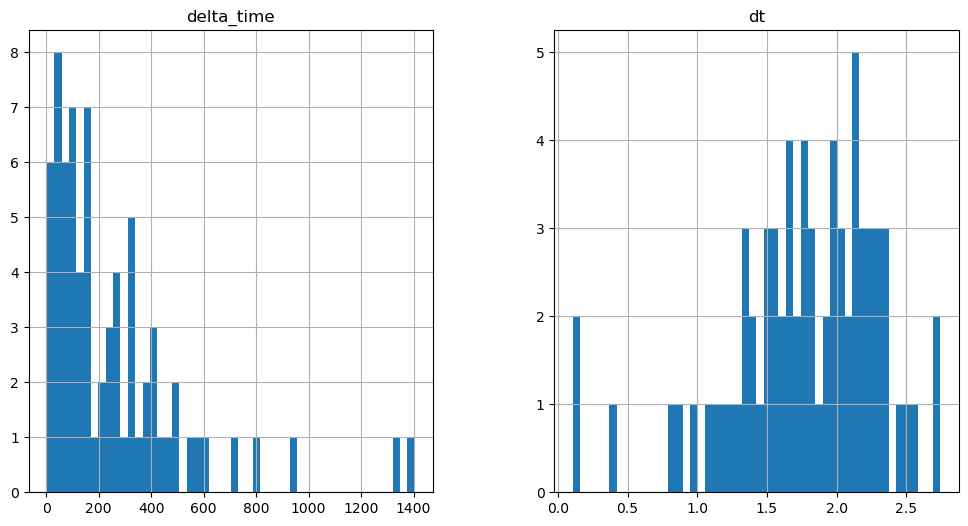

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

823.2153519392014 3.241000175476074


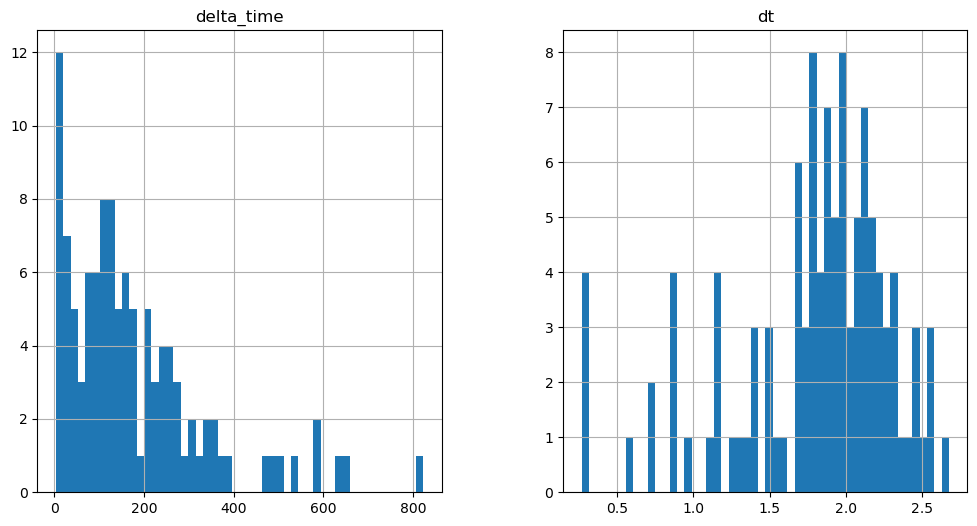

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

664.4062237739563 0.1


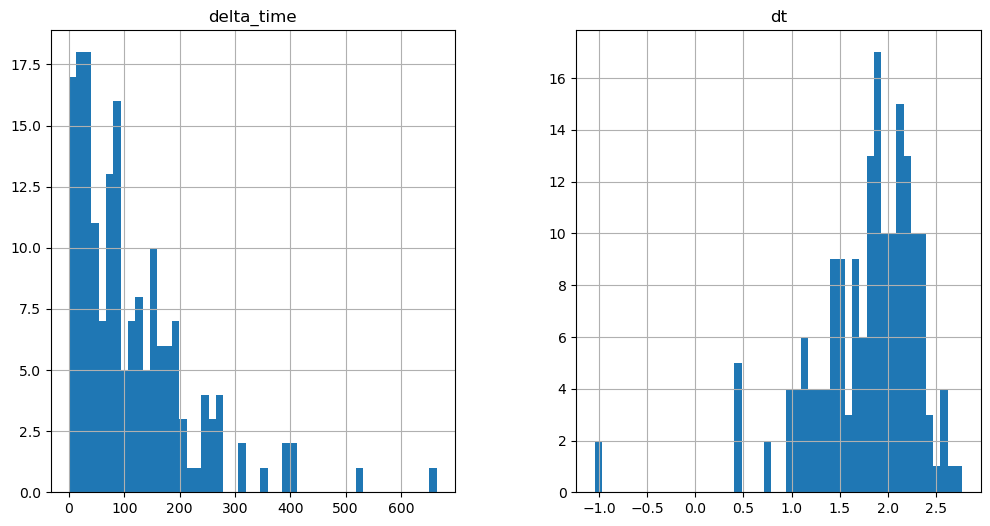

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

7.569280236959457 0.1


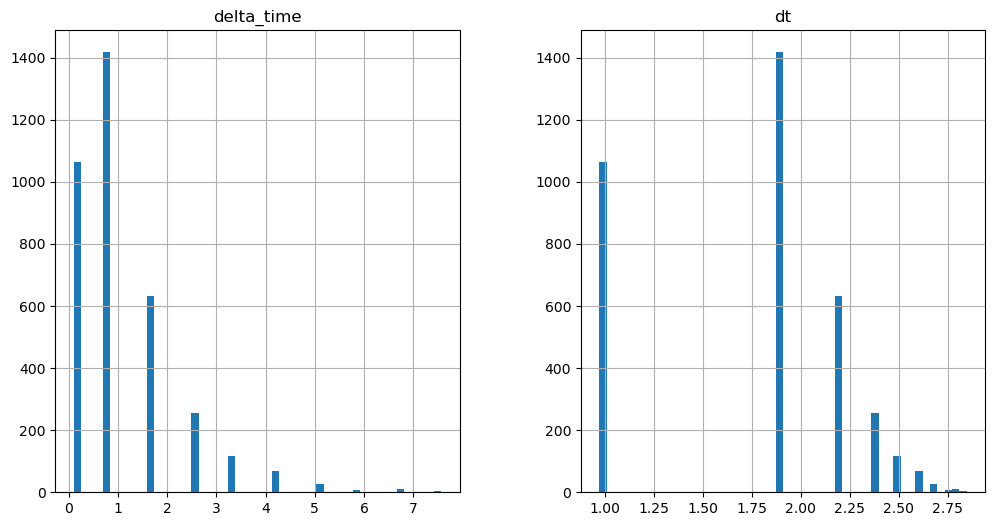

1916.0118559002876 9.422990560531616


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

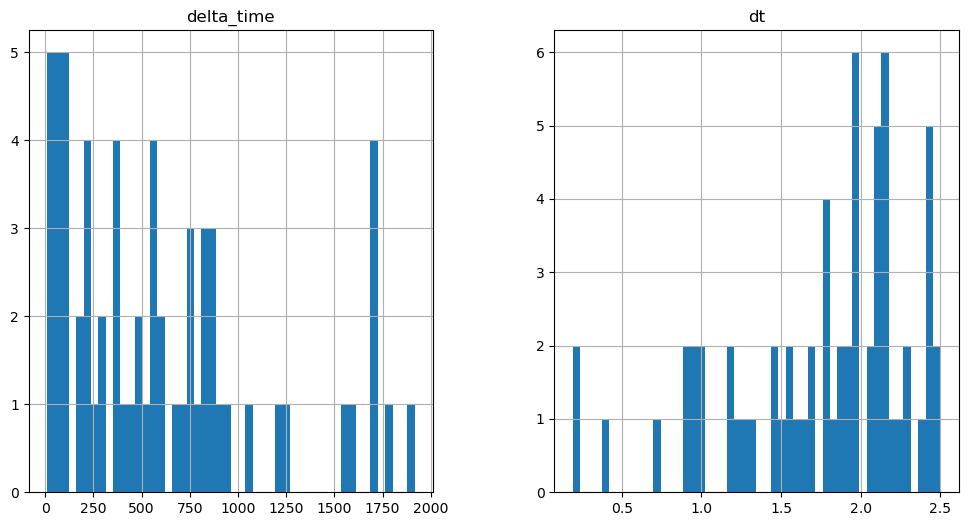

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

926.59582644701 0.1


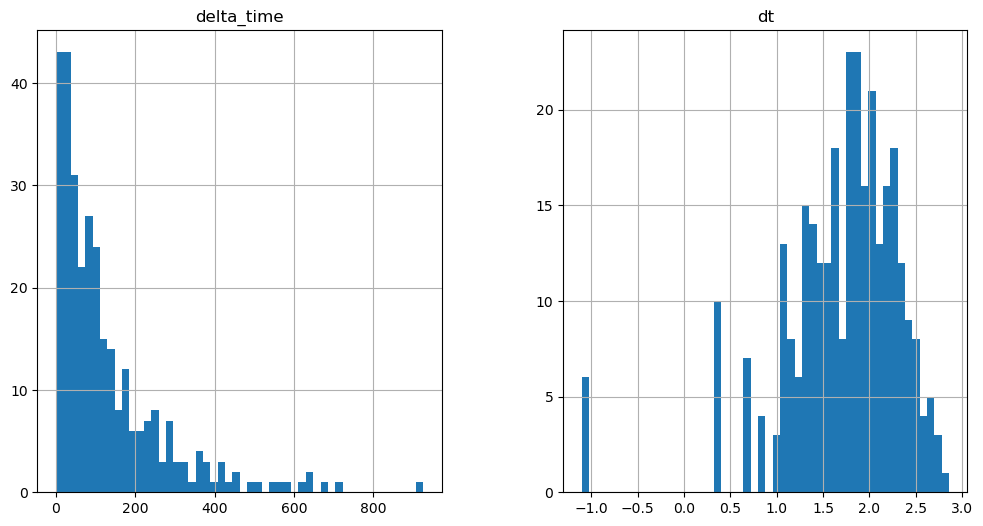

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1771.5255586504936 3.140990197658539


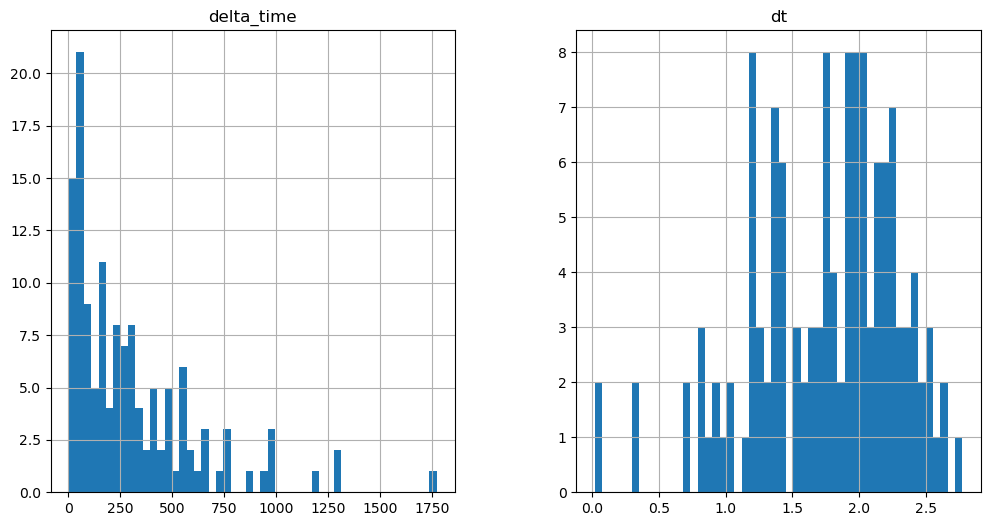

3866.574533522129 6.282030403614044


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

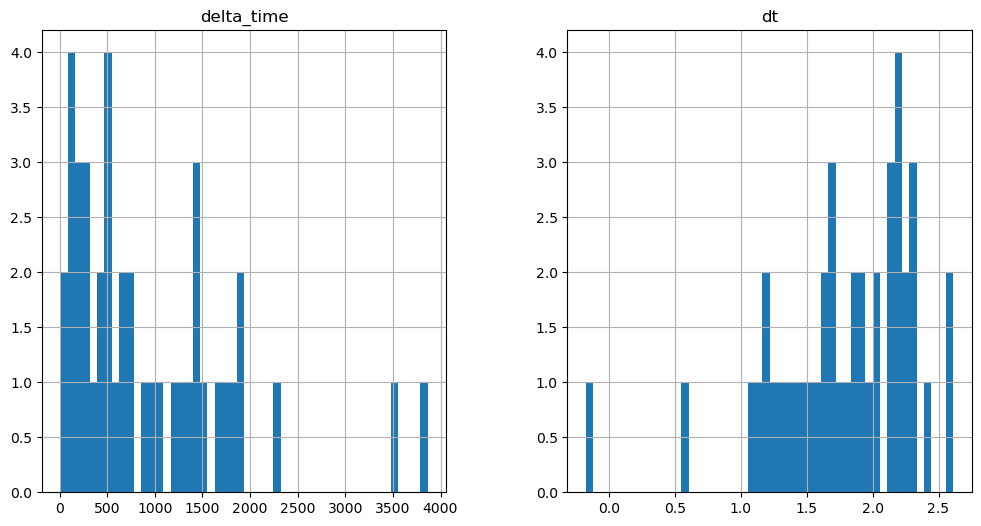

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1570.505328655243 6.282000243663788


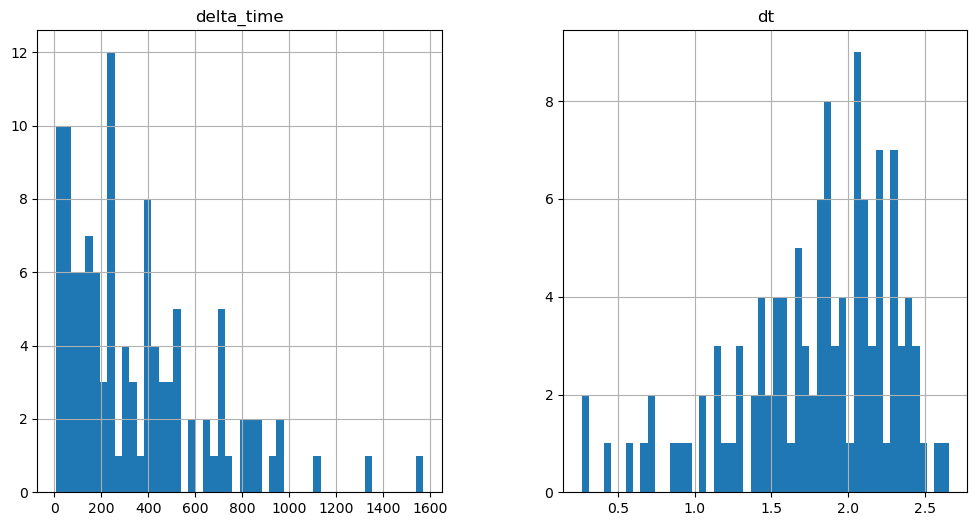

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4205.805670499802 0.1


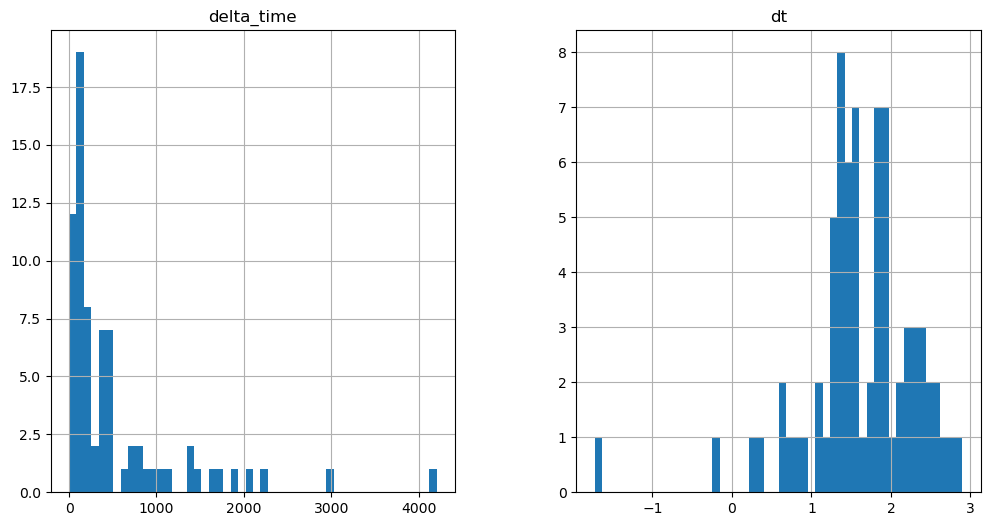

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4943.938447654247 3.141000270843506


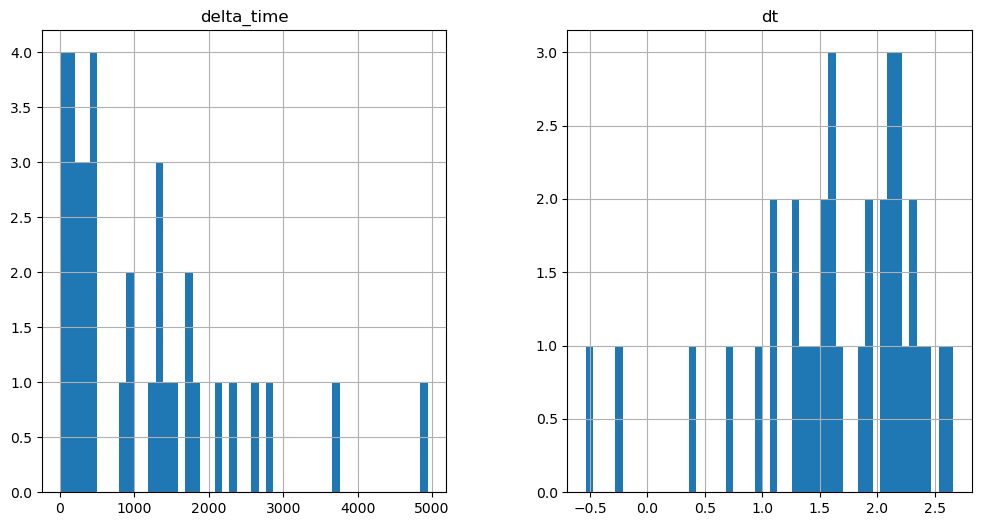

1394.6050398349762 6.282040238380432


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

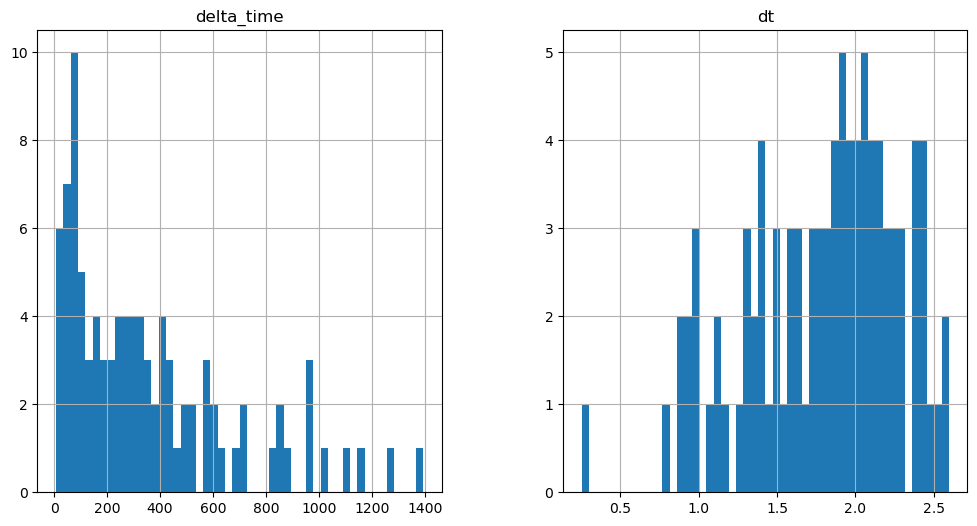

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2091.9076746702194 18.846001029014587


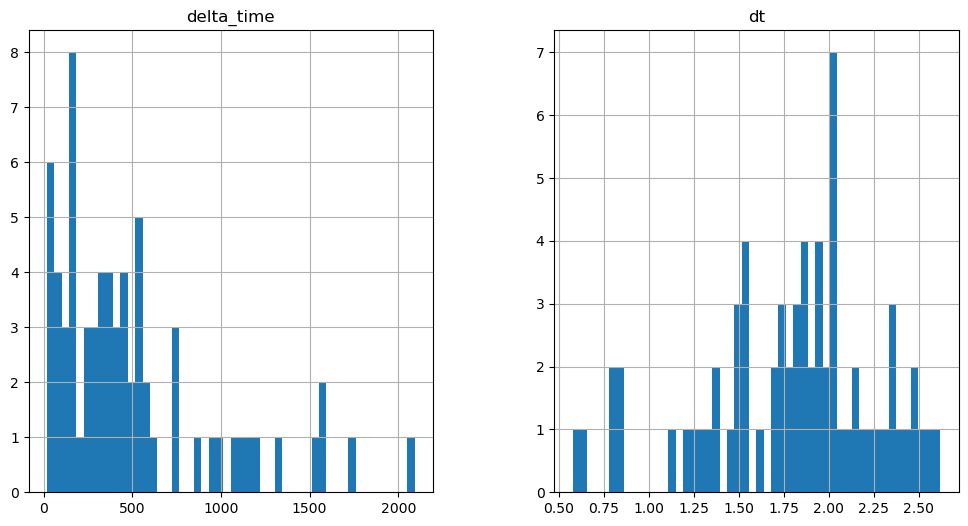

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2192.42294973135 3.1410101652145386


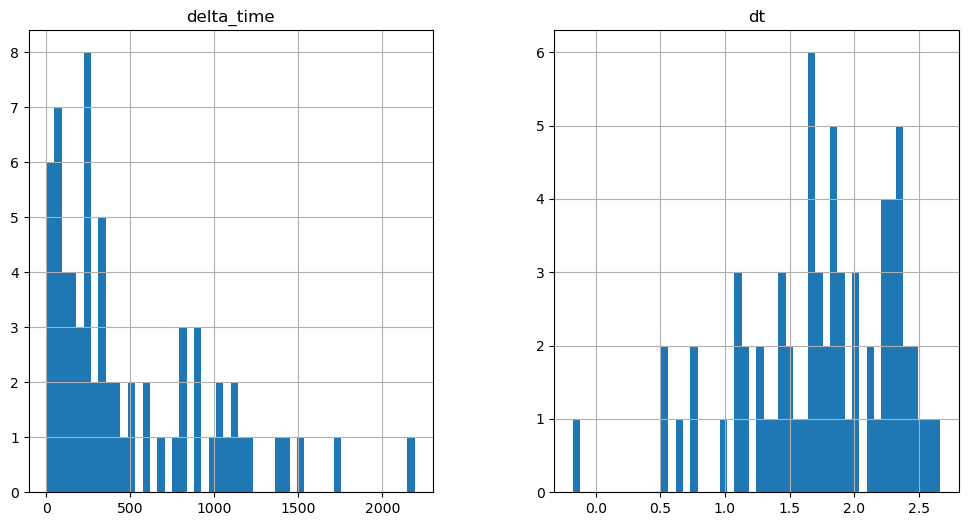

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2267.8037434220314 3.1409900784492493


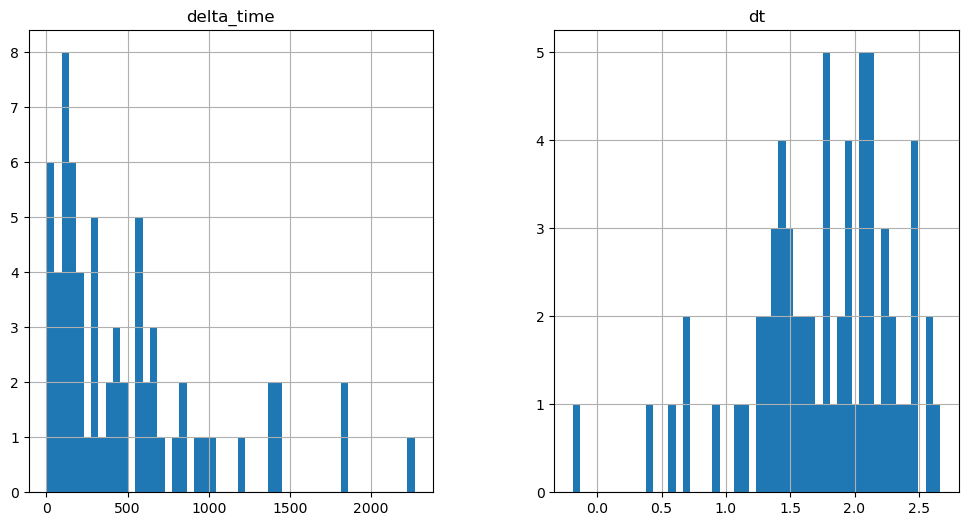

2544.221047401428 103.65334510803223


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

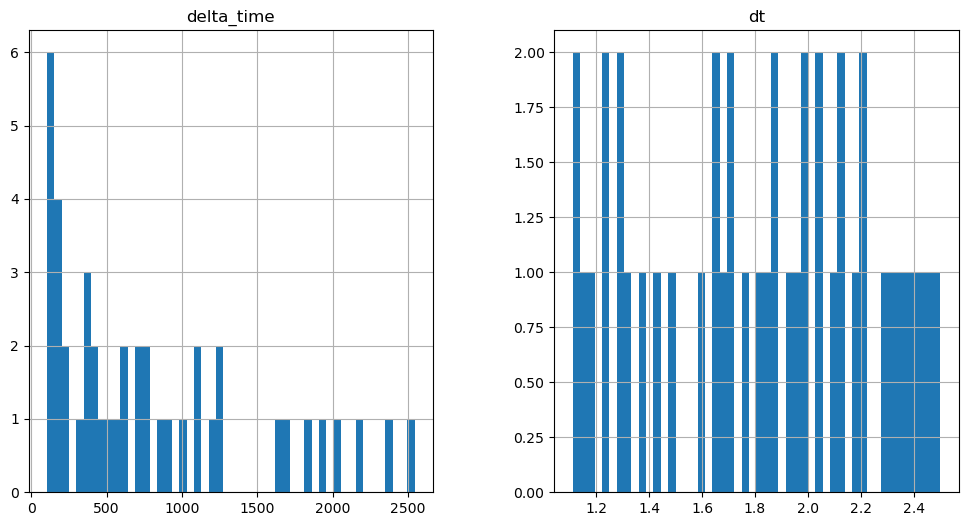

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3627.8577515482903 3.141010105609894


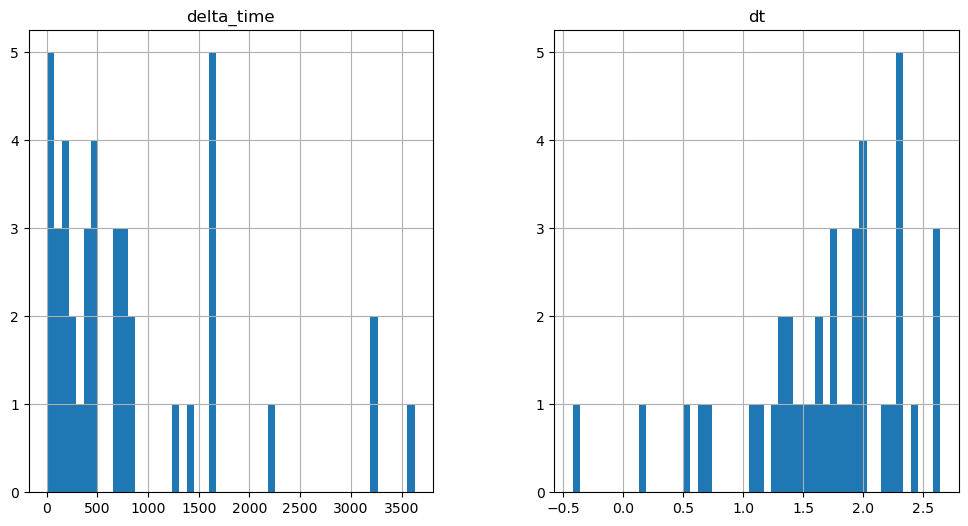

873.1987236738205 3.1409703493118286


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

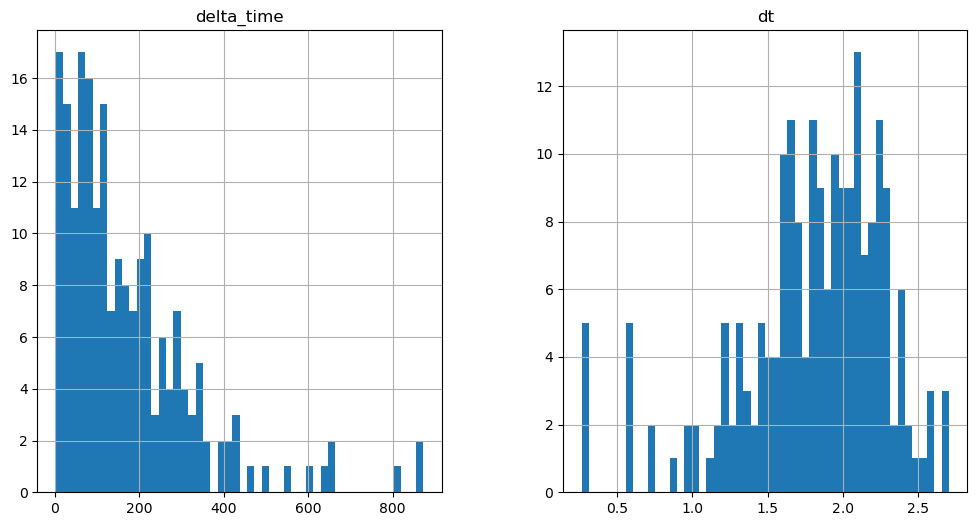

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5286.306974649429 72.24306356906891


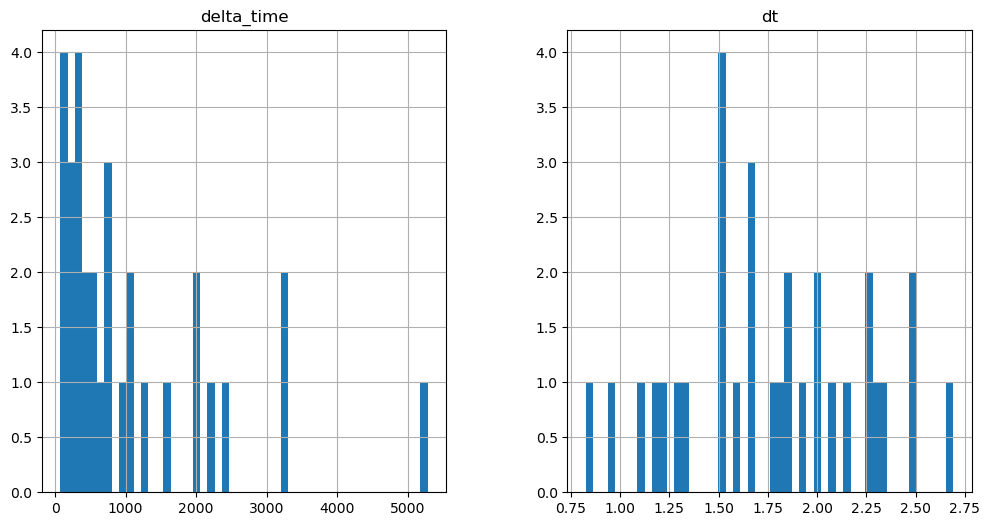

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2223.8297213315964 0.1


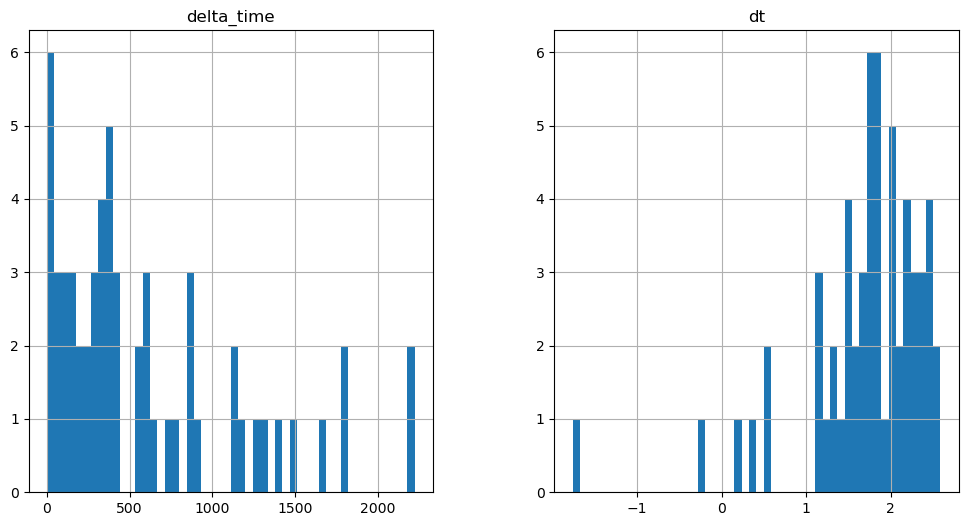

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

860.634613096714 0.1


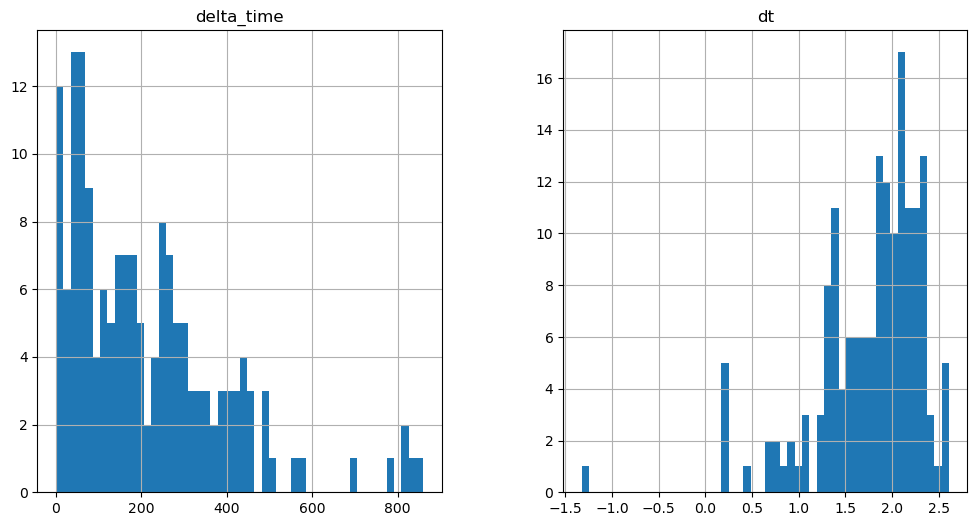

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2465.6869233846664 0.1


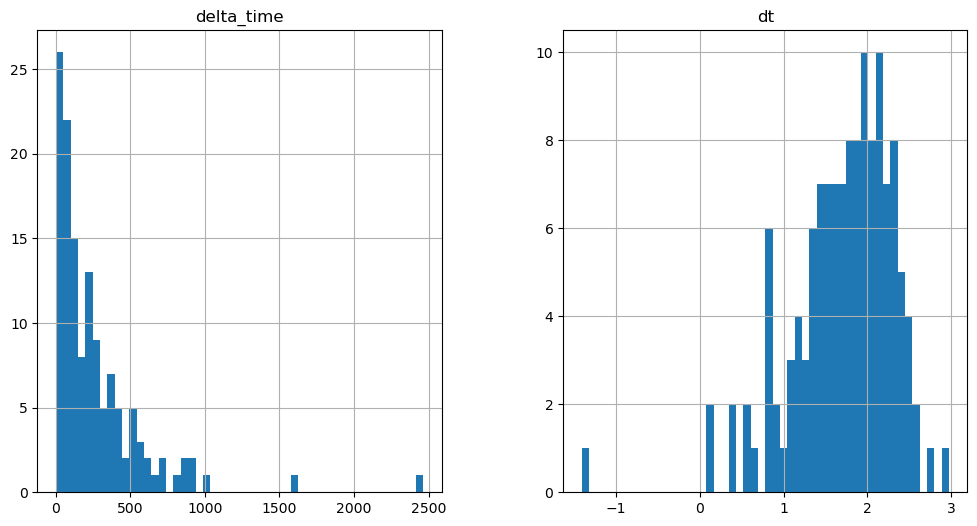

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2230.116501569748 0.1


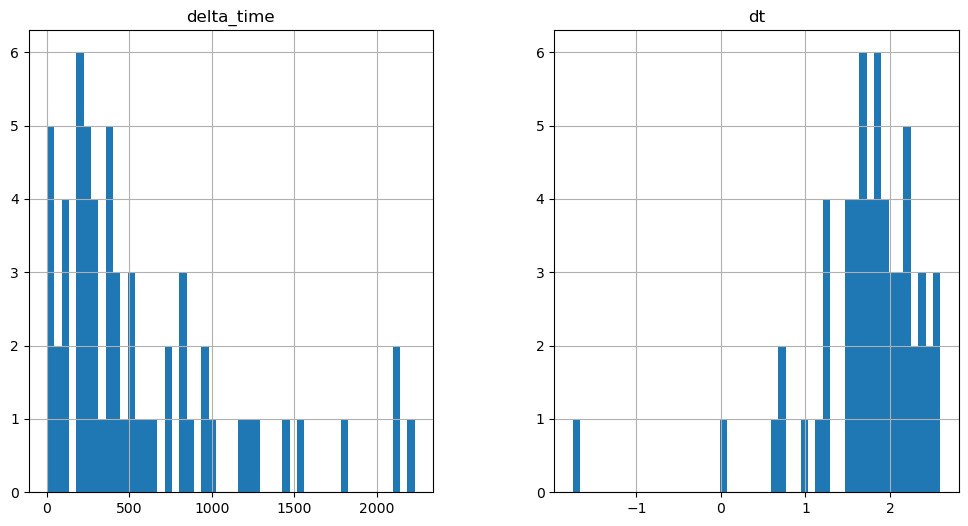

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4877.990774154663 25.128031194210052


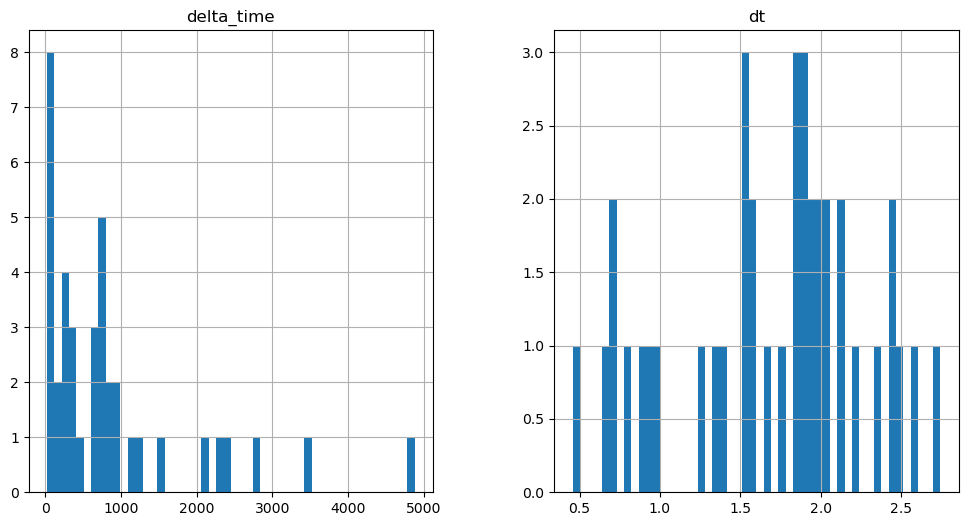

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5845.443087995052 12.564110457897186


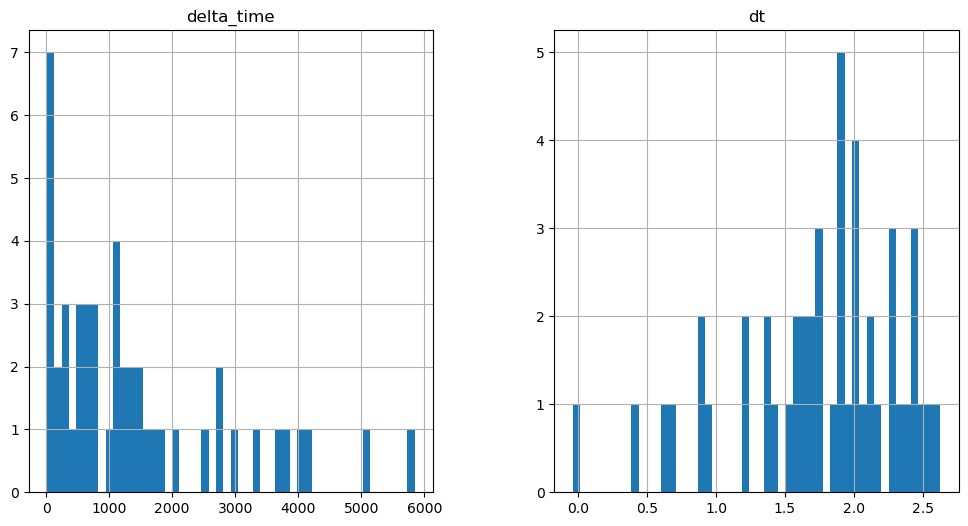

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5000.507066428661 91.08969449996948


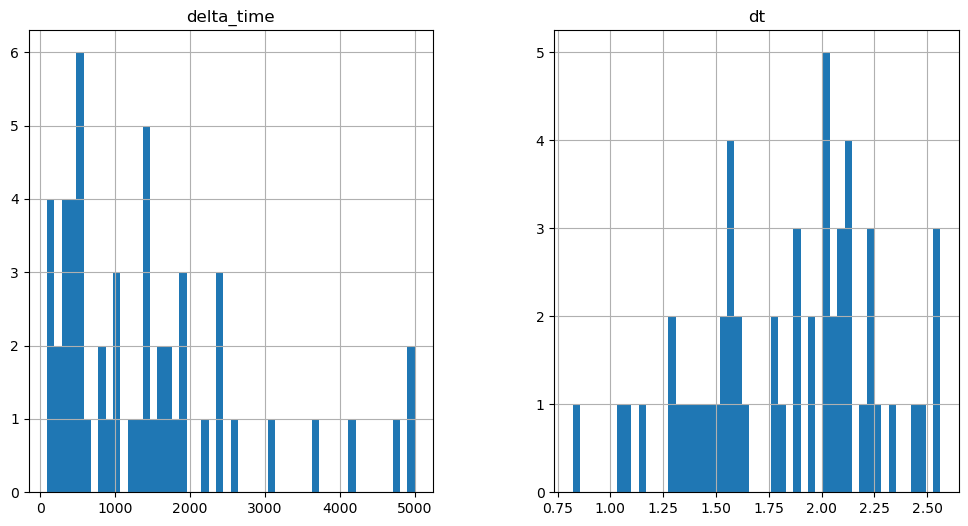

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3285.5106620788574 3.1410101652145386


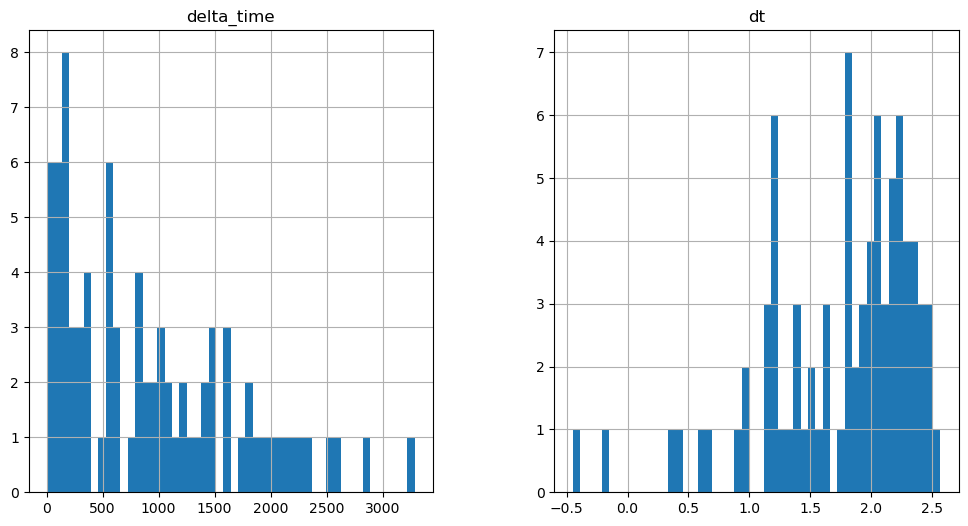

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3313.7799236774445 3.141010105609894


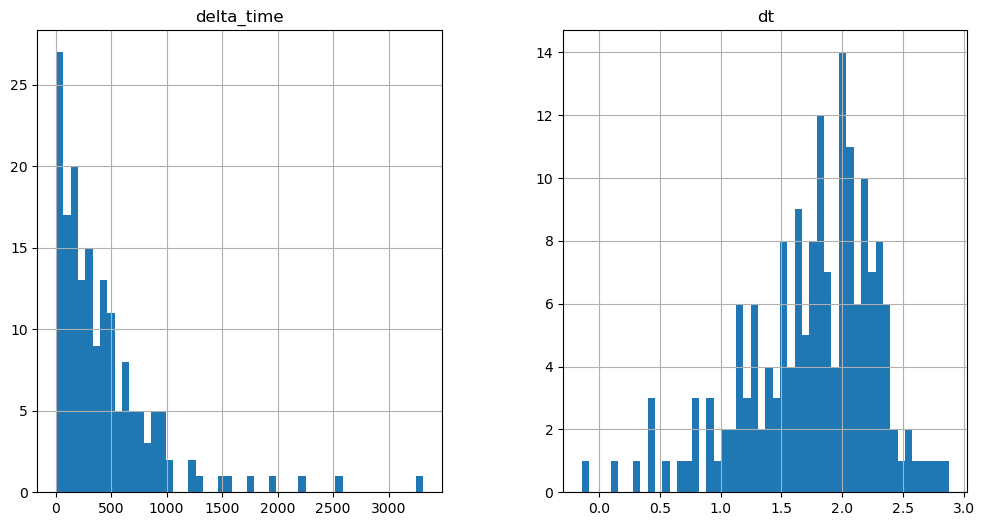

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

6209.803716123104 21.987151205539703


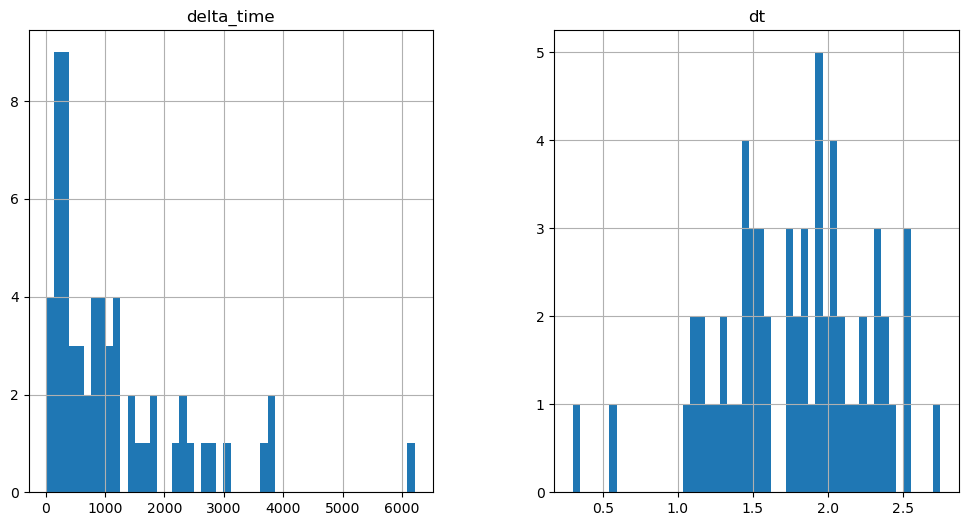

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

599.9353196024895 0.1


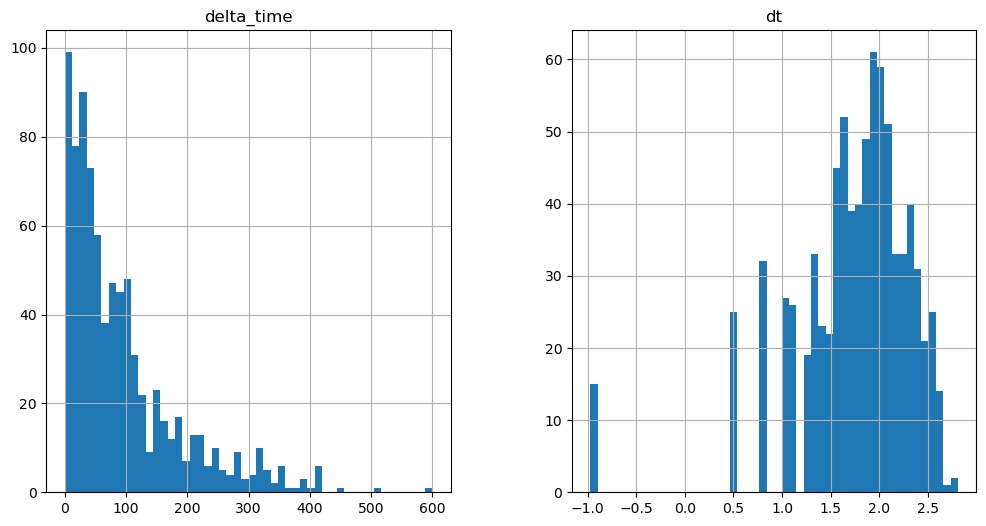

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

6398.264515280724 12.564100563526154


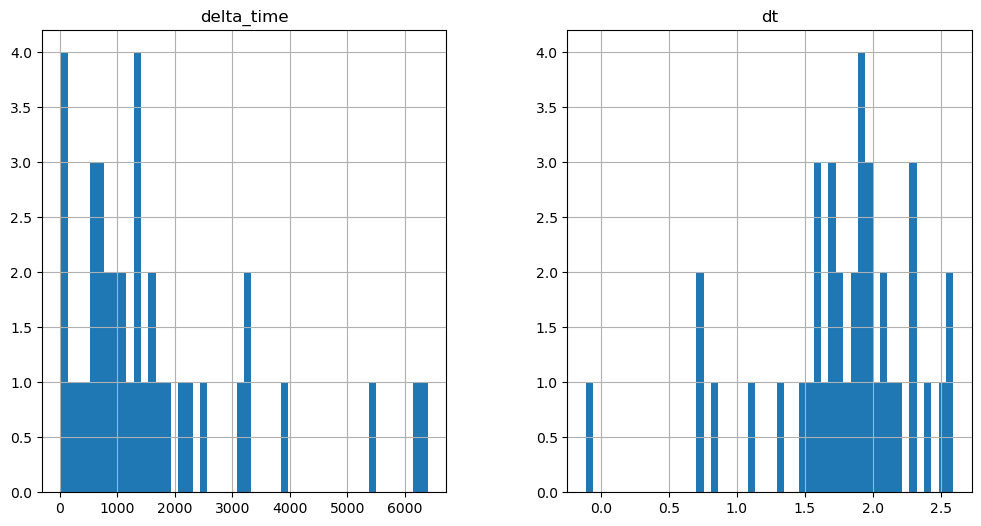

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1212.4350998401642 0.1


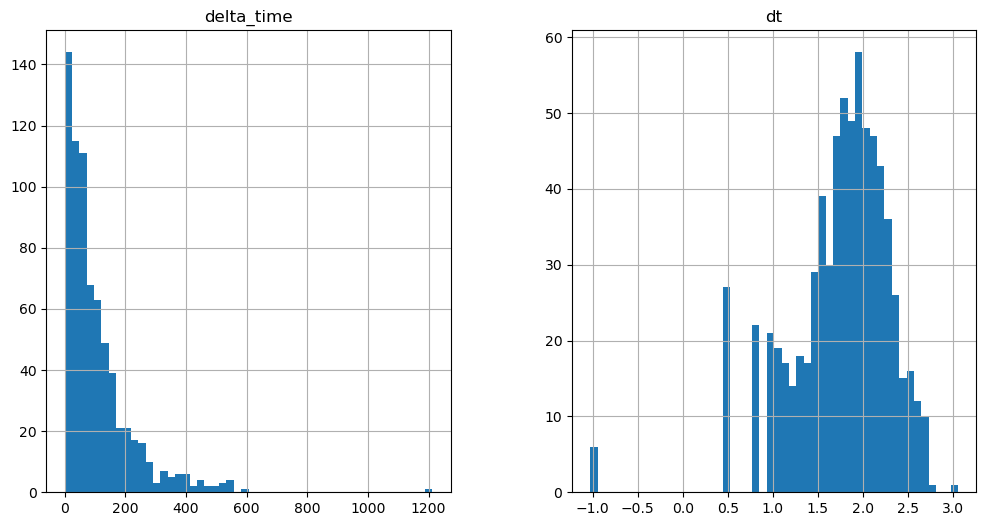

6640.1149070858955 40.83325219154358


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

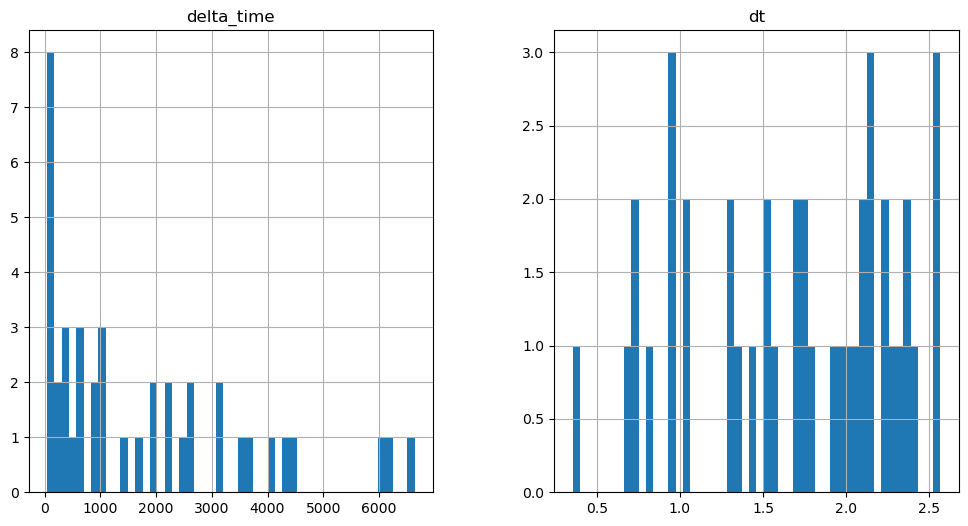

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2613.330738902092 3.141020178794861


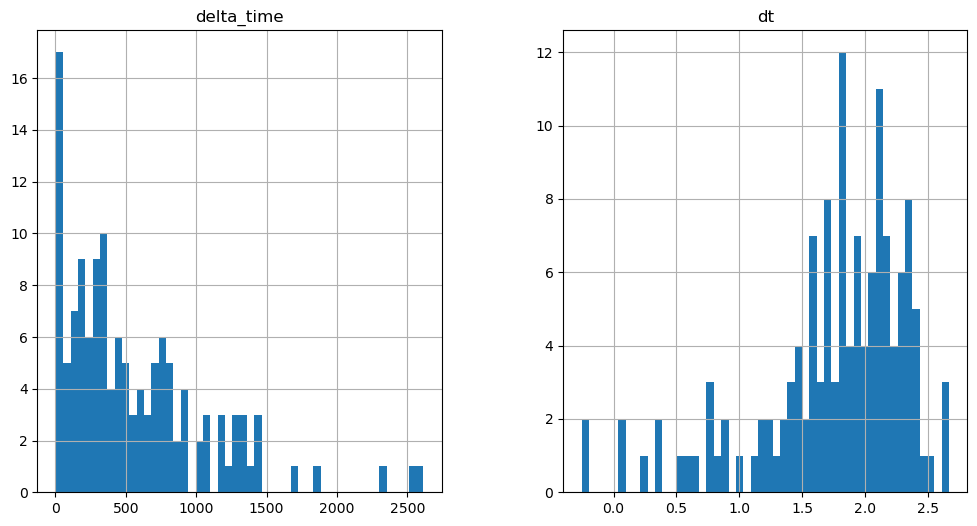

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4975.369035243988 21.98717099428177


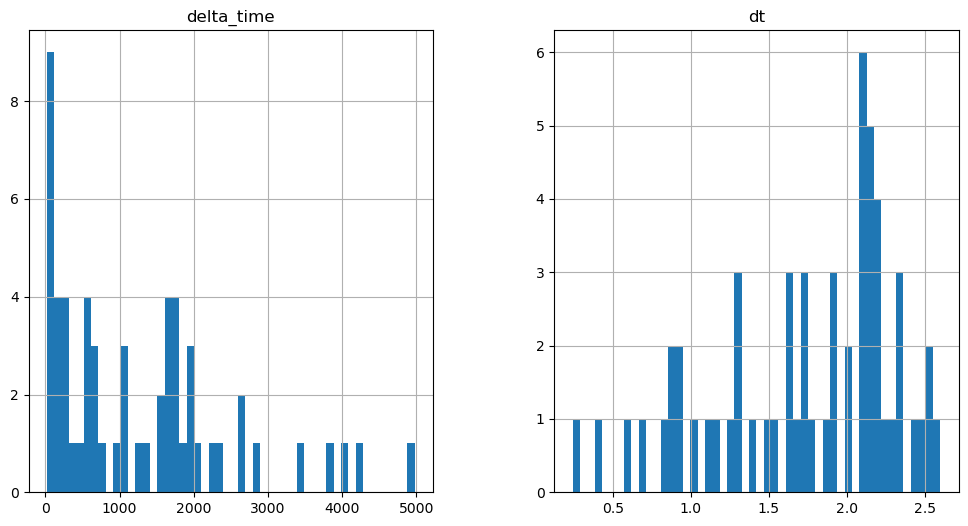

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4573.3304552435875 9.423040509223938


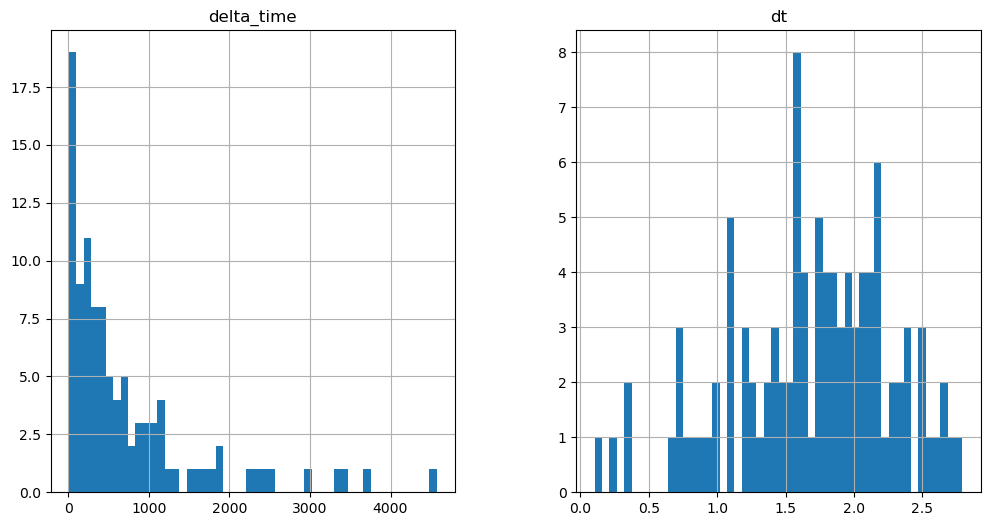

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

6121.841121673584 21.987170934677124


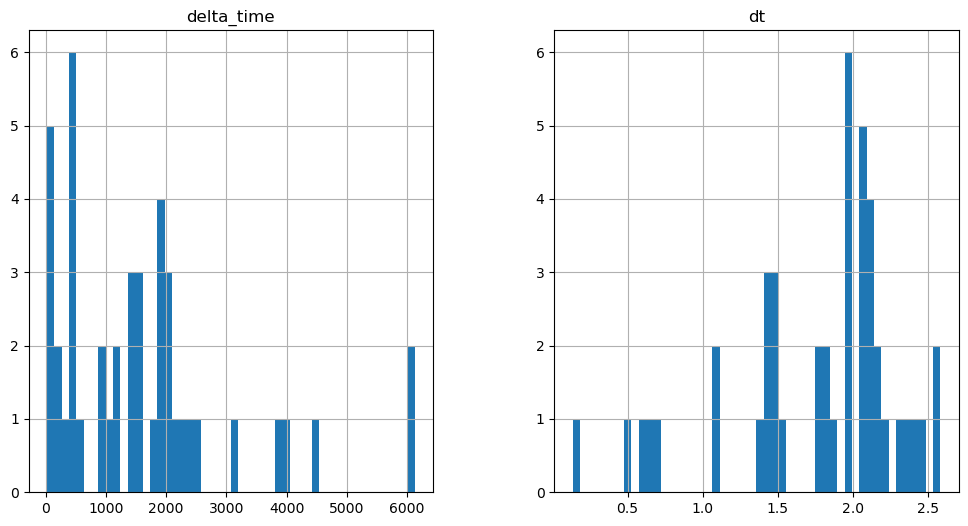

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3040.510539829731 15.705110788345337


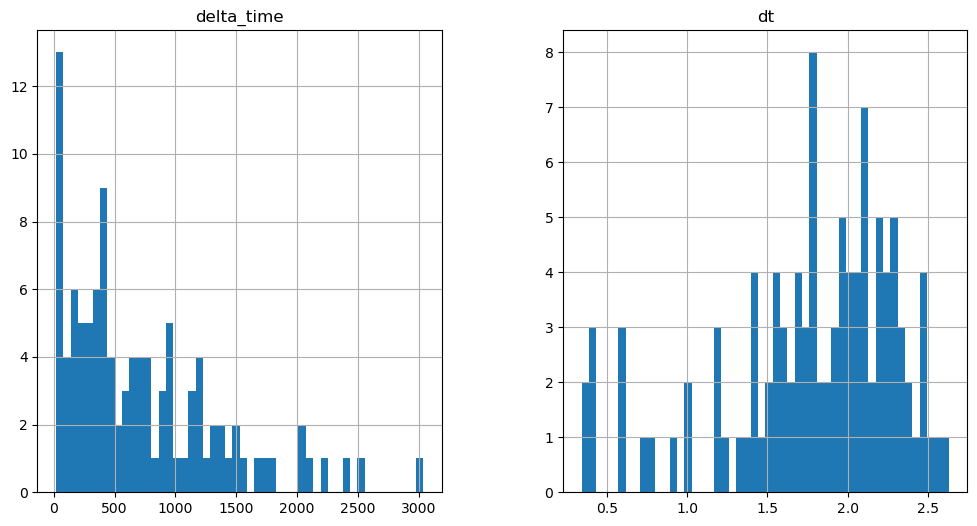

4859.144239425659 3.1410300731658936


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

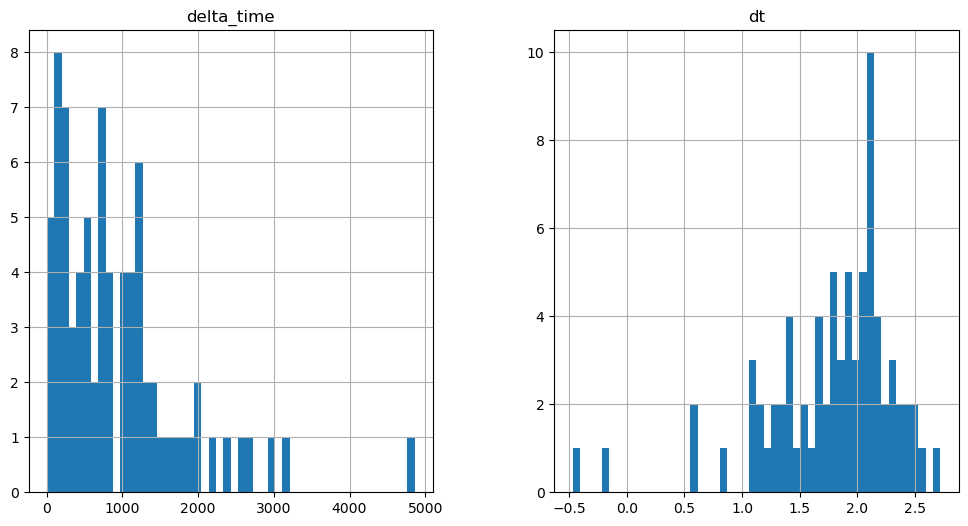

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

8713.17090934515 147.6281172633171


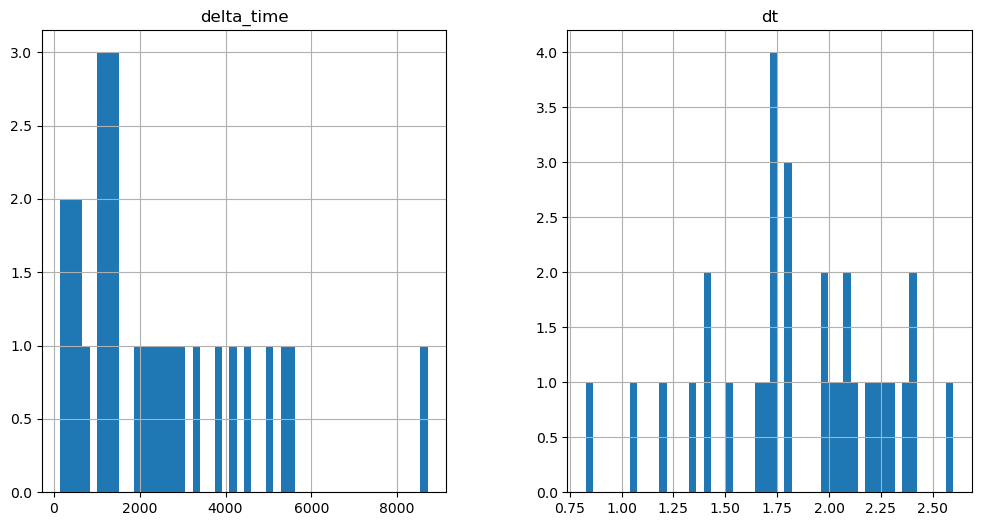

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

11166.303940355778 141.34606683254242


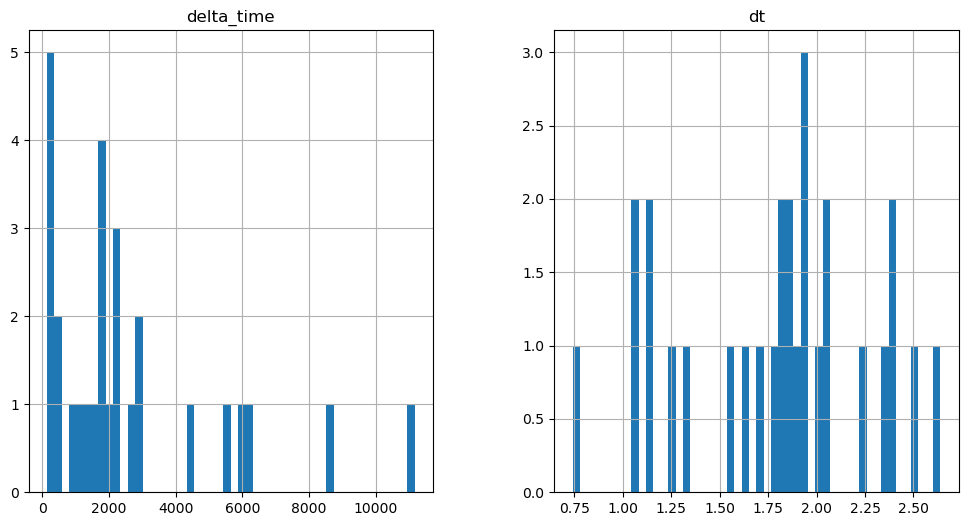

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2585.061357498169 0.1


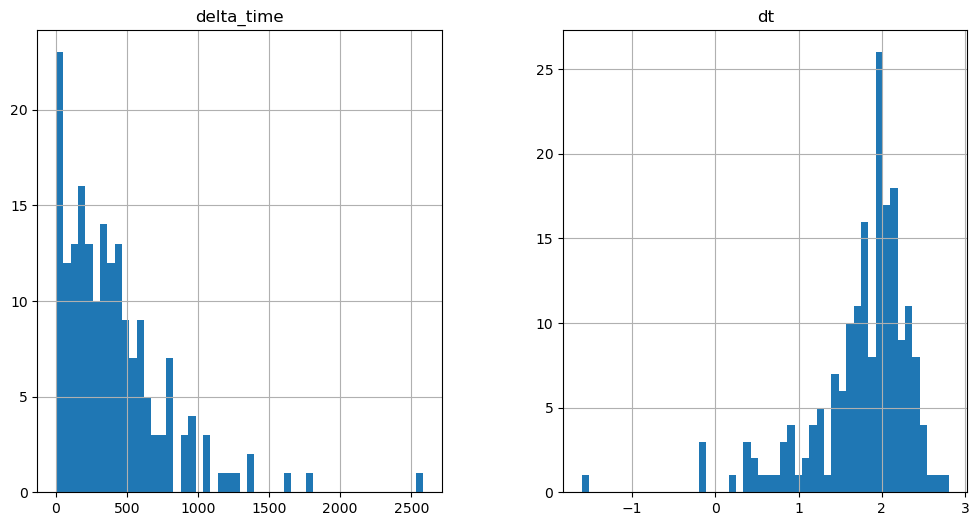

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4026.7725984454155 9.423070430755615


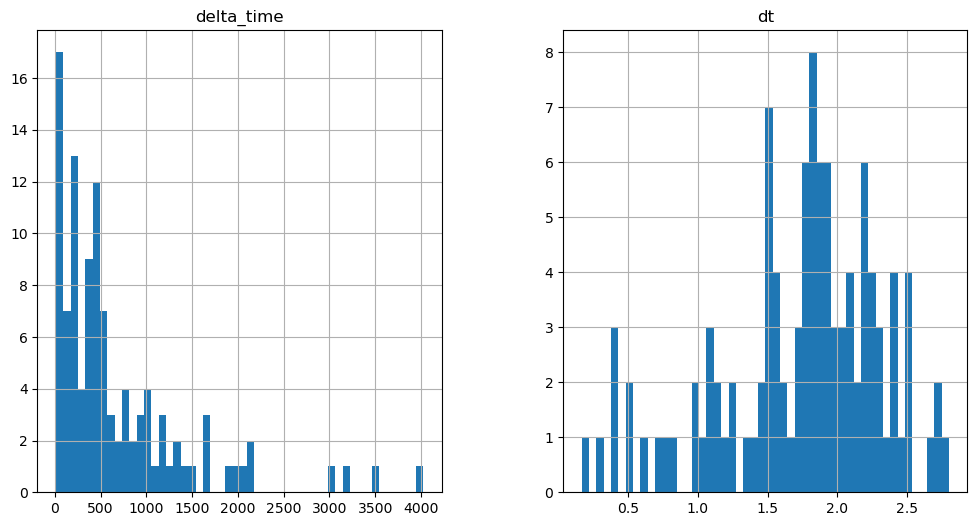

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2566.2160363793373 0.1


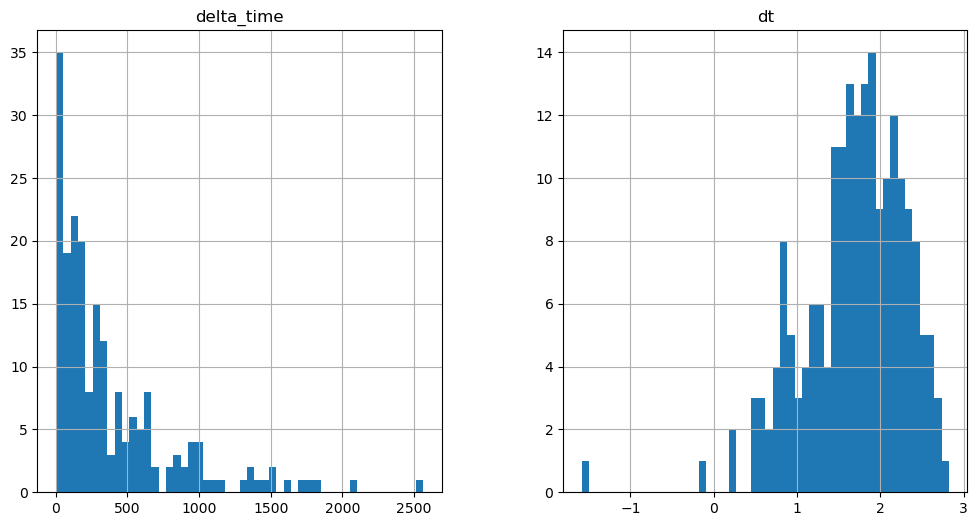

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

929.7420860528946 3.1410202383995056


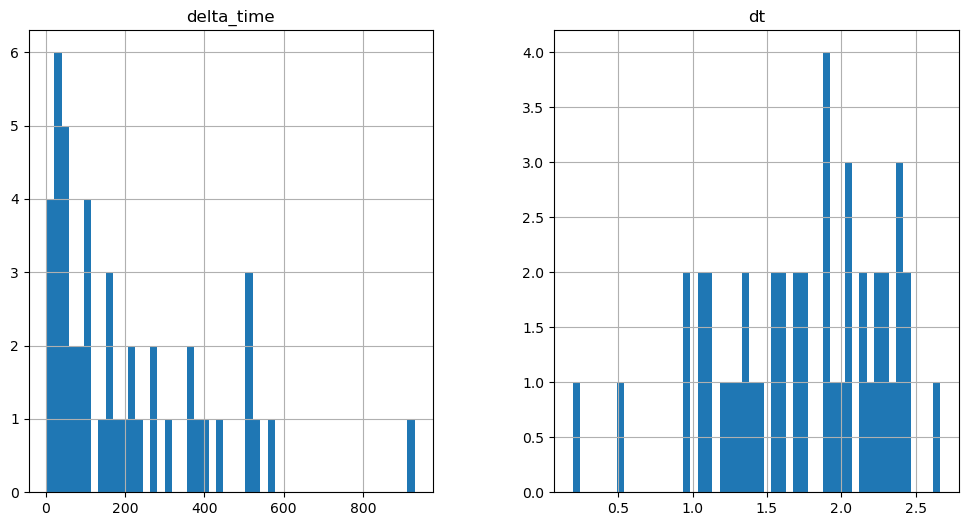

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

458.58896267414093 3.141010105609894


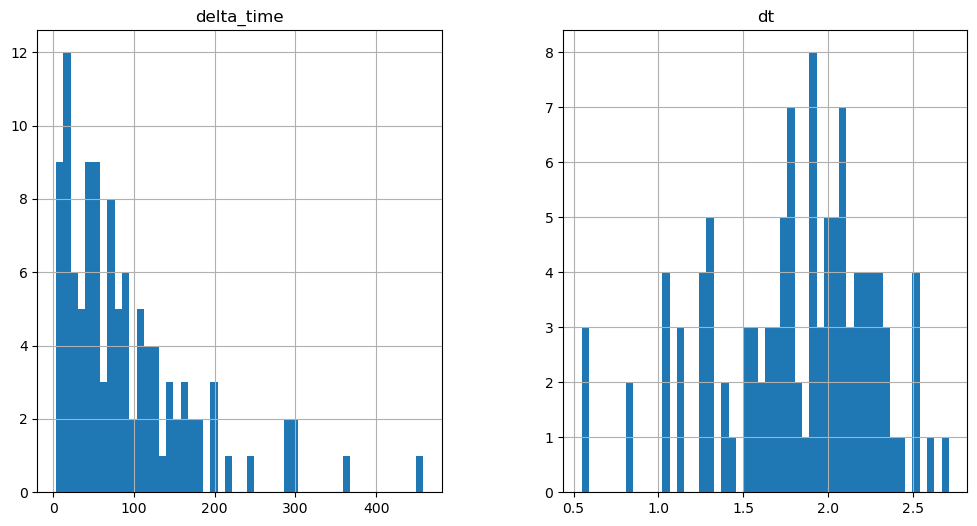

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

954.8699572682381 15.70510083436966


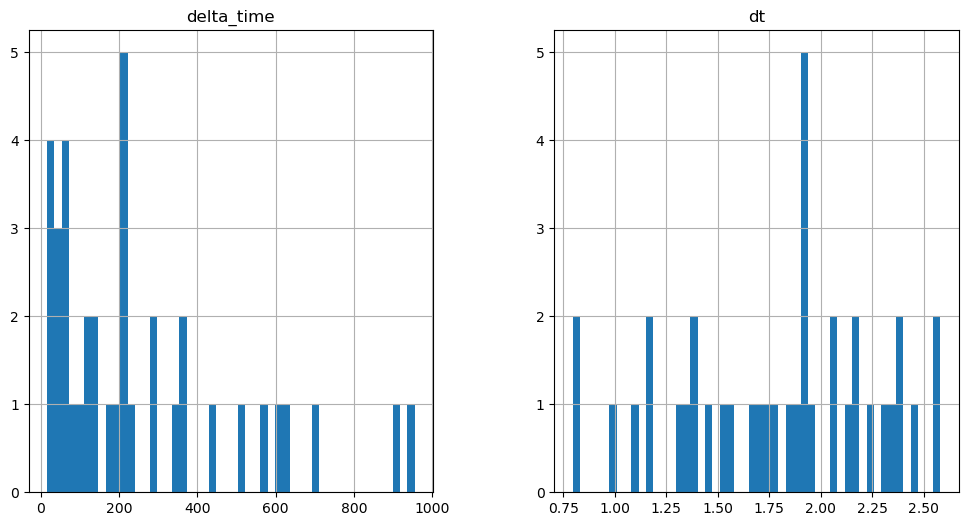

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

838.6522015929222 9.423060417175293


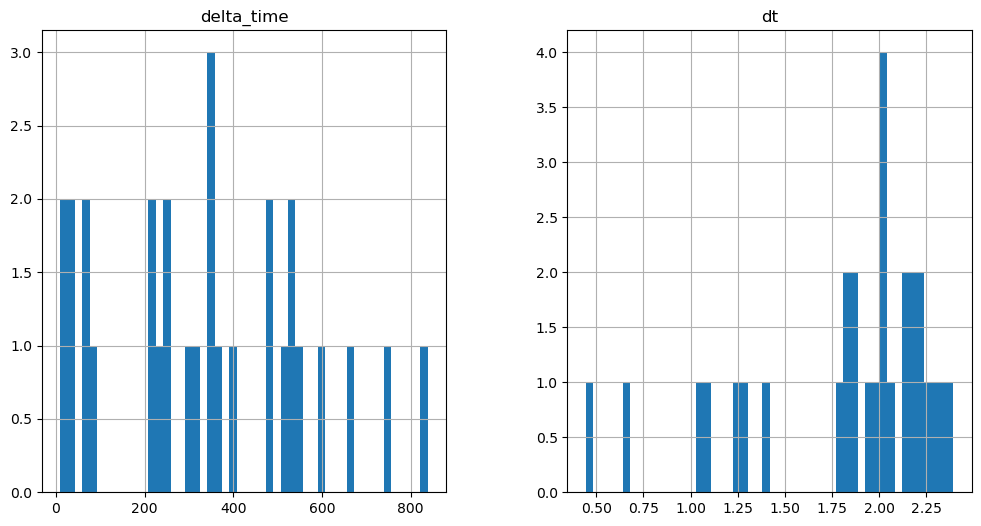

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1611.3455496430397 15.70512068271637


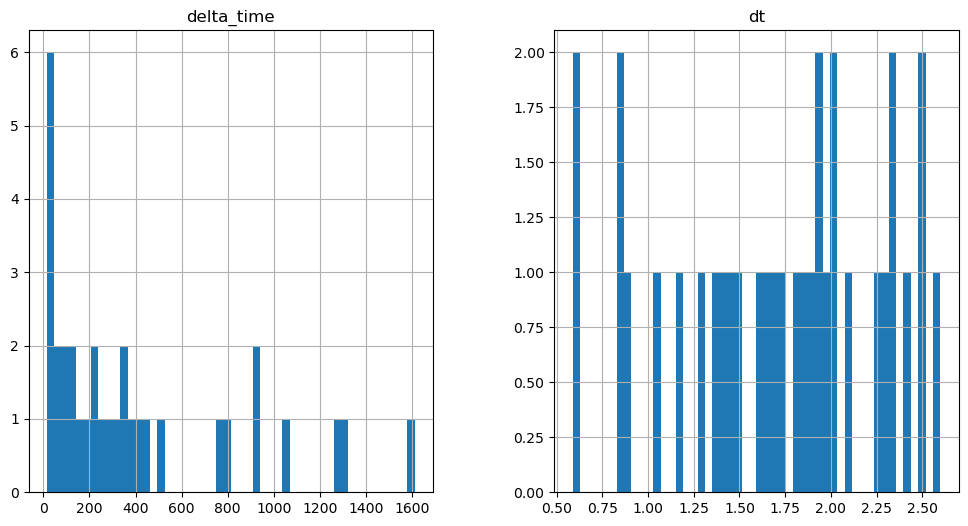

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

383.2047889828682 0.1


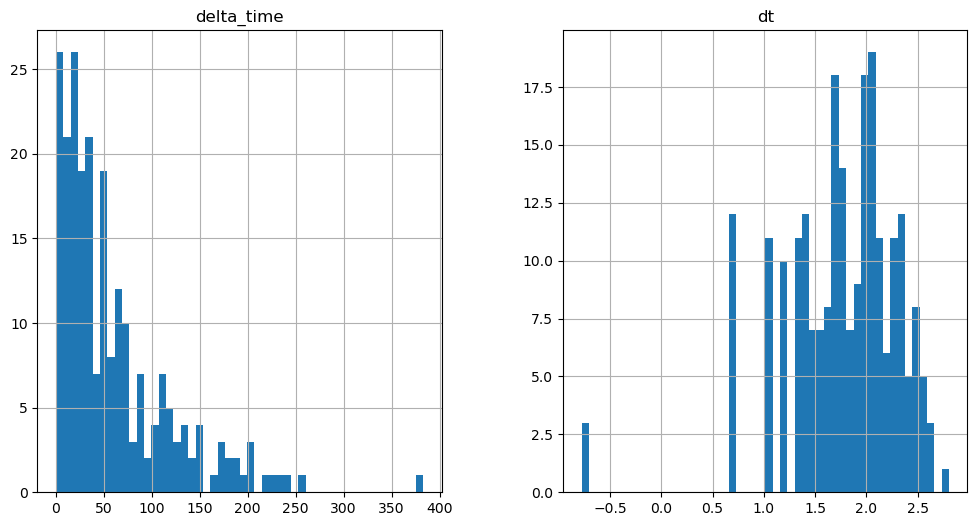

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

28.269221425056458 0.1


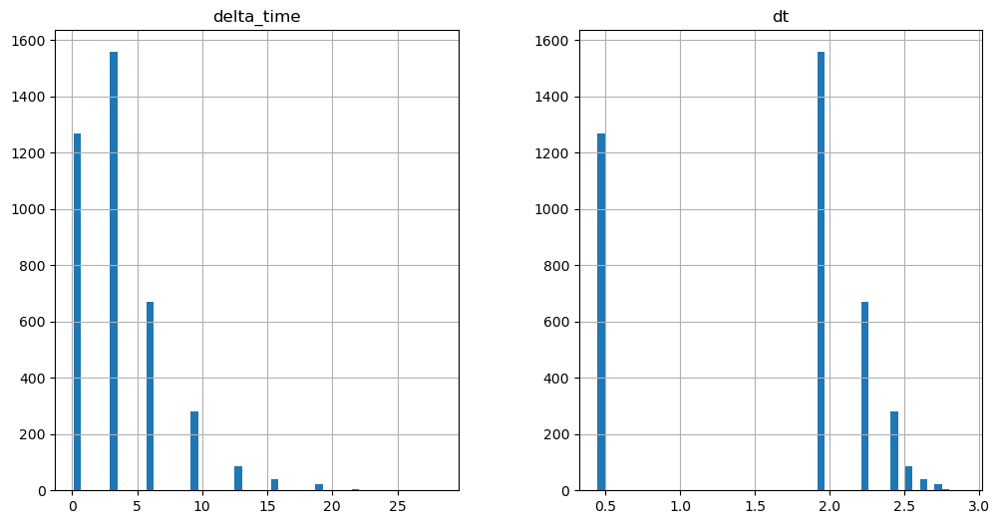

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

285.83111423254013 0.1


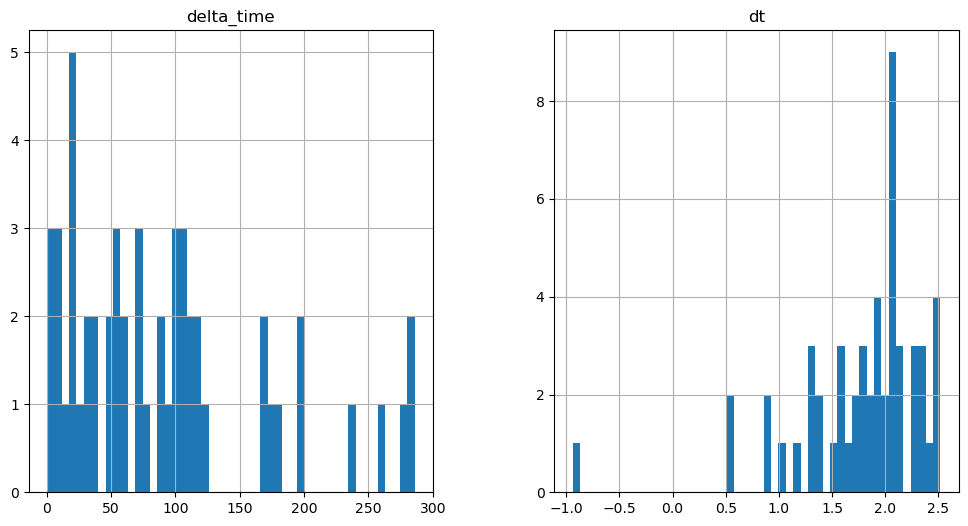

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

288.97206449508667 6.281980395317078


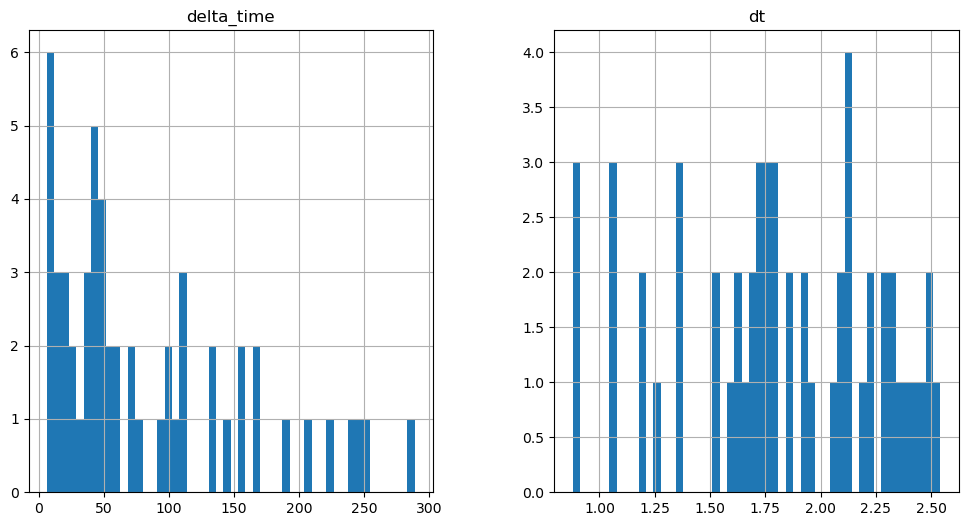

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1464.9315179288387 0.1


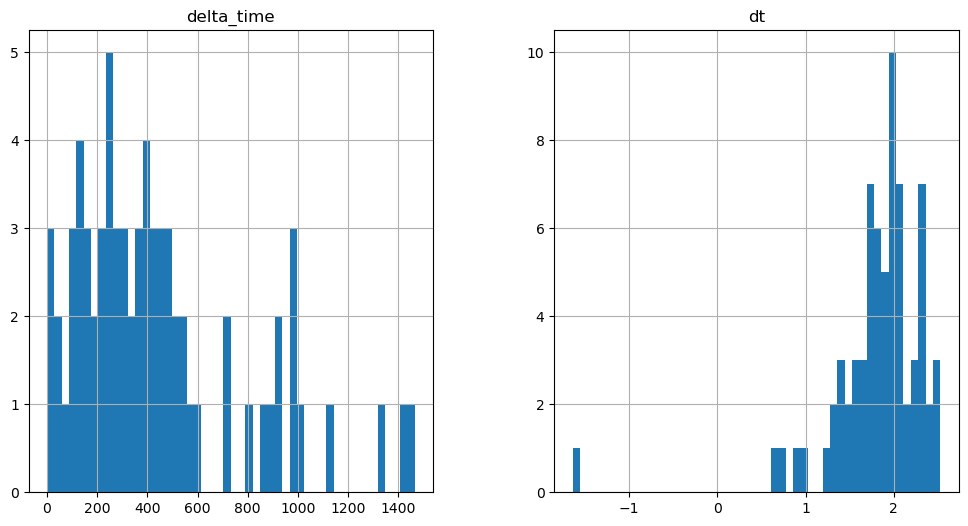

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2070.9983618855476 3.2409902065992355


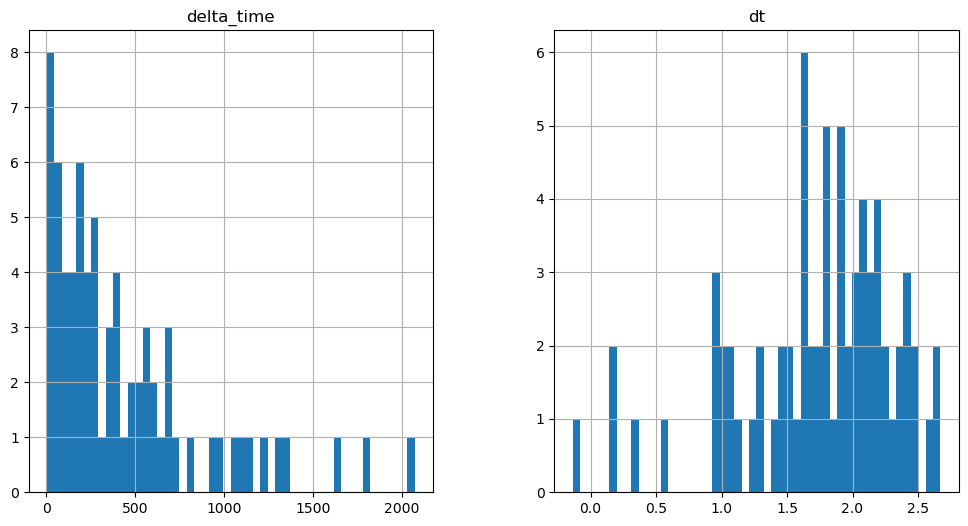

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

871.8287244141102 0.1


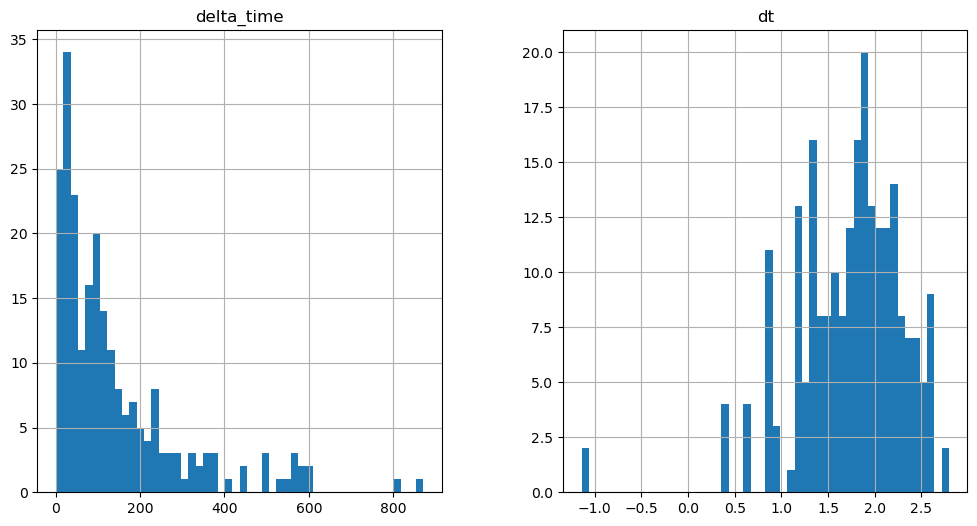

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1782.5493505001068 0.1


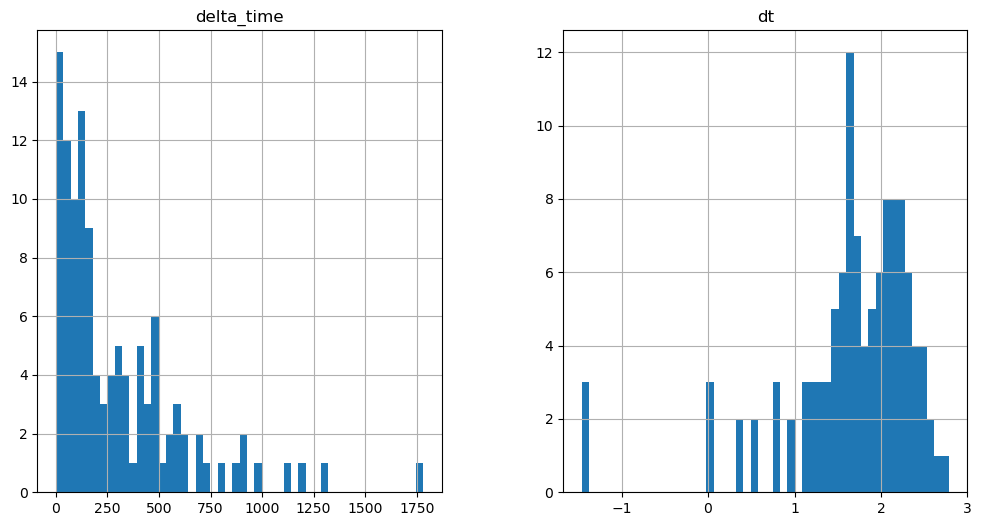

1607.5354735404253 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

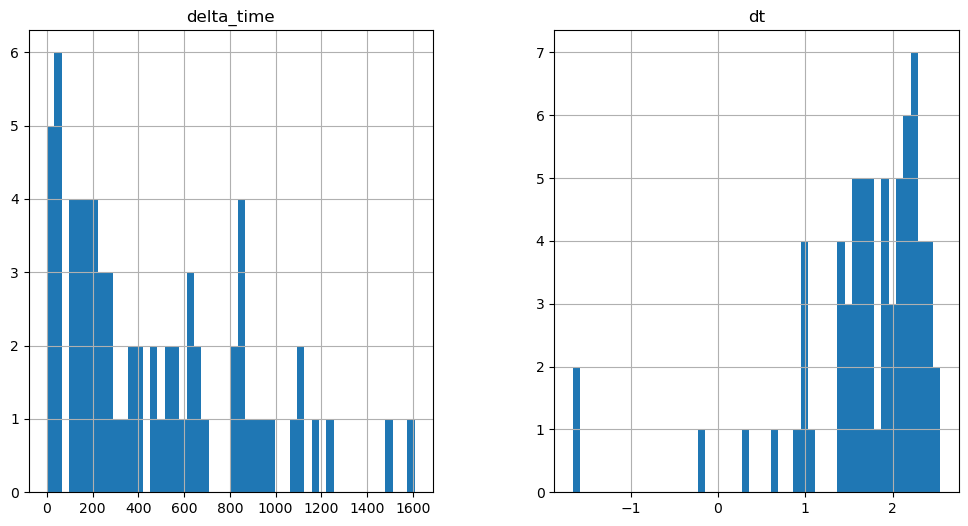

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3322.0238813608885 0.1


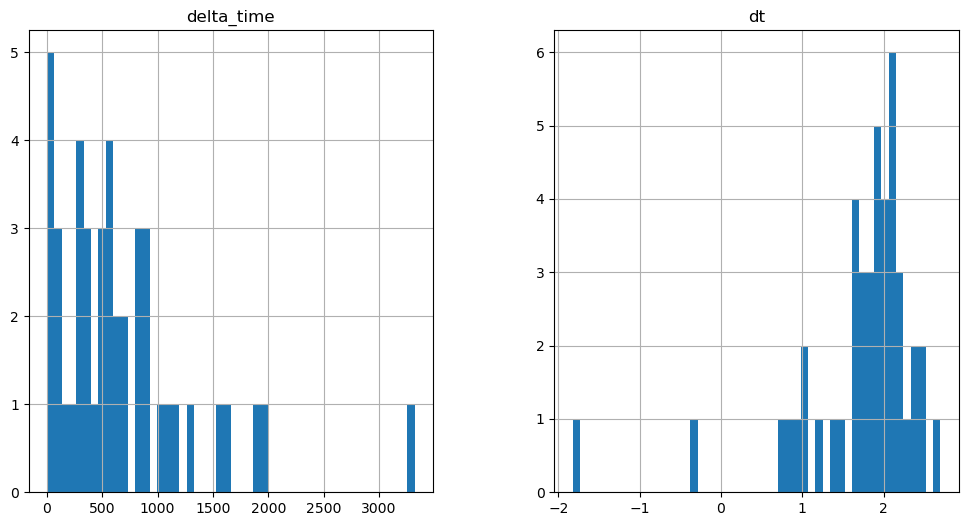

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2015.9013996869326 0.1


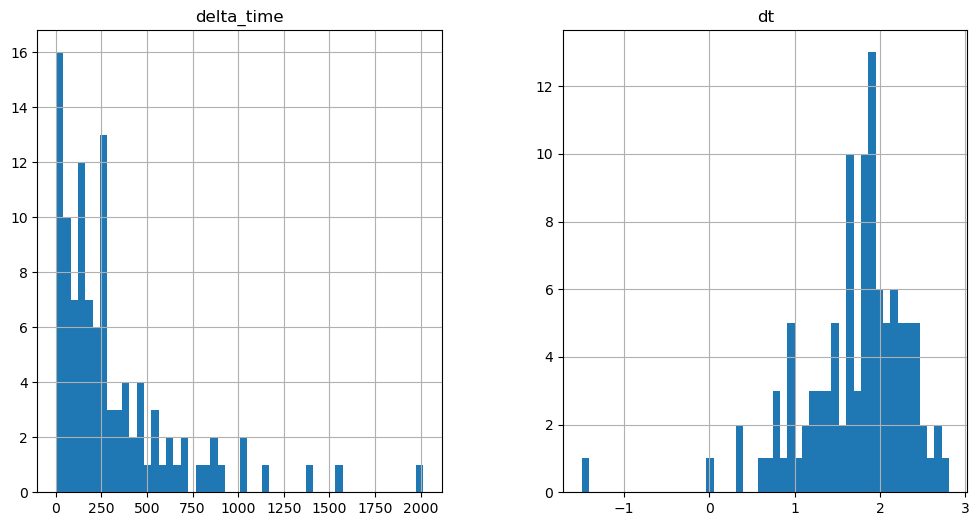

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1934.8763865083456 12.963980570435524


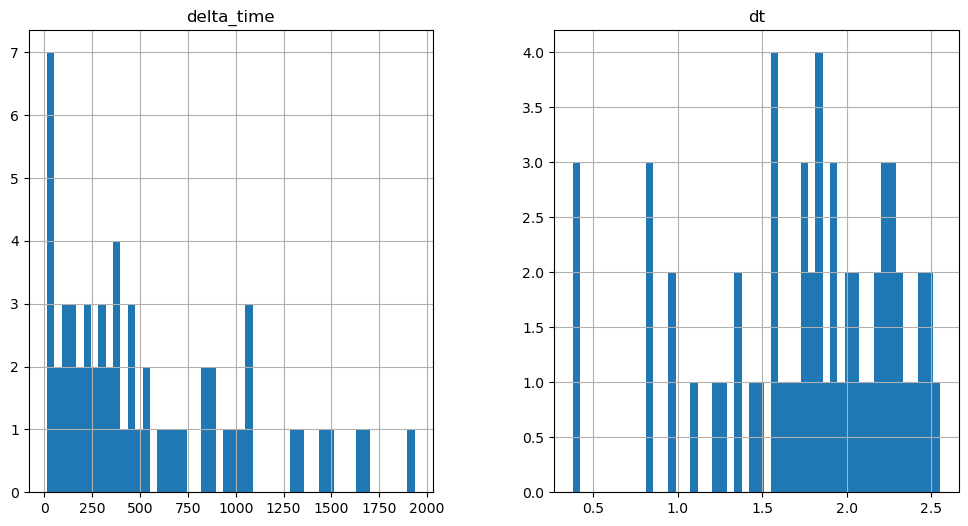

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

370.6398882865906 0.1


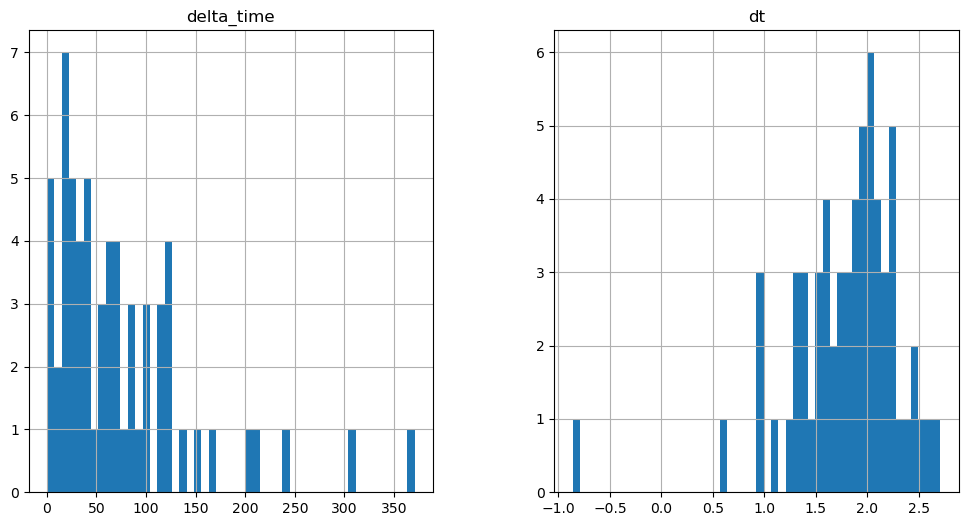

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

402.0523199439049 3.1410301327705383


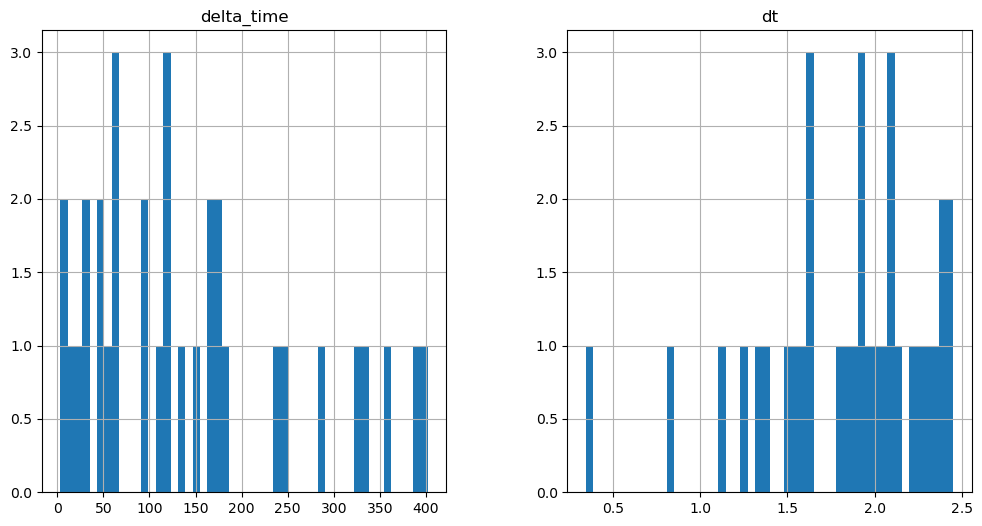

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

678.462283551693 0.1


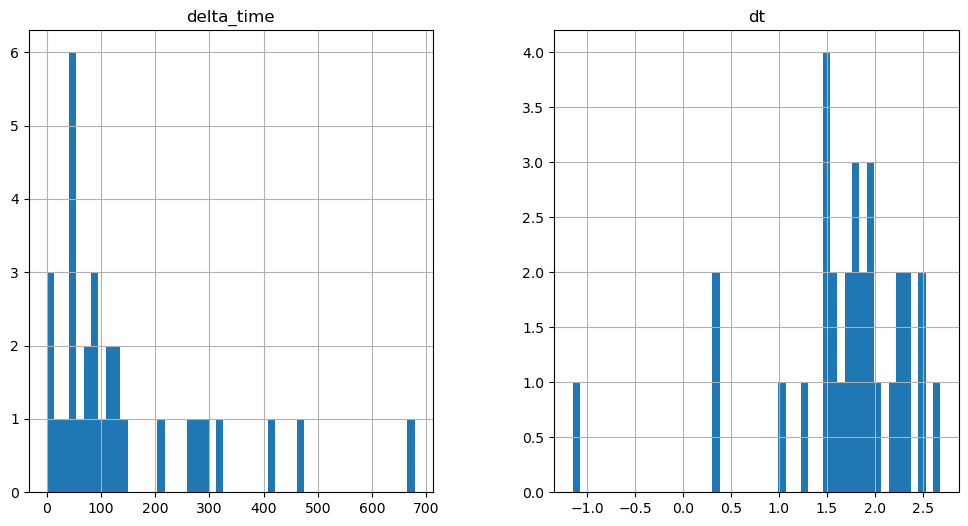

722.4335558414459 3.1410200595855713


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

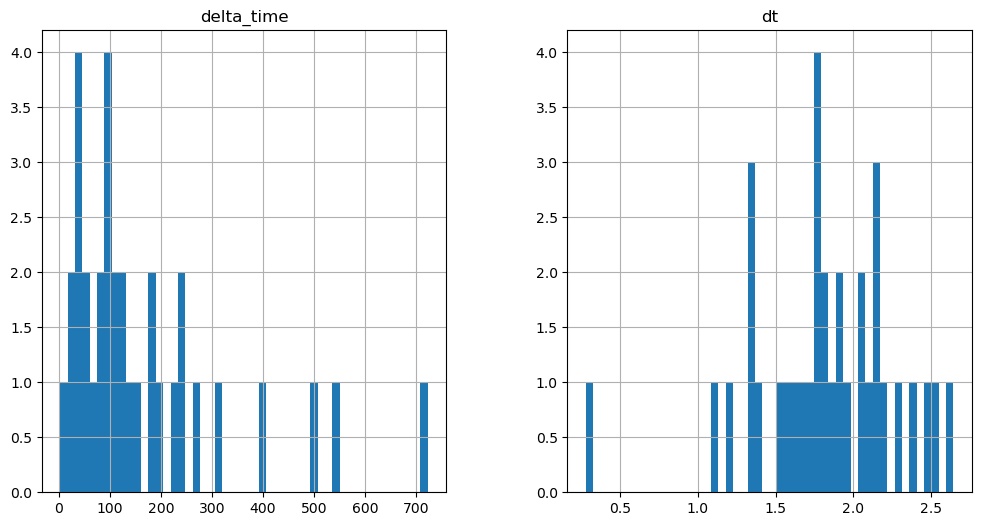

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

13780.735204488039 6.48201023042202


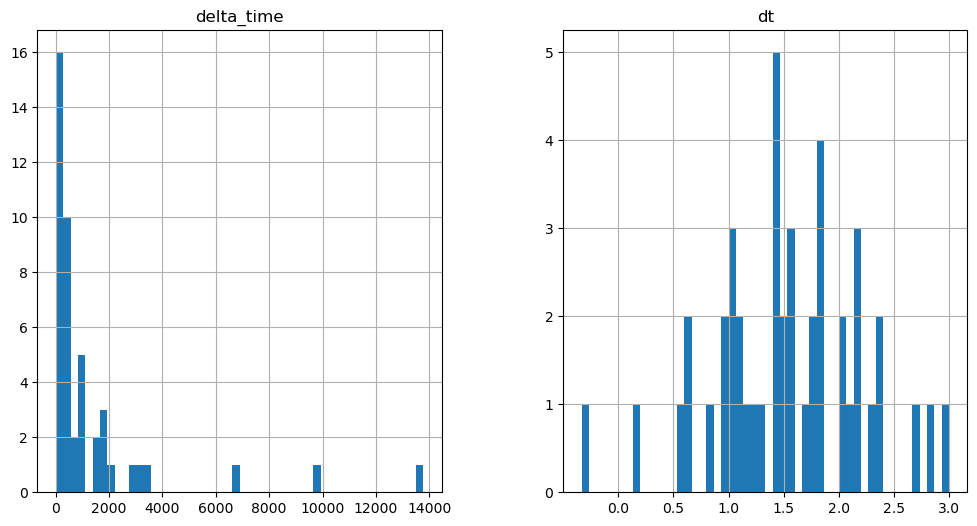

3526.2087393403053 6.482010245323181


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

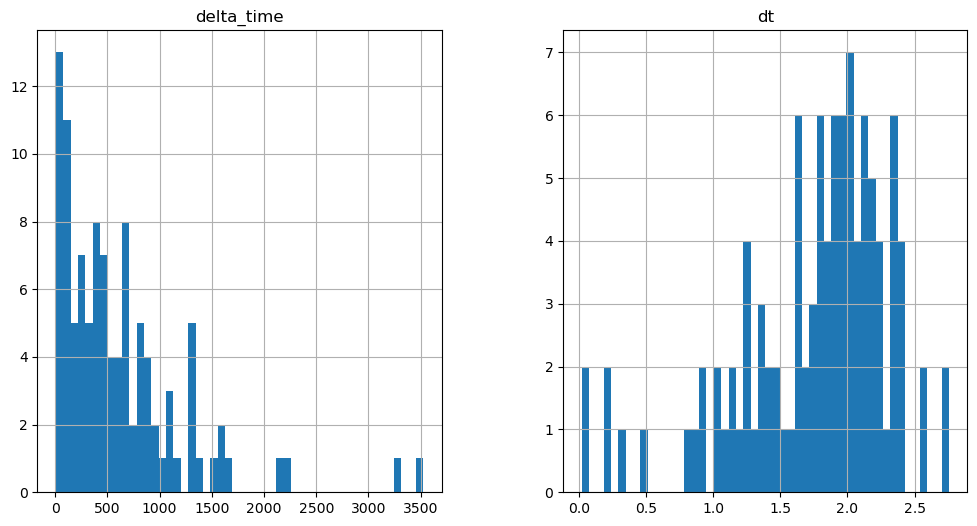

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3769.2838988900185 0.1


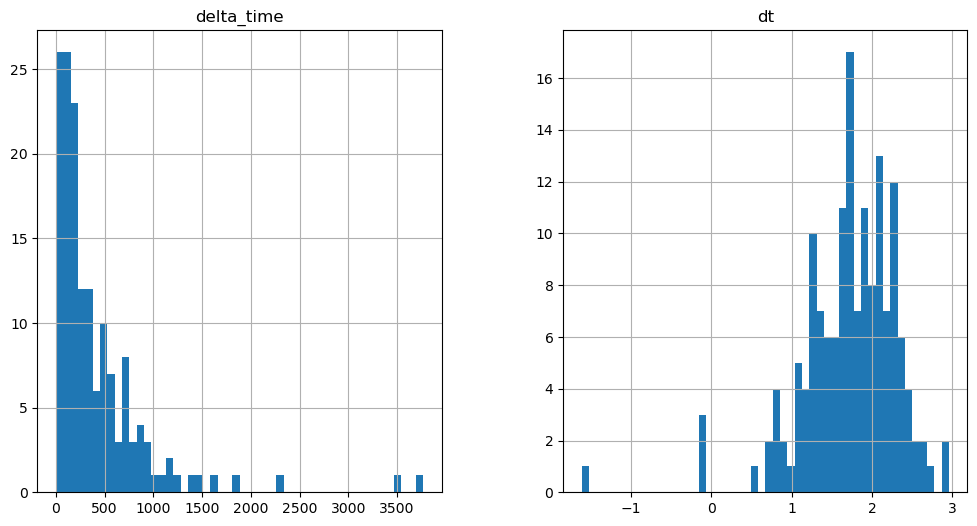

327.3410629630089 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

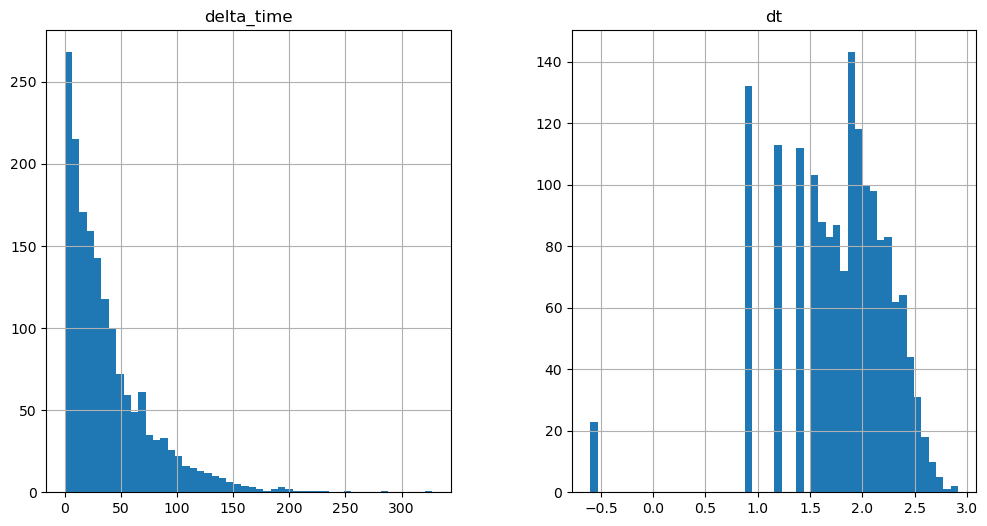

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

20149.302396163344 0.1


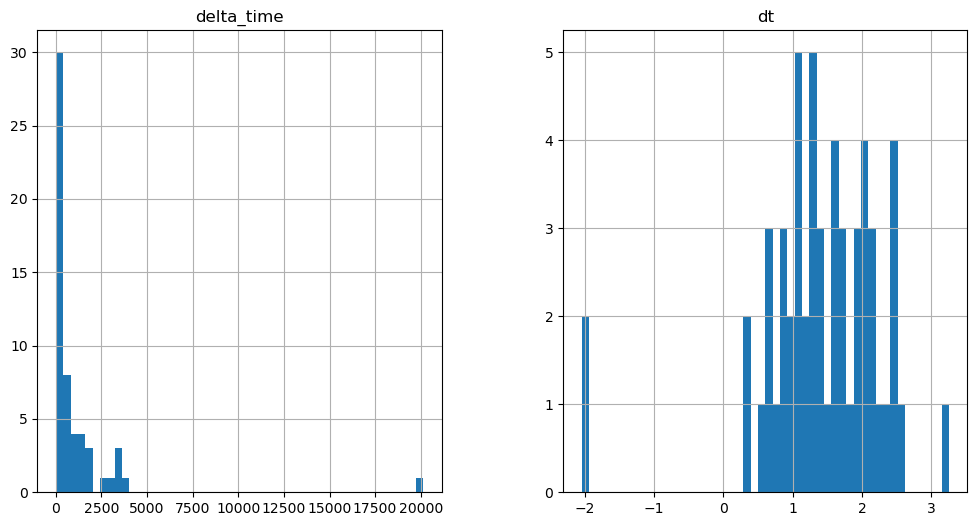

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

8254.828006207943 0.1


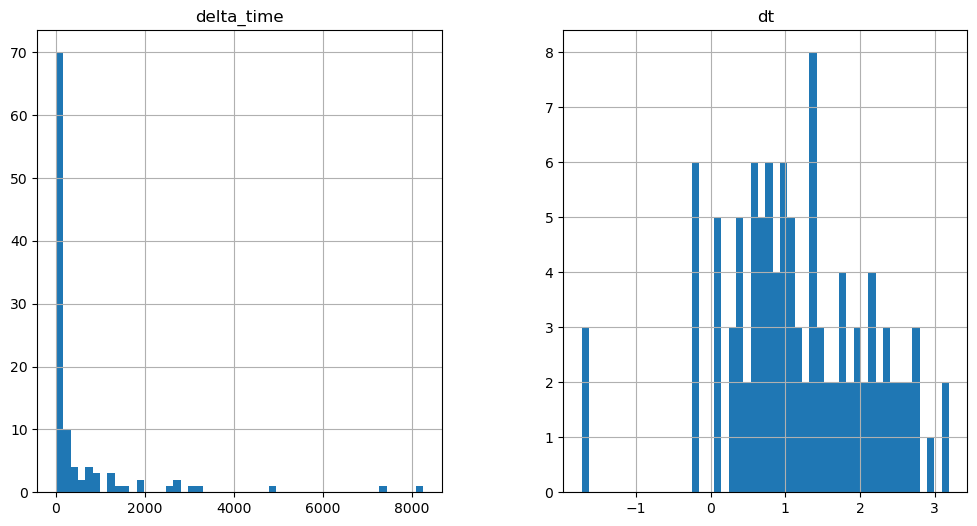

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4680.005274936557 12.964010491967201


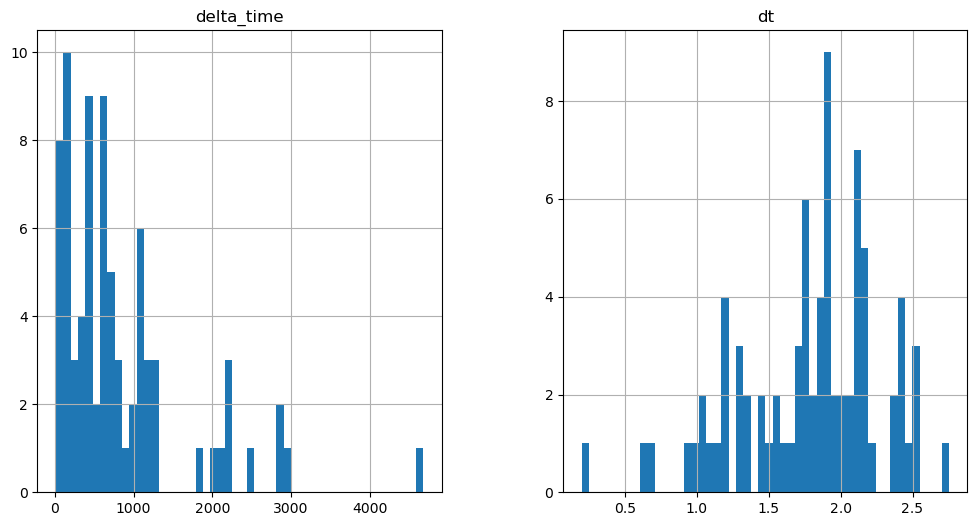

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5490.255486905575 6.482010260224342


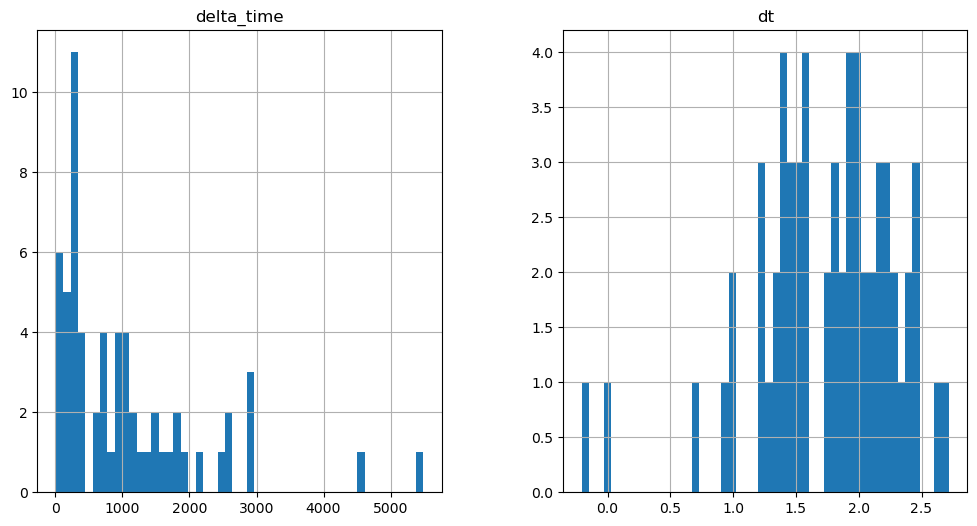

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4751.30685774982 0.1


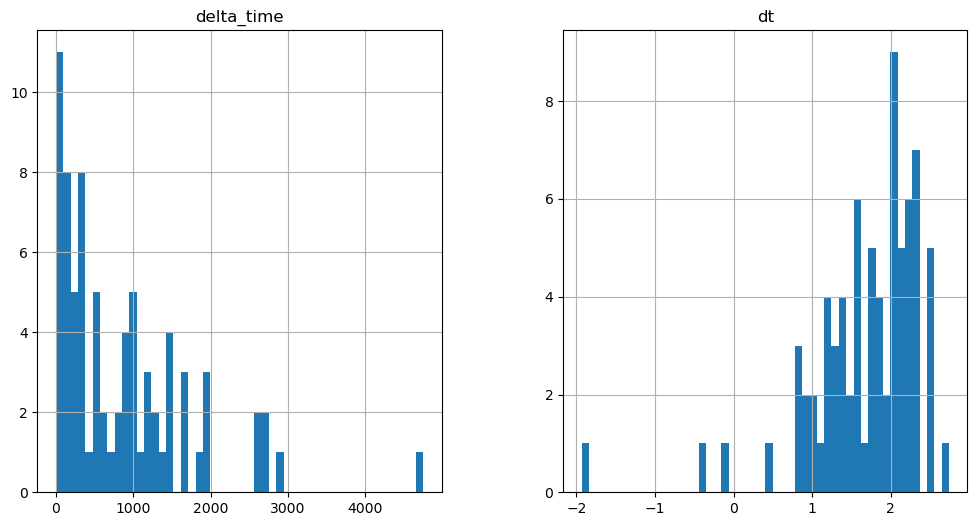

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

12558.877506300807 25.927991032600403


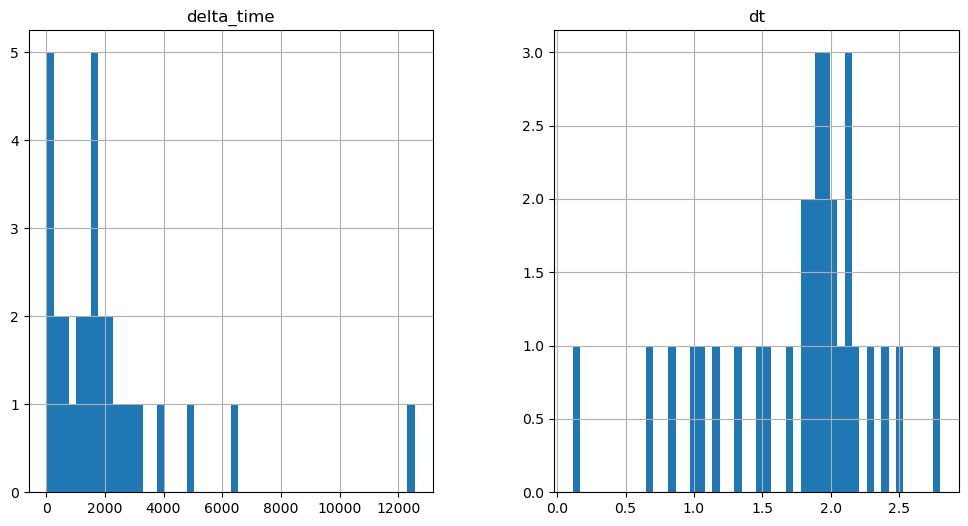

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4339.699831470847 35.65102136135101


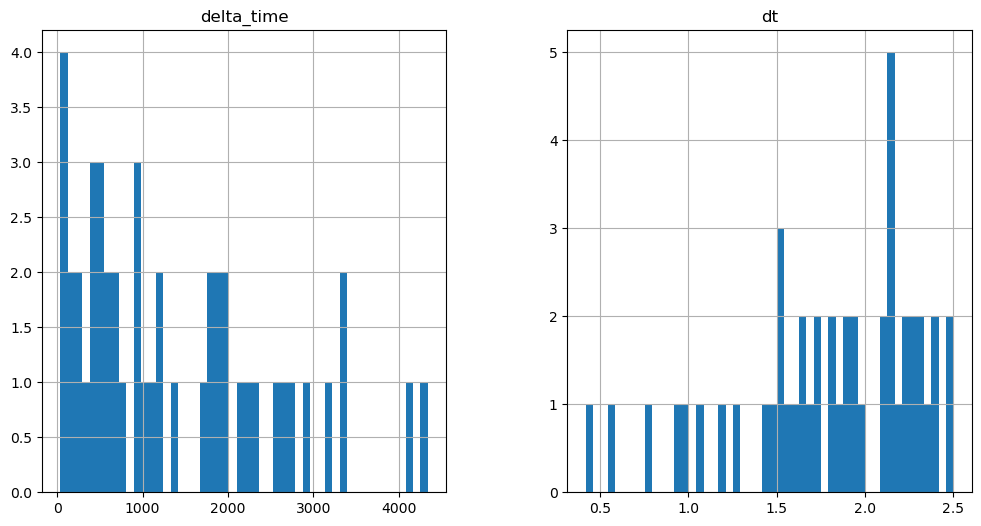

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

926.9262466132641 0.1


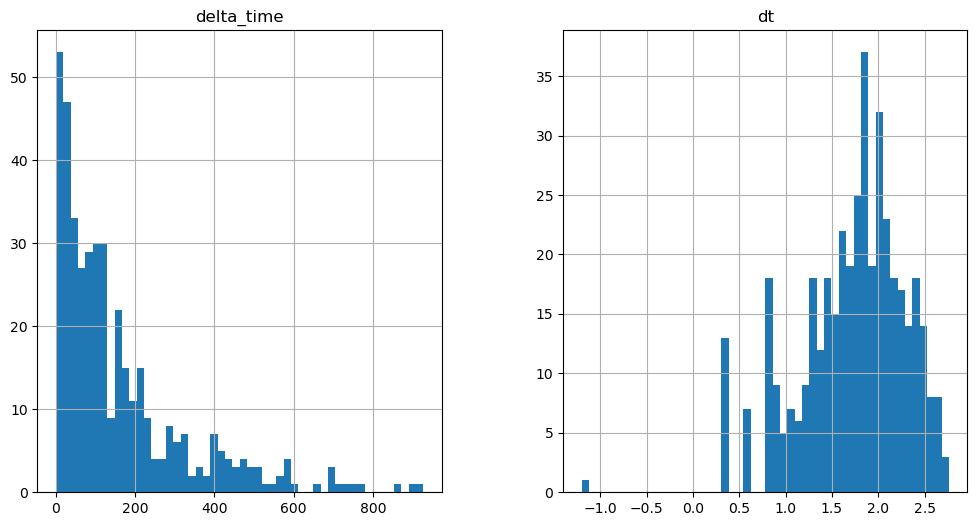

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1779.3087803274393 6.482000261545181


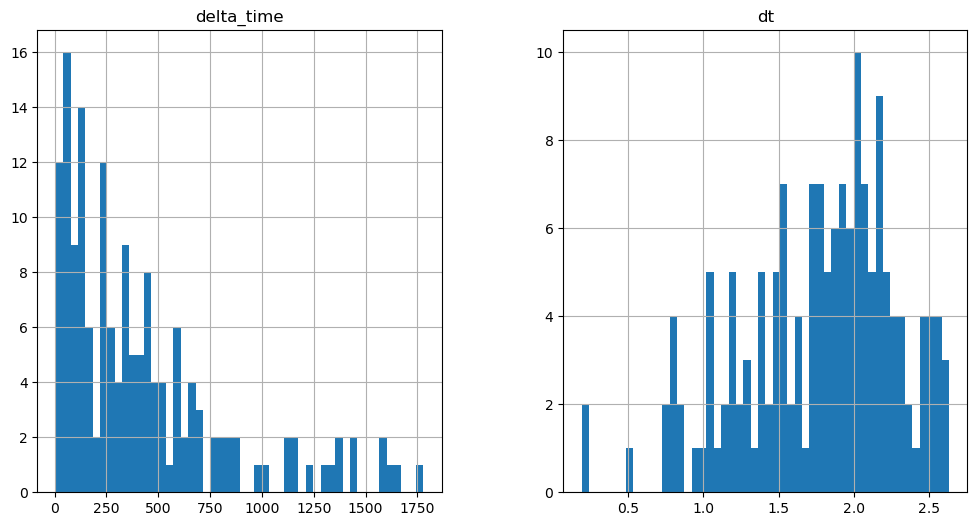

3386.845783904195 16.205000638961792


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

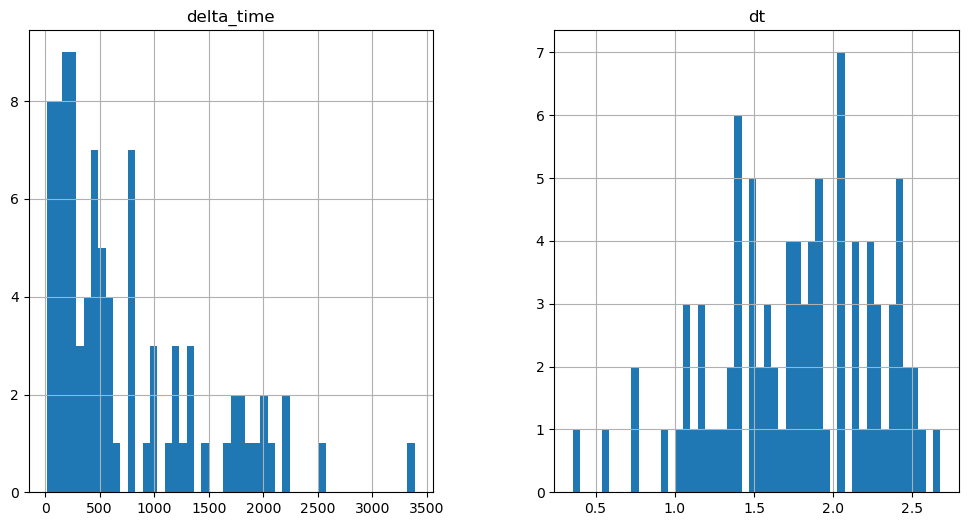

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

436.5997916460037 3.141020119190216


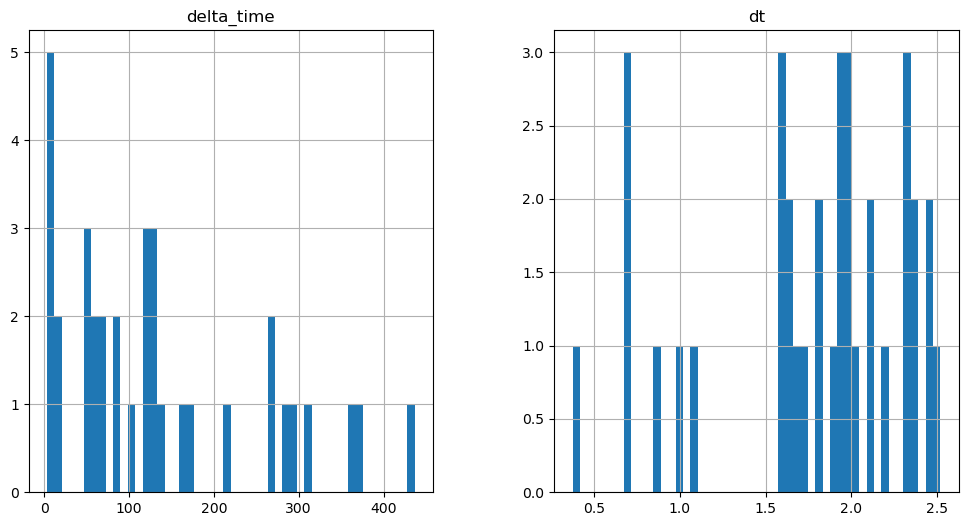

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

474.29429364204407 3.1410202383995056


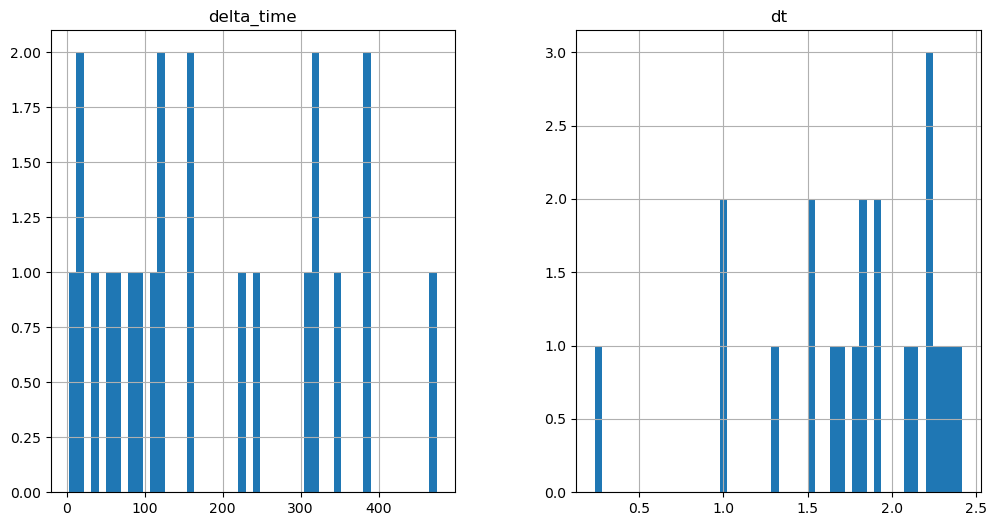

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

304.68015509843826 0.1


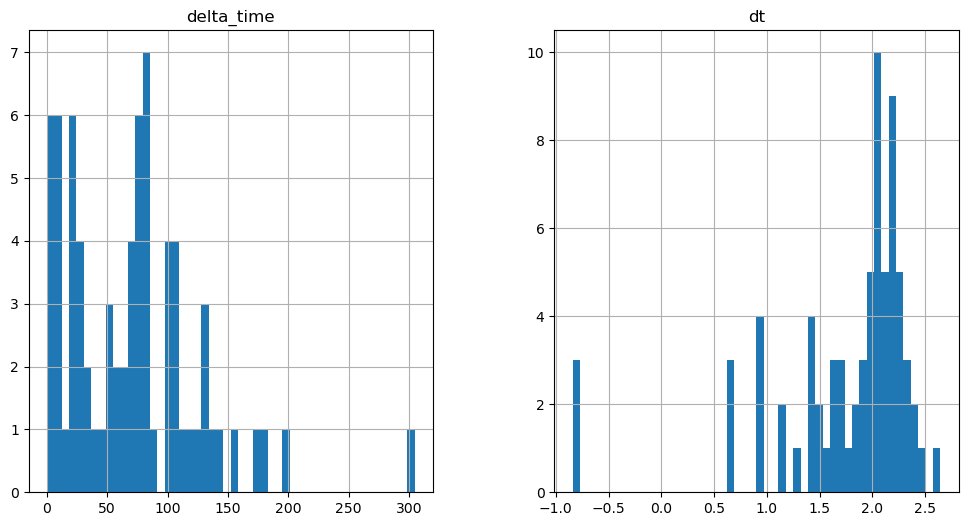

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

480.5755439400673 9.423060357570648


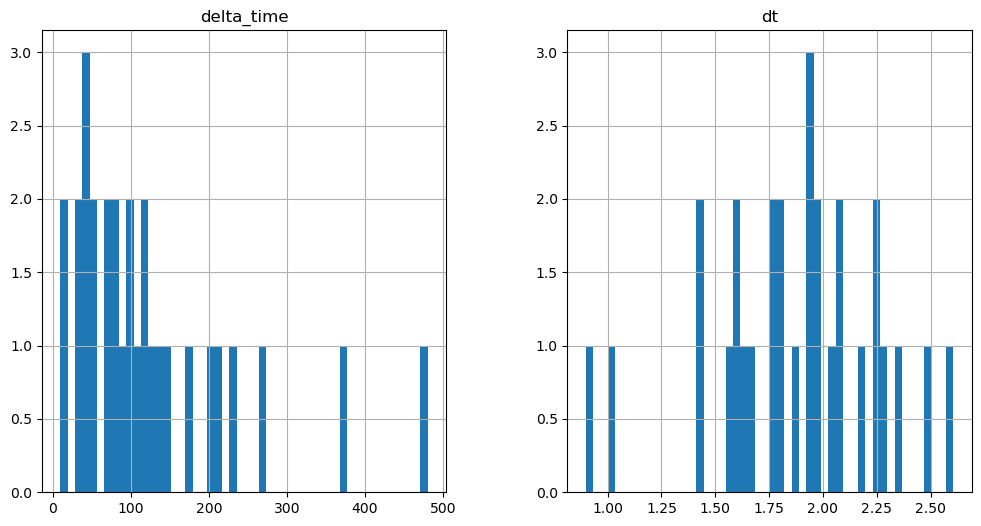

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1268.9645328521729 6.281980395317078


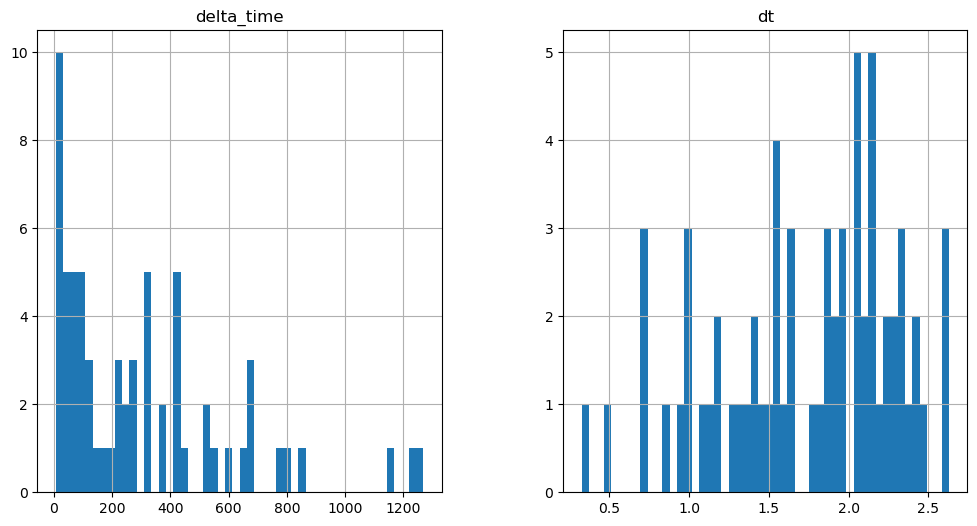

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3455.1001408696175 28.269051432609558


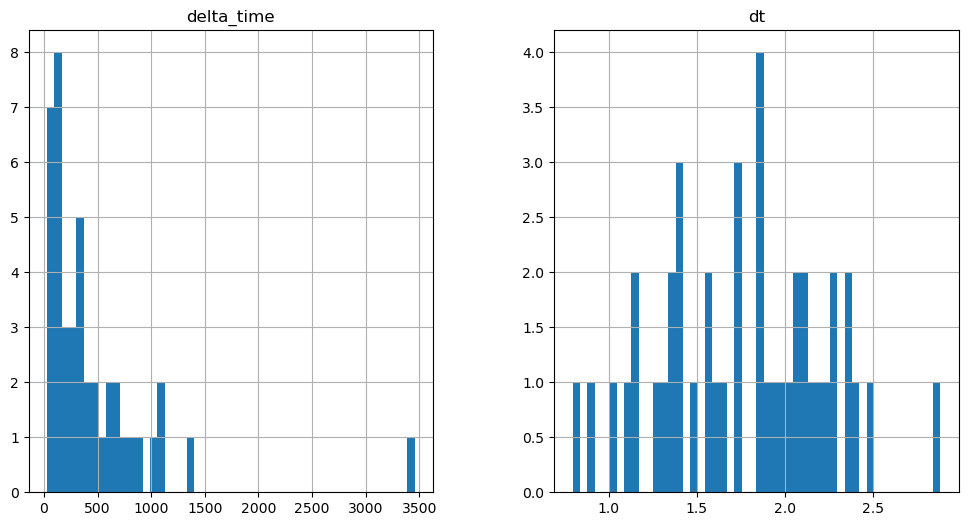

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1752.67806661129 3.1409802436828613


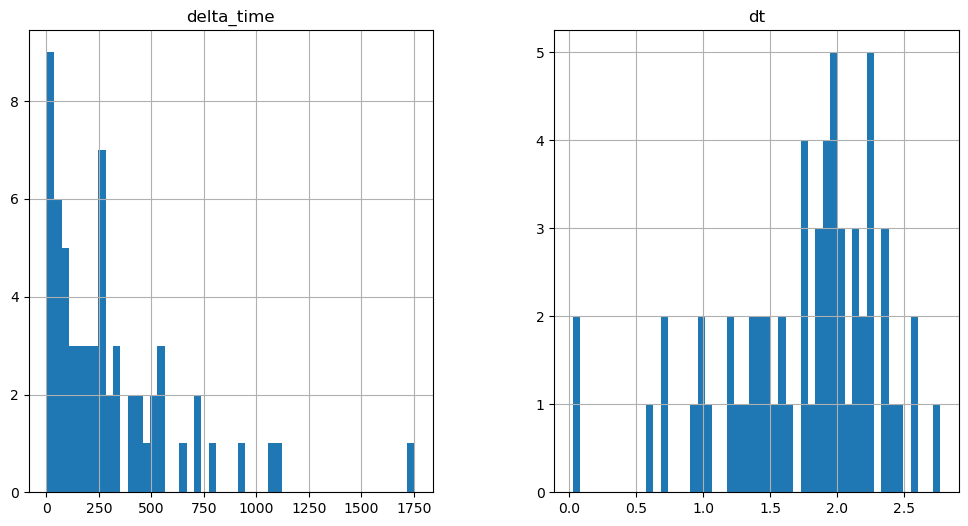

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2186.1365280151367 25.12798136472702


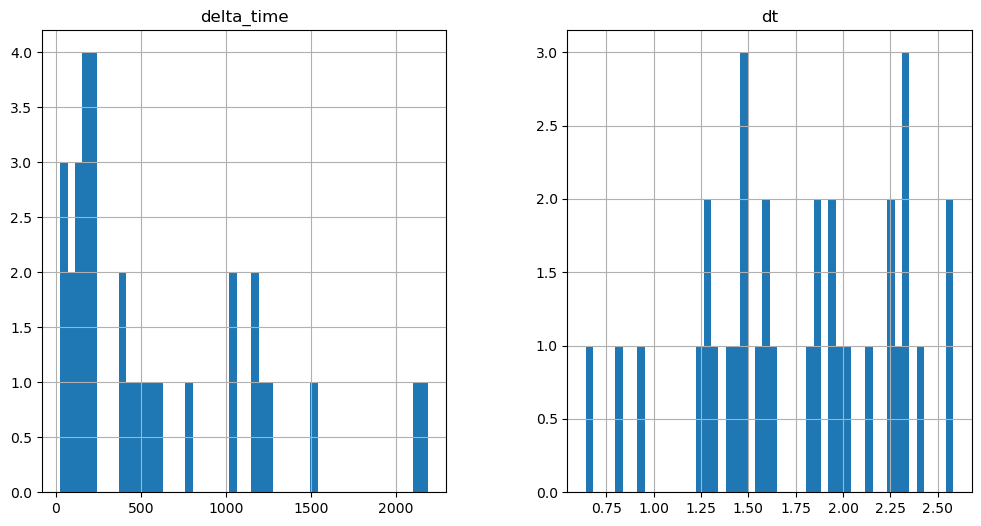

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1143.3240565657616 18.846000909805298


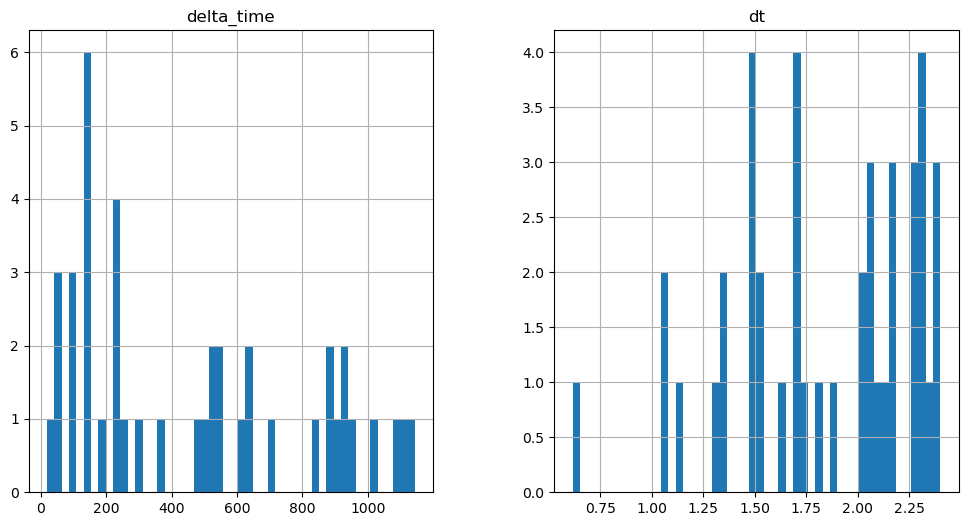

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1802.9347792863846 37.692081809043884


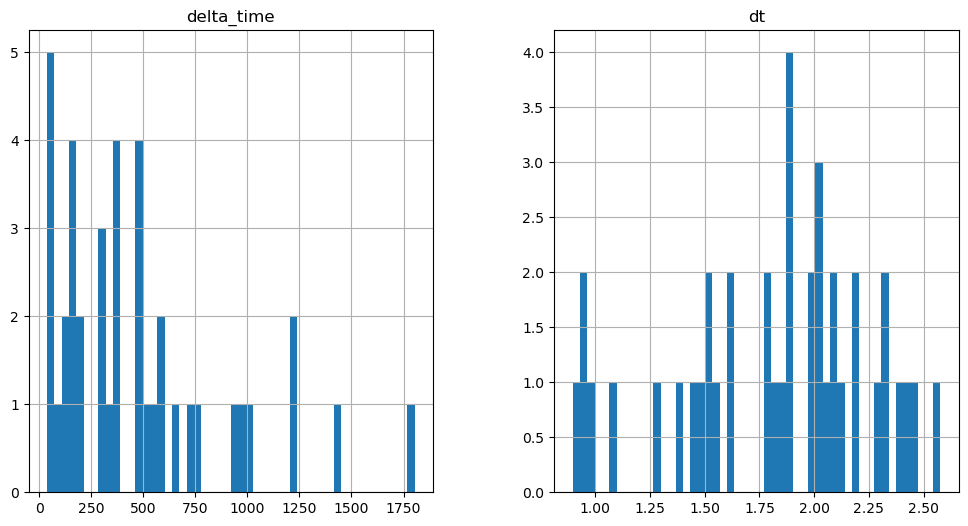

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1052.2353820800781 0.1


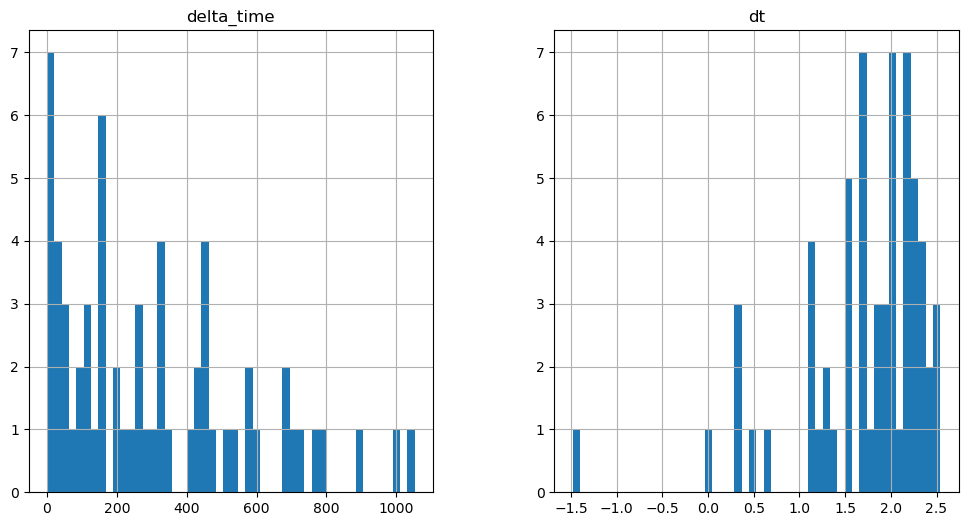

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2522.2235246300697 12.564010620117188


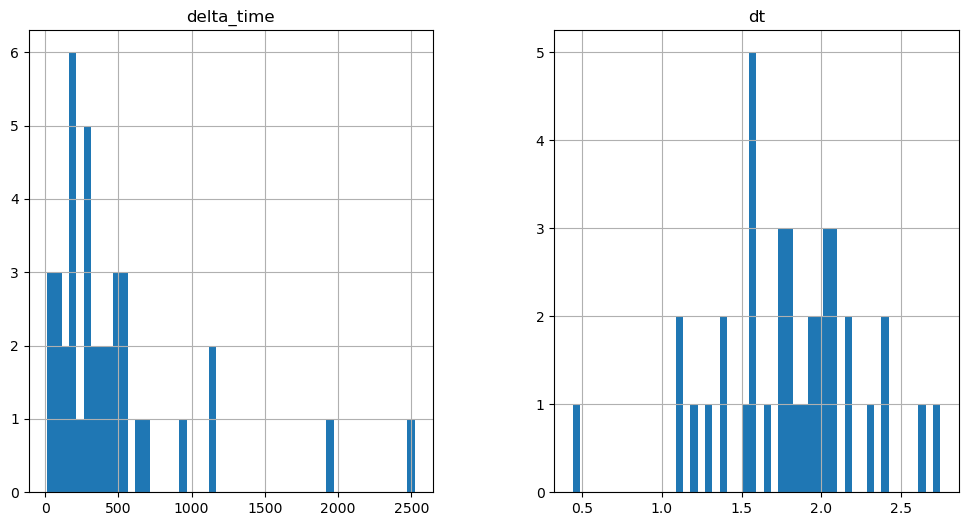

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1294.092113852501 0.1


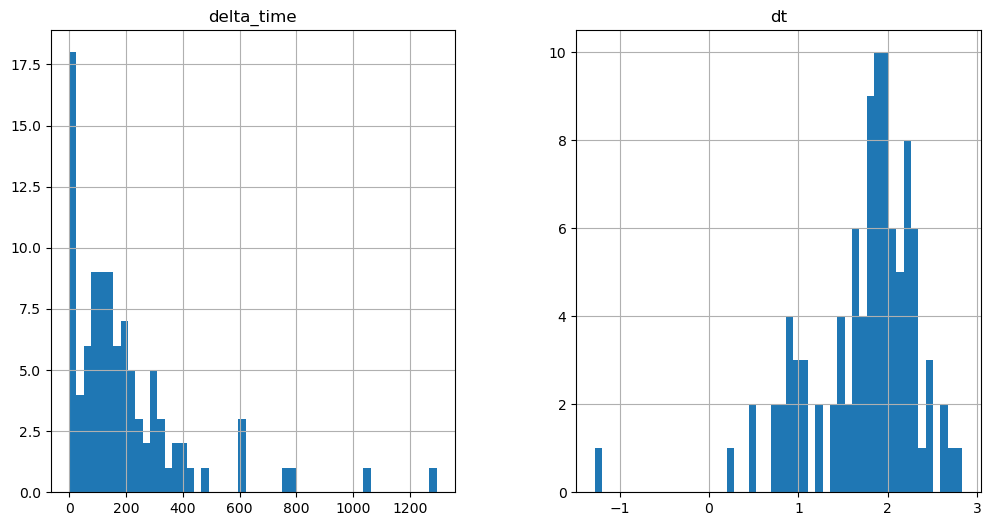

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1784.0969893932343 3.1410102248191833


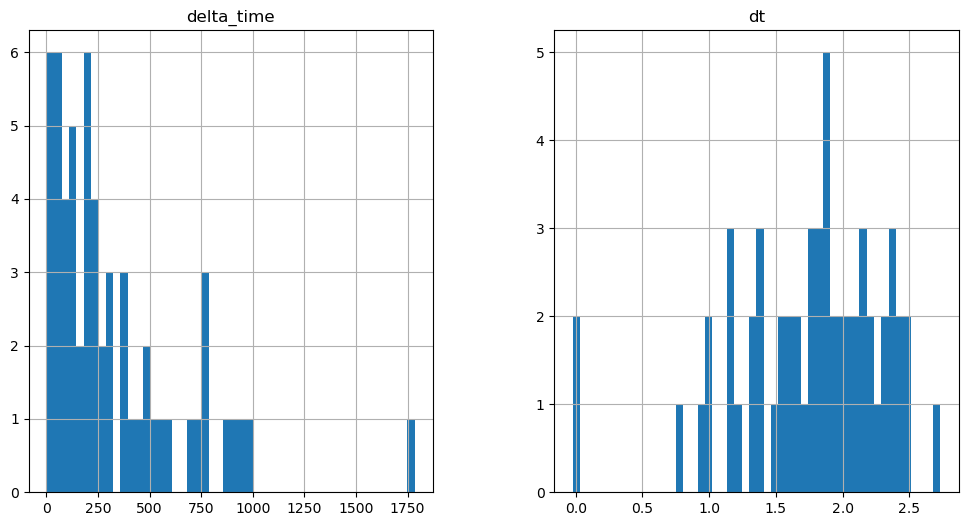

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

615.6390607357025 0.1


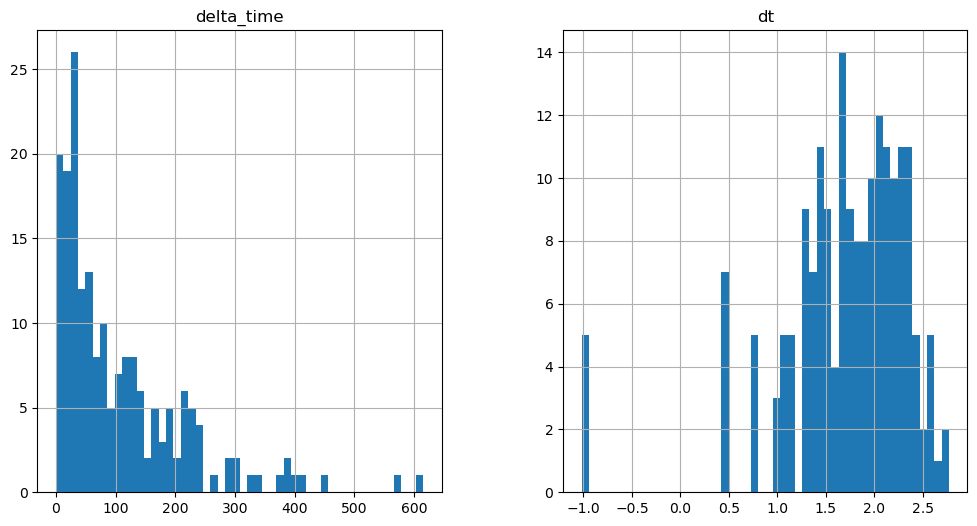

4443.409895539284 32.40999127924442


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

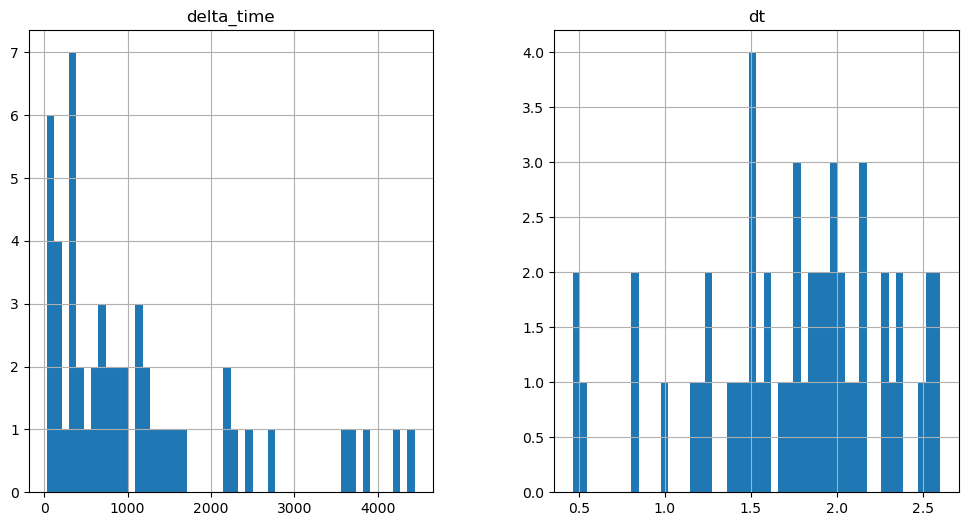

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2894.212284401059 29.169001147150993


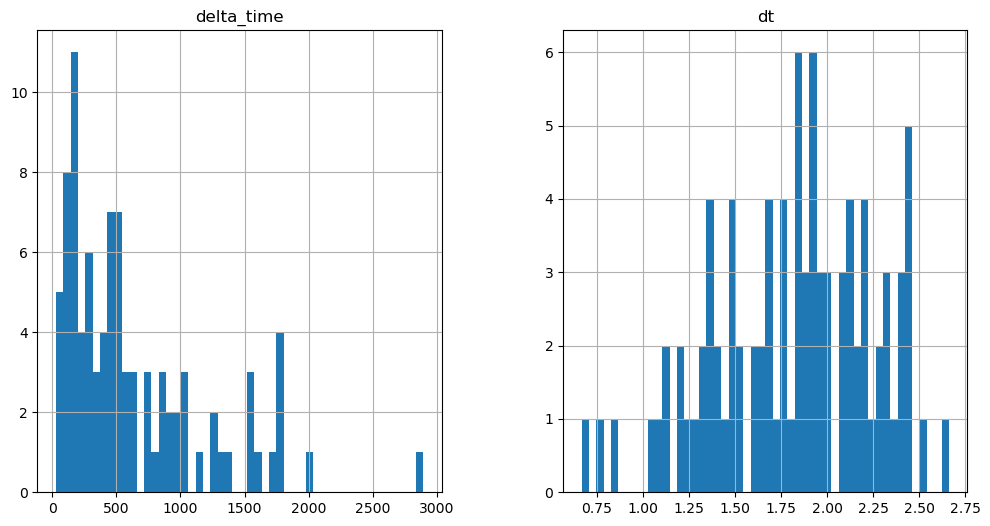

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2660.8601752221584 3.240990161895752


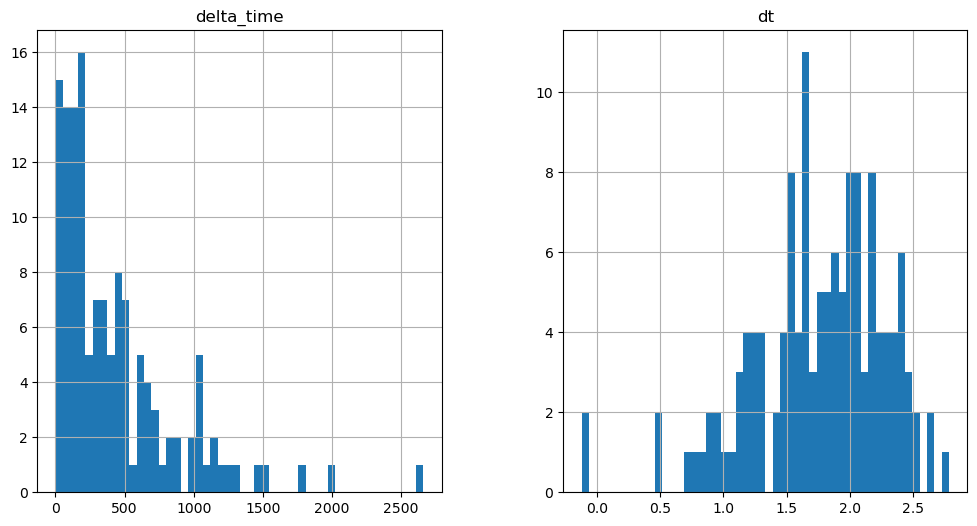

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2609.0043731182814 0.1


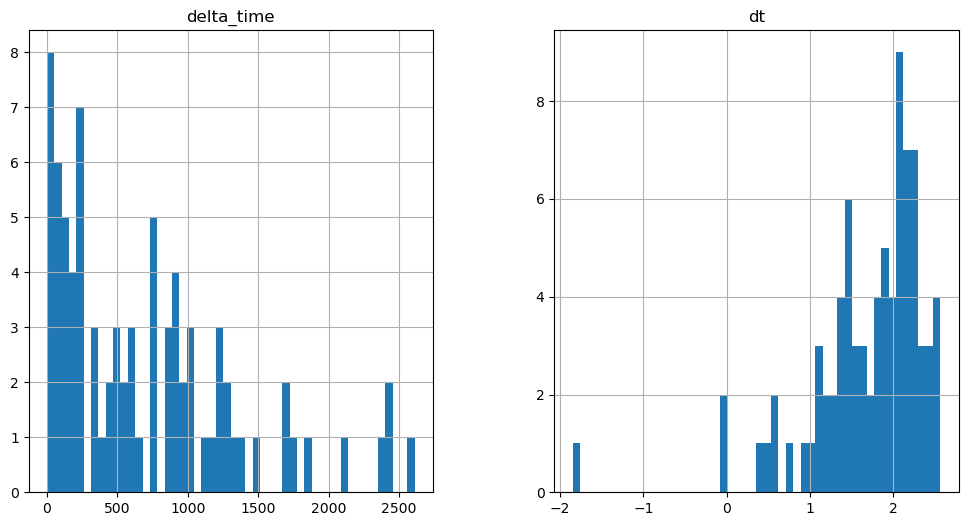

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1662.6324657052755 0.1


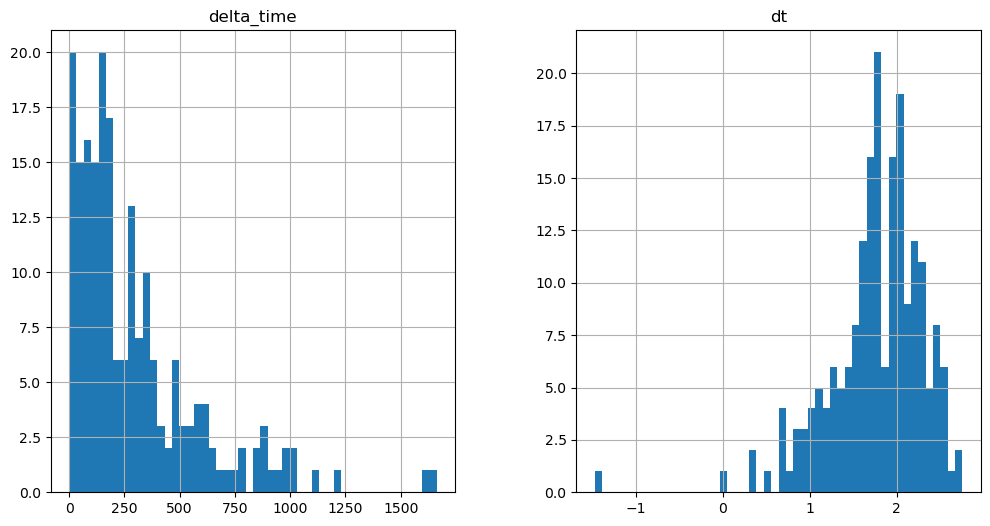

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5081.886760830879 29.169001132249832


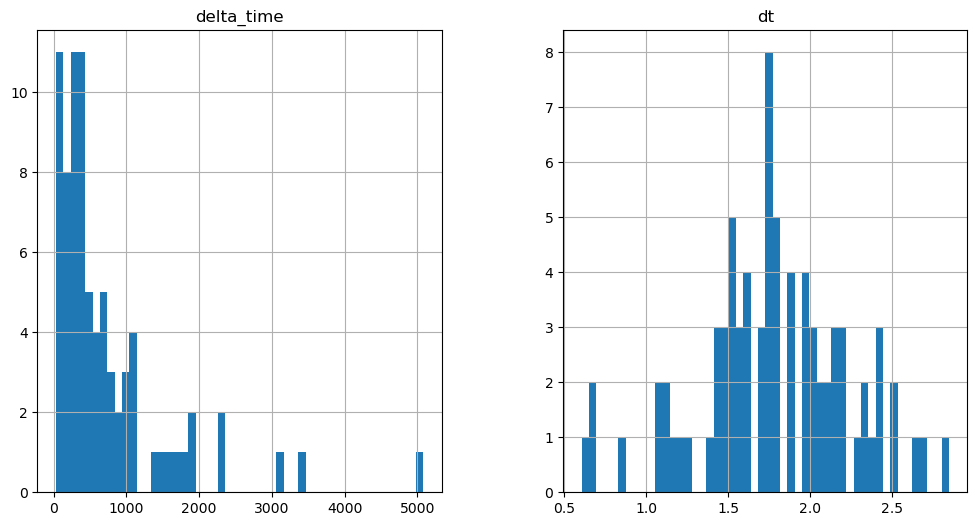

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1422.7986662238836 0.1


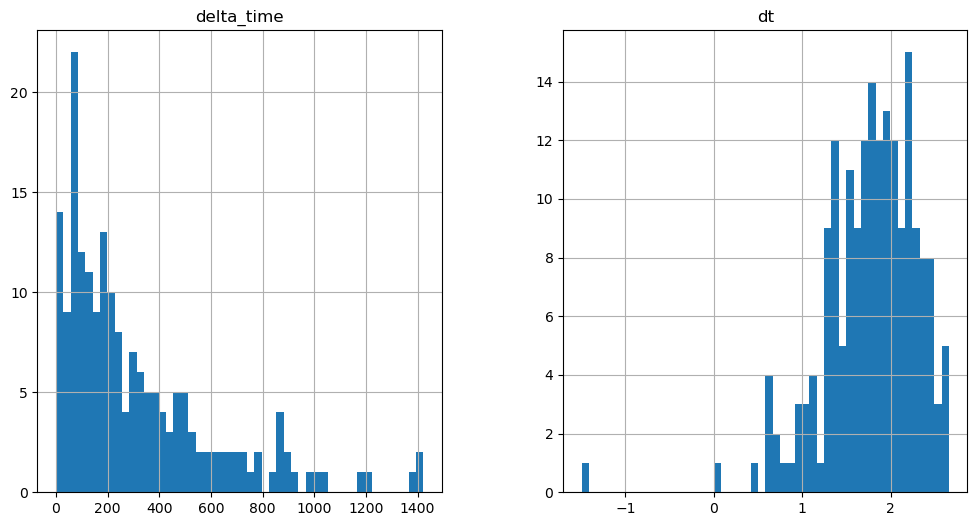

2489.0873283445835 3.2409901320934296


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

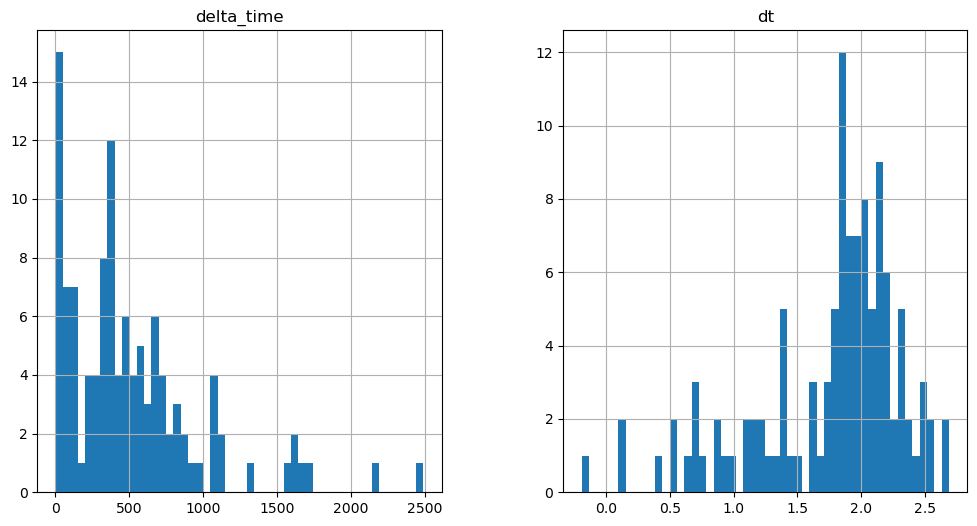

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1594.5715430229902 0.1


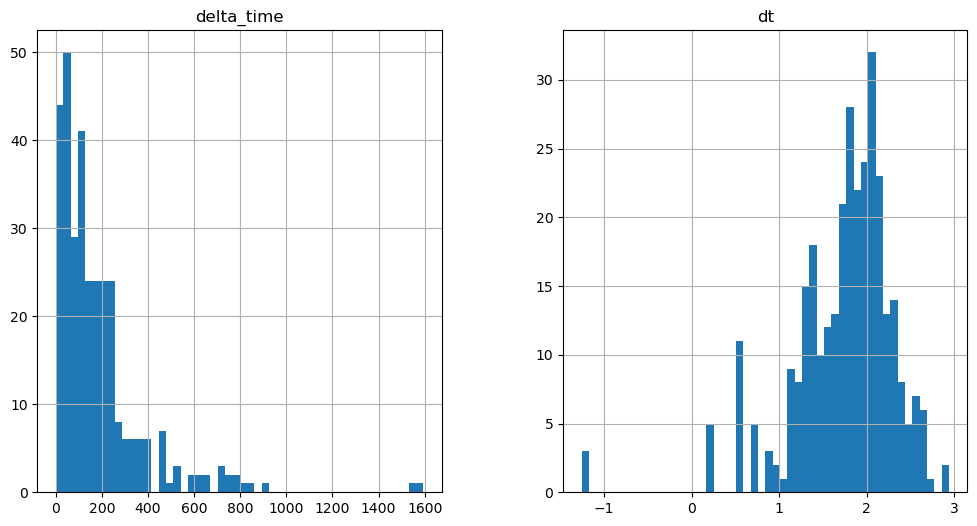

7062.137179106474 3.2410200983285904


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

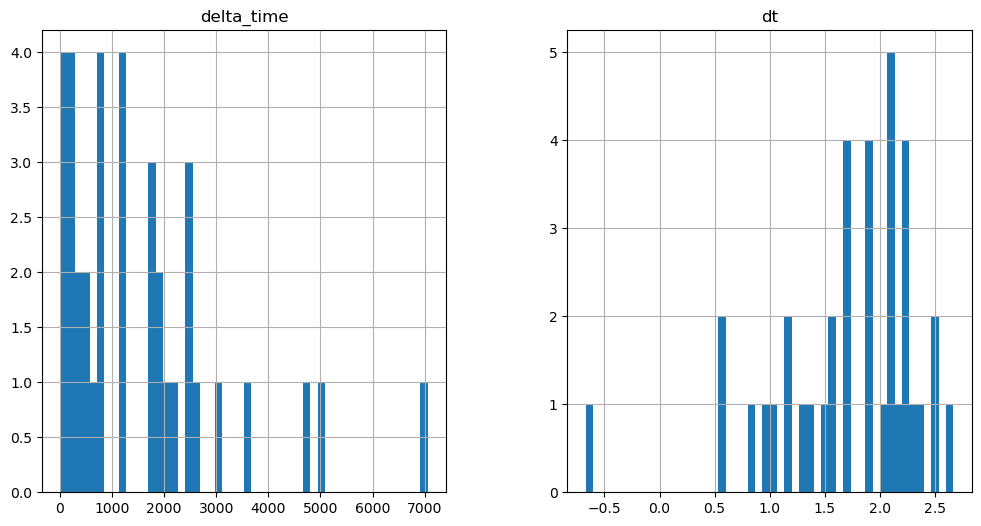

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3237.7582079172134 19.44598078727722


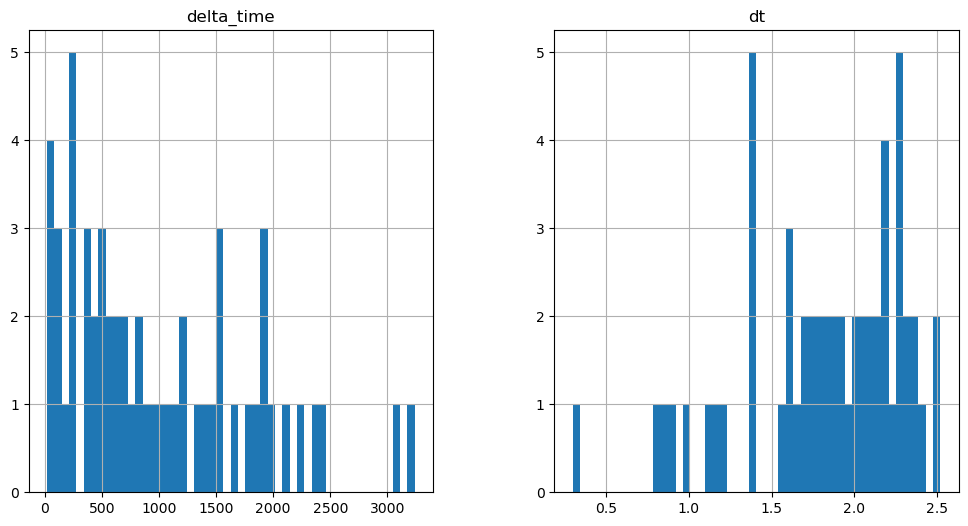

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2754.8492088764906 3.240990161895752


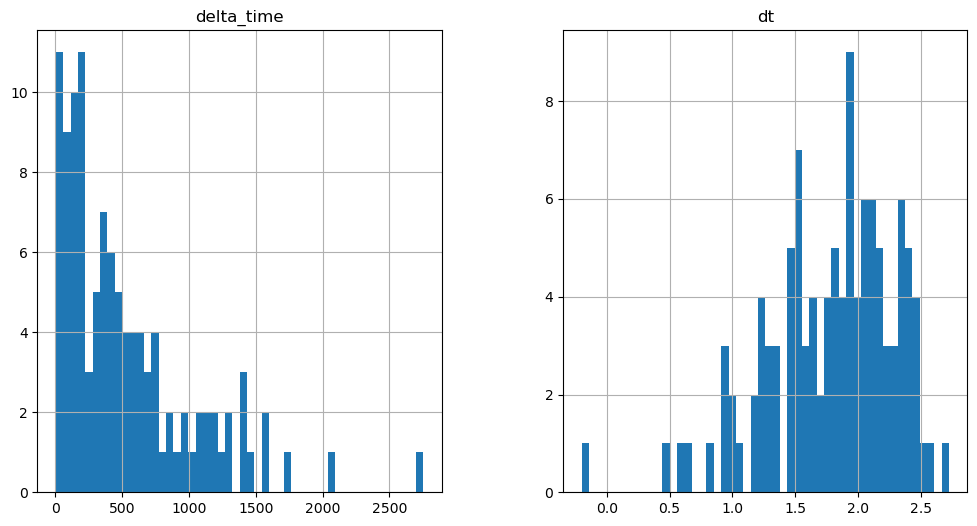

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4735.0998371094465 3.240990161895752


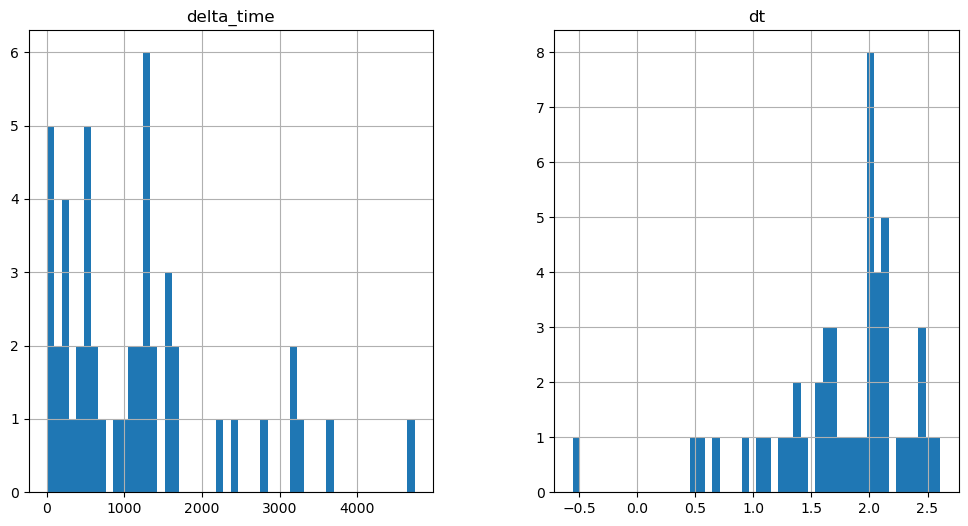

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2054.7934911847115 0.1


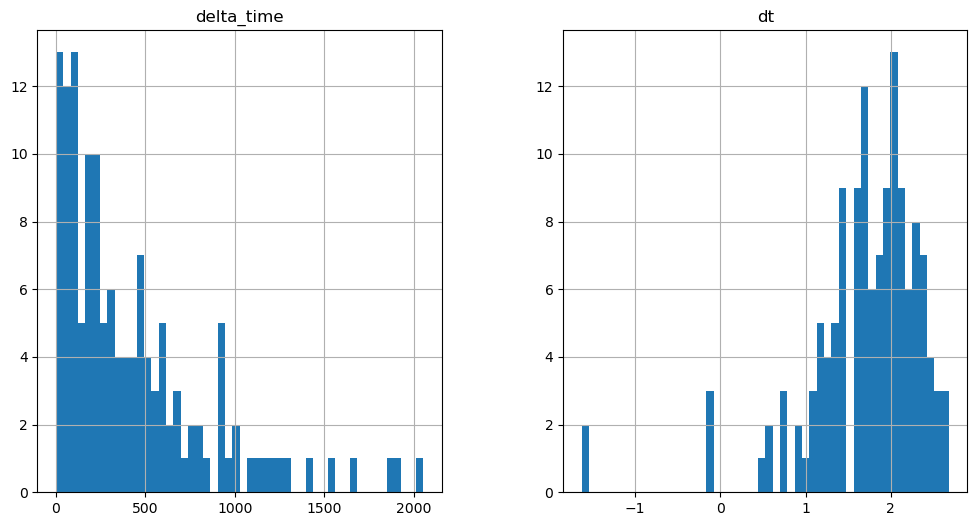

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3266.927149116993 12.963980570435524


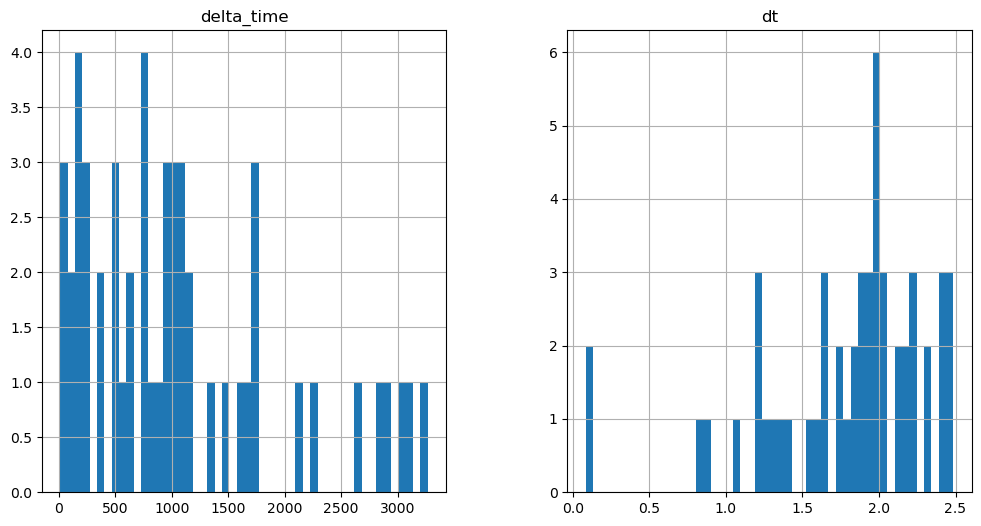

5195.321705251932 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

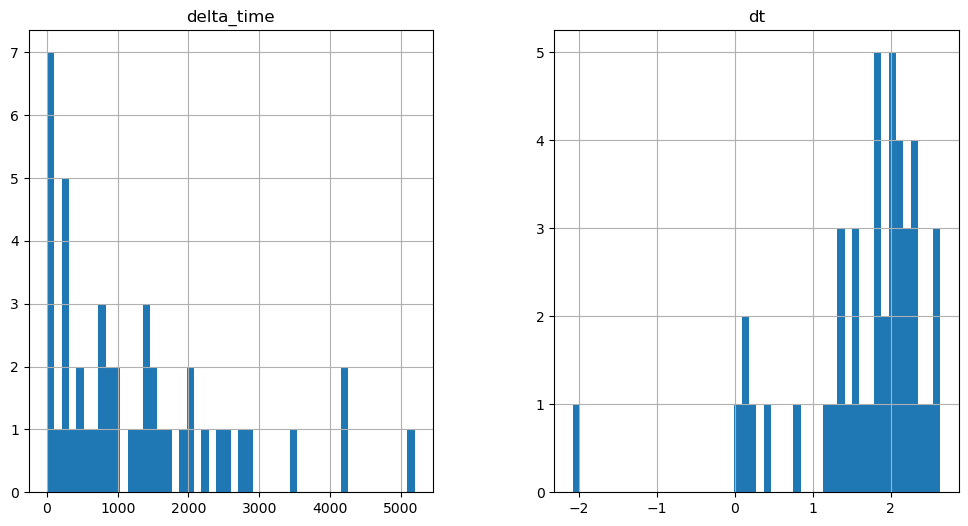

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

596.34384354949 0.1


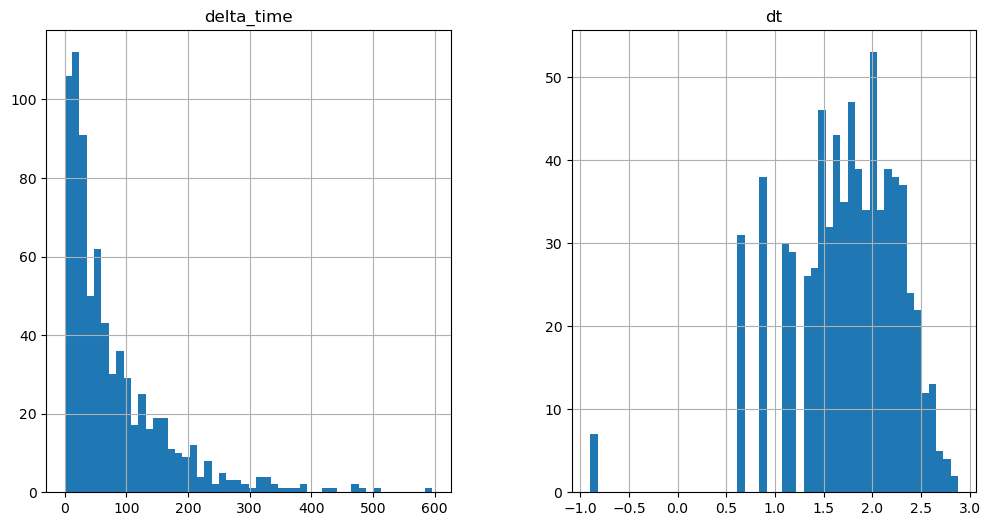

969.0586583316326 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

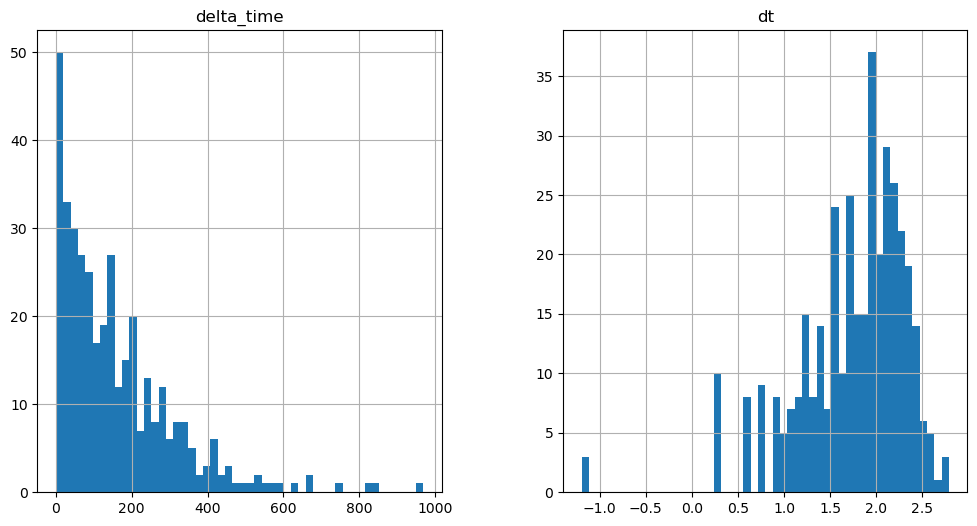

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2414.544395416975 0.1


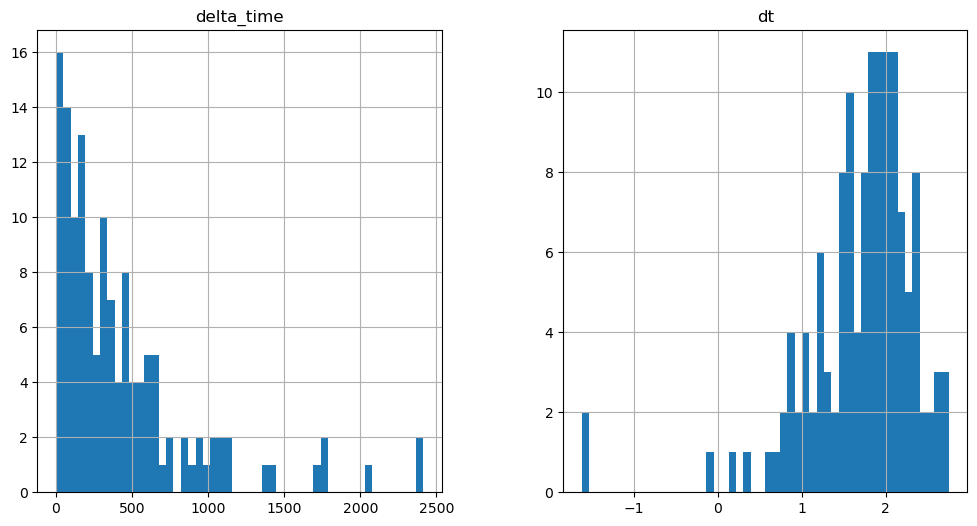

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1520.0288999974728 0.1


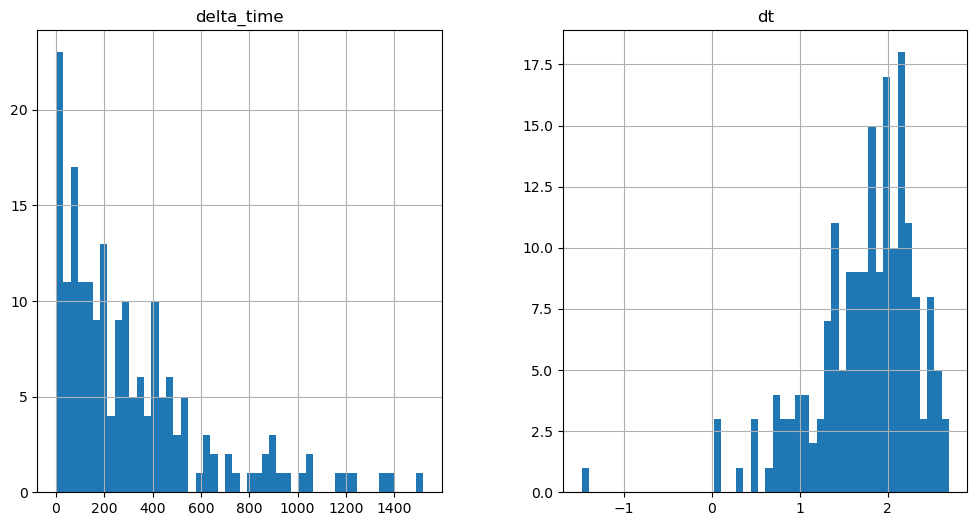

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5444.878525167704 3.2410100549459457


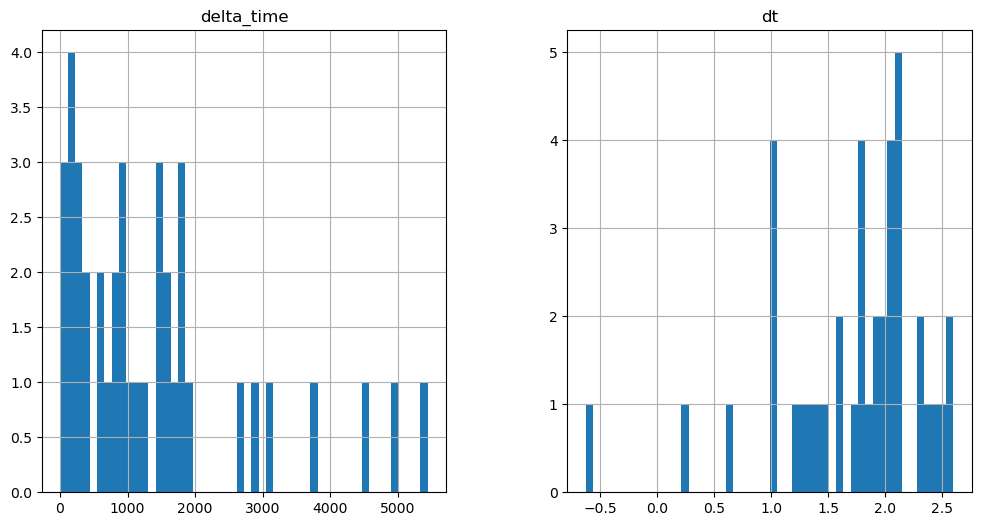

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1163.518735960126 0.1


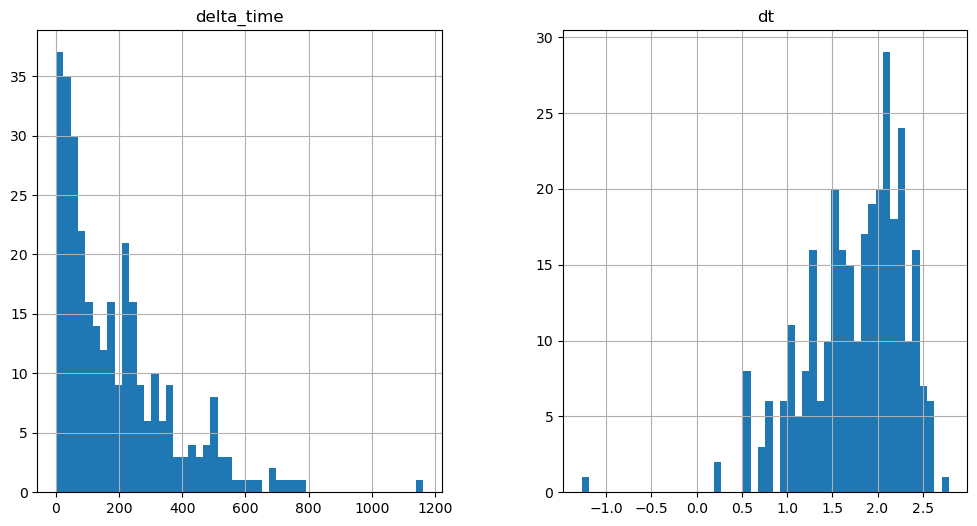

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

489.3909092992544 0.1


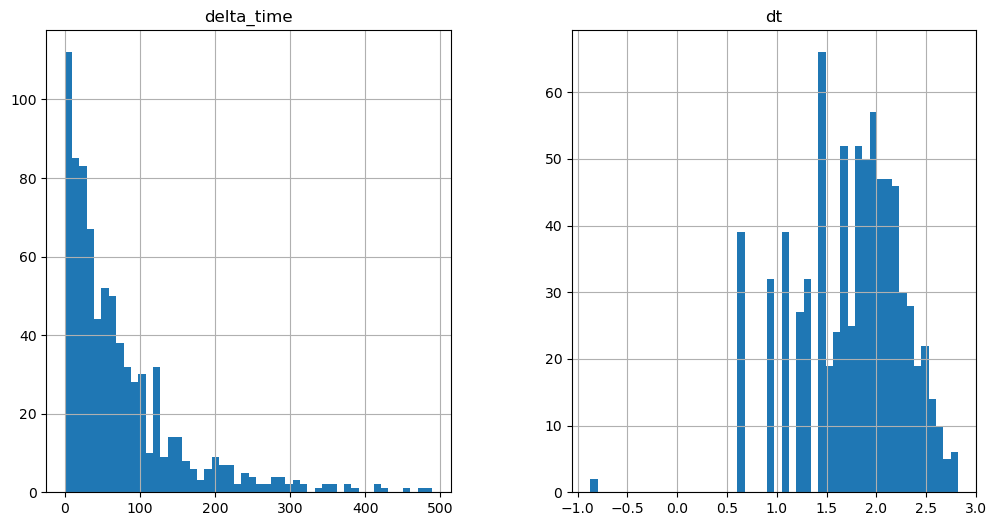

6381.527352124453 12.964000478386879


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

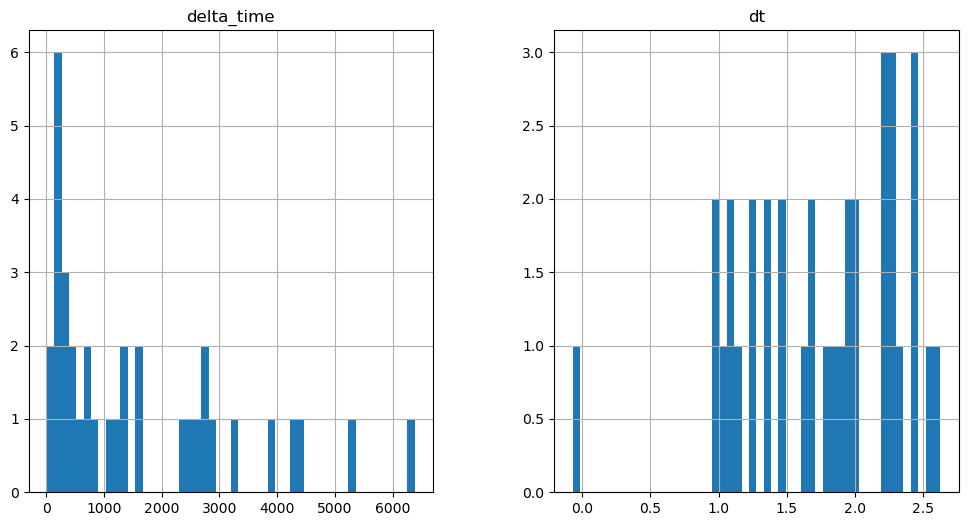

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3331.7472216635942 3.2409901469945908


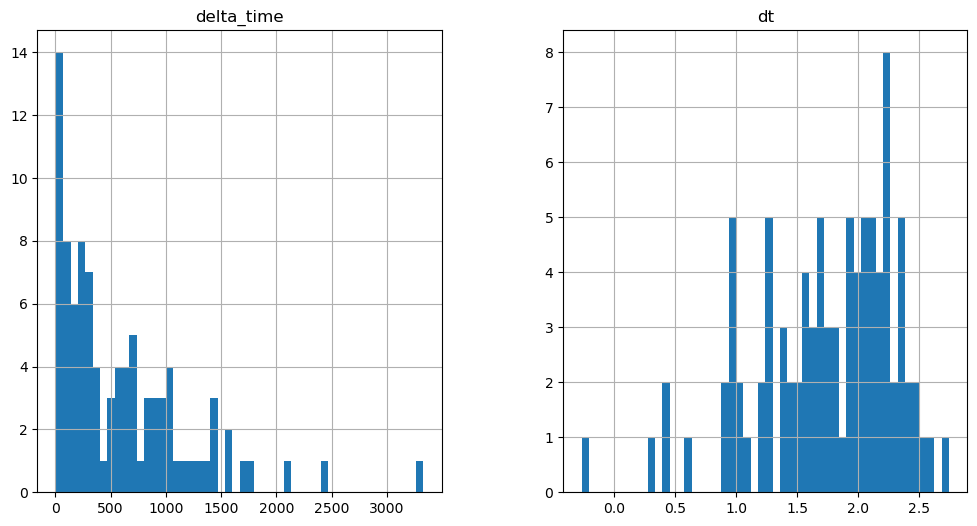

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5914.823583707213 6.482000231742859


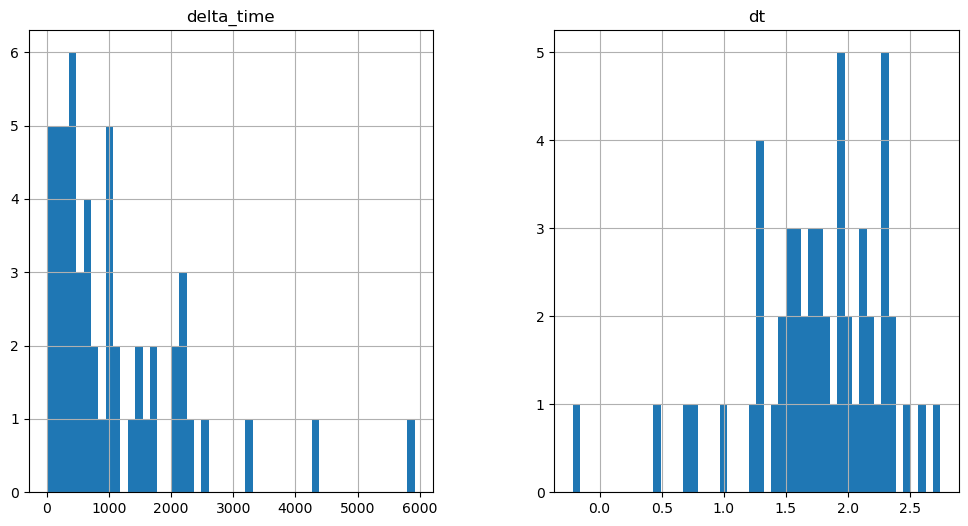

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

855.6238037496805 0.1


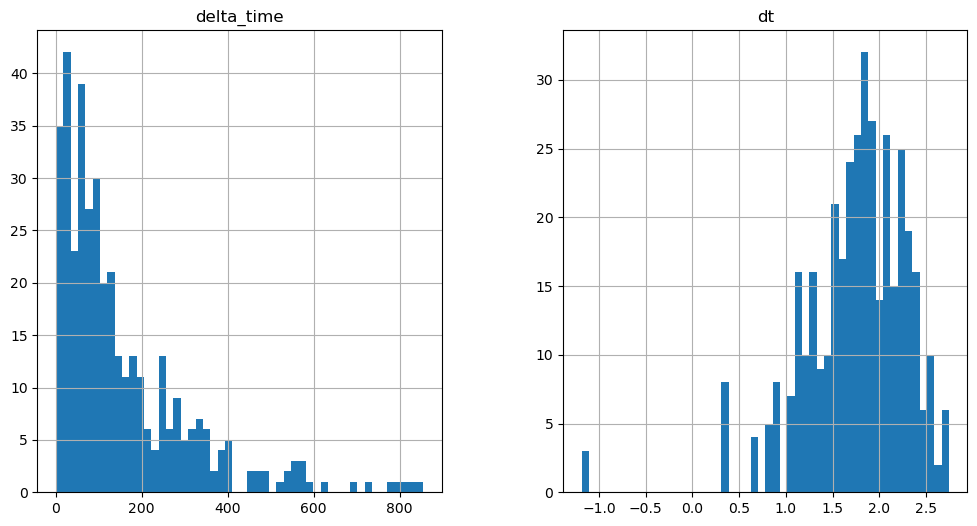

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5616.651672005653 194.4599277228117


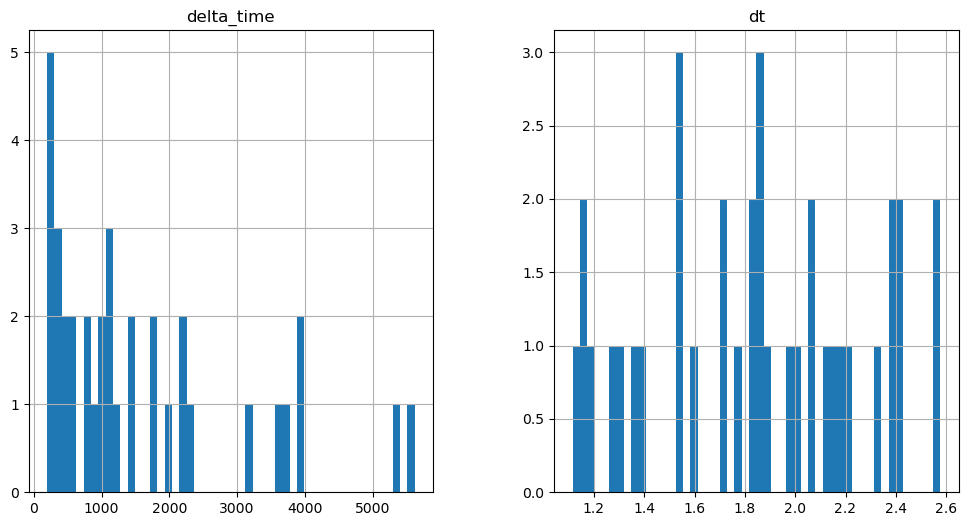

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3798.4510101228952 3.2410100549459457


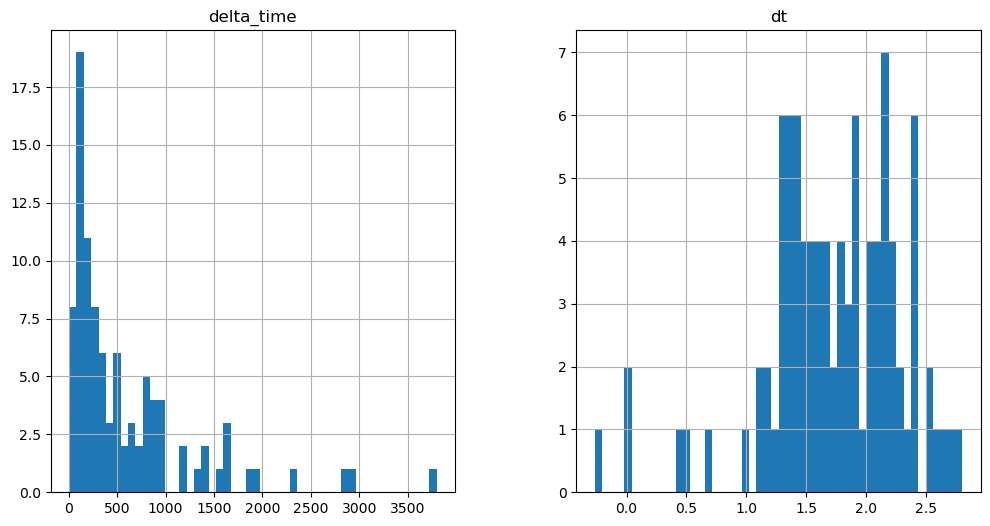

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

6861.195361033082 12.963980555534363


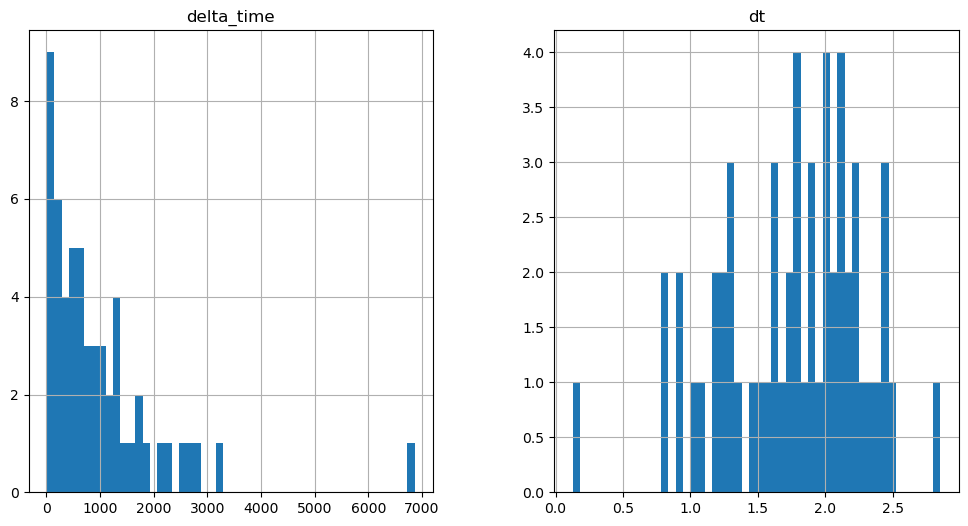

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

10342.028268650174 3.241010069847107


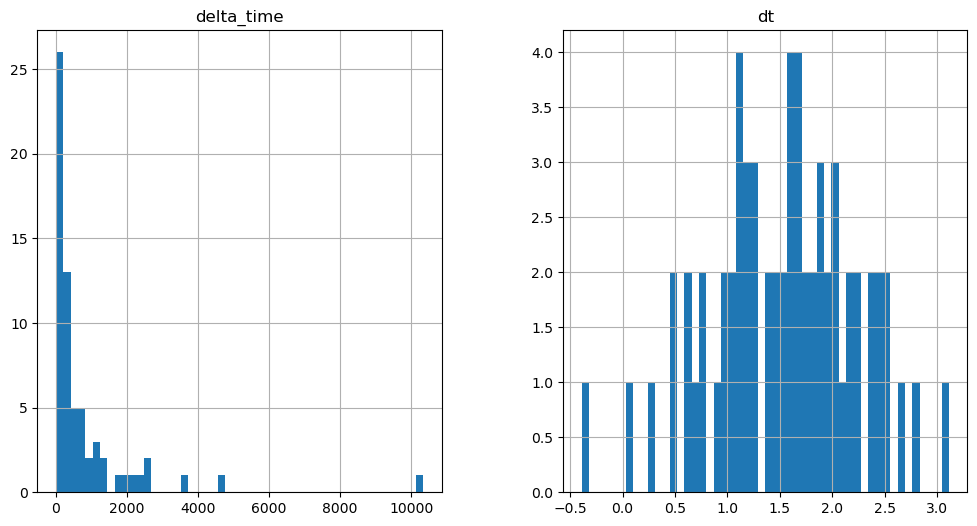

1247.7847493290901 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

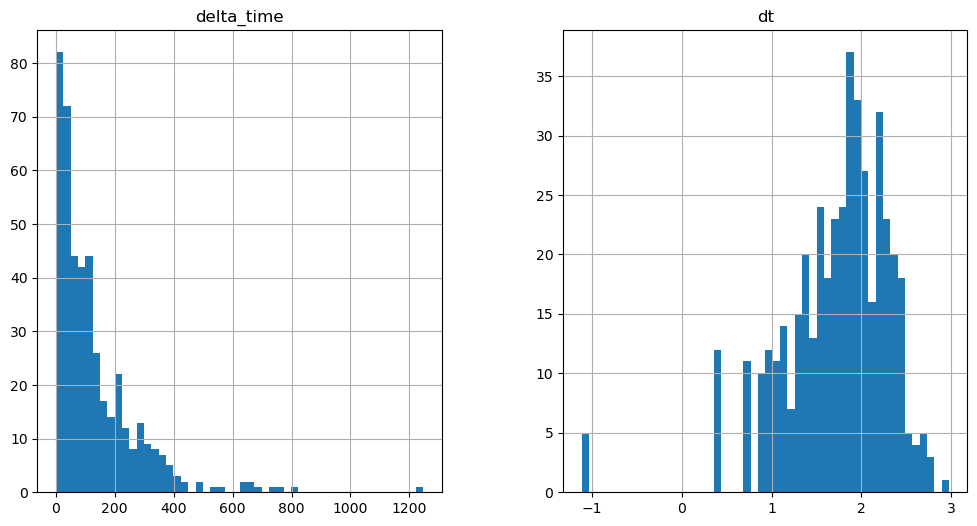

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2190.9154665768147 3.2409901469945908


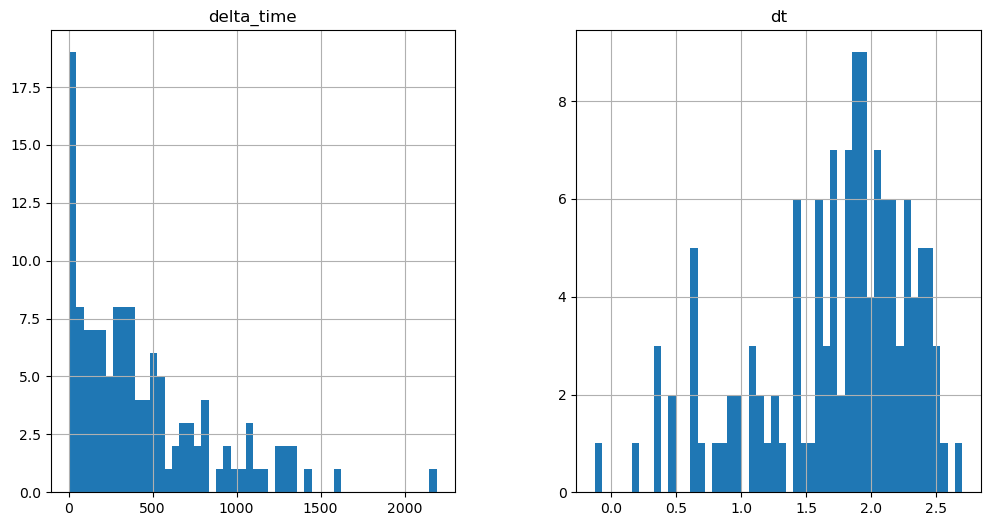

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4184.130045309663 0.1


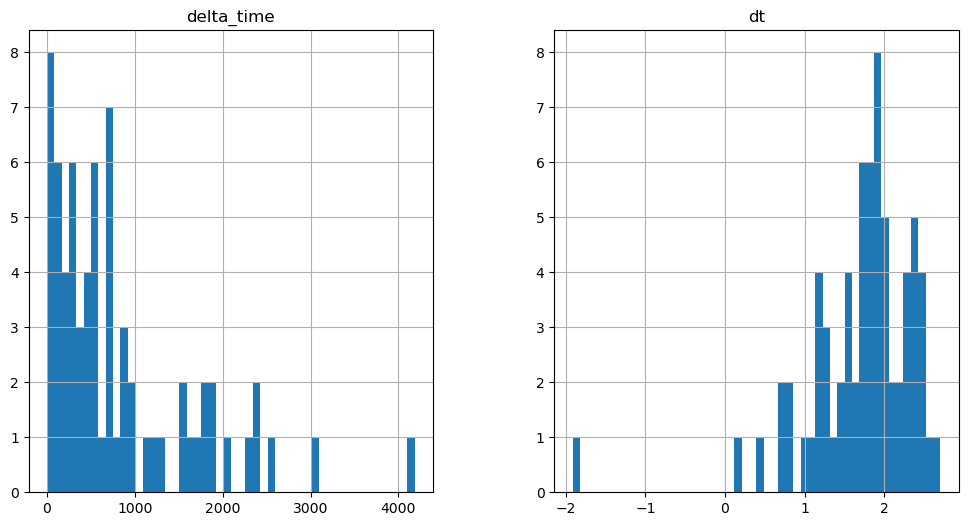

93.98900362849236 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

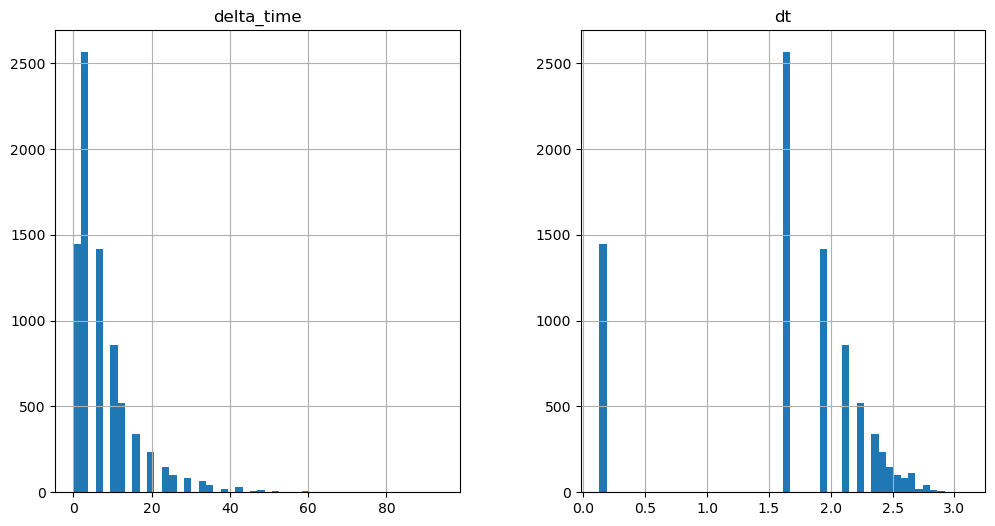

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1698.2835570573807 0.1


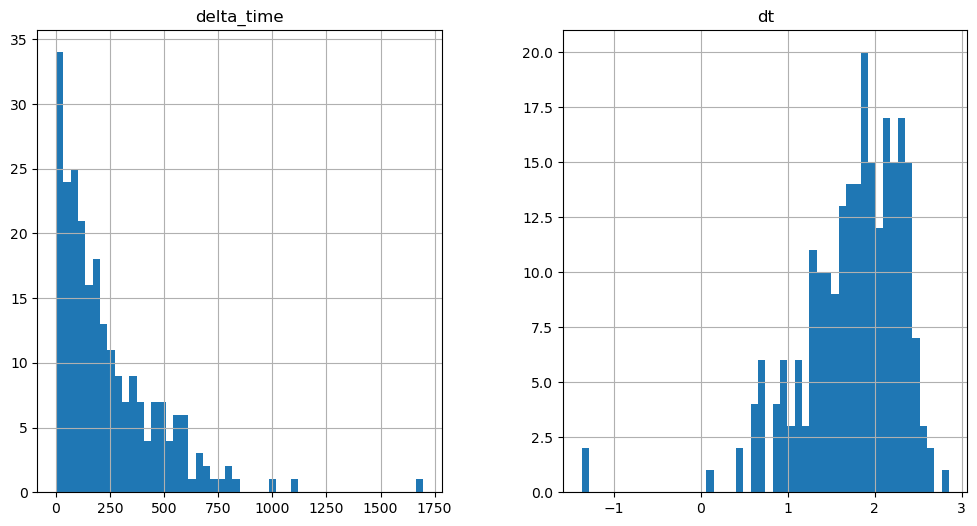

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3198.8662664294243 3.240980163216591


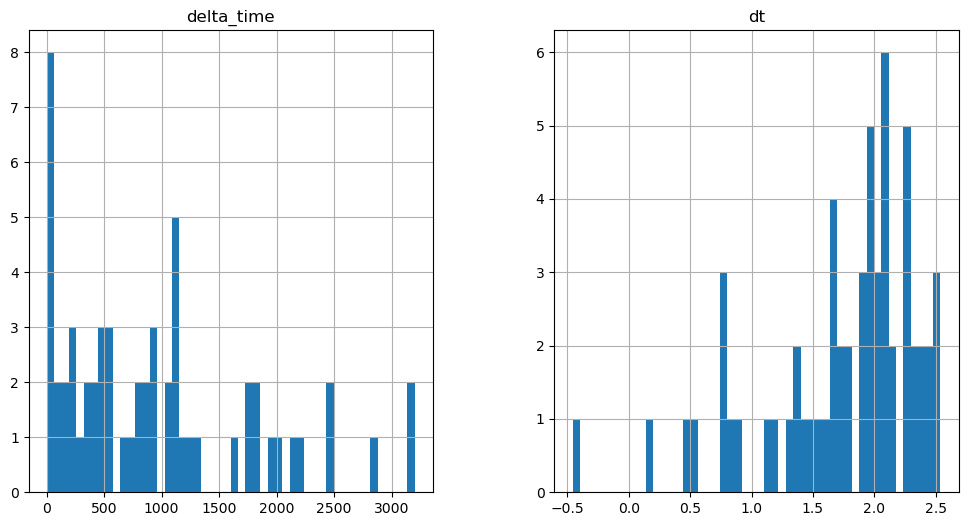

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

683.850866958499 0.1


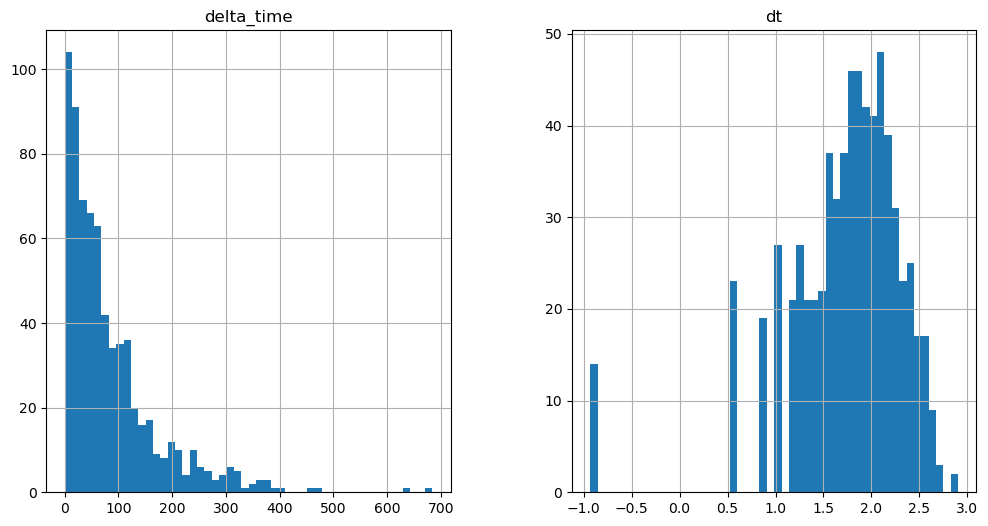

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5743.050506904721 9.722990408539772


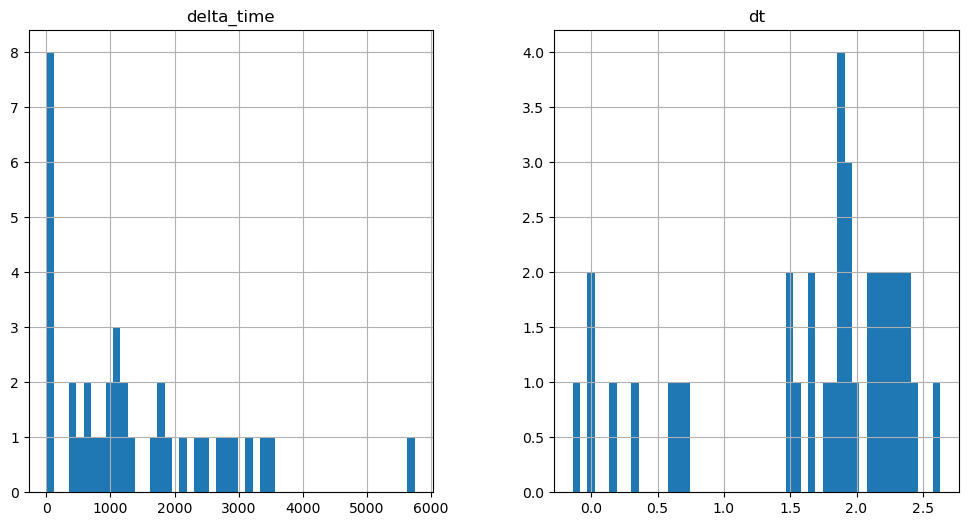

1905.7075552344322 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

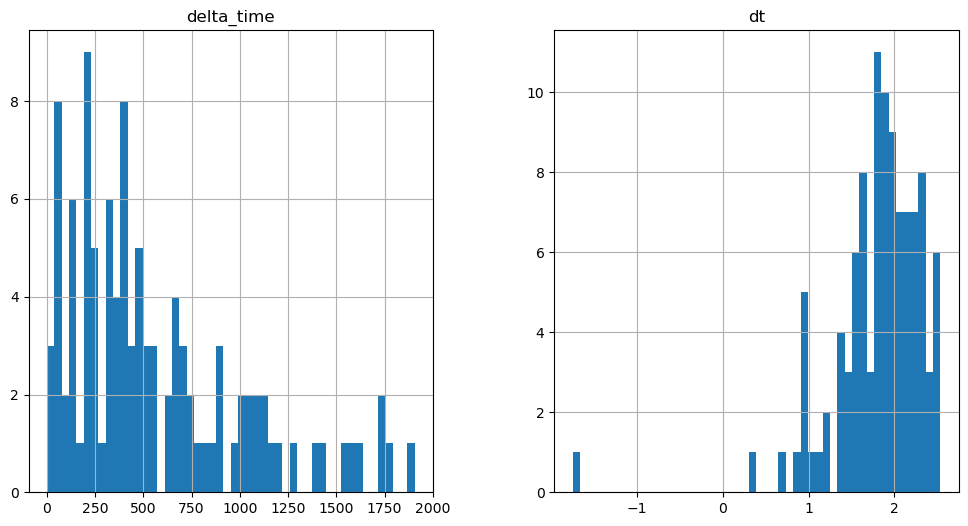

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2800.22341068089 0.1


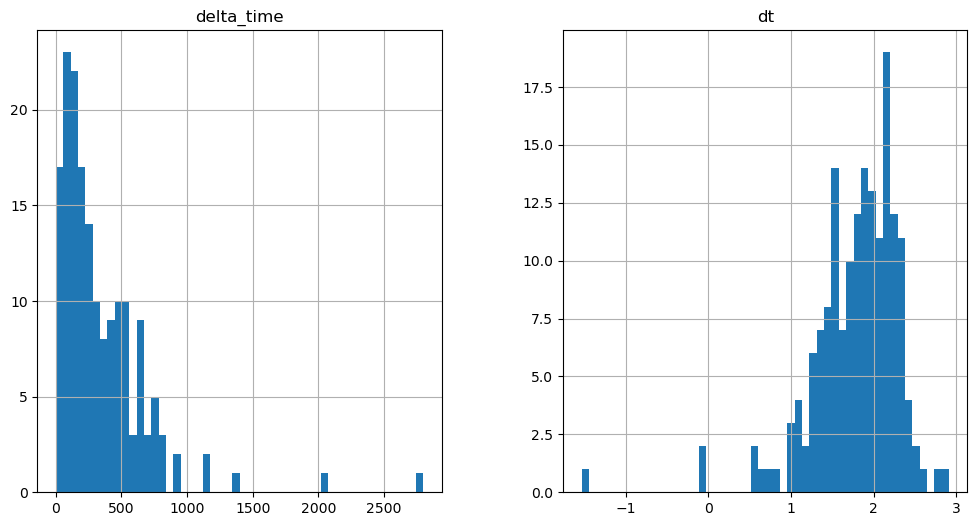

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5668.507504031062 6.48200024664402


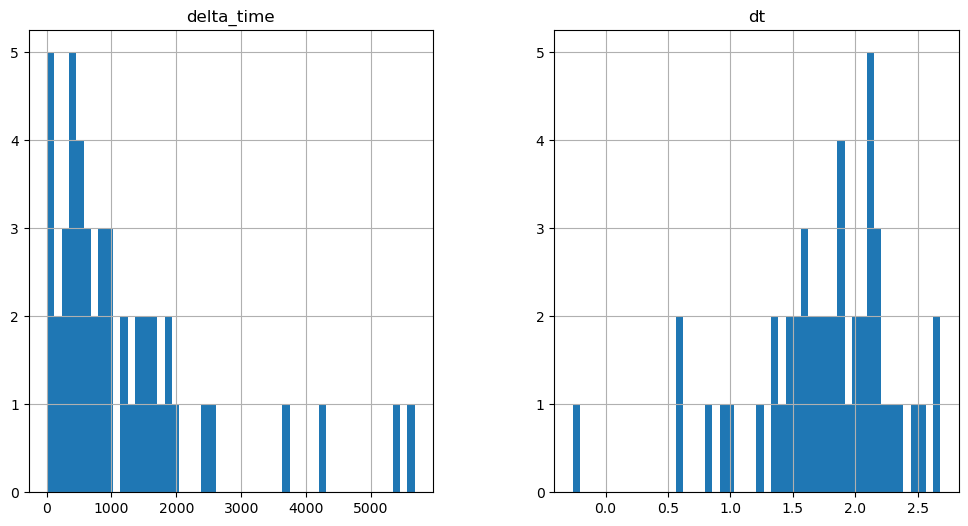

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2946.068306401372 0.1


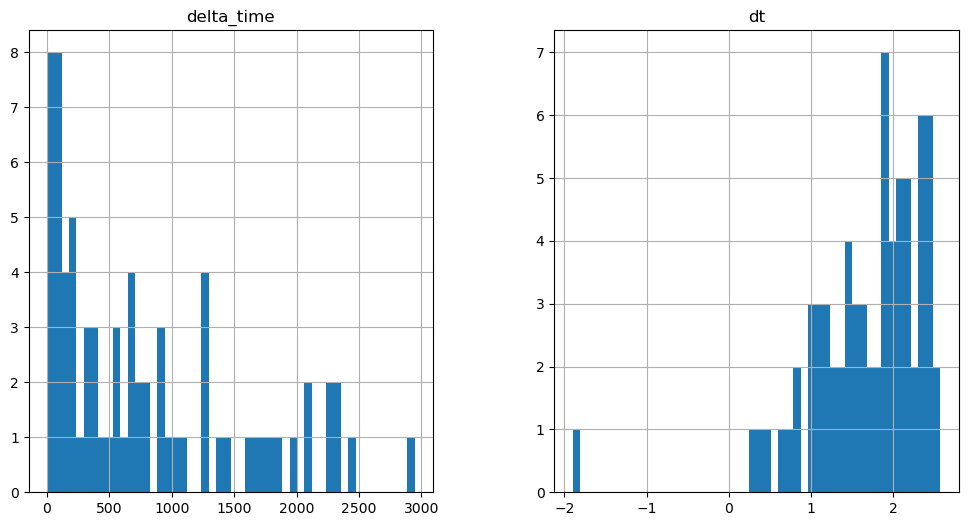

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2887.7303041517735 0.1


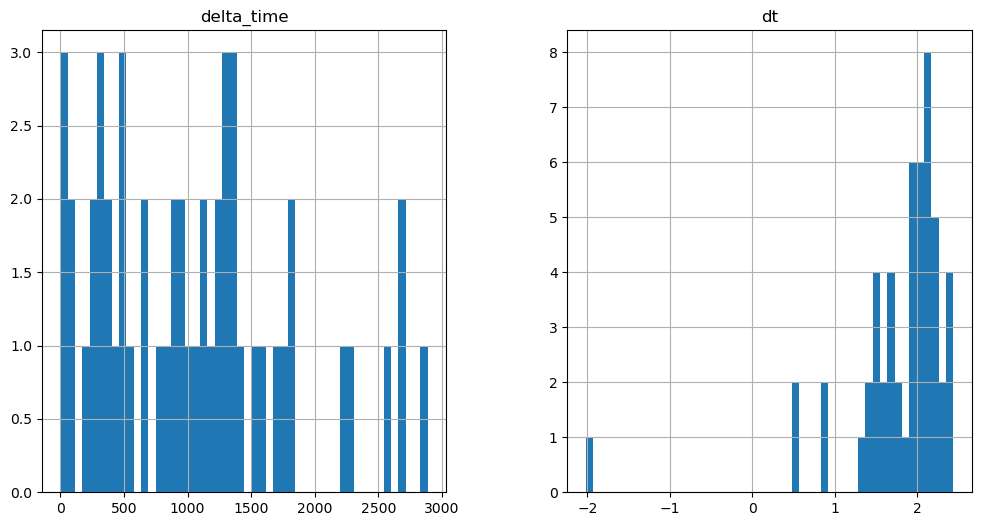

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3467.8691769987345 3.2409801334142685


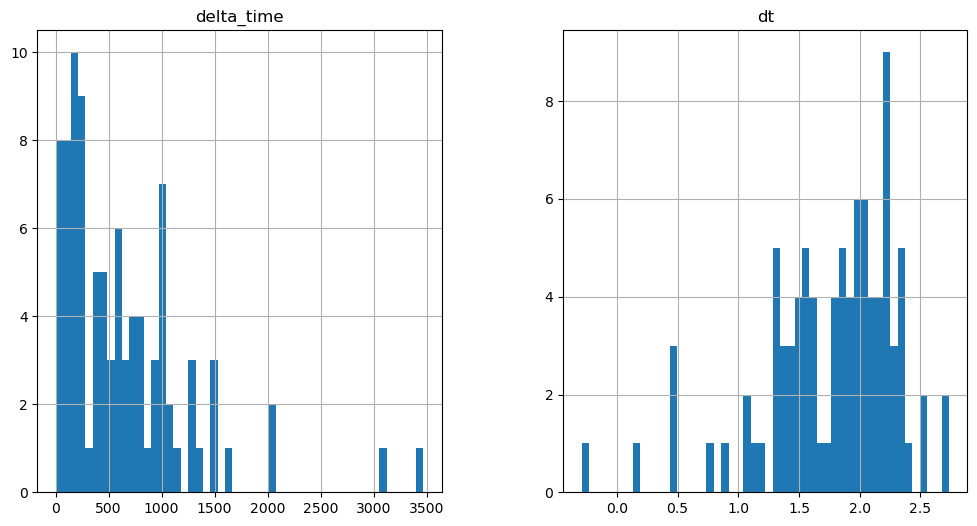

1780.9576179385185 18.846060931682587


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

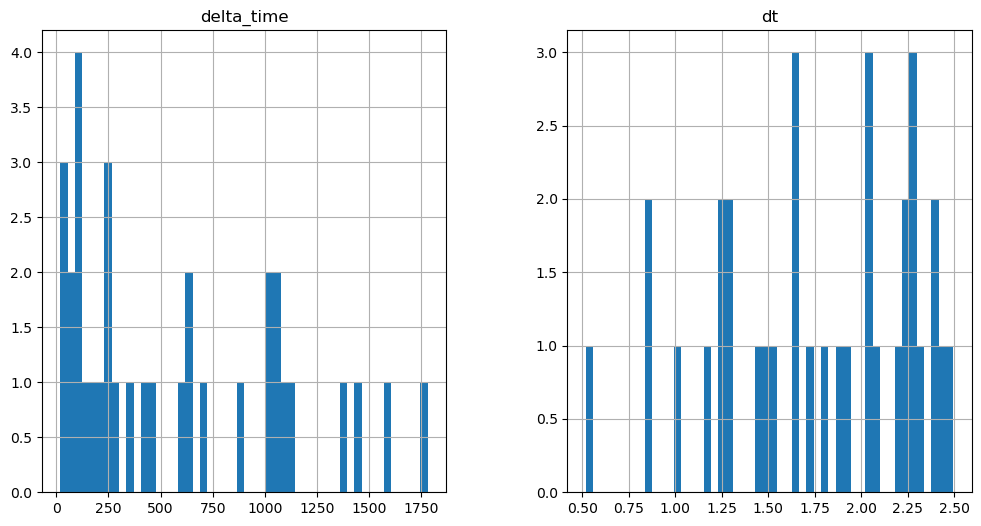

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

866.9214925765991 0.1


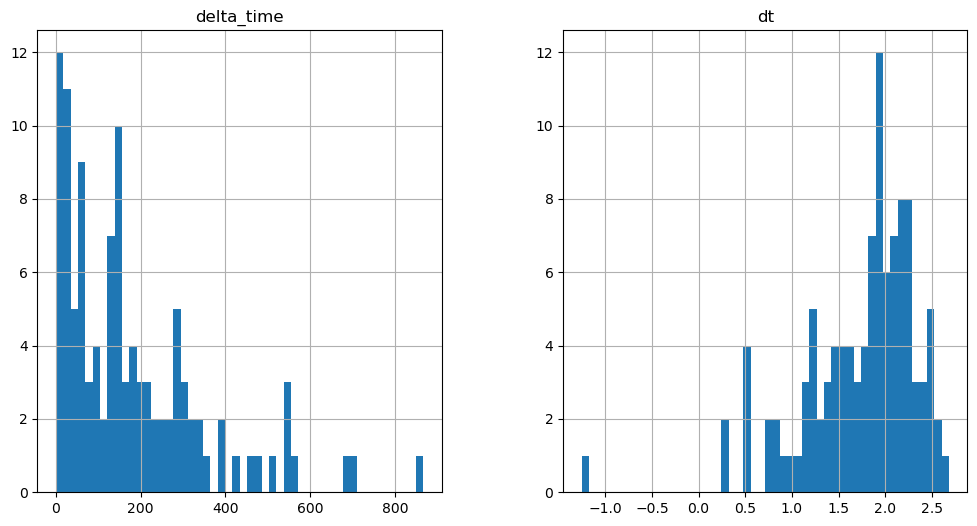

1297.2379440069199 9.423010468482971


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

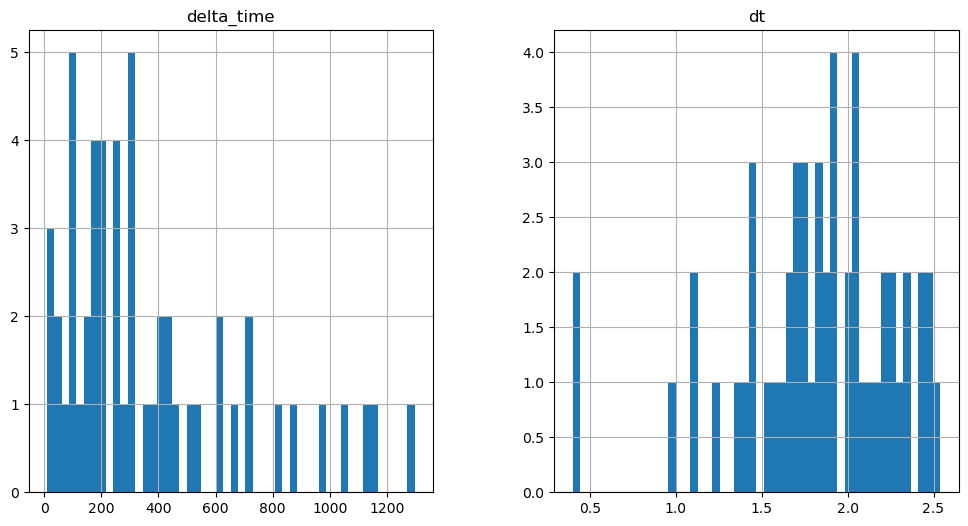

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1454.285741686821 0.1


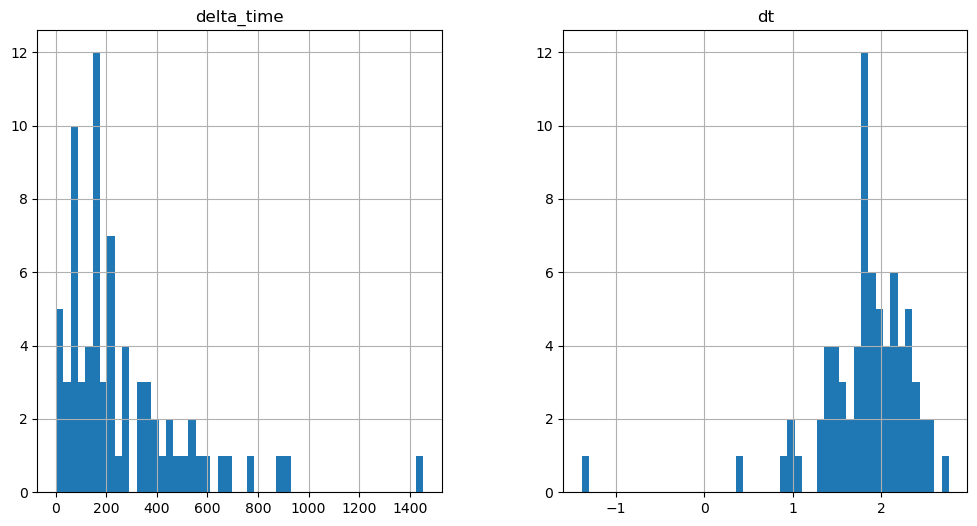

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1746.4105362296104 3.1410300731658936


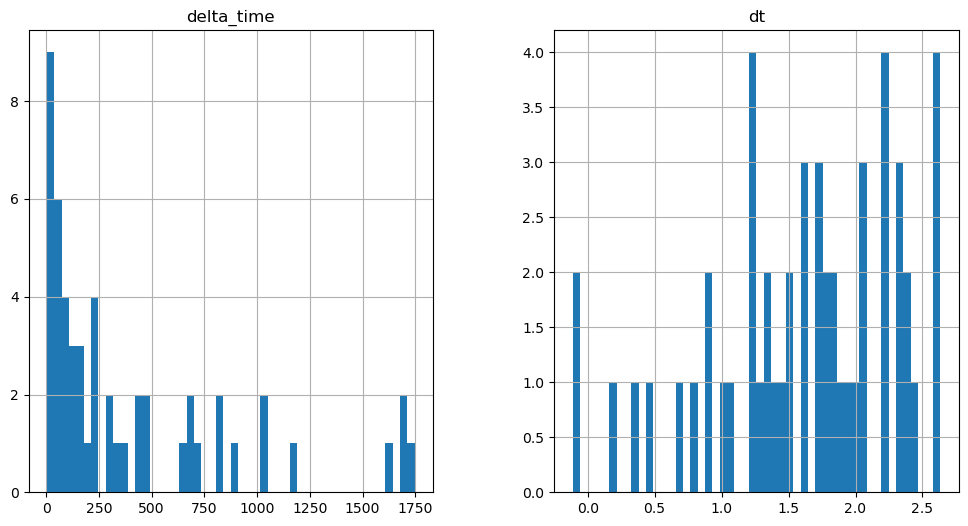

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1353.7819668650627 6.282050371170044


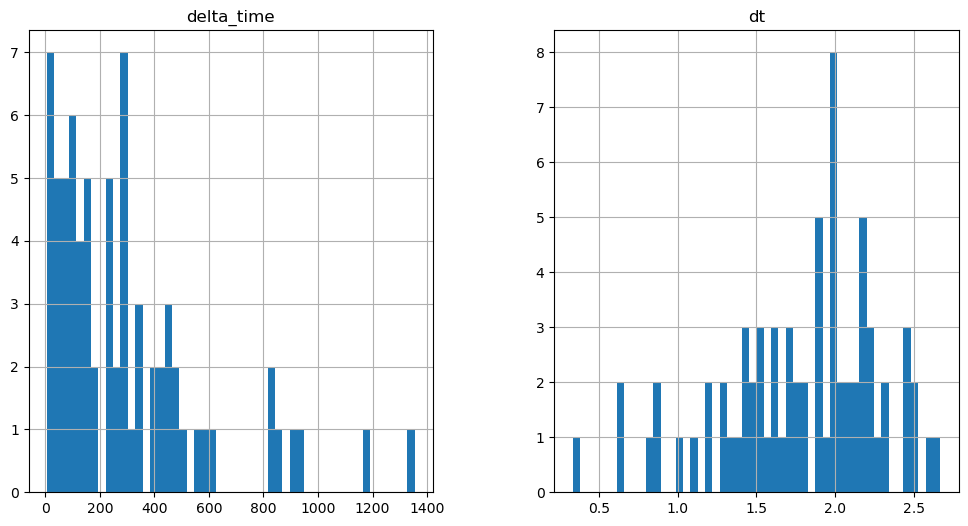

2471.987202167511 9.423070549964905


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

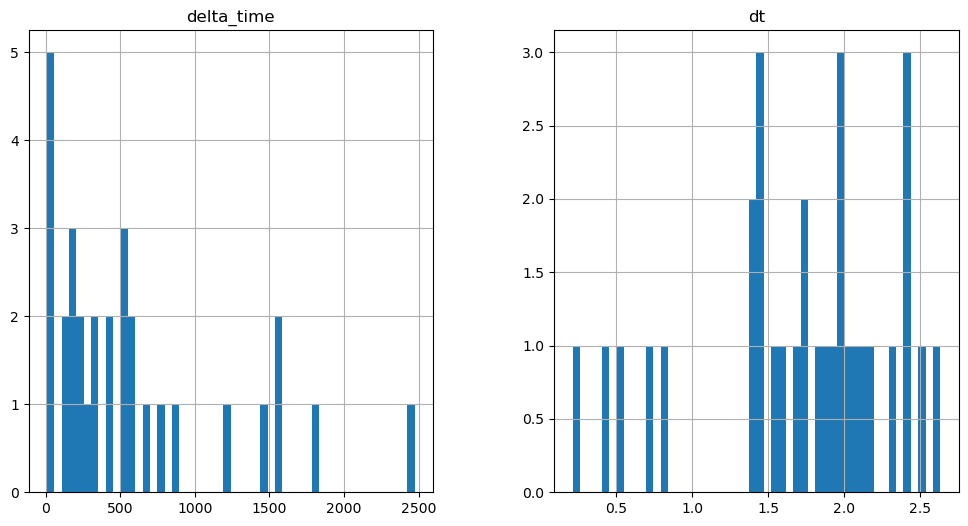

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1561.0897471904755 6.282060205936432


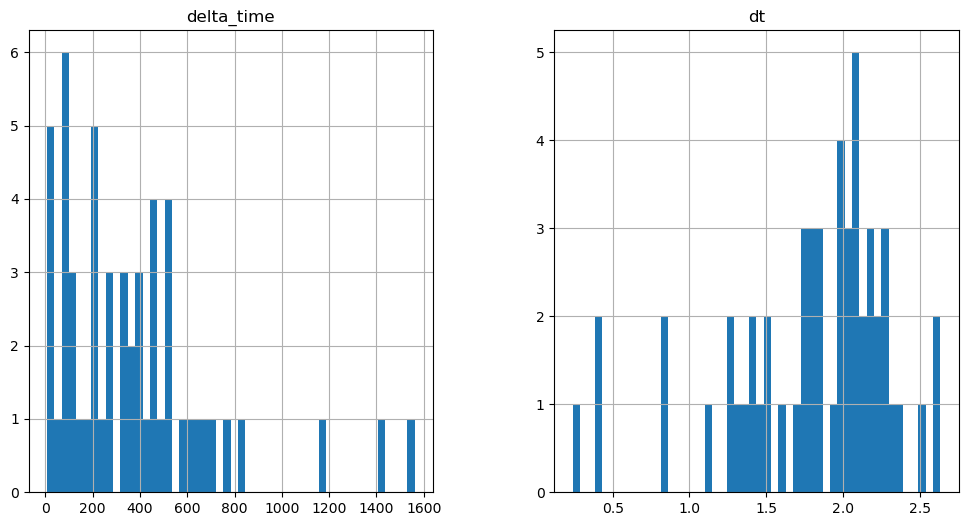

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

995.704839348793 0.1


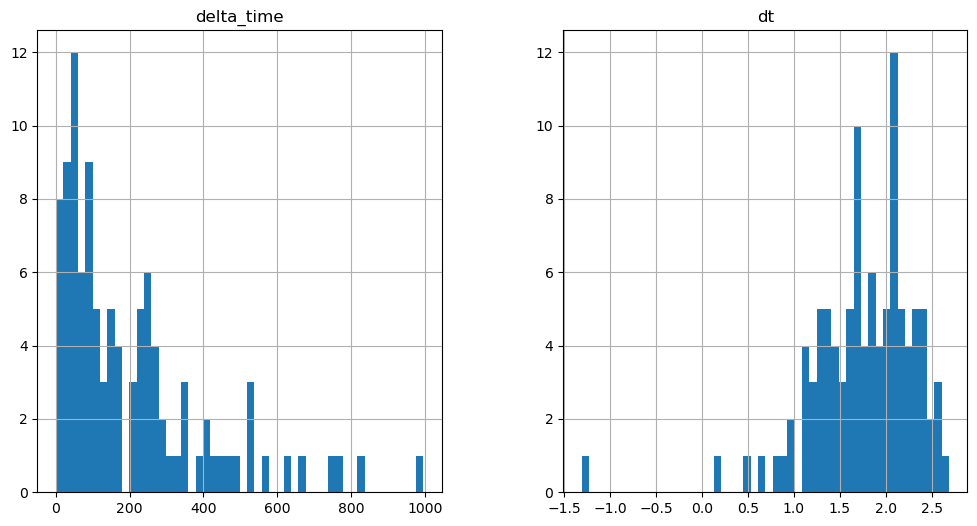

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1212.430209994316 6.282040357589722


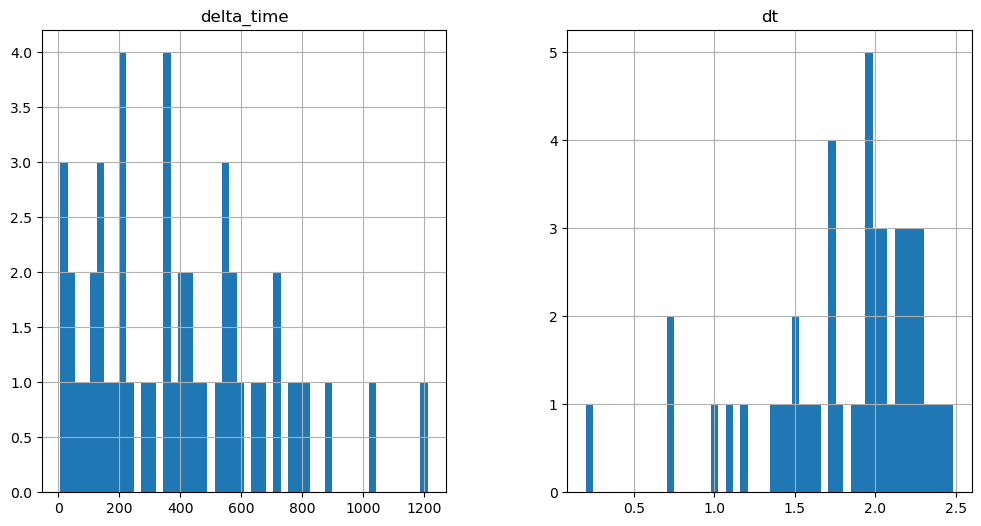

1184.1628985404968 3.1410300731658936


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

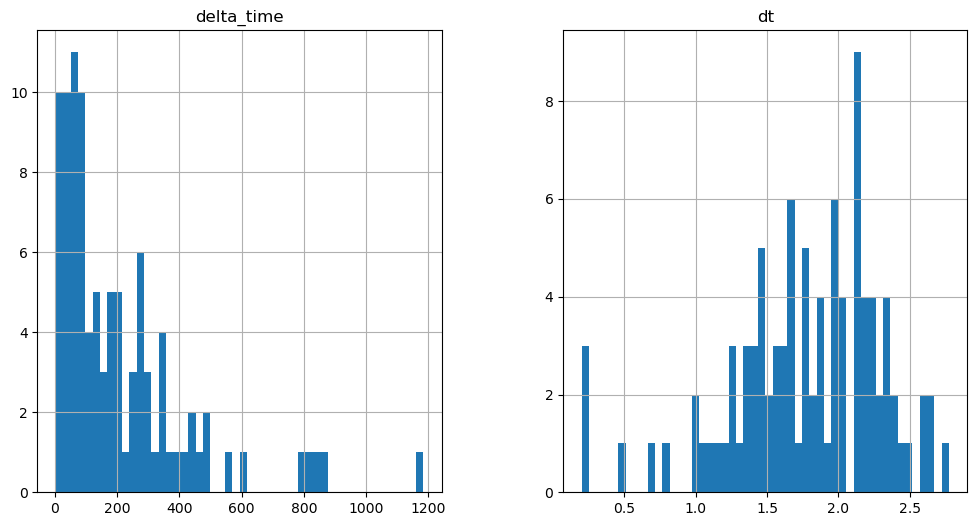

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2823.7767096161842 0.1


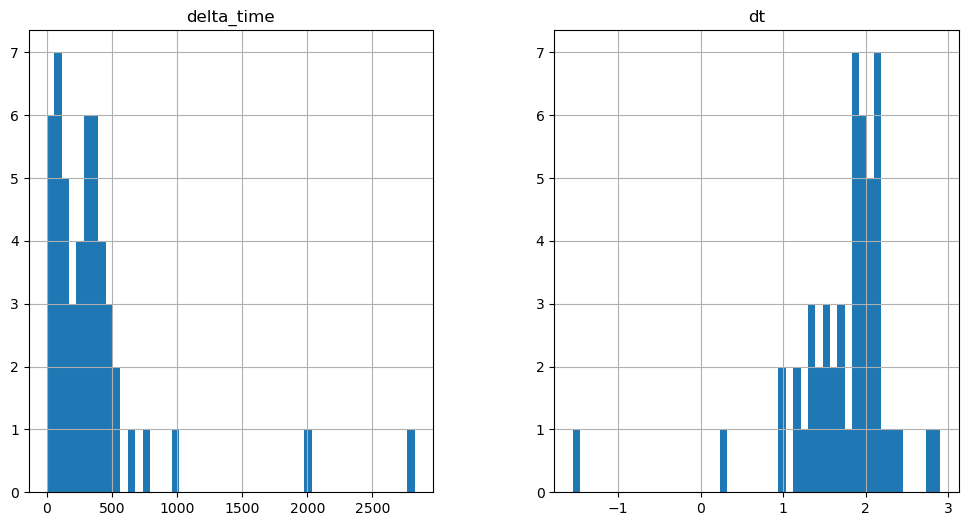

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1727.5518867373466 15.705021023750305


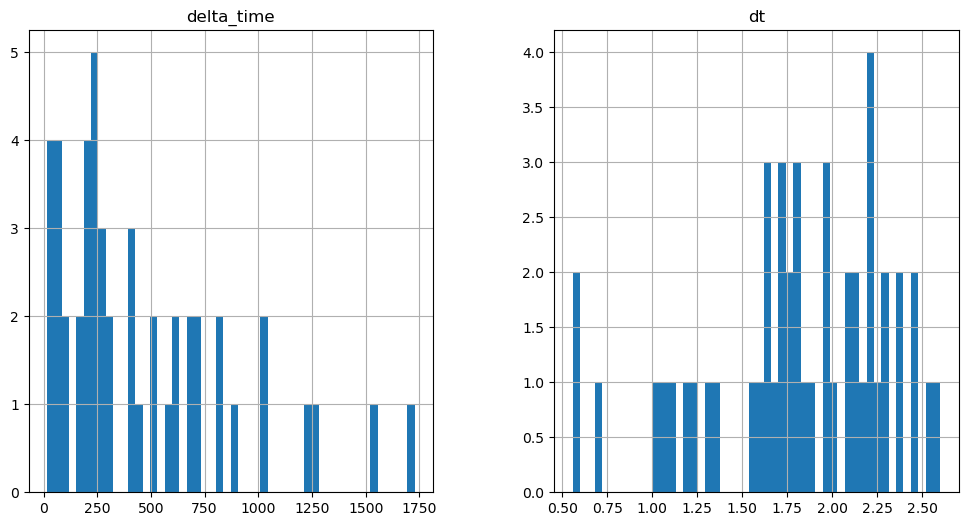

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1608.1938208341599 6.281980395317078


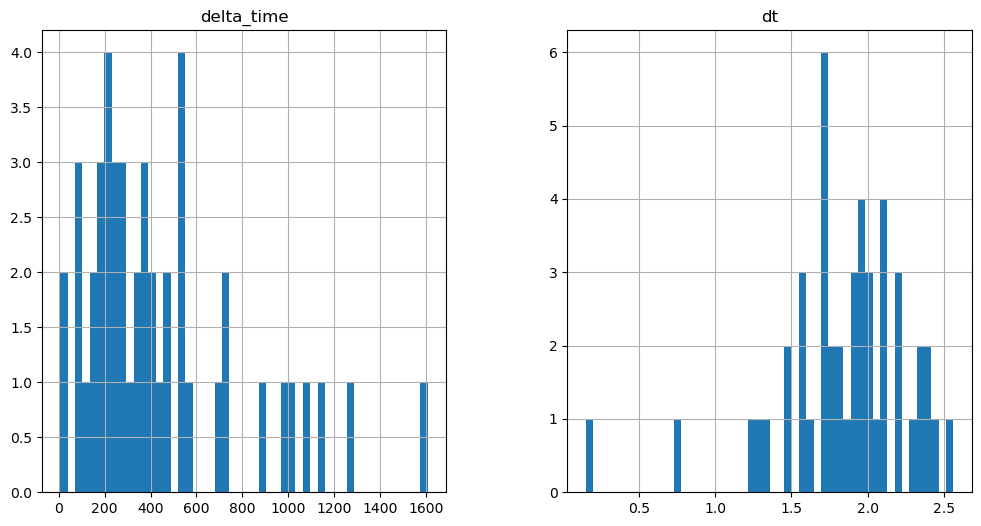

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

822.9428912401199 0.1


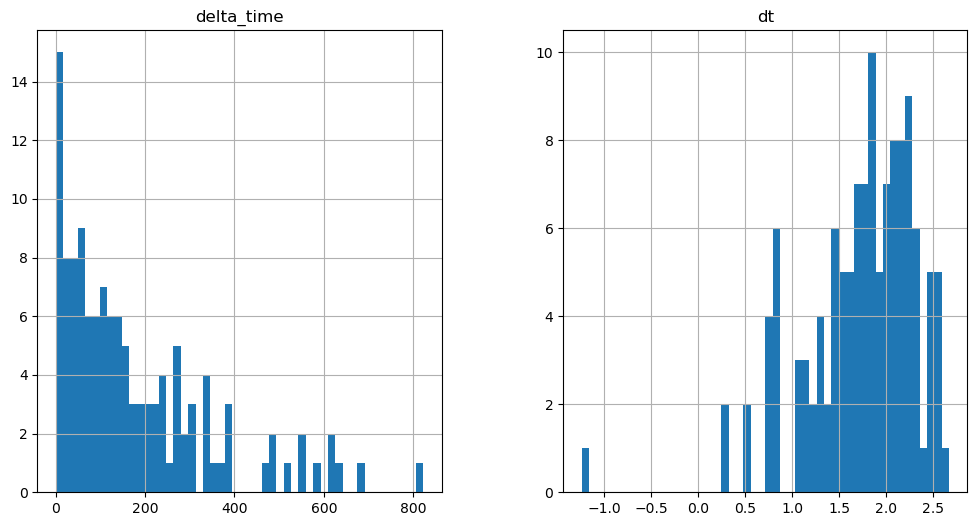

1743.2570175528526 40.83305209875107


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

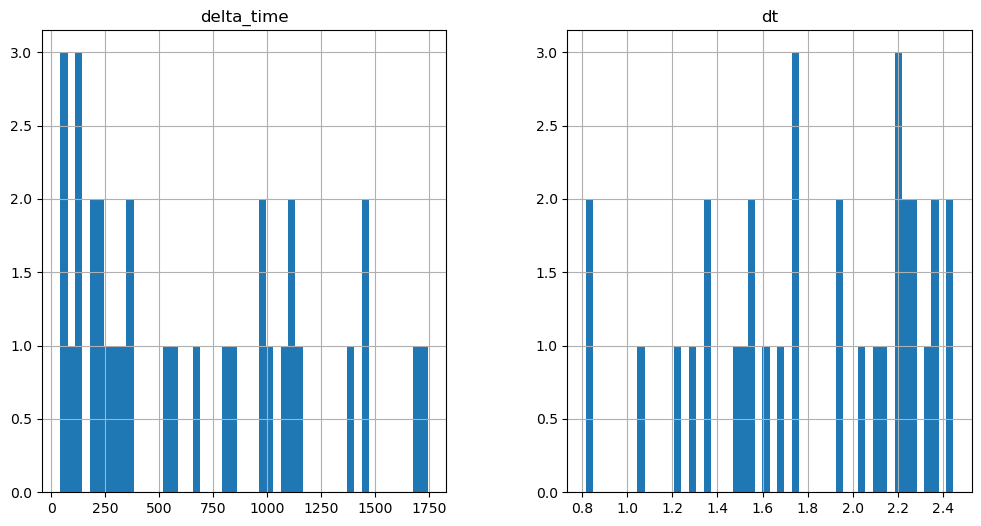

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2016.5271112918854 47.11516237258911


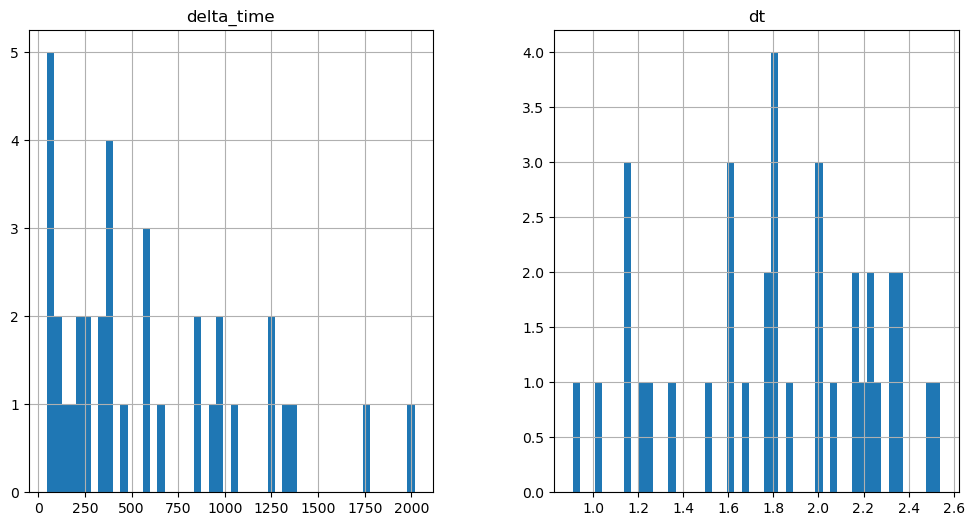

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1306.656815290451 0.1


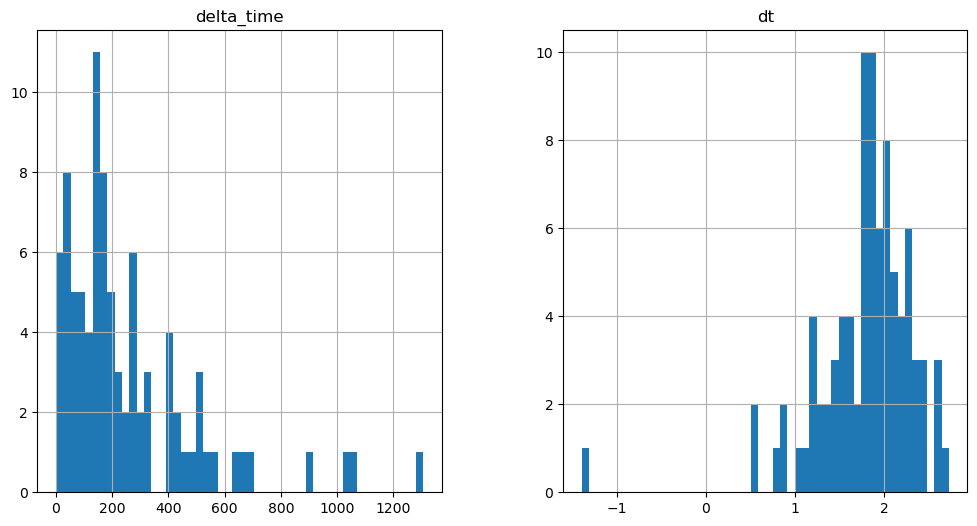

1765.242978155613 12.564010620117188


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

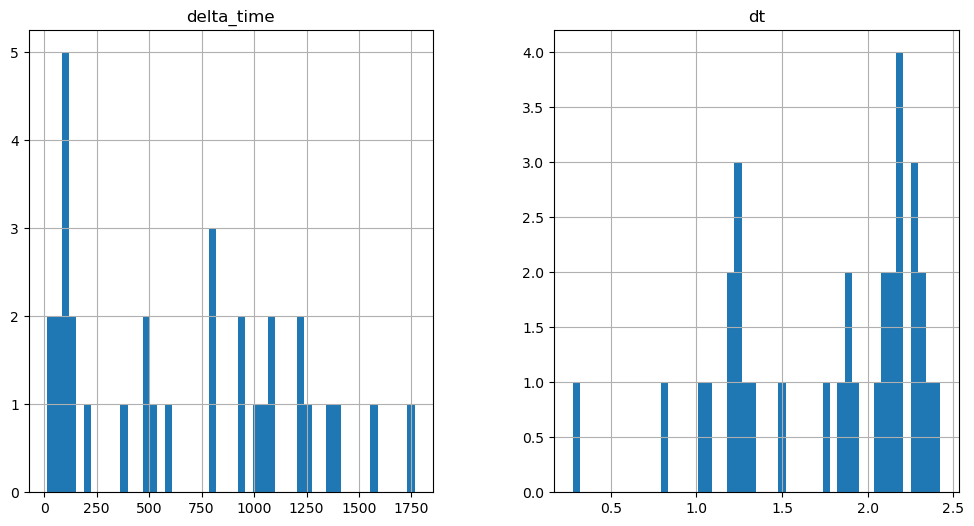

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2161.009078145027 25.128031194210052


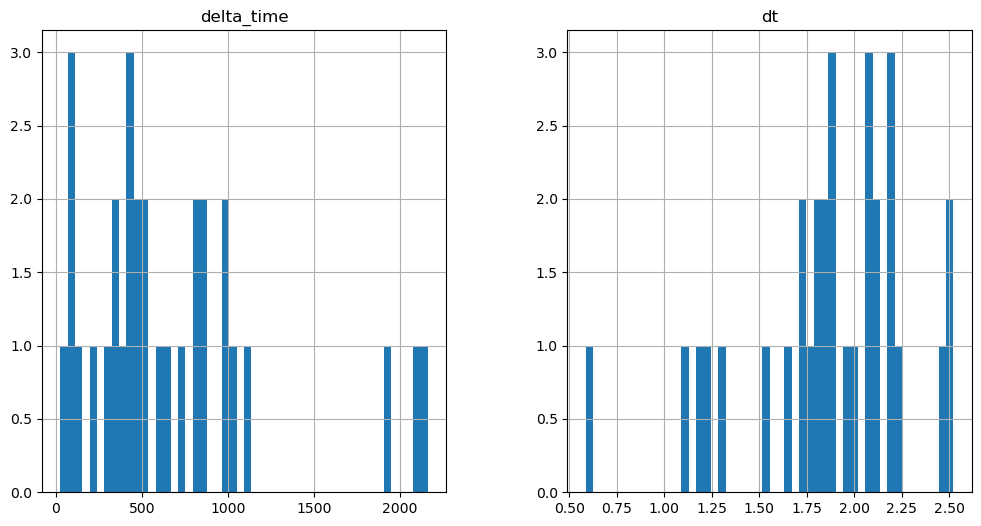

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2591.327219545841 31.410011649131775


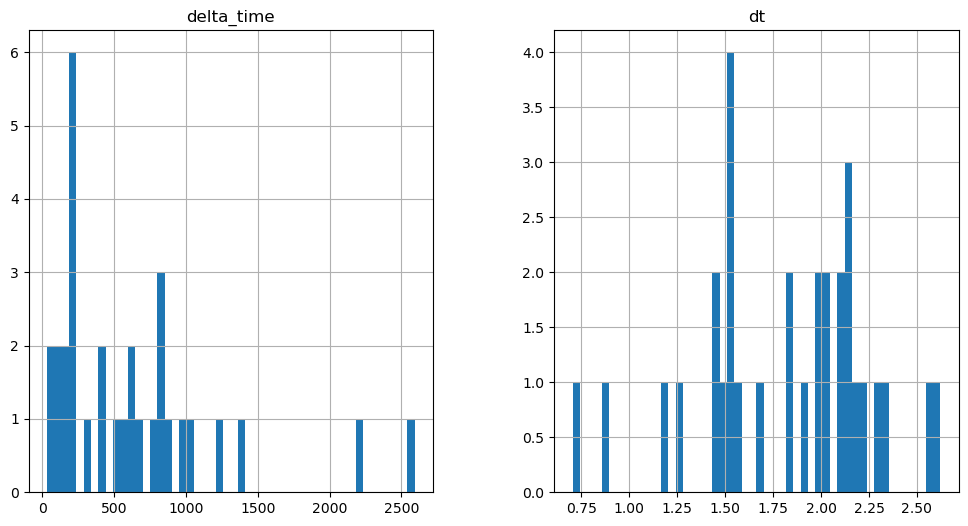

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

800.9554898738861 3.1410101652145386


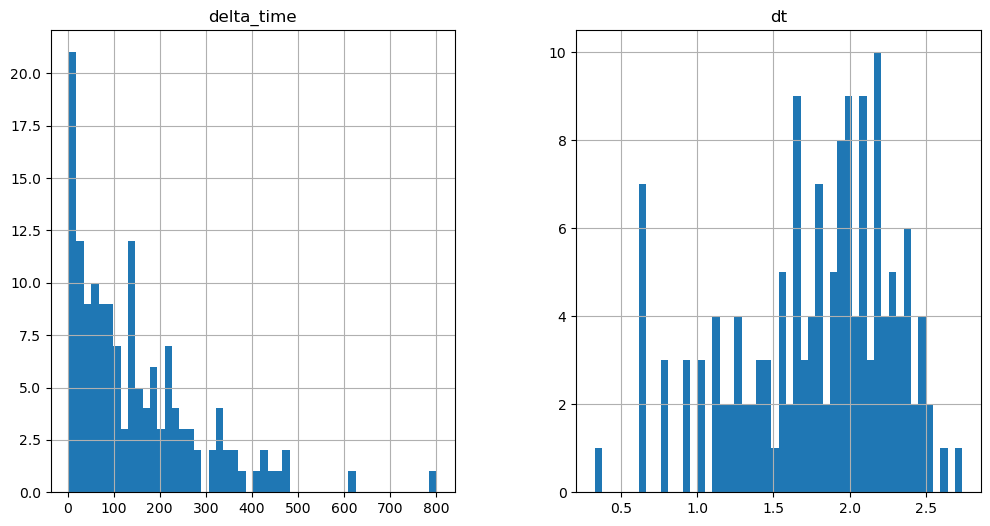

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2041.6510121822357 3.1410101652145386


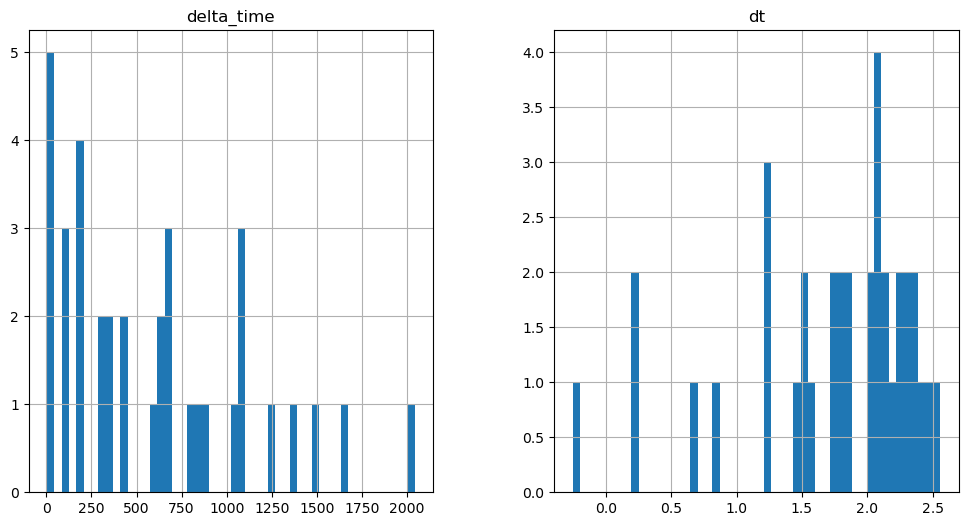

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

907.7521153688431 0.1


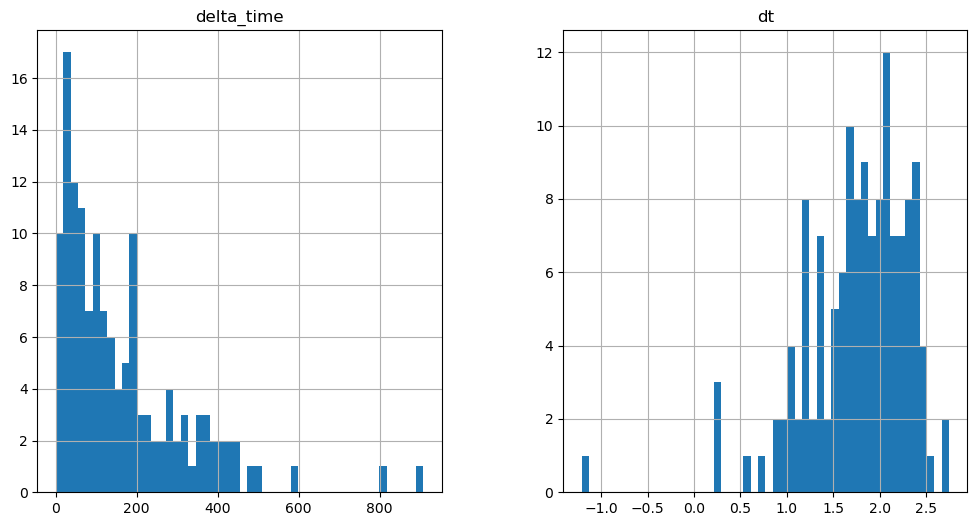

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1702.4229751229286 6.282040357589722


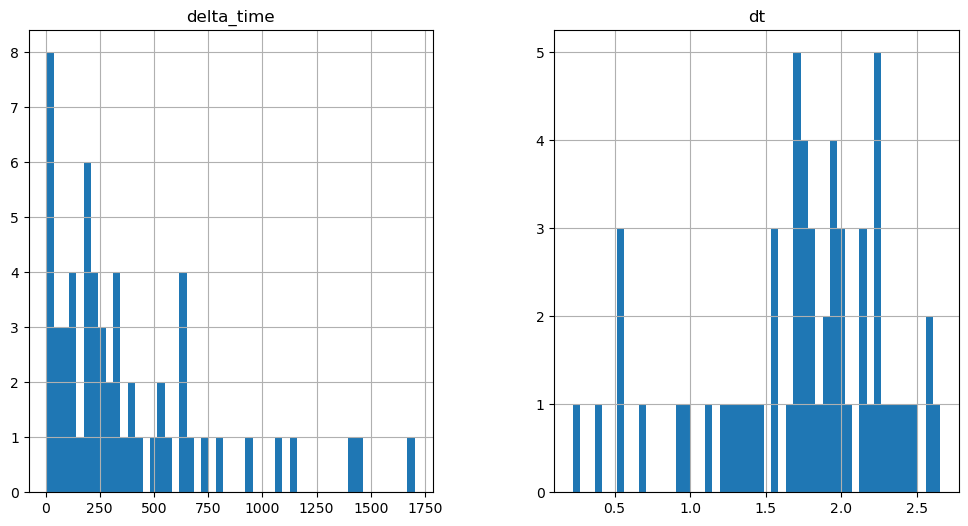

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1400.8868699669838 6.281980395317078


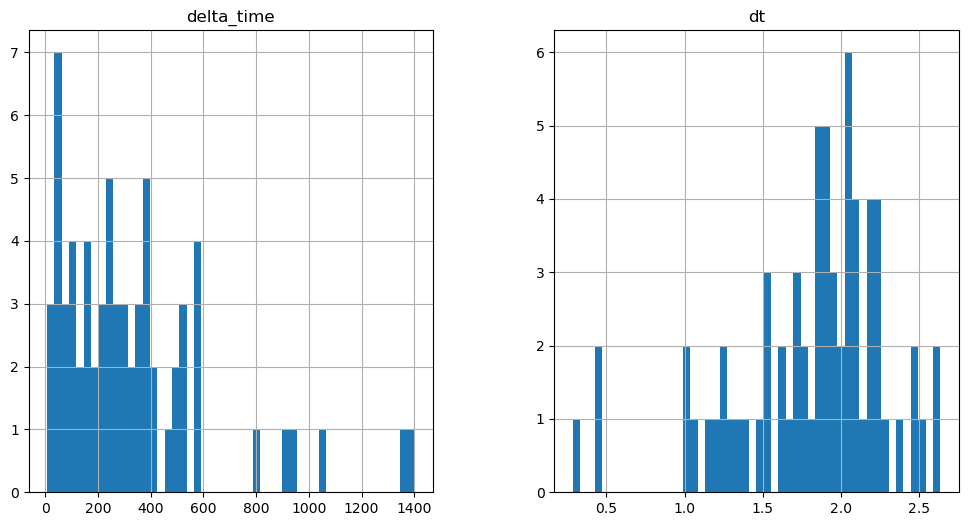

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

954.8646177053452 0.1


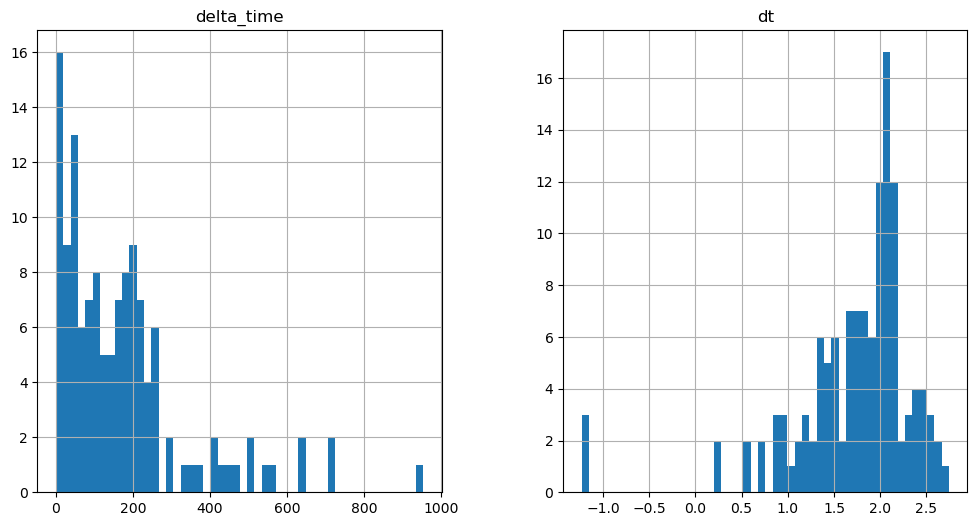

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1240.7057113051414 0.1


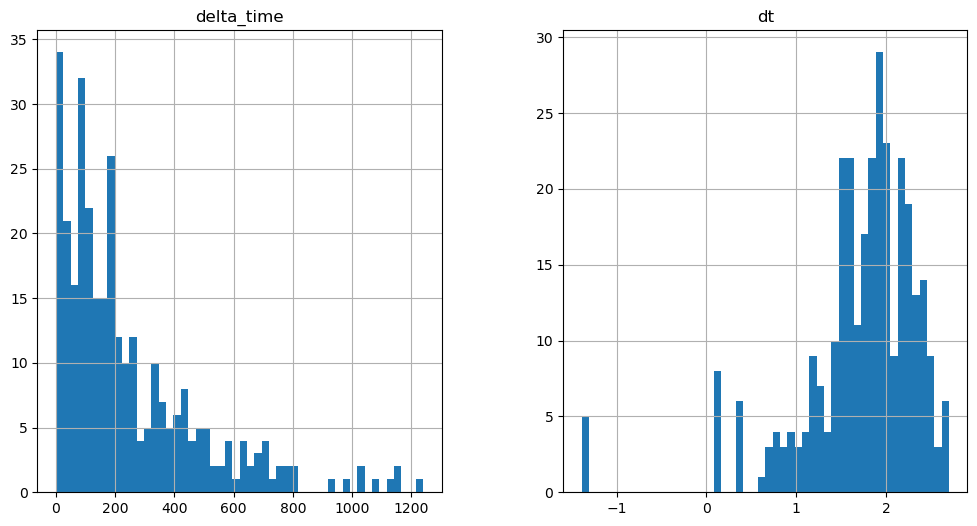

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1639.6175211071968 0.1


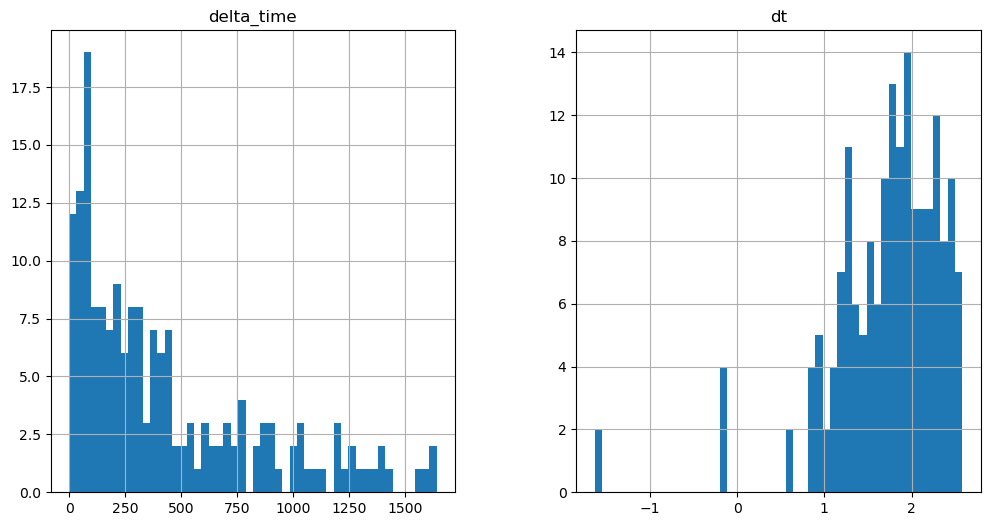

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

7513.337721347809 25.128221213817596


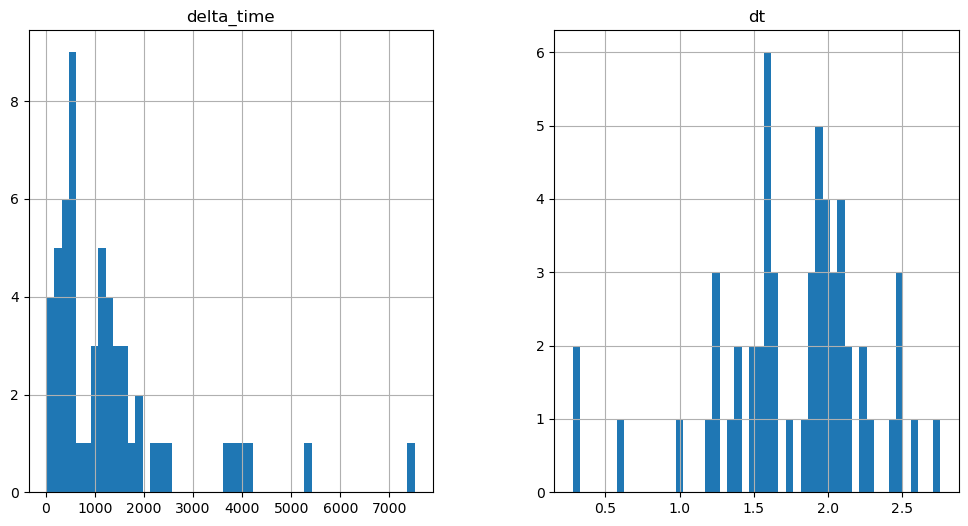

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

7620.1331468224525 3.1410301327705383


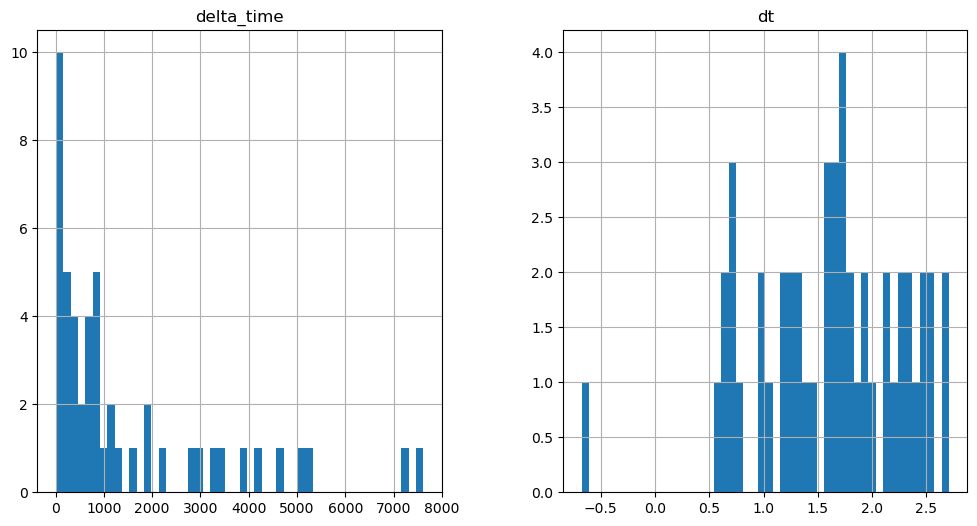

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1658.4623819589615 0.1


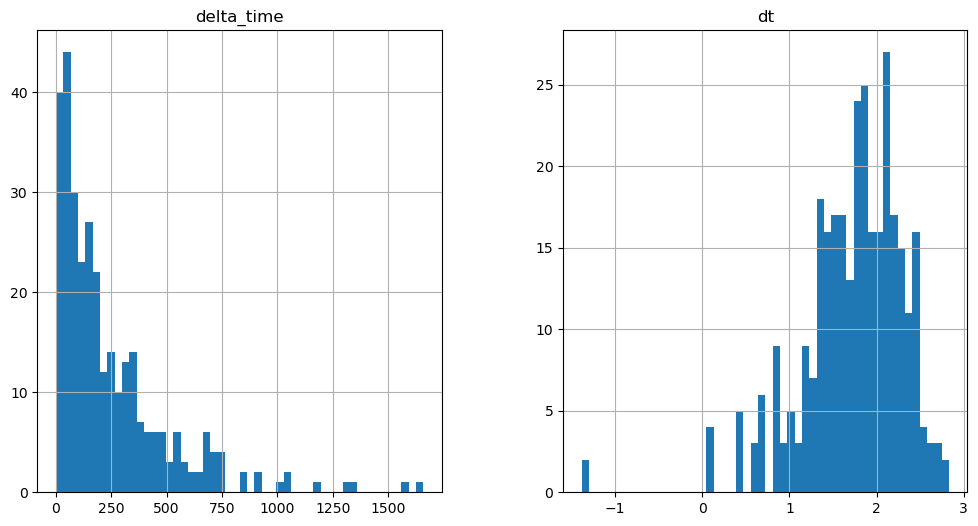

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

420.89803087711334 0.1


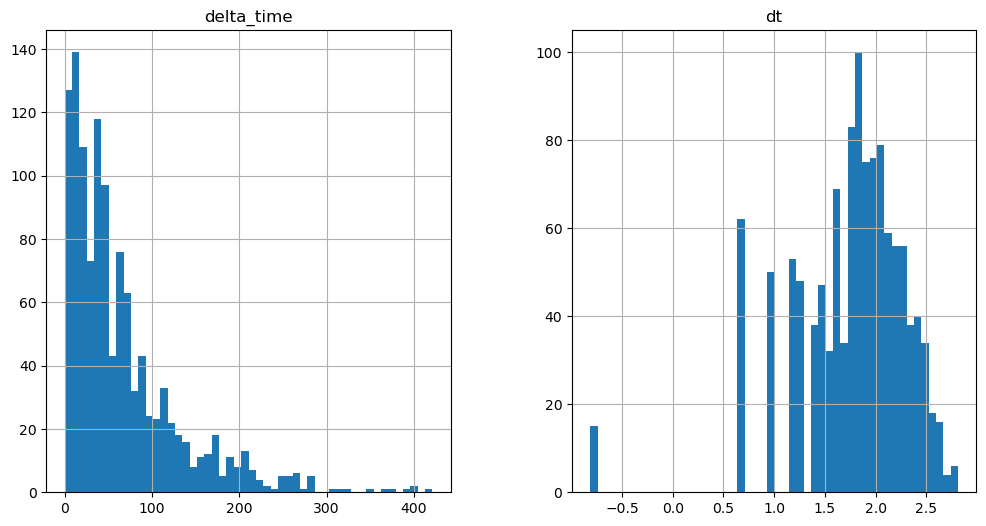

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

6065.324489891529 125.64110612869263


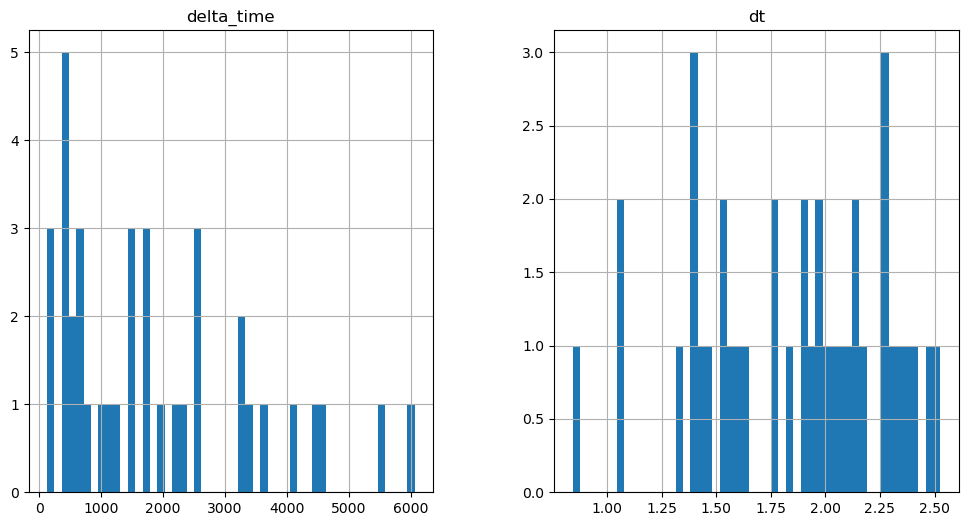

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

12535.862729609013 3.1410202383995056


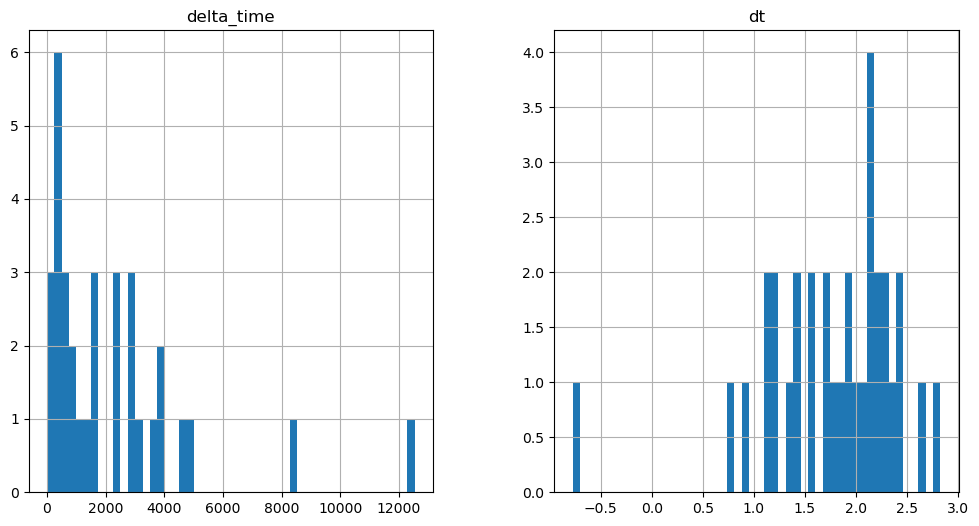

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2632.1830800771713 6.282060265541077


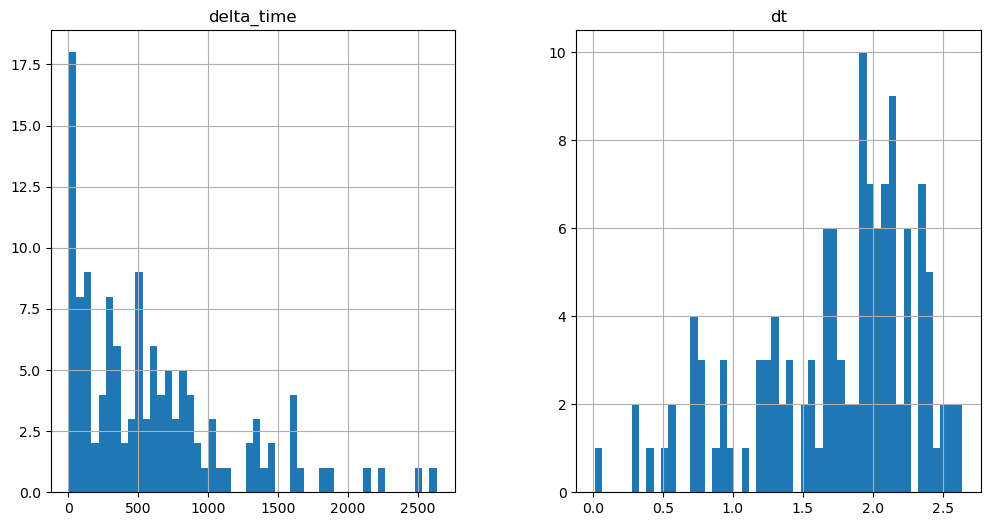

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3835.1943495869637 3.141030251979828


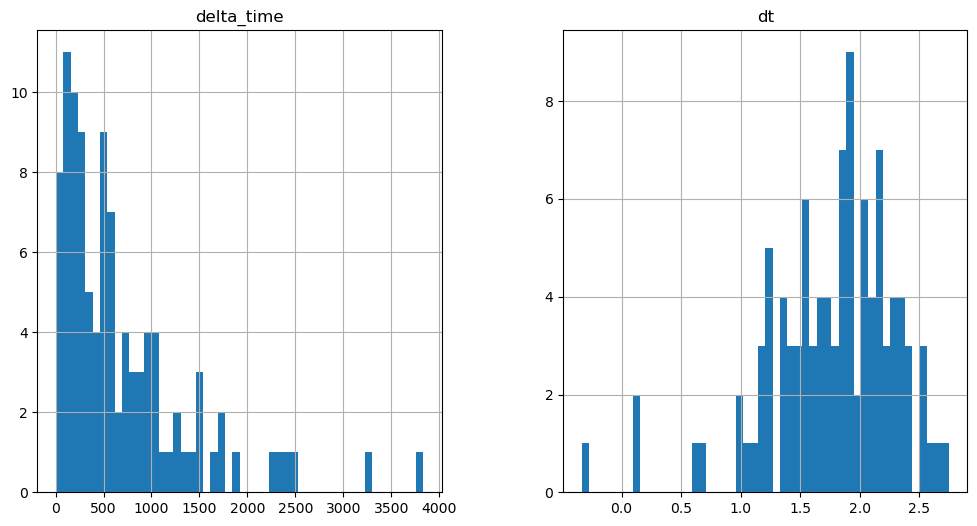

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

14389.048381388187 18.846160888671875


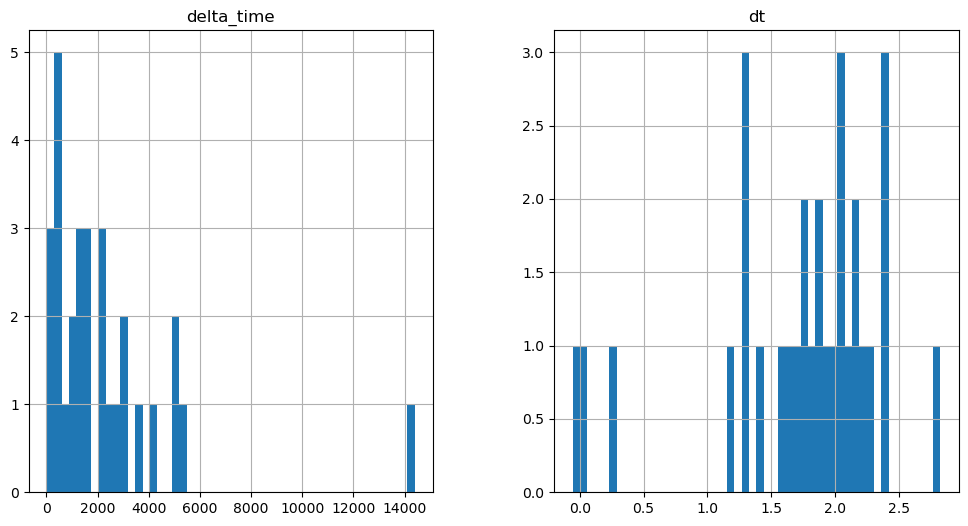

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5867.450270116329 50.25645238161087


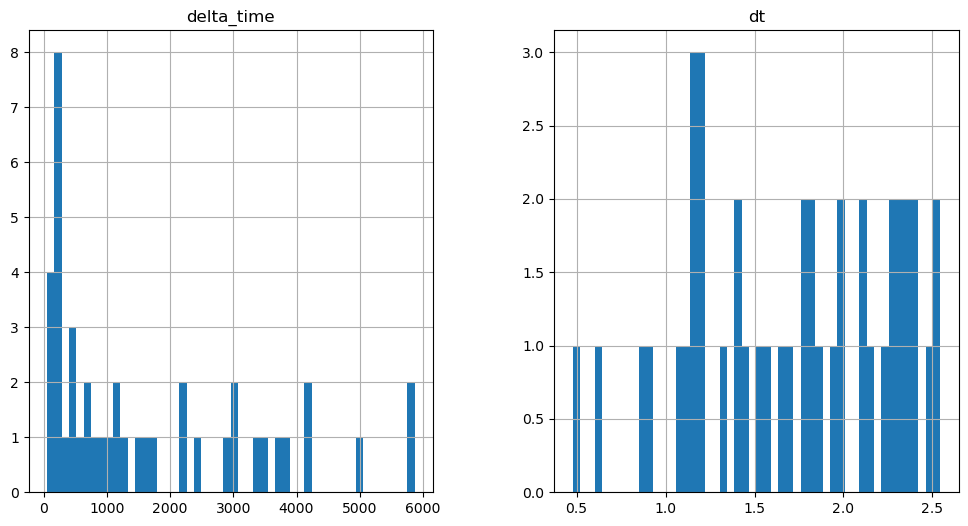

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

17800.204210102558 9.42307049036026


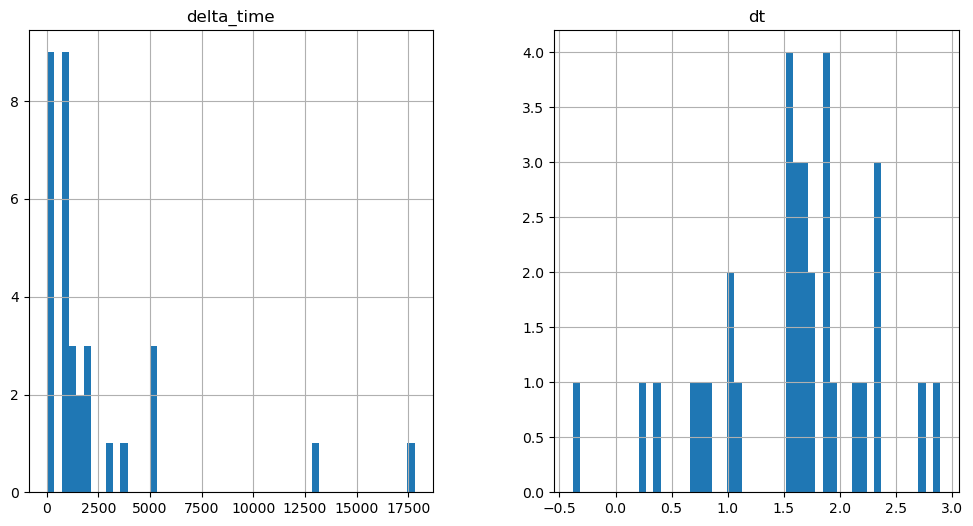

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2189.2979981303215 3.141030192375183


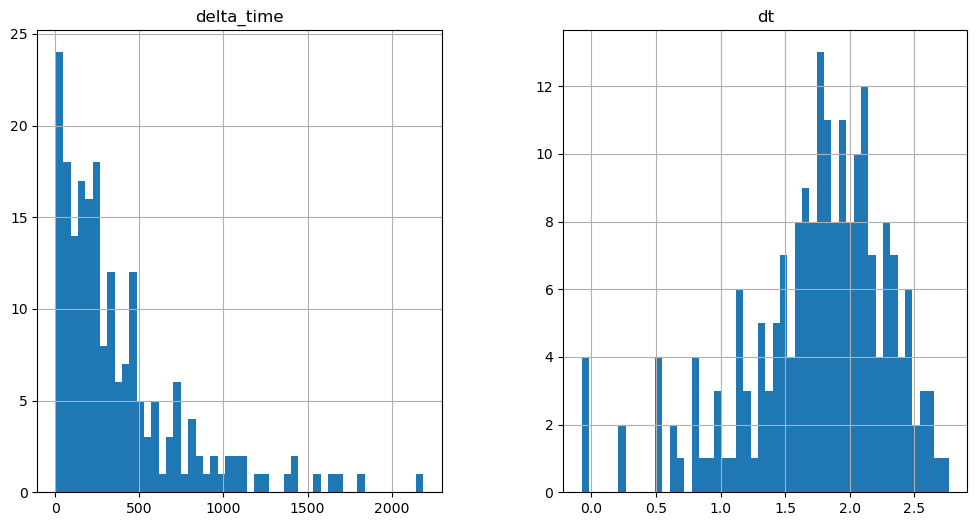

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4925.130183517933 53.39745271205902


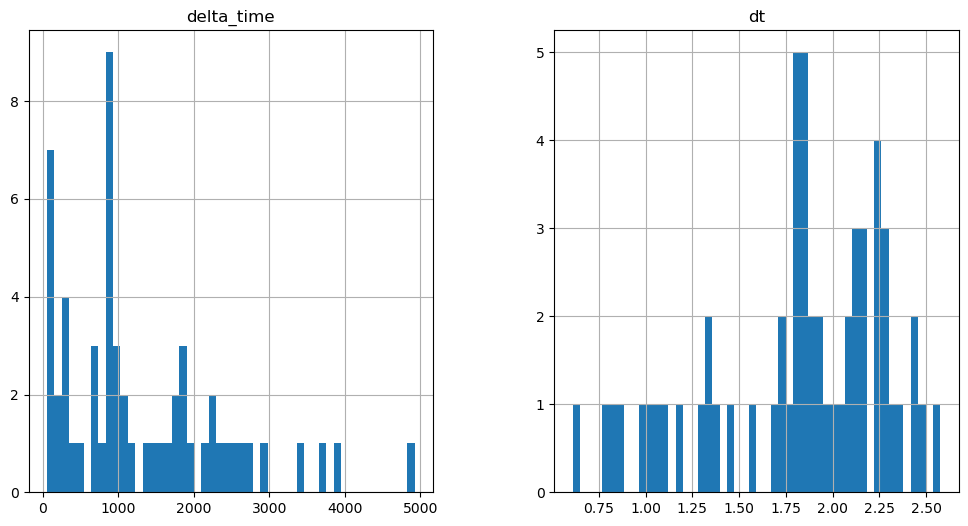

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3411.155098617077 6.282060265541077


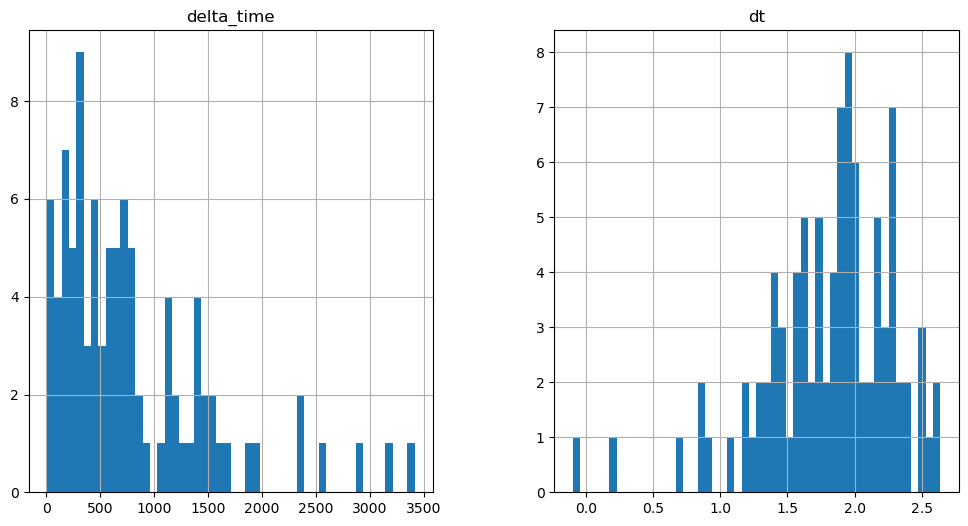

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

7375.134724617004 31.410281538963318


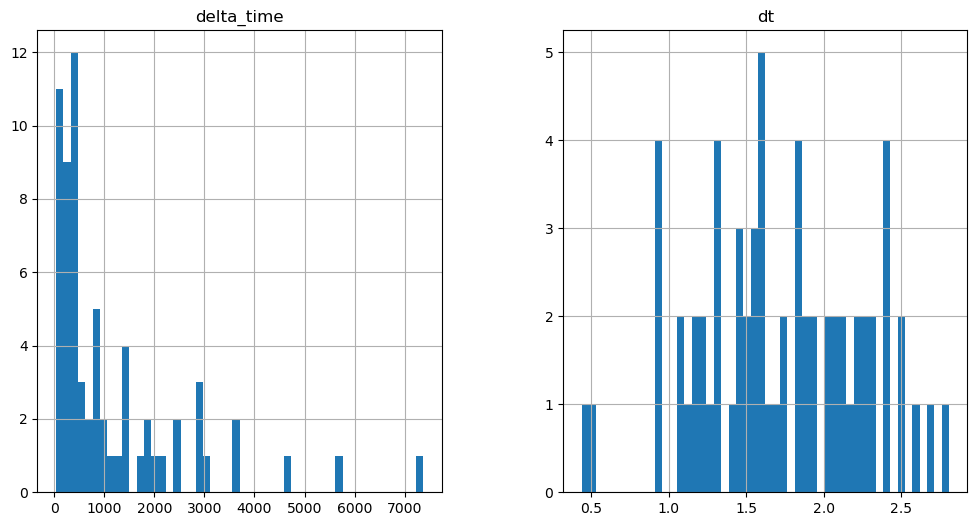

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3282.3744822740555 0.1


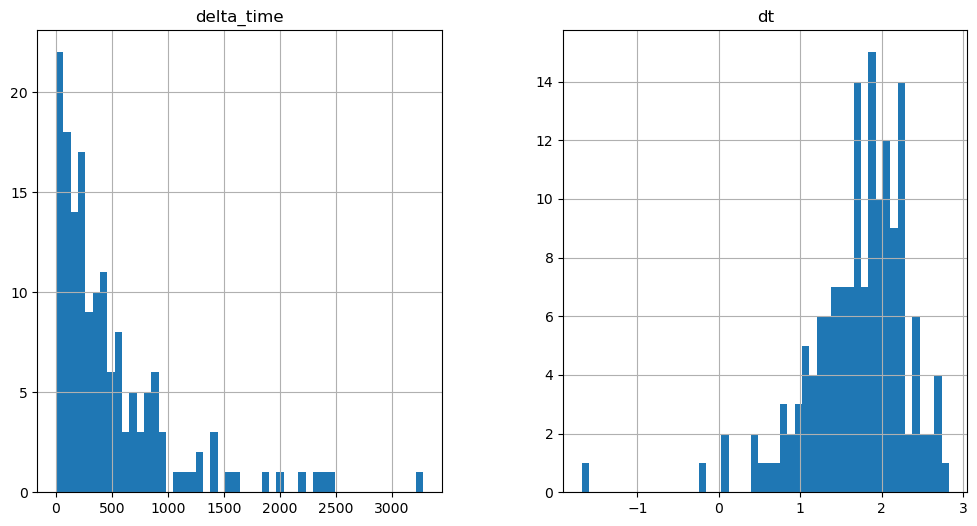

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

6633.849657893181 72.24361366033554


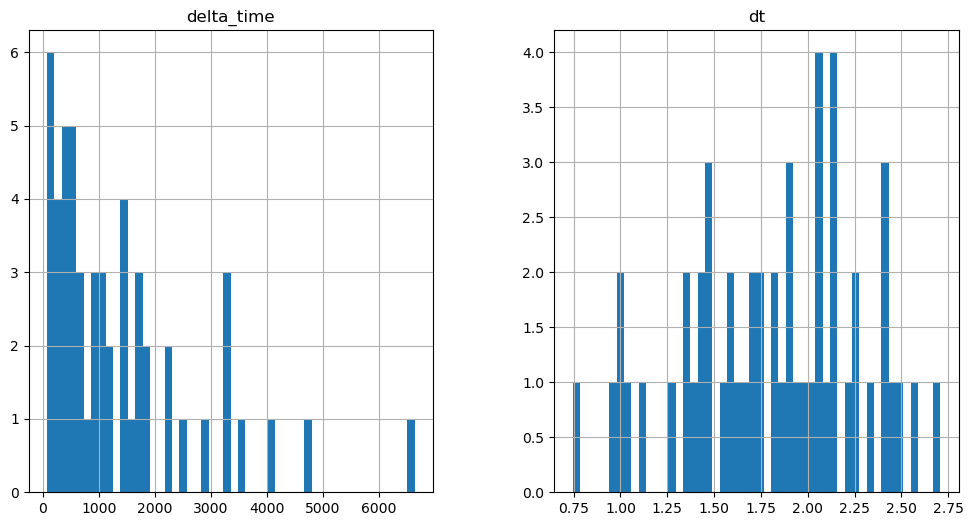

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5792.053426325321 0.1


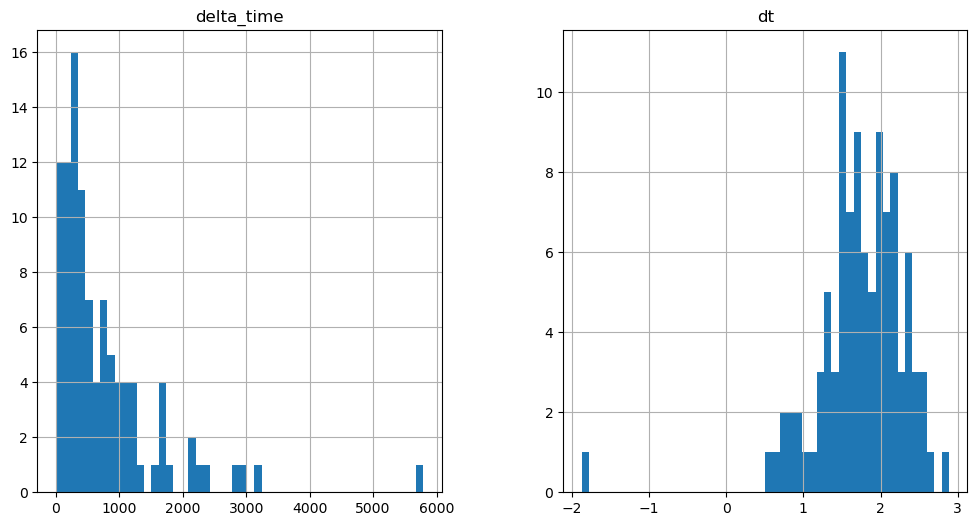

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2066.7971220612526 3.1410300731658936


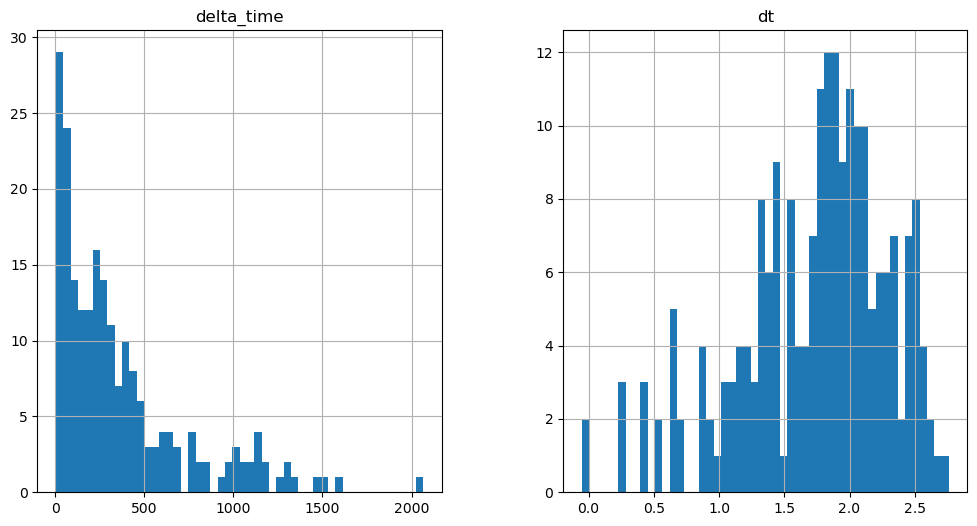

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4987.953346729279 3.1410301327705383


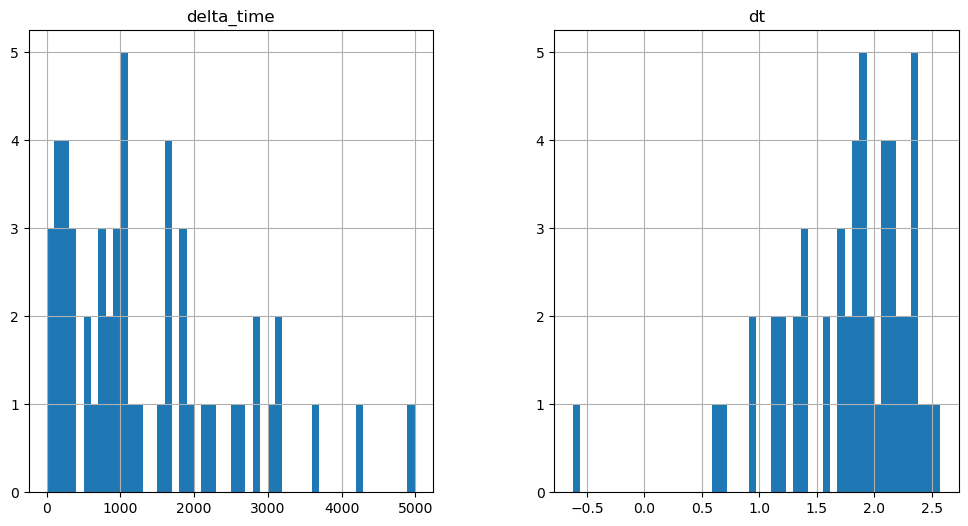

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4447.694099903107 21.987201035022736


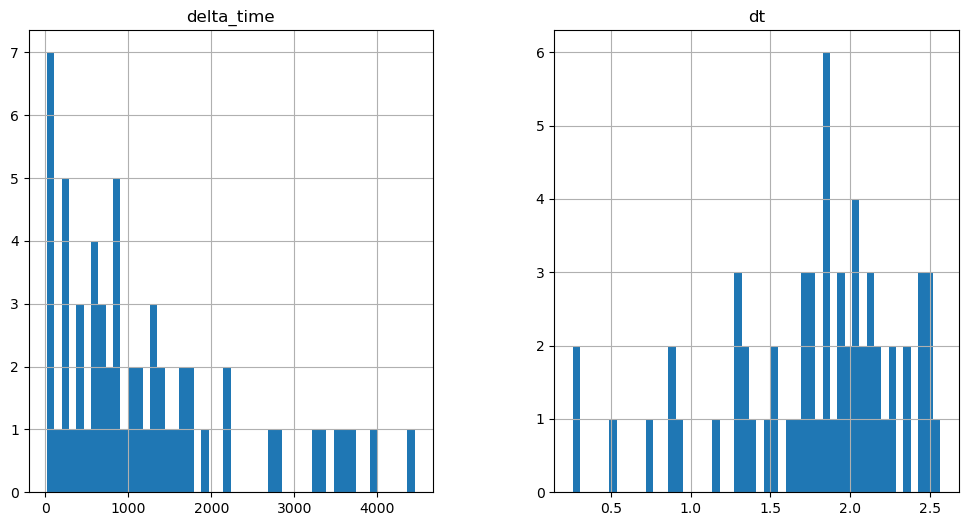

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3561.9243561029434 6.282050371170044


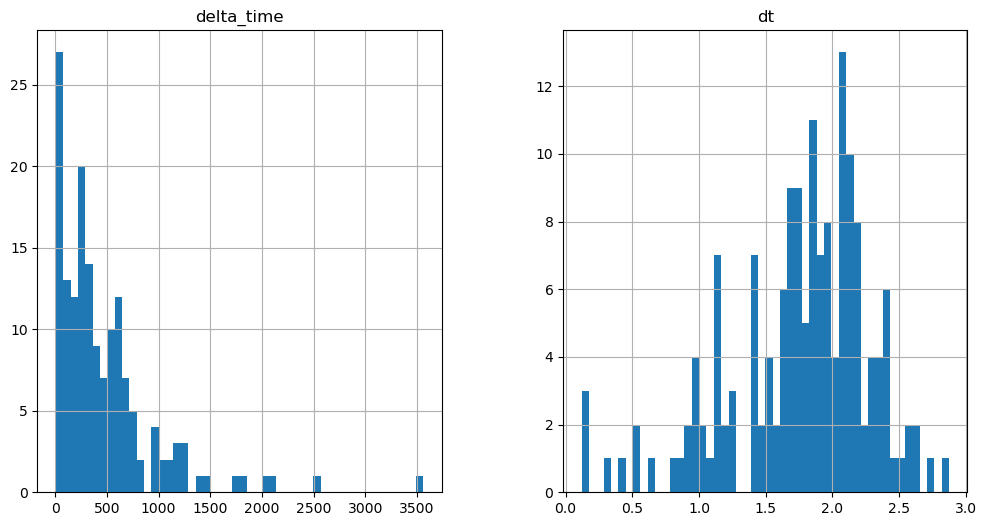

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1780.9640980958939 3.1410301327705383


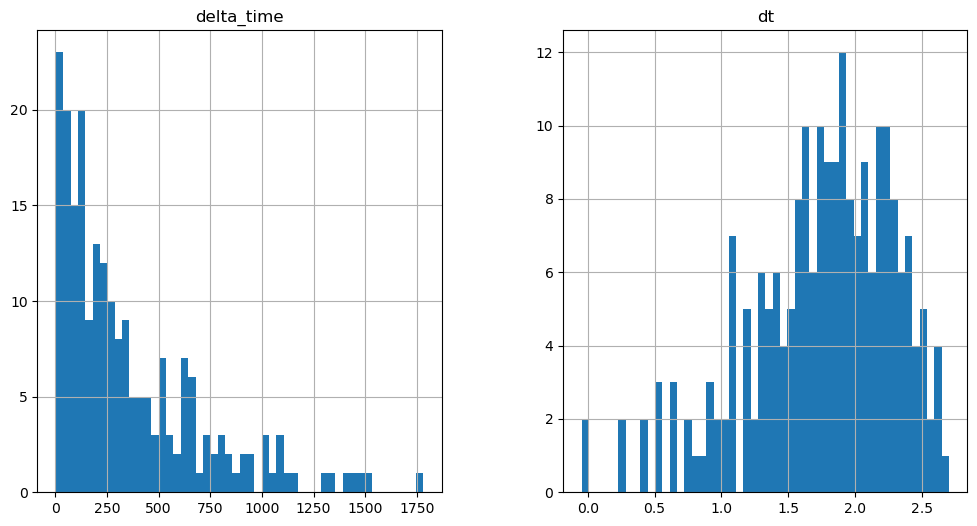

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

8986.481494247913 9.423080563545227


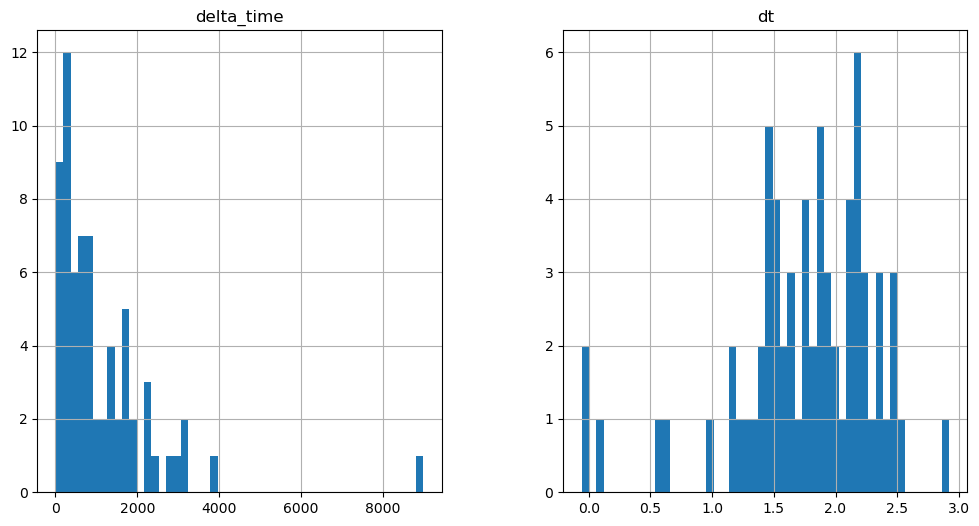

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5738.656073868275 97.37196487188339


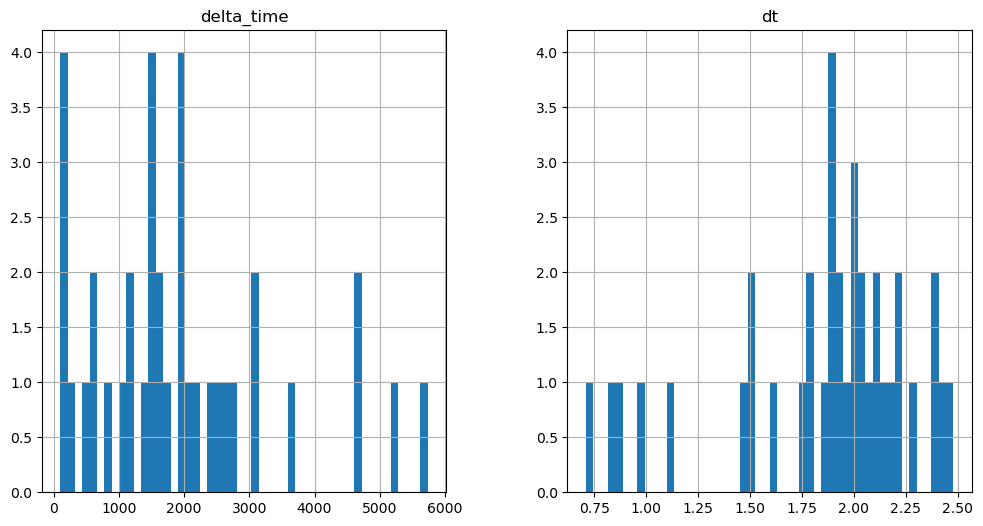

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5556.484484791756 15.705150663852692


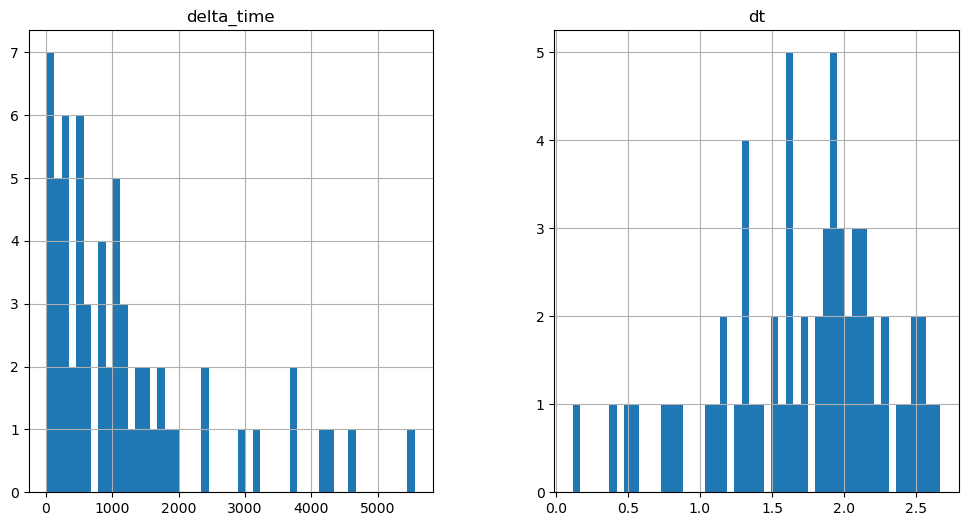

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5977.3741356134415 12.564140558242798


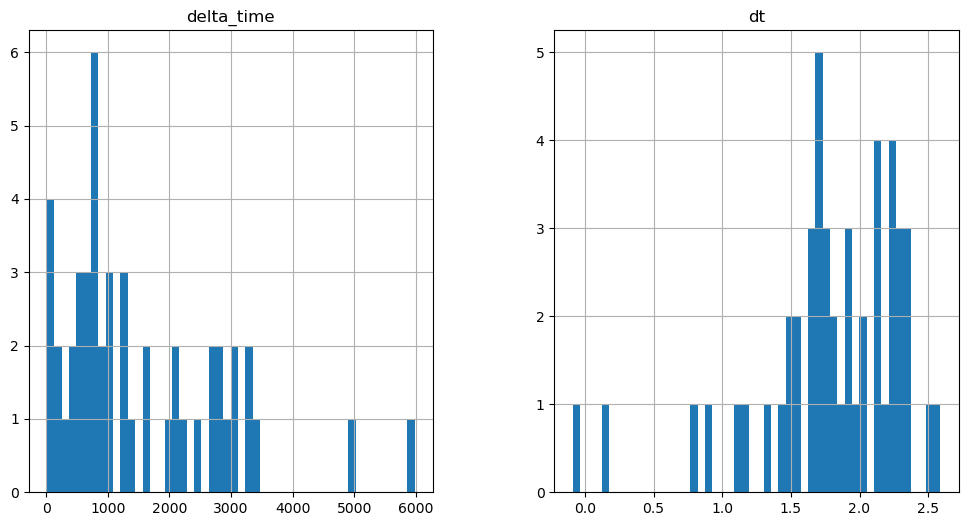

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

7535.3293426036835 12.564120650291443


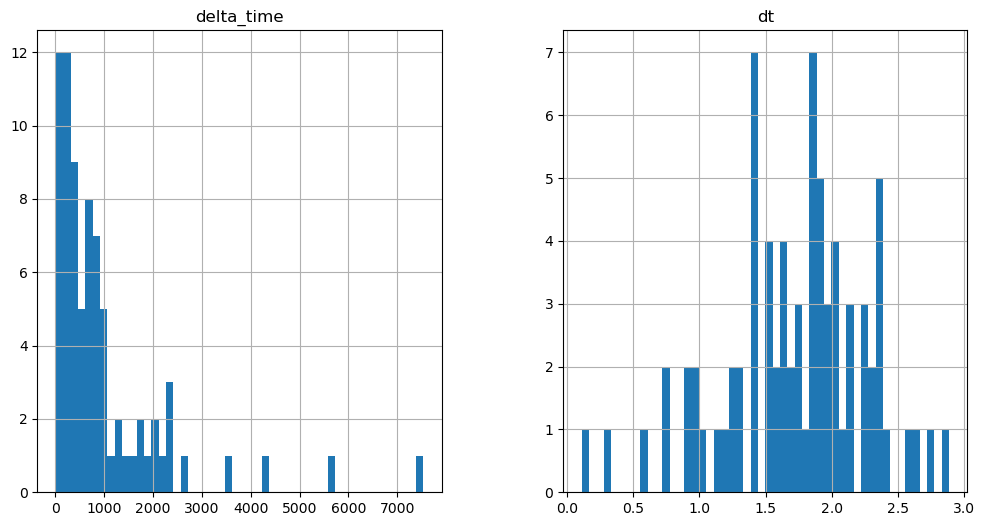

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5101.028662145138 25.128221213817596


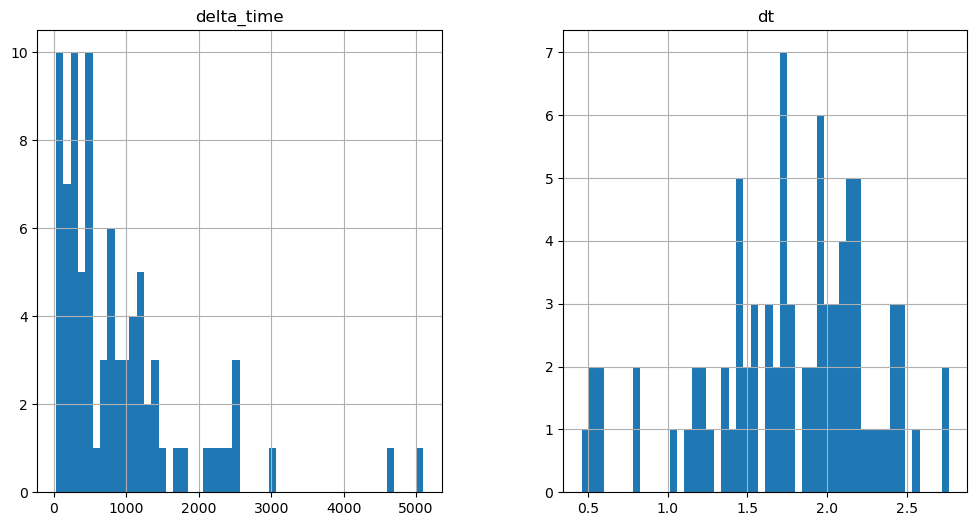

3122.180774331093 3.141030192375183


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

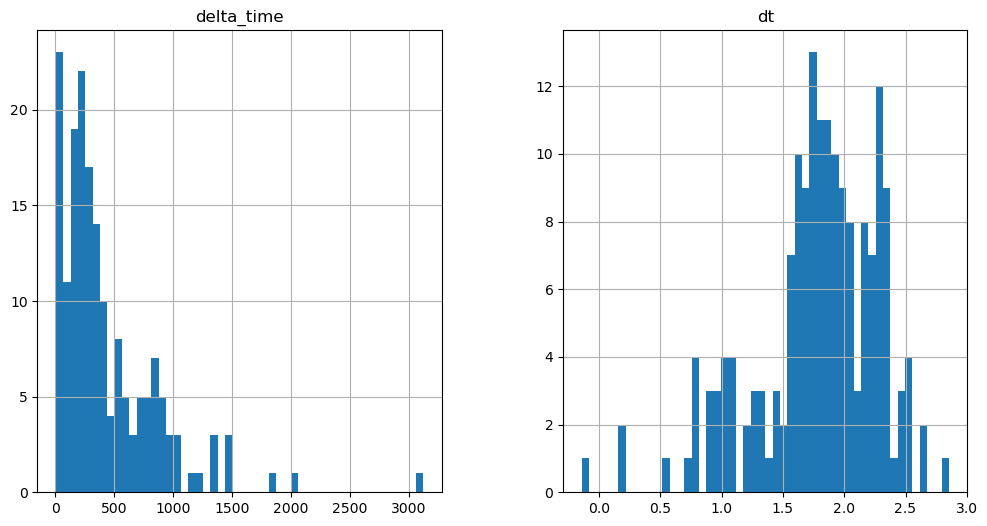

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1469.9877933263779 3.141010105609894


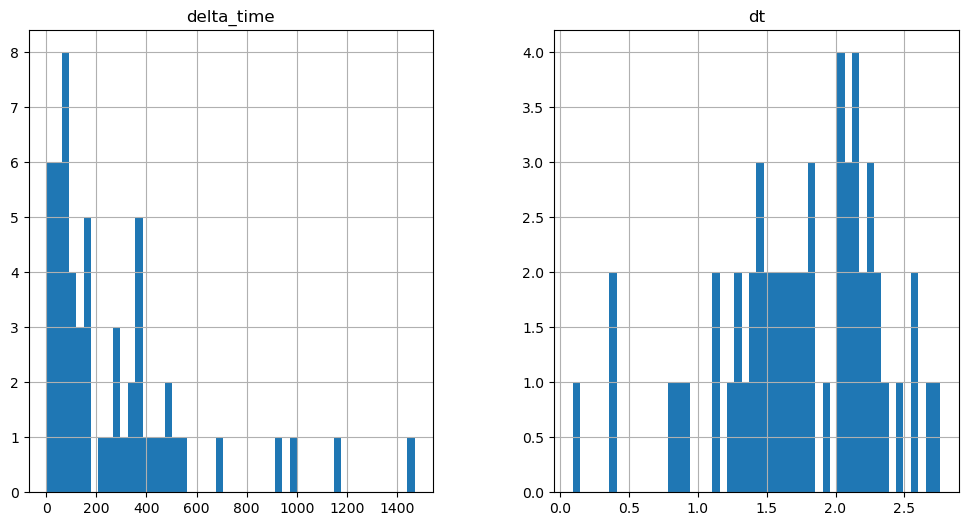

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1981.970748782158 6.281970381736755


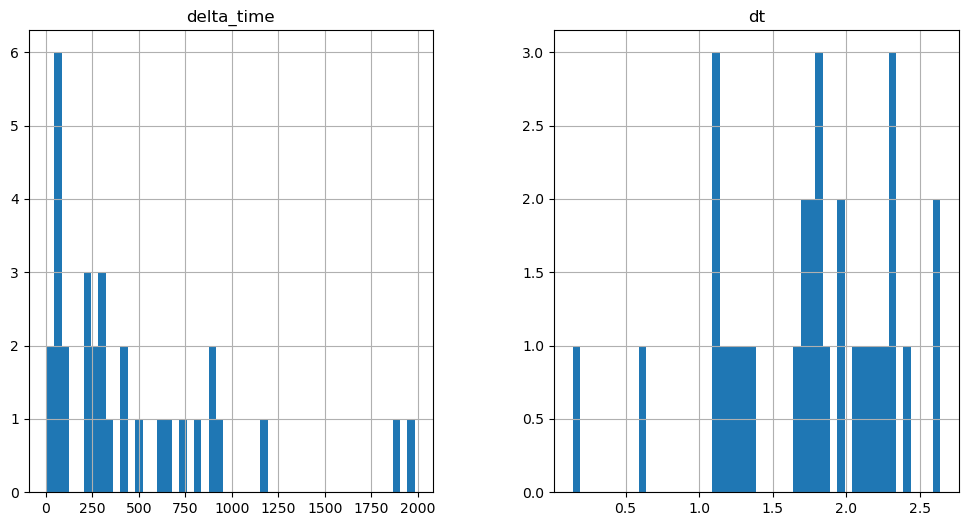

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1542.2307270169258 9.423010468482971


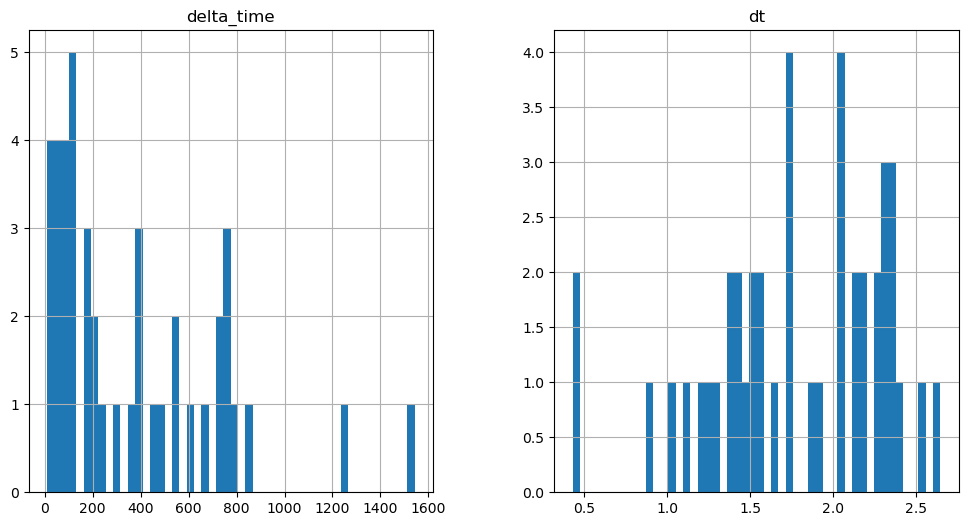

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

266.98500323295593 0.1


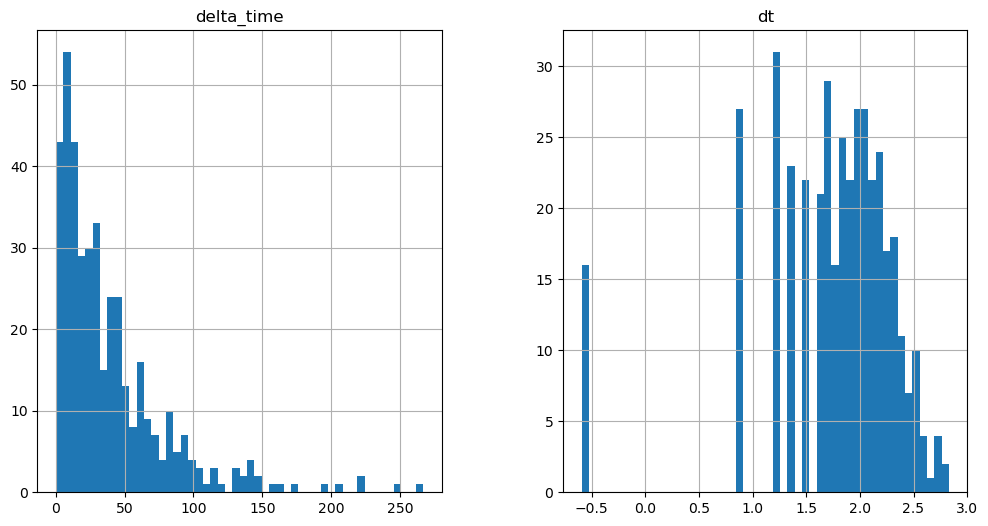

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

873.2044631838799 0.1


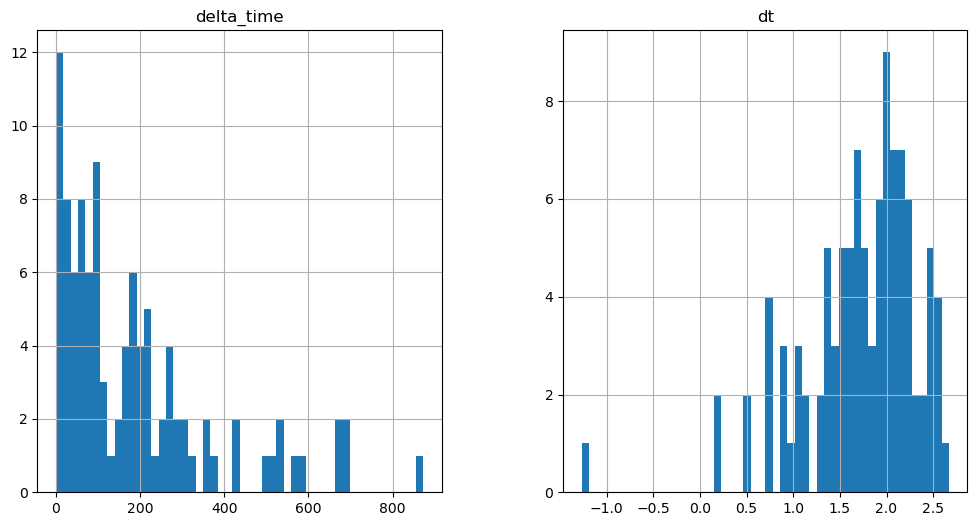

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1495.127034187317 12.564100623130798


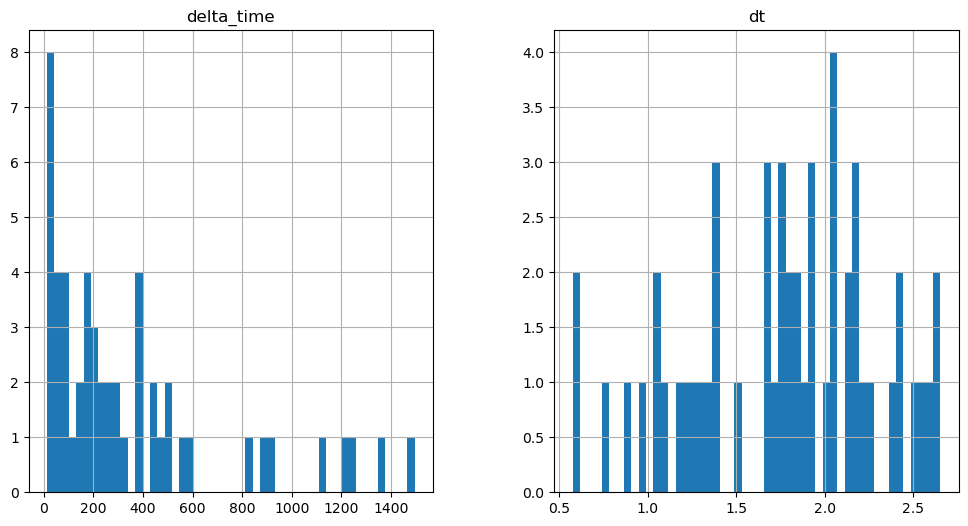

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

659.6148727536201 0.1


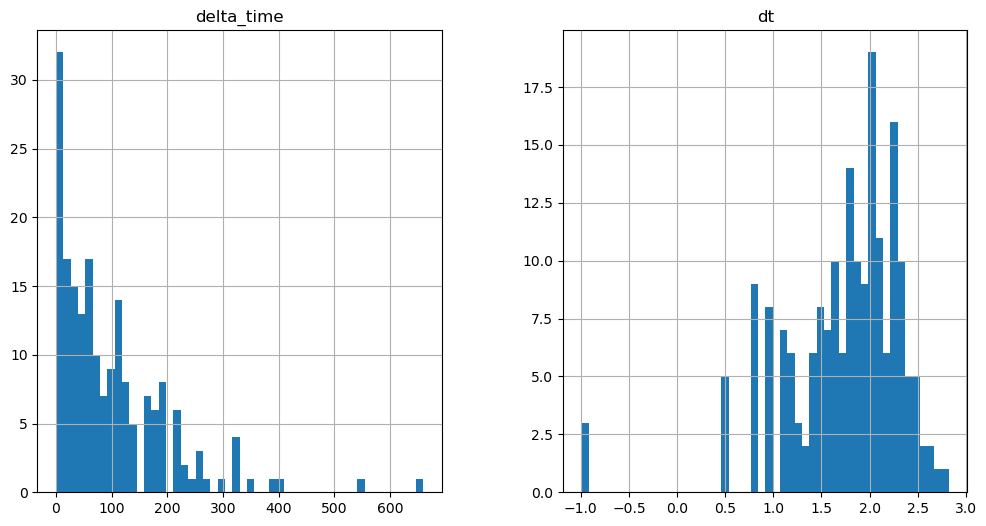

1303.5246445536613 12.564100623130798


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

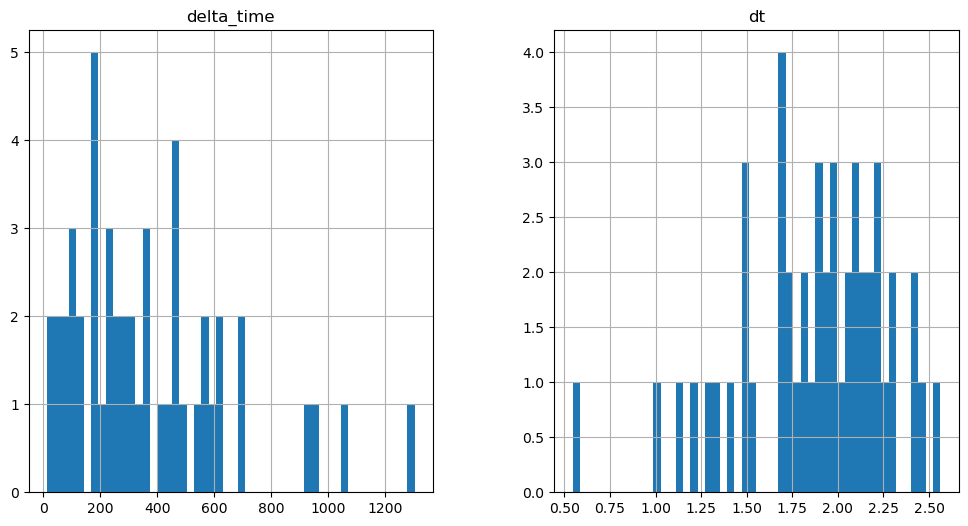

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1426.0245307683945 0.1


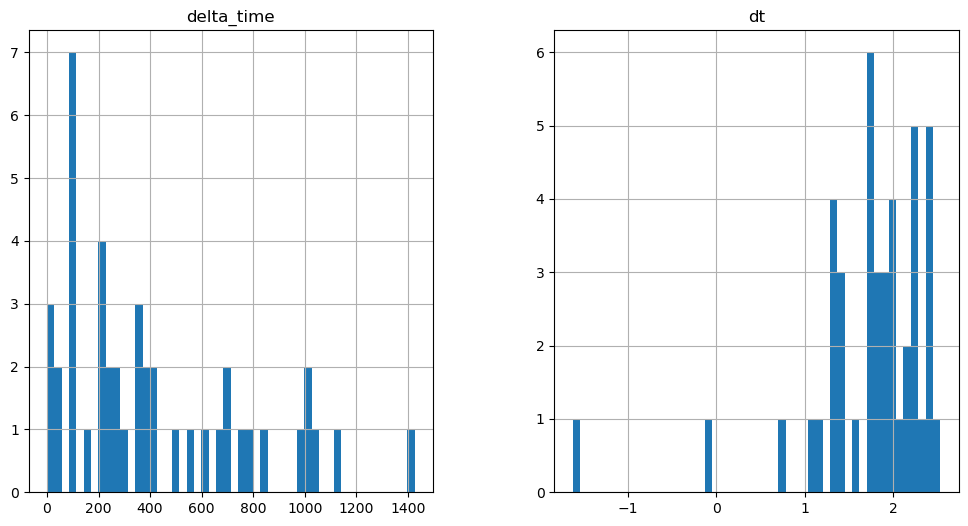

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1545.3834166526794 3.141020178794861


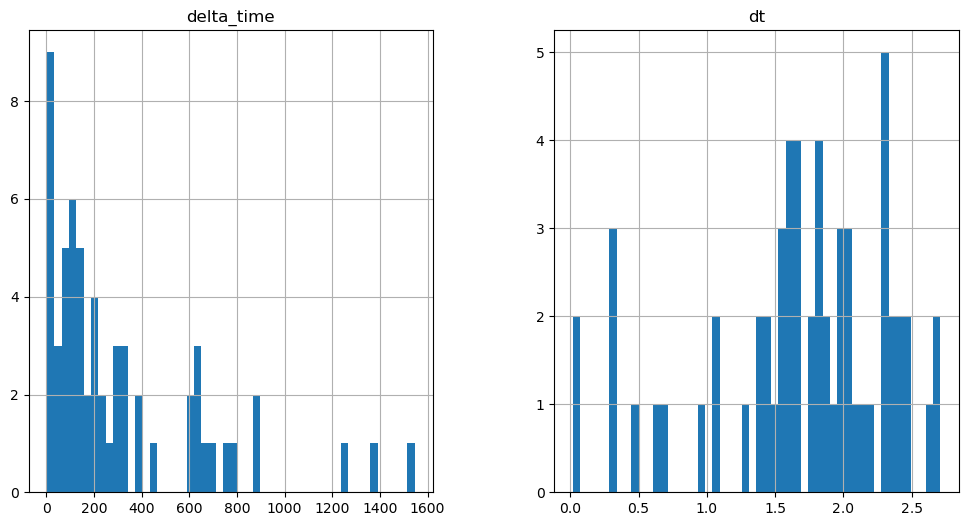

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3709.520964741707 18.846000909805298


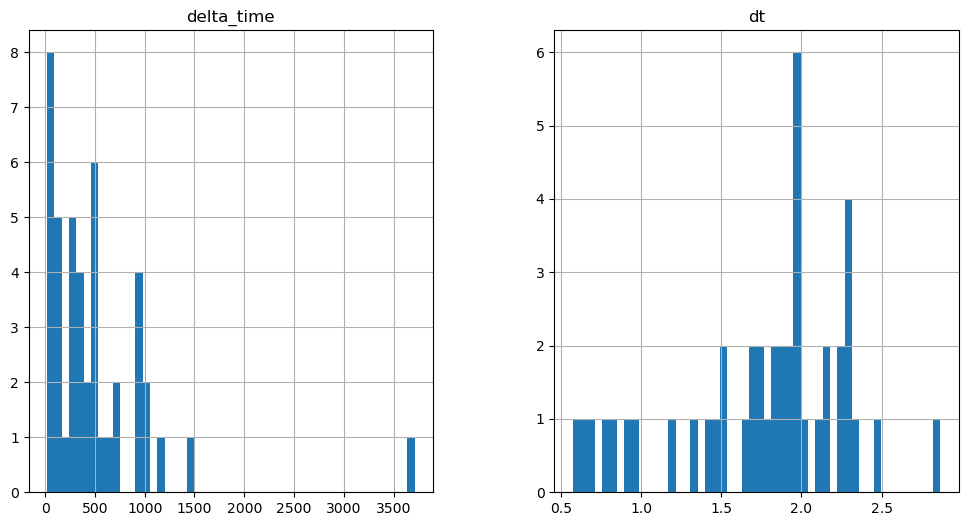

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2085.6238338947296 18.846000850200653


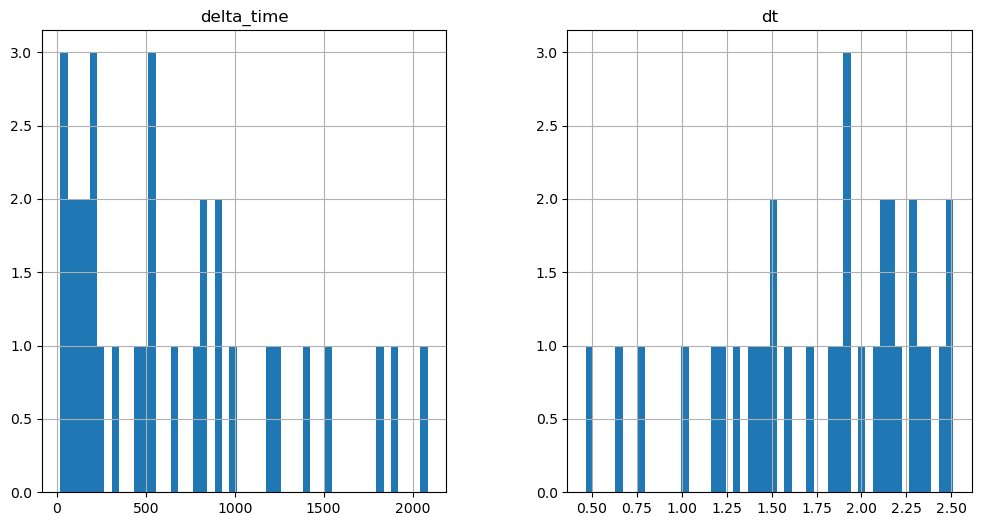

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2939.975896537304 6.282030165195465


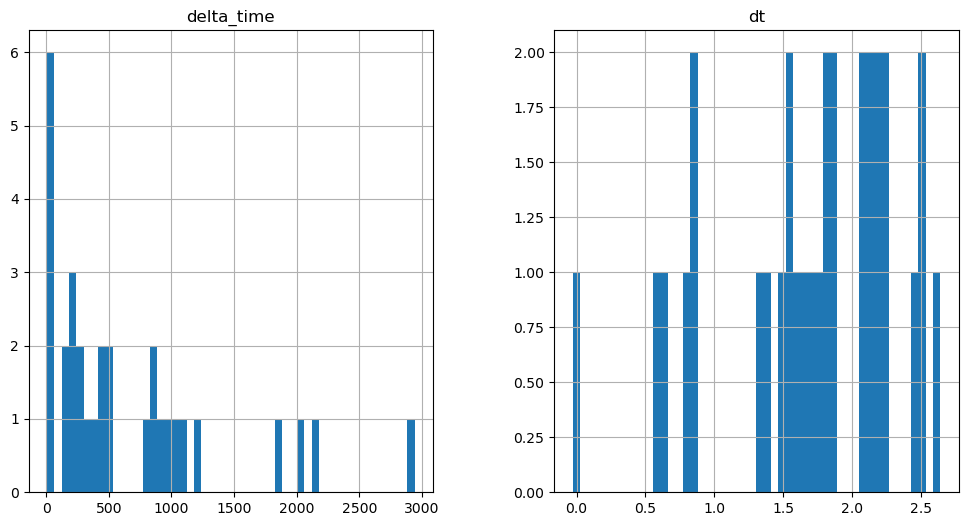

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

882.6208940148354 3.140990197658539


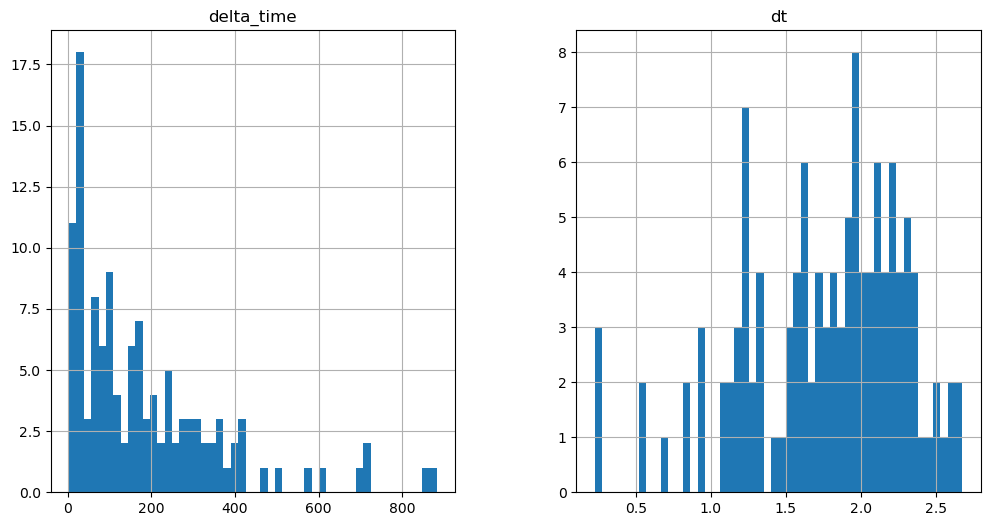

1064.799103796482 3.140990138053894


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

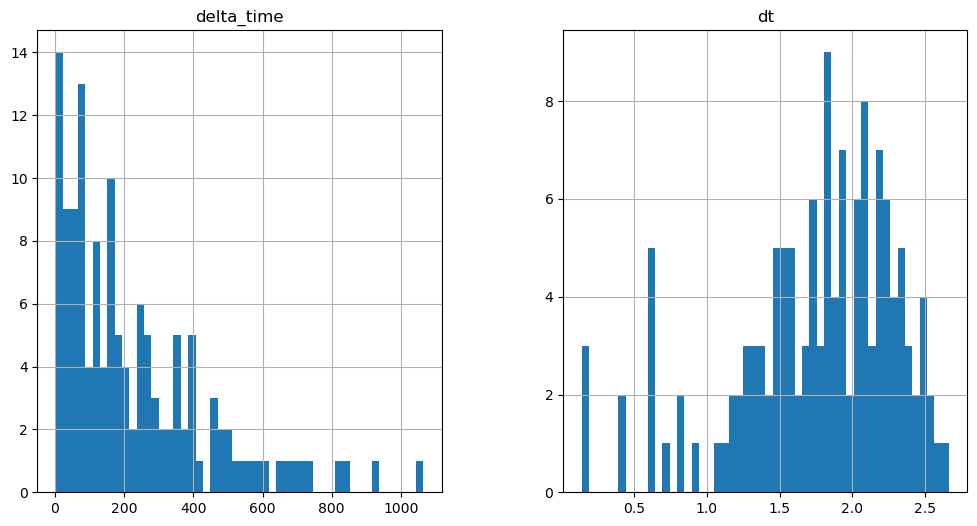

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

794.6730800867081 0.1


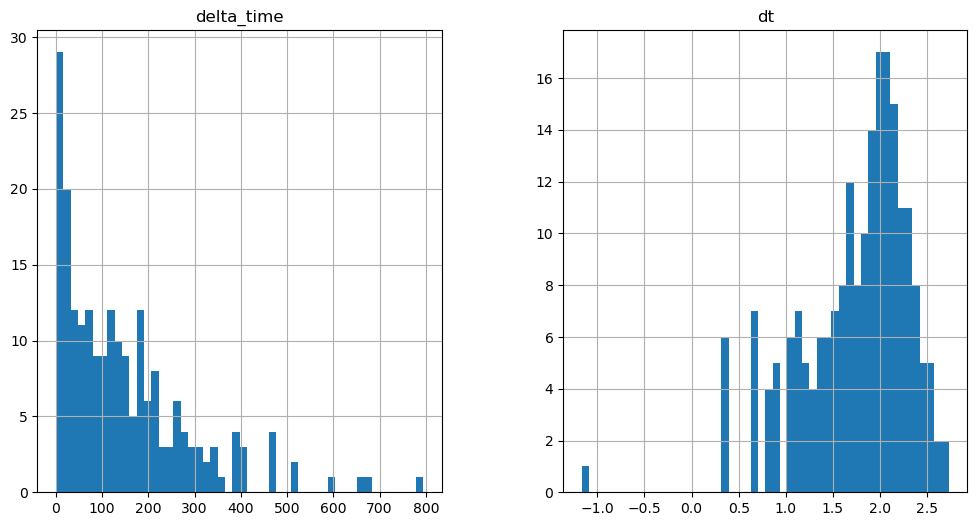

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2412.288281619549 0.1


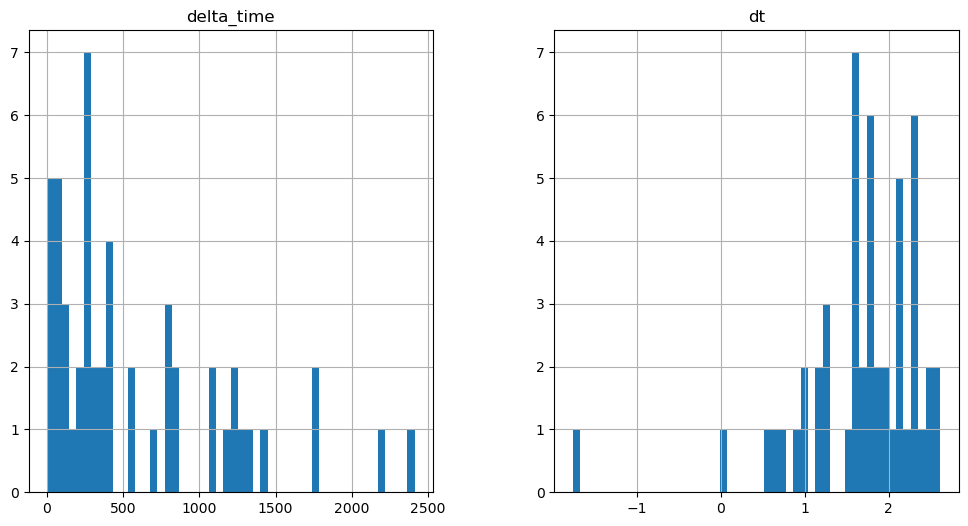

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2186.1362702846527 37.69198191165924


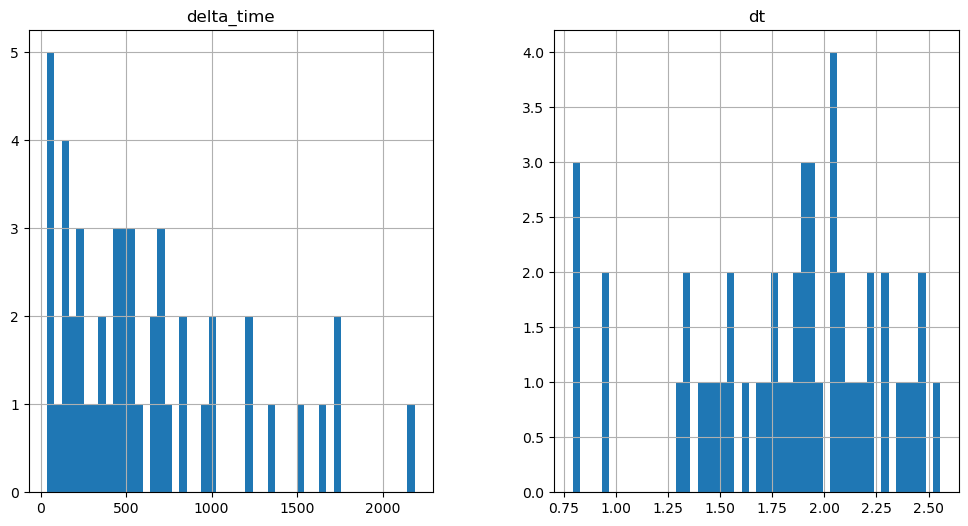

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2867.7333347201347 3.141010046005249


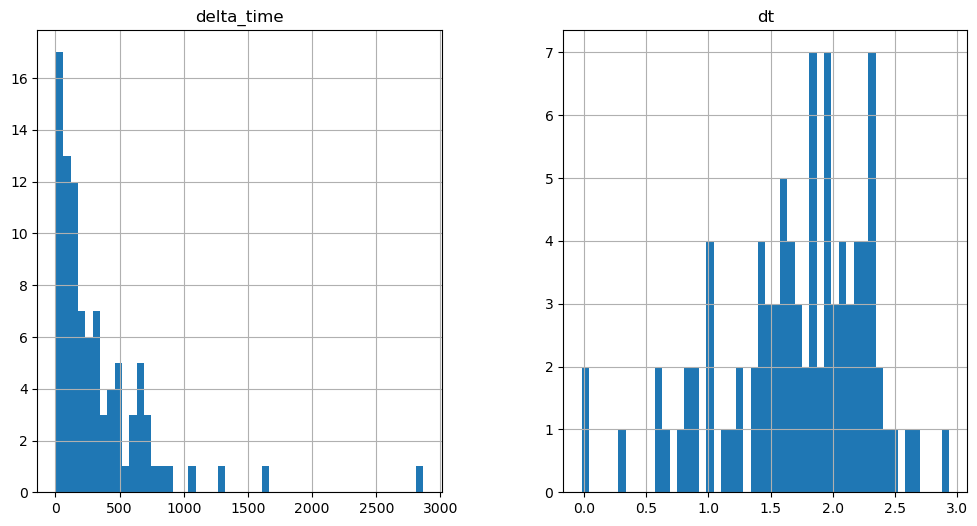

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1378.8993396162987 0.1


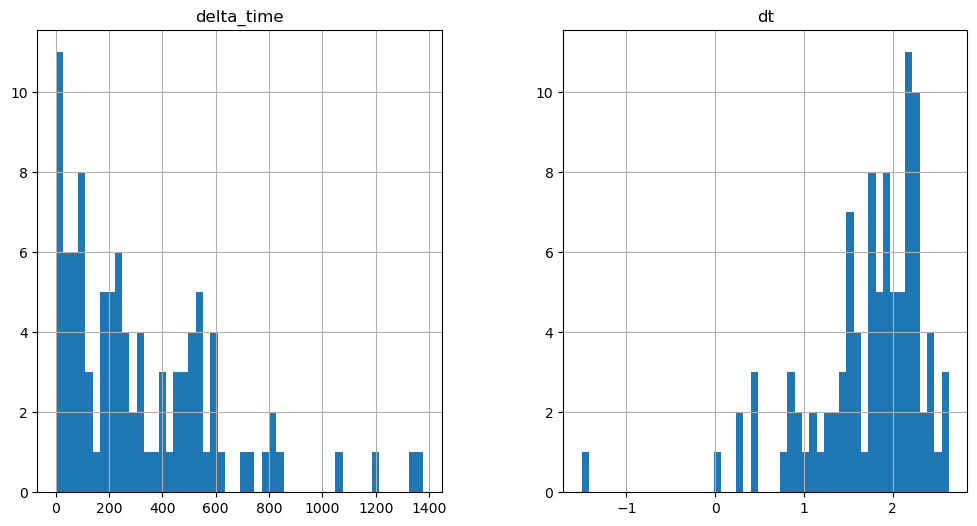

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2330.6222475767136 3.1409801840782166


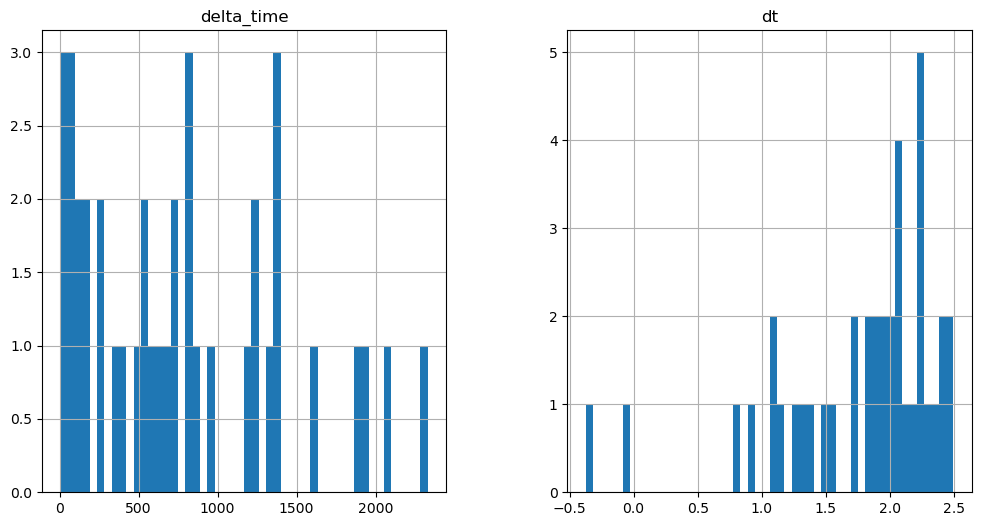

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1338.066147327423 0.1


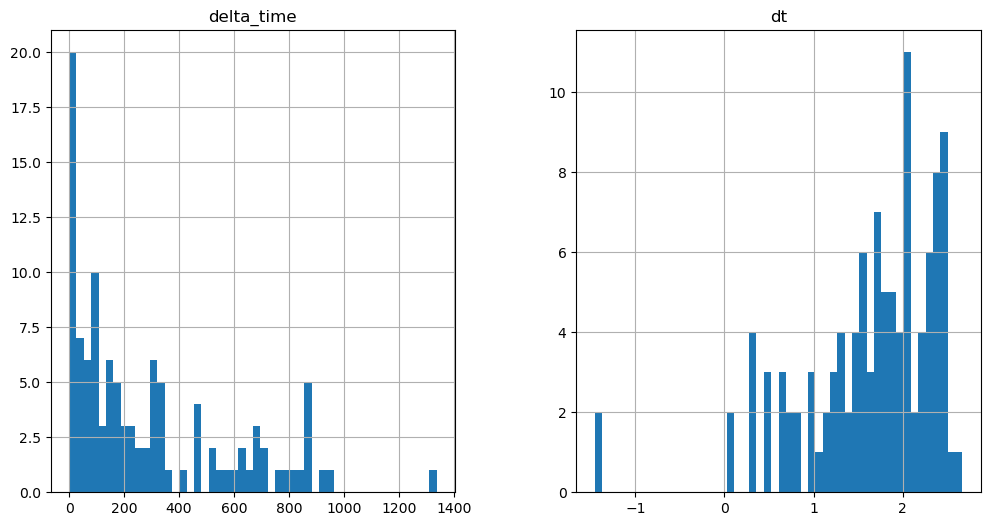

1840.6262328624725 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

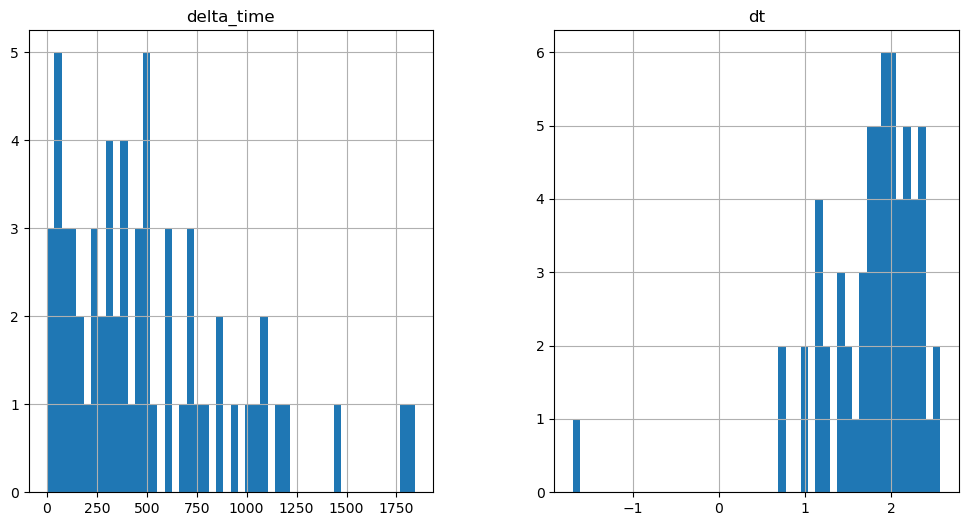

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1121.337186574936 0.1


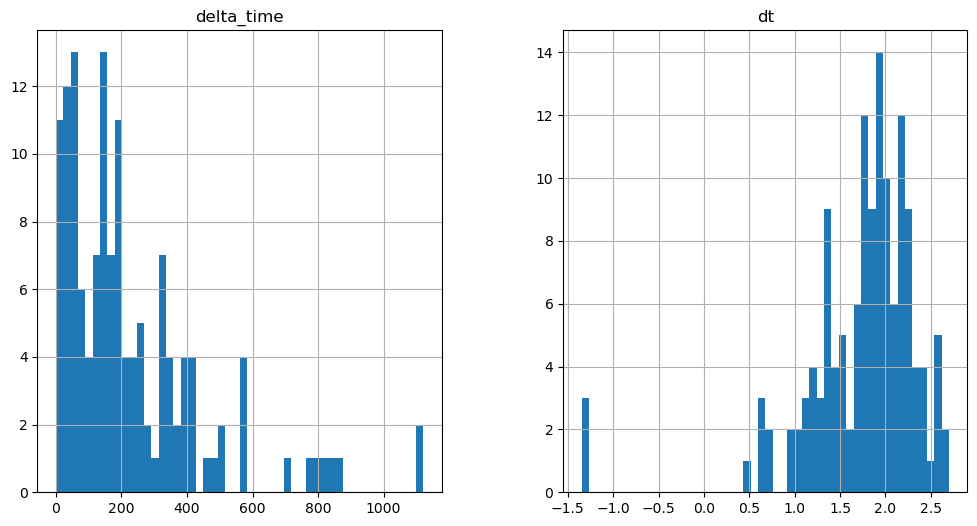

2296.071325659752 6.28201025724411


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

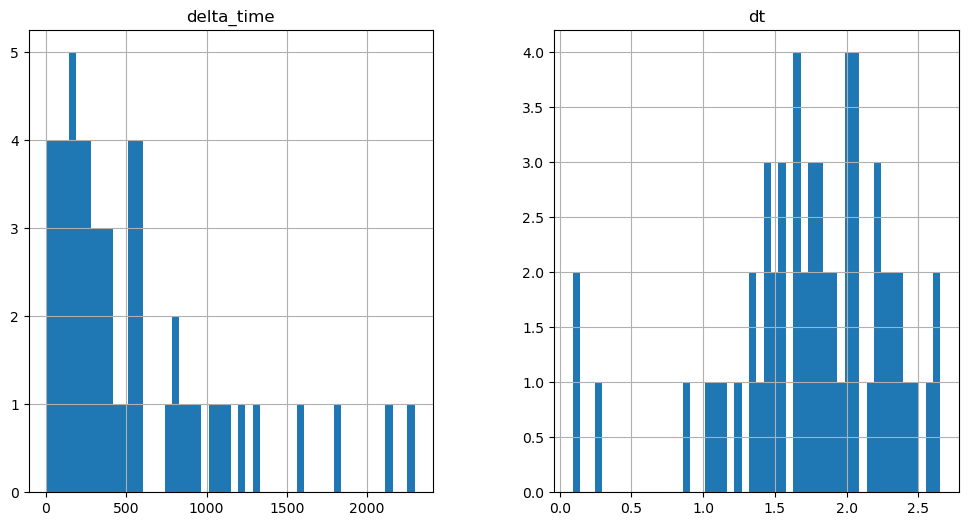

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3744.0724487900734 3.141020119190216


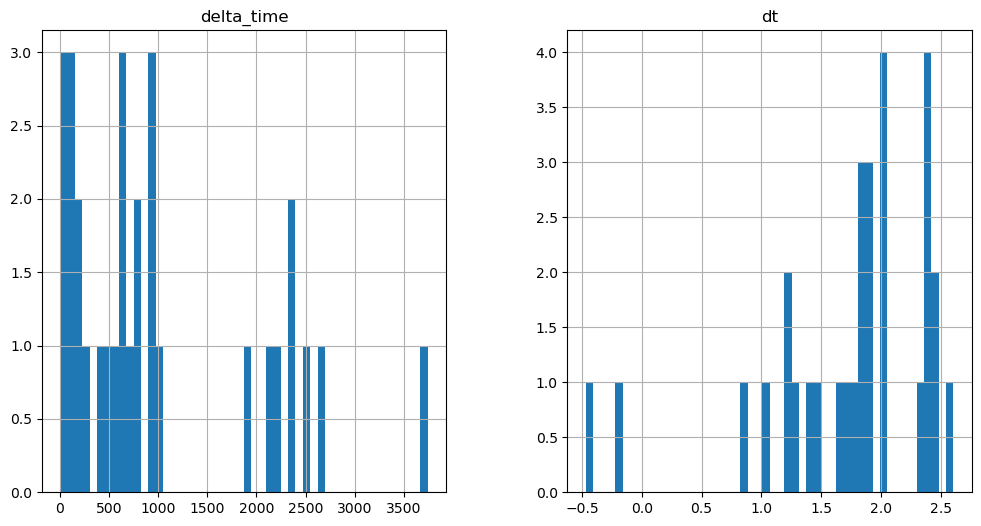

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1011.1912691891193 0.1


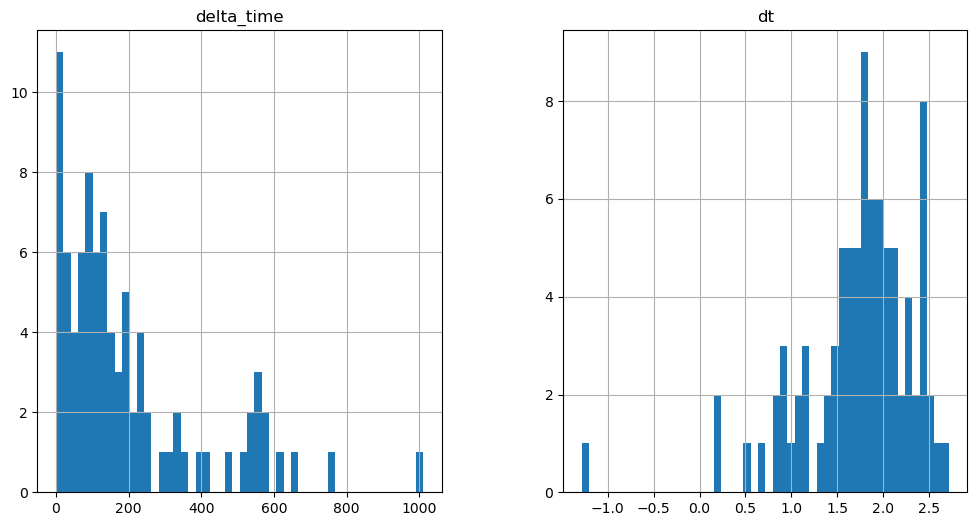

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1652.9088041186333 32.4099712818861


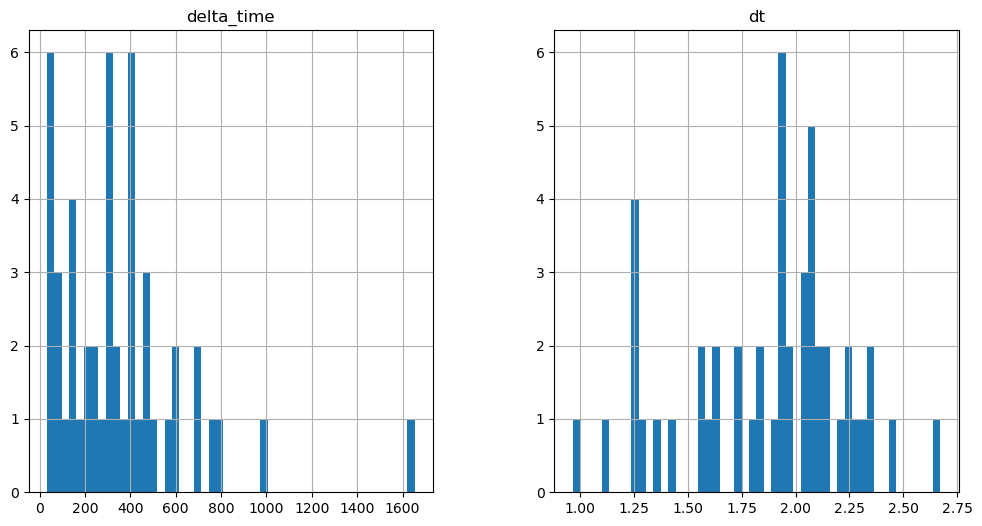

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1238.0610879957676 12.964000478386879


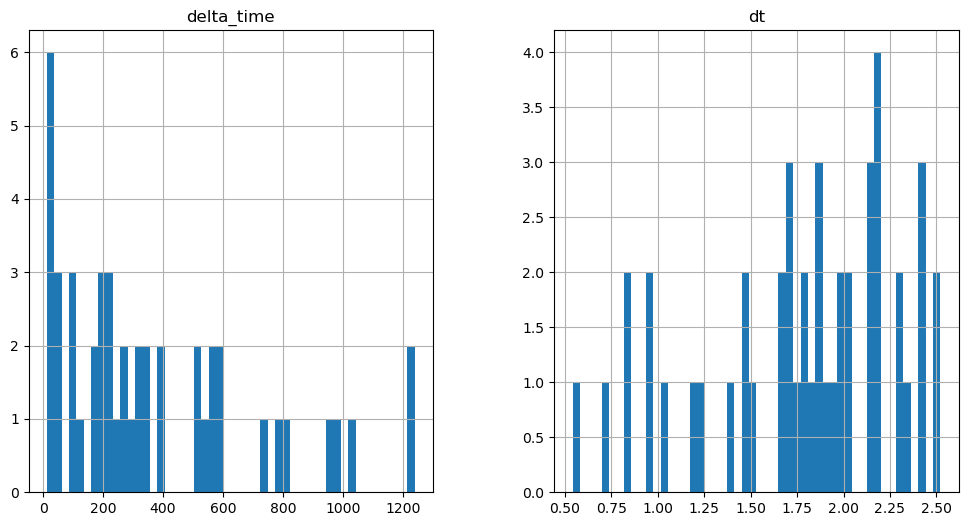

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

113.43489444255829 0.1


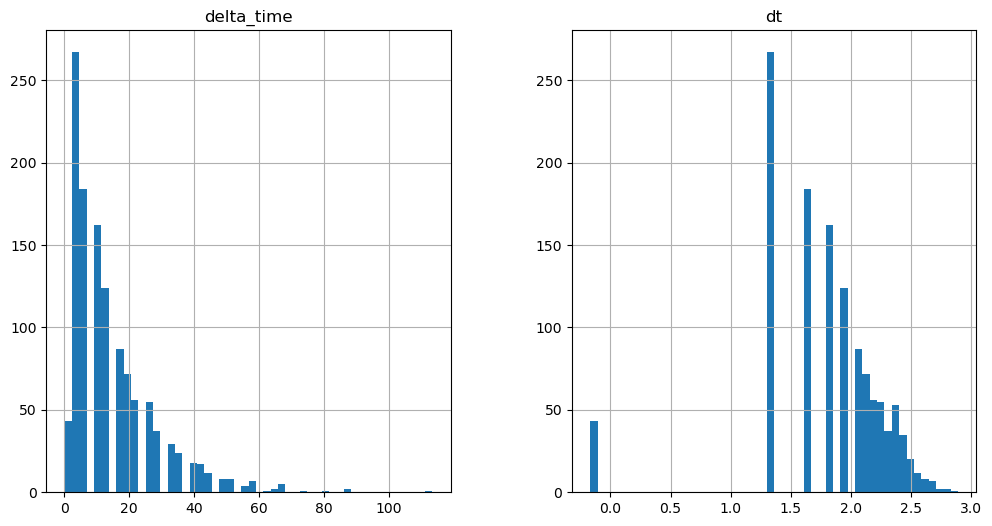

1267.2300491780043 3.2409801483154297


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

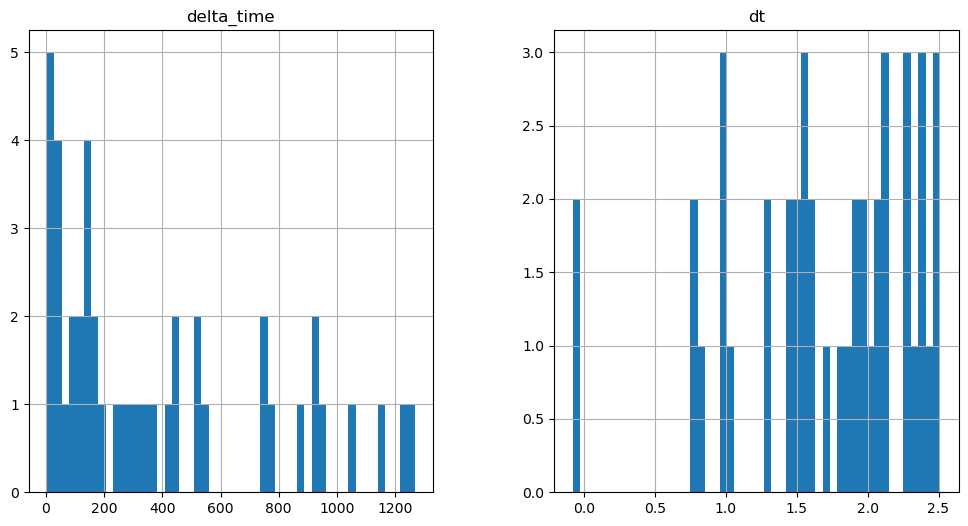

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1503.822718322277 6.482000216841698


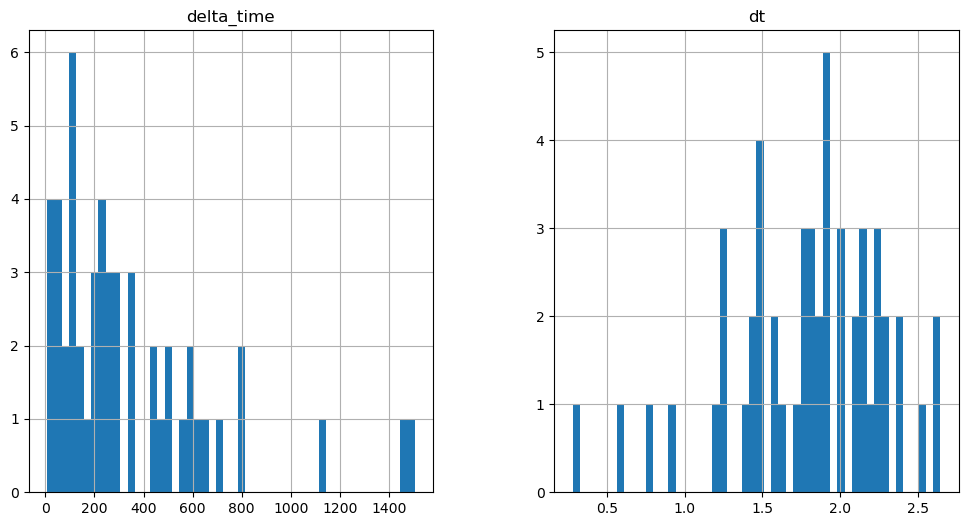

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

681.5969743132591 0.1


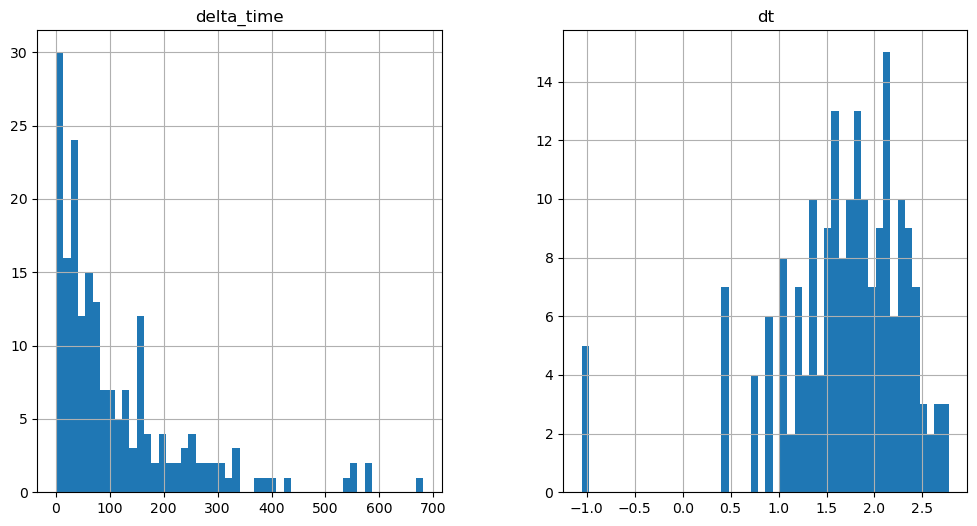

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1740.1139575242996 0.1


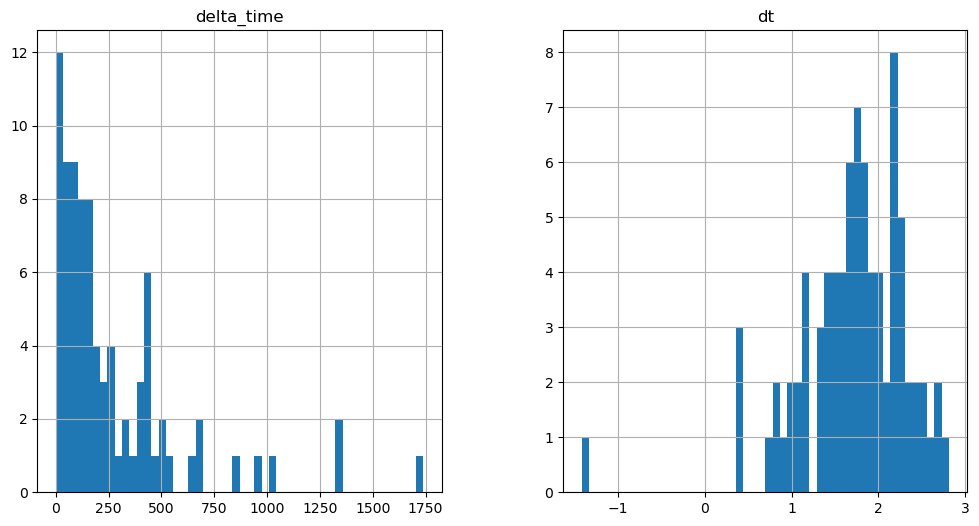

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1372.6169589161873 21.987001061439514


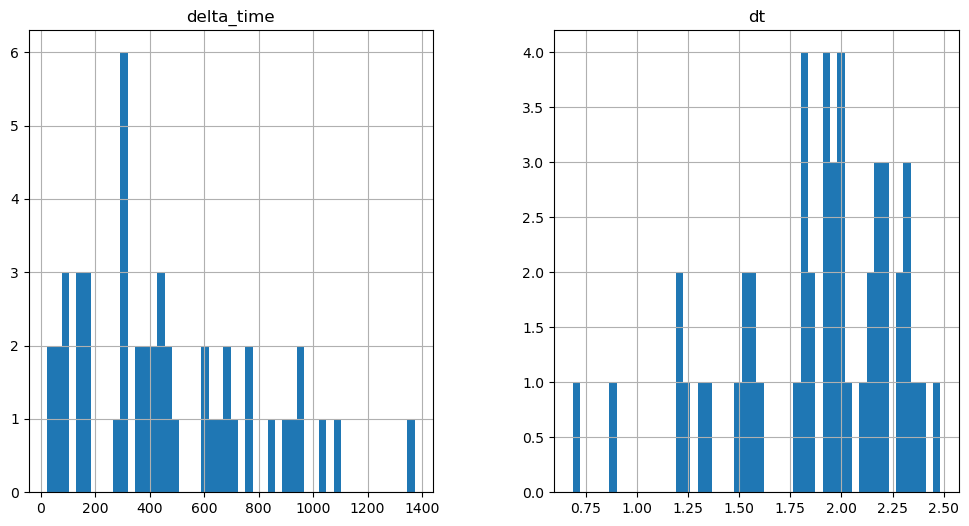

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1733.831577181816 56.537992894649506


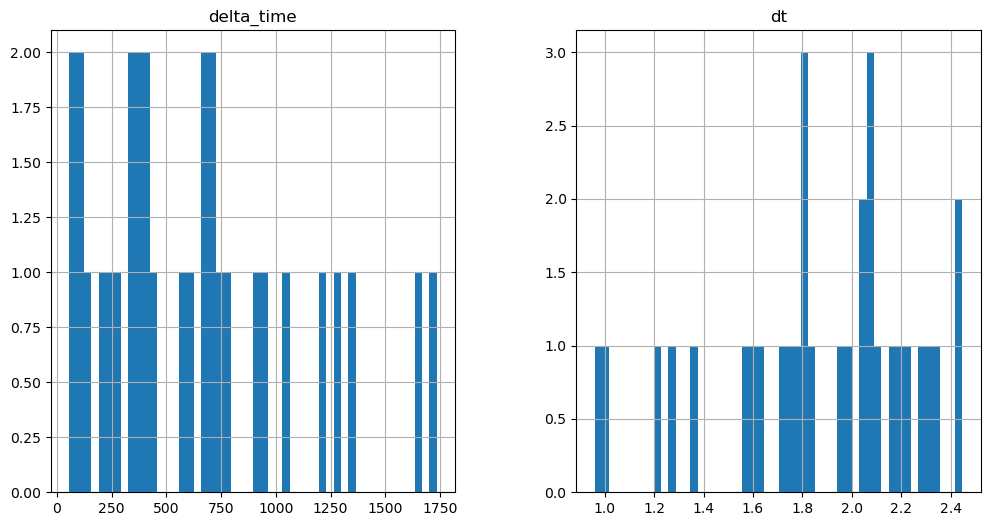

1554.794818162918 12.563990652561188


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

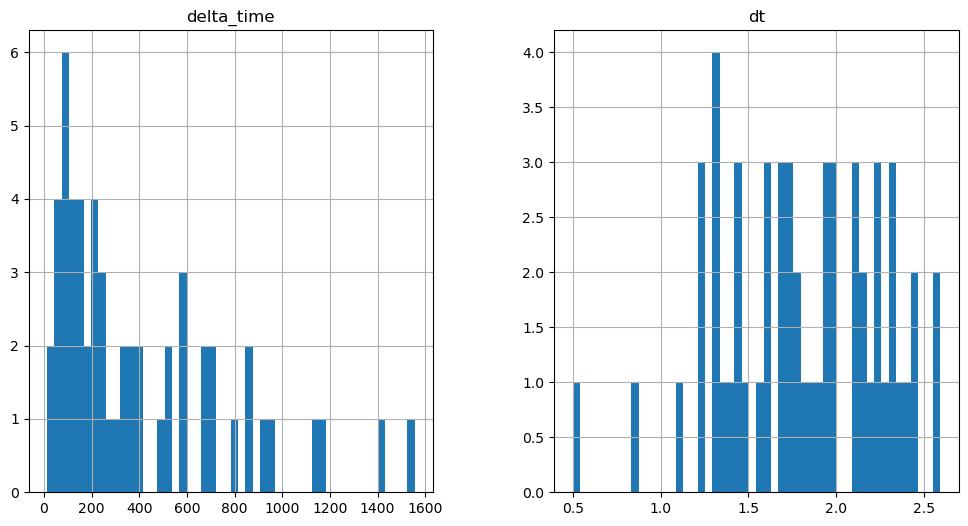

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3995.351990699768 47.115022242069244


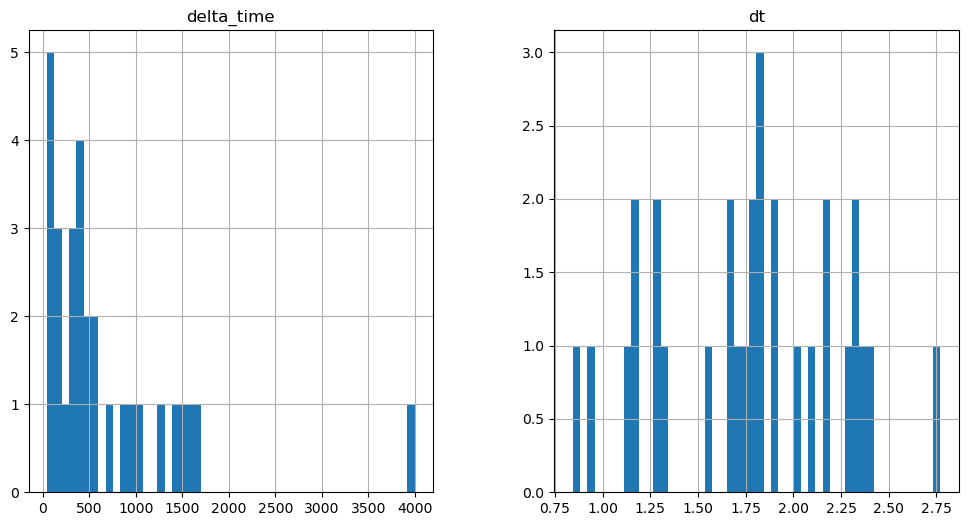

753.8397778868675 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

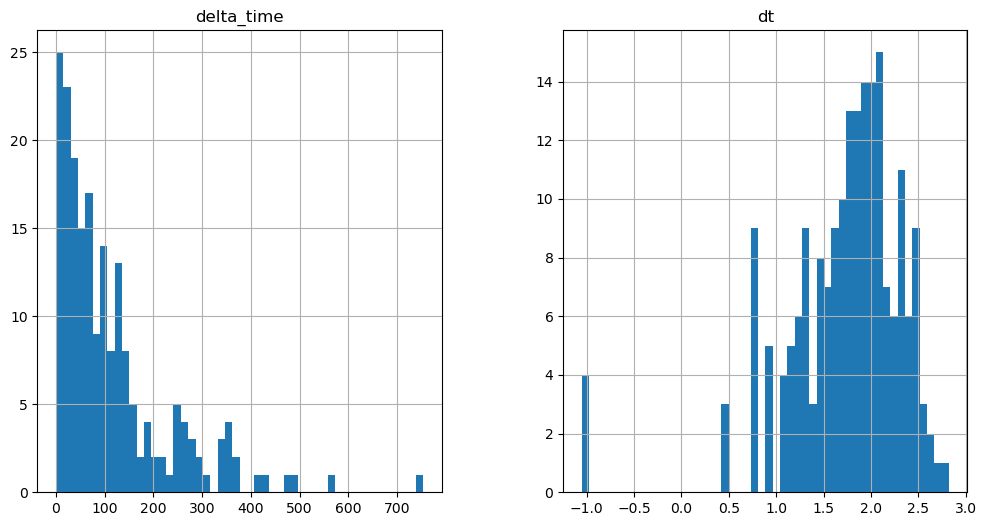

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3885.416965186596 3.140990197658539


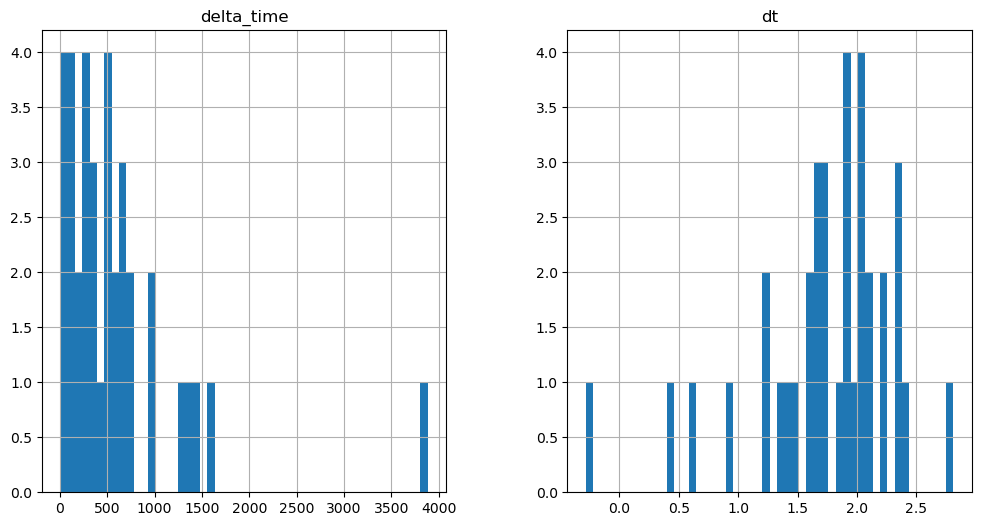

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2958.8222286105156 65.96102333068848


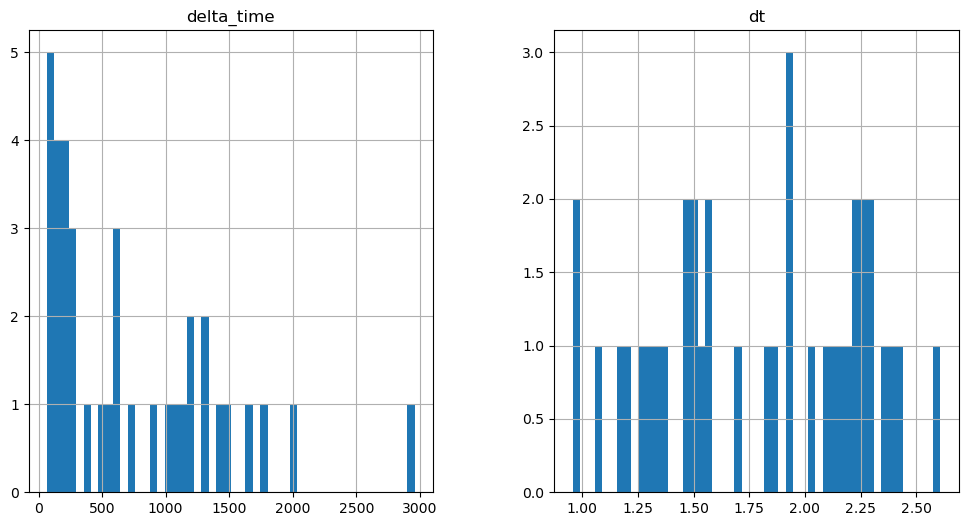

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2110.752246081829 3.1409903168678284


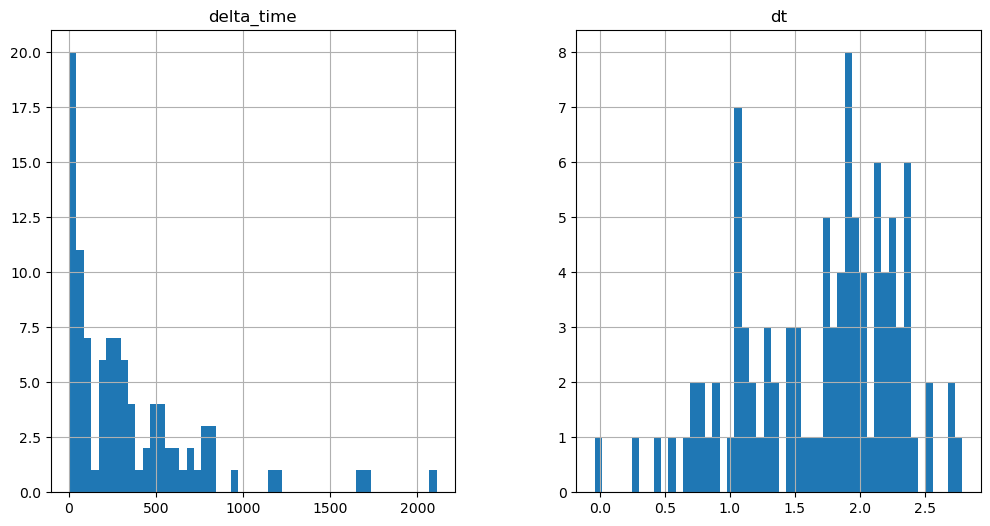

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3791.1873803138733 3.140990197658539


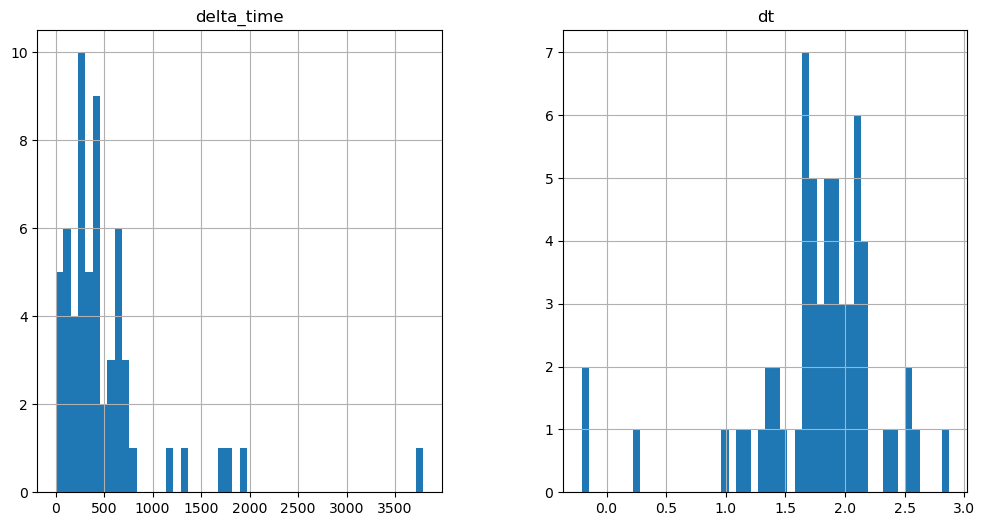

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2858.310843706131 21.986991107463837


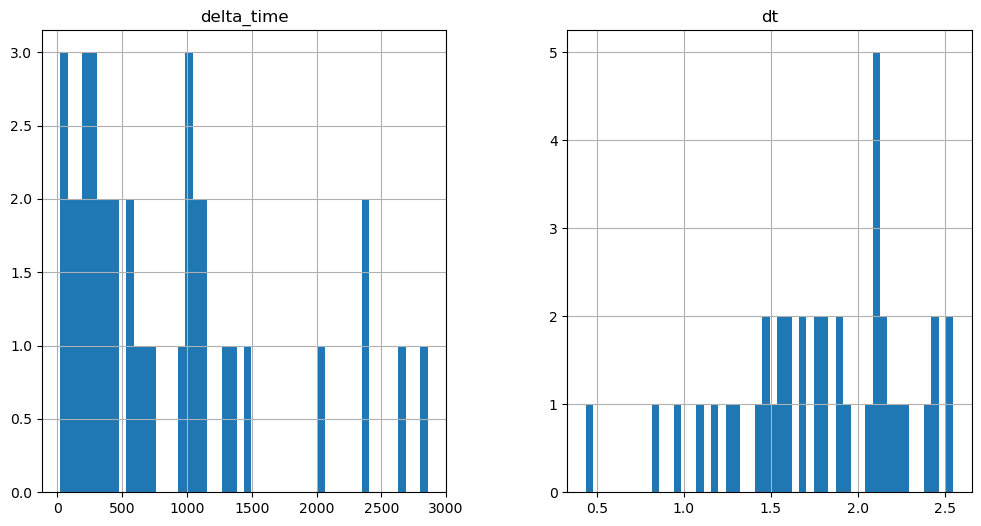

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

898.3260351419449 0.1


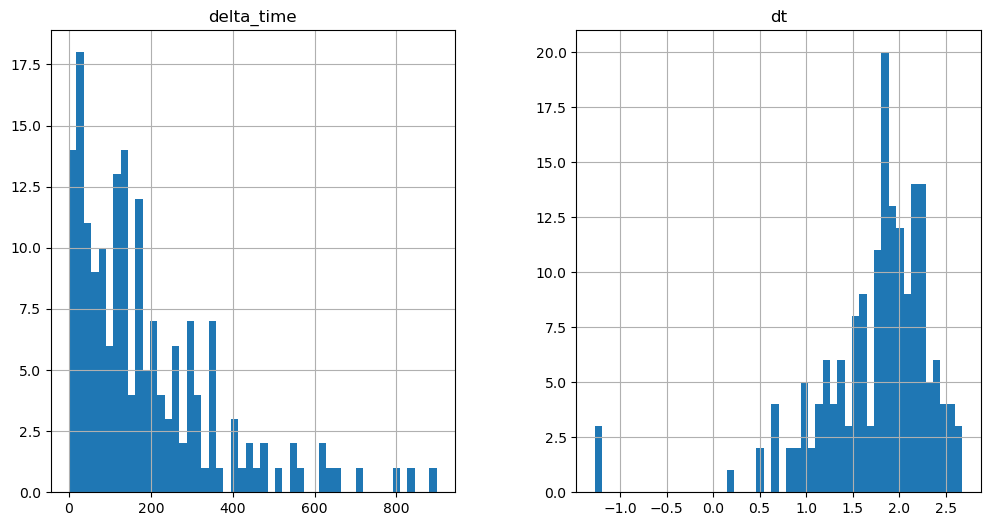

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3049.9110630750656 0.1


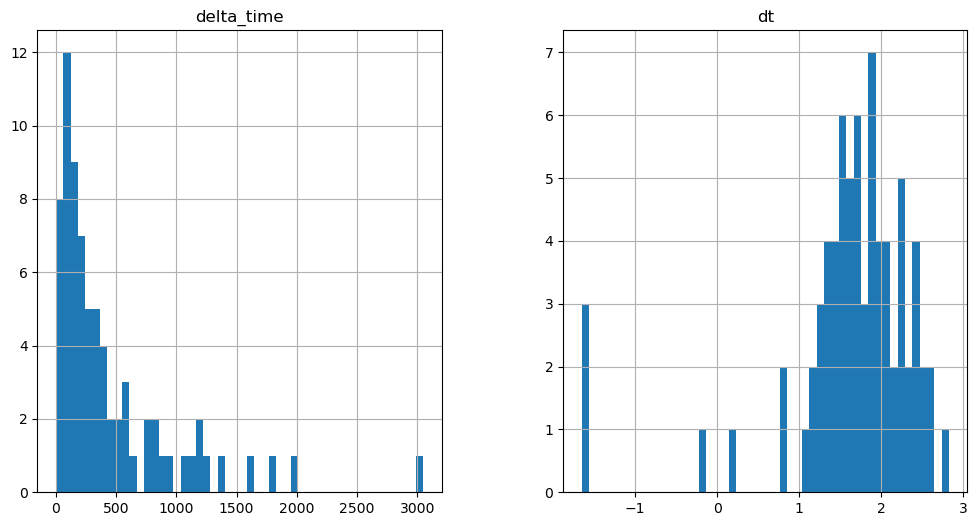

1765.2419987916946 9.422970652580261


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

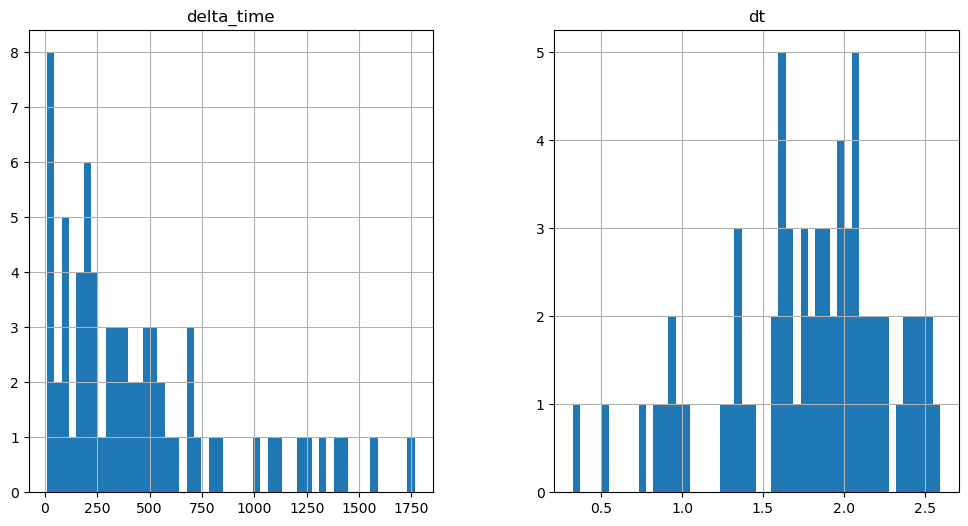

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2874.015644311905 31.410001516342163


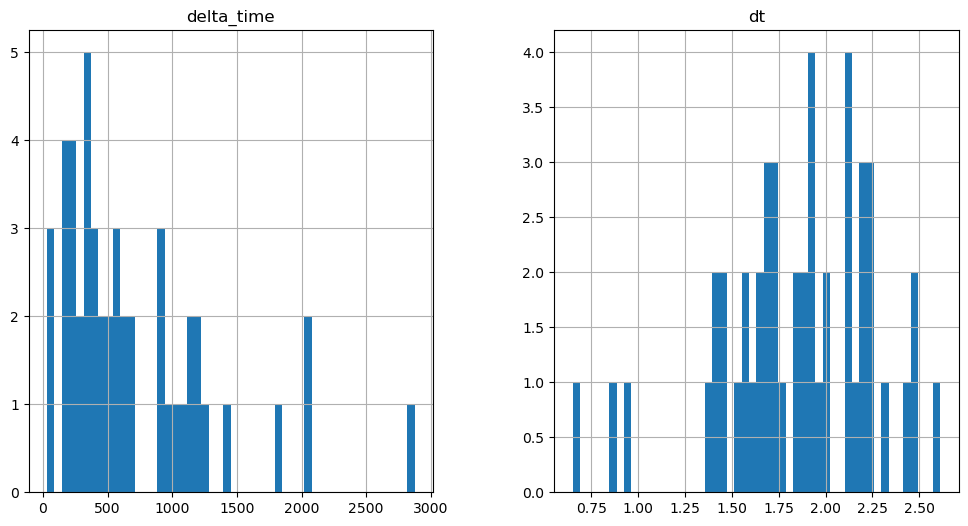

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3081.3211352825165 0.1


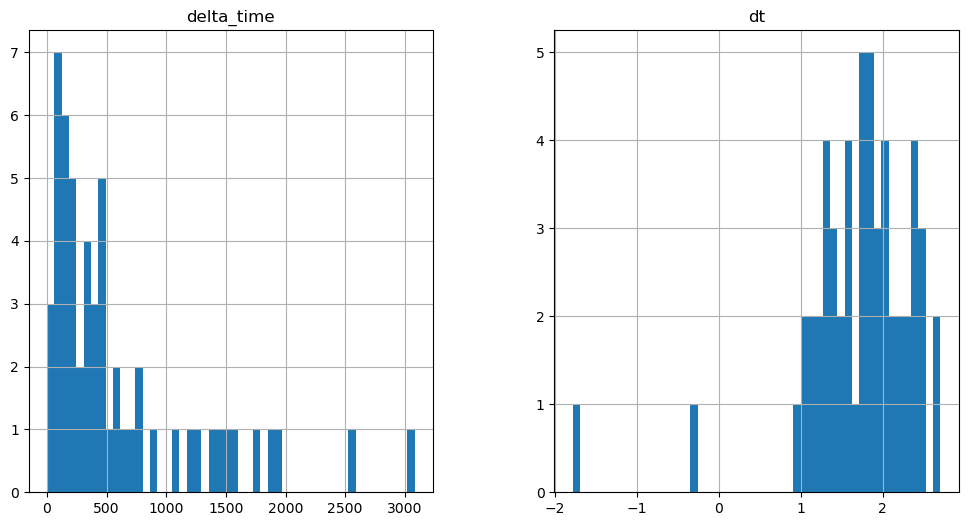

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1265.8231737613678 3.140990138053894


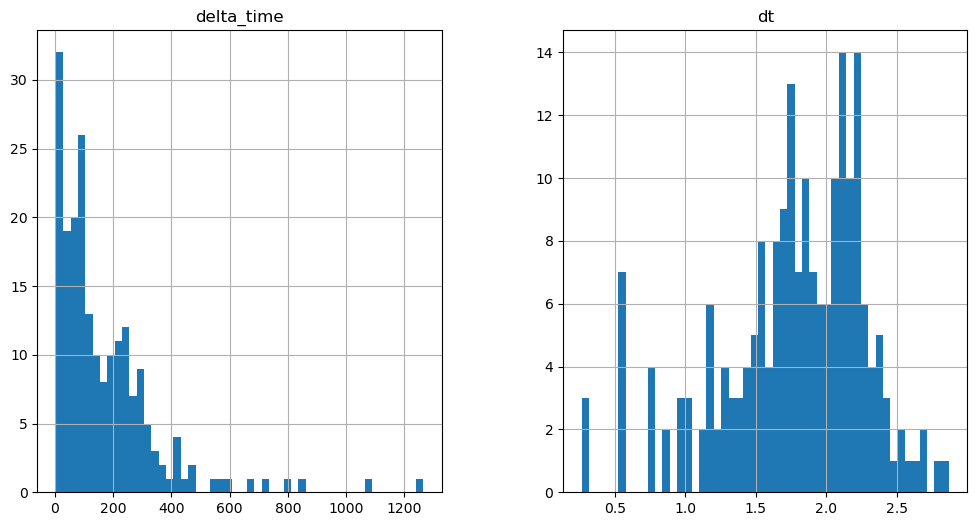

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1005.1200805902481 0.1


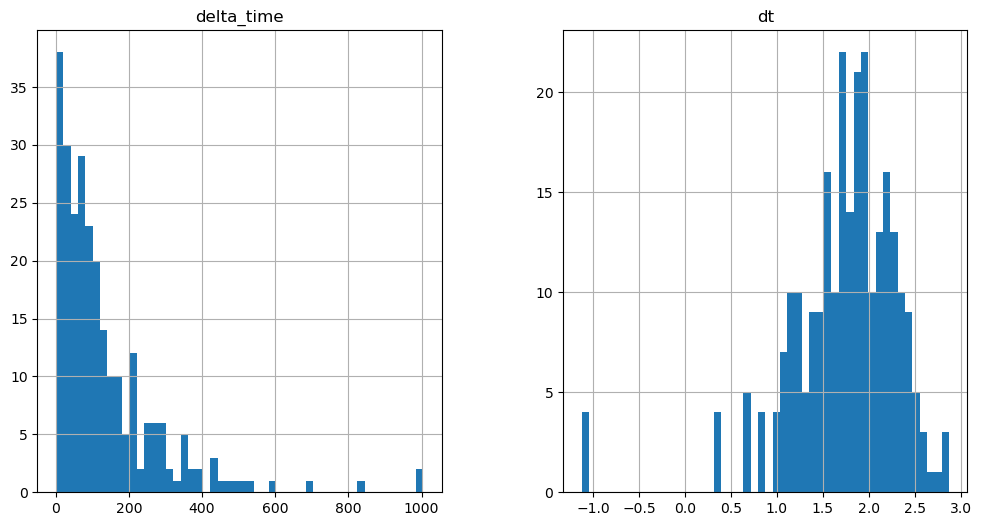

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3188.115120589733 72.24299371242523


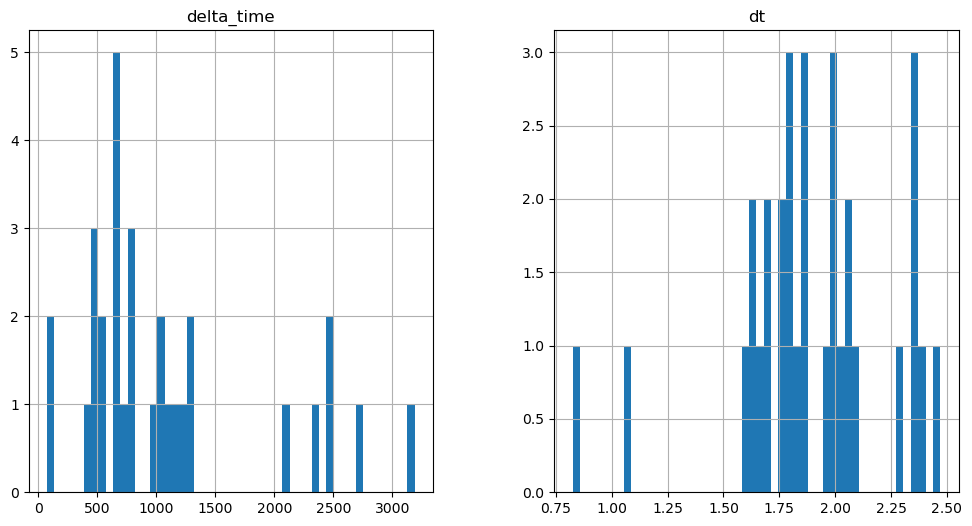

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1237.55430239439 3.1409902572631836


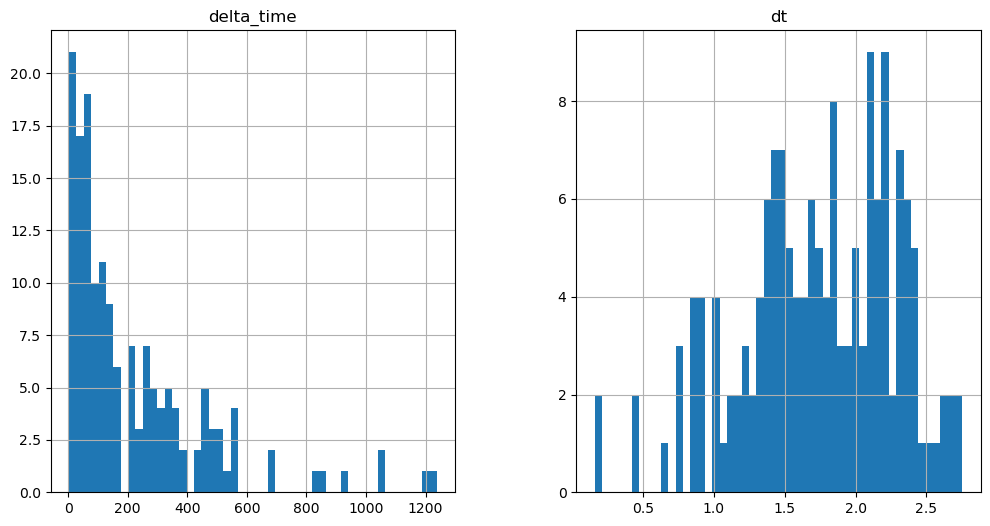

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2531.6461375951767 0.1


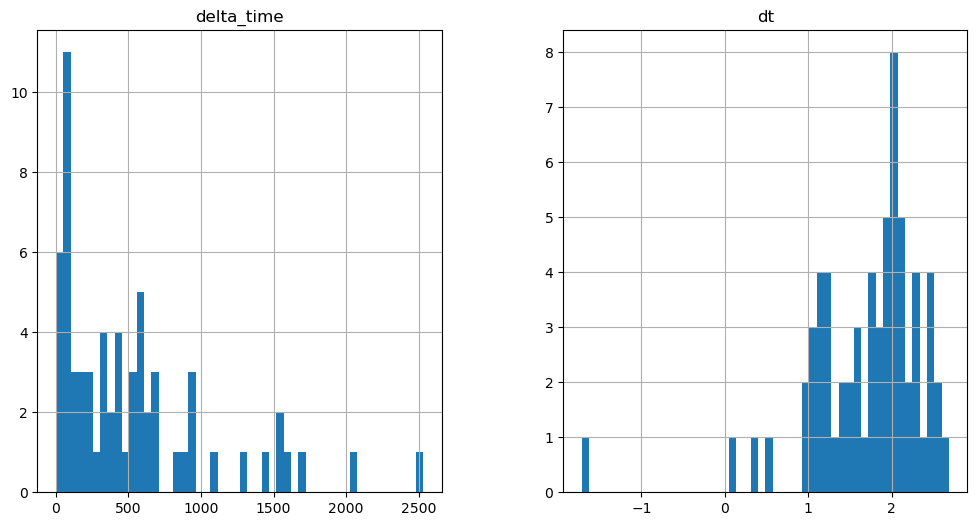

2842.6051630973816 21.986991107463837


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

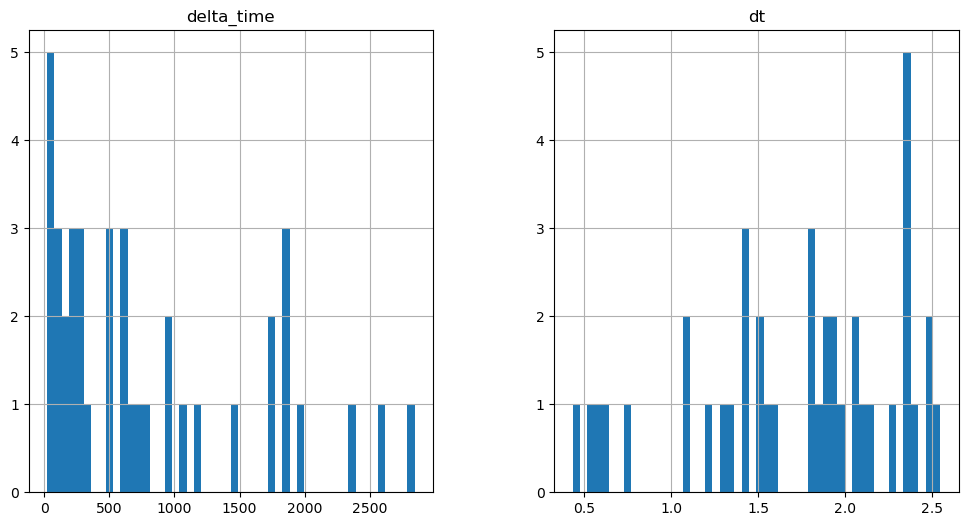

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4409.9660621881485 28.26899141073227


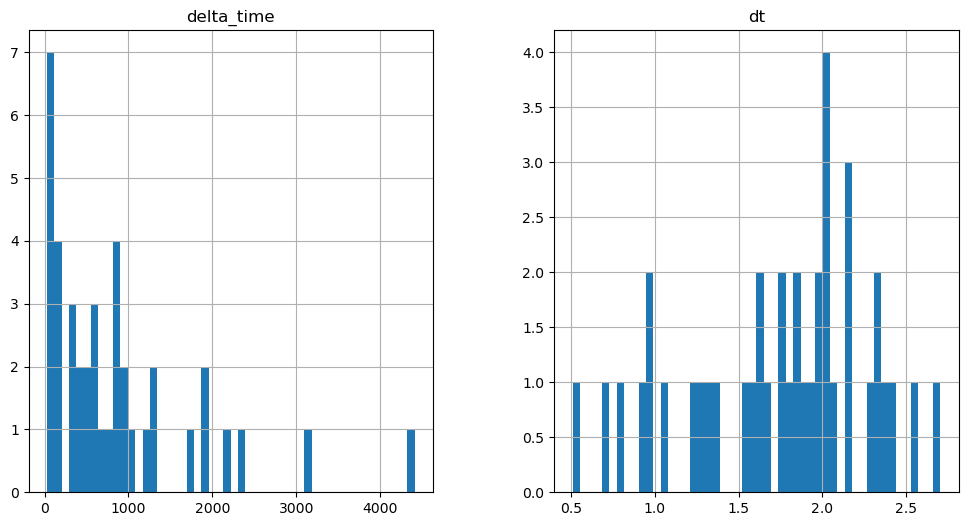

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3894.840286195278 25.12798136472702


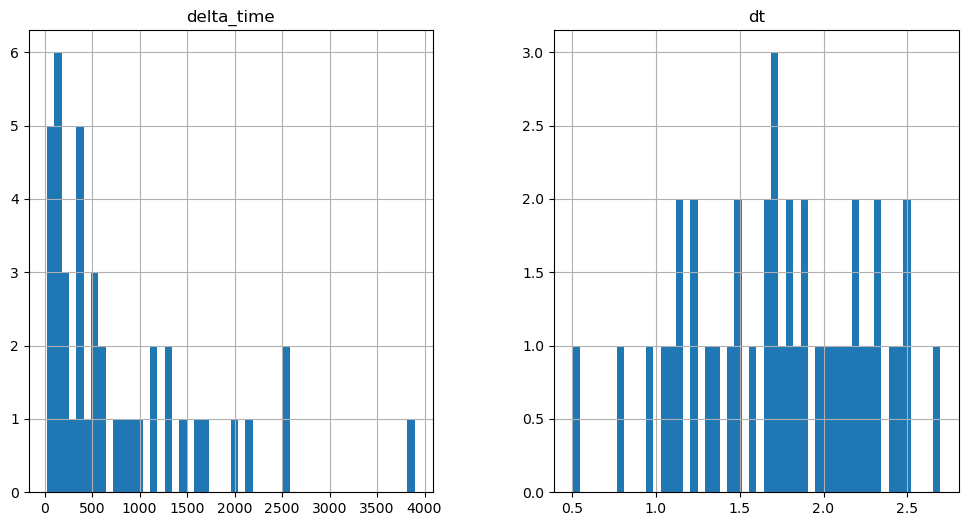

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2380.8780700564384 9.422990500926971


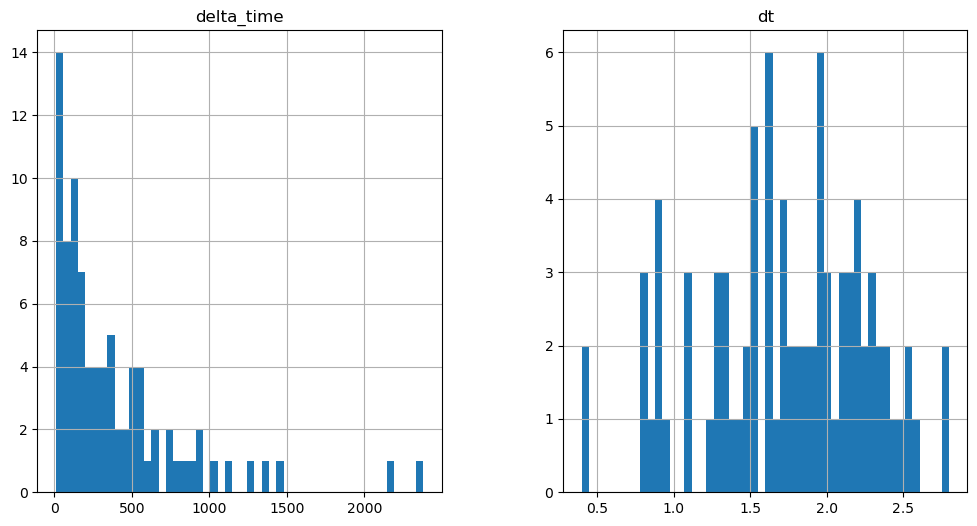

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

361.21505814790726 0.1


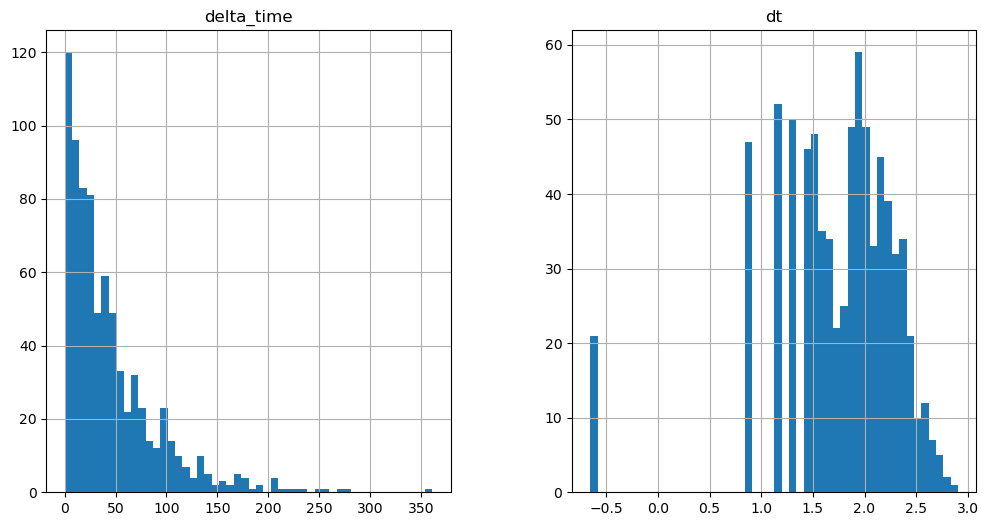

3411.127131998539 9.423020362854004


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

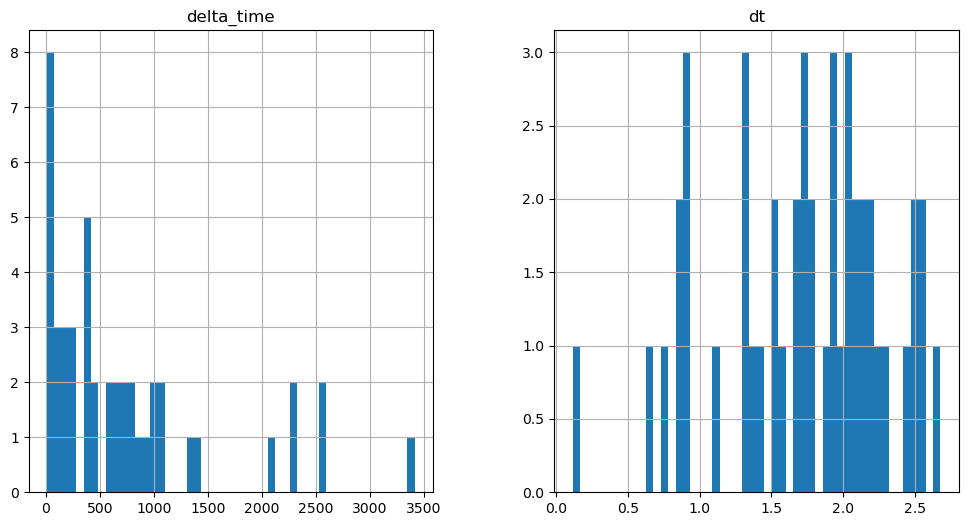

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1542.2311975955963 0.1


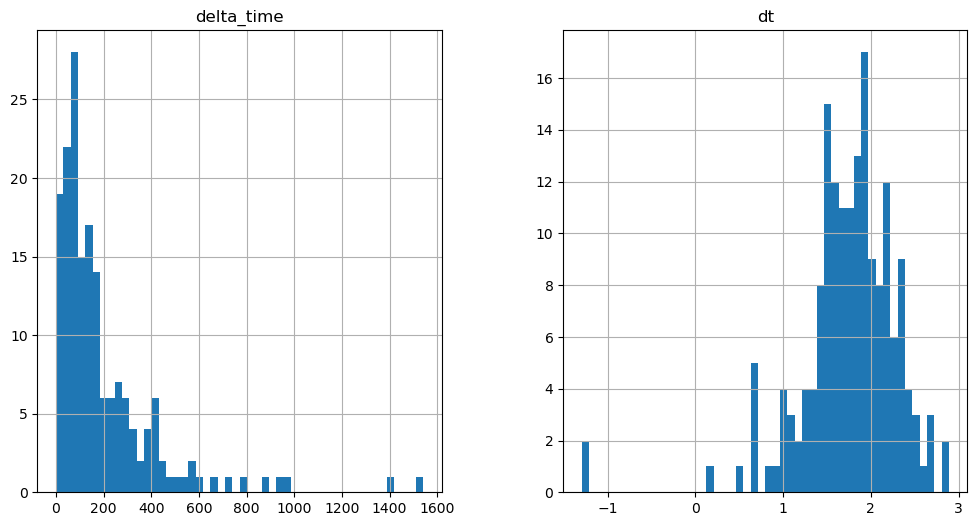

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2669.8504245877266 3.141010046005249


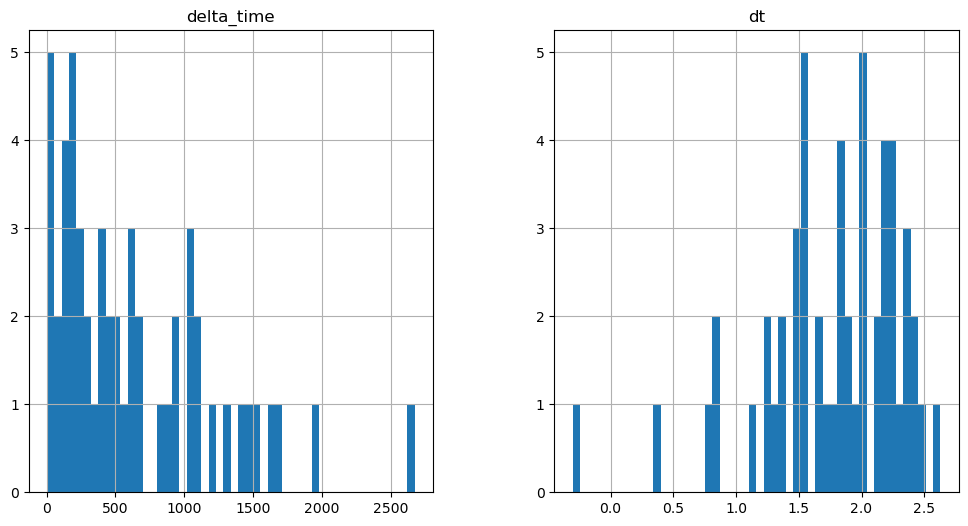

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4730.347928285599 15.705030798912048


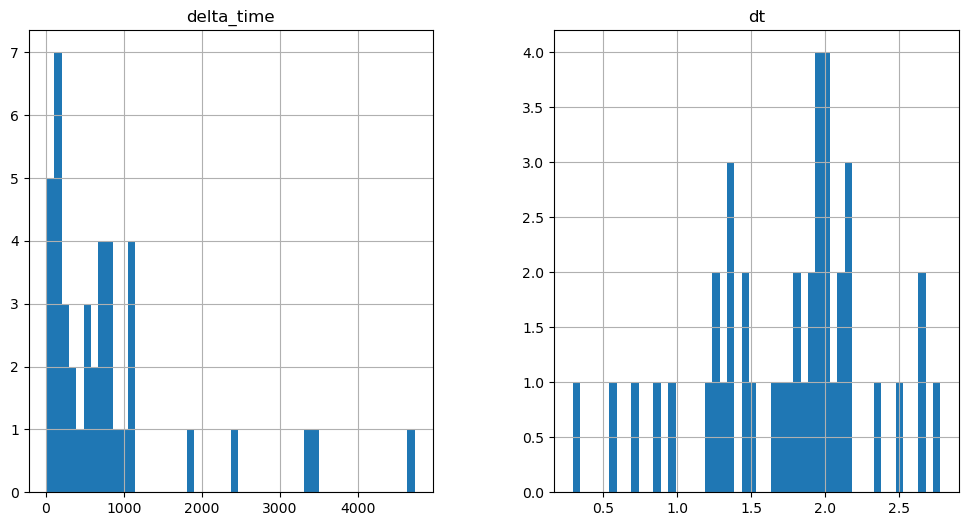

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2032.2270823717117 12.563980638980865


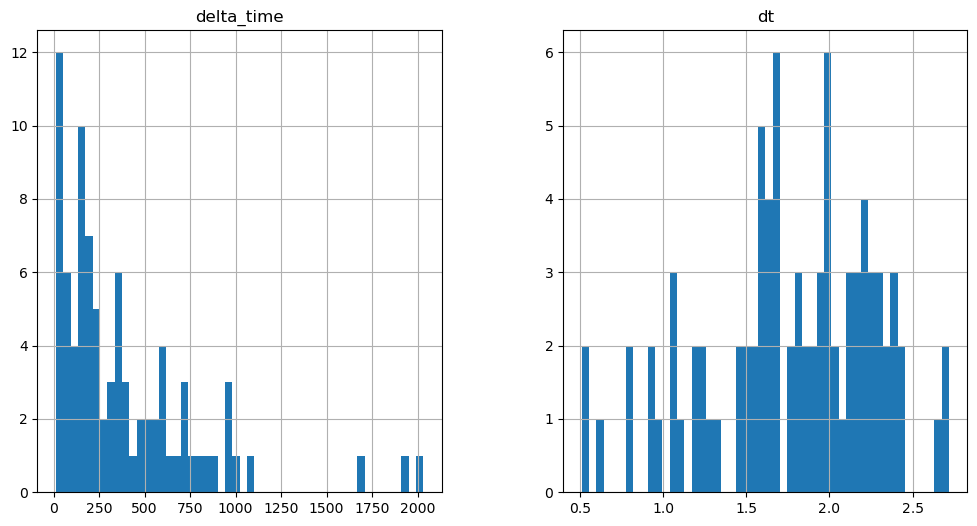

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

797.8139500617981 3.140990197658539


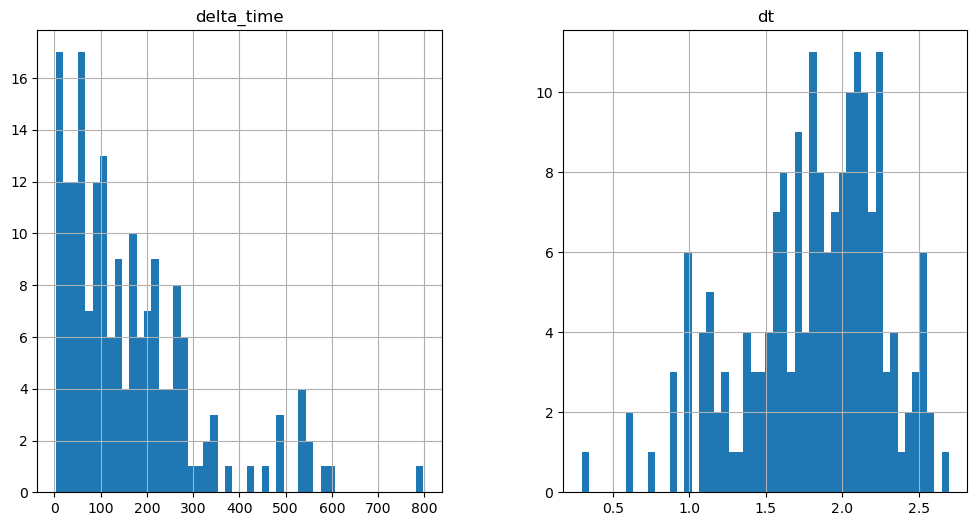

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2874.0157447457314 18.846000909805298


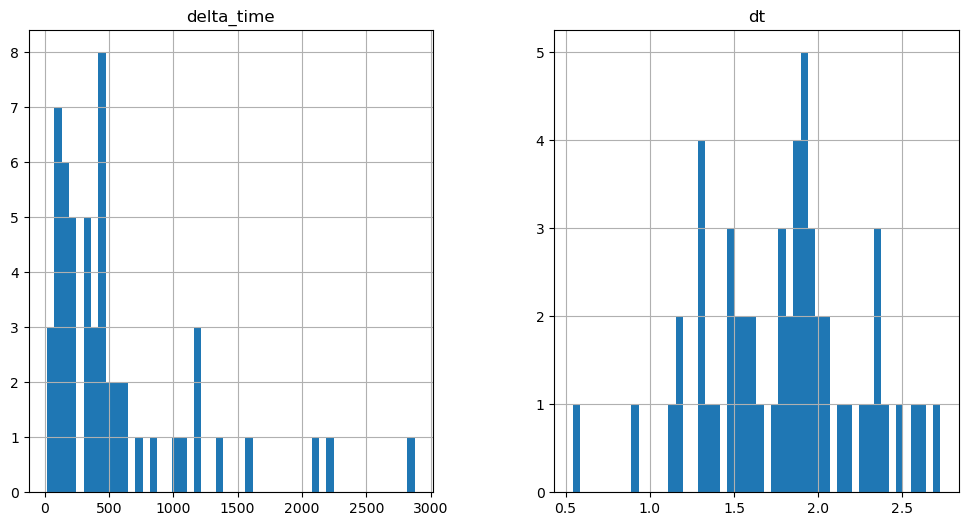

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1130.7650971412659 6.28203022480011


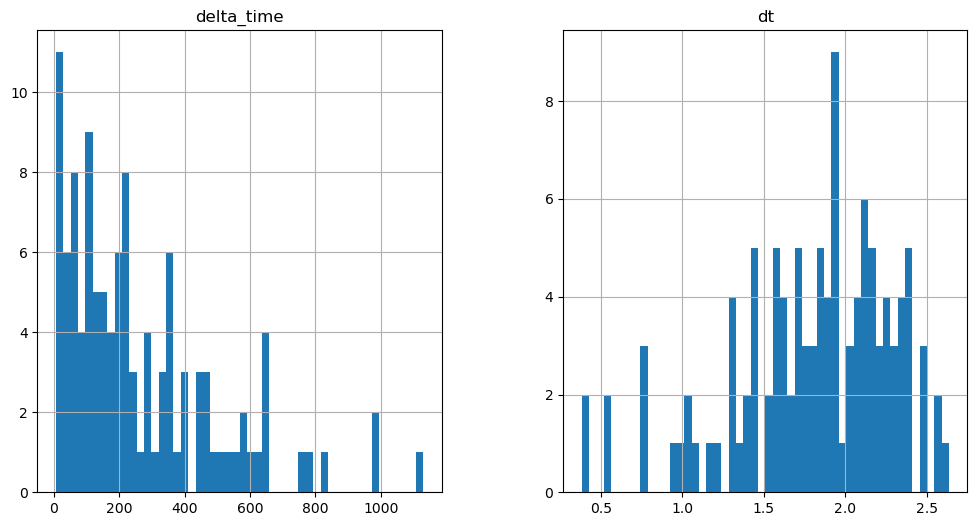

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4089.5832459926605 31.409981667995453


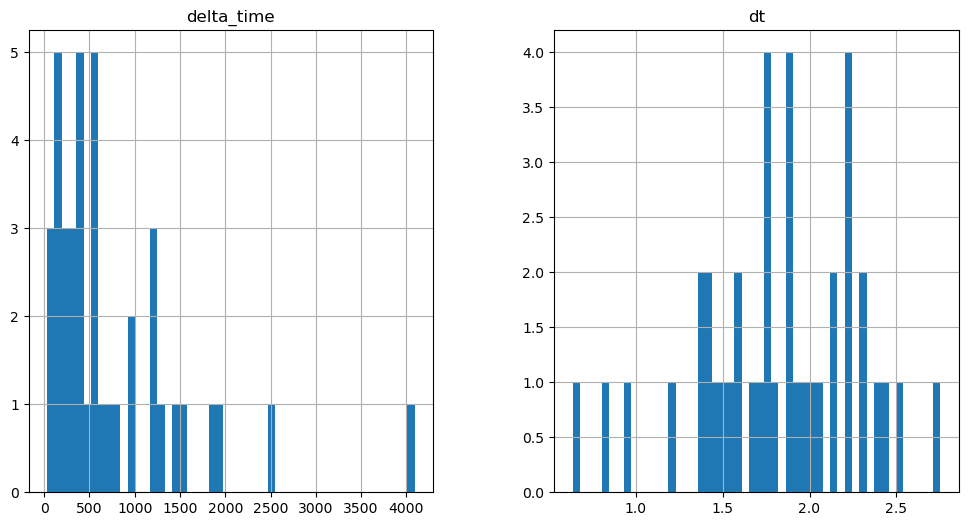

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1799.7930204868317 169.61531859636307


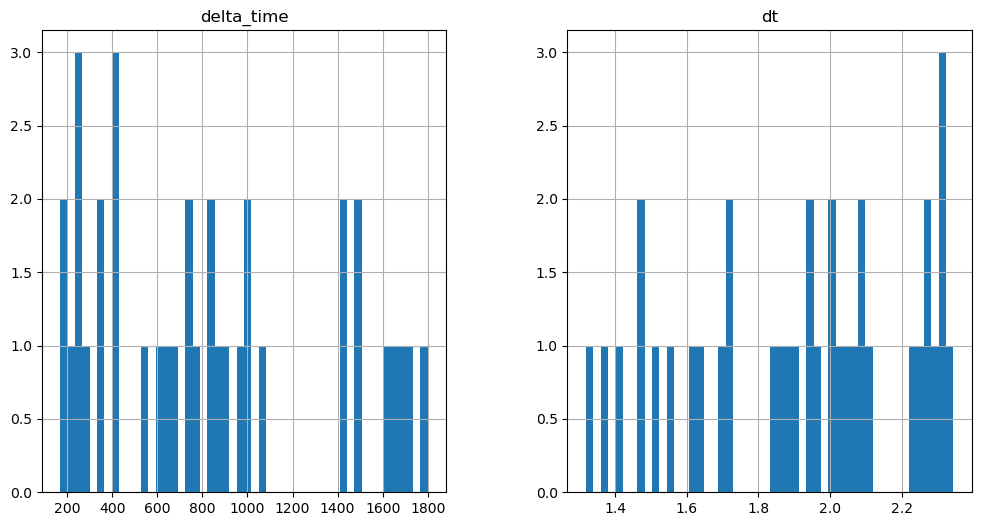

1821.7821217775345 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

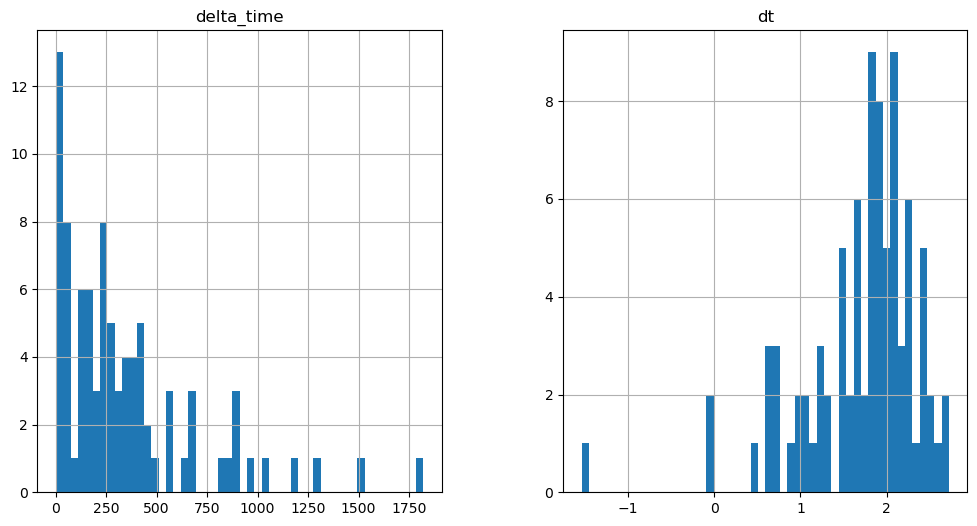

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

533.9703569412231 0.1


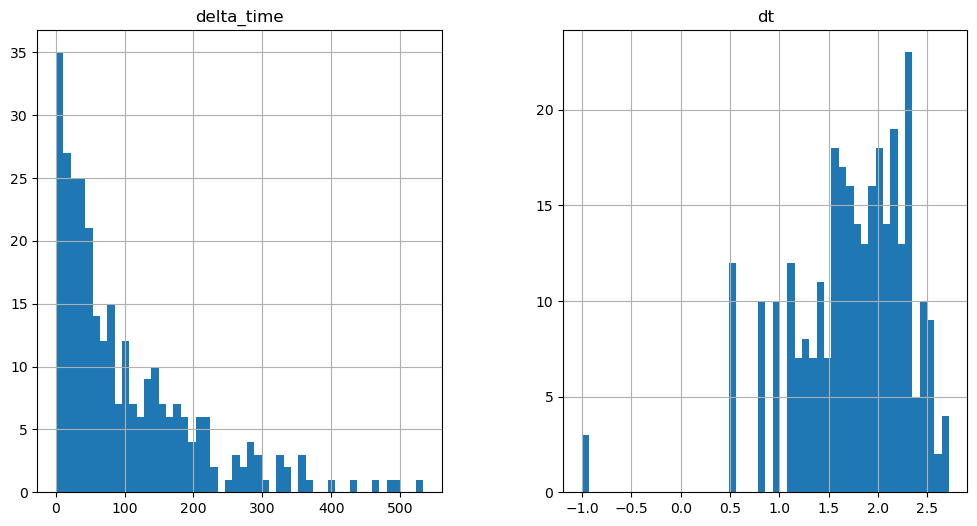

1790.3735801577568 6.281980395317078


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

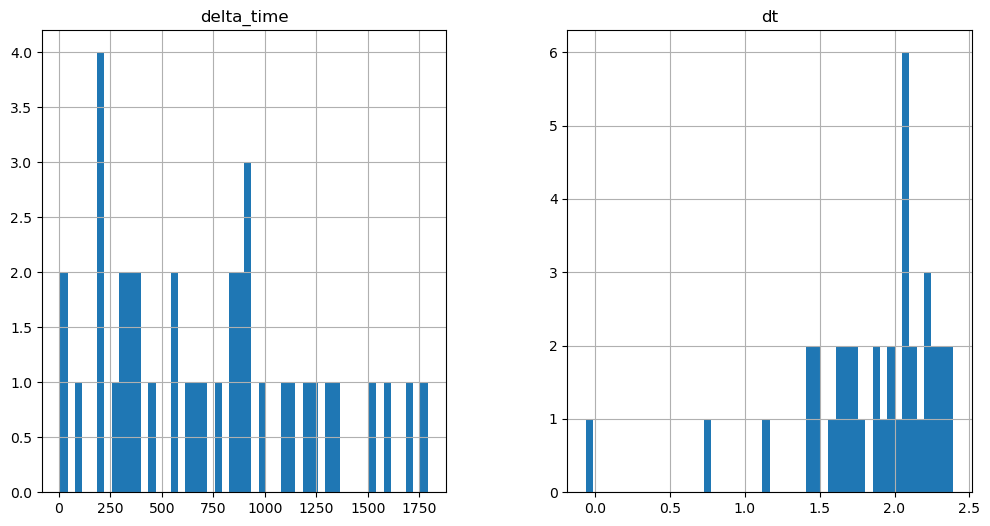

2336.903977751732 15.705090820789337


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

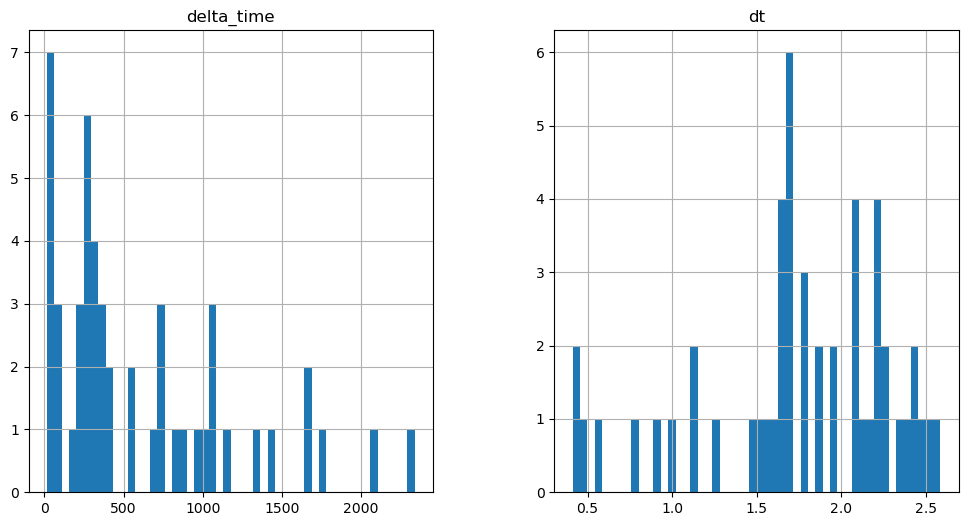

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1306.6687856912613 0.1


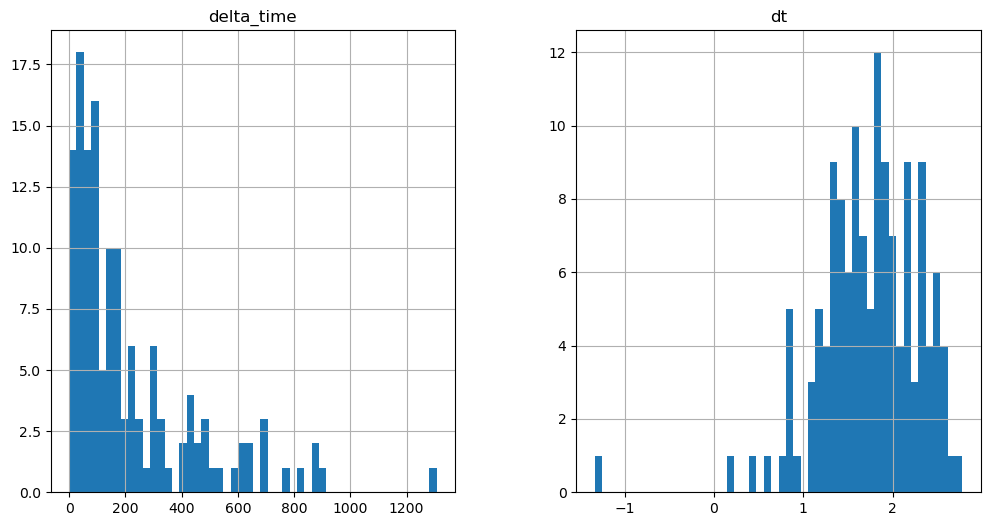

1152.7472180128098 6.282000303268433


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

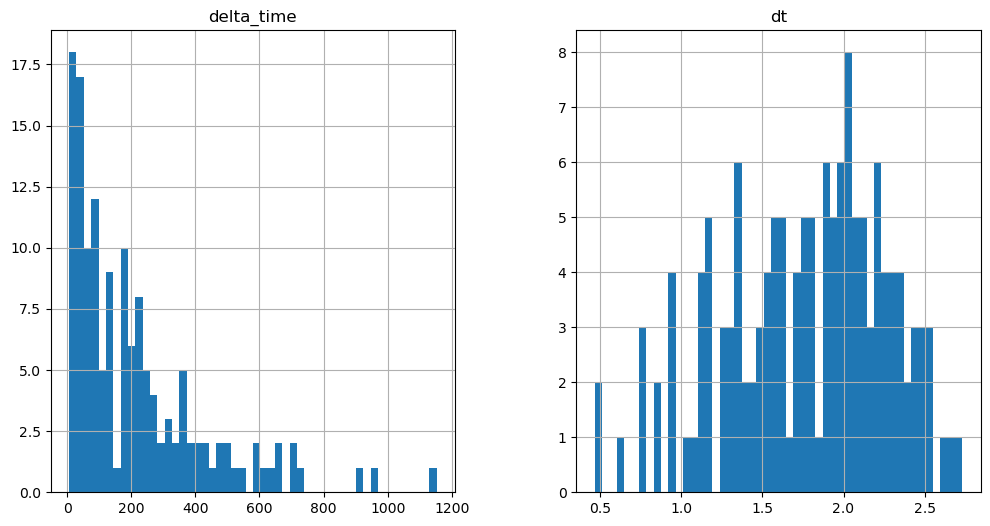

986.2739696502686 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

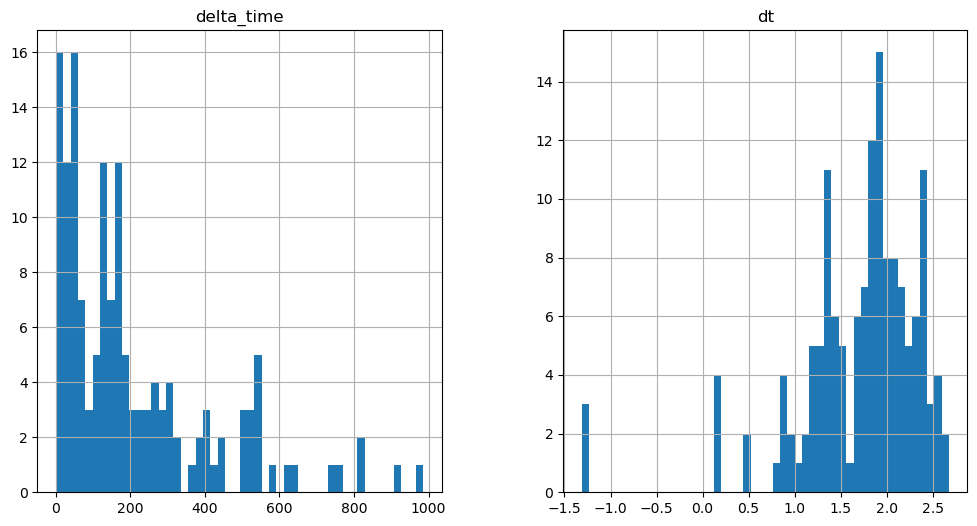

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1520.2449764609337 3.141010344028473


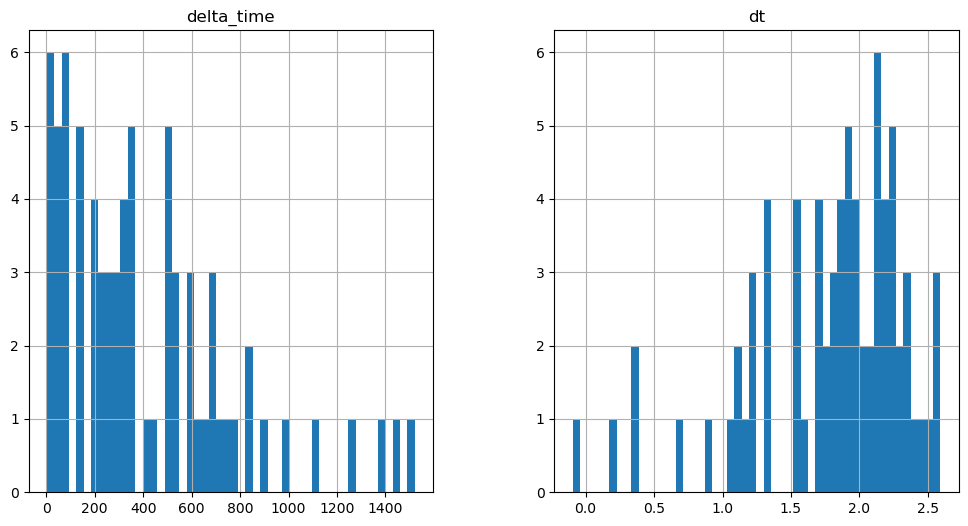

2657.2858137488365 37.69201177358627


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

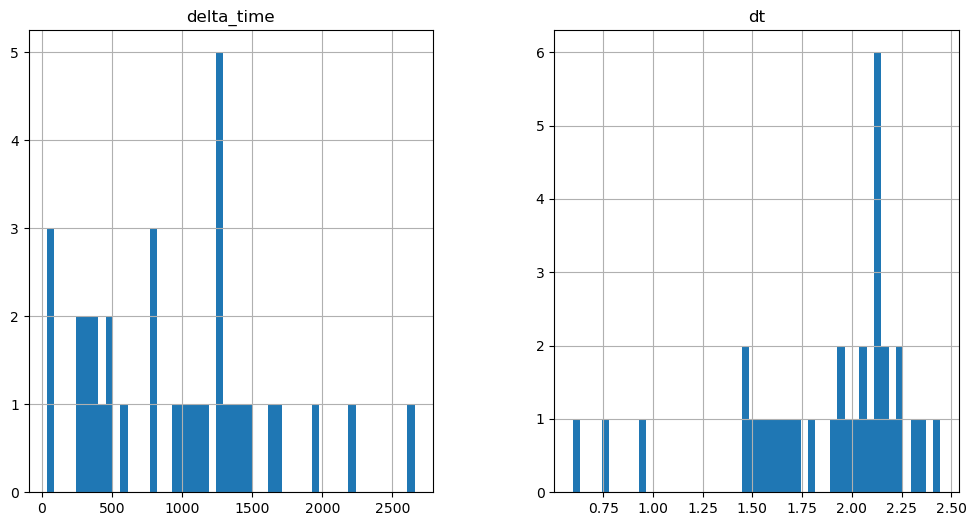

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

6219.179672956467 6.282000303268433


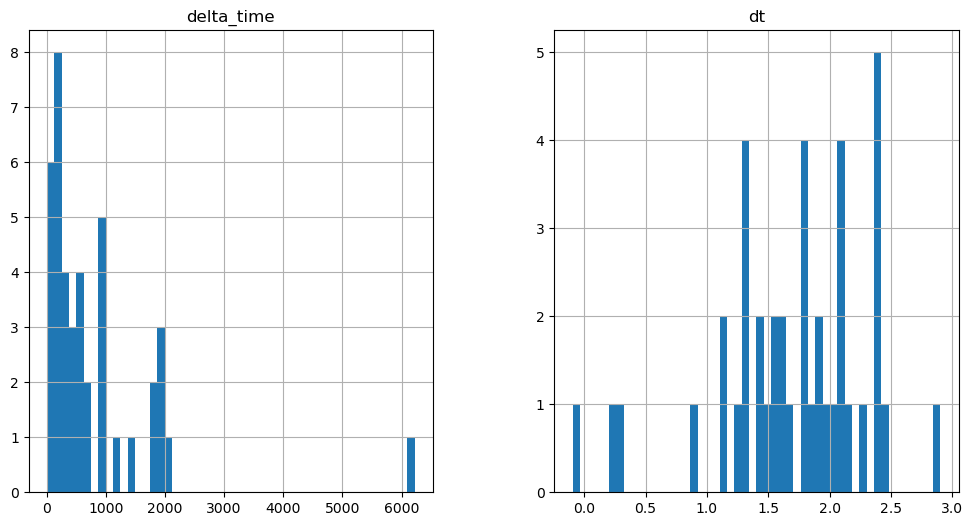

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4661.243734538555 3.1410200595855713


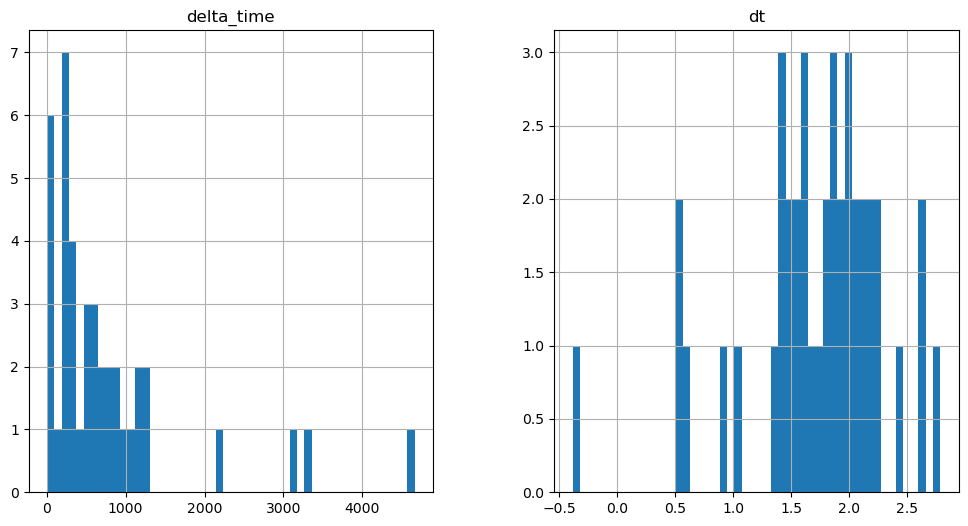

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5345.98174905777 18.846000969409943


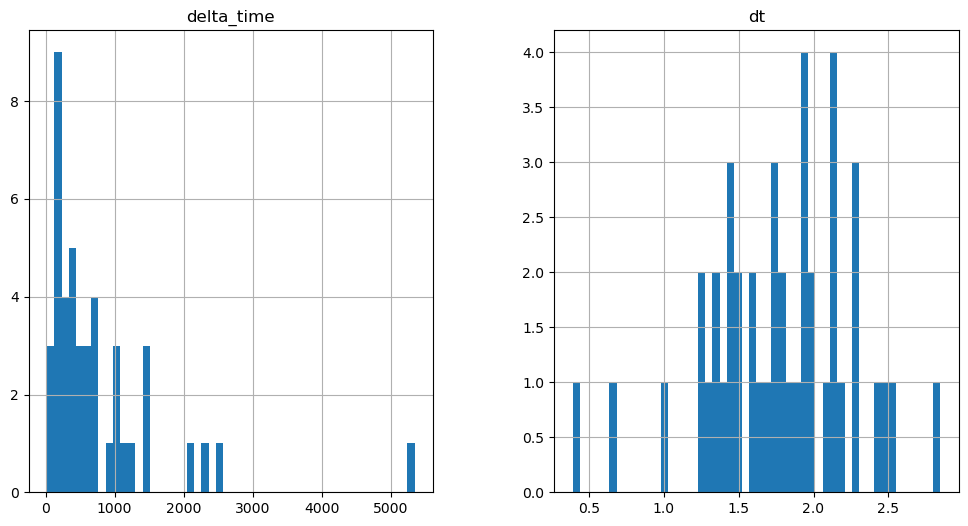

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3392.2798807024956 12.56398069858551


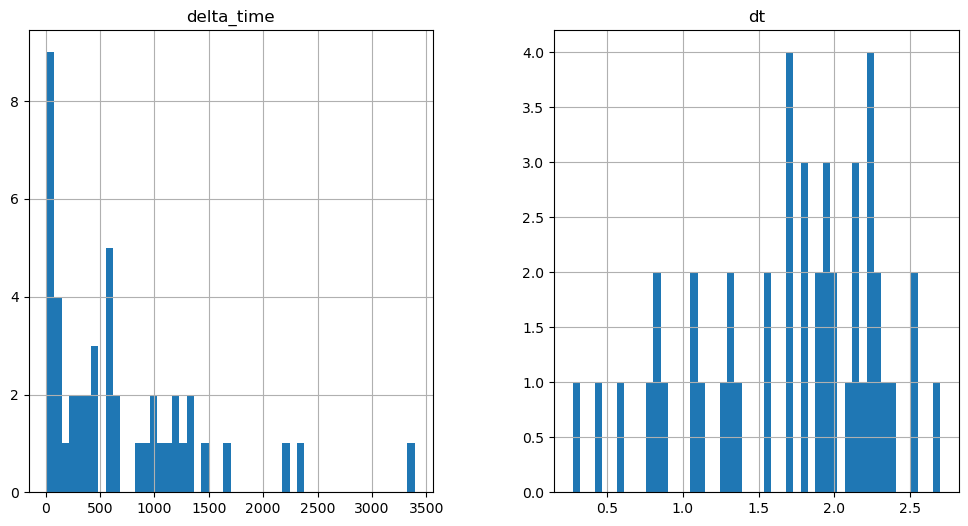

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1576.7818794846535 0.1


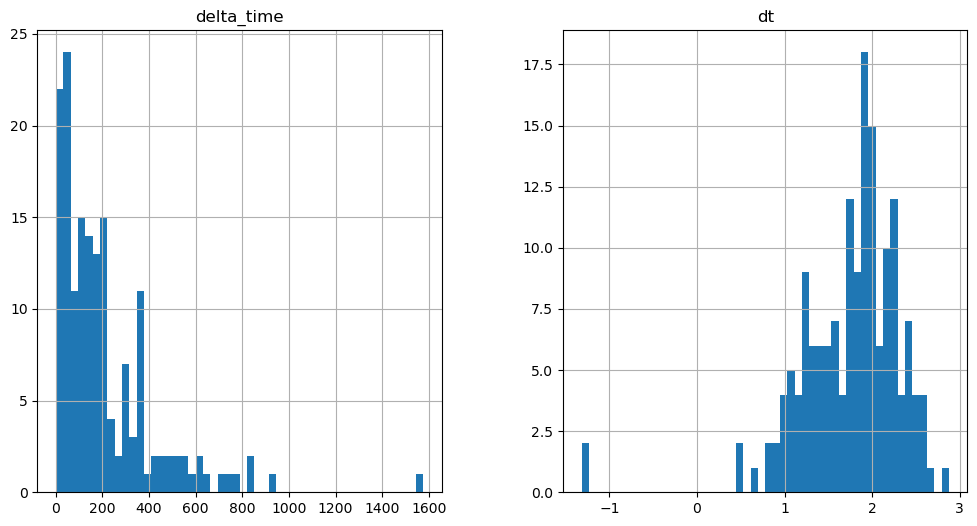

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1353.770968079567 6.282000303268433


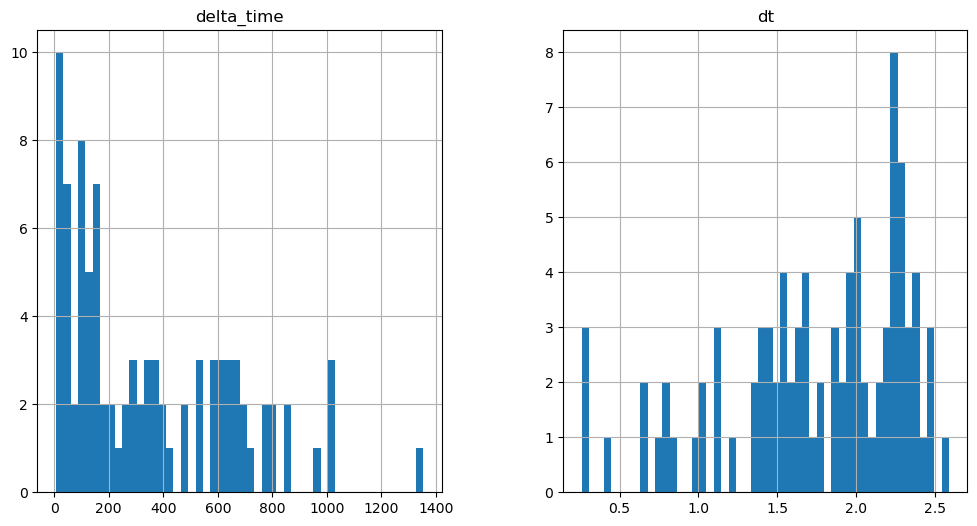

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3483.368835270405 21.987011075019836


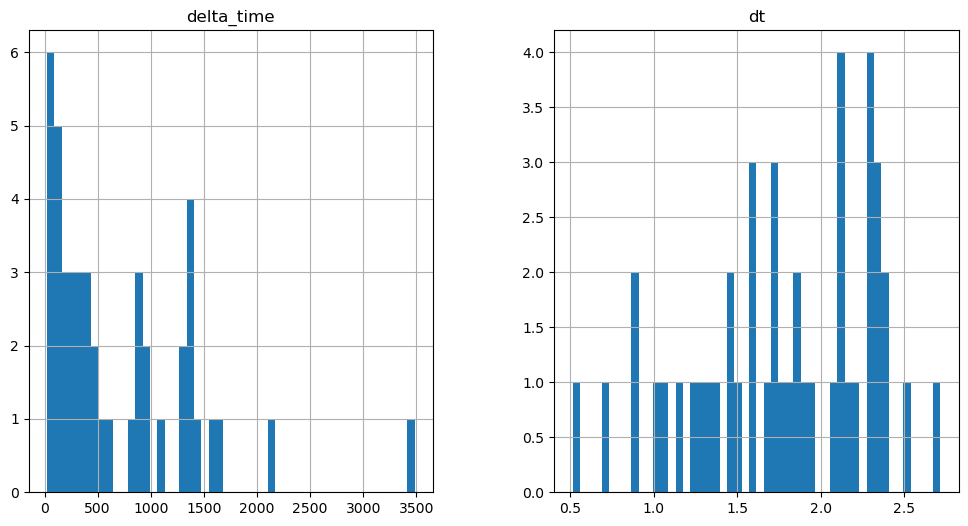

3662.405744433403 3.140990197658539


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

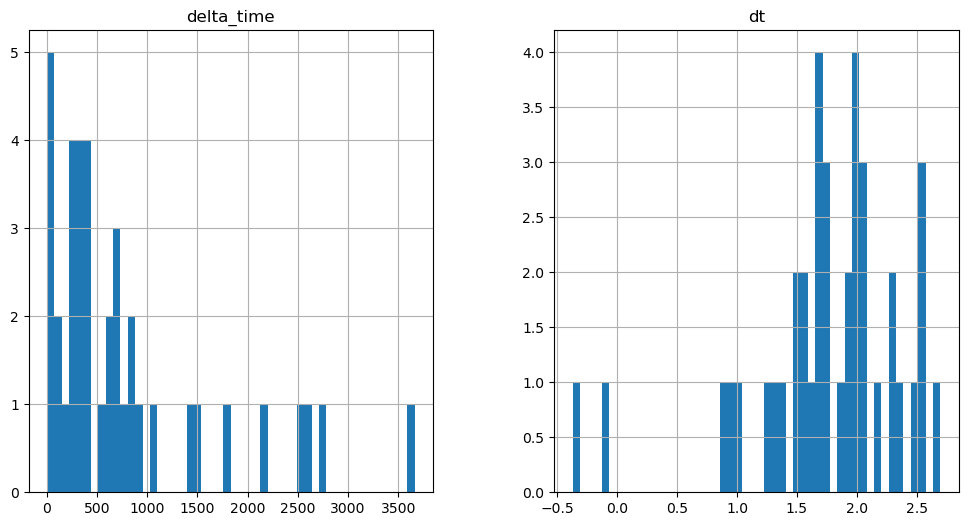

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

681.5970042347908 3.140990138053894


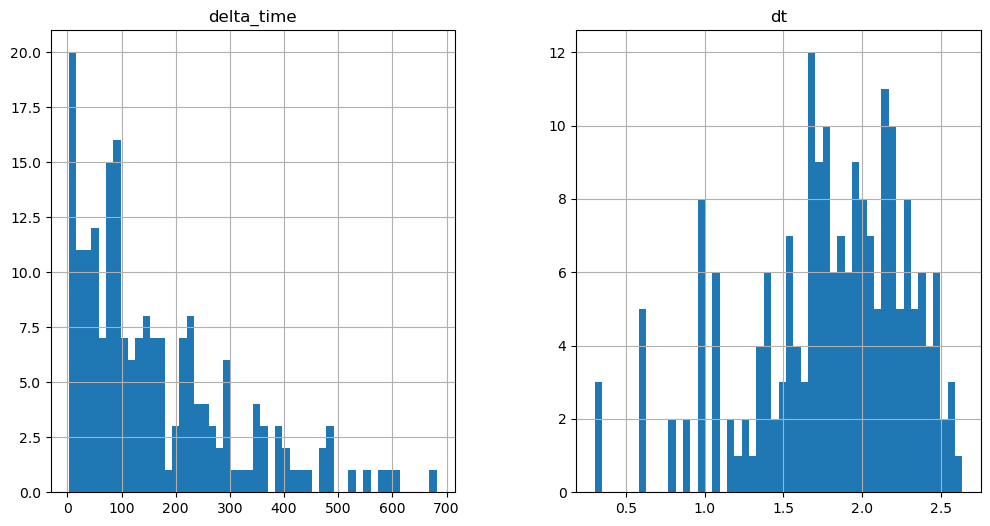

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3690.6782358288765 6.282000303268433


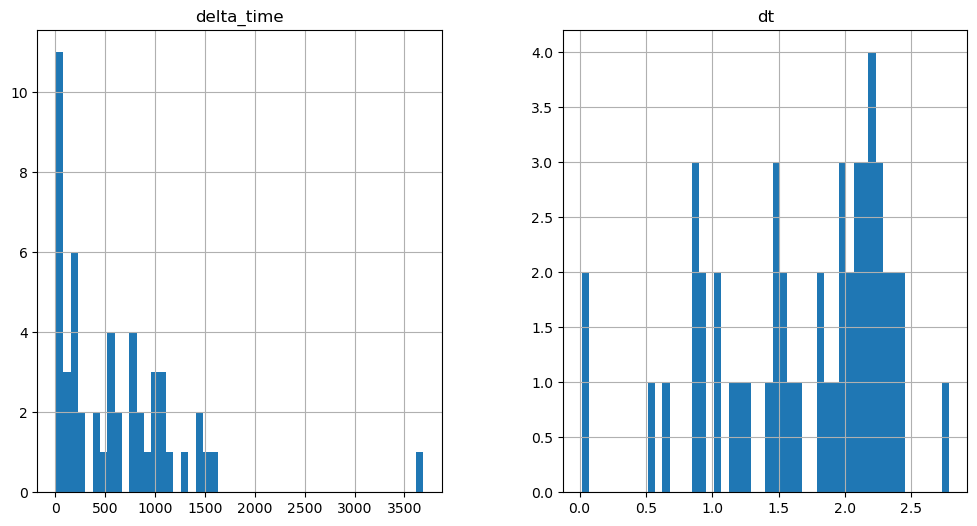

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

493.1379648447037 0.1


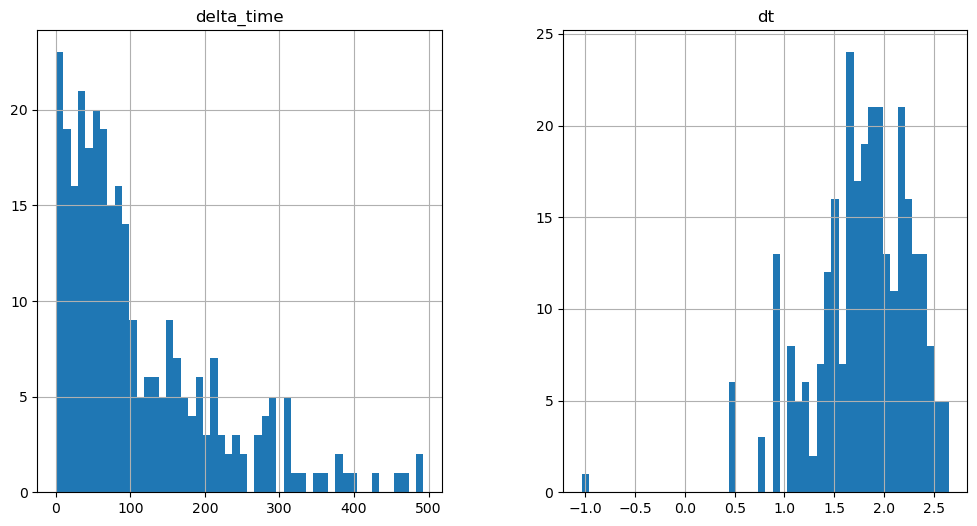

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2660.438743889332 34.5509917140007


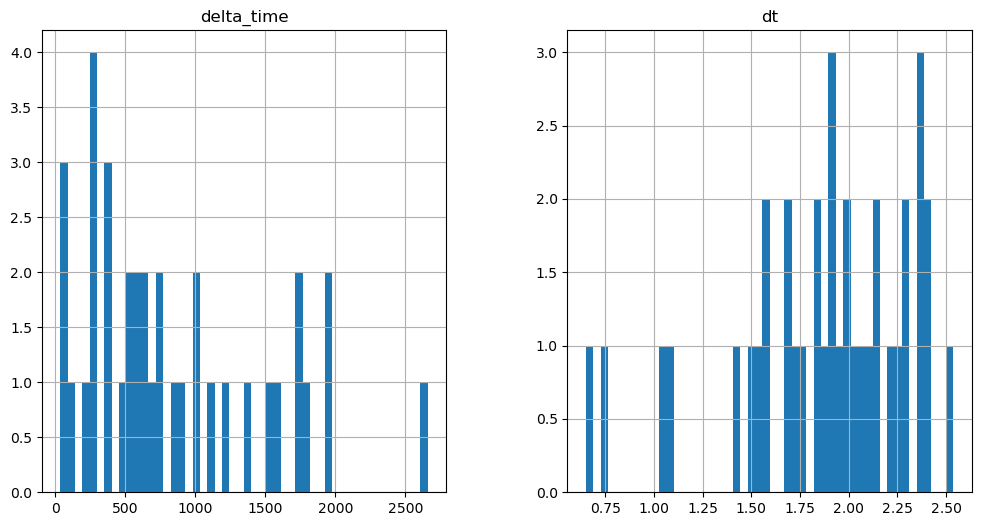

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2497.0951056480408 3.1410101652145386


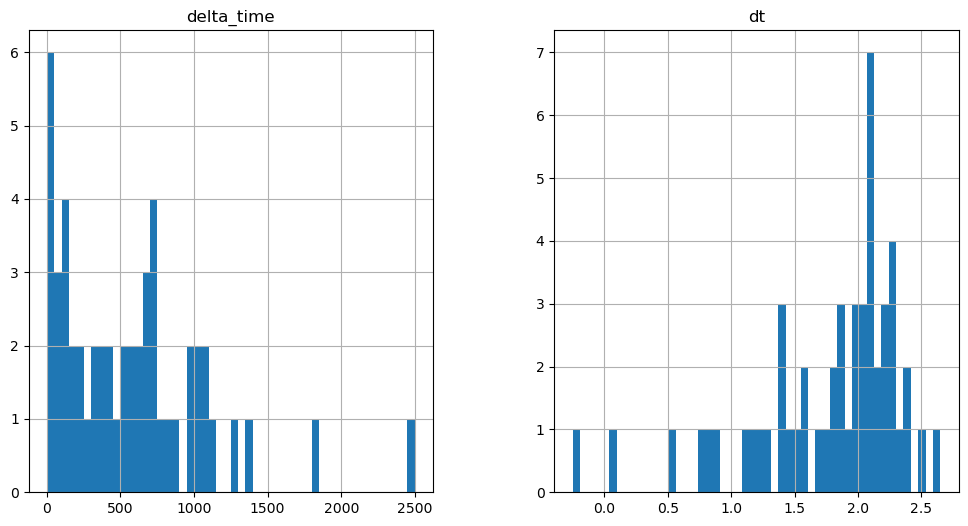

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2236.3919025063515 9.422990500926971


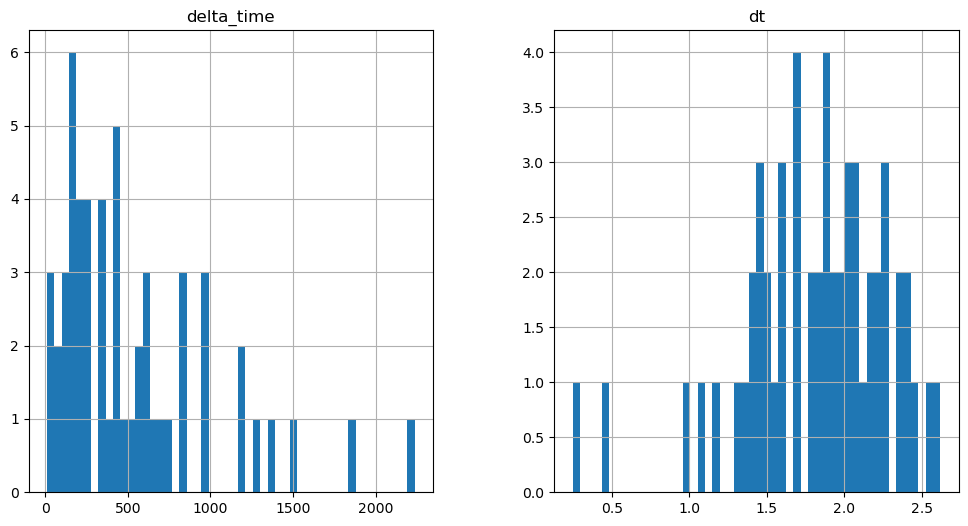

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2390.3016303777695 3.141020178794861


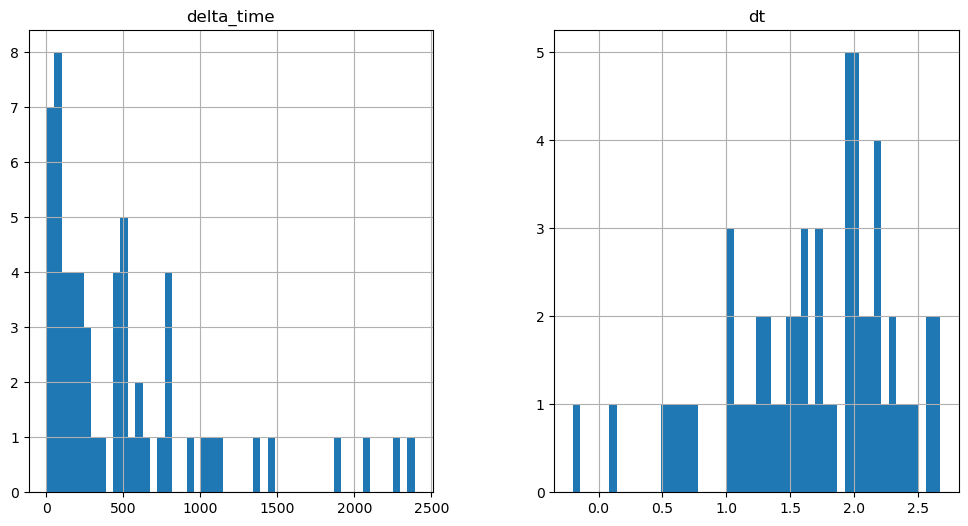

2073.0598344802856 3.1410099864006042


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

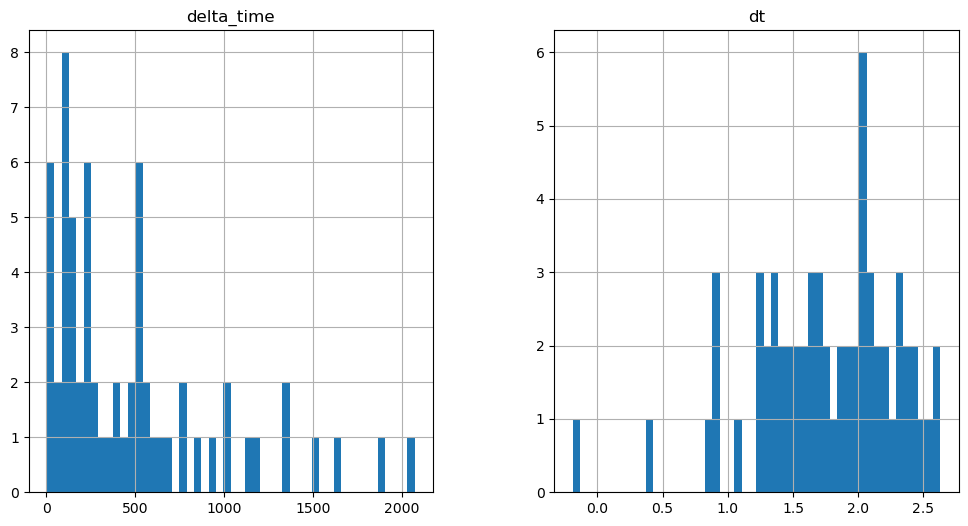

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1834.3438623547554 40.833191990852356


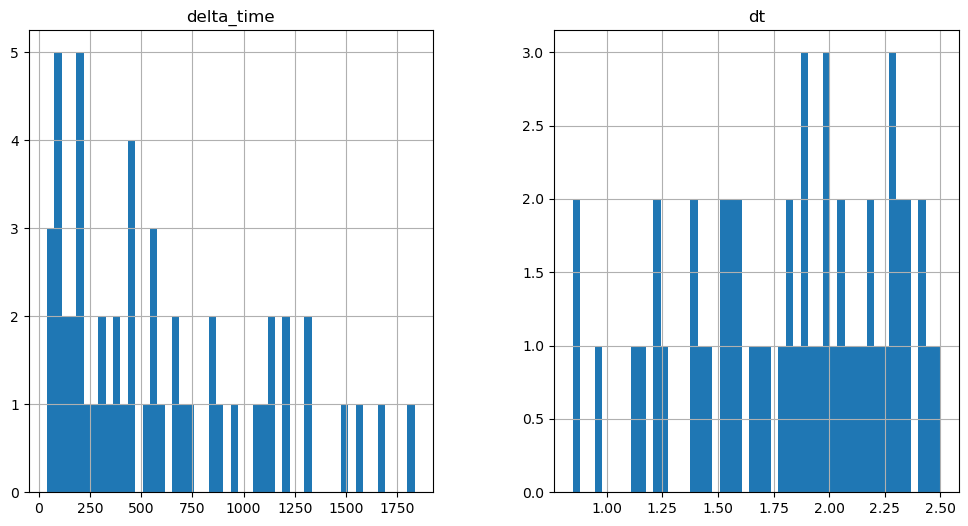

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

791.532009780407 0.1


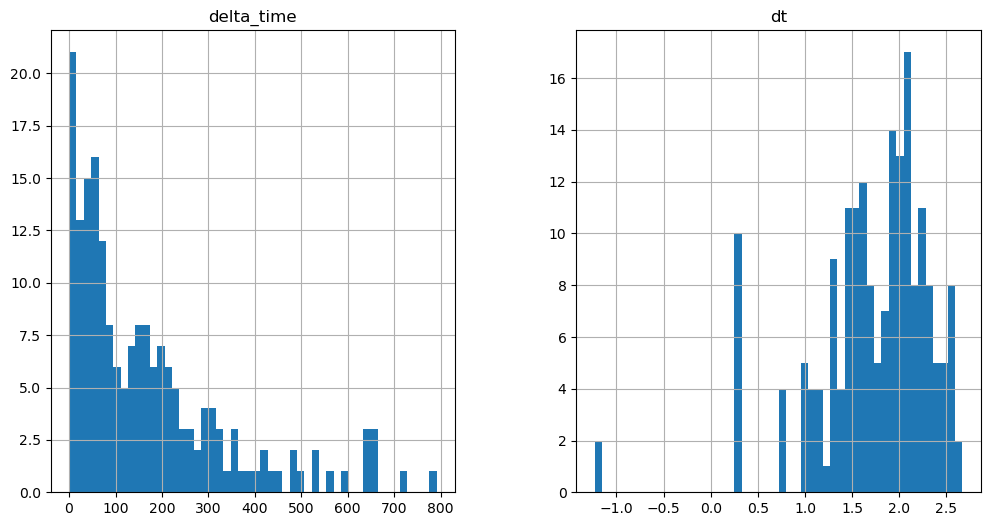

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1422.8736516833305 0.1


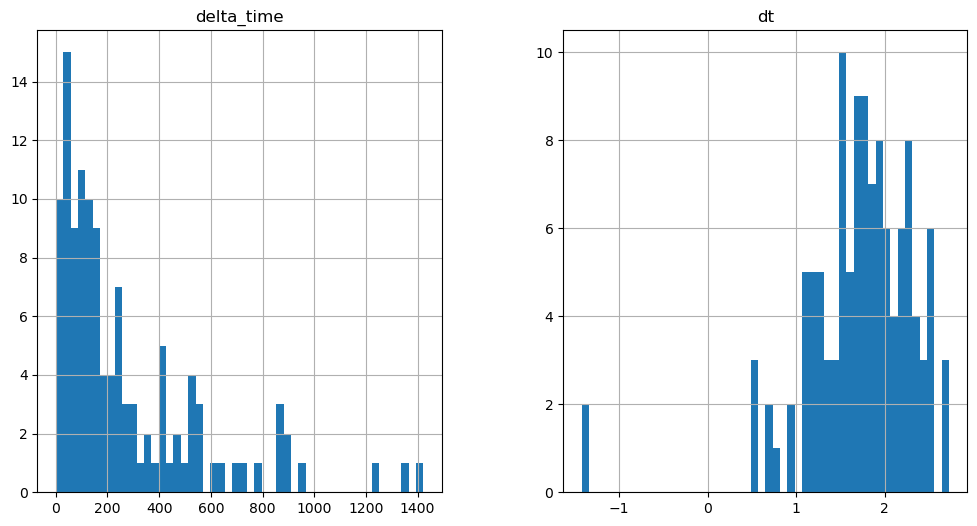

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1736.972895681858 0.1


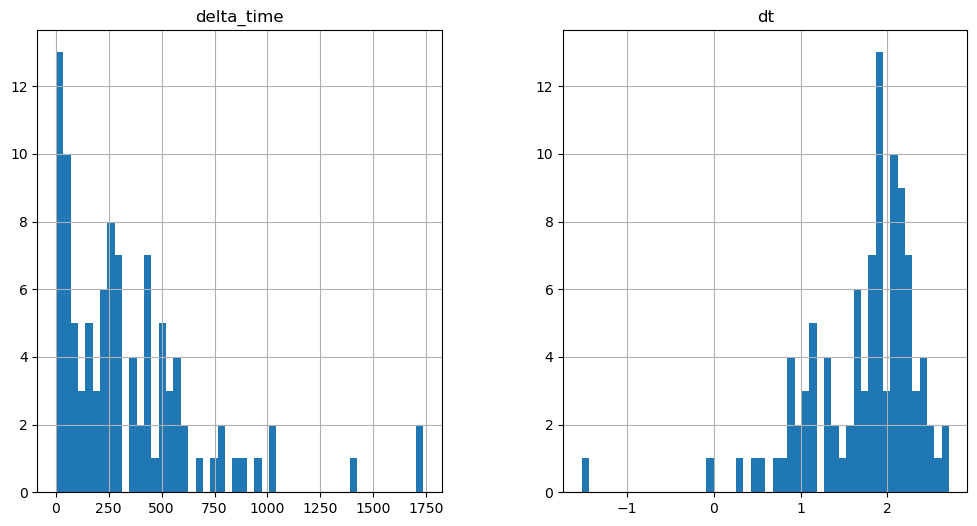

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2519.081824183464 9.423040270805359


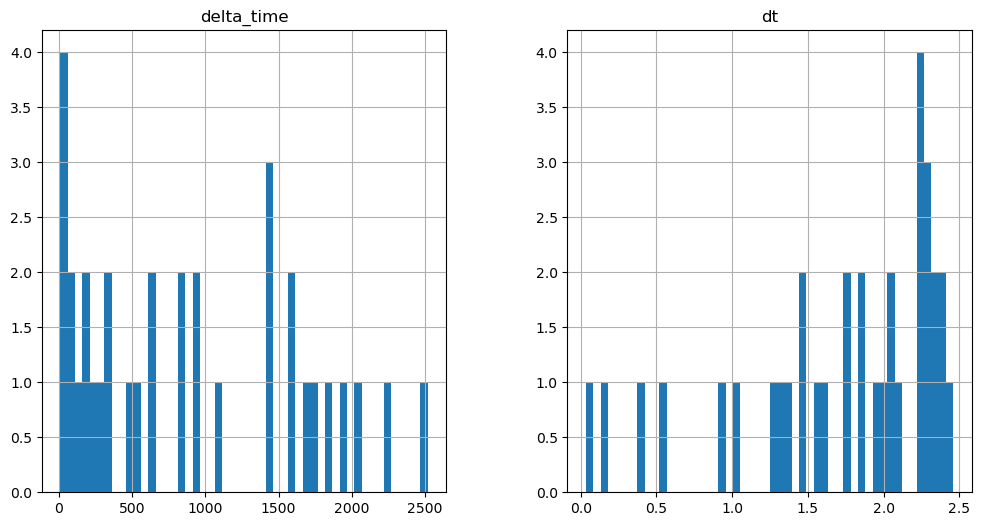

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

832.3649310469627 0.1


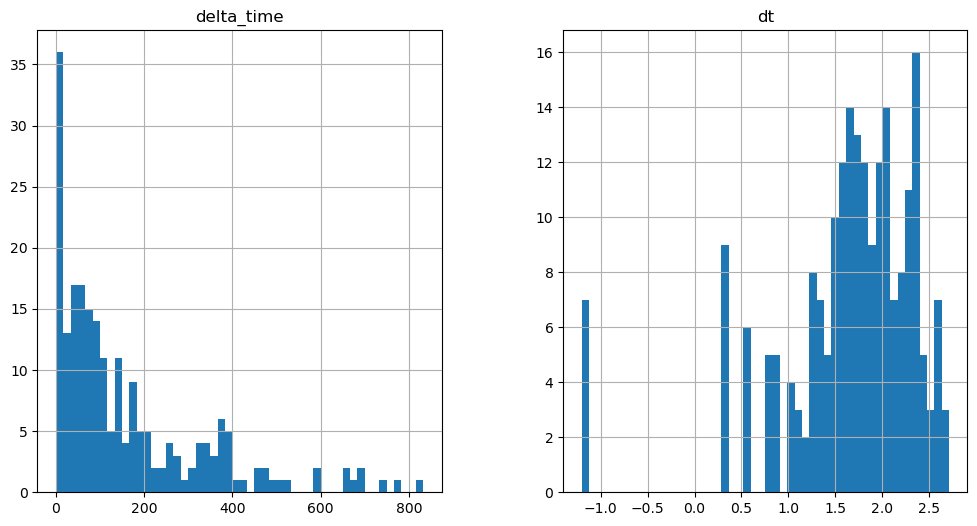

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3235.229799568653 12.563980638980865


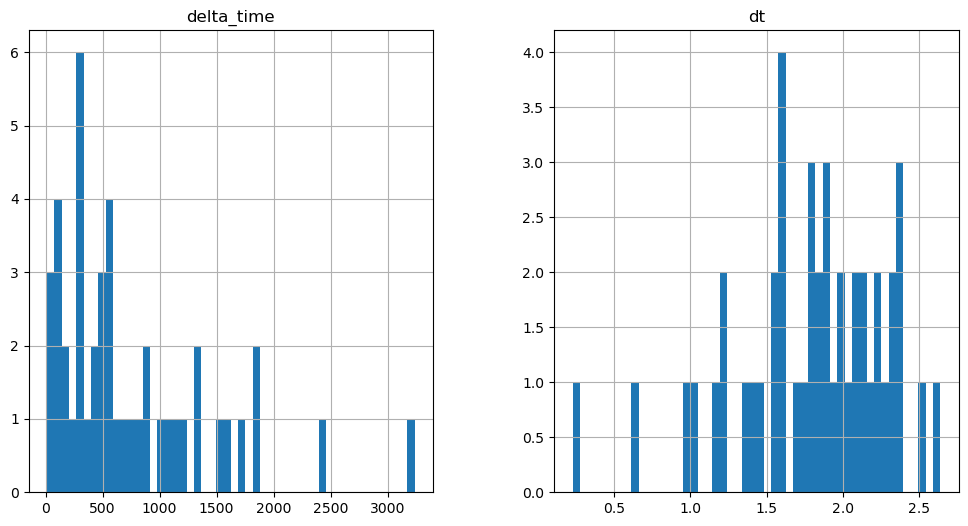

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2820.6182691454887 3.140990197658539


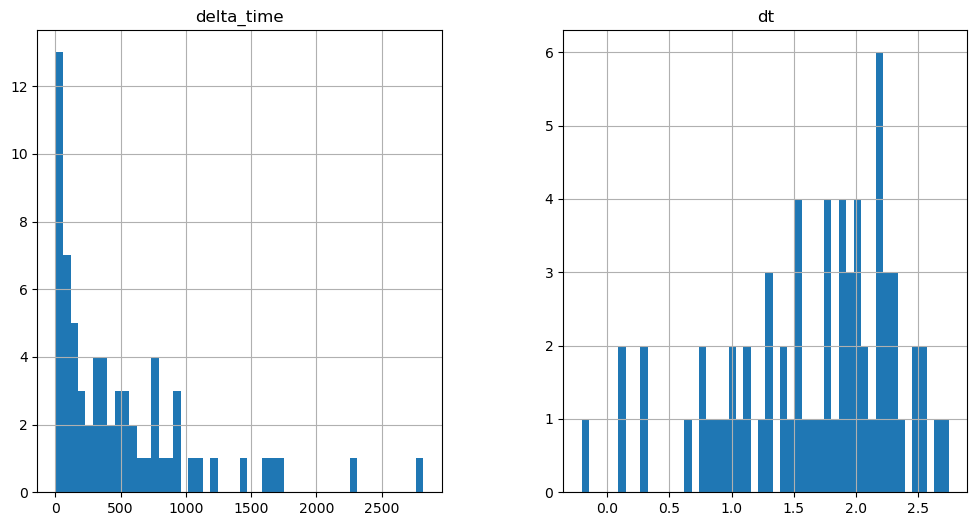

2801.77178812027 12.56398069858551


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

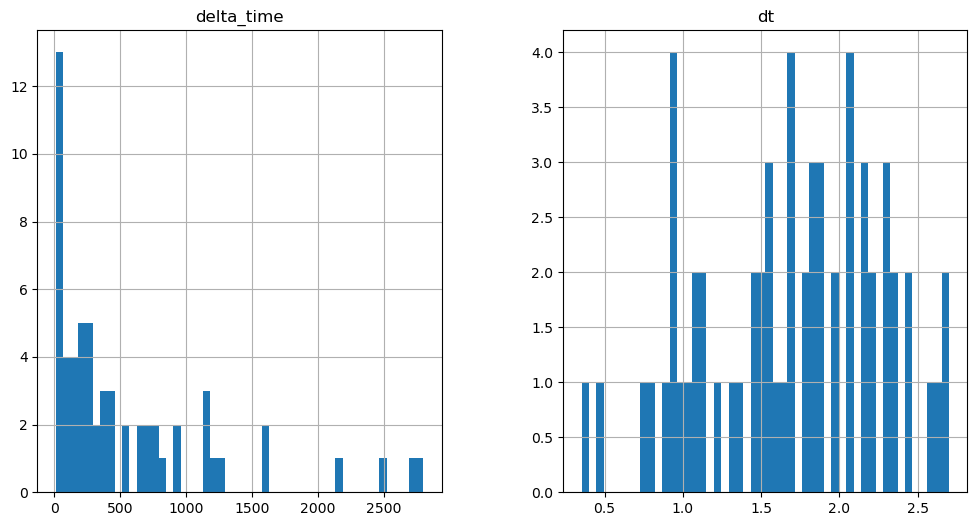

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3411.125828266144 40.83300203084946


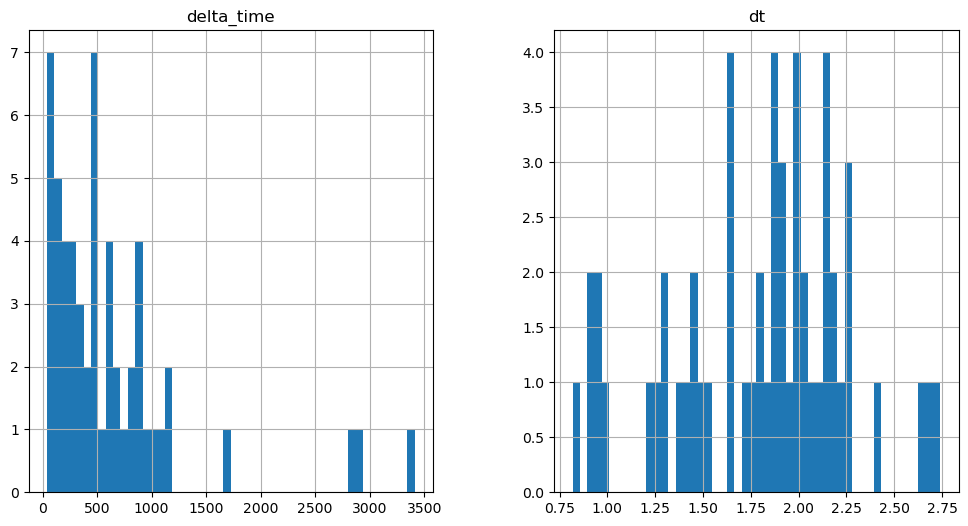

3784.904736697674 31.410001575946808


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

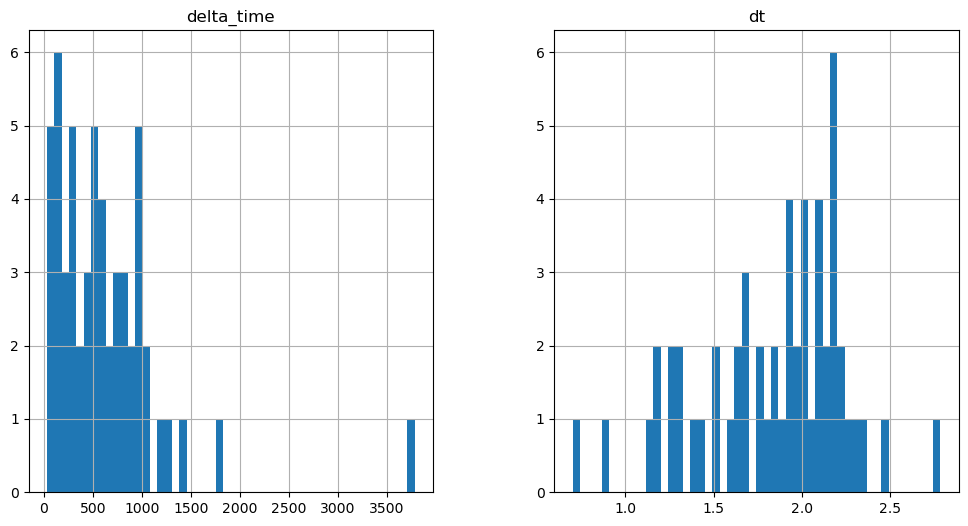

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2902.283833026886 37.69198191165924


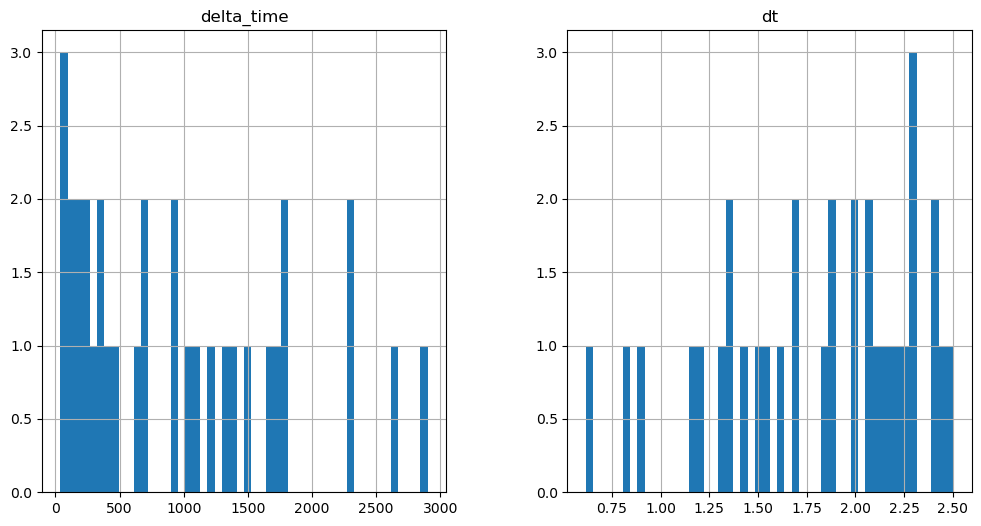

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1777.8058975934982 18.845981001853943


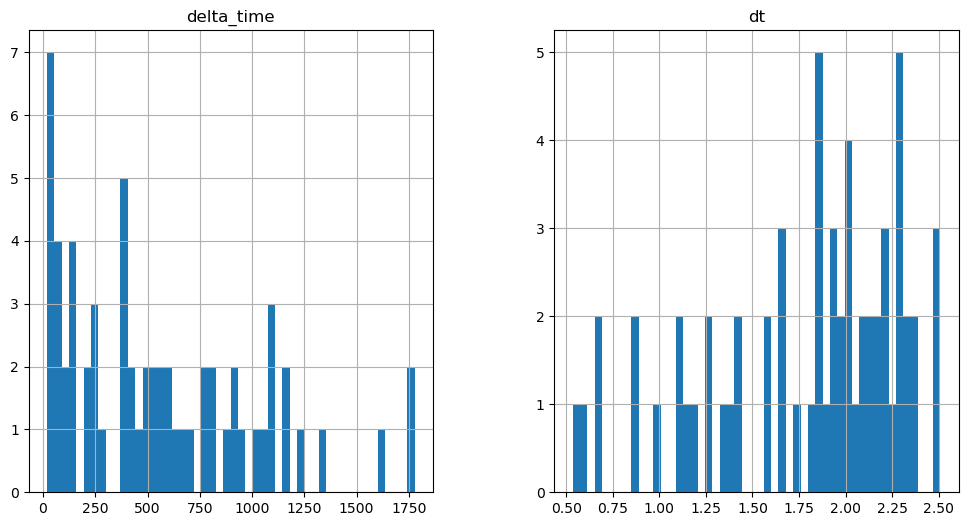

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2292.9298630952835 15.704990804195404


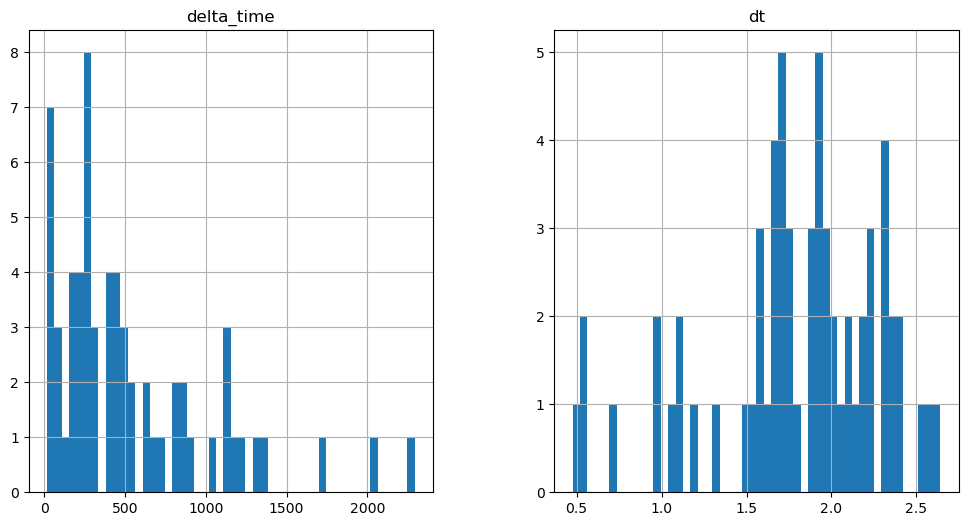

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2500.235773384571 37.69202184677124


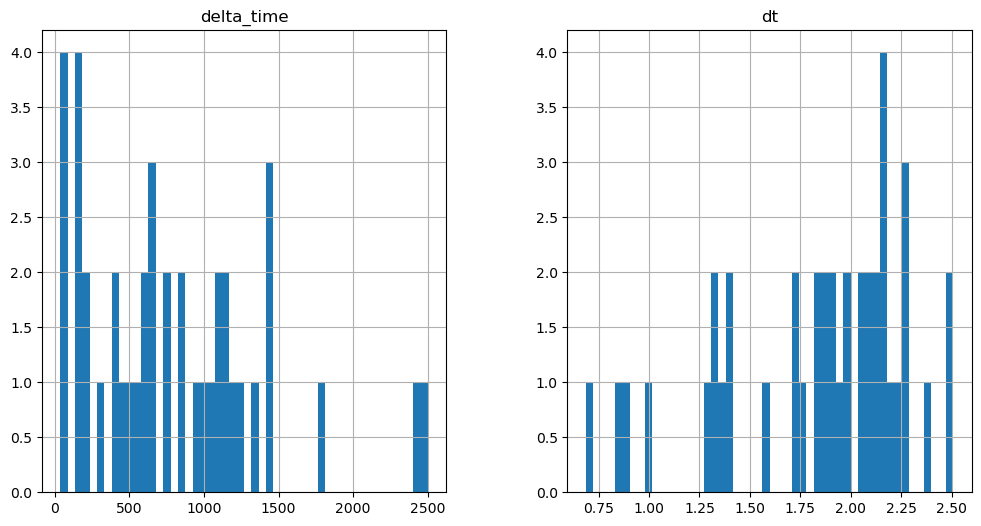

2110.7518440485 9.422990500926971


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

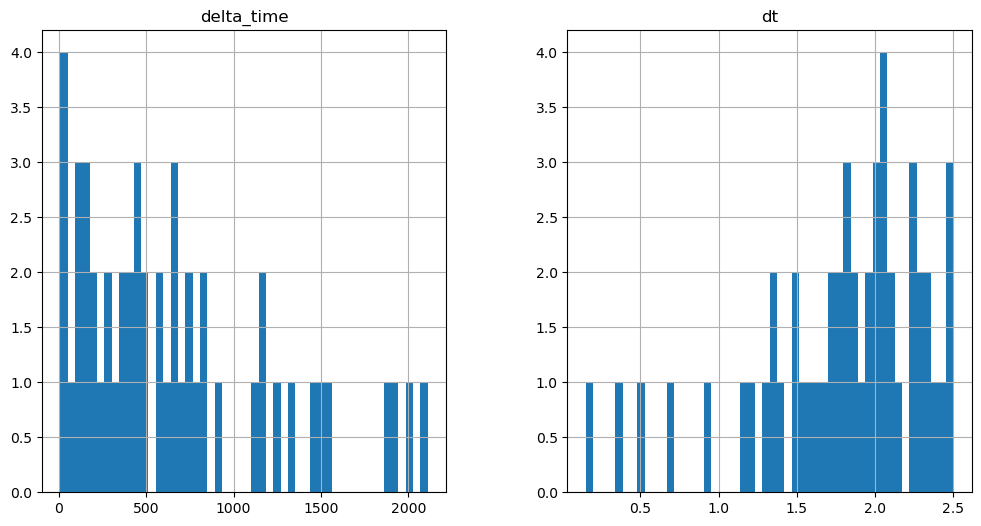

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2528.5047947764397 12.564000606536865


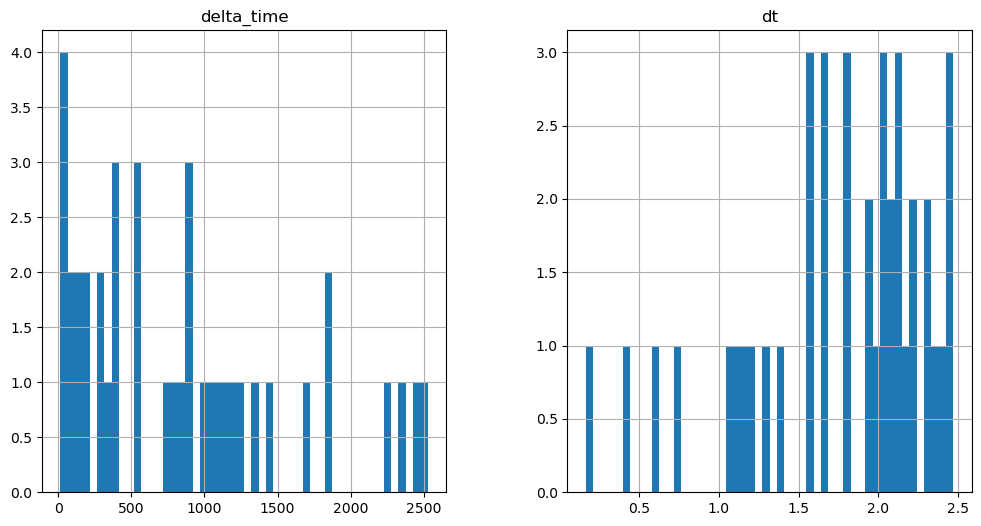

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2955.6807858347893 28.2690212726593


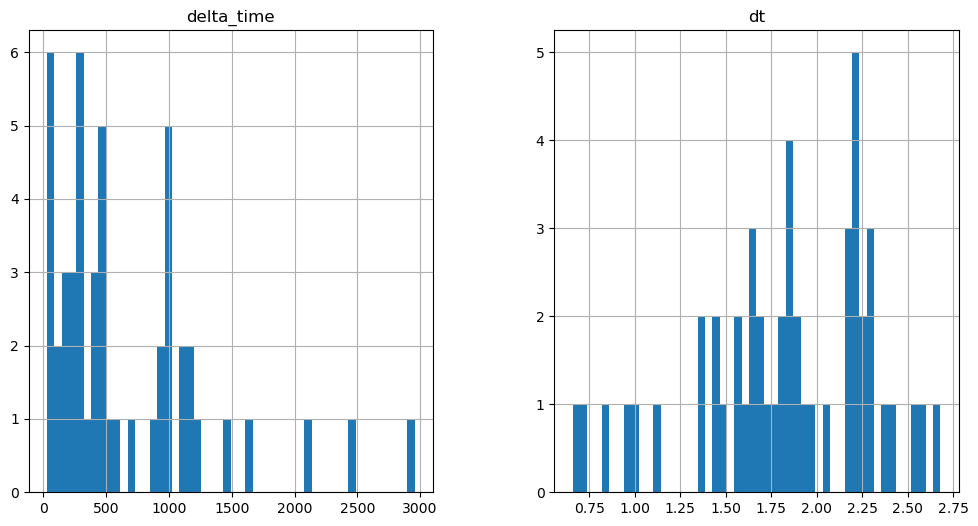

3367.1520560383797 12.56398069858551


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

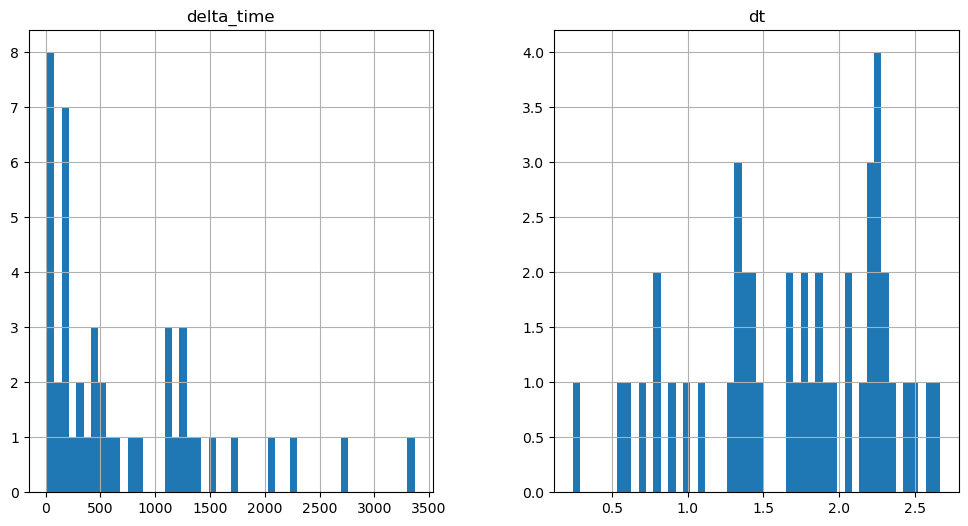

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2732.6698046922684 15.704980790615082


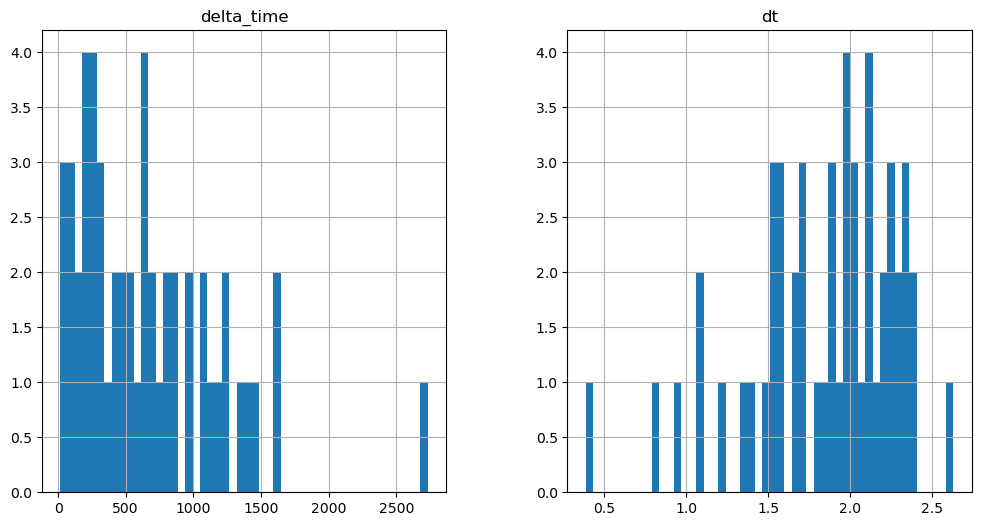

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

989.4149288535118 0.1


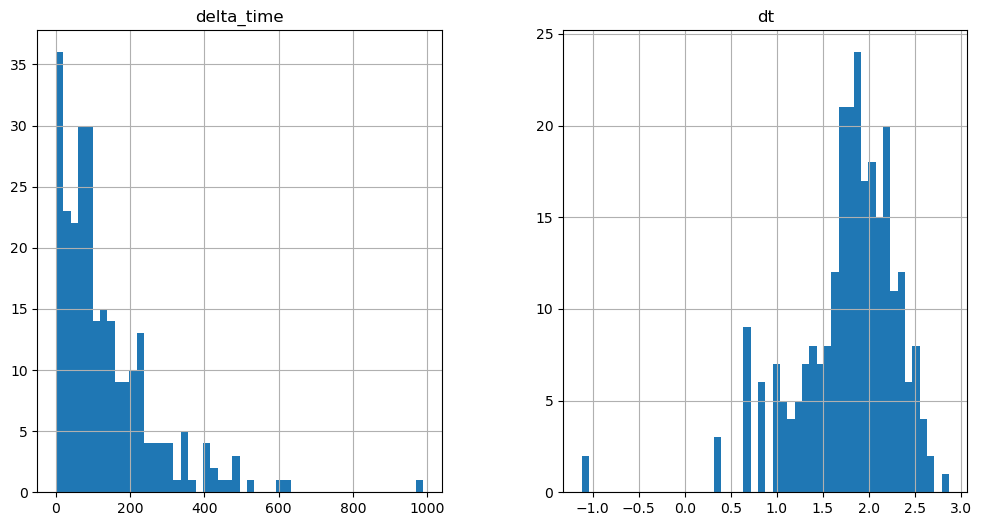

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5691.491955816746 25.127981305122375


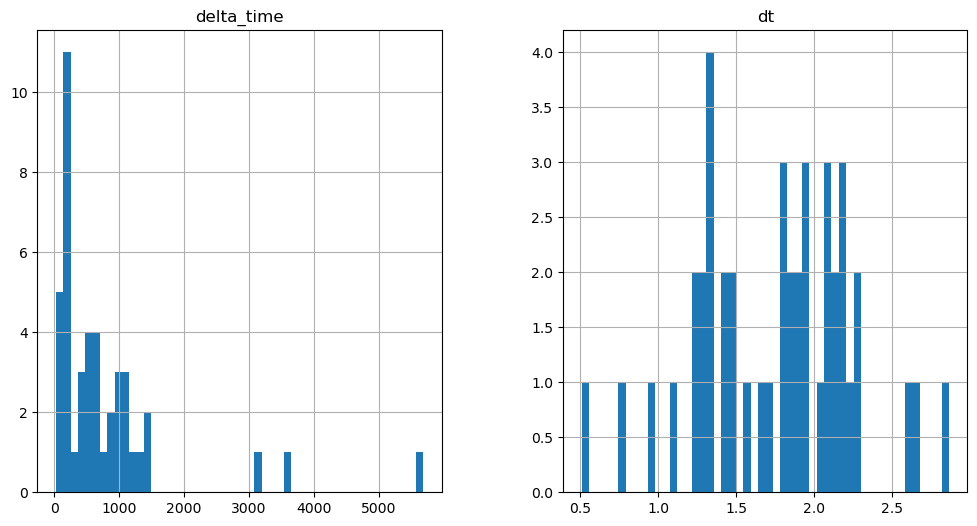

4752.333908557892 3.140990138053894


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

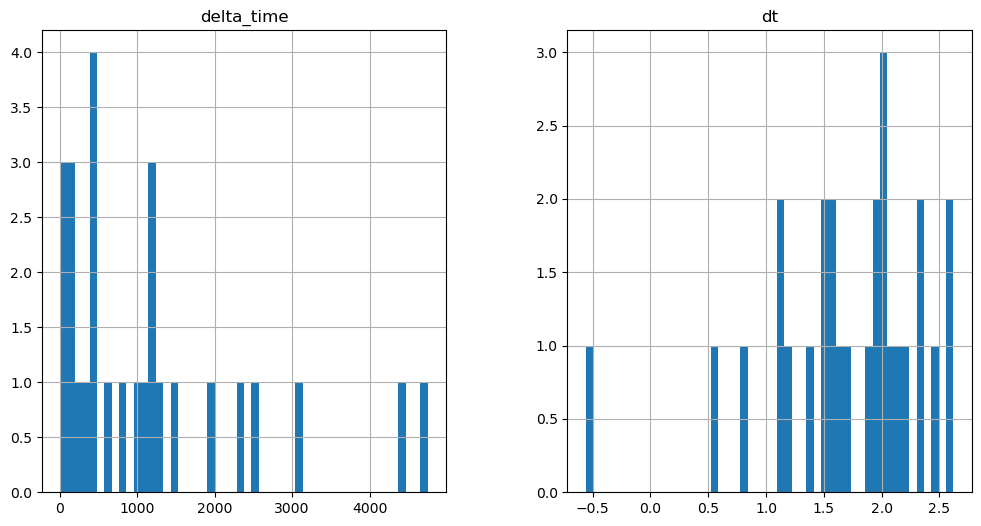

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2327.4826068878174 9.422990381717682


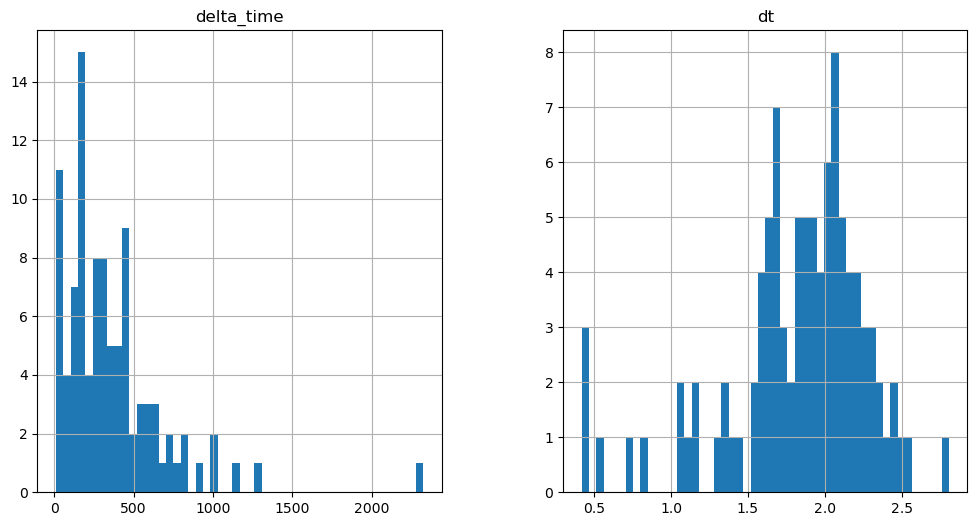

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1975.6889290809631 0.1


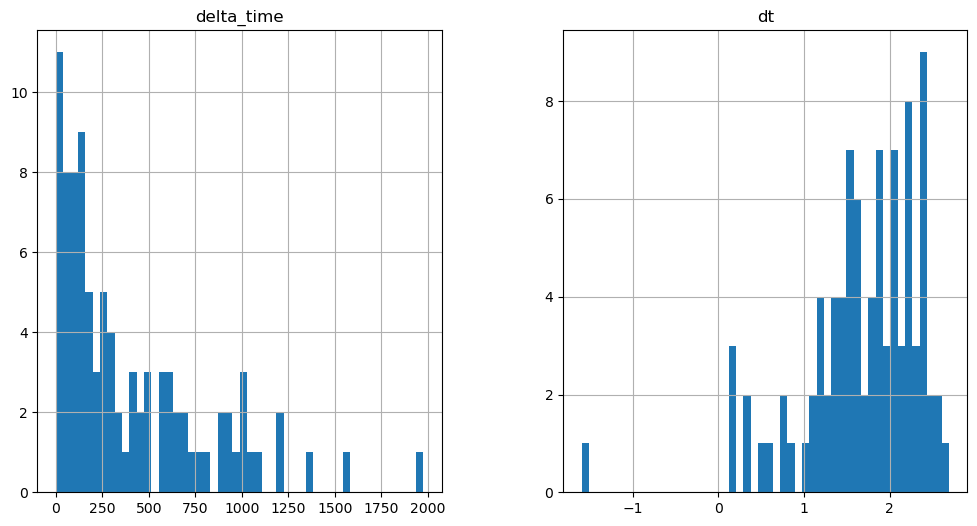

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2651.003883123398 34.55100166797638


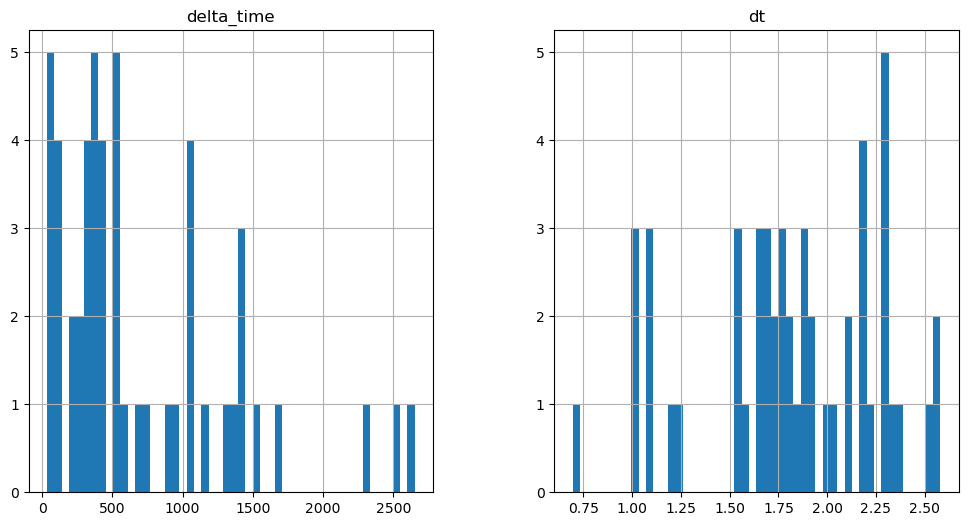

3385.9979199767113 21.986991107463837


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

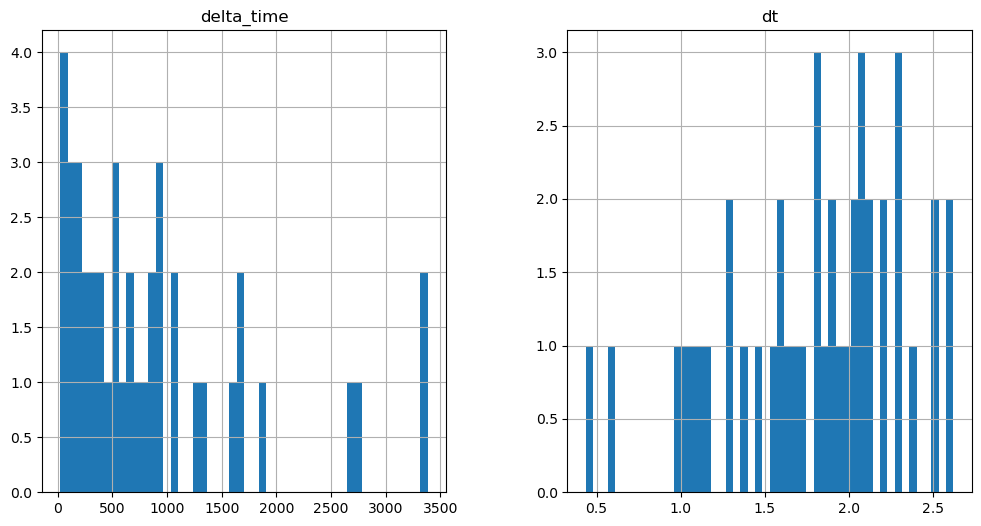

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3784.904959976673 0.1


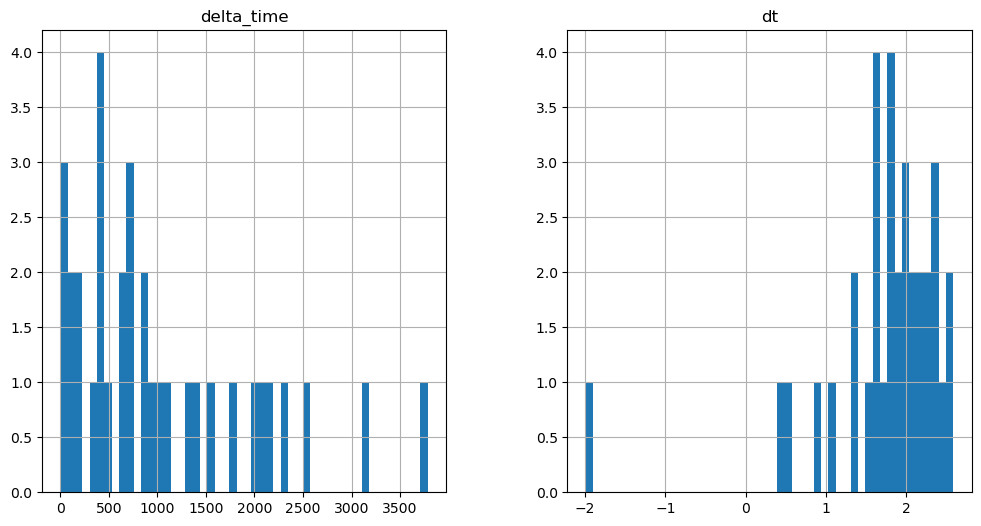

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2264.660913705826 0.1


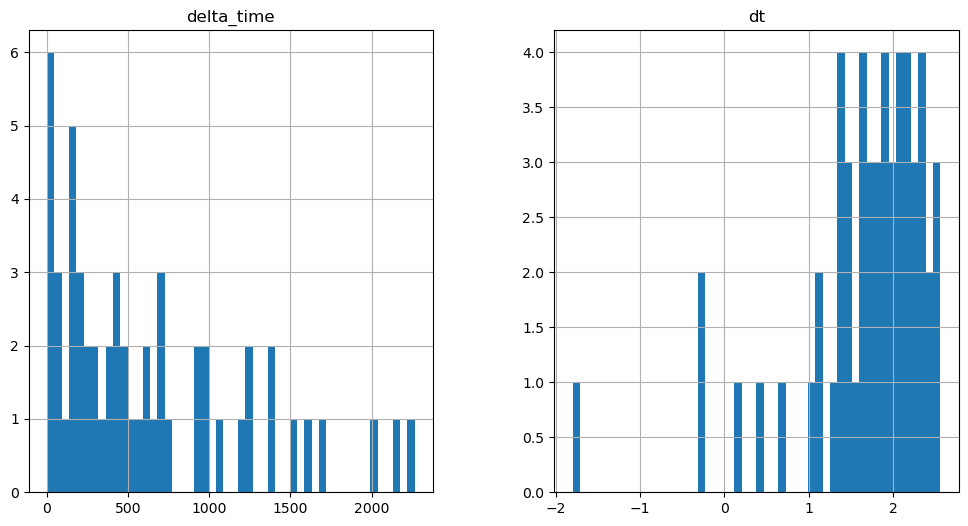

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2182.9949696063995 3.1409902572631836


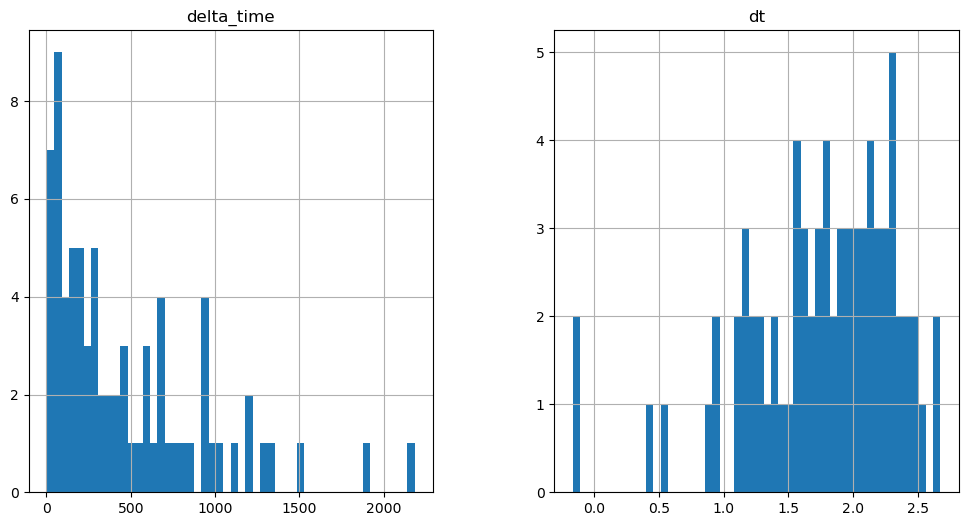

1972.5479791164398 3.141010105609894


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

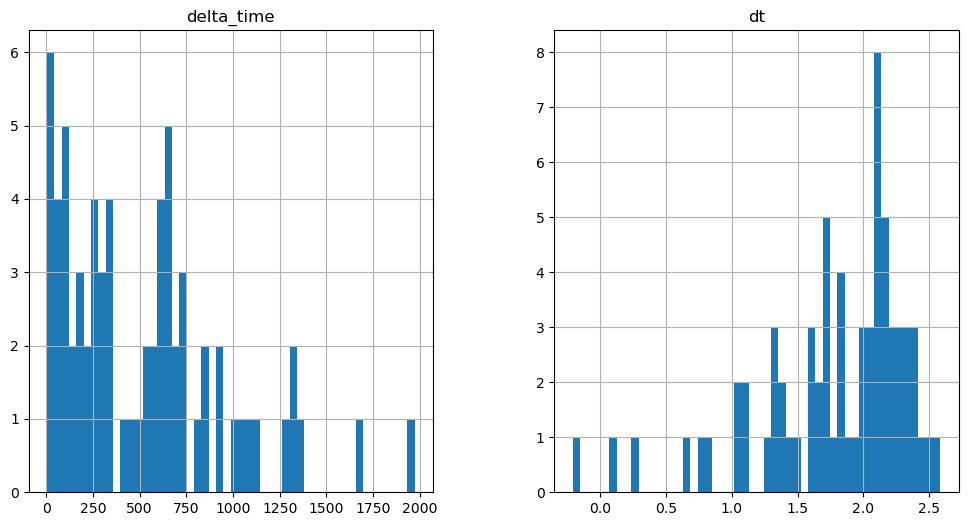

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2830.0409321188927 3.140990197658539


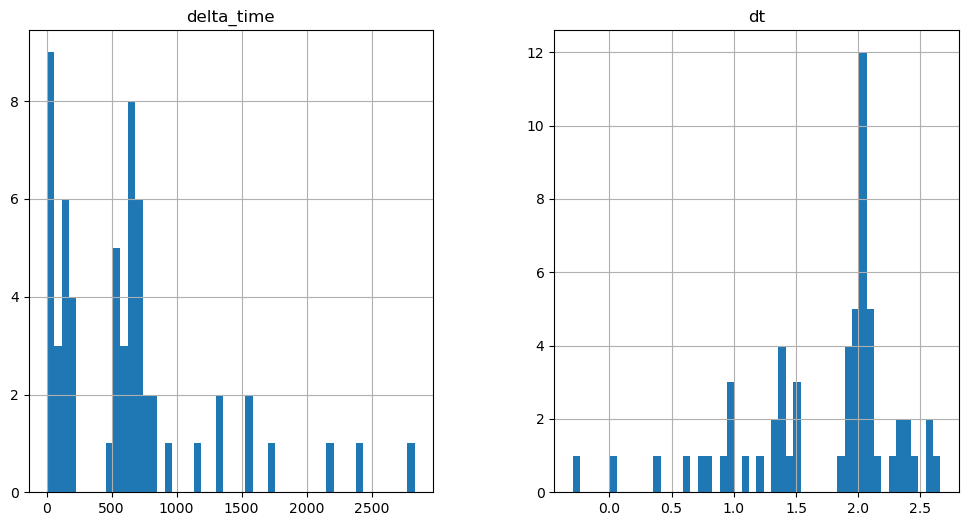

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3389.138840317726 12.563970685005188


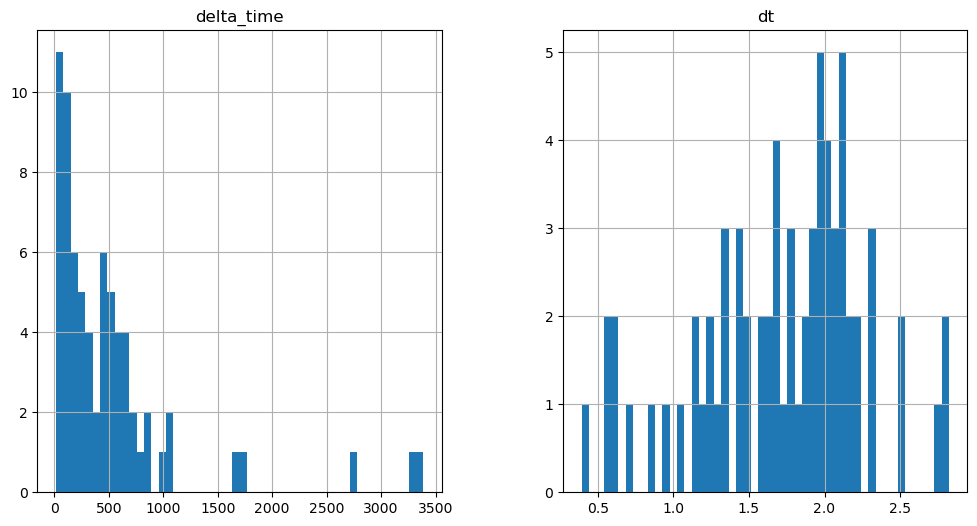

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2547.3510884046555 6.282000303268433


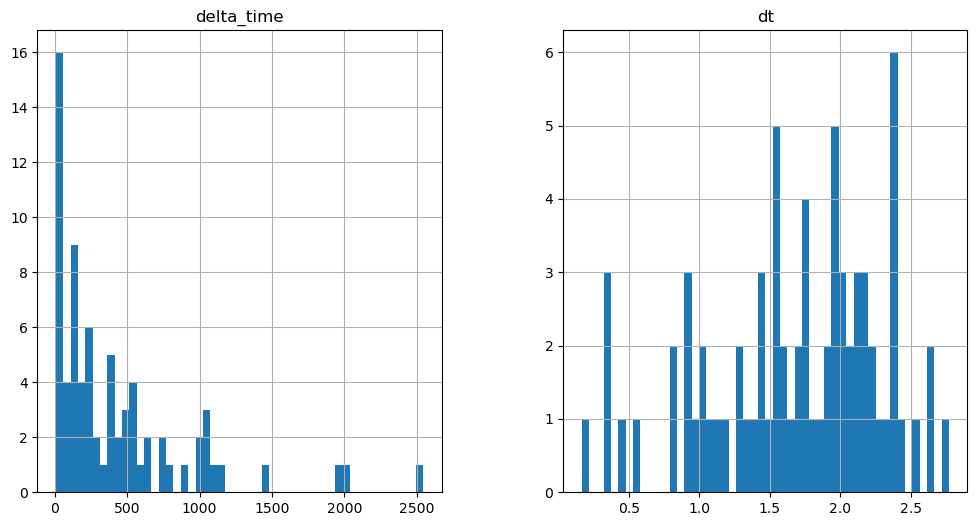

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

885.7620945572853 0.1


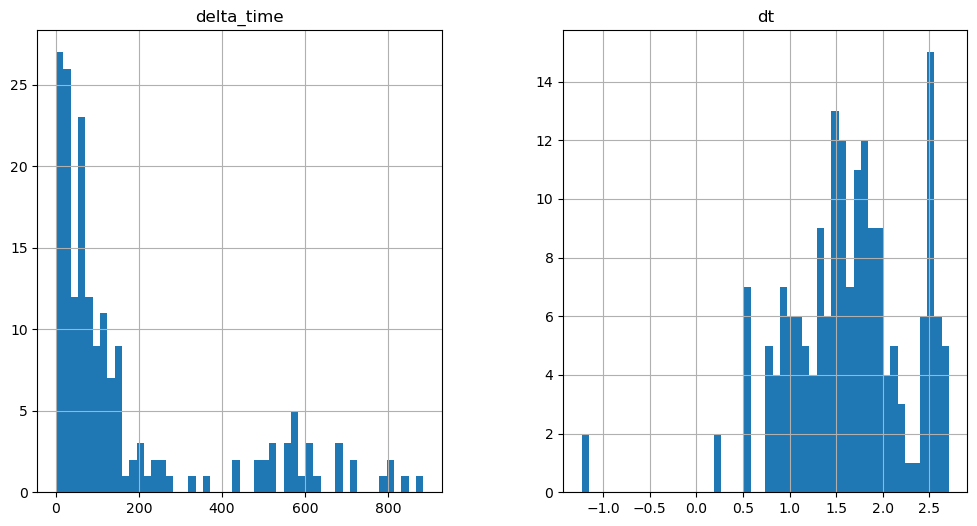

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2424.852162182331 12.564030468463898


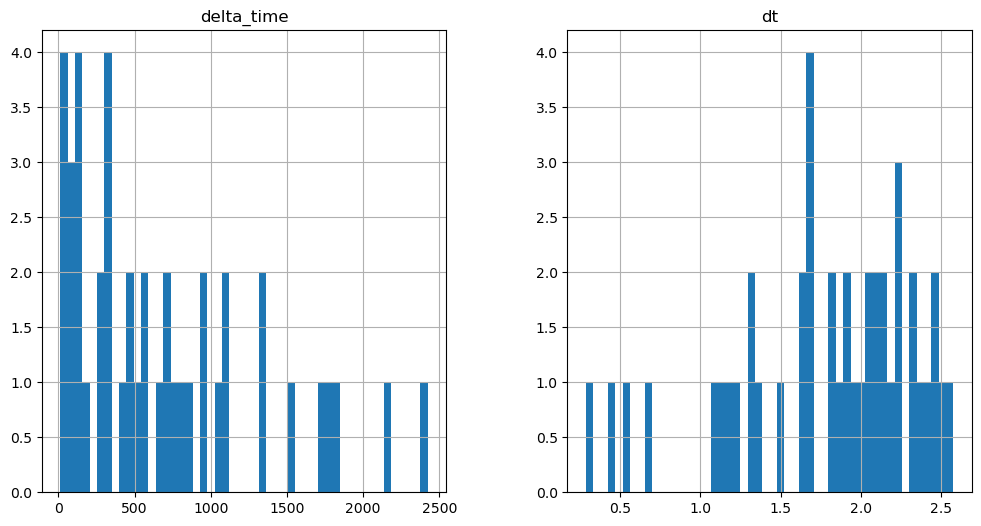

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2751.516188442707 3.140990197658539


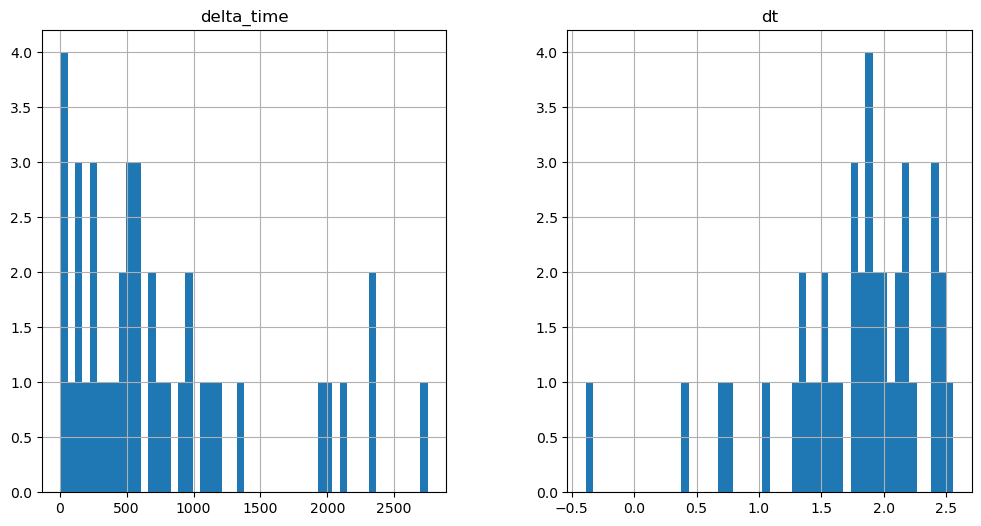

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2550.4921585917473 31.410011529922485


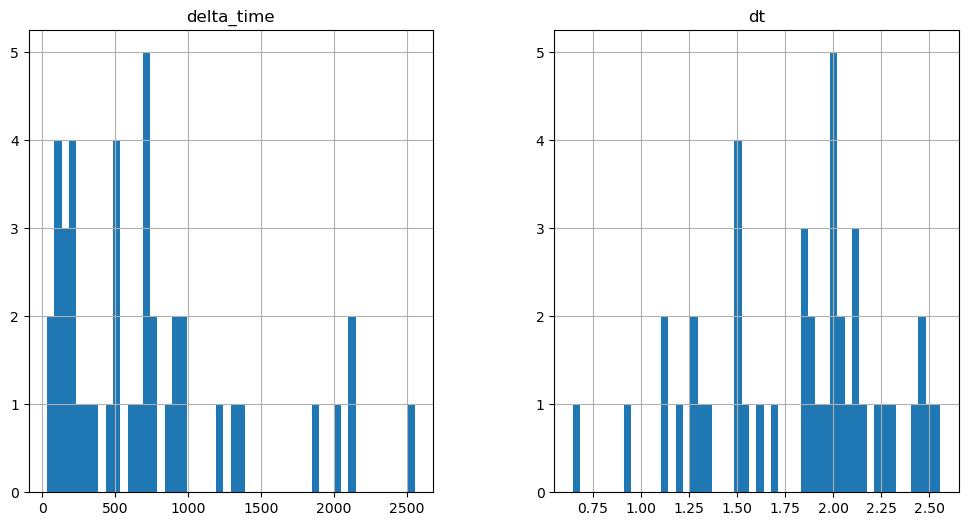

4208.940351903439 6.282000362873077


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

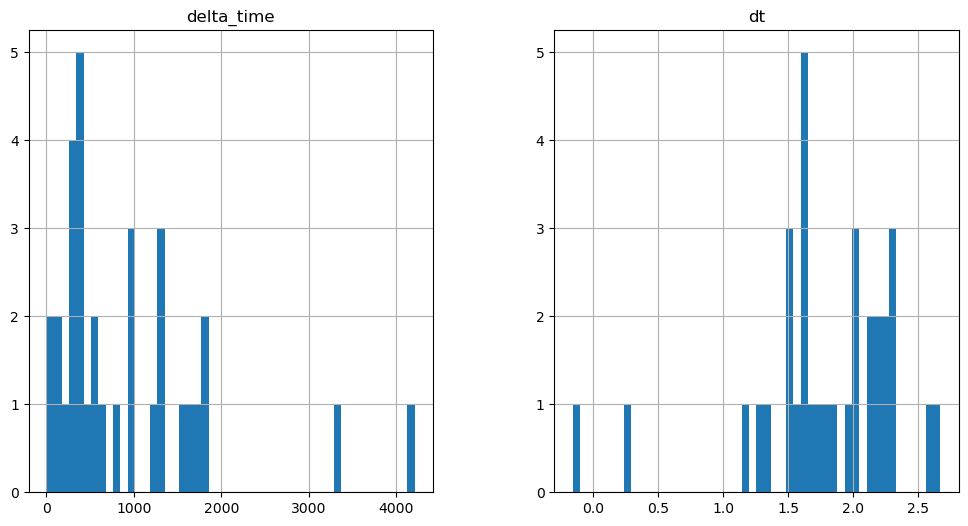

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1771.5221092104912 3.140990197658539


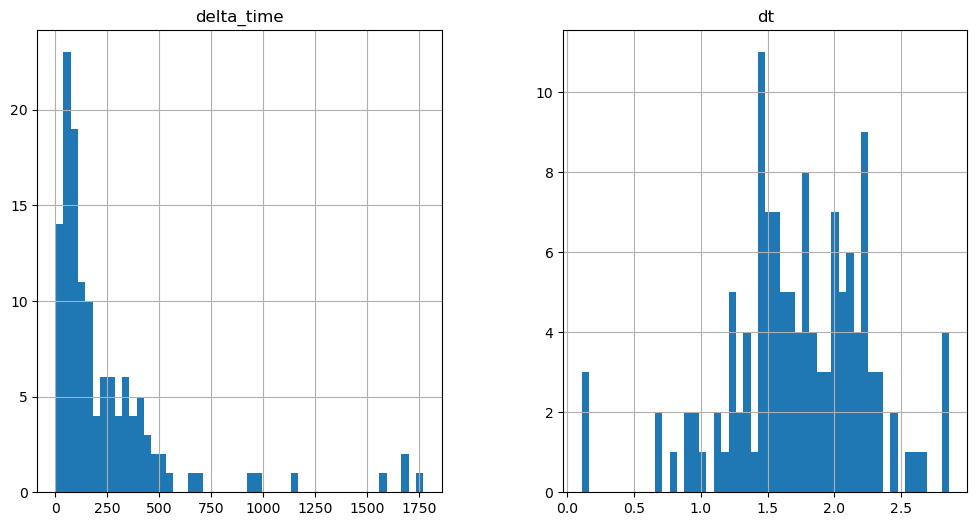

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4070.7698635458946 12.564110577106476


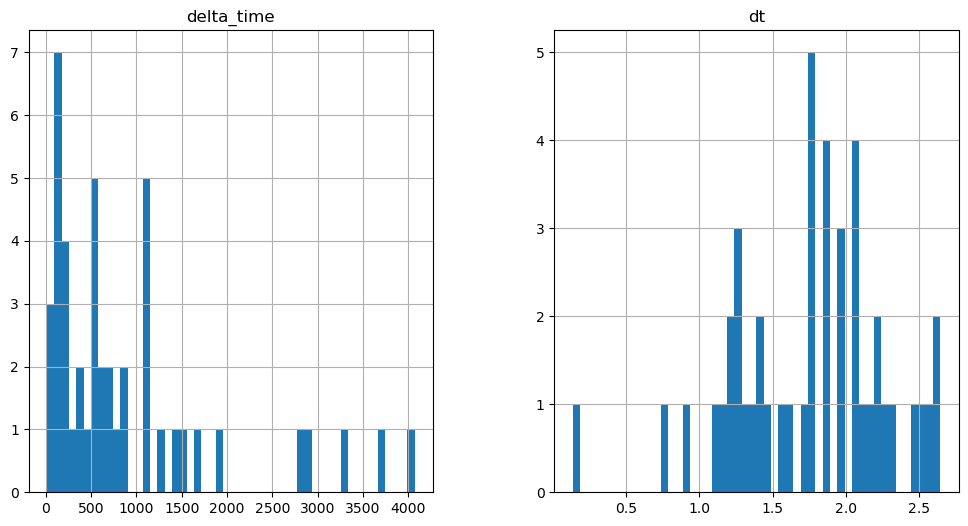

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3426.859601378441 15.705130815505981


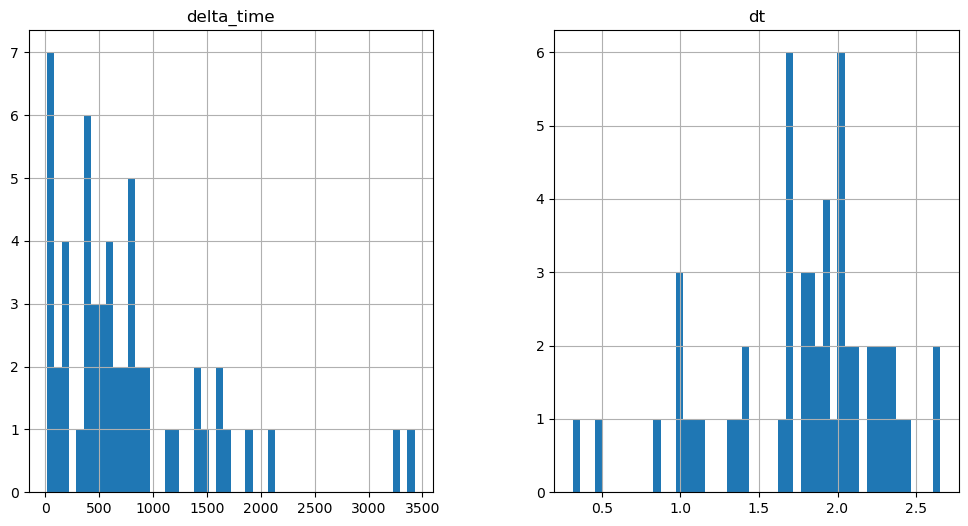

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1963.1413782835007 40.83333206176758


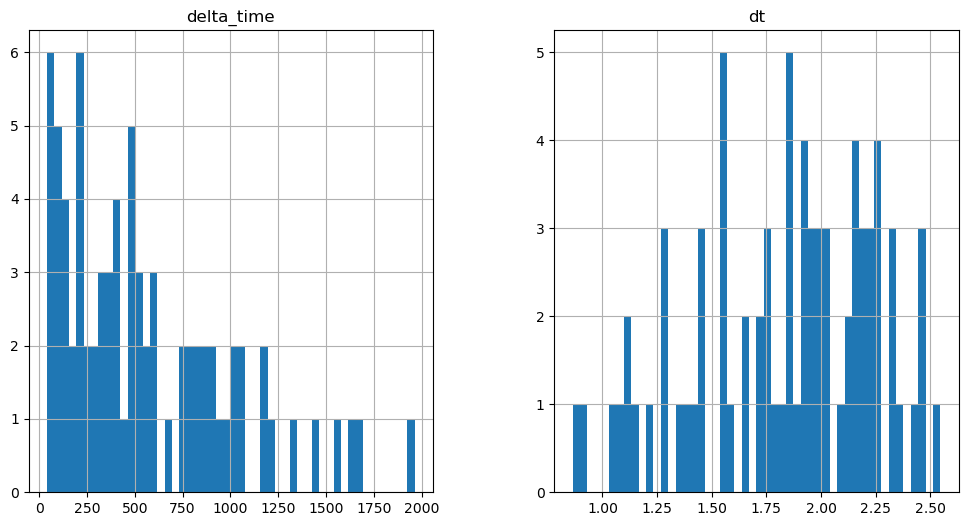

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

383.20521903038025 0.1


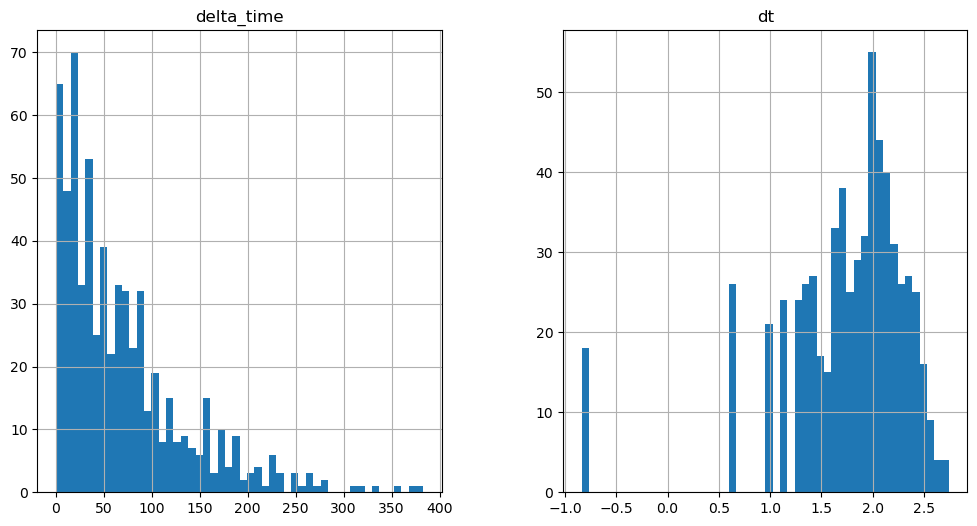

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

942.3080371618271 3.1410202383995056


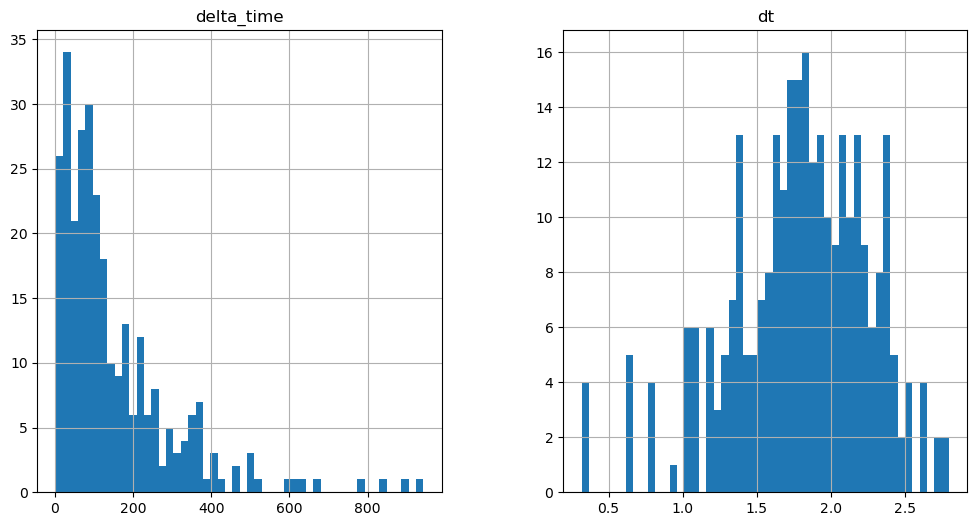

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5663.270833194256 15.705130815505981


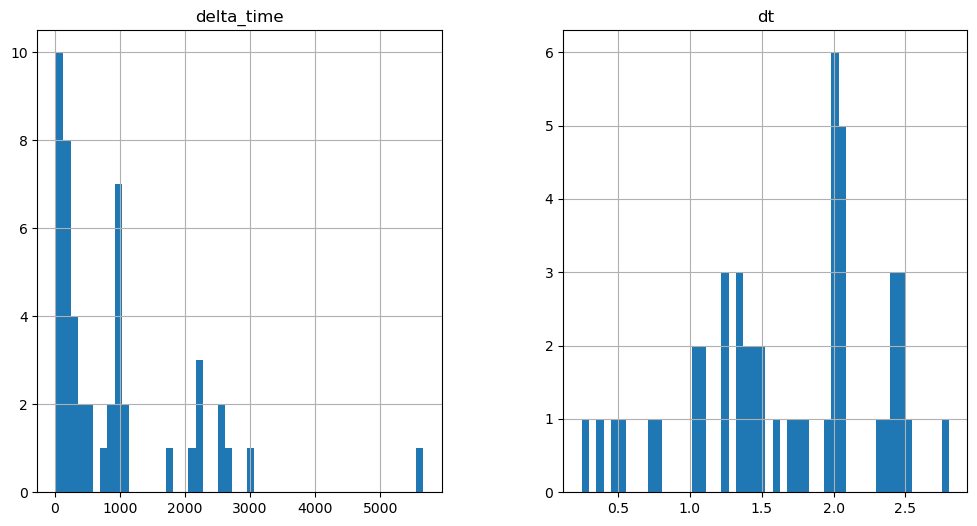

2154.743917822838 3.141030192375183


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

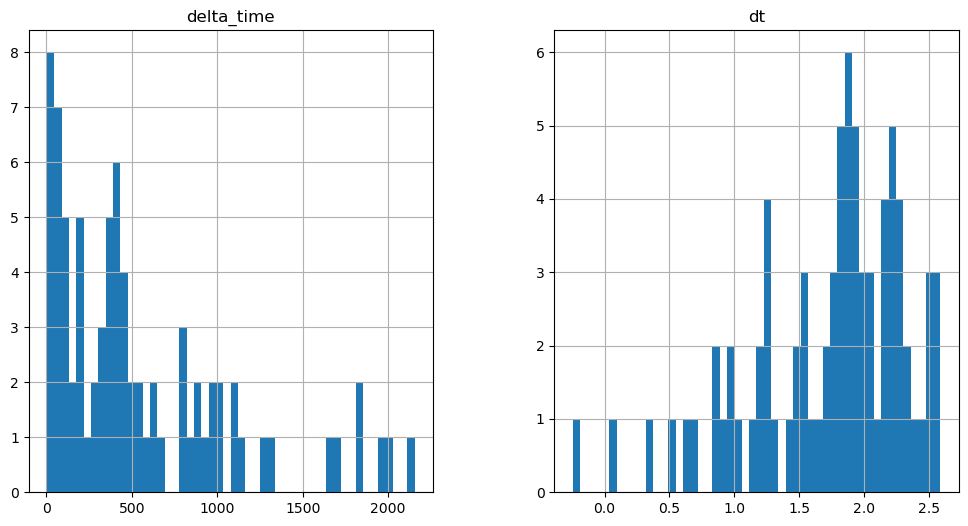

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4705.257465302944 6.282050430774689


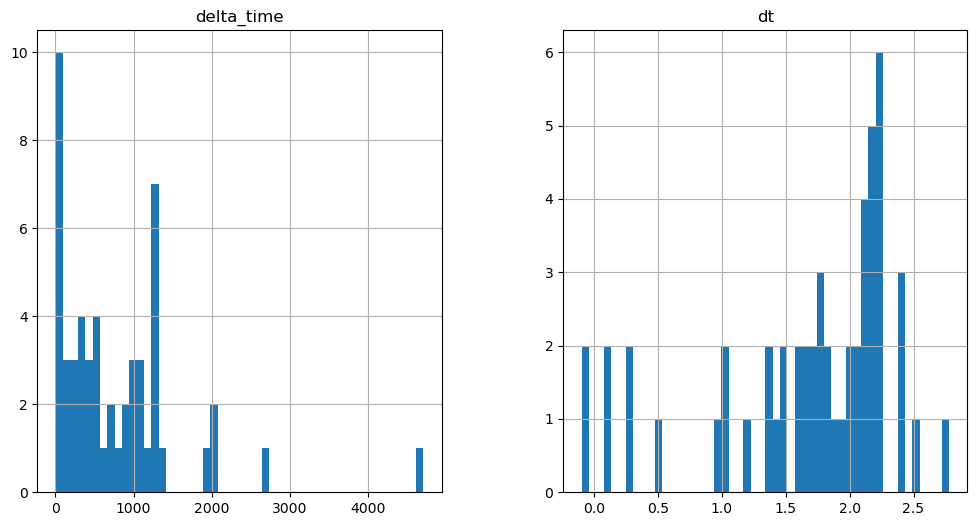

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3803.782940208912 15.705130875110626


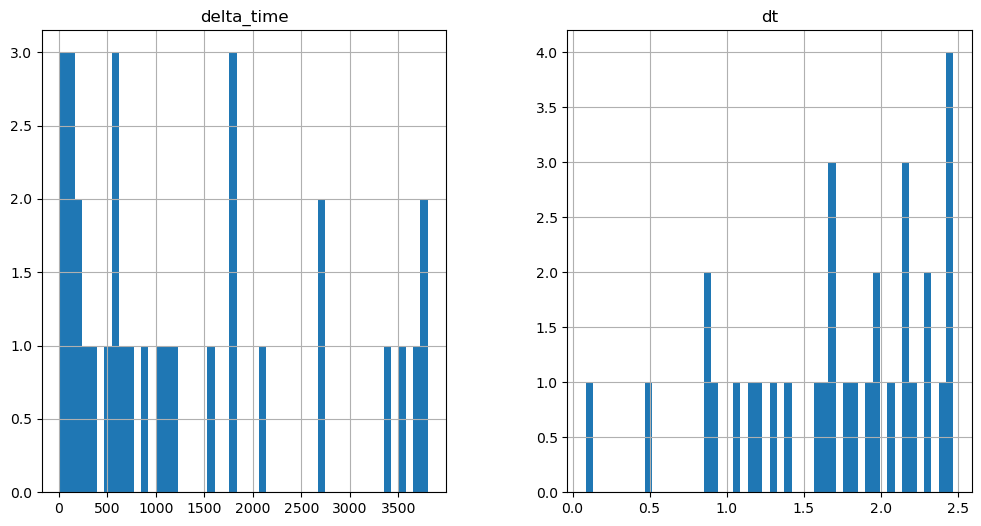

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2123.333776295185 3.1410300731658936


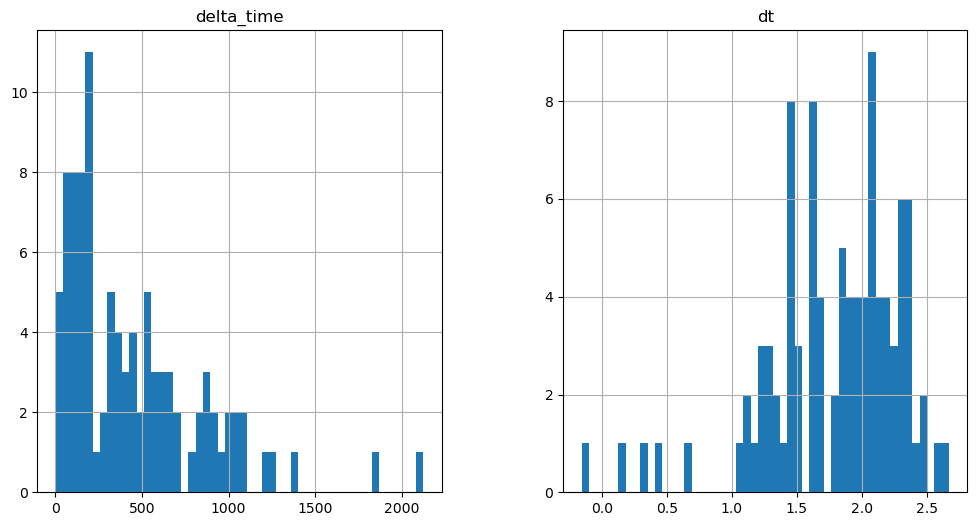

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

964.2950382232666 0.1


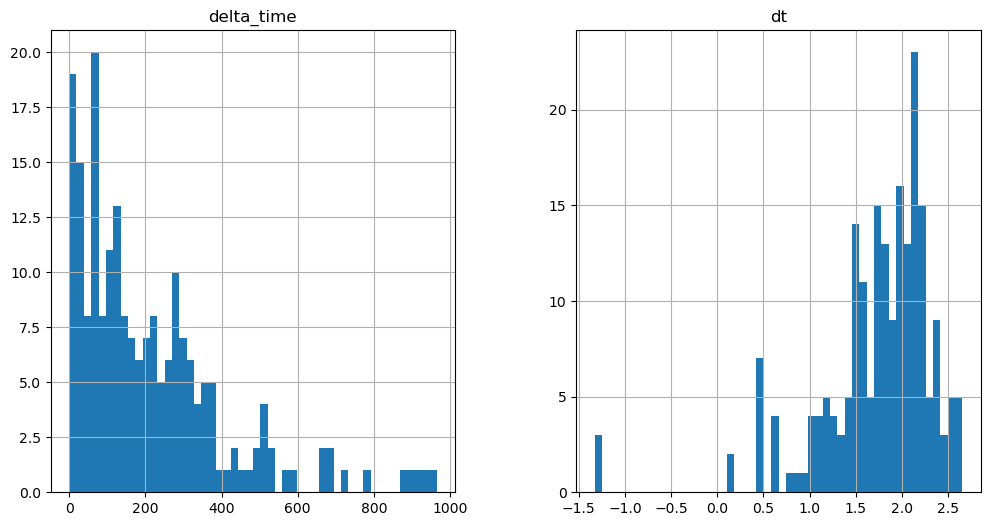

1278.3976739645004 3.141029953956604


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

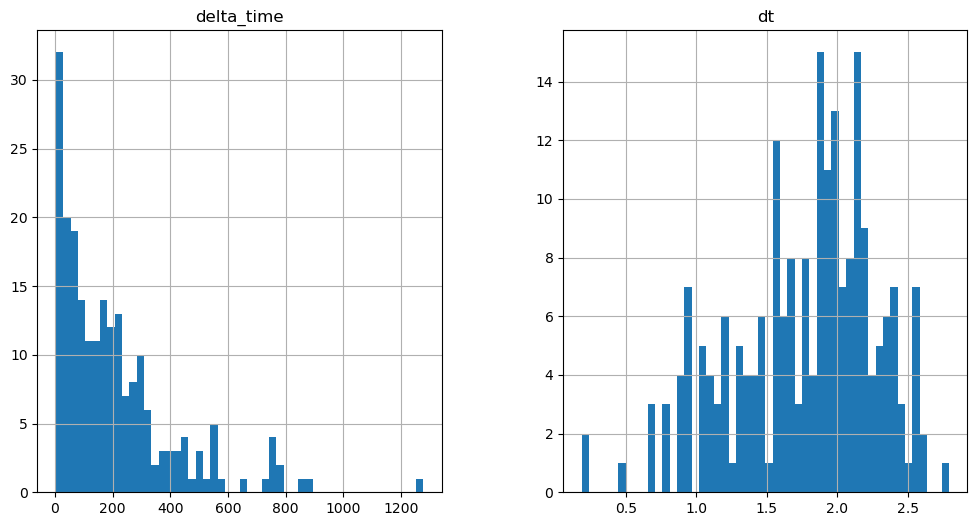

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2663.5677940249443 3.140990197658539


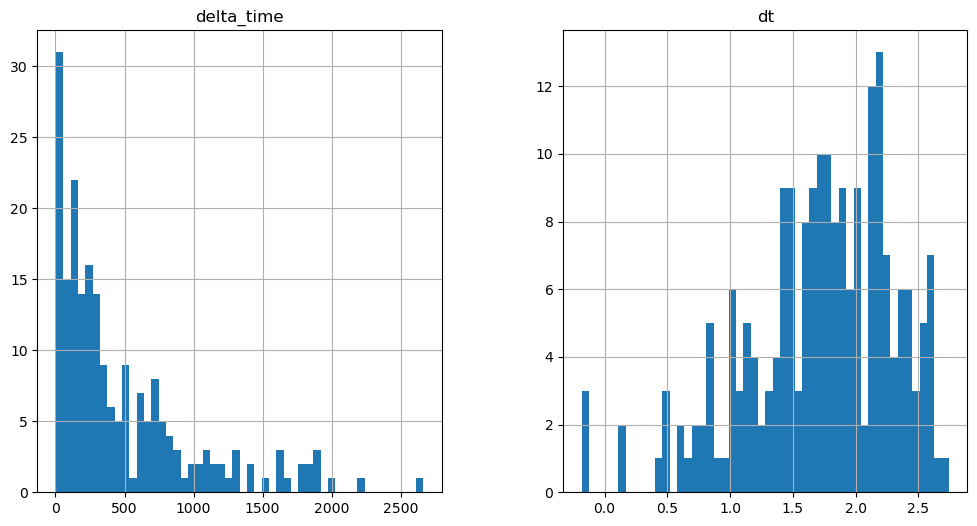

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5927.06593811512 53.397012650966644


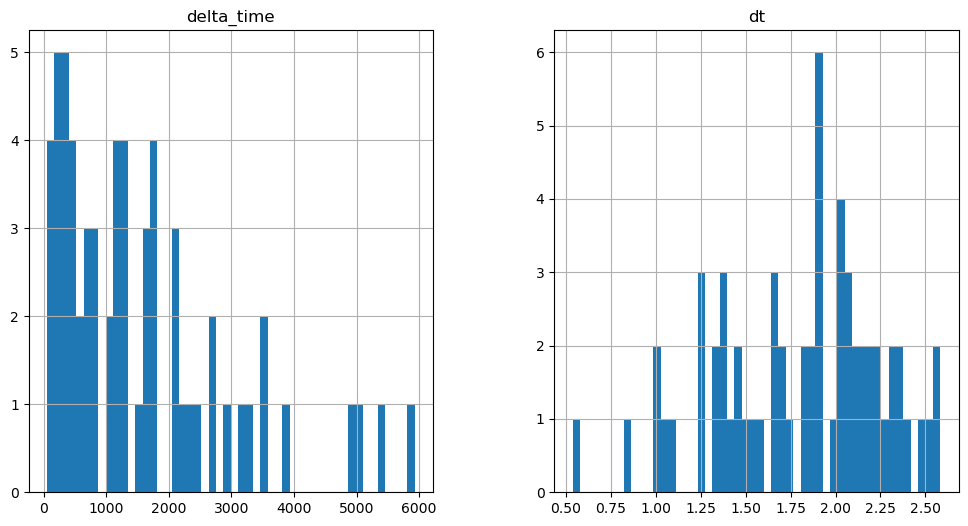

2855.168483555317 6.282000422477722


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

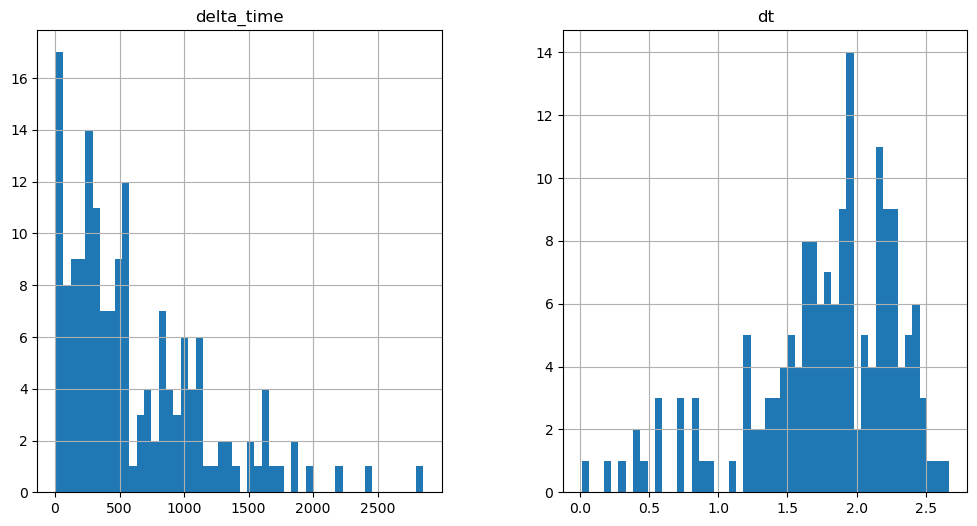

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1080.503774344921 0.1


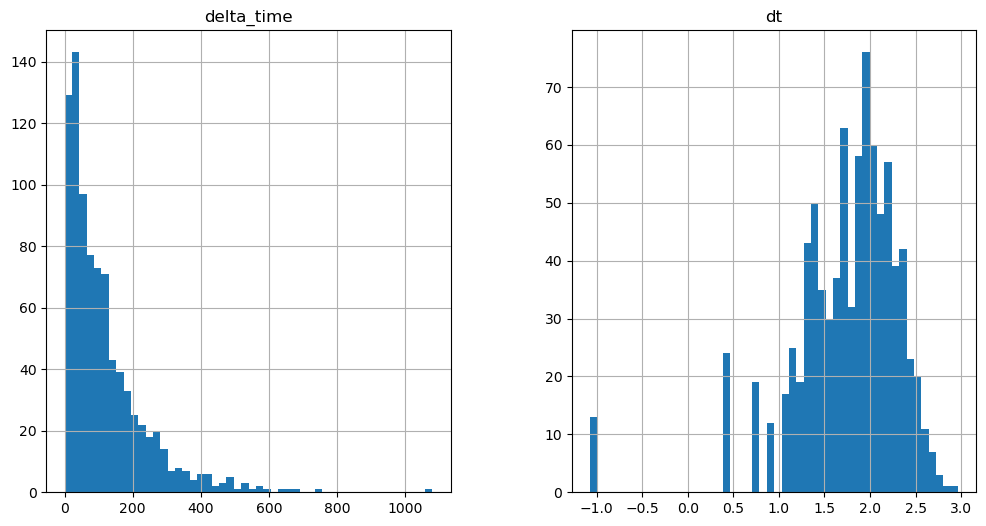

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1143.3237775564194 0.1


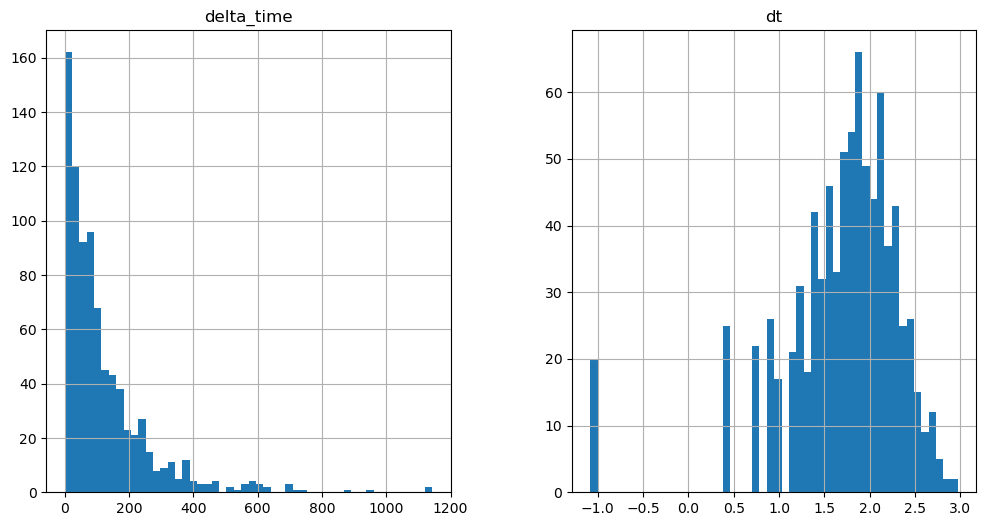

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

7233.721673846245 3.1409801840782166


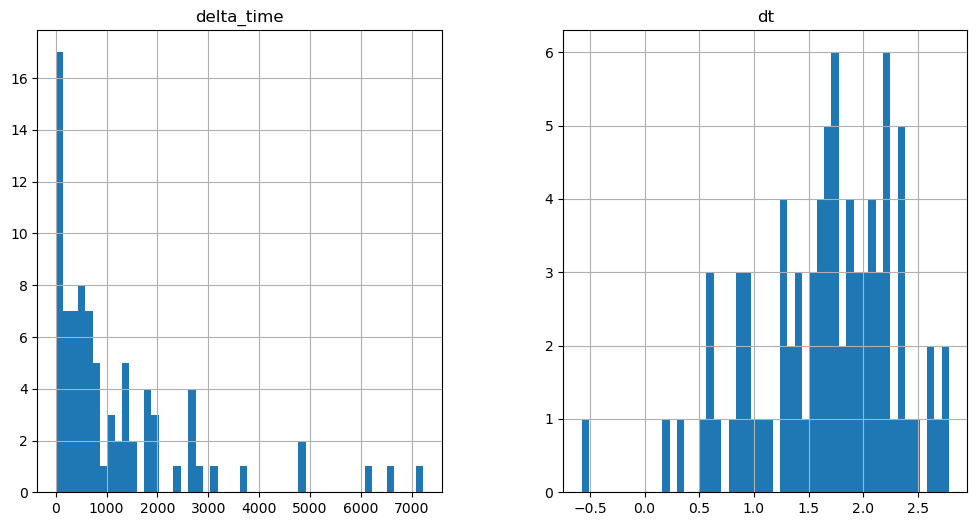

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1253.2588130235672 0.1


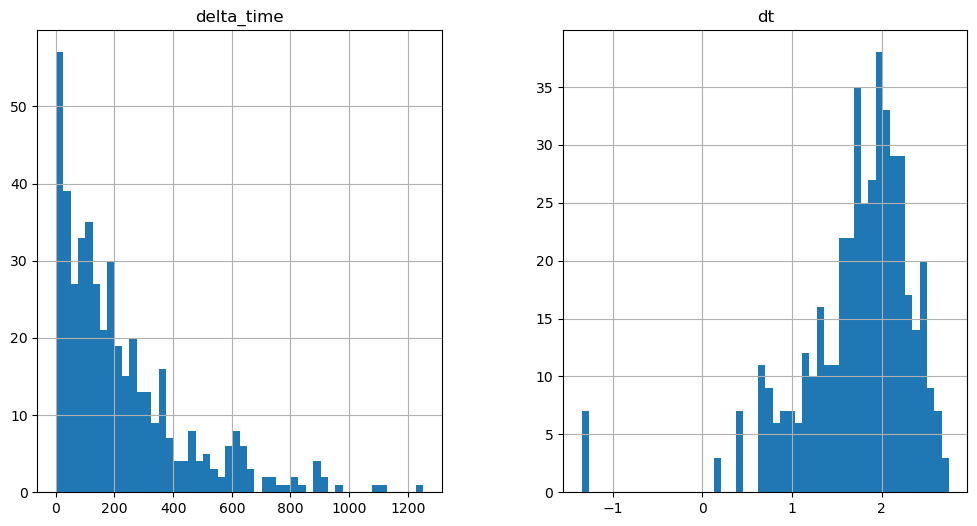

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1667.8708238005638 0.1


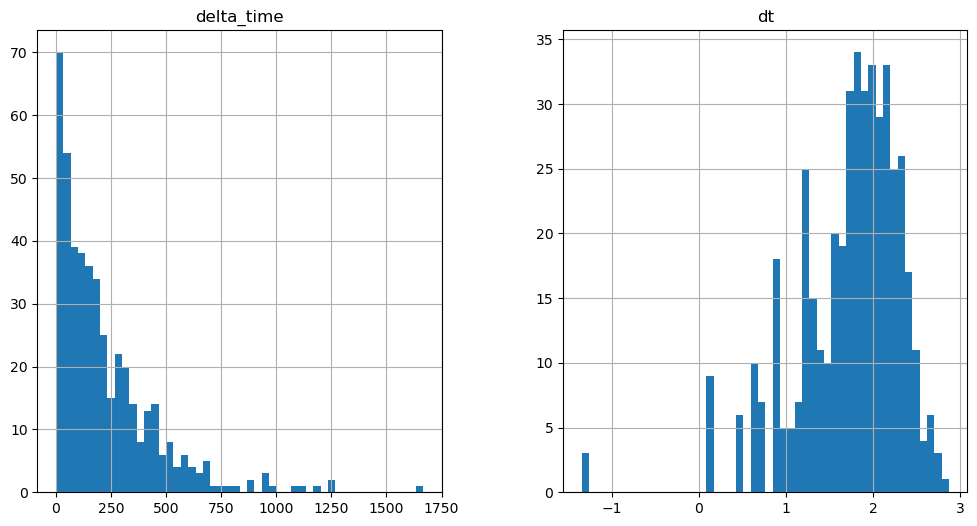

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4045.607303380966 0.1


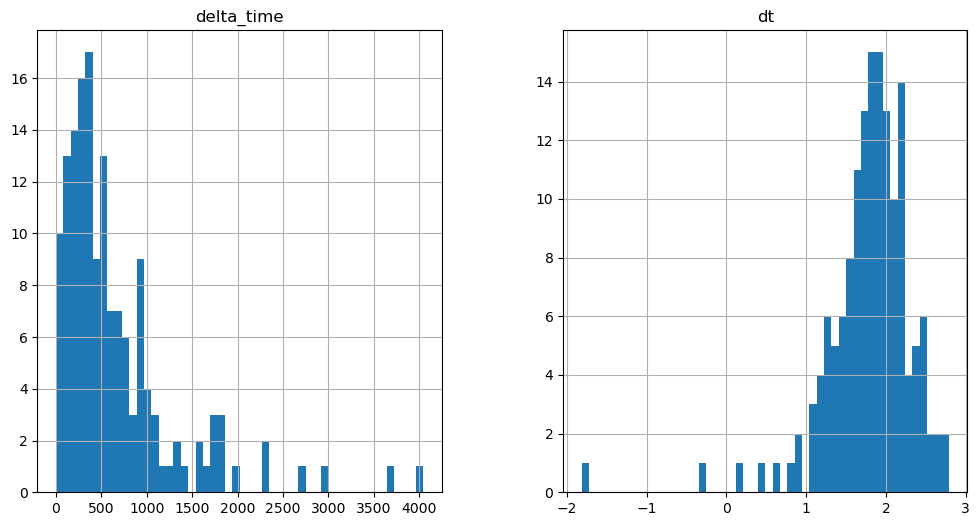

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1872.0357340574265 0.1


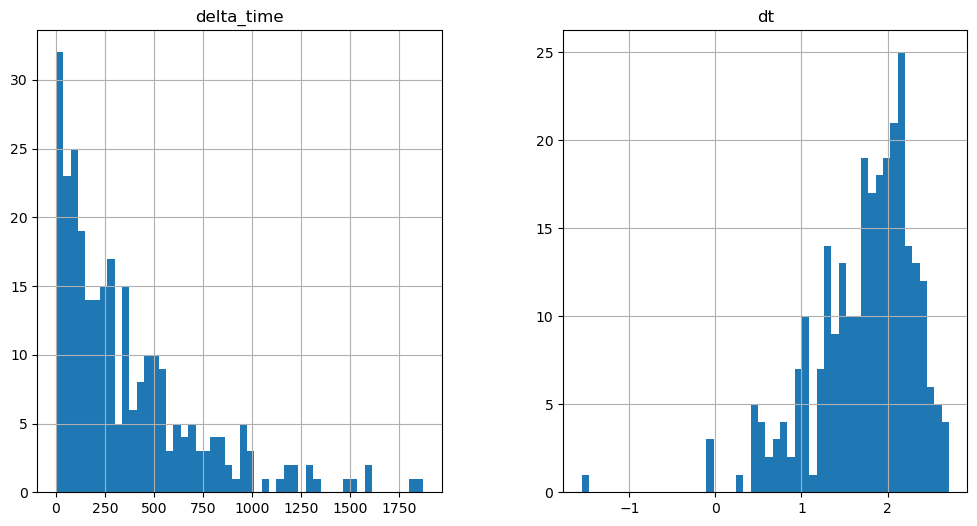

8854.47748541832 3.141010046005249


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

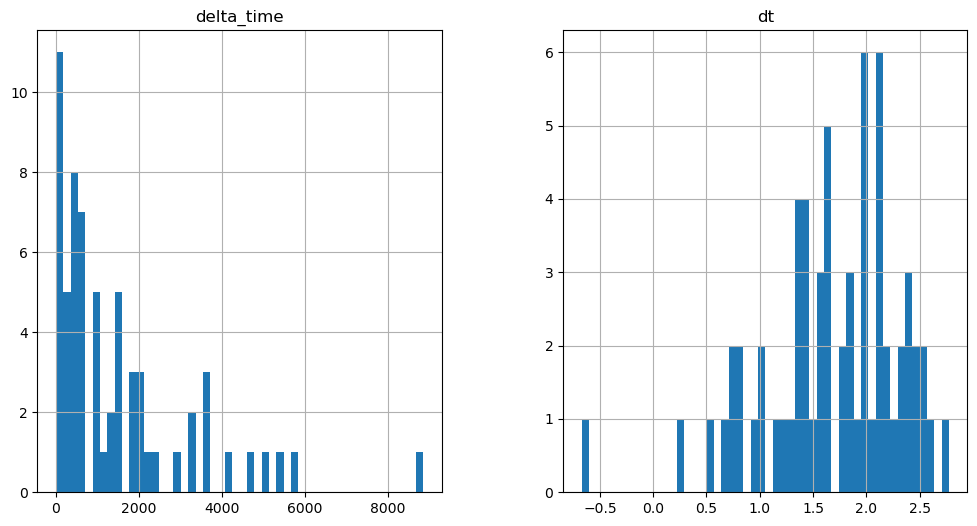

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

11194.522072851658 21.986991107463837


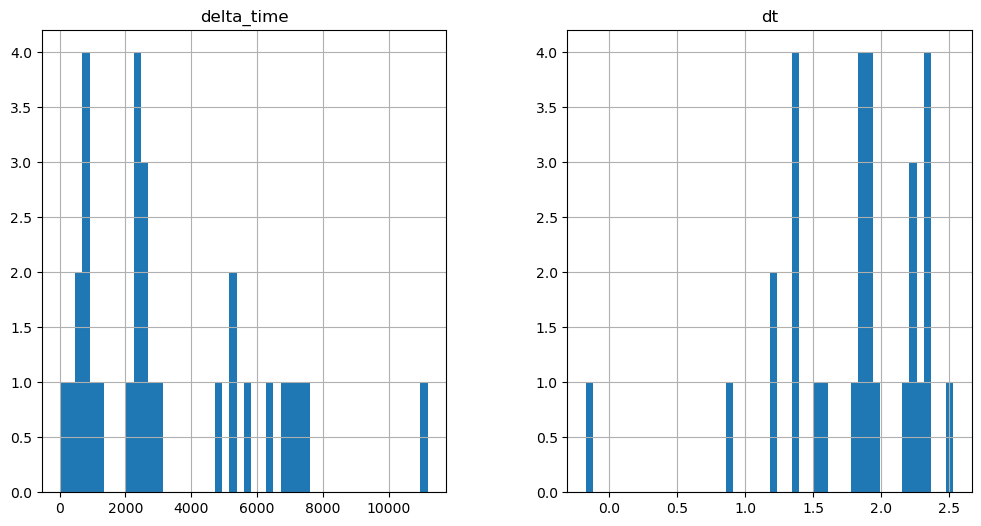

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

9551.779430270195 9.422990500926971


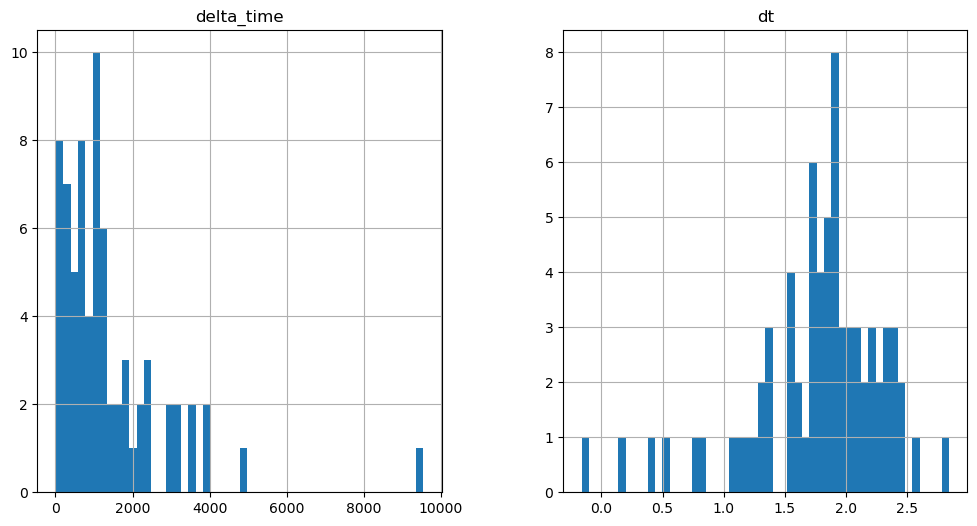

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1620.755711555481 0.1


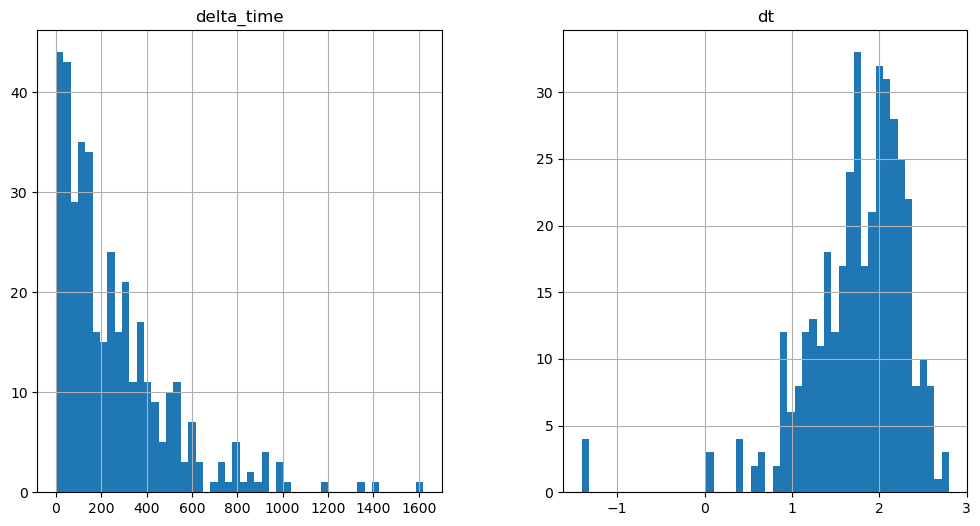

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

835.5058720111847 0.1


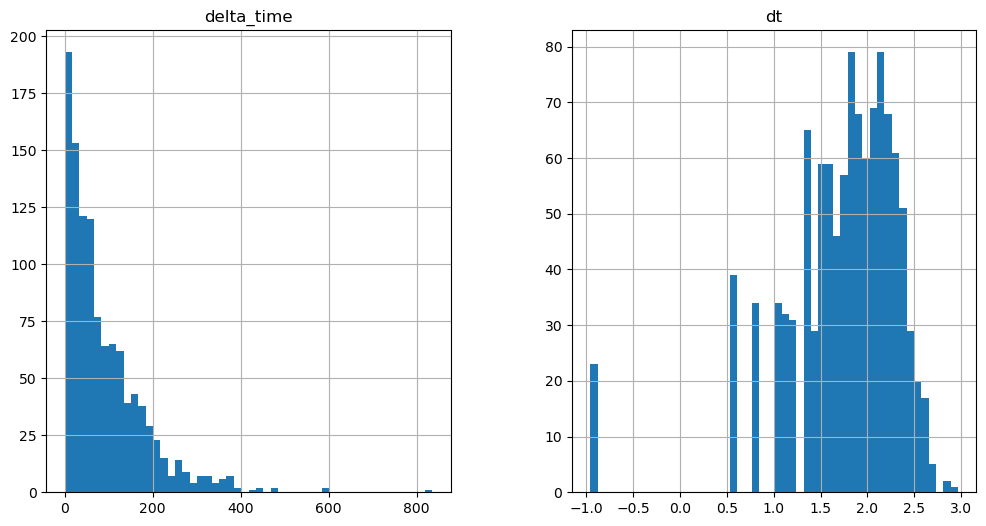

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

7108.082687437534 15.704990804195404


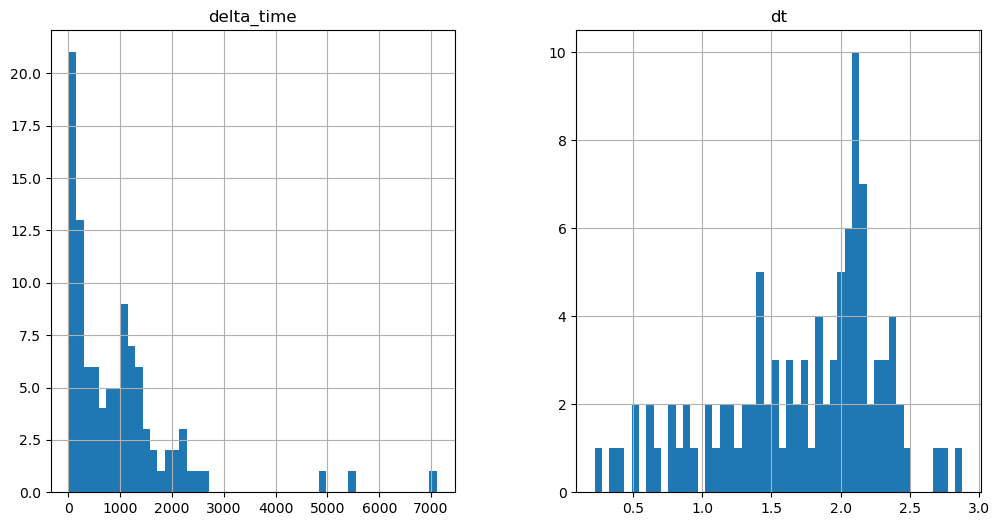

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1275.2457342743874 0.1


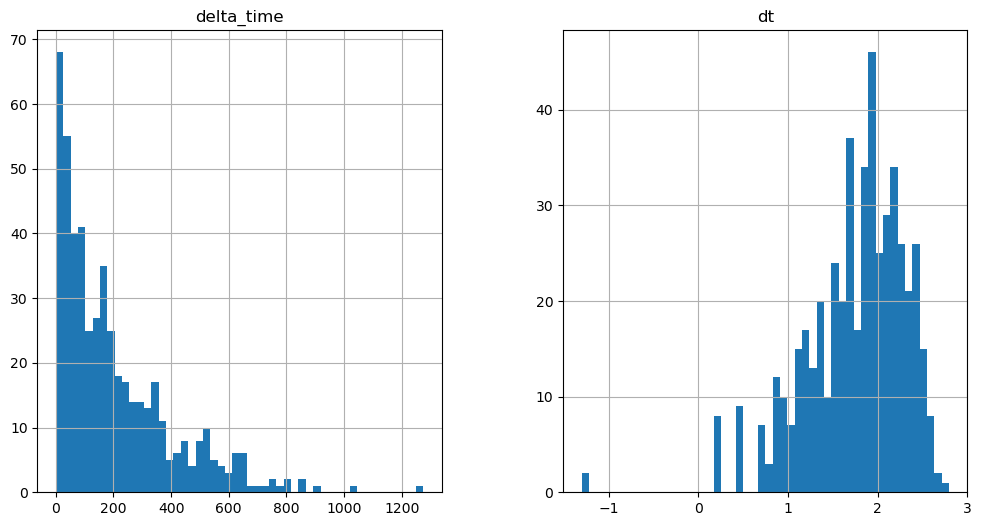

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

11800.735563516617 0.1


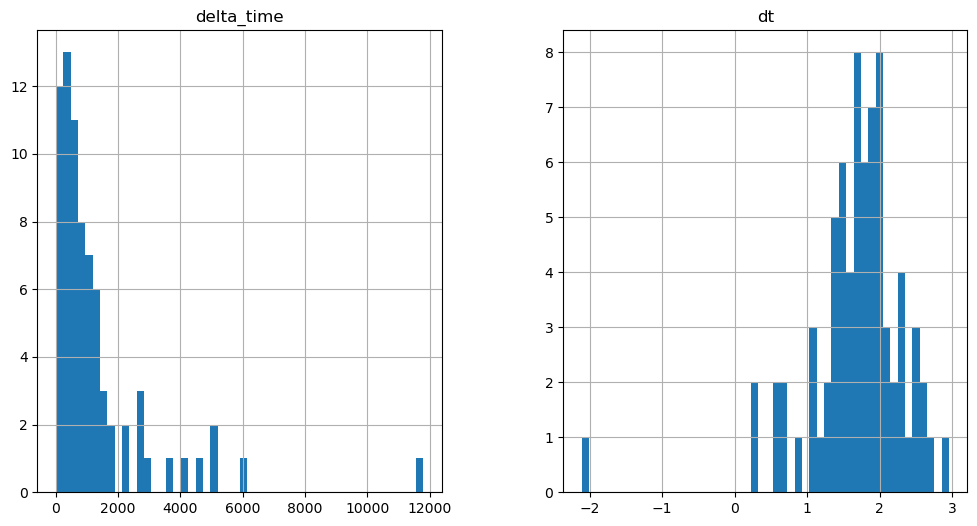

8493.262597203255 28.268991351127625


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

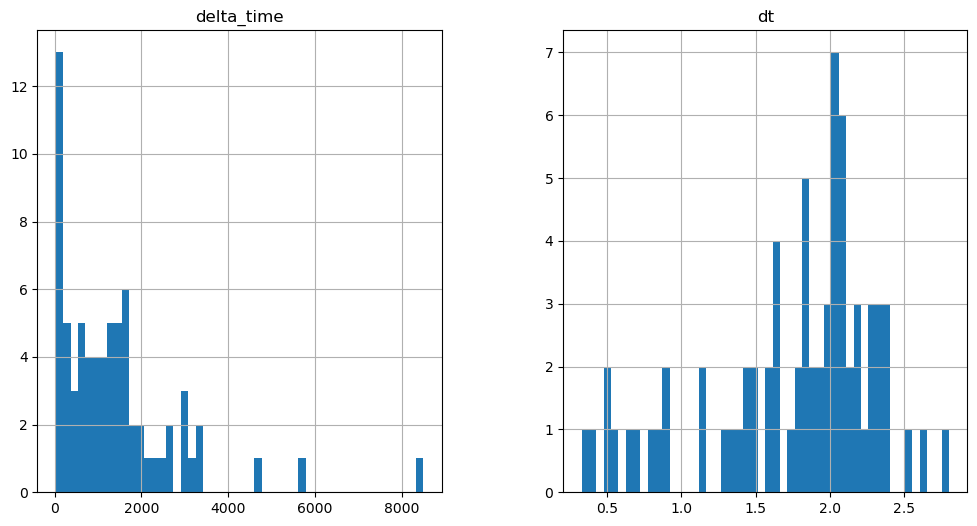

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3345.1645982265472 6.282000303268433


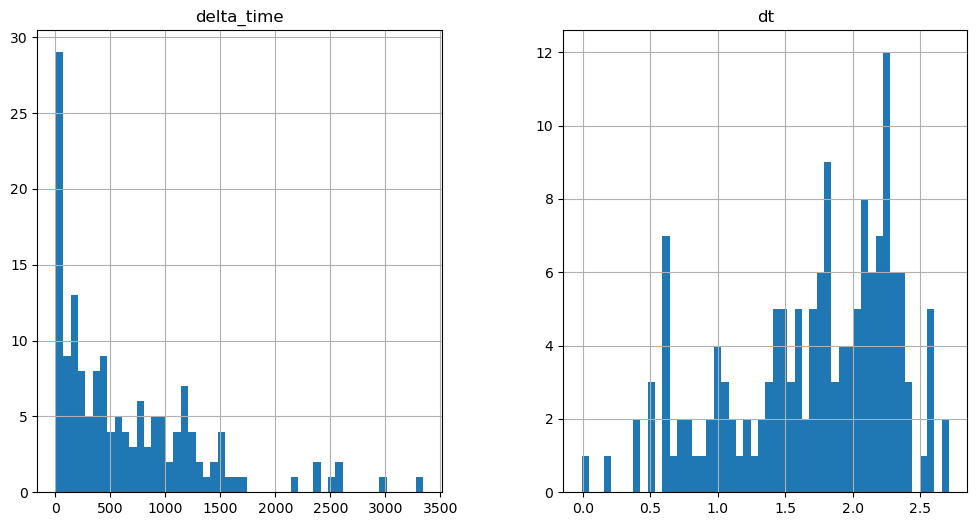

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

11018.626144170761 0.1


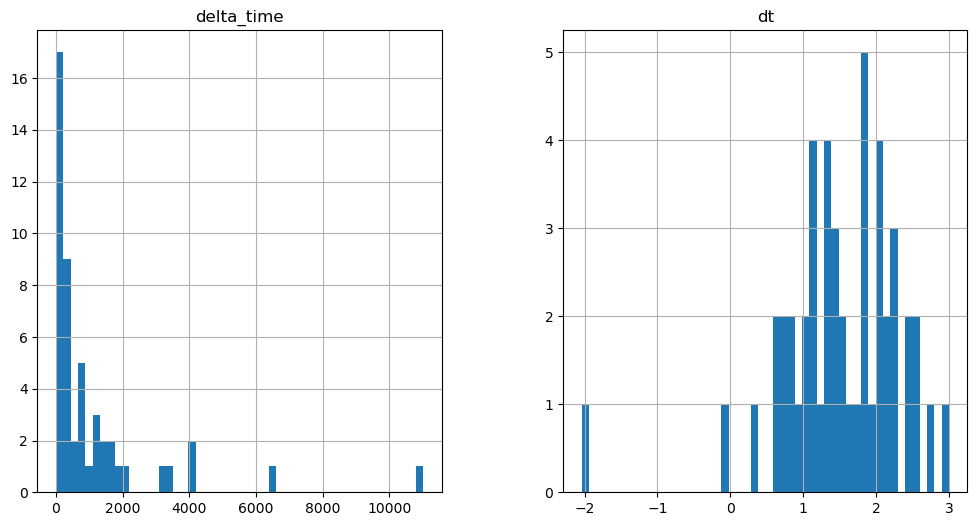

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

8411.596633076668 12.564000606536865


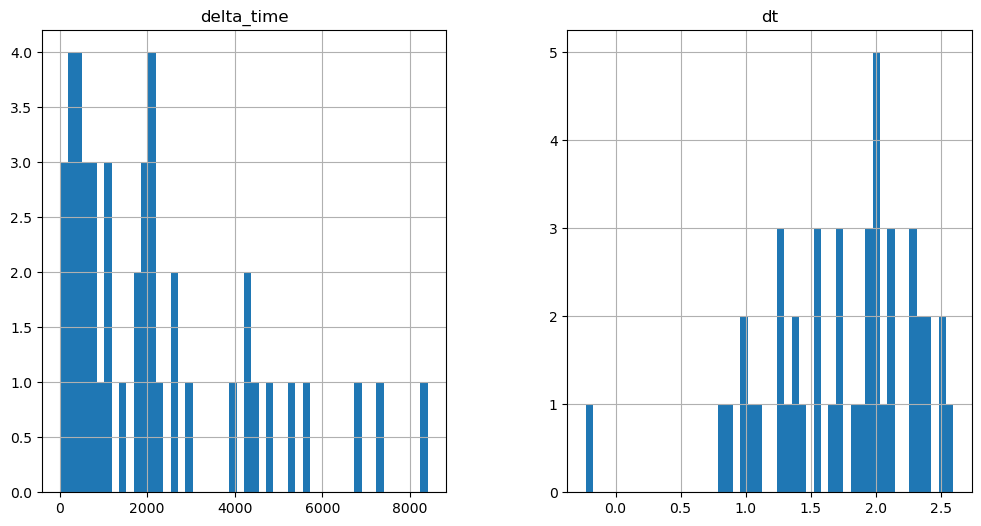

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1875.1766045093536 0.1


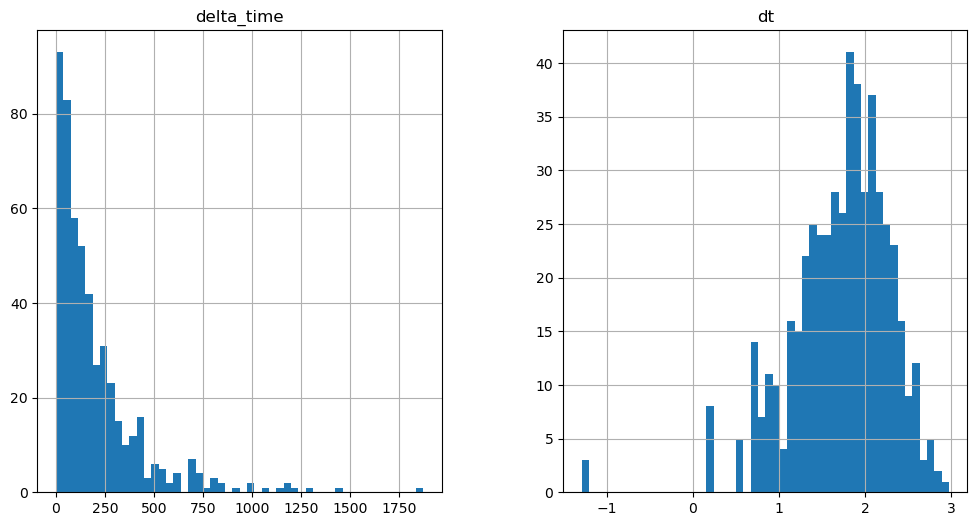

14668.46788764 37.69200187921524


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

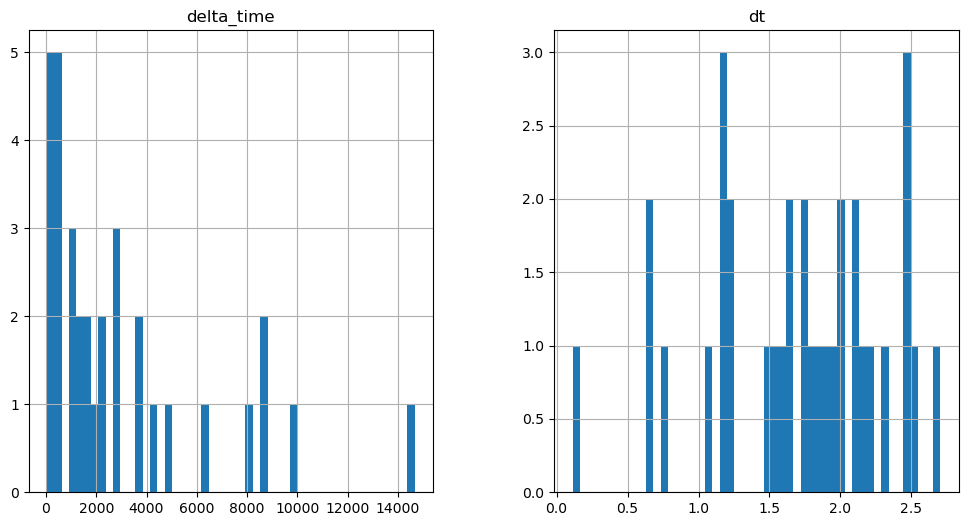

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

9328.768589258194 3.141010046005249


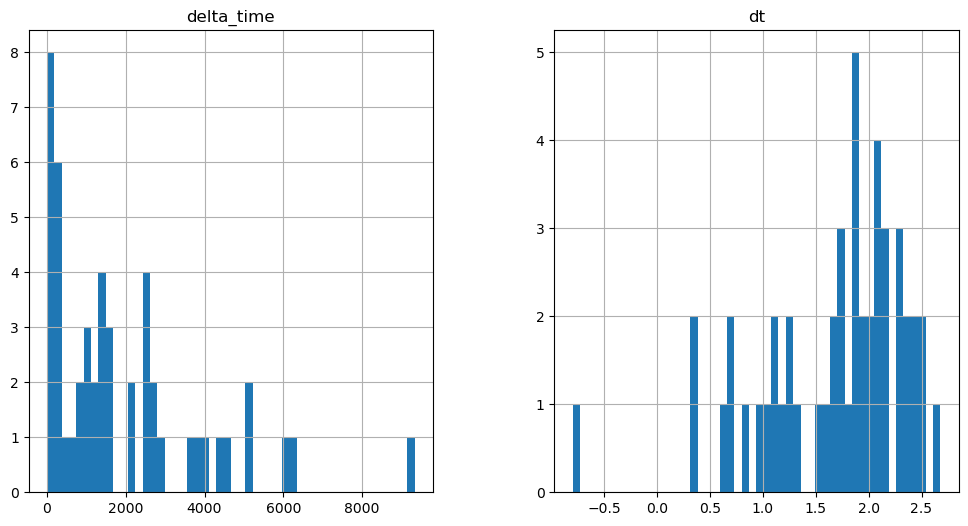

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

6812.828022539616 18.84597098827362


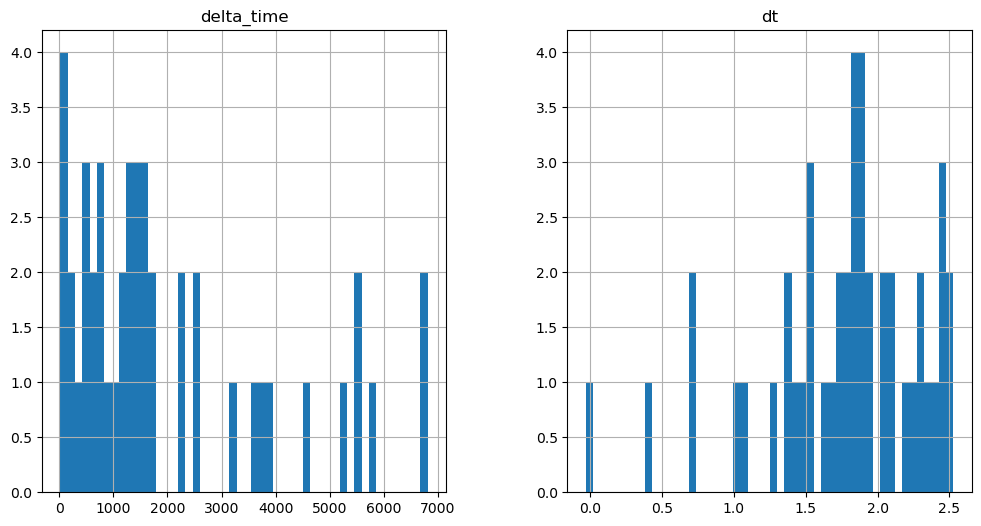

8248.265274882317 81.66598409414291


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

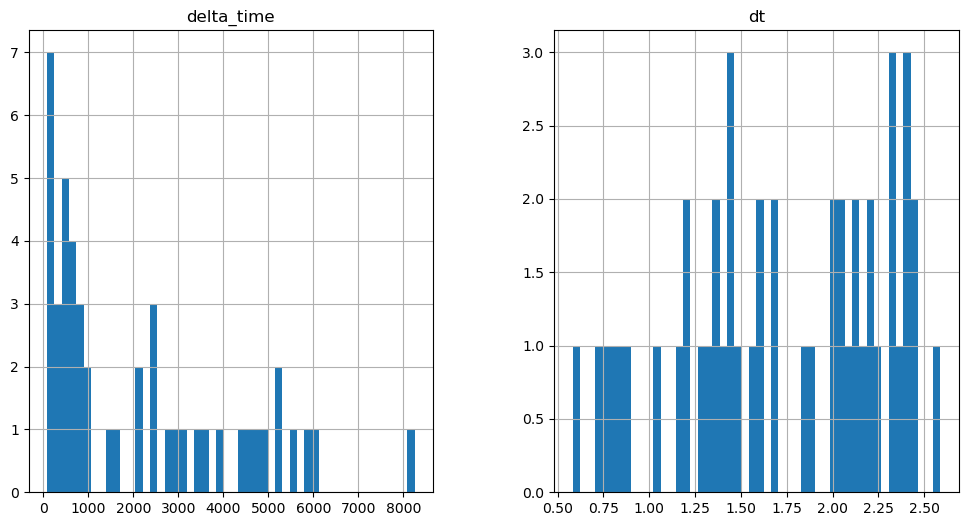

8644.030904710293 43.97400212287903


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

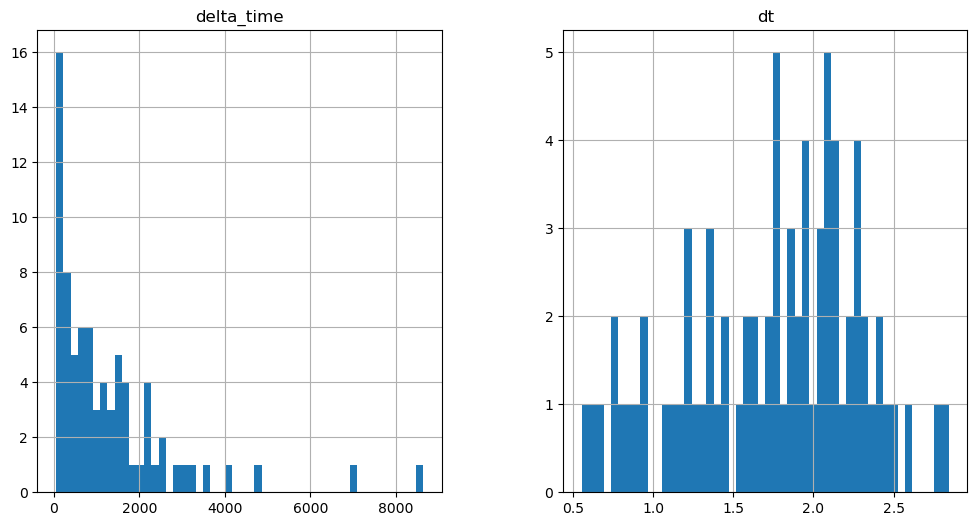

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2666.7085741758347 3.1409801840782166


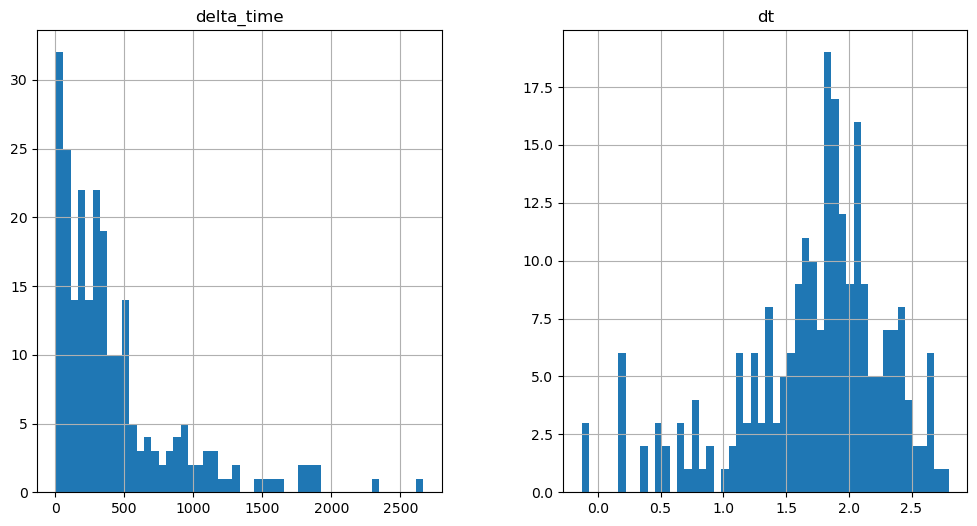

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

15258.975987434387 28.26899141073227


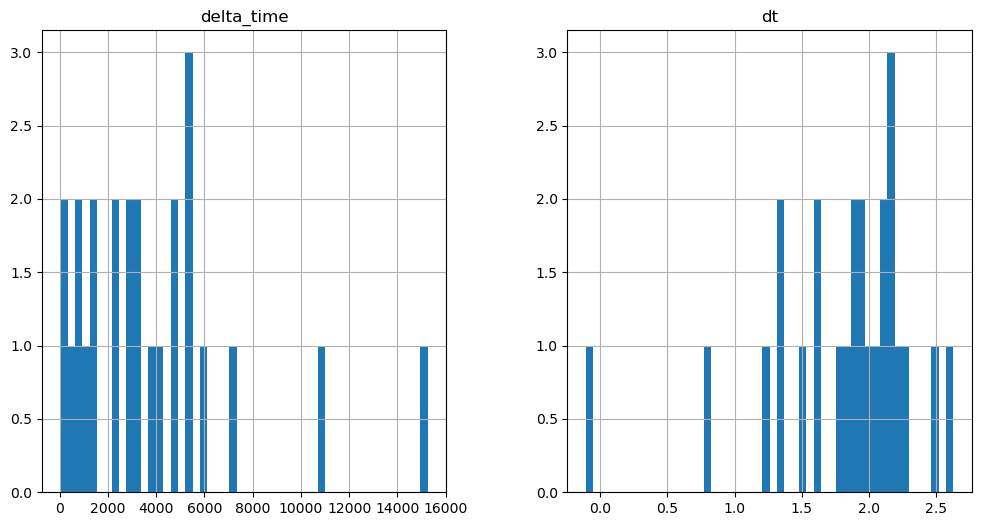

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

6150.077299296856 9.42298048734665


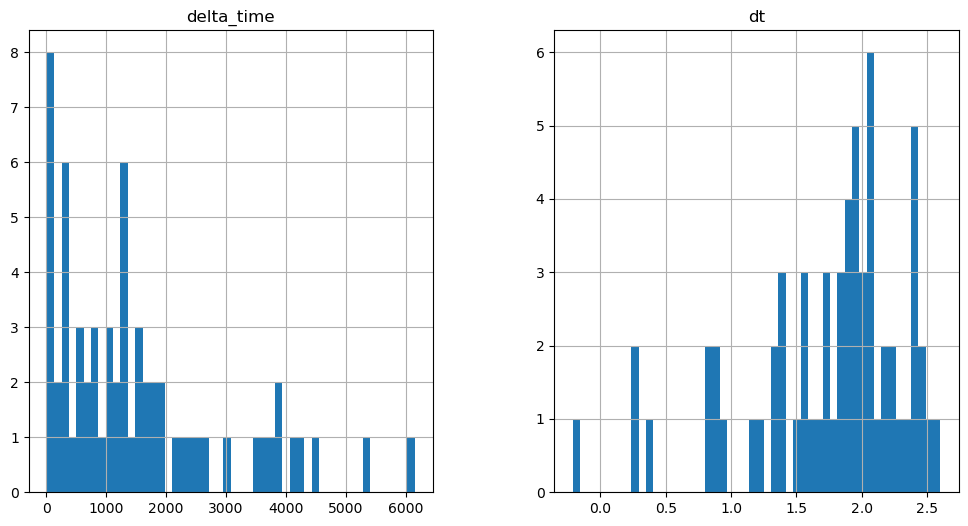

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4987.9070709347725 0.1


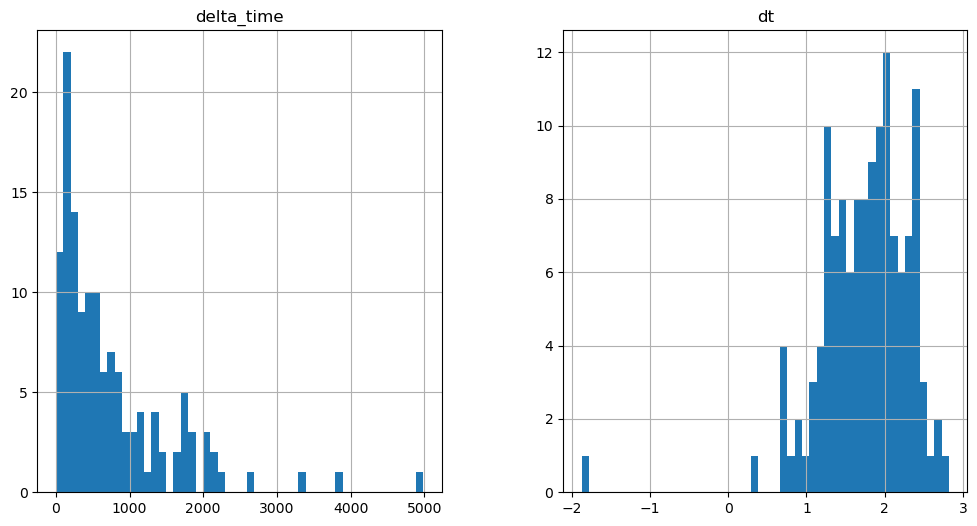

1645.8840726613998 3.1409902572631836


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

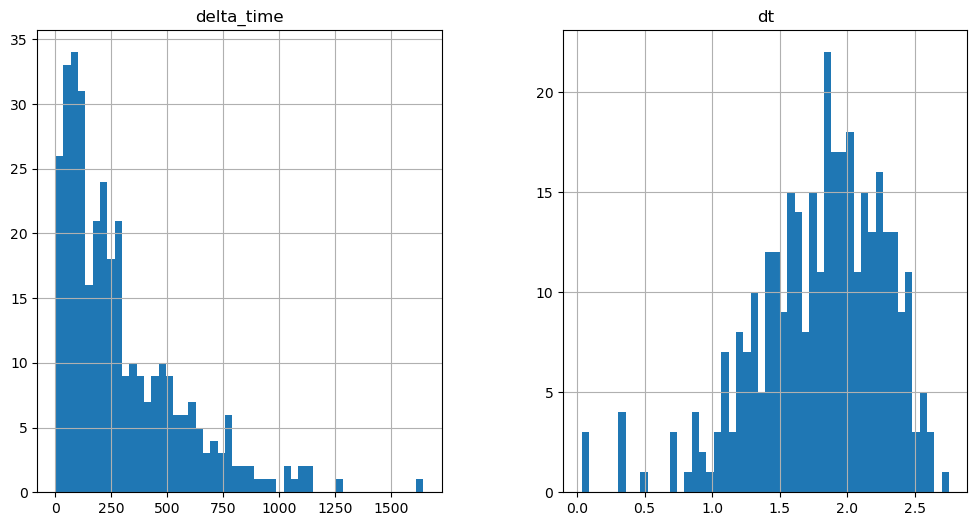

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1988.2526400089264 0.1


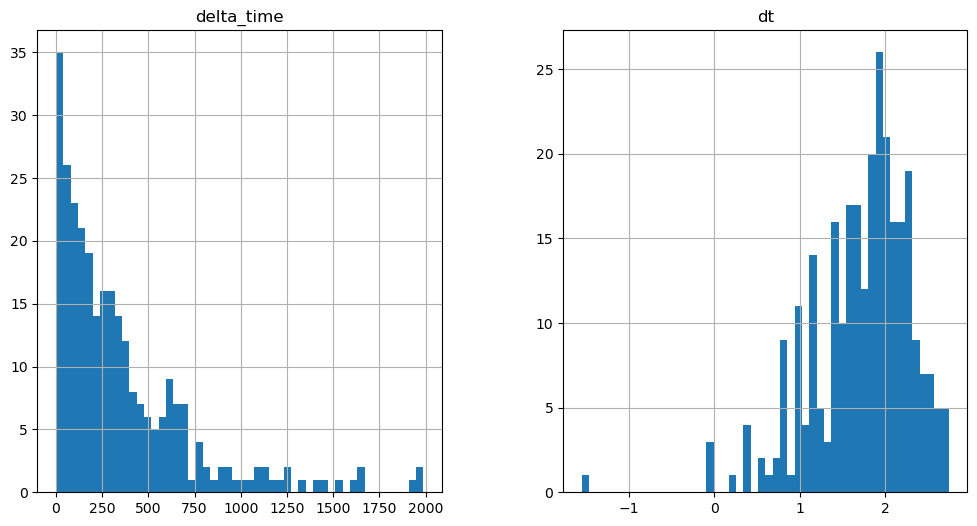

5864.246194899082 37.69200187921524


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

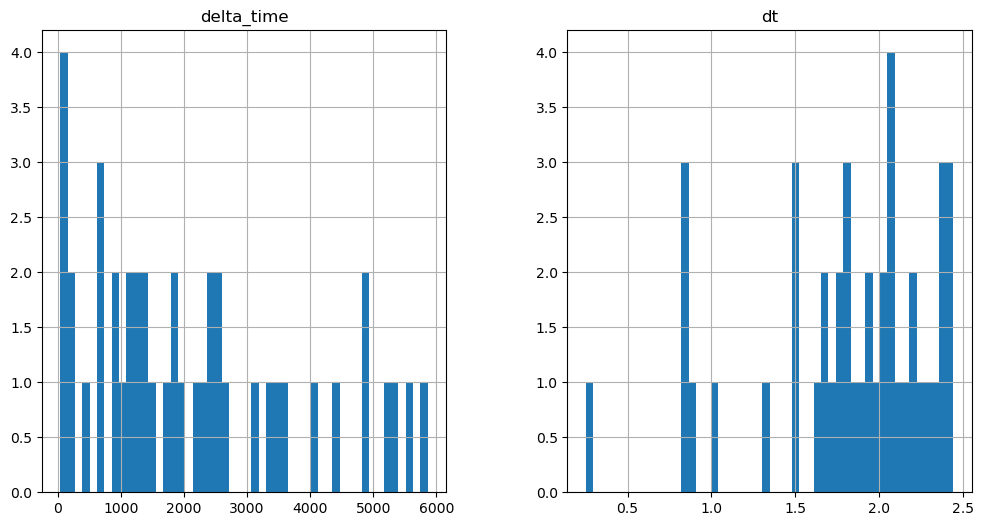

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2352.608668386936 0.1


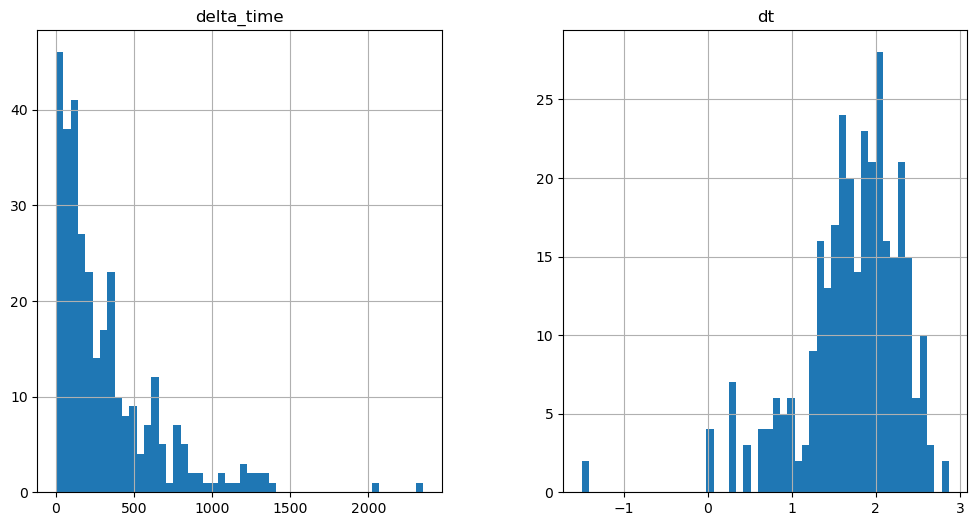

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

7305.964777469635 141.34521704912186


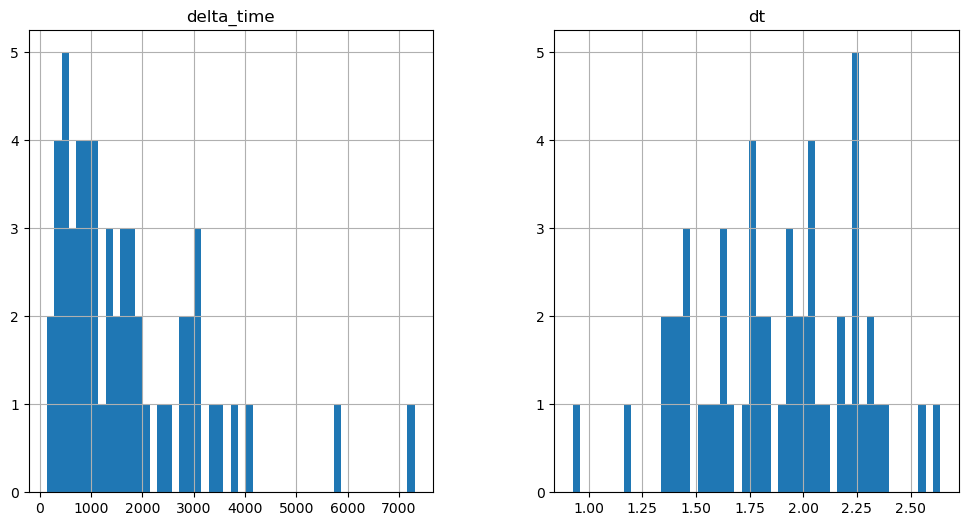

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3750.3534185886383 6.282000303268433


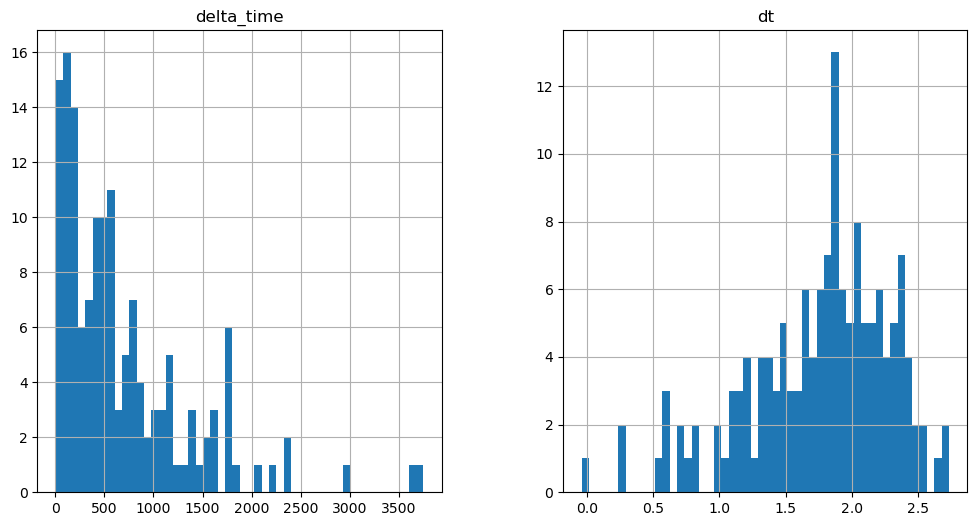

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3153.563528597355 3.140980303287506


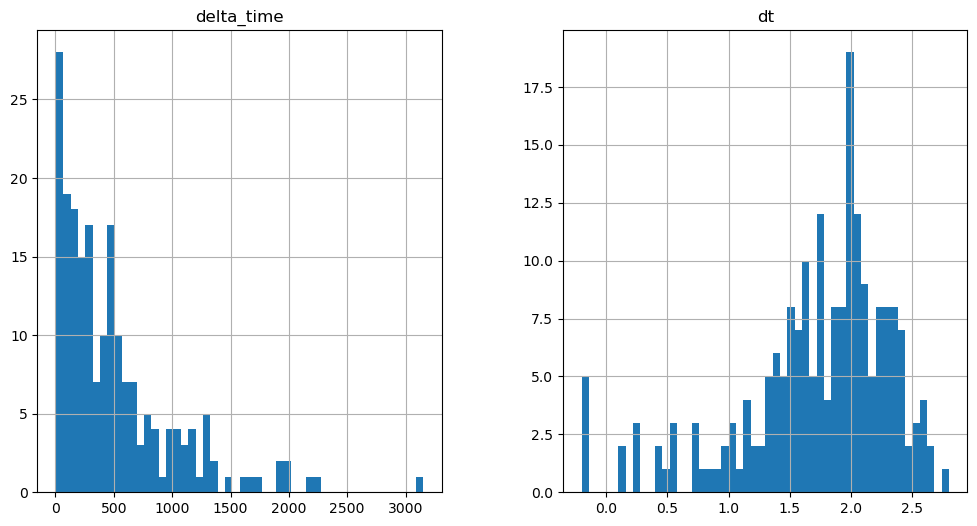

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3241.5130229592323 0.1


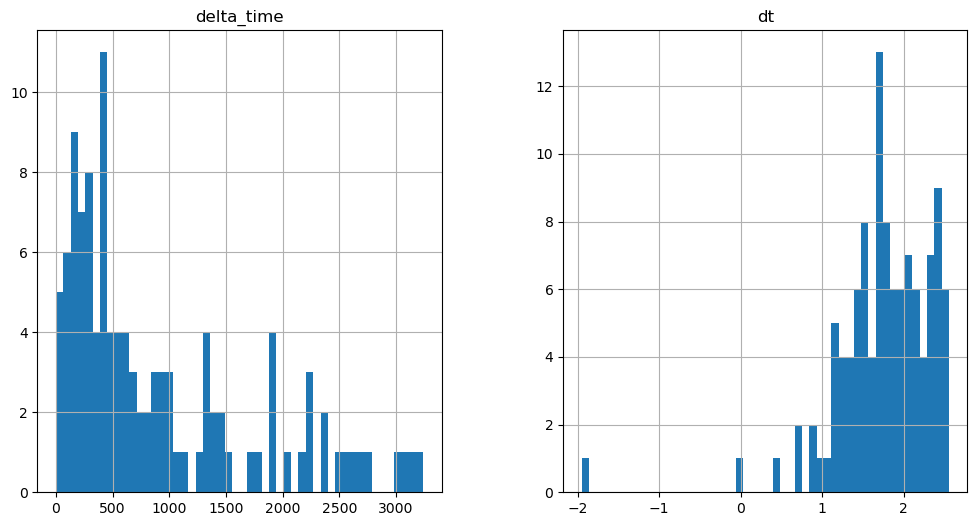

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3596.4446808099747 0.1


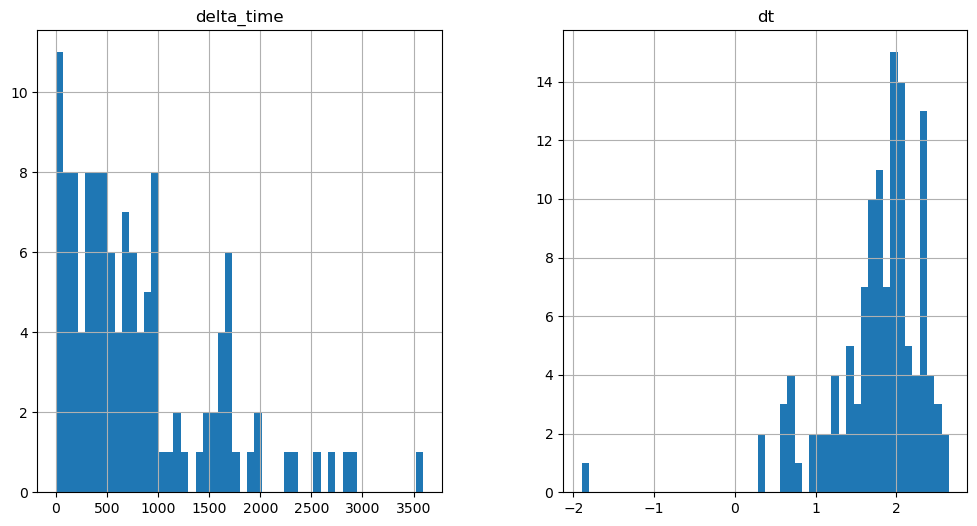

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4029.933799982071 12.56411063671112


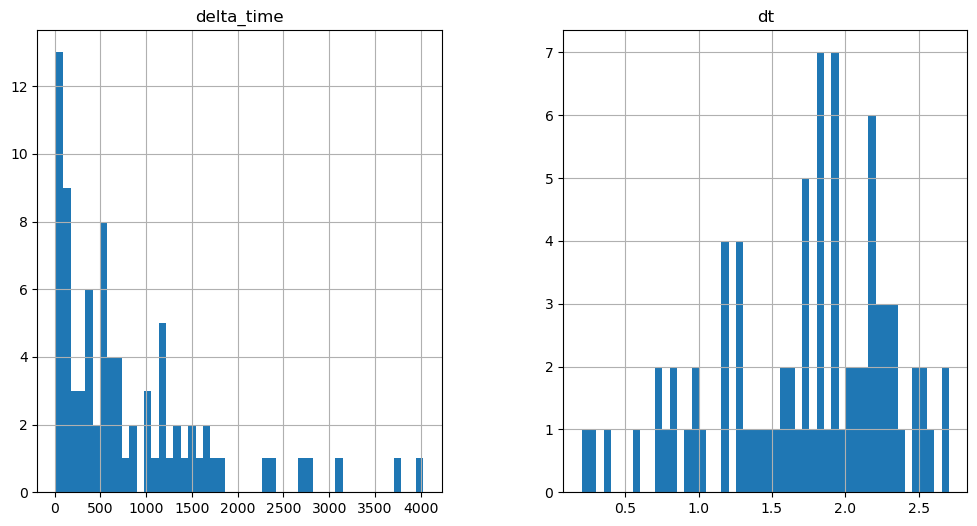

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3753.5264062285423 9.423080503940582


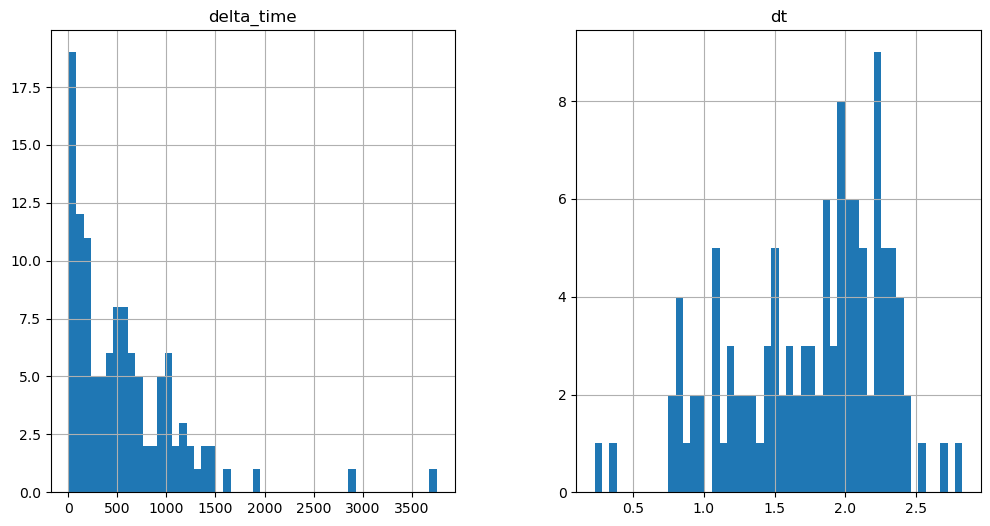

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

7142.655934453011 12.564100623130798


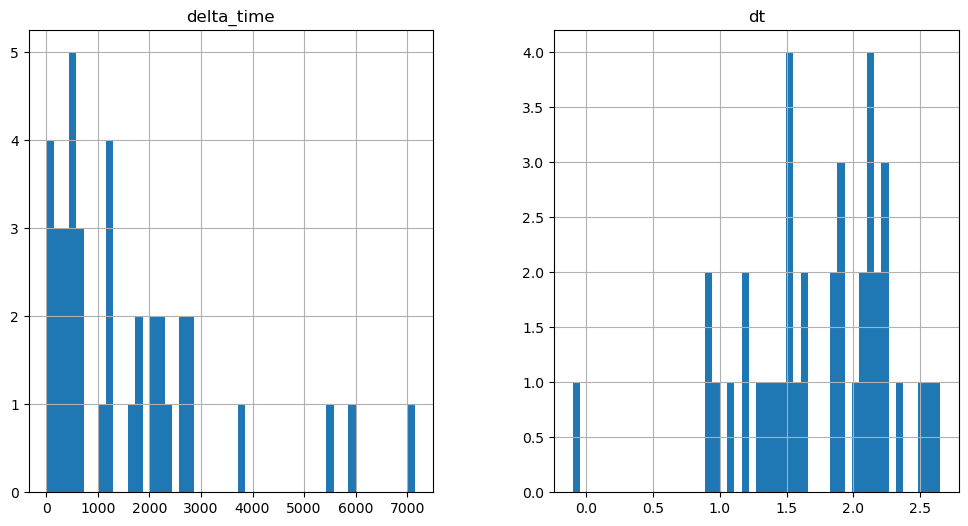

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4541.896345496178 84.8077142238617


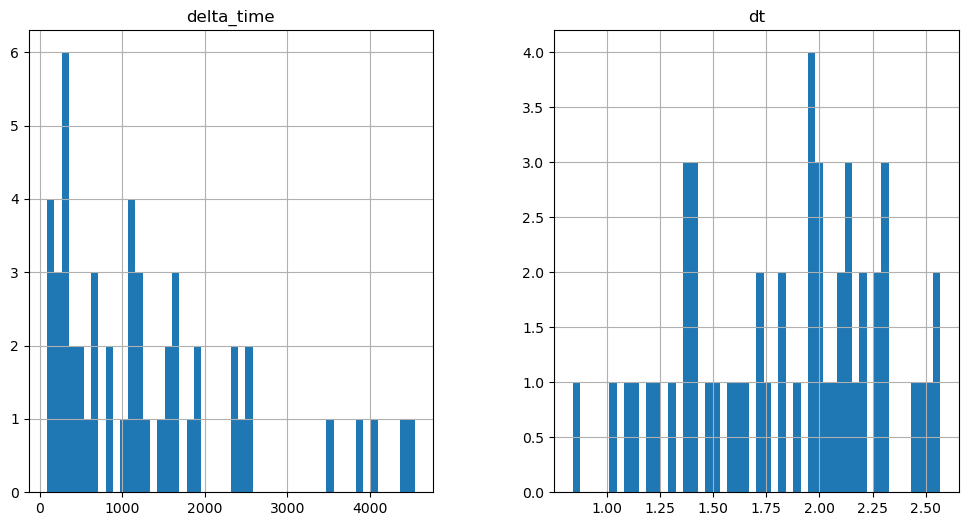

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3596.4527984261513 3.141000211238861


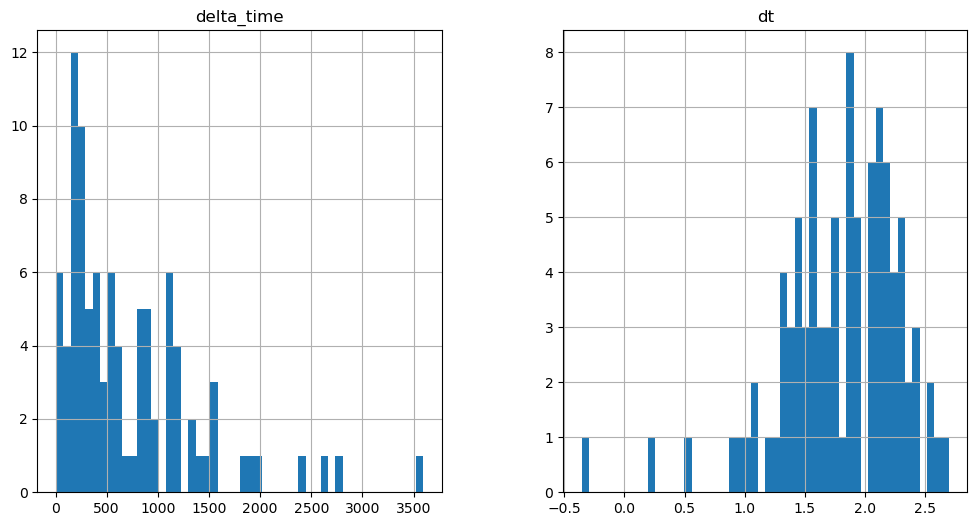

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2977.690987765789 12.564090728759766


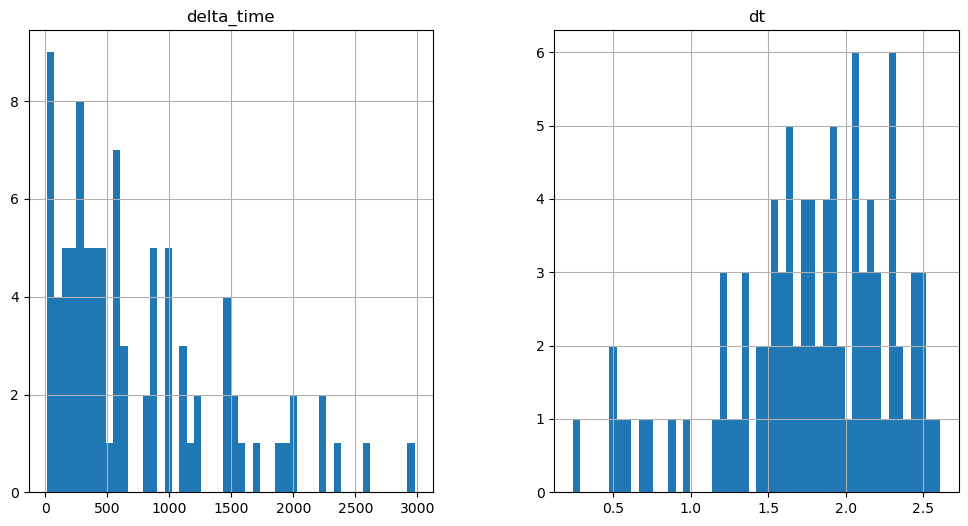

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2336.922675907612 3.1410300731658936


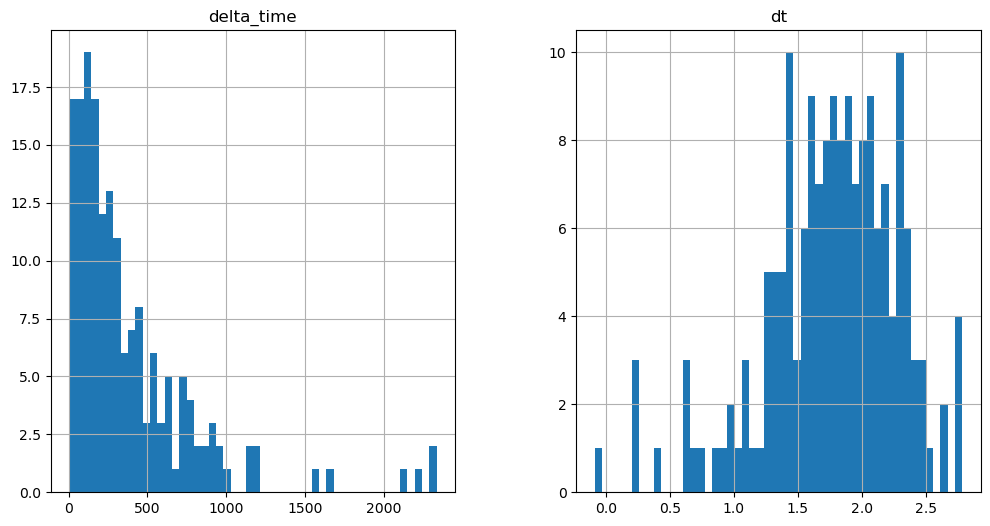

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1265.833102941513 3.1410102248191833


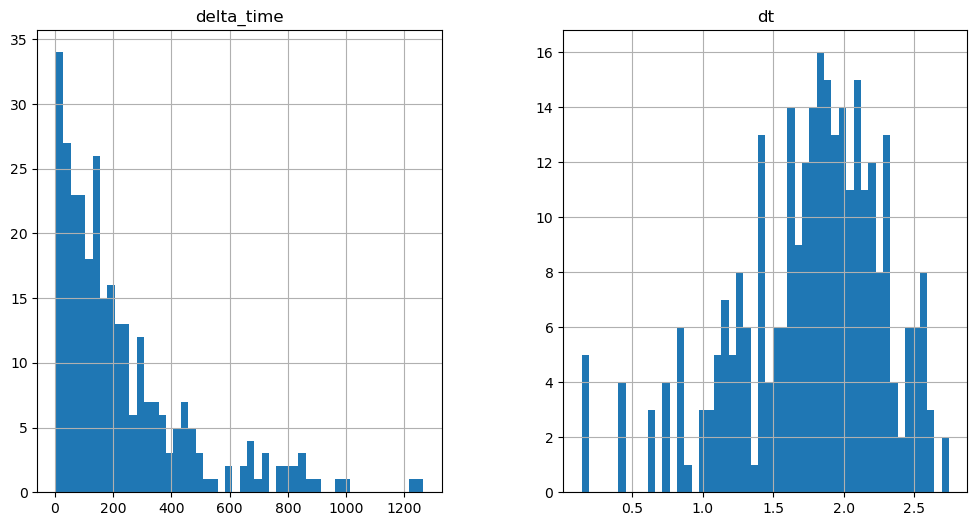

3049.9340312480927 9.42303055524826


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

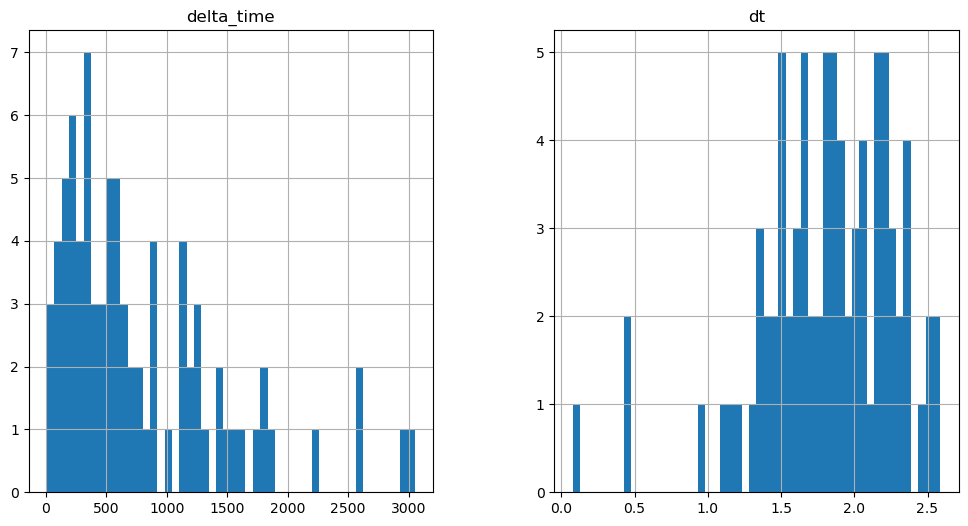

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2029.1013607382774 3.141020178794861


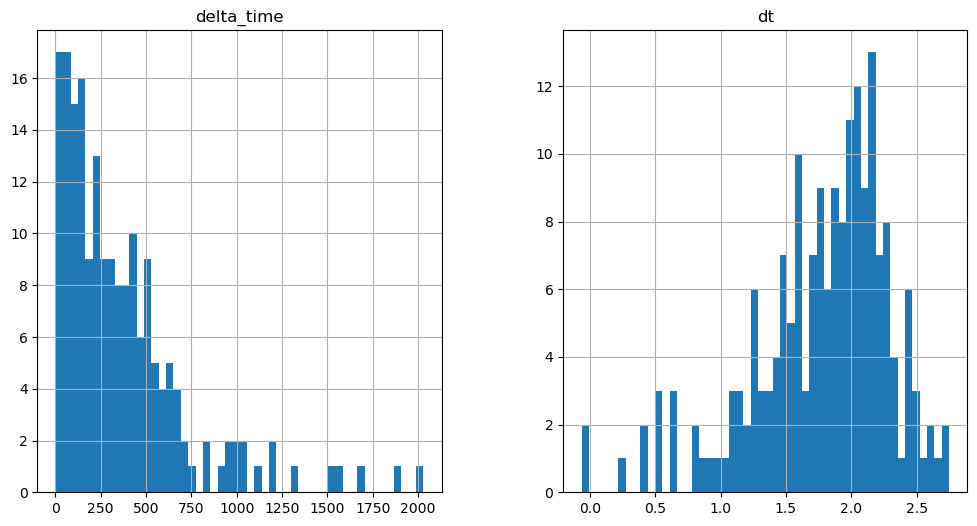

1567.3703478574753 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

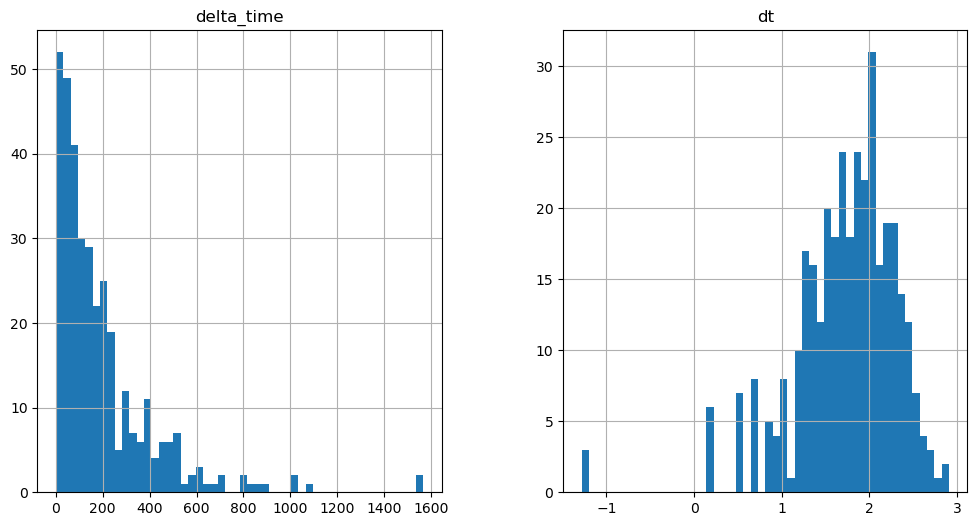

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2283.5232335329056 0.1


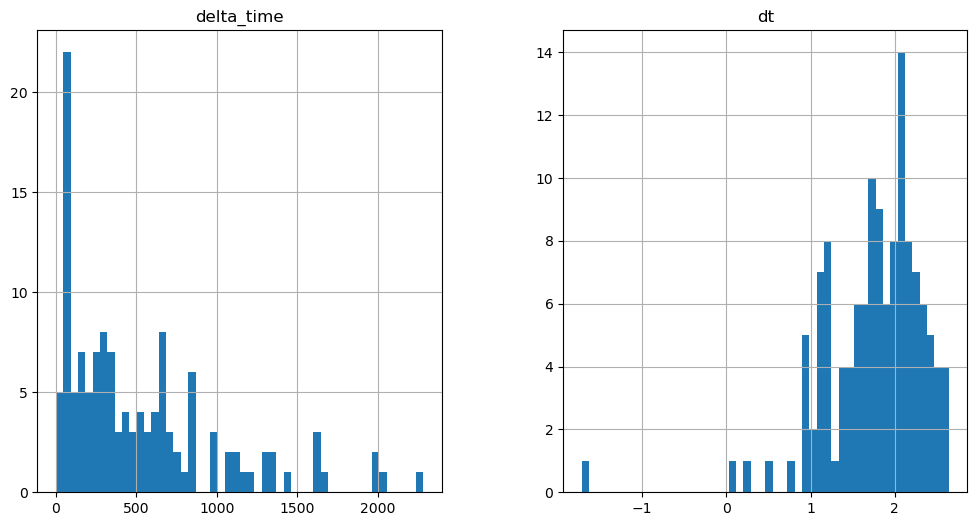

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4384.867147624493 3.1410300731658936


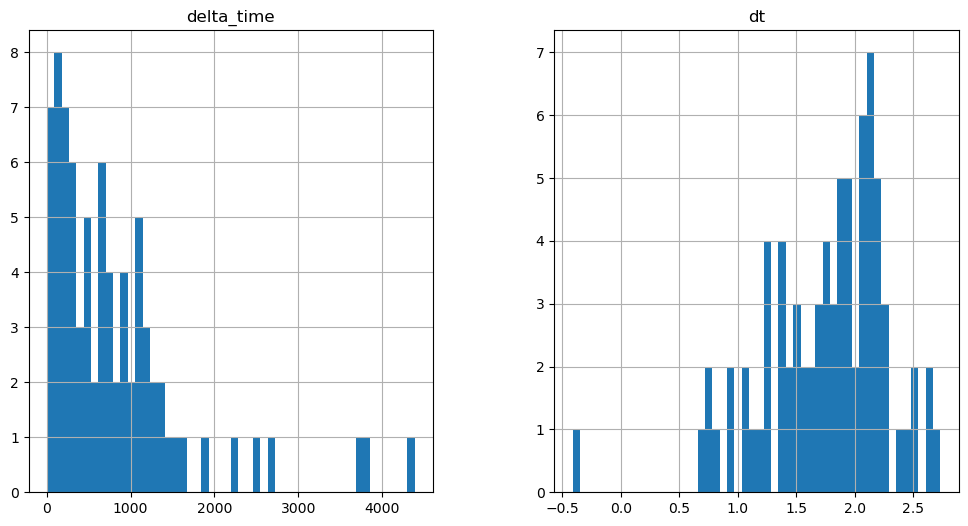

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3941.9874356389046 12.564100563526154


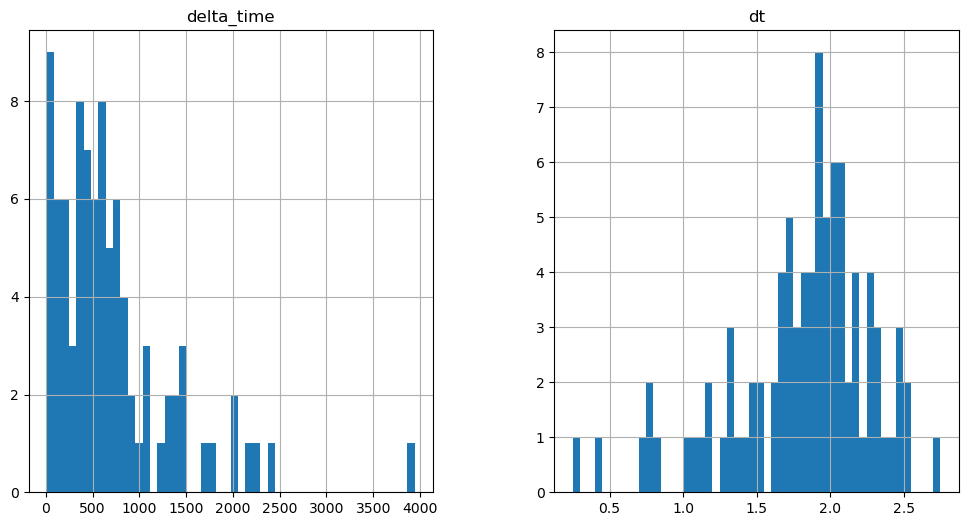

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2911.7264444828033 12.564100682735443


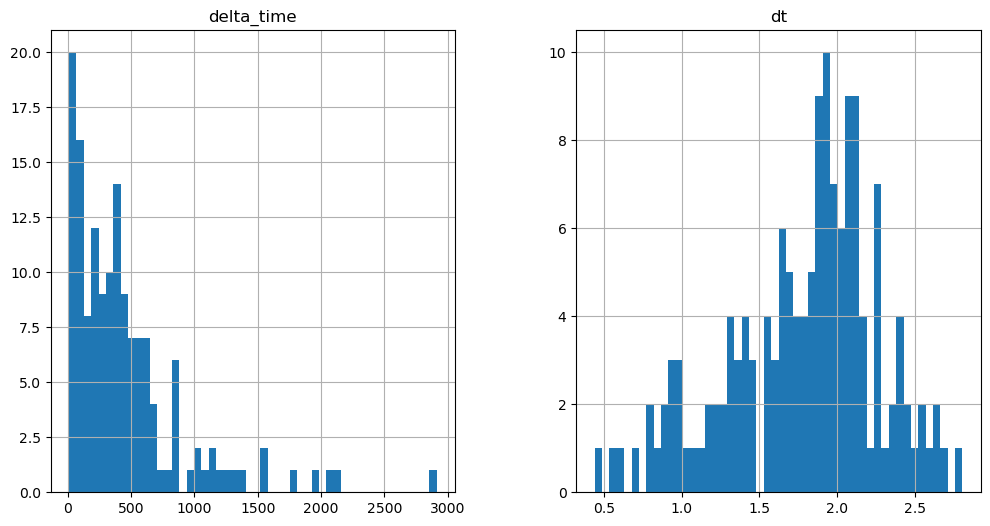

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

6976.214836239815 12.564090609550476


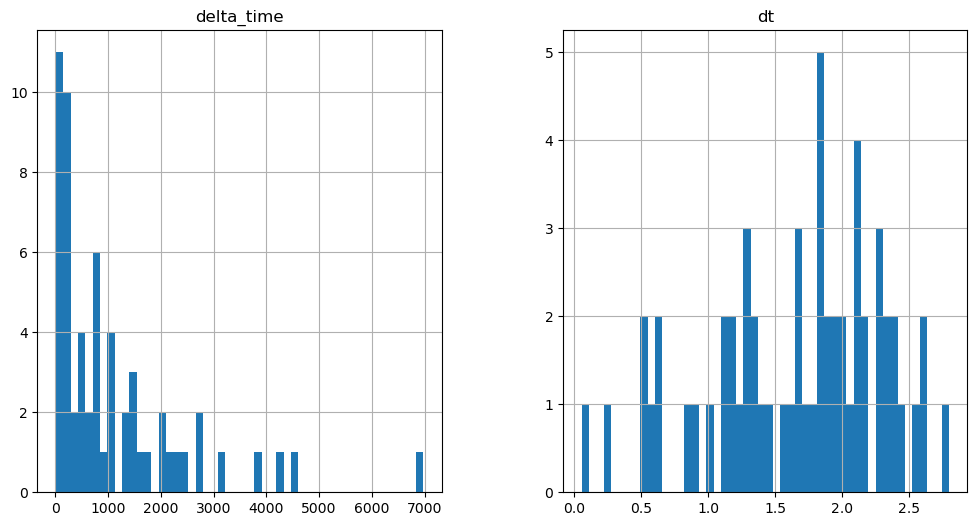

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1476.2823432087898 0.1


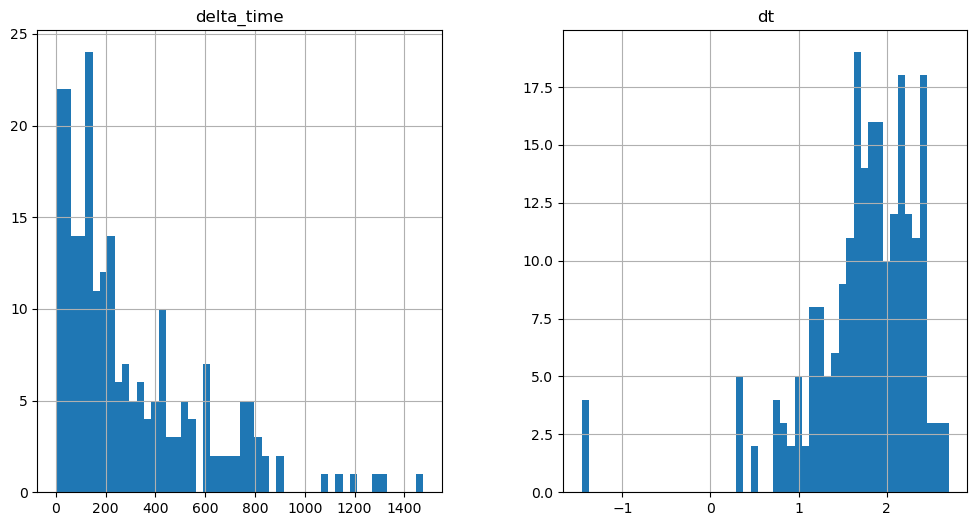

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

7896.53935188055 12.56409066915512


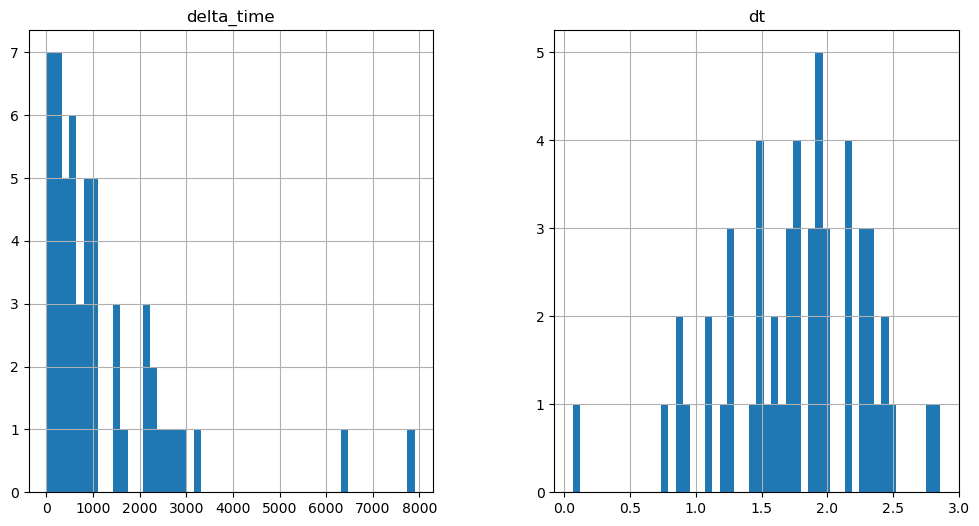

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4375.449017107487 3.1410301327705383


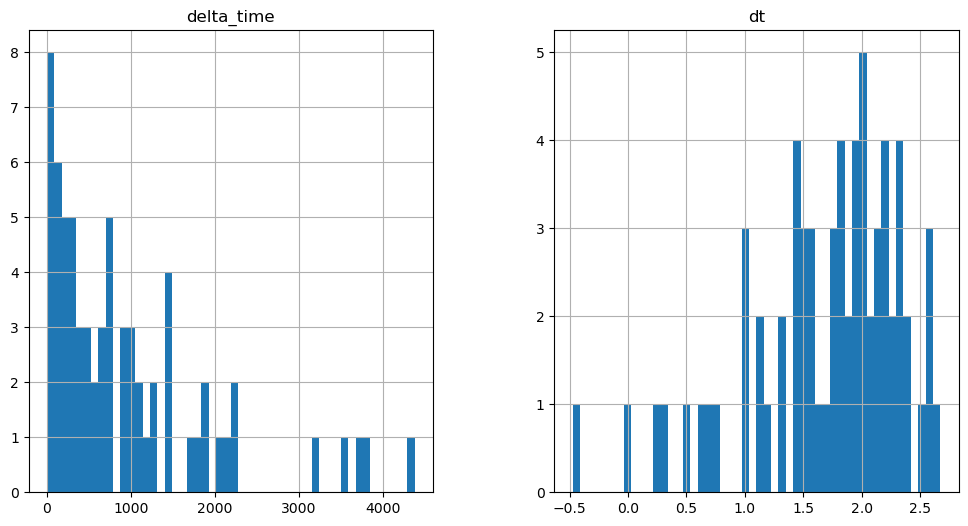

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4438.269670188427 21.98718112707138


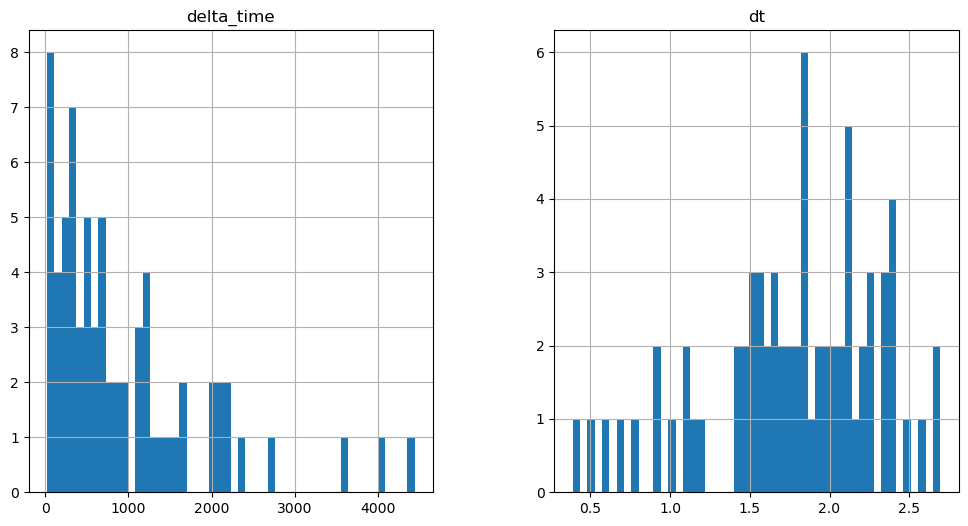

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

6746.921954810619 15.705130815505981


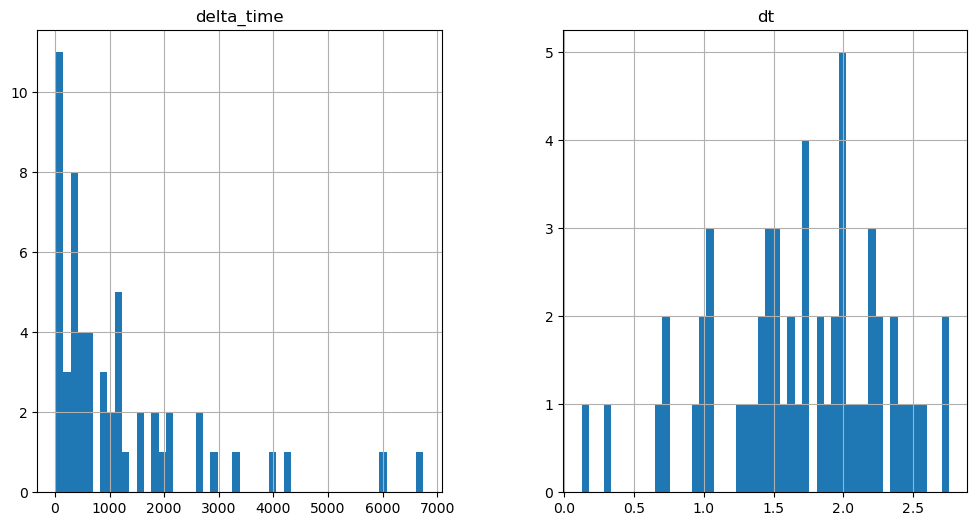

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1190.4485891461372 0.1


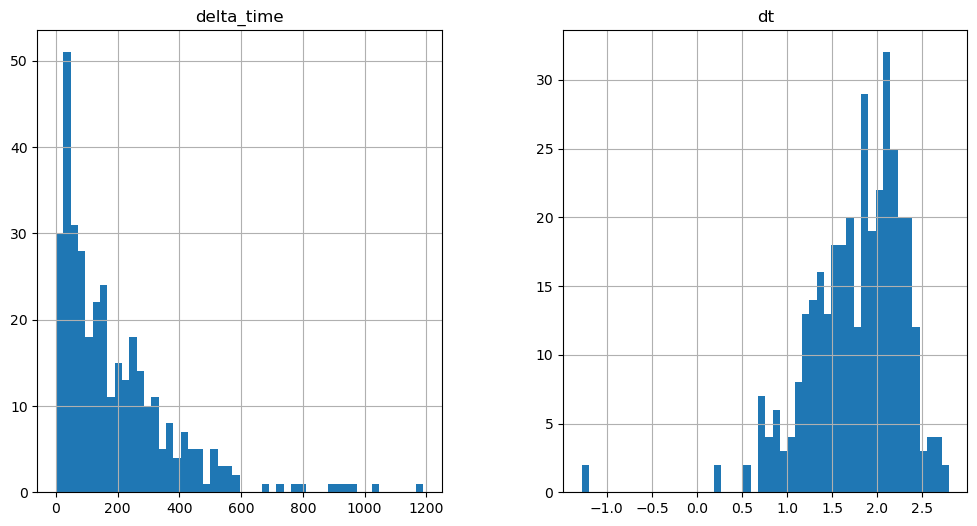

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4746.088995397091 12.564110577106476


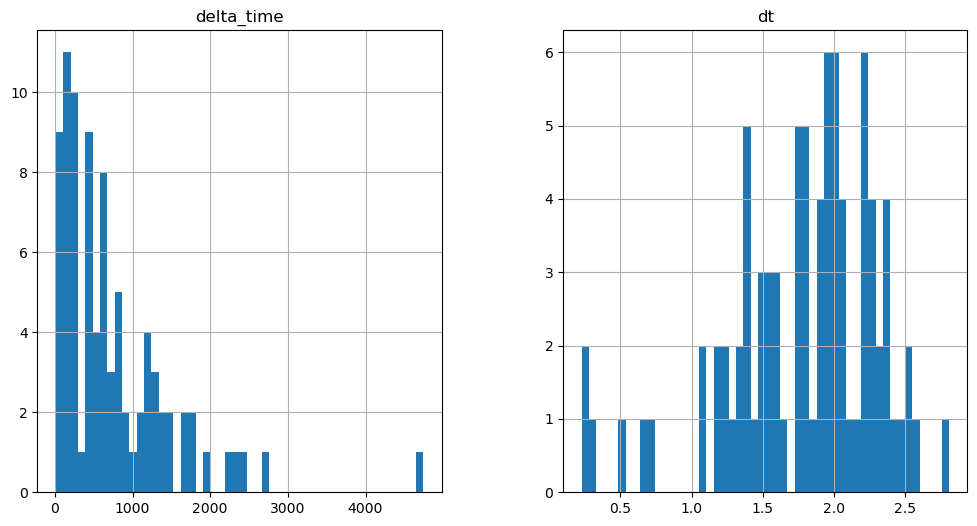

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5952.24546533823 37.69231182336807


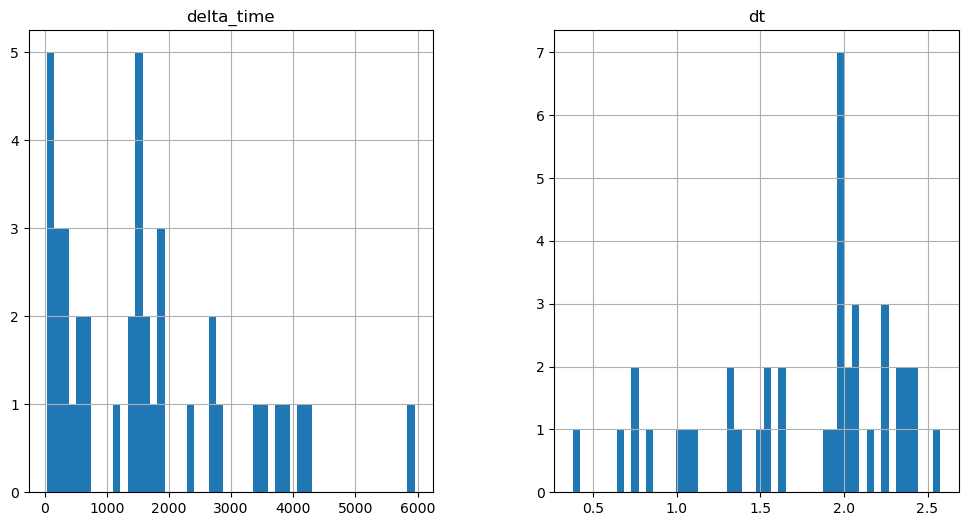

2104.4878544807434 3.141000211238861


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

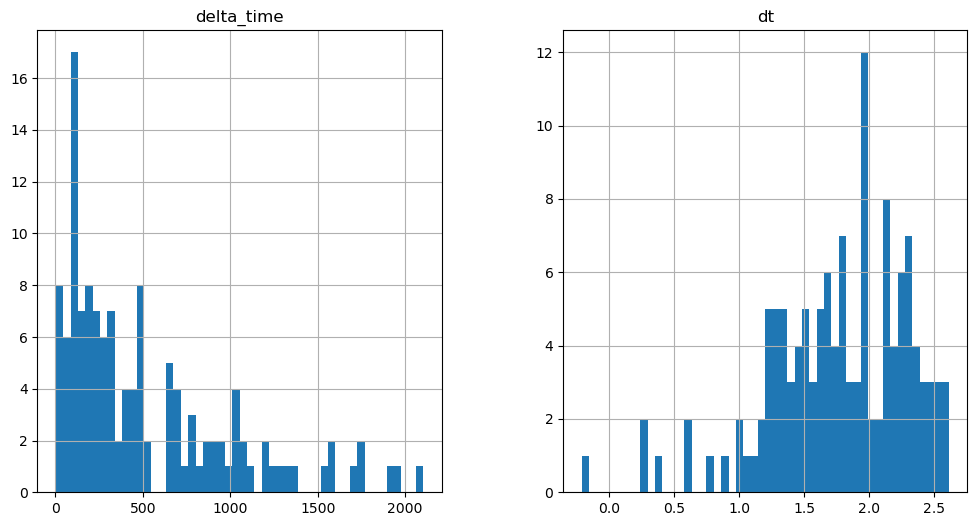

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2823.7829600572586 3.1410300731658936


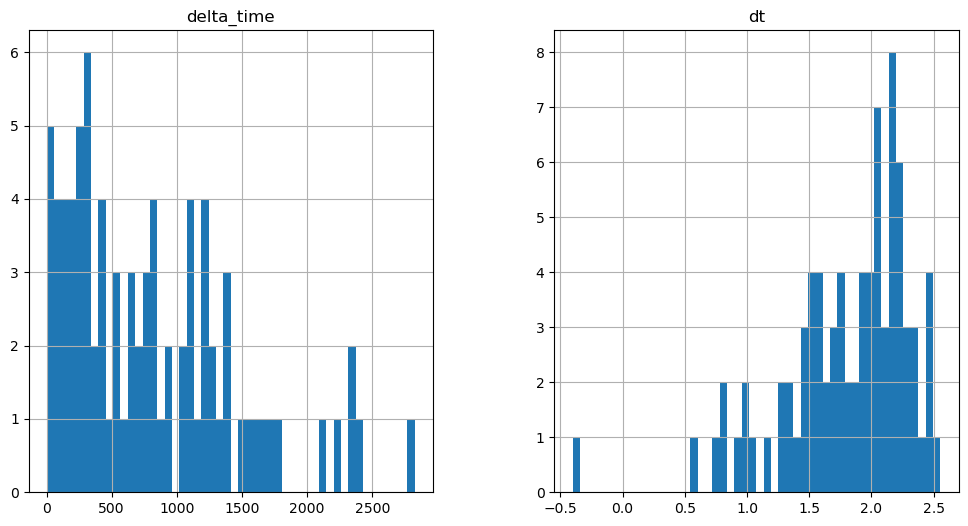

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5719.788853824139 21.987121045589447


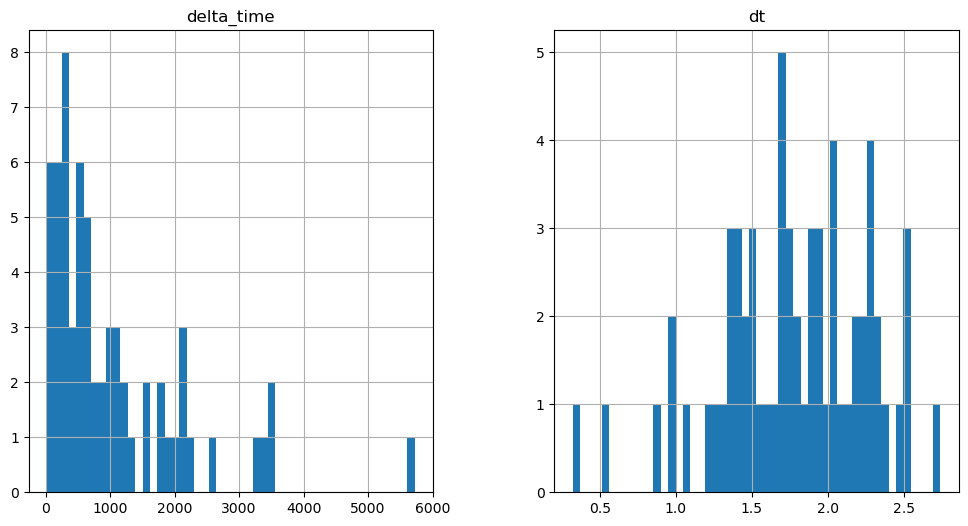

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

4560.75964641571 0.1


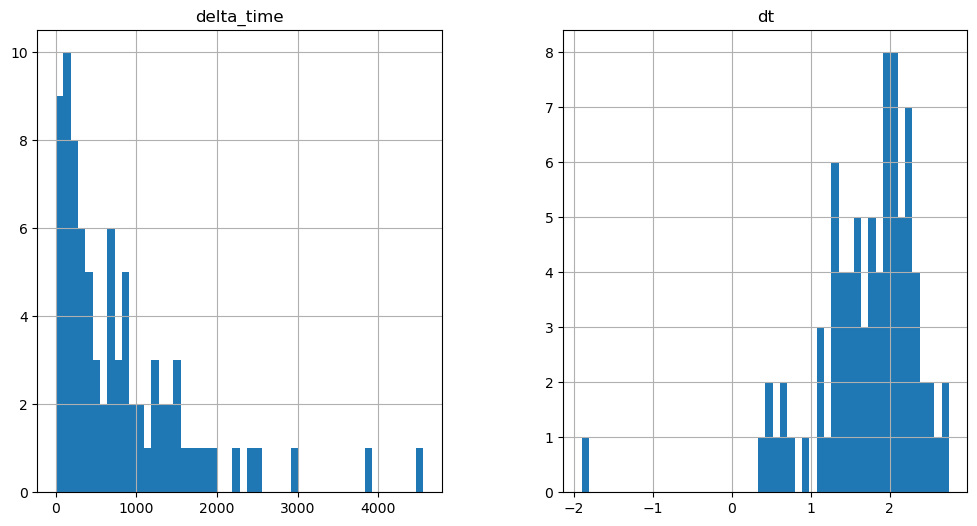

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1089.9351640939713 0.1


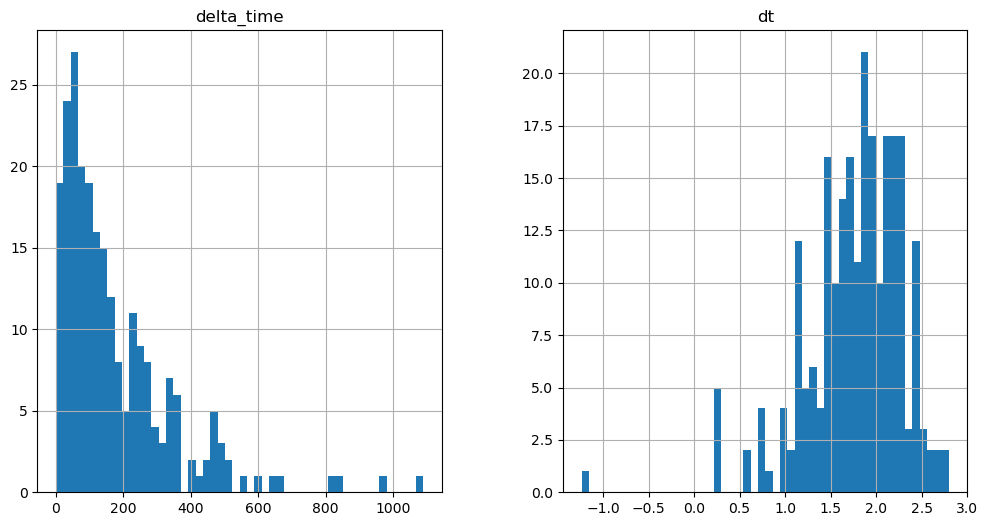

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3756.658776342869 37.69232189655304


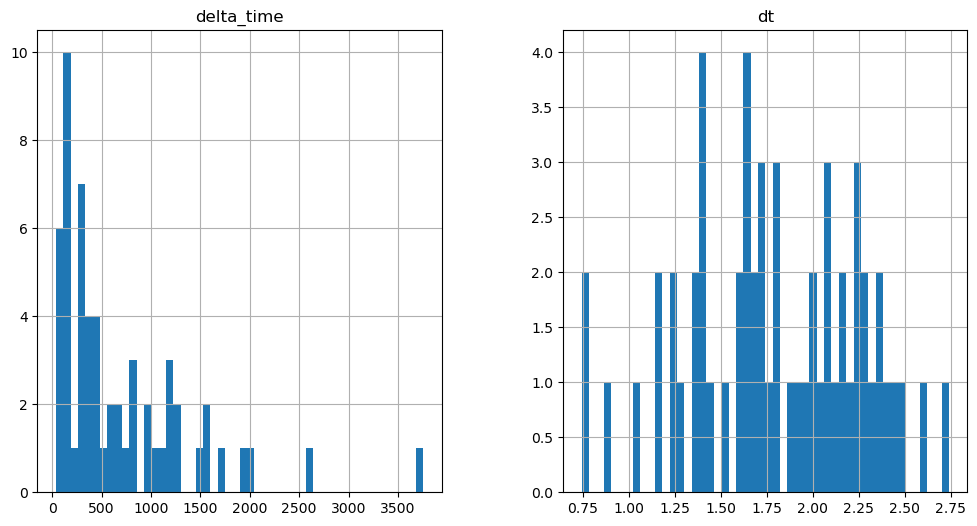

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5804.595358014107 15.705110728740692


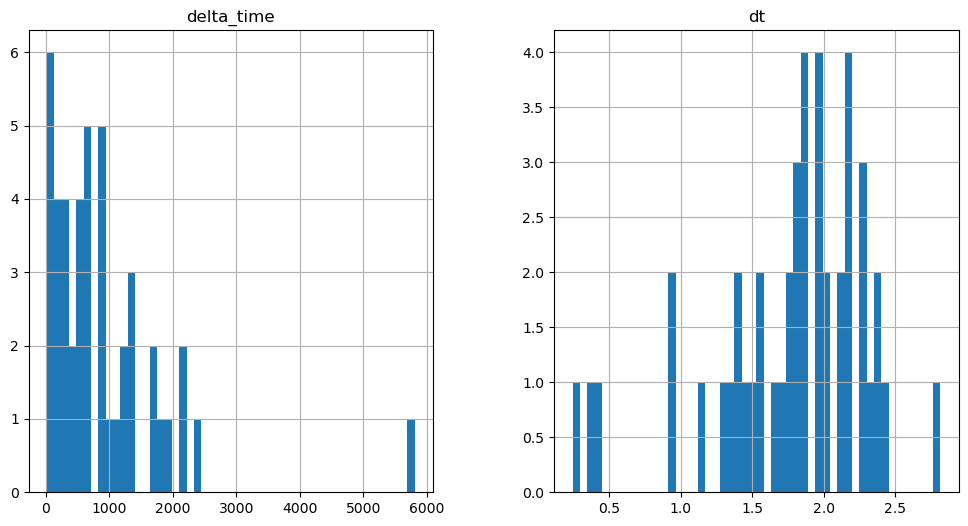

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3404.864418923855 12.564120411872864


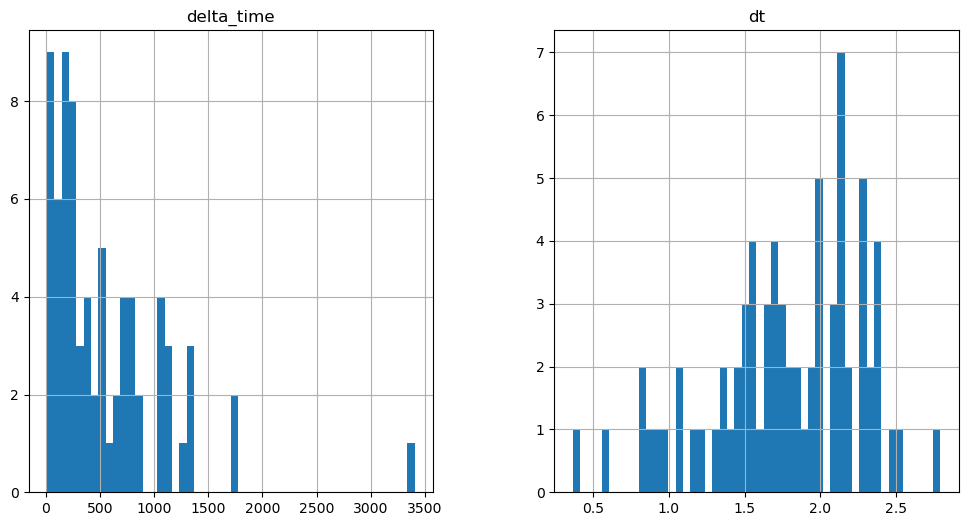

2487.6868734955788 15.705130815505981


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

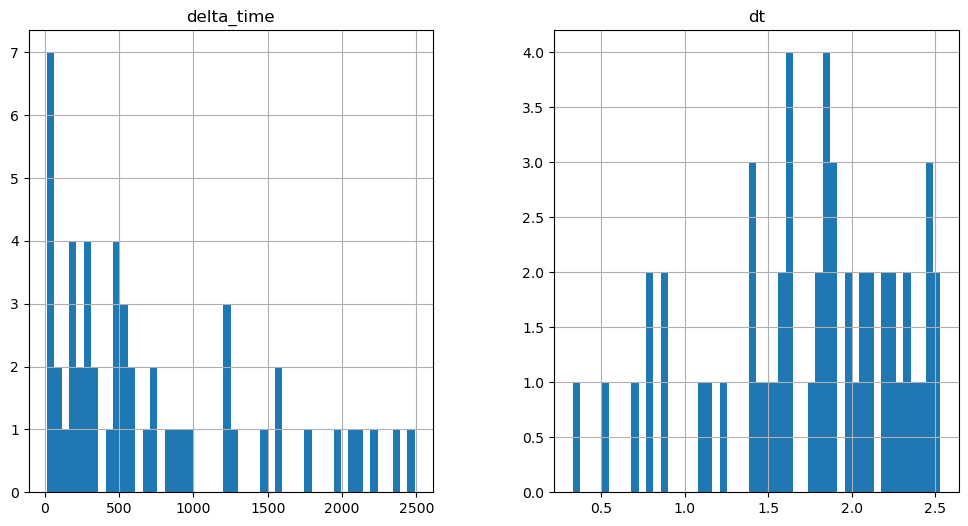

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2537.94295579195 0.1


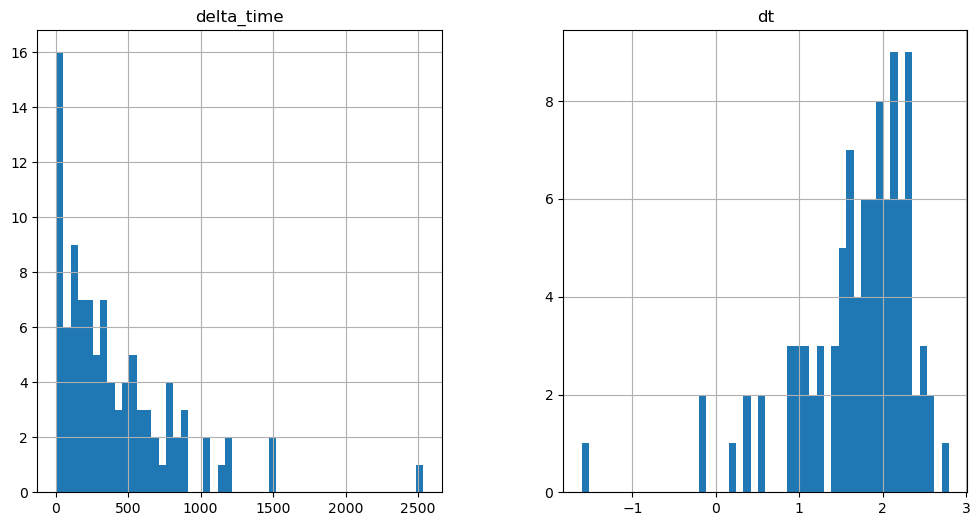

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1495.1288242936134 3.140990197658539


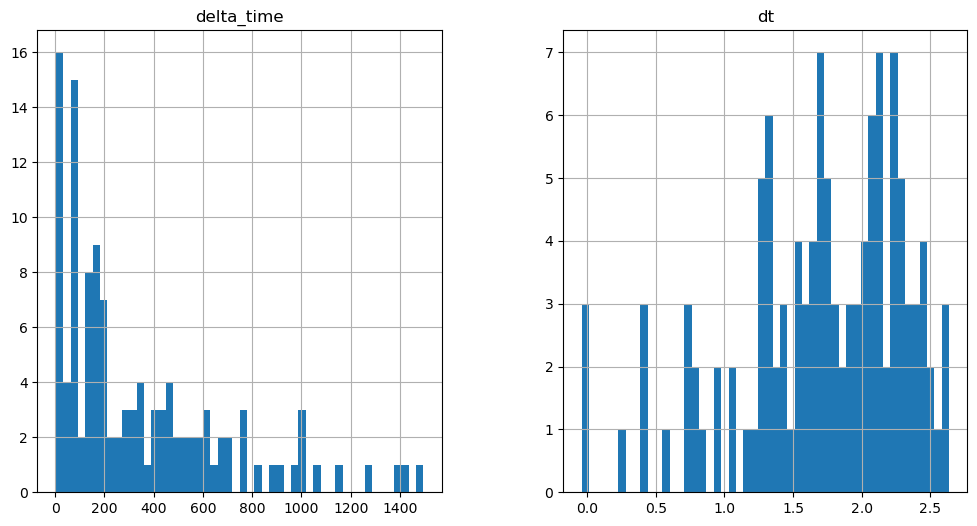

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3163.012547016144 25.128151178359985


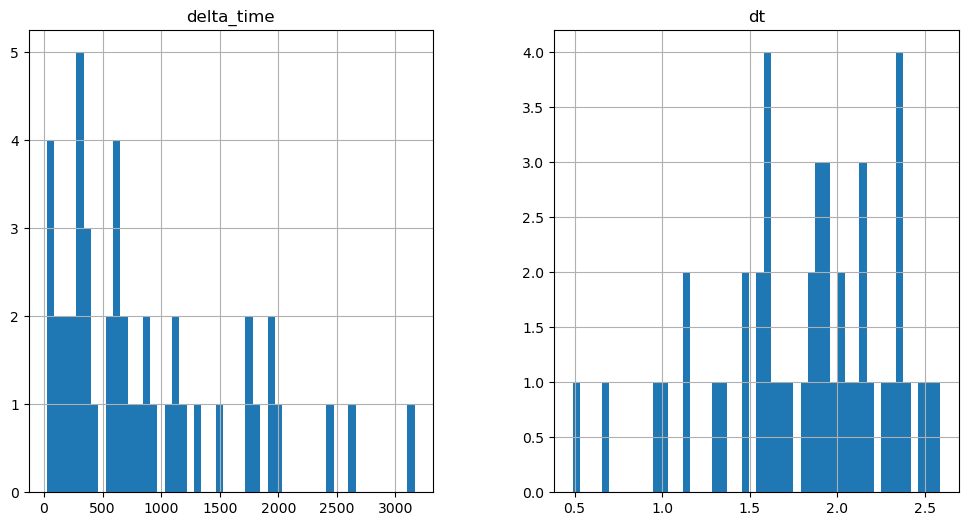

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3392.3085983395576 9.423020541667938


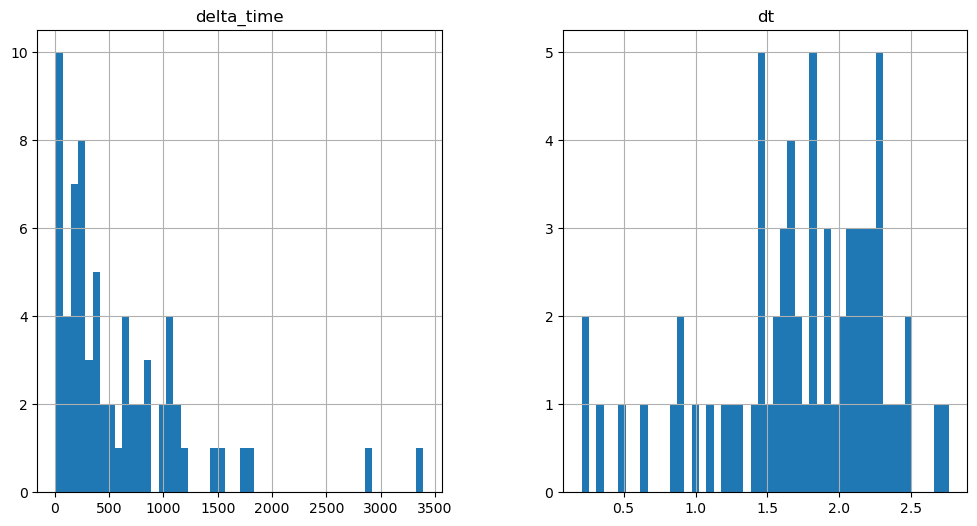

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

555.9613074660301 0.1


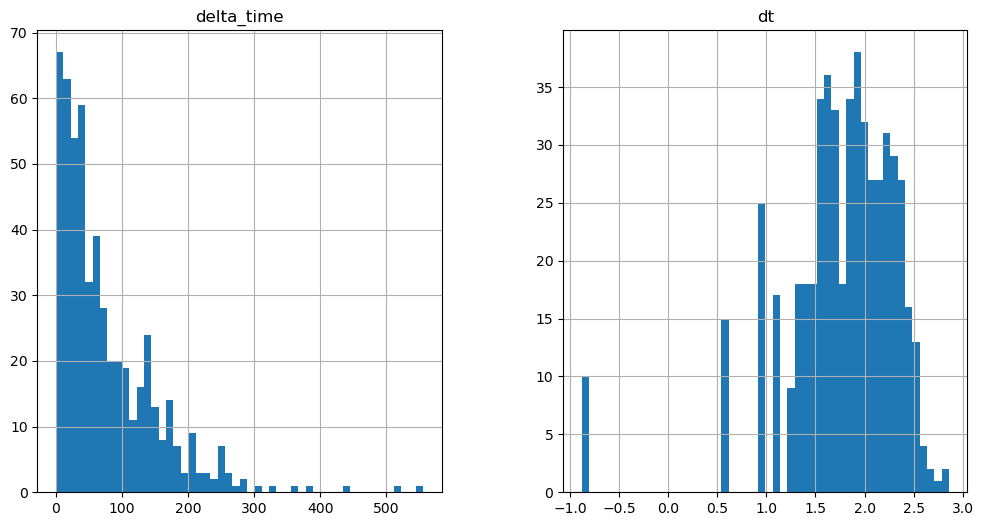

273.26940351724625 0.1


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

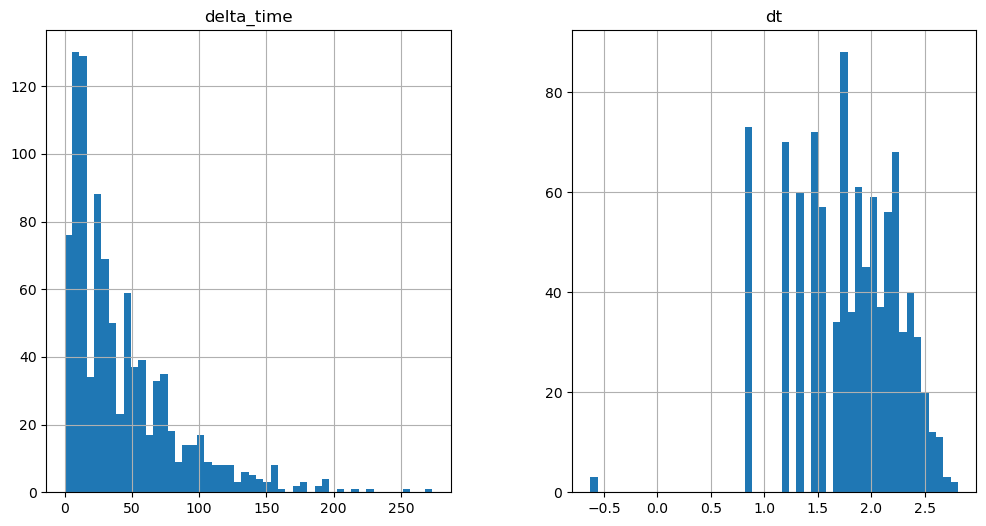

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

2007.1038100123405 3.140990197658539


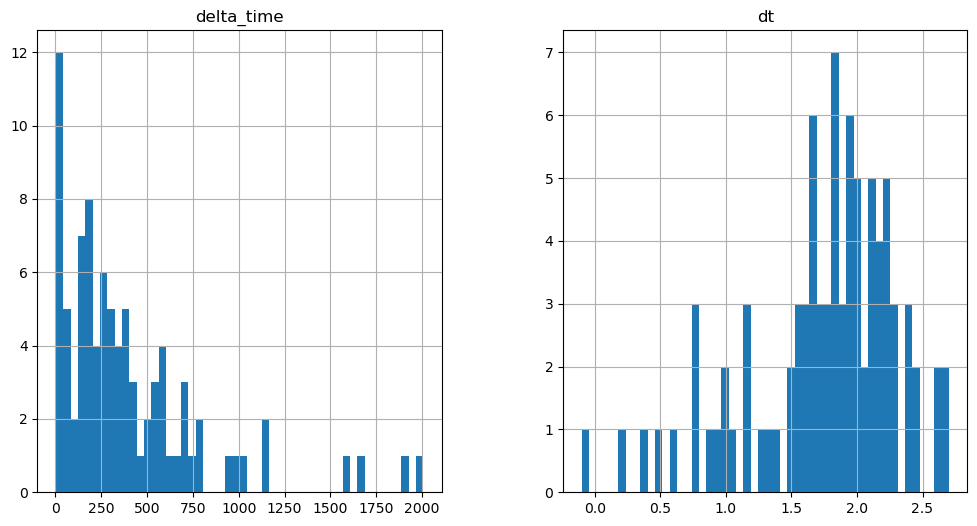

2126.4681264162064 3.1410200595855713


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

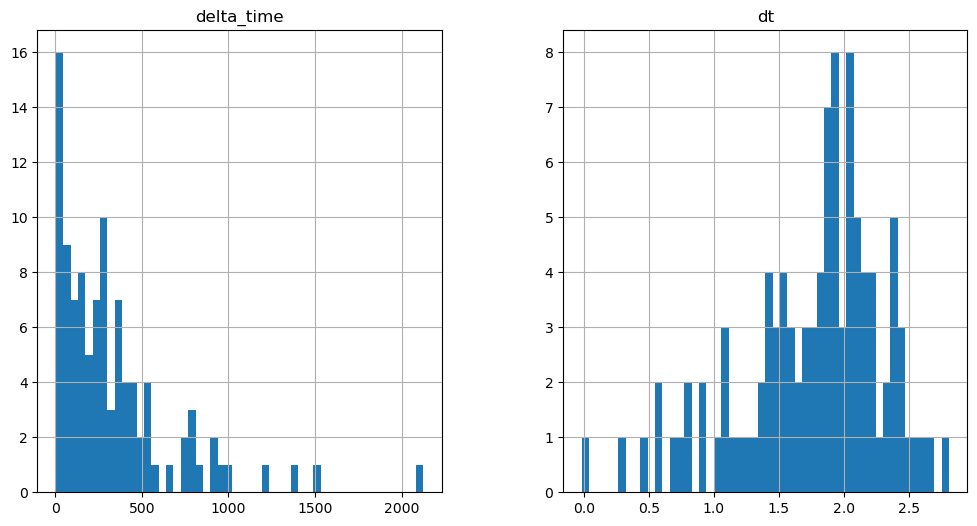

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

515.125515639782 0.1


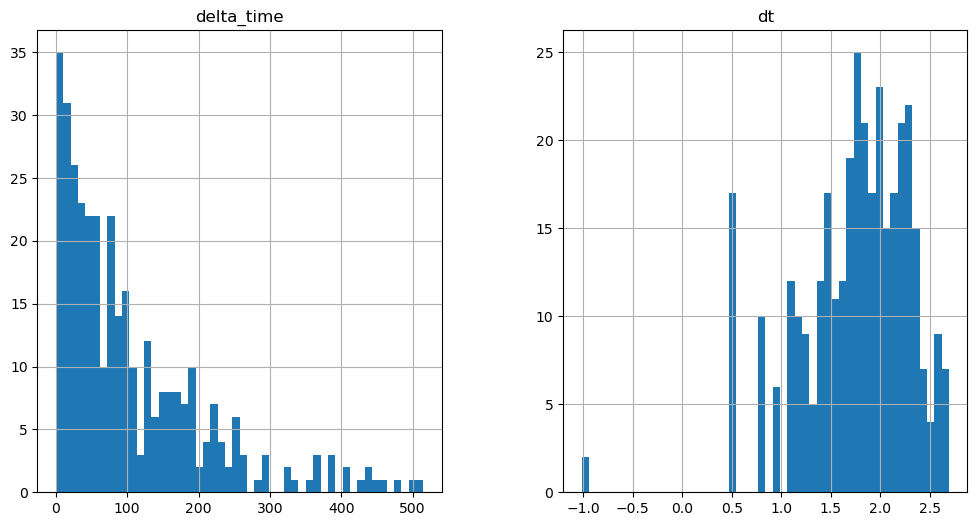

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

5035.055340886116 59.679092943668365


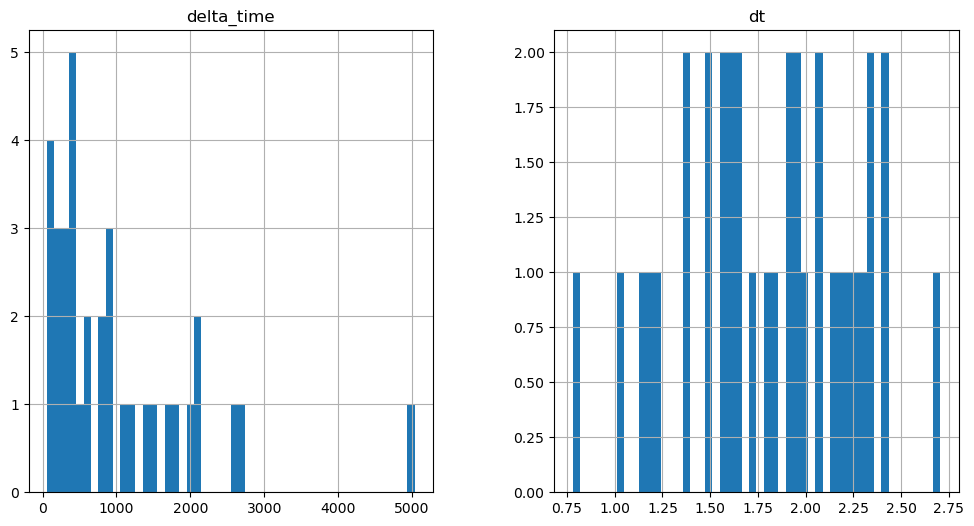

3480.234453499317 3.140990197658539


/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

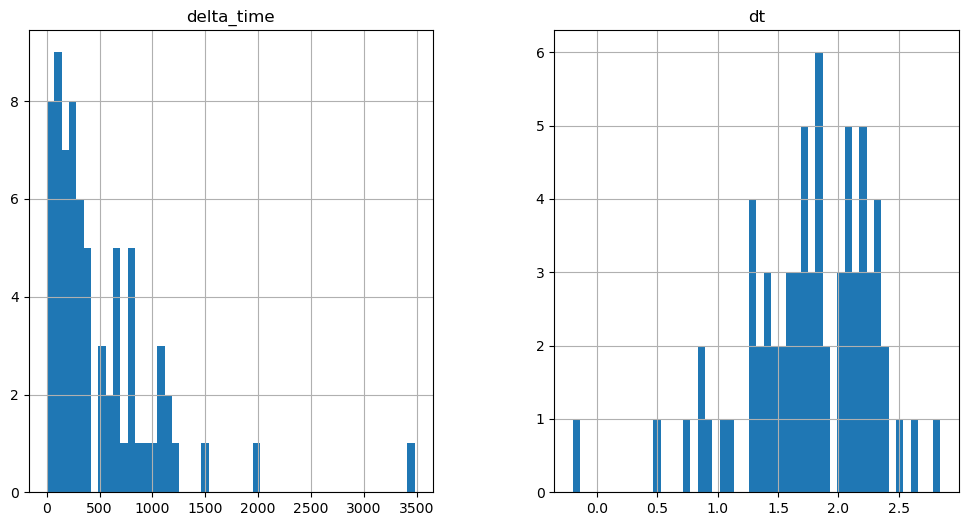

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

3235.23529112339 3.1410101652145386


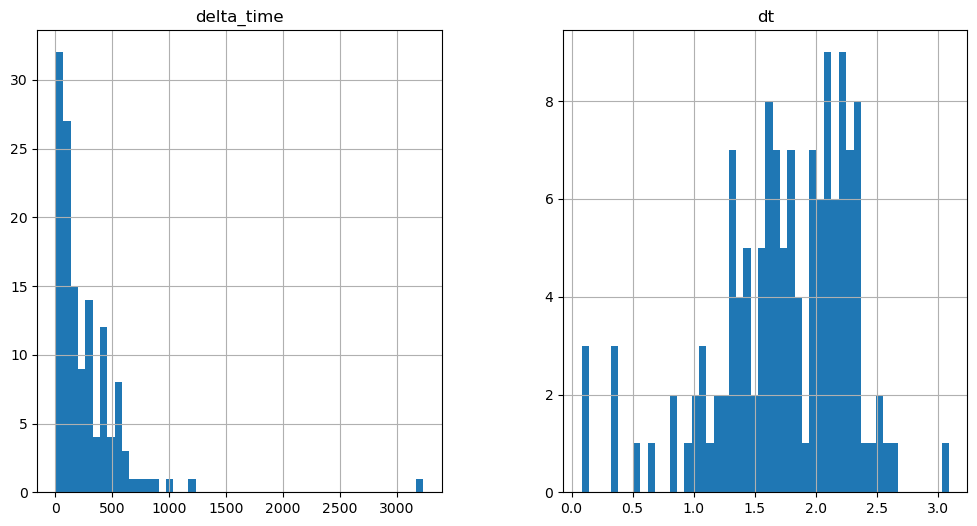

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

1334.9338369965553 0.1


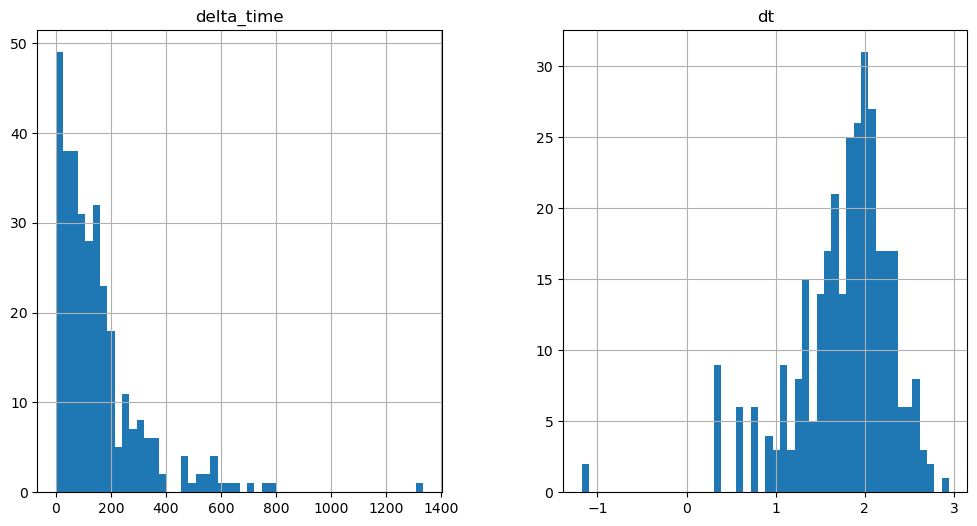

/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
/var/folders/pr/pzfn3sxs66jfxwx55jdxqrd00000gn/T/ipykernel_6321/1036953689.py:16: SettingWithCopyWarning: 
A 

901.4726251363754 0.1


KeyboardInterrupt: 

In [10]:
maxdt_list = []

for id_name, df_id in df_input_group:
    df_id["delta_time"] = df_id['time'].diff()
    df_id = df_id[df_id["delta_time"].notna()]
    # Add a constant value to delta_time = 0
    df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.1, dt))
    print(max(df_id["delta_time"]),min(df_id["delta_time"]))
    # Number and Total Duration of Events
    N = len(df_id) #one row will be dropped so -1 ???
    T = max(df_id["time"])-min(df_id["time"])
    E = max(df_id["energy"])-min(df_id["energy"])
    # Add delta_t column
    df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
    # Add E column
    df_id["E"] = np.log10(df_id["energy"])
    # Max dt
    maxdt = max(df_id["dt"])
    maxdt_list.append(maxdt)

    fig, (ax1, ax2) = plt.subplots(1, 2,figsize = (12,6))
    df_id.hist("delta_time",ax = ax1,bins = 50)
    df_id.hist("dt",ax = ax2,bins = 50)
    plt.show()

In [ ]:
unique = df_inputs["obsreg_id"].unique()
maxdt_list = []
mindt_list = []

for id in unique:
    df_id = df_inputs[df_inputs["obsreg_id"] == id]
    df_id["delta_time"] = df_id['time'].diff()
    df_id = df_id[df_id["delta_time"].notna()]
    # Add a constant value to delta_time = 0
    df_id["delta_time"] = df_id["delta_time"].apply(lambda dt: np.where(dt == 0, dt + 0.01, dt))
    # Number and Total Duration of Events
    N = len(df_id) #one row will be dropped so -1 ???
    T = max(df_id["time"])-min(df_id["time"])
    E = max(df_id["energy"])-min(df_id["energy"])
    # Add delta_t column
    df_id["dt"] = np.log10(100 * N * df_id["delta_time"]/T)
    # Add E column
    df_id["E"] = np.log10(df_id["energy"])
    # Max dt
    maxdt = max(df_id["dt"])
    mindt = min(df_id["dt"])
    maxdt_list.append(maxdt)
    mindt_list.append(mindt)
print('Maximum: ', max(maxdt_list))
print('Minimum: ', min(mindt_list))